## Define natural priors

In [1]:
import numpy as np
import matplotlib.pyplot as plt

Text(0, 0.5, 'pdf')

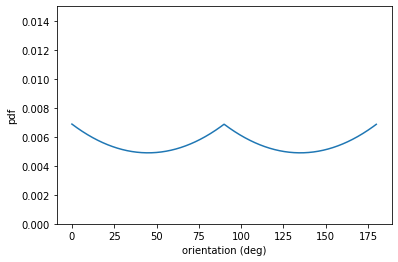

In [2]:
# "Natural prior" (Girshick et al. 2011, fig.6)
n_ori = 1000
a = 2e-4
b = 1

dori = 180 / n_ori
stim_dirs = np.float32(np.arange(0, 180, dori))
stim_p = np.zeros(n_ori)
midindx = np.argmin(np.abs(stim_dirs-90))

stim_p[:midindx] = a*(np.arange(0, stim_dirs[midindx], stim_dirs[midindx] / midindx)-45)**2 + b
stim_p[midindx:] = a*(np.arange(stim_dirs[midindx+1],
                               180, (180-stim_dirs[midindx+1]) / (n_ori-midindx)
                              )-135)**2 + b
plt.figure()
stim_p = stim_p/np.sum(stim_p)
plt.plot(stim_dirs,stim_p/dori)
plt.ylim([0,0.015])
plt.xlabel('orientation (deg)')
plt.ylabel('pdf')

## Train network from stimuli distributed with the natural statistics

In [3]:
import sys, os, time

import copy
import numpy as np
import matplotlib.pyplot as plt

sys.path.append('../')
from det_rnn import *
import det_rnn.train as utils_train
import det_rnn.analysis as utils_analysis
import tensorflow as tf
from det_rnn.train.model import Model
from utils.plotfnc import *

print(tf.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

2.3.0-dev20200621
Num GPUs Available:  0


### Generate stimulus

In [4]:
print('batchsize = ' + str(par['batch_size']))
par

batchsize = 128


{'design': {'iti': (0, 1.5),
  'stim': (1.5, 3.0),
  'delay': (3.0, 4.5),
  'estim': (4.5, 6.0)},
 'output_range': 'design',
 'dead': 'design',
 'mask': {'iti': 1.0,
  'stim': 1.0,
  'delay': 1.0,
  'estim': 10.0,
  'rule_iti': 2.0,
  'rule_stim': 2.0,
  'rule_delay': 2.0,
  'rule_estim': 20.0},
 'input_rule': 'design',
 'output_rule': 'design',
 'input_rule_strength': 0.8,
 'output_rule_strength': 0.8,
 'type': 'orientation',
 'stim_dist': 'uniform',
 'natural_a': 0.0002,
 'trial_per_subblock': 1,
 'stim_encoding': 'single',
 'resp_decoding': 'disc',
 'exc_inh_prop': 0.8,
 'modular': False,
 'connect_prob': 0.1,
 'dt': 10.0,
 'membrane_time_constant': 100,
 'input_mean': 0.0,
 'noise_in_sd': 0.1,
 'noise_rnn_sd': 0.5,
 'strength_input': 0.8,
 'strength_output': 0.8,
 'kappa': 2,
 'orientation_cost': 1,
 'n_iterations': 300,
 'iters_between_outputs': 100,
 'n_receptive_fields': 1,
 'n_tuned_input': 24,
 'n_tuned_output': 24,
 'n_ori': 24,
 'noise_mean': 0,
 'noise_sd': 0.005,
 'n_recal

In [5]:
# training set
par_train = copy.deepcopy(par)
# use "natural prior"
par_train['stim_dist'] = 'natural'
par_train['natural_a'] = 2e-4
par_train['n_ori'] = 1000 # make it somewhat continuous
par_train = update_parameters(par_train)
stim_train = Stimulus(par_train)

# testing set; for testing the 24 orientations
par_test = copy.deepcopy(par)
par_test['stim_dist'] = 'natural'
par_test['natural_a'] = 2e-4
par_test = update_parameters(par_test)
stim_test = Stimulus(par_test)   # the argument `par` may be omitted

In [6]:
print('train n_ori = ' + str(par_train['n_ori']))
print('test n_ori = ' + str(par_test['n_ori']))

train n_ori = 1000
test n_ori = 24


orientation = 177.48


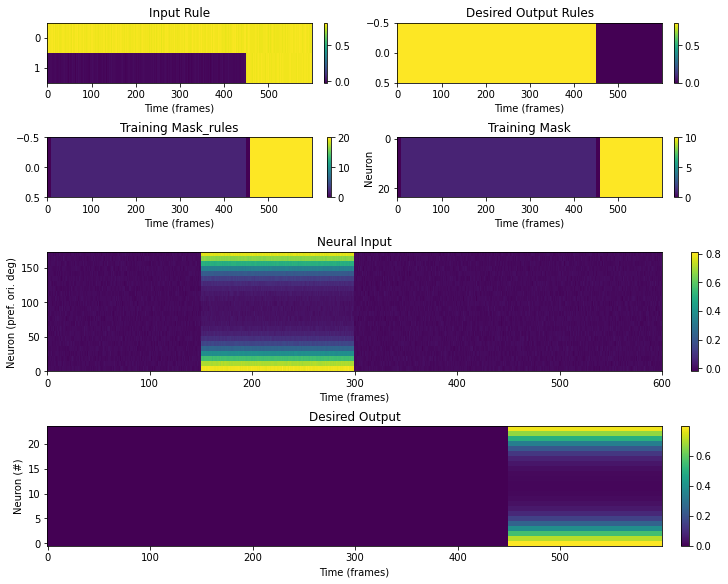

In [7]:
# check stimulus
train_data = stim_train.generate_trial()
random_trial_num = np.random.randint(stim_train.batch_size)
target_ori = np.arange(0,180,180/par_train['n_ori'])[train_data['stimulus_ori'][random_trial_num]]
print('orientation = ' + str(target_ori))
plot_trial(stim_train, train_data,TEST_TRIAL=random_trial_num)

orientation = 172.5


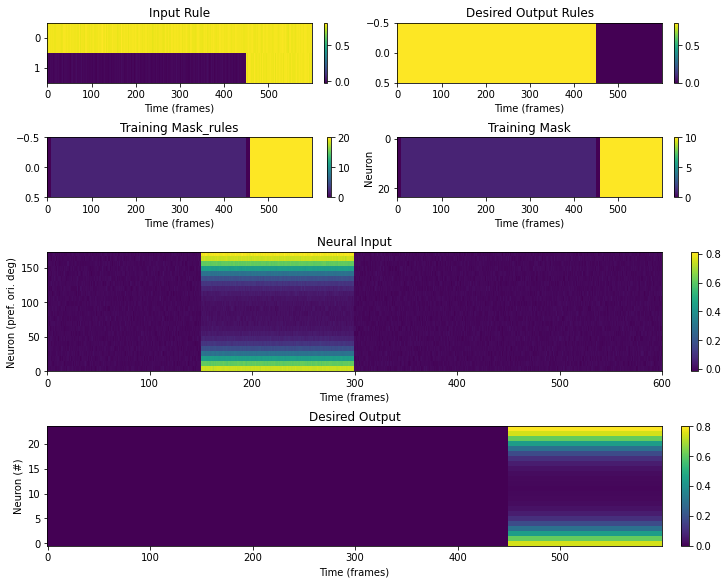

In [8]:
test_data = stim_test.generate_trial(balanced=True)
random_trial_num = len(test_data['stimulus_ori'])-2
#random_trial_num = np.random.randint(len(test_data['stimulus_ori']))
target_ori = np.arange(0,180,180/par_test['n_ori'])[test_data['stimulus_ori'][random_trial_num]]
print('orientation = ' + str(target_ori))
plot_trial(stim_test, test_data,TEST_TRIAL=random_trial_num)

In [ ]:
# Check the stimulus distribution in balanced trial


### Train on 24 orientations
Just to see if it works.
Note that this gives us the prior shape.


 Training performance: 
Iter.    0 | Performance 0.1021 | Loss 16225.4492 | Spike loss 98.0569
Testing performance: 
Iter.    0 | Performance -0.0002 | Loss 7625.0537 | Spike loss 67.2514


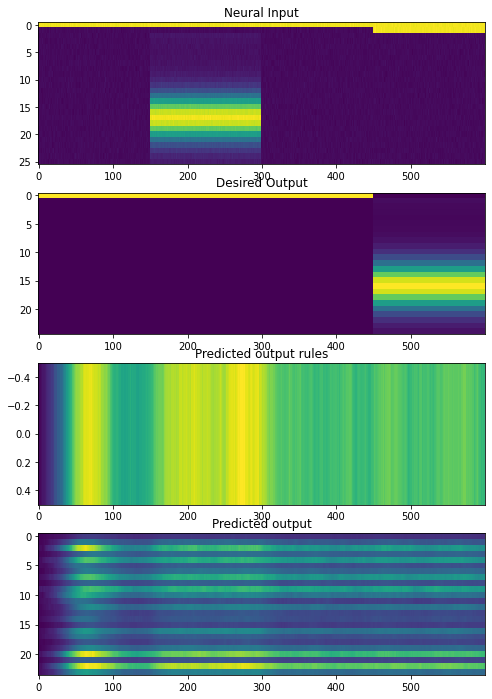

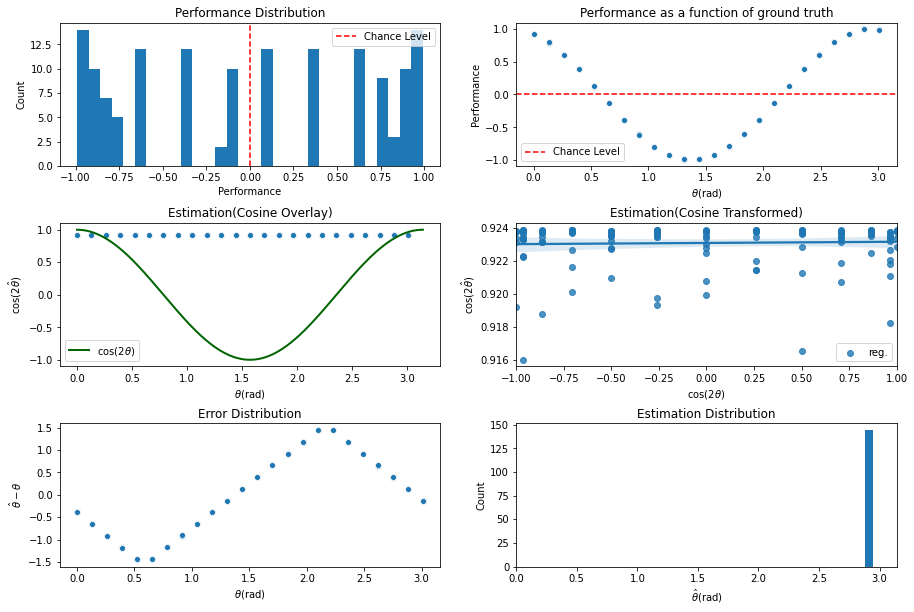

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter0/assets

 Training performance: 
Iter.    1 | Performance -0.0221 | Loss 7582.3721 | Spike loss 66.9995
Testing performance: 
Iter.    1 | Performance 0.0025 | Loss 2986.0640 | Spike loss 44.1976

 Training performance: 
Iter.    2 | Performance 0.0273 | Loss 3014.4534 | Spike loss 44.3445
Testing performance: 
Iter.    2 | Performance 0.0017 | Loss 1196.9862 | Spike loss 26.5147

 Training performance: 
Iter.    3 | Performance -0.0496 | Loss 1201.5641 | Spike loss 26.7005
Testing performance: 
Iter.    3 | Performance 0.0007 | Loss 445.2456 | Spike loss 14.2833

 Training performance: 
Iter.    4 | Performance 0.0750 | Loss 458.5263 | Spike loss 14.6283
Testing performance: 
Iter.    4 | Performance -0.0221 | Loss 110.0456 | Spike loss 6.3059

 Training performance: 
Iter.    5 | Performance 0.0272 | Loss 103.9657 | Spike loss 5.9056
Testing performance: 
Iter.    5 | Performance -0.0132 | Loss 28.6


 Training performance: 
Iter.   46 | Performance 0.0355 | Loss 0.8469 | Spike loss 1.1627
Testing performance: 
Iter.   46 | Performance -0.0037 | Loss 0.8227 | Spike loss 1.1948

 Training performance: 
Iter.   47 | Performance 0.0322 | Loss 0.8157 | Spike loss 1.1848
Testing performance: 
Iter.   47 | Performance -0.0139 | Loss 0.8102 | Spike loss 1.2390

 Training performance: 
Iter.   48 | Performance -0.0023 | Loss 0.8091 | Spike loss 1.2265
Testing performance: 
Iter.   48 | Performance -0.0089 | Loss 0.7893 | Spike loss 1.2843

 Training performance: 
Iter.   49 | Performance -0.0579 | Loss 0.7746 | Spike loss 1.2666
Testing performance: 
Iter.   49 | Performance -0.0223 | Loss 0.7574 | Spike loss 1.3240

 Training performance: 
Iter.   50 | Performance 0.0218 | Loss 0.7736 | Spike loss 1.3052
Testing performance: 
Iter.   50 | Performance 0.0802 | Loss 0.7481 | Spike loss 1.3626

 Training performance: 
Iter.   51 | Performance -0.0690 | Loss 0.7504 | Spike loss 1.3612
Testing


 Training performance: 
Iter.   92 | Performance -0.0217 | Loss 0.4820 | Spike loss 1.9858
Testing performance: 
Iter.   92 | Performance 0.0037 | Loss 0.4779 | Spike loss 1.9929

 Training performance: 
Iter.   93 | Performance 0.1699 | Loss 0.4722 | Spike loss 1.9850
Testing performance: 
Iter.   93 | Performance -0.0077 | Loss 0.4717 | Spike loss 1.9868

 Training performance: 
Iter.   94 | Performance -0.0681 | Loss 0.4742 | Spike loss 1.9819
Testing performance: 
Iter.   94 | Performance 0.0055 | Loss 0.4762 | Spike loss 1.9731

 Training performance: 
Iter.   95 | Performance 0.0474 | Loss 0.4787 | Spike loss 1.9802
Testing performance: 
Iter.   95 | Performance 0.0129 | Loss 0.4697 | Spike loss 1.9797

 Training performance: 
Iter.   96 | Performance -0.0335 | Loss 0.4787 | Spike loss 1.9811
Testing performance: 
Iter.   96 | Performance 0.0041 | Loss 0.4755 | Spike loss 1.9757

 Training performance: 
Iter.   97 | Performance 0.0163 | Loss 0.4728 | Spike loss 1.9711
Testing pe

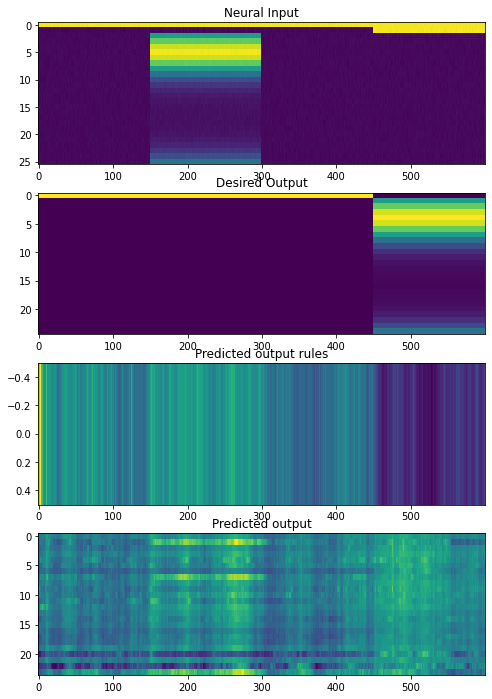

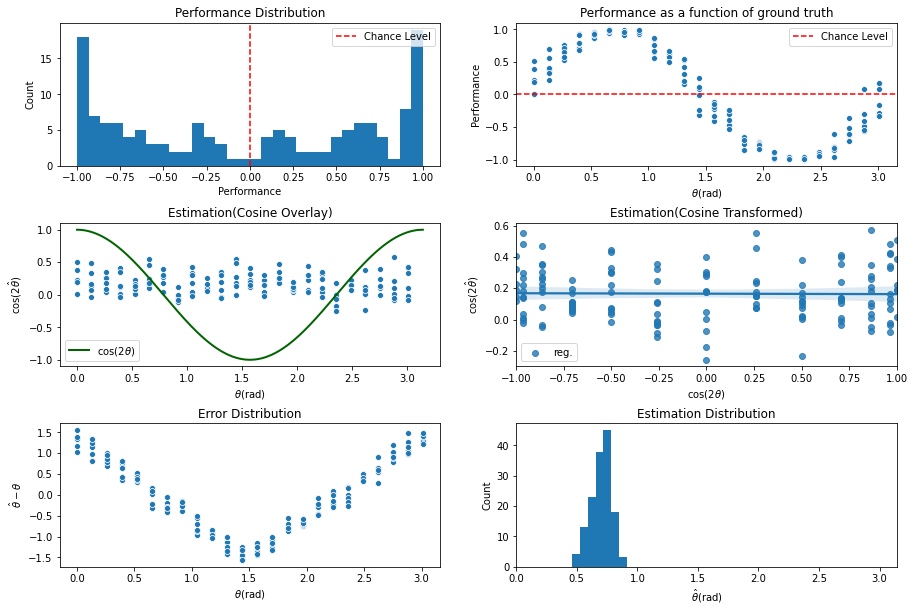

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter100/assets

 Training performance: 
Iter.  101 | Performance 0.0188 | Loss 0.4584 | Spike loss 1.9538
Testing performance: 
Iter.  101 | Performance -0.0034 | Loss 0.4530 | Spike loss 1.9558

 Training performance: 
Iter.  102 | Performance 0.0458 | Loss 0.4563 | Spike loss 1.9538
Testing performance: 
Iter.  102 | Performance -0.0018 | Loss 0.4511 | Spike loss 1.9407

 Training performance: 
Iter.  103 | Performance -0.0476 | Loss 0.4558 | Spike loss 1.9371
Testing performance: 
Iter.  103 | Performance -0.0108 | Loss 0.4514 | Spike loss 1.9385

 Training performance: 
Iter.  104 | Performance -0.0268 | Loss 0.4522 | Spike loss 1.9439
Testing performance: 
Iter.  104 | Performance -0.0439 | Loss 0.4475 | Spike loss 1.9310

 Training performance: 
Iter.  105 | Performance 0.0155 | Loss 0.4488 | Spike loss 1.9396
Testing performance: 
Iter.  105 | Performance -0.0369 | Loss 0.4530 | Spike loss 1.9390

 


 Training performance: 
Iter.  146 | Performance 0.0287 | Loss 0.4086 | Spike loss 2.1006
Testing performance: 
Iter.  146 | Performance -0.0020 | Loss 0.4017 | Spike loss 2.1112

 Training performance: 
Iter.  147 | Performance 0.1087 | Loss 0.4040 | Spike loss 2.1222
Testing performance: 
Iter.  147 | Performance -0.0033 | Loss 0.4018 | Spike loss 2.1207

 Training performance: 
Iter.  148 | Performance 0.0264 | Loss 0.4034 | Spike loss 2.1188
Testing performance: 
Iter.  148 | Performance 0.0370 | Loss 0.4064 | Spike loss 2.1291

 Training performance: 
Iter.  149 | Performance 0.0876 | Loss 0.4045 | Spike loss 2.1292
Testing performance: 
Iter.  149 | Performance 0.0513 | Loss 0.4033 | Spike loss 2.1268

 Training performance: 
Iter.  150 | Performance -0.0931 | Loss 0.4036 | Spike loss 2.1240
Testing performance: 
Iter.  150 | Performance 0.0095 | Loss 0.3987 | Spike loss 2.1408

 Training performance: 
Iter.  151 | Performance 0.1186 | Loss 0.4012 | Spike loss 2.1356
Testing per


 Training performance: 
Iter.  192 | Performance 0.0326 | Loss 0.3776 | Spike loss 2.5798
Testing performance: 
Iter.  192 | Performance 0.0844 | Loss 0.3802 | Spike loss 2.5922

 Training performance: 
Iter.  193 | Performance -0.0190 | Loss 0.3784 | Spike loss 2.5981
Testing performance: 
Iter.  193 | Performance 0.0295 | Loss 0.3799 | Spike loss 2.6068

 Training performance: 
Iter.  194 | Performance 0.0706 | Loss 0.3759 | Spike loss 2.6160
Testing performance: 
Iter.  194 | Performance -0.0646 | Loss 0.3740 | Spike loss 2.6019

 Training performance: 
Iter.  195 | Performance 0.0200 | Loss 0.3758 | Spike loss 2.5986
Testing performance: 
Iter.  195 | Performance -0.0367 | Loss 0.3758 | Spike loss 2.6223

 Training performance: 
Iter.  196 | Performance 0.0550 | Loss 0.3764 | Spike loss 2.6129
Testing performance: 
Iter.  196 | Performance -0.0100 | Loss 0.3787 | Spike loss 2.6278

 Training performance: 
Iter.  197 | Performance 0.0024 | Loss 0.3819 | Spike loss 2.6236
Testing pe

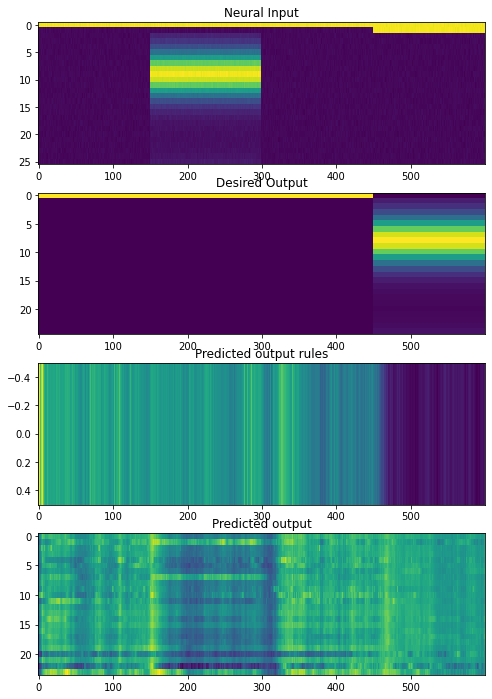

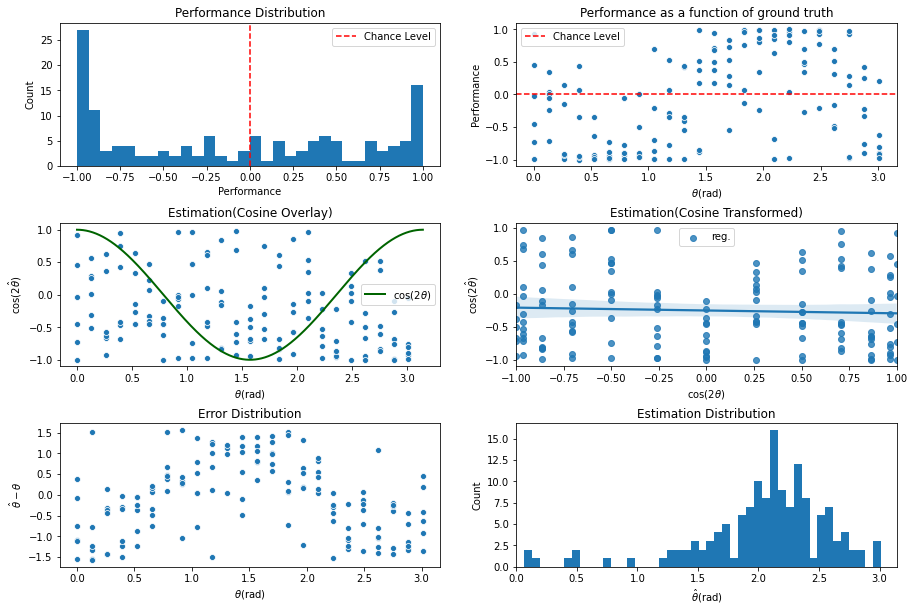

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter200/assets

 Training performance: 
Iter.  201 | Performance 0.0269 | Loss 0.3746 | Spike loss 2.6672
Testing performance: 
Iter.  201 | Performance -0.0299 | Loss 0.3733 | Spike loss 2.6751

 Training performance: 
Iter.  202 | Performance 0.0342 | Loss 0.3733 | Spike loss 2.6631
Testing performance: 
Iter.  202 | Performance 0.0542 | Loss 0.3759 | Spike loss 2.6517

 Training performance: 
Iter.  203 | Performance 0.0777 | Loss 0.3782 | Spike loss 2.6709
Testing performance: 
Iter.  203 | Performance -0.0268 | Loss 0.3734 | Spike loss 2.6833

 Training performance: 
Iter.  204 | Performance -0.0617 | Loss 0.3766 | Spike loss 2.6626
Testing performance: 
Iter.  204 | Performance 0.0756 | Loss 0.3738 | Spike loss 2.6845

 Training performance: 
Iter.  205 | Performance -0.0065 | Loss 0.3738 | Spike loss 2.6813
Testing performance: 
Iter.  205 | Performance 0.0330 | Loss 0.3751 | Spike loss 2.6853

 Tra


 Training performance: 
Iter.  246 | Performance 0.0124 | Loss 0.3637 | Spike loss 2.6772
Testing performance: 
Iter.  246 | Performance -0.0289 | Loss 0.3613 | Spike loss 2.6838

 Training performance: 
Iter.  247 | Performance 0.0368 | Loss 0.3627 | Spike loss 2.6912
Testing performance: 
Iter.  247 | Performance 0.0057 | Loss 0.3658 | Spike loss 2.6865

 Training performance: 
Iter.  248 | Performance -0.1720 | Loss 0.3643 | Spike loss 2.6641
Testing performance: 
Iter.  248 | Performance 0.0227 | Loss 0.3611 | Spike loss 2.6854

 Training performance: 
Iter.  249 | Performance 0.1053 | Loss 0.3627 | Spike loss 2.7004
Testing performance: 
Iter.  249 | Performance -0.0098 | Loss 0.3647 | Spike loss 2.6681

 Training performance: 
Iter.  250 | Performance -0.0033 | Loss 0.3673 | Spike loss 2.6756
Testing performance: 
Iter.  250 | Performance 0.0079 | Loss 0.3682 | Spike loss 2.6809

 Training performance: 
Iter.  251 | Performance -0.0140 | Loss 0.3664 | Spike loss 2.7073
Testing p


 Training performance: 
Iter.  292 | Performance 0.0222 | Loss 0.3591 | Spike loss 2.6901
Testing performance: 
Iter.  292 | Performance -0.0076 | Loss 0.3588 | Spike loss 2.6767

 Training performance: 
Iter.  293 | Performance -0.0299 | Loss 0.3610 | Spike loss 2.6653
Testing performance: 
Iter.  293 | Performance 0.0483 | Loss 0.3581 | Spike loss 2.6929

 Training performance: 
Iter.  294 | Performance 0.0142 | Loss 0.3559 | Spike loss 2.6975
Testing performance: 
Iter.  294 | Performance 0.0409 | Loss 0.3559 | Spike loss 2.6996

 Training performance: 
Iter.  295 | Performance 0.1086 | Loss 0.3563 | Spike loss 2.7042
Testing performance: 
Iter.  295 | Performance -0.0319 | Loss 0.3600 | Spike loss 2.7041

 Training performance: 
Iter.  296 | Performance -0.0670 | Loss 0.3600 | Spike loss 2.7257
Testing performance: 
Iter.  296 | Performance 0.0469 | Loss 0.3553 | Spike loss 2.6971

 Training performance: 
Iter.  297 | Performance 0.0863 | Loss 0.3551 | Spike loss 2.7058
Testing pe

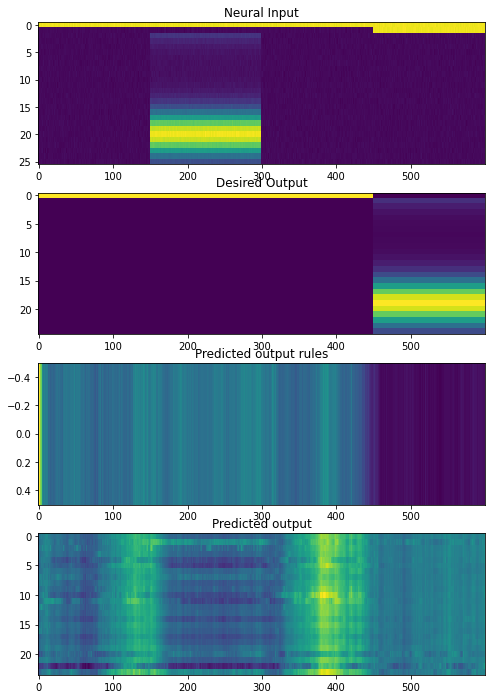

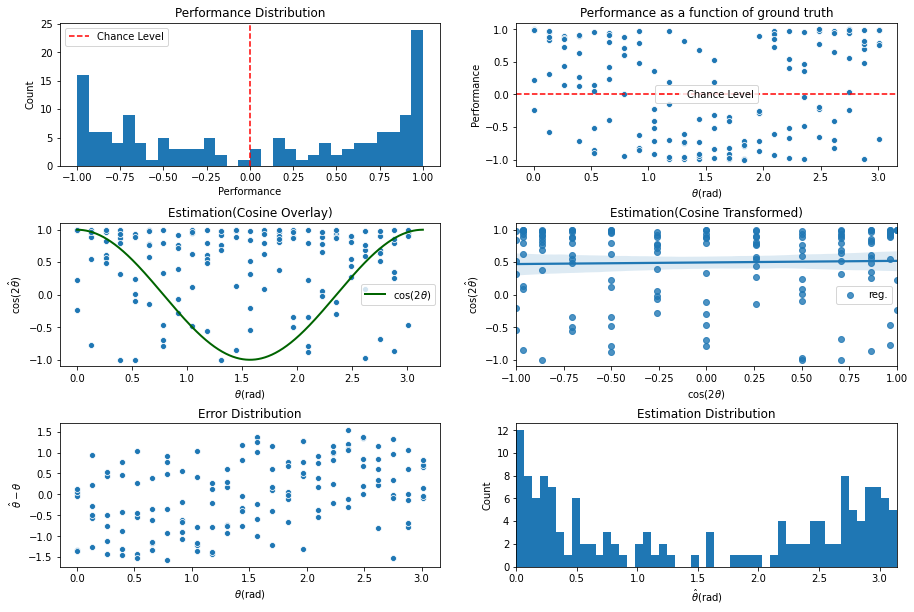

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter300/assets

 Training performance: 
Iter.  301 | Performance -0.0384 | Loss 0.3547 | Spike loss 2.6454
Testing performance: 
Iter.  301 | Performance -0.1390 | Loss 0.3565 | Spike loss 2.6510

 Training performance: 
Iter.  302 | Performance 0.0868 | Loss 0.3555 | Spike loss 2.6683
Testing performance: 
Iter.  302 | Performance -0.0401 | Loss 0.3554 | Spike loss 2.6613

 Training performance: 
Iter.  303 | Performance 0.0776 | Loss 0.3550 | Spike loss 2.6734
Testing performance: 
Iter.  303 | Performance -0.0013 | Loss 0.3555 | Spike loss 2.6686

 Training performance: 
Iter.  304 | Performance -0.0876 | Loss 0.3578 | Spike loss 2.6552
Testing performance: 
Iter.  304 | Performance -0.0465 | Loss 0.3609 | Spike loss 2.6706

 Training performance: 
Iter.  305 | Performance -0.0954 | Loss 0.3606 | Spike loss 2.6464
Testing performance: 
Iter.  305 | Performance 0.0502 | Loss 0.3546 | Spike loss 2.6943

 


 Training performance: 
Iter.  346 | Performance -0.1221 | Loss 0.3550 | Spike loss 2.6657
Testing performance: 
Iter.  346 | Performance -0.0099 | Loss 0.3557 | Spike loss 2.6740

 Training performance: 
Iter.  347 | Performance 0.0580 | Loss 0.3555 | Spike loss 2.6690
Testing performance: 
Iter.  347 | Performance -0.0056 | Loss 0.3504 | Spike loss 2.6903

 Training performance: 
Iter.  348 | Performance -0.0438 | Loss 0.3511 | Spike loss 2.6645
Testing performance: 
Iter.  348 | Performance 0.0069 | Loss 0.3512 | Spike loss 2.6783

 Training performance: 
Iter.  349 | Performance 0.0375 | Loss 0.3477 | Spike loss 2.6774
Testing performance: 
Iter.  349 | Performance 0.0030 | Loss 0.3525 | Spike loss 2.6937

 Training performance: 
Iter.  350 | Performance 0.0296 | Loss 0.3524 | Spike loss 2.6922
Testing performance: 
Iter.  350 | Performance 0.0088 | Loss 0.3506 | Spike loss 2.6916

 Training performance: 
Iter.  351 | Performance 0.0266 | Loss 0.3508 | Spike loss 2.6926
Testing pe


 Training performance: 
Iter.  392 | Performance 0.1142 | Loss 0.3479 | Spike loss 2.6674
Testing performance: 
Iter.  392 | Performance 0.0115 | Loss 0.3445 | Spike loss 2.6801

 Training performance: 
Iter.  393 | Performance -0.0609 | Loss 0.3458 | Spike loss 2.6825
Testing performance: 
Iter.  393 | Performance -0.0042 | Loss 0.3478 | Spike loss 2.6851

 Training performance: 
Iter.  394 | Performance -0.0004 | Loss 0.3480 | Spike loss 2.6798
Testing performance: 
Iter.  394 | Performance 0.0079 | Loss 0.3482 | Spike loss 2.6894

 Training performance: 
Iter.  395 | Performance 0.0382 | Loss 0.3495 | Spike loss 2.6819
Testing performance: 
Iter.  395 | Performance -0.0101 | Loss 0.3457 | Spike loss 2.6795

 Training performance: 
Iter.  396 | Performance 0.0929 | Loss 0.3465 | Spike loss 2.6963
Testing performance: 
Iter.  396 | Performance -0.0219 | Loss 0.3469 | Spike loss 2.6773

 Training performance: 
Iter.  397 | Performance -0.0581 | Loss 0.3451 | Spike loss 2.6849
Testing 

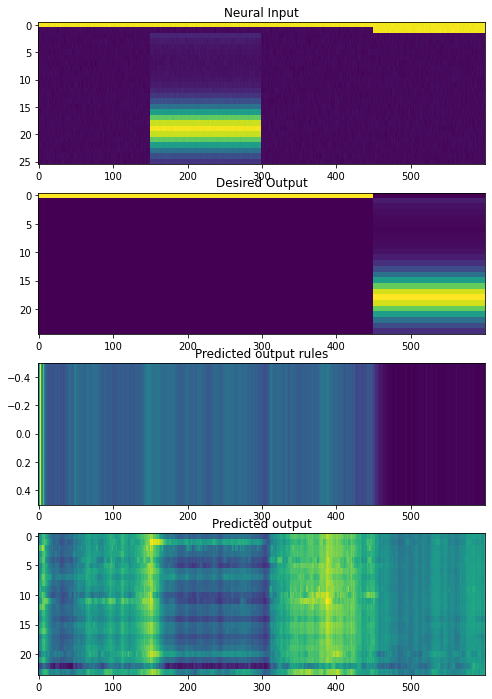

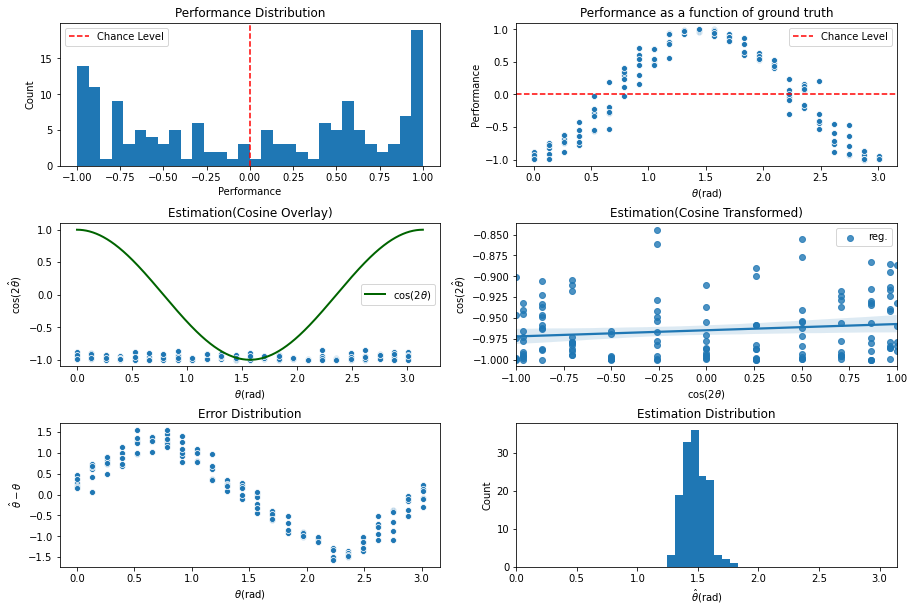

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter400/assets

 Training performance: 
Iter.  401 | Performance -0.0959 | Loss 0.3501 | Spike loss 2.7185
Testing performance: 
Iter.  401 | Performance 0.0108 | Loss 0.3455 | Spike loss 2.7182

 Training performance: 
Iter.  402 | Performance -0.0785 | Loss 0.3458 | Spike loss 2.7060
Testing performance: 
Iter.  402 | Performance 0.0116 | Loss 0.3469 | Spike loss 2.7237

 Training performance: 
Iter.  403 | Performance 0.0460 | Loss 0.3460 | Spike loss 2.7162
Testing performance: 
Iter.  403 | Performance -0.0218 | Loss 0.3478 | Spike loss 2.7171

 Training performance: 
Iter.  404 | Performance -0.0262 | Loss 0.3498 | Spike loss 2.7125
Testing performance: 
Iter.  404 | Performance -0.0077 | Loss 0.3469 | Spike loss 2.7407

 Training performance: 
Iter.  405 | Performance 0.0088 | Loss 0.3459 | Spike loss 2.7241
Testing performance: 
Iter.  405 | Performance 0.0019 | Loss 0.3443 | Spike loss 2.7424

 Tr


 Training performance: 
Iter.  447 | Performance -0.0988 | Loss 0.3407 | Spike loss 2.7598
Testing performance: 
Iter.  447 | Performance -0.0291 | Loss 0.3429 | Spike loss 2.7914

 Training performance: 
Iter.  448 | Performance 0.1061 | Loss 0.3417 | Spike loss 2.7794
Testing performance: 
Iter.  448 | Performance -0.0196 | Loss 0.3456 | Spike loss 2.8099

 Training performance: 
Iter.  449 | Performance 0.0618 | Loss 0.3453 | Spike loss 2.8015
Testing performance: 
Iter.  449 | Performance -0.0196 | Loss 0.3420 | Spike loss 2.7971

 Training performance: 
Iter.  450 | Performance 0.0532 | Loss 0.3417 | Spike loss 2.8113
Testing performance: 
Iter.  450 | Performance -0.0149 | Loss 0.3423 | Spike loss 2.8268

 Training performance: 
Iter.  451 | Performance 0.1340 | Loss 0.3401 | Spike loss 2.8307
Testing performance: 
Iter.  451 | Performance -0.0088 | Loss 0.3443 | Spike loss 2.8447

 Training performance: 
Iter.  452 | Performance -0.0055 | Loss 0.3446 | Spike loss 2.8488
Testing


 Training performance: 
Iter.  493 | Performance 0.0513 | Loss 0.3377 | Spike loss 2.8516
Testing performance: 
Iter.  493 | Performance -0.0099 | Loss 0.3396 | Spike loss 2.8683

 Training performance: 
Iter.  494 | Performance 0.0218 | Loss 0.3404 | Spike loss 2.8328
Testing performance: 
Iter.  494 | Performance -0.0146 | Loss 0.3377 | Spike loss 2.8650

 Training performance: 
Iter.  495 | Performance 0.0526 | Loss 0.3363 | Spike loss 2.8700
Testing performance: 
Iter.  495 | Performance -0.0108 | Loss 0.3387 | Spike loss 2.8522

 Training performance: 
Iter.  496 | Performance -0.0033 | Loss 0.3380 | Spike loss 2.8527
Testing performance: 
Iter.  496 | Performance -0.0031 | Loss 0.3415 | Spike loss 2.8435

 Training performance: 
Iter.  497 | Performance -0.0687 | Loss 0.3418 | Spike loss 2.8430
Testing performance: 
Iter.  497 | Performance -0.0073 | Loss 0.3377 | Spike loss 2.8377

 Training performance: 
Iter.  498 | Performance -0.0542 | Loss 0.3382 | Spike loss 2.8462
Testin

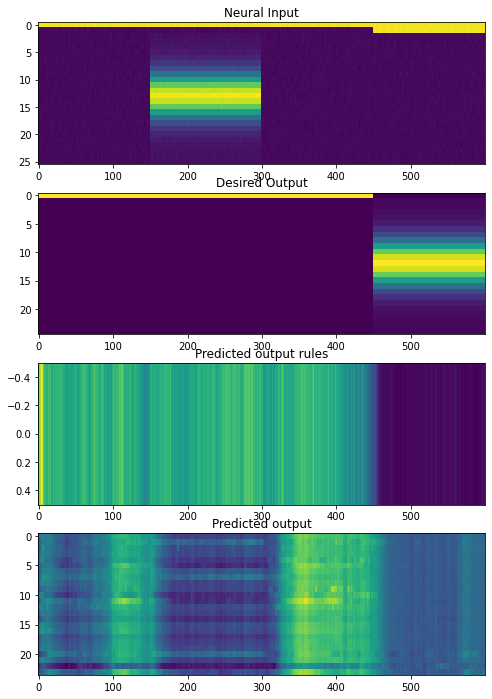

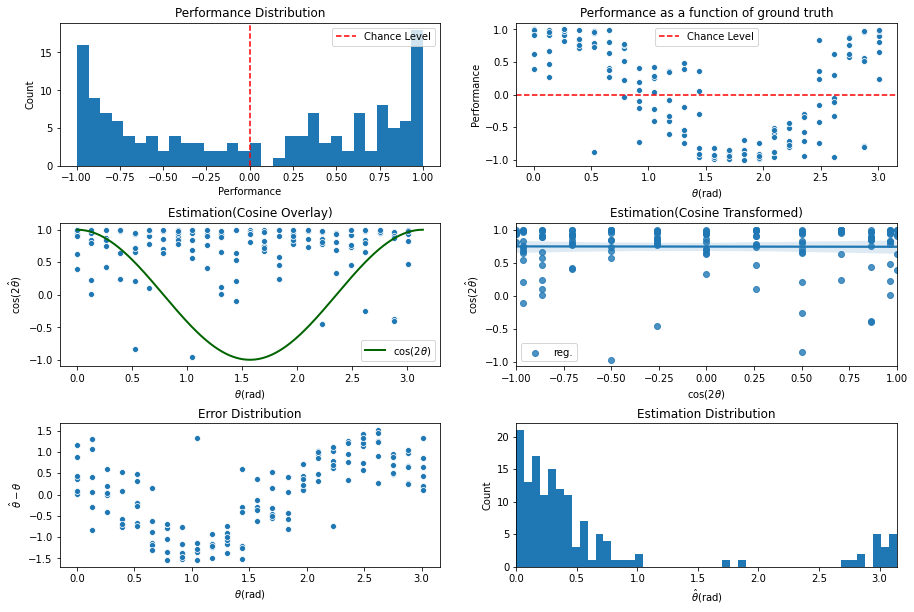

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter500/assets

 Training performance: 
Iter.  501 | Performance -0.0697 | Loss 0.3383 | Spike loss 2.8519
Testing performance: 
Iter.  501 | Performance 0.0011 | Loss 0.3387 | Spike loss 2.8576

 Training performance: 
Iter.  502 | Performance -0.0788 | Loss 0.3373 | Spike loss 2.8642
Testing performance: 
Iter.  502 | Performance 0.0146 | Loss 0.3390 | Spike loss 2.8769

 Training performance: 
Iter.  503 | Performance 0.0190 | Loss 0.3407 | Spike loss 2.8528
Testing performance: 
Iter.  503 | Performance -0.0093 | Loss 0.3369 | Spike loss 2.8615

 Training performance: 
Iter.  504 | Performance -0.0660 | Loss 0.3367 | Spike loss 2.8642
Testing performance: 
Iter.  504 | Performance 0.0247 | Loss 0.3363 | Spike loss 2.8805

 Training performance: 
Iter.  505 | Performance 0.0549 | Loss 0.3387 | Spike loss 2.8682
Testing performance: 
Iter.  505 | Performance 0.0167 | Loss 0.3398 | Spike loss 2.8793

 Tra


 Training performance: 
Iter.  547 | Performance 0.0534 | Loss 0.3339 | Spike loss 2.8260
Testing performance: 
Iter.  547 | Performance 0.0169 | Loss 0.3381 | Spike loss 2.8406

 Training performance: 
Iter.  548 | Performance -0.0408 | Loss 0.3378 | Spike loss 2.8453
Testing performance: 
Iter.  548 | Performance 0.0049 | Loss 0.3342 | Spike loss 2.8254

 Training performance: 
Iter.  549 | Performance -0.0531 | Loss 0.3349 | Spike loss 2.8315
Testing performance: 
Iter.  549 | Performance -0.0013 | Loss 0.3358 | Spike loss 2.8001

 Training performance: 
Iter.  550 | Performance -0.1310 | Loss 0.3369 | Spike loss 2.8375
Testing performance: 
Iter.  550 | Performance 0.0254 | Loss 0.3391 | Spike loss 2.8308

 Training performance: 
Iter.  551 | Performance 0.0261 | Loss 0.3368 | Spike loss 2.8126
Testing performance: 
Iter.  551 | Performance 0.0021 | Loss 0.3359 | Spike loss 2.8175

 Training performance: 
Iter.  552 | Performance 0.0189 | Loss 0.3338 | Spike loss 2.8161
Testing pe


 Training performance: 
Iter.  593 | Performance -0.0454 | Loss 0.3357 | Spike loss 2.7868
Testing performance: 
Iter.  593 | Performance 0.0116 | Loss 0.3340 | Spike loss 2.7669

 Training performance: 
Iter.  594 | Performance 0.0250 | Loss 0.3325 | Spike loss 2.7819
Testing performance: 
Iter.  594 | Performance 0.0130 | Loss 0.3334 | Spike loss 2.7751

 Training performance: 
Iter.  595 | Performance -0.0160 | Loss 0.3335 | Spike loss 2.7545
Testing performance: 
Iter.  595 | Performance 0.0155 | Loss 0.3356 | Spike loss 2.7730

 Training performance: 
Iter.  596 | Performance 0.0101 | Loss 0.3348 | Spike loss 2.7840
Testing performance: 
Iter.  596 | Performance 0.0549 | Loss 0.3321 | Spike loss 2.7768

 Training performance: 
Iter.  597 | Performance -0.0248 | Loss 0.3323 | Spike loss 2.7960
Testing performance: 
Iter.  597 | Performance -0.0037 | Loss 0.3341 | Spike loss 2.7629

 Training performance: 
Iter.  598 | Performance -0.0942 | Loss 0.3321 | Spike loss 2.7808
Testing p

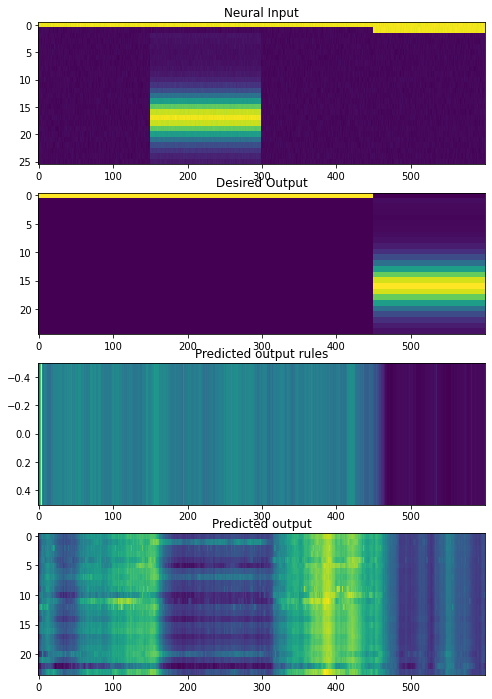

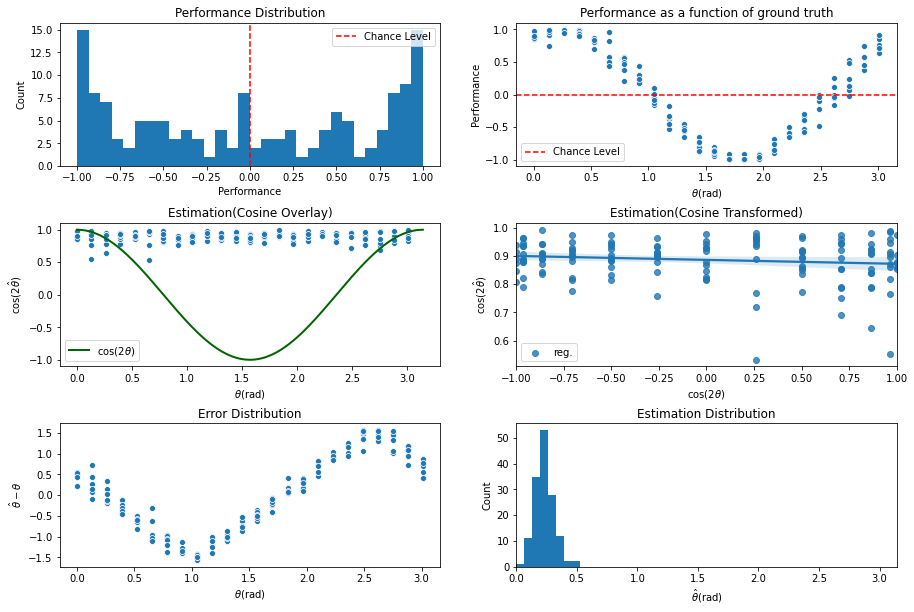

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter600/assets

 Training performance: 
Iter.  601 | Performance 0.0247 | Loss 0.3331 | Spike loss 2.7848
Testing performance: 
Iter.  601 | Performance -0.0064 | Loss 0.3363 | Spike loss 2.7706

 Training performance: 
Iter.  602 | Performance 0.0426 | Loss 0.3347 | Spike loss 2.7901
Testing performance: 
Iter.  602 | Performance 0.0103 | Loss 0.3328 | Spike loss 2.7775

 Training performance: 
Iter.  603 | Performance -0.0002 | Loss 0.3322 | Spike loss 2.7624
Testing performance: 
Iter.  603 | Performance 0.0043 | Loss 0.3335 | Spike loss 2.7773

 Training performance: 
Iter.  604 | Performance 0.0094 | Loss 0.3339 | Spike loss 2.7804
Testing performance: 
Iter.  604 | Performance 0.0123 | Loss 0.3344 | Spike loss 2.7826

 Training performance: 
Iter.  605 | Performance 0.1267 | Loss 0.3354 | Spike loss 2.7730
Testing performance: 
Iter.  605 | Performance 0.0208 | Loss 0.3332 | Spike loss 2.7606

 Train


 Training performance: 
Iter.  647 | Performance 0.0483 | Loss 0.3337 | Spike loss 2.7524
Testing performance: 
Iter.  647 | Performance 0.0106 | Loss 0.3308 | Spike loss 2.7370

 Training performance: 
Iter.  648 | Performance -0.0049 | Loss 0.3301 | Spike loss 2.7425
Testing performance: 
Iter.  648 | Performance 0.0067 | Loss 0.3314 | Spike loss 2.7058

 Training performance: 
Iter.  649 | Performance 0.0536 | Loss 0.3314 | Spike loss 2.7012
Testing performance: 
Iter.  649 | Performance 0.0052 | Loss 0.3323 | Spike loss 2.7067

 Training performance: 
Iter.  650 | Performance -0.0247 | Loss 0.3324 | Spike loss 2.7000
Testing performance: 
Iter.  650 | Performance 0.0037 | Loss 0.3311 | Spike loss 2.7084

 Training performance: 
Iter.  651 | Performance -0.0916 | Loss 0.3316 | Spike loss 2.7068
Testing performance: 
Iter.  651 | Performance -0.0333 | Loss 0.3323 | Spike loss 2.7191

 Training performance: 
Iter.  652 | Performance 0.0232 | Loss 0.3305 | Spike loss 2.7232
Testing pe


 Training performance: 
Iter.  693 | Performance -0.1031 | Loss 0.3299 | Spike loss 2.7213
Testing performance: 
Iter.  693 | Performance 0.0325 | Loss 0.3299 | Spike loss 2.7278

 Training performance: 
Iter.  694 | Performance -0.0470 | Loss 0.3302 | Spike loss 2.7121
Testing performance: 
Iter.  694 | Performance 0.0105 | Loss 0.3315 | Spike loss 2.7412

 Training performance: 
Iter.  695 | Performance -0.0284 | Loss 0.3324 | Spike loss 2.7287
Testing performance: 
Iter.  695 | Performance 0.0060 | Loss 0.3288 | Spike loss 2.7283

 Training performance: 
Iter.  696 | Performance 0.0166 | Loss 0.3295 | Spike loss 2.7096
Testing performance: 
Iter.  696 | Performance 0.0035 | Loss 0.3309 | Spike loss 2.7100

 Training performance: 
Iter.  697 | Performance 0.0559 | Loss 0.3301 | Spike loss 2.7033
Testing performance: 
Iter.  697 | Performance 0.0205 | Loss 0.3313 | Spike loss 2.6962

 Training performance: 
Iter.  698 | Performance 0.0454 | Loss 0.3309 | Spike loss 2.6919
Testing per

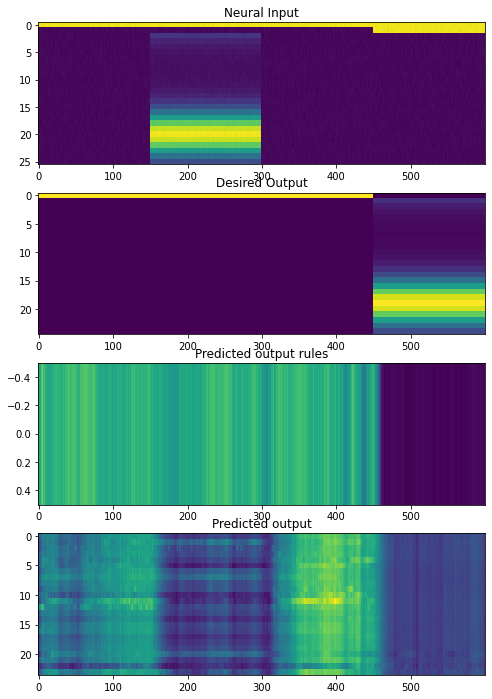

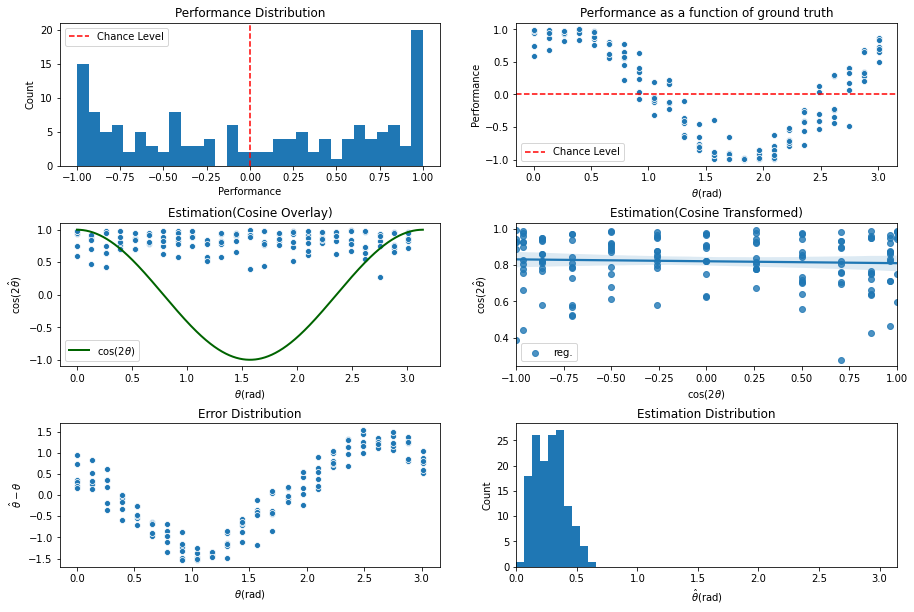

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter700/assets

 Training performance: 
Iter.  701 | Performance 0.0594 | Loss 0.3315 | Spike loss 2.6937
Testing performance: 
Iter.  701 | Performance 0.0577 | Loss 0.3305 | Spike loss 2.6842

 Training performance: 
Iter.  702 | Performance 0.1375 | Loss 0.3292 | Spike loss 2.6972
Testing performance: 
Iter.  702 | Performance -0.0062 | Loss 0.3300 | Spike loss 2.6814

 Training performance: 
Iter.  703 | Performance 0.0668 | Loss 0.3298 | Spike loss 2.6763
Testing performance: 
Iter.  703 | Performance -0.0102 | Loss 0.3317 | Spike loss 2.6701

 Training performance: 
Iter.  704 | Performance -0.0552 | Loss 0.3312 | Spike loss 2.6800
Testing performance: 
Iter.  704 | Performance -0.0022 | Loss 0.3291 | Spike loss 2.6702

 Training performance: 
Iter.  705 | Performance 0.0304 | Loss 0.3291 | Spike loss 2.6938
Testing performance: 
Iter.  705 | Performance 0.0247 | Loss 0.3299 | Spike loss 2.6862

 Tra


 Training performance: 
Iter.  747 | Performance -0.0269 | Loss 0.3277 | Spike loss 2.6414
Testing performance: 
Iter.  747 | Performance 0.0185 | Loss 0.3283 | Spike loss 2.6290

 Training performance: 
Iter.  748 | Performance -0.1174 | Loss 0.3300 | Spike loss 2.6282
Testing performance: 
Iter.  748 | Performance -0.0106 | Loss 0.3301 | Spike loss 2.6119

 Training performance: 
Iter.  749 | Performance 0.0752 | Loss 0.3292 | Spike loss 2.6273
Testing performance: 
Iter.  749 | Performance 0.0301 | Loss 0.3277 | Spike loss 2.6251

 Training performance: 
Iter.  750 | Performance 0.0440 | Loss 0.3294 | Spike loss 2.6424
Testing performance: 
Iter.  750 | Performance 0.0284 | Loss 0.3292 | Spike loss 2.6326

 Training performance: 
Iter.  751 | Performance -0.0468 | Loss 0.3287 | Spike loss 2.6379
Testing performance: 
Iter.  751 | Performance 0.0295 | Loss 0.3304 | Spike loss 2.6404

 Training performance: 
Iter.  752 | Performance -0.0222 | Loss 0.3300 | Spike loss 2.6286
Testing p


 Training performance: 
Iter.  793 | Performance 0.1138 | Loss 0.3275 | Spike loss 2.6212
Testing performance: 
Iter.  793 | Performance 0.0107 | Loss 0.3299 | Spike loss 2.6100

 Training performance: 
Iter.  794 | Performance -0.0290 | Loss 0.3288 | Spike loss 2.6061
Testing performance: 
Iter.  794 | Performance 0.0101 | Loss 0.3269 | Spike loss 2.6097

 Training performance: 
Iter.  795 | Performance -0.0128 | Loss 0.3275 | Spike loss 2.6009
Testing performance: 
Iter.  795 | Performance 0.0246 | Loss 0.3275 | Spike loss 2.6063

 Training performance: 
Iter.  796 | Performance 0.0040 | Loss 0.3281 | Spike loss 2.6038
Testing performance: 
Iter.  796 | Performance 0.0109 | Loss 0.3297 | Spike loss 2.5939

 Training performance: 
Iter.  797 | Performance -0.0115 | Loss 0.3290 | Spike loss 2.5953
Testing performance: 
Iter.  797 | Performance 0.0359 | Loss 0.3280 | Spike loss 2.5825

 Training performance: 
Iter.  798 | Performance 0.0842 | Loss 0.3273 | Spike loss 2.5888
Testing per

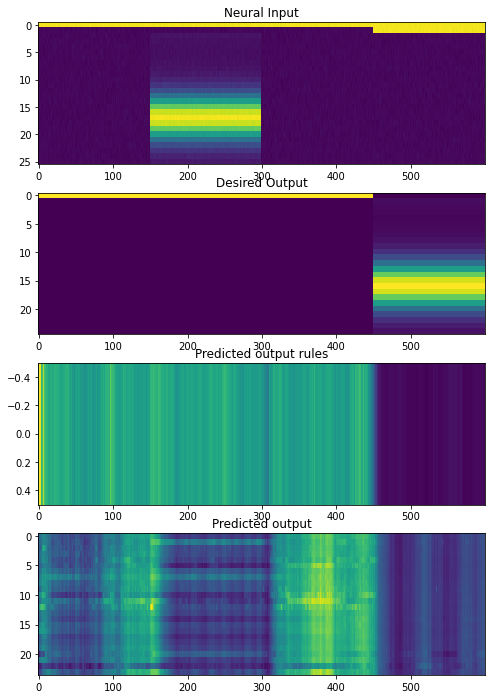

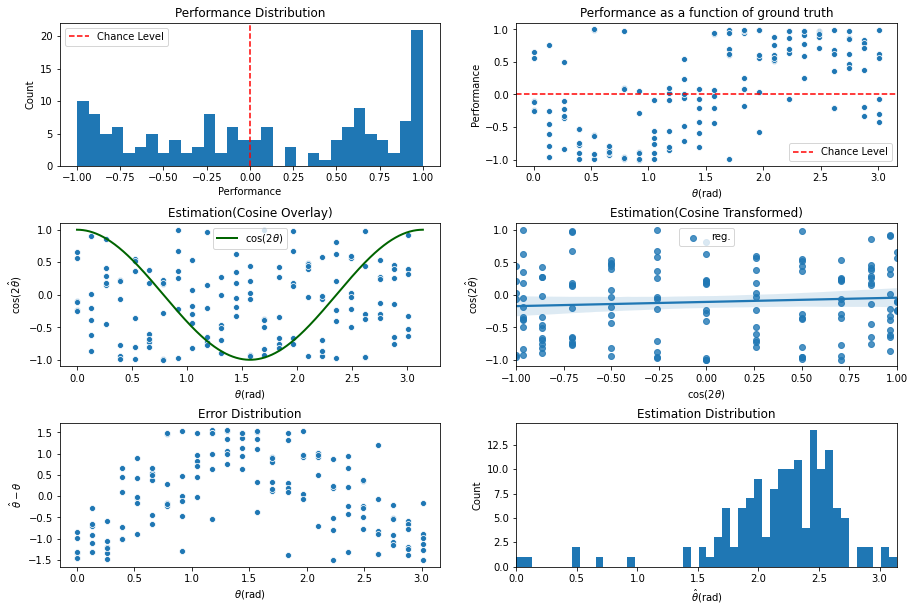

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter800/assets

 Training performance: 
Iter.  801 | Performance 0.0116 | Loss 0.3265 | Spike loss 2.5972
Testing performance: 
Iter.  801 | Performance 0.0705 | Loss 0.3284 | Spike loss 2.6187

 Training performance: 
Iter.  802 | Performance 0.0105 | Loss 0.3276 | Spike loss 2.6052
Testing performance: 
Iter.  802 | Performance 0.0849 | Loss 0.3288 | Spike loss 2.6213

 Training performance: 
Iter.  803 | Performance 0.0602 | Loss 0.3295 | Spike loss 2.6258
Testing performance: 
Iter.  803 | Performance 0.0652 | Loss 0.3269 | Spike loss 2.6134

 Training performance: 
Iter.  804 | Performance -0.0443 | Loss 0.3267 | Spike loss 2.6047
Testing performance: 
Iter.  804 | Performance -0.0199 | Loss 0.3273 | Spike loss 2.5874

 Training performance: 
Iter.  805 | Performance 0.1378 | Loss 0.3269 | Spike loss 2.5946
Testing performance: 
Iter.  805 | Performance 0.0461 | Loss 0.3292 | Spike loss 2.5829

 Train


 Training performance: 
Iter.  847 | Performance 0.0181 | Loss 0.3264 | Spike loss 2.5601
Testing performance: 
Iter.  847 | Performance 0.0018 | Loss 0.3278 | Spike loss 2.5344

 Training performance: 
Iter.  848 | Performance -0.0092 | Loss 0.3283 | Spike loss 2.5277
Testing performance: 
Iter.  848 | Performance 0.0137 | Loss 0.3260 | Spike loss 2.5311

 Training performance: 
Iter.  849 | Performance 0.0716 | Loss 0.3262 | Spike loss 2.5377
Testing performance: 
Iter.  849 | Performance 0.0114 | Loss 0.3274 | Spike loss 2.5414

 Training performance: 
Iter.  850 | Performance 0.0140 | Loss 0.3276 | Spike loss 2.5281
Testing performance: 
Iter.  850 | Performance 0.0492 | Loss 0.3280 | Spike loss 2.5195

 Training performance: 
Iter.  851 | Performance -0.0309 | Loss 0.3279 | Spike loss 2.5318
Testing performance: 
Iter.  851 | Performance 0.0320 | Loss 0.3261 | Spike loss 2.5268

 Training performance: 
Iter.  852 | Performance 0.0888 | Loss 0.3264 | Spike loss 2.5607
Testing perf


 Training performance: 
Iter.  893 | Performance 0.1367 | Loss 0.3269 | Spike loss 2.5120
Testing performance: 
Iter.  893 | Performance 0.0043 | Loss 0.3259 | Spike loss 2.5173

 Training performance: 
Iter.  894 | Performance -0.0146 | Loss 0.3252 | Spike loss 2.5084
Testing performance: 
Iter.  894 | Performance 0.0027 | Loss 0.3264 | Spike loss 2.5135

 Training performance: 
Iter.  895 | Performance -0.0360 | Loss 0.3262 | Spike loss 2.5174
Testing performance: 
Iter.  895 | Performance 0.0309 | Loss 0.3269 | Spike loss 2.5150

 Training performance: 
Iter.  896 | Performance 0.0843 | Loss 0.3263 | Spike loss 2.5288
Testing performance: 
Iter.  896 | Performance 0.0041 | Loss 0.3260 | Spike loss 2.5294

 Training performance: 
Iter.  897 | Performance 0.0464 | Loss 0.3252 | Spike loss 2.5353
Testing performance: 
Iter.  897 | Performance 0.0048 | Loss 0.3267 | Spike loss 2.5400

 Training performance: 
Iter.  898 | Performance -0.0129 | Loss 0.3264 | Spike loss 2.5304
Testing per

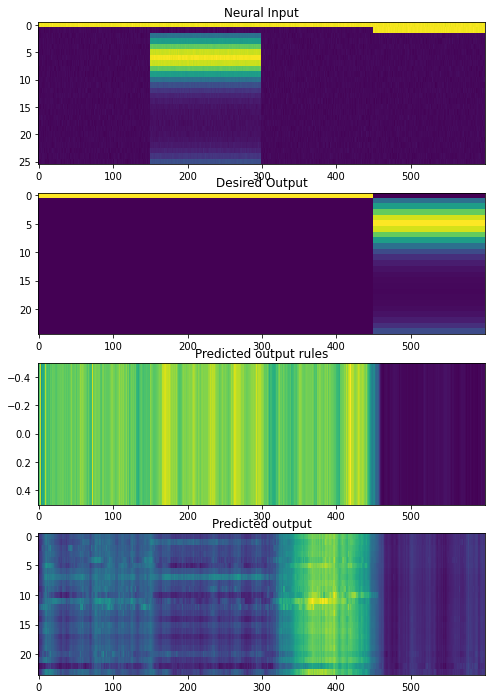

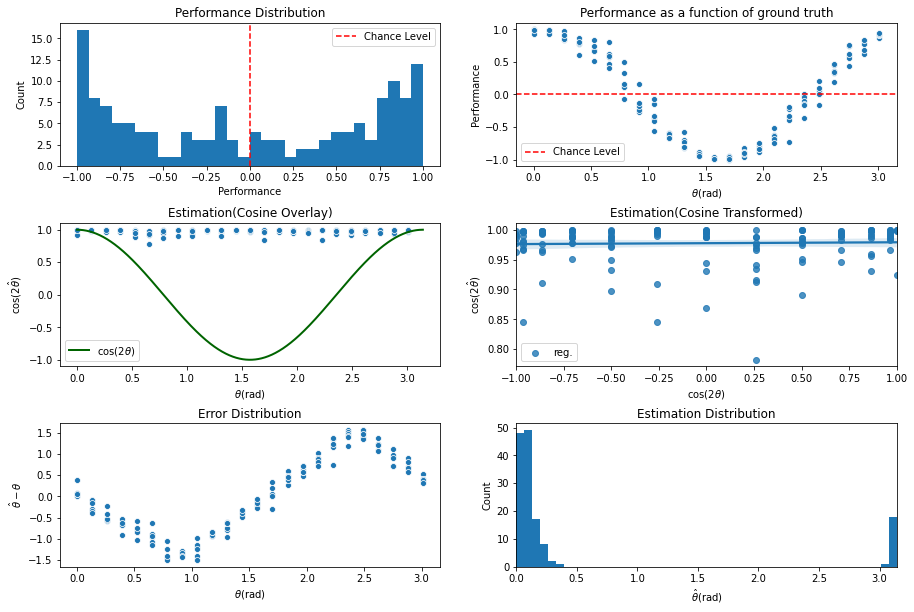

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter900/assets

 Training performance: 
Iter.  901 | Performance -0.0837 | Loss 0.3261 | Spike loss 2.5064
Testing performance: 
Iter.  901 | Performance 0.0226 | Loss 0.3271 | Spike loss 2.5241

 Training performance: 
Iter.  902 | Performance 0.0455 | Loss 0.3280 | Spike loss 2.5089
Testing performance: 
Iter.  902 | Performance 0.0233 | Loss 0.3264 | Spike loss 2.5085

 Training performance: 
Iter.  903 | Performance 0.1336 | Loss 0.3248 | Spike loss 2.5194
Testing performance: 
Iter.  903 | Performance 0.0069 | Loss 0.3256 | Spike loss 2.5307

 Training performance: 
Iter.  904 | Performance 0.0263 | Loss 0.3262 | Spike loss 2.5122
Testing performance: 
Iter.  904 | Performance 0.0218 | Loss 0.3266 | Spike loss 2.5293

 Training performance: 
Iter.  905 | Performance -0.0025 | Loss 0.3273 | Spike loss 2.5299
Testing performance: 
Iter.  905 | Performance 0.0226 | Loss 0.3251 | Spike loss 2.5146

 Train


 Training performance: 
Iter.  947 | Performance 0.0403 | Loss 0.3268 | Spike loss 2.4840
Testing performance: 
Iter.  947 | Performance 0.0138 | Loss 0.3260 | Spike loss 2.4755

 Training performance: 
Iter.  948 | Performance -0.0453 | Loss 0.3256 | Spike loss 2.4785
Testing performance: 
Iter.  948 | Performance -0.0012 | Loss 0.3252 | Spike loss 2.4736

 Training performance: 
Iter.  949 | Performance 0.0779 | Loss 0.3247 | Spike loss 2.4787
Testing performance: 
Iter.  949 | Performance 0.0108 | Loss 0.3263 | Spike loss 2.4791

 Training performance: 
Iter.  950 | Performance 0.0050 | Loss 0.3265 | Spike loss 2.4717
Testing performance: 
Iter.  950 | Performance 0.0106 | Loss 0.3248 | Spike loss 2.4744

 Training performance: 
Iter.  951 | Performance 0.0403 | Loss 0.3248 | Spike loss 2.4764
Testing performance: 
Iter.  951 | Performance 0.0065 | Loss 0.3257 | Spike loss 2.4883

 Training performance: 
Iter.  952 | Performance -0.0042 | Loss 0.3255 | Spike loss 2.4575
Testing per


 Training performance: 
Iter.  993 | Performance 0.0626 | Loss 0.3244 | Spike loss 2.4257
Testing performance: 
Iter.  993 | Performance 0.0704 | Loss 0.3241 | Spike loss 2.4308

 Training performance: 
Iter.  994 | Performance 0.1440 | Loss 0.3244 | Spike loss 2.4393
Testing performance: 
Iter.  994 | Performance 0.0775 | Loss 0.3263 | Spike loss 2.4351

 Training performance: 
Iter.  995 | Performance 0.0337 | Loss 0.3262 | Spike loss 2.4537
Testing performance: 
Iter.  995 | Performance 0.0105 | Loss 0.3244 | Spike loss 2.4374

 Training performance: 
Iter.  996 | Performance 0.0412 | Loss 0.3244 | Spike loss 2.4351
Testing performance: 
Iter.  996 | Performance 0.0232 | Loss 0.3251 | Spike loss 2.4422

 Training performance: 
Iter.  997 | Performance -0.0292 | Loss 0.3261 | Spike loss 2.4325
Testing performance: 
Iter.  997 | Performance 0.0023 | Loss 0.3264 | Spike loss 2.4425

 Training performance: 
Iter.  998 | Performance 0.0055 | Loss 0.3255 | Spike loss 2.4433
Testing perfo

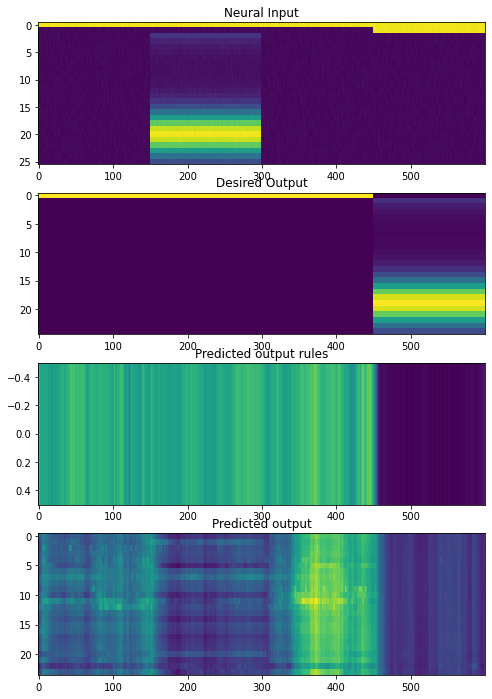

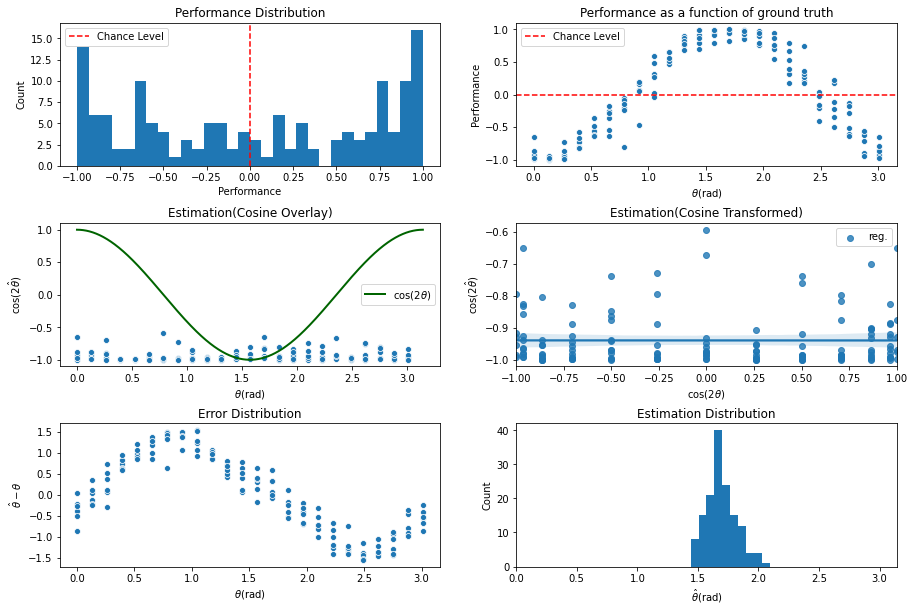

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter1000/assets

 Training performance: 
Iter. 1001 | Performance -0.0052 | Loss 0.3261 | Spike loss 2.4424
Testing performance: 
Iter. 1001 | Performance 0.0666 | Loss 0.3242 | Spike loss 2.4434

 Training performance: 
Iter. 1002 | Performance 0.0258 | Loss 0.3240 | Spike loss 2.4238
Testing performance: 
Iter. 1002 | Performance 0.0617 | Loss 0.3245 | Spike loss 2.4414

 Training performance: 
Iter. 1003 | Performance 0.0609 | Loss 0.3249 | Spike loss 2.4271
Testing performance: 
Iter. 1003 | Performance 0.0333 | Loss 0.3256 | Spike loss 2.4228

 Training performance: 
Iter. 1004 | Performance 0.2024 | Loss 0.3252 | Spike loss 2.4271
Testing performance: 
Iter. 1004 | Performance 0.0322 | Loss 0.3241 | Spike loss 2.4239

 Training performance: 
Iter. 1005 | Performance -0.0701 | Loss 0.3246 | Spike loss 2.4214
Testing performance: 
Iter. 1005 | Performance 0.0575 | Loss 0.3249 | Spike loss 2.4286

 Trai


 Training performance: 
Iter. 1047 | Performance -0.0569 | Loss 0.3236 | Spike loss 2.3935
Testing performance: 
Iter. 1047 | Performance 0.1312 | Loss 0.3240 | Spike loss 2.3957

 Training performance: 
Iter. 1048 | Performance 0.0632 | Loss 0.3241 | Spike loss 2.3878
Testing performance: 
Iter. 1048 | Performance 0.0837 | Loss 0.3257 | Spike loss 2.3684

 Training performance: 
Iter. 1049 | Performance 0.1409 | Loss 0.3242 | Spike loss 2.3892
Testing performance: 
Iter. 1049 | Performance 0.0295 | Loss 0.3237 | Spike loss 2.3680

 Training performance: 
Iter. 1050 | Performance -0.0235 | Loss 0.3233 | Spike loss 2.3761
Testing performance: 
Iter. 1050 | Performance 0.0430 | Loss 0.3246 | Spike loss 2.3667

 Training performance: 
Iter. 1051 | Performance -0.0363 | Loss 0.3241 | Spike loss 2.3645
Testing performance: 
Iter. 1051 | Performance 0.0320 | Loss 0.3257 | Spike loss 2.3658

 Training performance: 
Iter. 1052 | Performance -0.0045 | Loss 0.3252 | Spike loss 2.3744
Testing pe


 Training performance: 
Iter. 1093 | Performance -0.0019 | Loss 0.3244 | Spike loss 2.3806
Testing performance: 
Iter. 1093 | Performance 0.0205 | Loss 0.3255 | Spike loss 2.3749

 Training performance: 
Iter. 1094 | Performance 0.0819 | Loss 0.3252 | Spike loss 2.3742
Testing performance: 
Iter. 1094 | Performance 0.0169 | Loss 0.3240 | Spike loss 2.3887

 Training performance: 
Iter. 1095 | Performance 0.0995 | Loss 0.3237 | Spike loss 2.3960
Testing performance: 
Iter. 1095 | Performance 0.0125 | Loss 0.3247 | Spike loss 2.3837

 Training performance: 
Iter. 1096 | Performance -0.0010 | Loss 0.3246 | Spike loss 2.3769
Testing performance: 
Iter. 1096 | Performance 0.0105 | Loss 0.3259 | Spike loss 2.3971

 Training performance: 
Iter. 1097 | Performance -0.0199 | Loss 0.3260 | Spike loss 2.3930
Testing performance: 
Iter. 1097 | Performance 0.0156 | Loss 0.3236 | Spike loss 2.3860

 Training performance: 
Iter. 1098 | Performance 0.0678 | Loss 0.3235 | Spike loss 2.3804
Testing per

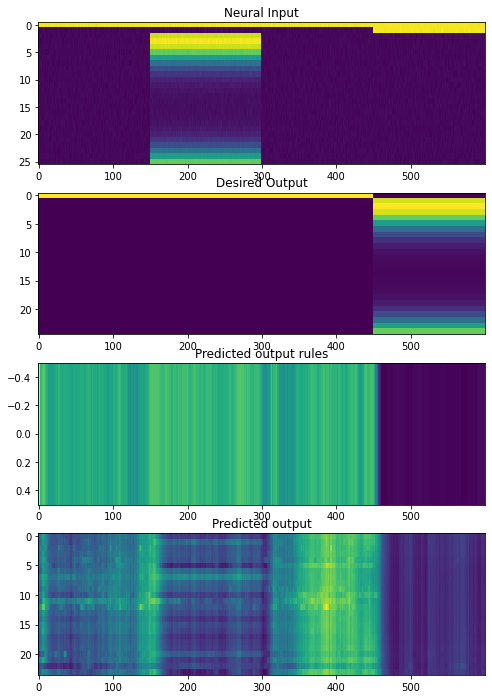

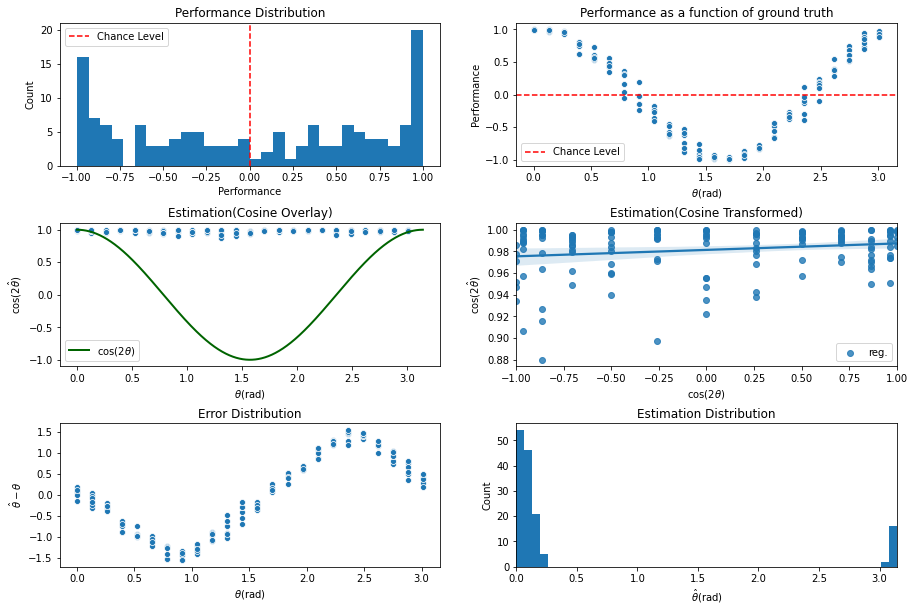

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter1100/assets

 Training performance: 
Iter. 1101 | Performance -0.0554 | Loss 0.3237 | Spike loss 2.3656
Testing performance: 
Iter. 1101 | Performance 0.0526 | Loss 0.3243 | Spike loss 2.3775

 Training performance: 
Iter. 1102 | Performance 0.0054 | Loss 0.3237 | Spike loss 2.3804
Testing performance: 
Iter. 1102 | Performance 0.0538 | Loss 0.3250 | Spike loss 2.3756

 Training performance: 
Iter. 1103 | Performance 0.0671 | Loss 0.3258 | Spike loss 2.3741
Testing performance: 
Iter. 1103 | Performance 0.0456 | Loss 0.3236 | Spike loss 2.3683

 Training performance: 
Iter. 1104 | Performance -0.0258 | Loss 0.3243 | Spike loss 2.3741
Testing performance: 
Iter. 1104 | Performance 0.0241 | Loss 0.3234 | Spike loss 2.3834

 Training performance: 
Iter. 1105 | Performance -0.0836 | Loss 0.3244 | Spike loss 2.3910
Testing performance: 
Iter. 1105 | Performance 0.0183 | Loss 0.3252 | Spike loss 2.3735

 Tra


 Training performance: 
Iter. 1147 | Performance 0.0417 | Loss 0.3232 | Spike loss 2.3407
Testing performance: 
Iter. 1147 | Performance -0.0003 | Loss 0.3247 | Spike loss 2.3534

 Training performance: 
Iter. 1148 | Performance -0.0741 | Loss 0.3251 | Spike loss 2.3341
Testing performance: 
Iter. 1148 | Performance 0.0063 | Loss 0.3230 | Spike loss 2.3321

 Training performance: 
Iter. 1149 | Performance 0.0085 | Loss 0.3231 | Spike loss 2.3468
Testing performance: 
Iter. 1149 | Performance 0.0148 | Loss 0.3238 | Spike loss 2.3360

 Training performance: 
Iter. 1150 | Performance -0.0220 | Loss 0.3243 | Spike loss 2.3390
Testing performance: 
Iter. 1150 | Performance 0.0191 | Loss 0.3246 | Spike loss 2.3376

 Training performance: 
Iter. 1151 | Performance 0.1577 | Loss 0.3238 | Spike loss 2.3342
Testing performance: 
Iter. 1151 | Performance 0.0207 | Loss 0.3234 | Spike loss 2.3411

 Training performance: 
Iter. 1152 | Performance -0.0698 | Loss 0.3238 | Spike loss 2.3292
Testing pe


 Training performance: 
Iter. 1193 | Performance -0.0487 | Loss 0.3247 | Spike loss 2.3100
Testing performance: 
Iter. 1193 | Performance -0.0073 | Loss 0.3227 | Spike loss 2.2938

 Training performance: 
Iter. 1194 | Performance -0.0112 | Loss 0.3226 | Spike loss 2.2990
Testing performance: 
Iter. 1194 | Performance 0.0224 | Loss 0.3233 | Spike loss 2.3028

 Training performance: 
Iter. 1195 | Performance -0.0393 | Loss 0.3228 | Spike loss 2.2961
Testing performance: 
Iter. 1195 | Performance 0.0456 | Loss 0.3245 | Spike loss 2.2950

 Training performance: 
Iter. 1196 | Performance 0.0290 | Loss 0.3243 | Spike loss 2.3116
Testing performance: 
Iter. 1196 | Performance 0.0421 | Loss 0.3228 | Spike loss 2.3039

 Training performance: 
Iter. 1197 | Performance 0.0599 | Loss 0.3223 | Spike loss 2.3068
Testing performance: 
Iter. 1197 | Performance 0.1771 | Loss 0.3226 | Spike loss 2.3058

 Training performance: 
Iter. 1198 | Performance 0.2407 | Loss 0.3224 | Spike loss 2.3089
Testing pe

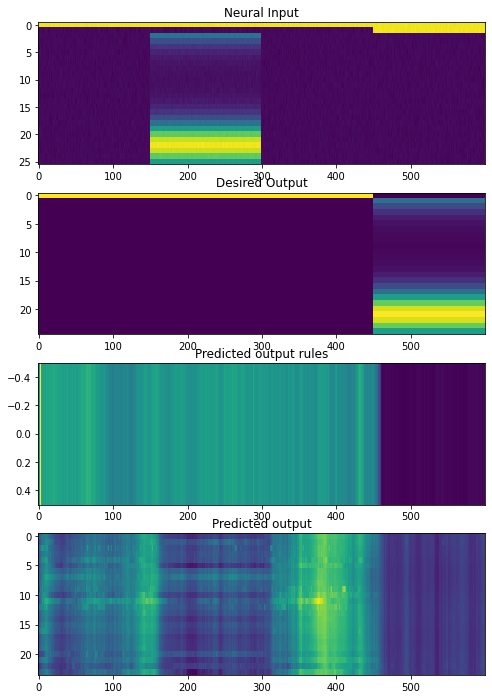

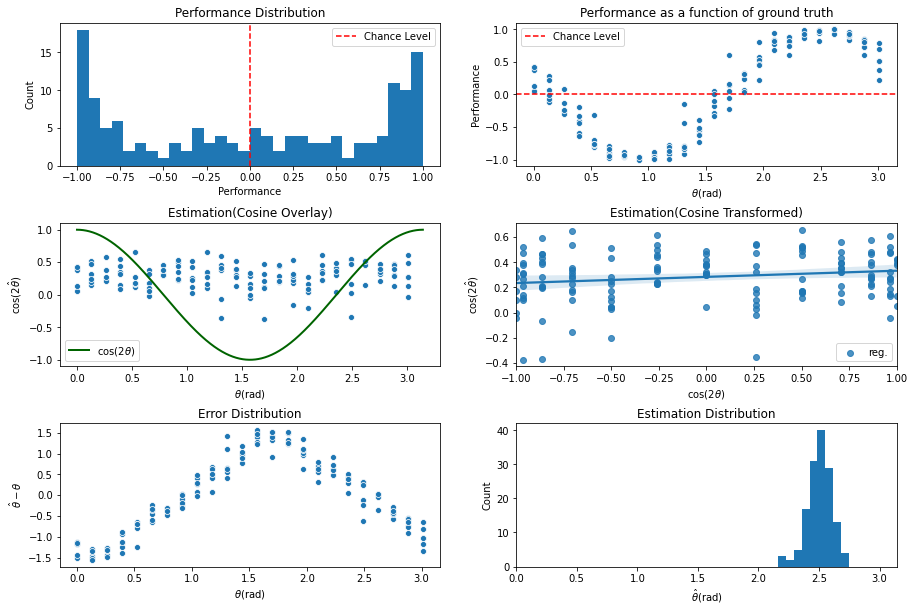

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter1200/assets

 Training performance: 
Iter. 1201 | Performance 0.0656 | Loss 0.3233 | Spike loss 2.3054
Testing performance: 
Iter. 1201 | Performance 0.0026 | Loss 0.3245 | Spike loss 2.2935

 Training performance: 
Iter. 1202 | Performance 0.0190 | Loss 0.3244 | Spike loss 2.3142
Testing performance: 
Iter. 1202 | Performance -0.0053 | Loss 0.3226 | Spike loss 2.3052

 Training performance: 
Iter. 1203 | Performance 0.0219 | Loss 0.3228 | Spike loss 2.3067
Testing performance: 
Iter. 1203 | Performance 0.0012 | Loss 0.3230 | Spike loss 2.2971

 Training performance: 
Iter. 1204 | Performance -0.0606 | Loss 0.3234 | Spike loss 2.3045
Testing performance: 
Iter. 1204 | Performance 0.0085 | Loss 0.3240 | Spike loss 2.3235

 Training performance: 
Iter. 1205 | Performance 0.1117 | Loss 0.3236 | Spike loss 2.3186
Testing performance: 
Iter. 1205 | Performance 0.0062 | Loss 0.3226 | Spike loss 2.3008

 Trai


 Training performance: 
Iter. 1247 | Performance -0.0242 | Loss 0.3242 | Spike loss 2.3064
Testing performance: 
Iter. 1247 | Performance 0.0356 | Loss 0.3223 | Spike loss 2.2932

 Training performance: 
Iter. 1248 | Performance -0.0257 | Loss 0.3227 | Spike loss 2.2953
Testing performance: 
Iter. 1248 | Performance 0.0237 | Loss 0.3228 | Spike loss 2.2899

 Training performance: 
Iter. 1249 | Performance -0.0139 | Loss 0.3228 | Spike loss 2.3051
Testing performance: 
Iter. 1249 | Performance 0.0252 | Loss 0.3237 | Spike loss 2.2962

 Training performance: 
Iter. 1250 | Performance -0.0348 | Loss 0.3239 | Spike loss 2.2782
Testing performance: 
Iter. 1250 | Performance 0.0948 | Loss 0.3219 | Spike loss 2.2779

 Training performance: 
Iter. 1251 | Performance -0.0620 | Loss 0.3226 | Spike loss 2.2741
Testing performance: 
Iter. 1251 | Performance 0.0975 | Loss 0.3225 | Spike loss 2.2953

 Training performance: 
Iter. 1252 | Performance 0.1755 | Loss 0.3223 | Spike loss 2.2934
Testing p


 Training performance: 
Iter. 1293 | Performance 0.0728 | Loss 0.3223 | Spike loss 2.2604
Testing performance: 
Iter. 1293 | Performance 0.0226 | Loss 0.3224 | Spike loss 2.2755

 Training performance: 
Iter. 1294 | Performance 0.0479 | Loss 0.3222 | Spike loss 2.2720
Testing performance: 
Iter. 1294 | Performance 0.0532 | Loss 0.3234 | Spike loss 2.2861

 Training performance: 
Iter. 1295 | Performance 0.0400 | Loss 0.3237 | Spike loss 2.2769
Testing performance: 
Iter. 1295 | Performance 0.0277 | Loss 0.3221 | Spike loss 2.2930

 Training performance: 
Iter. 1296 | Performance 0.1409 | Loss 0.3218 | Spike loss 2.3044
Testing performance: 
Iter. 1296 | Performance 0.0197 | Loss 0.3225 | Spike loss 2.2830

 Training performance: 
Iter. 1297 | Performance 0.0587 | Loss 0.3222 | Spike loss 2.2799
Testing performance: 
Iter. 1297 | Performance 0.0371 | Loss 0.3234 | Spike loss 2.2745

 Training performance: 
Iter. 1298 | Performance 0.0710 | Loss 0.3229 | Spike loss 2.2838
Testing perfor

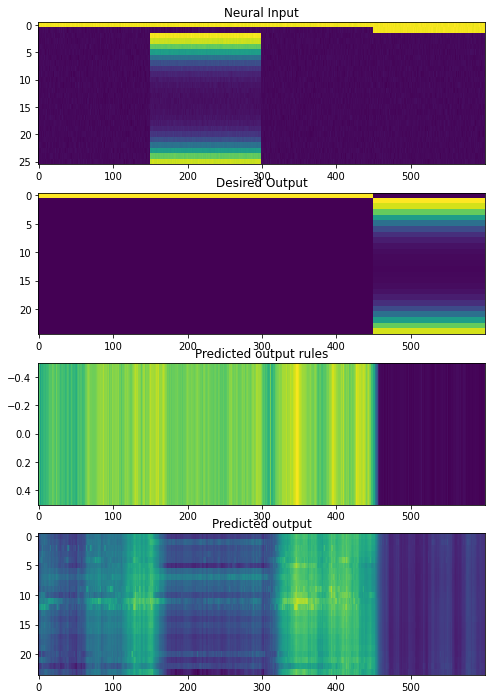

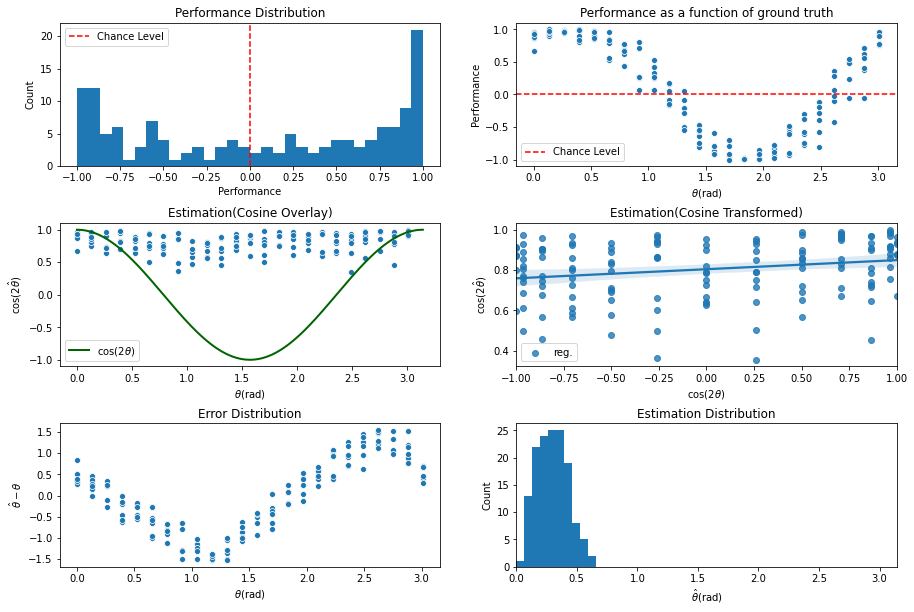

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter1300/assets

 Training performance: 
Iter. 1301 | Performance 0.1204 | Loss 0.3230 | Spike loss 2.2872
Testing performance: 
Iter. 1301 | Performance 0.0446 | Loss 0.3218 | Spike loss 2.2666

 Training performance: 
Iter. 1302 | Performance 0.0502 | Loss 0.3218 | Spike loss 2.2688
Testing performance: 
Iter. 1302 | Performance 0.0900 | Loss 0.3222 | Spike loss 2.2592

 Training performance: 
Iter. 1303 | Performance 0.0092 | Loss 0.3222 | Spike loss 2.2599
Testing performance: 
Iter. 1303 | Performance 0.0347 | Loss 0.3231 | Spike loss 2.2560

 Training performance: 
Iter. 1304 | Performance -0.0474 | Loss 0.3233 | Spike loss 2.2474
Testing performance: 
Iter. 1304 | Performance 0.0905 | Loss 0.3218 | Spike loss 2.2483

 Training performance: 
Iter. 1305 | Performance 0.1308 | Loss 0.3211 | Spike loss 2.2404
Testing performance: 
Iter. 1305 | Performance 0.0609 | Loss 0.3227 | Spike loss 2.2490

 Train


 Training performance: 
Iter. 1347 | Performance -0.0390 | Loss 0.3223 | Spike loss 2.2195
Testing performance: 
Iter. 1347 | Performance 0.0245 | Loss 0.3223 | Spike loss 2.2145

 Training performance: 
Iter. 1348 | Performance 0.0480 | Loss 0.3224 | Spike loss 2.2209
Testing performance: 
Iter. 1348 | Performance 0.0542 | Loss 0.3232 | Spike loss 2.2166

 Training performance: 
Iter. 1349 | Performance 0.0302 | Loss 0.3230 | Spike loss 2.2338
Testing performance: 
Iter. 1349 | Performance 0.0932 | Loss 0.3219 | Spike loss 2.2178

 Training performance: 
Iter. 1350 | Performance 0.1995 | Loss 0.3215 | Spike loss 2.2151
Testing performance: 
Iter. 1350 | Performance 0.0816 | Loss 0.3220 | Spike loss 2.2059

 Training performance: 
Iter. 1351 | Performance 0.1170 | Loss 0.3213 | Spike loss 2.2112
Testing performance: 
Iter. 1351 | Performance 0.0266 | Loss 0.3231 | Spike loss 2.1997

 Training performance: 
Iter. 1352 | Performance 0.0342 | Loss 0.3230 | Spike loss 2.1949
Testing perfo


 Training performance: 
Iter. 1393 | Performance 0.1188 | Loss 0.3216 | Spike loss 2.1921
Testing performance: 
Iter. 1393 | Performance 0.0400 | Loss 0.3229 | Spike loss 2.2034

 Training performance: 
Iter. 1394 | Performance -0.0325 | Loss 0.3228 | Spike loss 2.2024
Testing performance: 
Iter. 1394 | Performance 0.0245 | Loss 0.3224 | Spike loss 2.2019

 Training performance: 
Iter. 1395 | Performance 0.0745 | Loss 0.3214 | Spike loss 2.1919
Testing performance: 
Iter. 1395 | Performance 0.0240 | Loss 0.3222 | Spike loss 2.2023

 Training performance: 
Iter. 1396 | Performance -0.1065 | Loss 0.3227 | Spike loss 2.1999
Testing performance: 
Iter. 1396 | Performance 0.0272 | Loss 0.3235 | Spike loss 2.1973

 Training performance: 
Iter. 1397 | Performance 0.0493 | Loss 0.3232 | Spike loss 2.2125
Testing performance: 
Iter. 1397 | Performance 0.0332 | Loss 0.3217 | Spike loss 2.1902

 Training performance: 
Iter. 1398 | Performance 0.0041 | Loss 0.3218 | Spike loss 2.1973
Testing perf

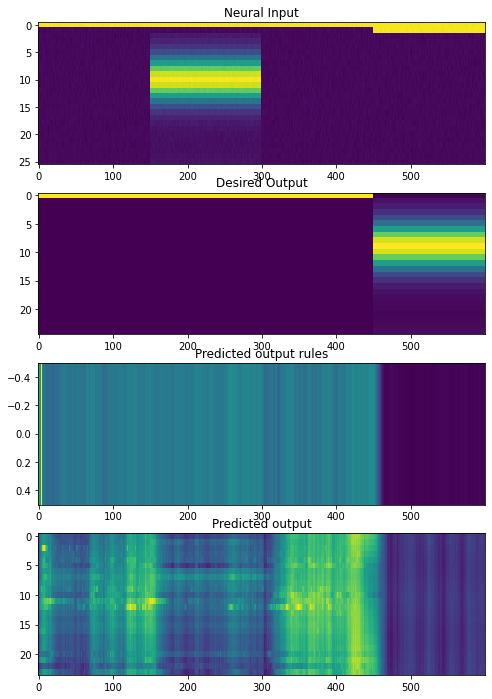

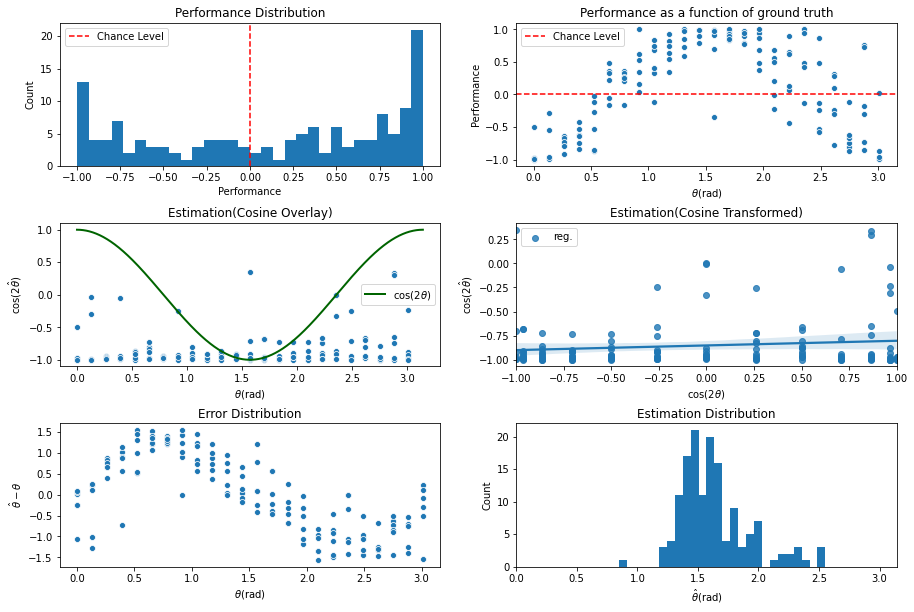

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter1400/assets

 Training performance: 
Iter. 1401 | Performance 0.0310 | Loss 0.3215 | Spike loss 2.2113
Testing performance: 
Iter. 1401 | Performance 0.1187 | Loss 0.3219 | Spike loss 2.2128

 Training performance: 
Iter. 1402 | Performance 0.0925 | Loss 0.3216 | Spike loss 2.1932
Testing performance: 
Iter. 1402 | Performance 0.0759 | Loss 0.3231 | Spike loss 2.2054

 Training performance: 
Iter. 1403 | Performance 0.0857 | Loss 0.3226 | Spike loss 2.2129
Testing performance: 
Iter. 1403 | Performance 0.0543 | Loss 0.3215 | Spike loss 2.2106

 Training performance: 
Iter. 1404 | Performance 0.0898 | Loss 0.3215 | Spike loss 2.2030
Testing performance: 
Iter. 1404 | Performance 0.0204 | Loss 0.3220 | Spike loss 2.2135

 Training performance: 
Iter. 1405 | Performance 0.0546 | Loss 0.3218 | Spike loss 2.1943
Testing performance: 
Iter. 1405 | Performance 0.0144 | Loss 0.3230 | Spike loss 2.1851

 Traini


 Training performance: 
Iter. 1447 | Performance 0.2135 | Loss 0.3208 | Spike loss 2.1713
Testing performance: 
Iter. 1447 | Performance 0.0184 | Loss 0.3229 | Spike loss 2.1556

 Training performance: 
Iter. 1448 | Performance 0.1142 | Loss 0.3224 | Spike loss 2.1743
Testing performance: 
Iter. 1448 | Performance 0.0085 | Loss 0.3219 | Spike loss 2.1767

 Training performance: 
Iter. 1449 | Performance -0.0045 | Loss 0.3217 | Spike loss 2.1737
Testing performance: 
Iter. 1449 | Performance 0.0140 | Loss 0.3225 | Spike loss 2.1655

 Training performance: 
Iter. 1450 | Performance 0.0128 | Loss 0.3221 | Spike loss 2.1649
Testing performance: 
Iter. 1450 | Performance 0.0027 | Loss 0.3237 | Spike loss 2.1843

 Training performance: 
Iter. 1451 | Performance -0.0082 | Loss 0.3239 | Spike loss 2.1804
Testing performance: 
Iter. 1451 | Performance 0.0069 | Loss 0.3224 | Spike loss 2.1870

 Training performance: 
Iter. 1452 | Performance 0.0566 | Loss 0.3218 | Spike loss 2.1820
Testing perf


 Training performance: 
Iter. 1493 | Performance 0.1238 | Loss 0.3216 | Spike loss 2.1569
Testing performance: 
Iter. 1493 | Performance 0.0195 | Loss 0.3210 | Spike loss 2.1466

 Training performance: 
Iter. 1494 | Performance 0.0112 | Loss 0.3211 | Spike loss 2.1658
Testing performance: 
Iter. 1494 | Performance 0.0160 | Loss 0.3215 | Spike loss 2.1446

 Training performance: 
Iter. 1495 | Performance -0.1686 | Loss 0.3234 | Spike loss 2.1375
Testing performance: 
Iter. 1495 | Performance 0.0238 | Loss 0.3229 | Spike loss 2.1430

 Training performance: 
Iter. 1496 | Performance 0.0228 | Loss 0.3224 | Spike loss 2.1429
Testing performance: 
Iter. 1496 | Performance 0.0204 | Loss 0.3208 | Spike loss 2.1307

 Training performance: 
Iter. 1497 | Performance 0.1098 | Loss 0.3206 | Spike loss 2.1498
Testing performance: 
Iter. 1497 | Performance 0.0398 | Loss 0.3210 | Spike loss 2.1571

 Training performance: 
Iter. 1498 | Performance 0.0260 | Loss 0.3211 | Spike loss 2.1449
Testing perfo

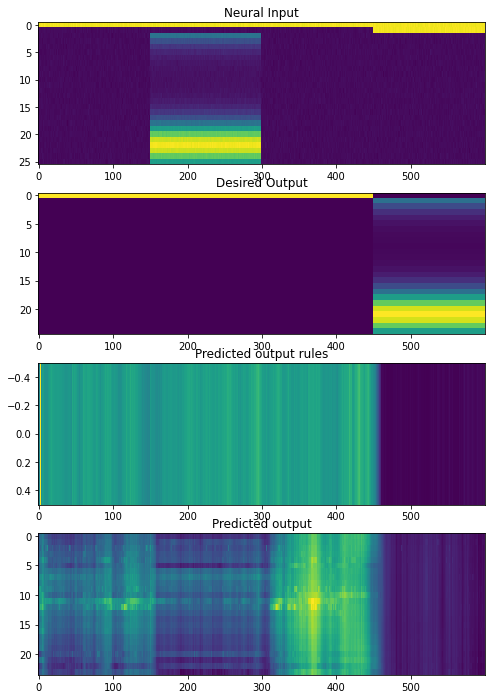

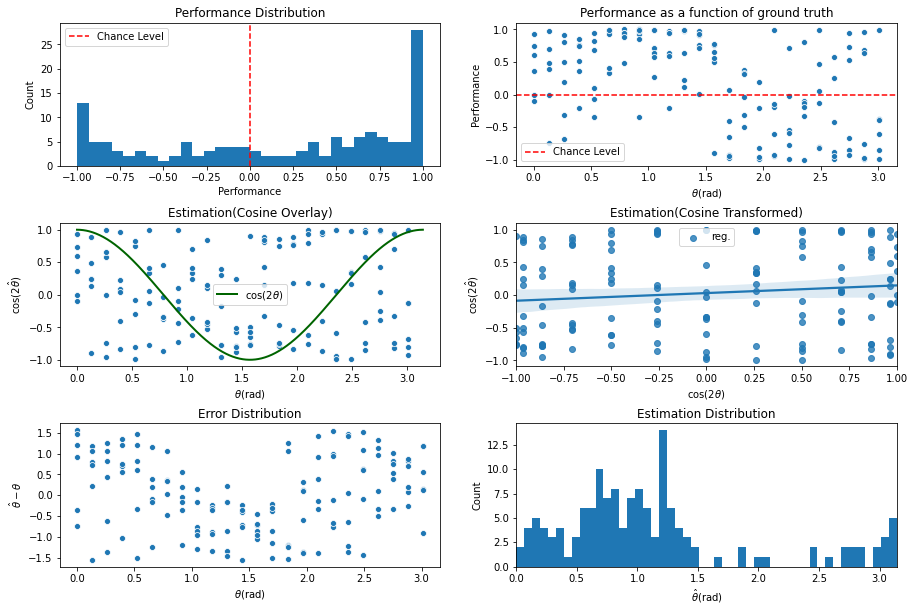

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter1500/assets

 Training performance: 
Iter. 1501 | Performance 0.2062 | Loss 0.3213 | Spike loss 2.1375
Testing performance: 
Iter. 1501 | Performance 0.0762 | Loss 0.3218 | Spike loss 2.1258

 Training performance: 
Iter. 1502 | Performance 0.0063 | Loss 0.3222 | Spike loss 2.1339
Testing performance: 
Iter. 1502 | Performance 0.0441 | Loss 0.3208 | Spike loss 2.1348

 Training performance: 
Iter. 1503 | Performance 0.0077 | Loss 0.3206 | Spike loss 2.1362
Testing performance: 
Iter. 1503 | Performance 0.0274 | Loss 0.3214 | Spike loss 2.1359

 Training performance: 
Iter. 1504 | Performance 0.0236 | Loss 0.3213 | Spike loss 2.1353
Testing performance: 
Iter. 1504 | Performance 0.0229 | Loss 0.3223 | Spike loss 2.1361

 Training performance: 
Iter. 1505 | Performance 0.0941 | Loss 0.3219 | Spike loss 2.1349
Testing performance: 
Iter. 1505 | Performance 0.0224 | Loss 0.3211 | Spike loss 2.1435

 Traini


 Training performance: 
Iter. 1547 | Performance 0.1058 | Loss 0.3218 | Spike loss 2.1220
Testing performance: 
Iter. 1547 | Performance 0.0833 | Loss 0.3210 | Spike loss 2.1233

 Training performance: 
Iter. 1548 | Performance 0.0903 | Loss 0.3211 | Spike loss 2.1089
Testing performance: 
Iter. 1548 | Performance 0.1040 | Loss 0.3213 | Spike loss 2.0942

 Training performance: 
Iter. 1549 | Performance 0.0643 | Loss 0.3209 | Spike loss 2.1097
Testing performance: 
Iter. 1549 | Performance 0.1132 | Loss 0.3219 | Spike loss 2.1079

 Training performance: 
Iter. 1550 | Performance 0.0977 | Loss 0.3220 | Spike loss 2.1054
Testing performance: 
Iter. 1550 | Performance 0.1941 | Loss 0.3206 | Spike loss 2.1132

 Training performance: 
Iter. 1551 | Performance 0.0278 | Loss 0.3208 | Spike loss 2.1034
Testing performance: 
Iter. 1551 | Performance 0.1305 | Loss 0.3209 | Spike loss 2.1239

 Training performance: 
Iter. 1552 | Performance 0.1523 | Loss 0.3212 | Spike loss 2.1174
Testing perfor


 Training performance: 
Iter. 1593 | Performance 0.0004 | Loss 0.3208 | Spike loss 2.0863
Testing performance: 
Iter. 1593 | Performance 0.0548 | Loss 0.3207 | Spike loss 2.0765

 Training performance: 
Iter. 1594 | Performance 0.0720 | Loss 0.3204 | Spike loss 2.0926
Testing performance: 
Iter. 1594 | Performance 0.0910 | Loss 0.3225 | Spike loss 2.0850

 Training performance: 
Iter. 1595 | Performance 0.0558 | Loss 0.3210 | Spike loss 2.0873
Testing performance: 
Iter. 1595 | Performance 0.1311 | Loss 0.3203 | Spike loss 2.0836

 Training performance: 
Iter. 1596 | Performance 0.1568 | Loss 0.3201 | Spike loss 2.0836
Testing performance: 
Iter. 1596 | Performance 0.0904 | Loss 0.3211 | Spike loss 2.0628

 Training performance: 
Iter. 1597 | Performance 0.0558 | Loss 0.3209 | Spike loss 2.0719
Testing performance: 
Iter. 1597 | Performance 0.1137 | Loss 0.3219 | Spike loss 2.0790

 Training performance: 
Iter. 1598 | Performance 0.1036 | Loss 0.3215 | Spike loss 2.0914
Testing perfor

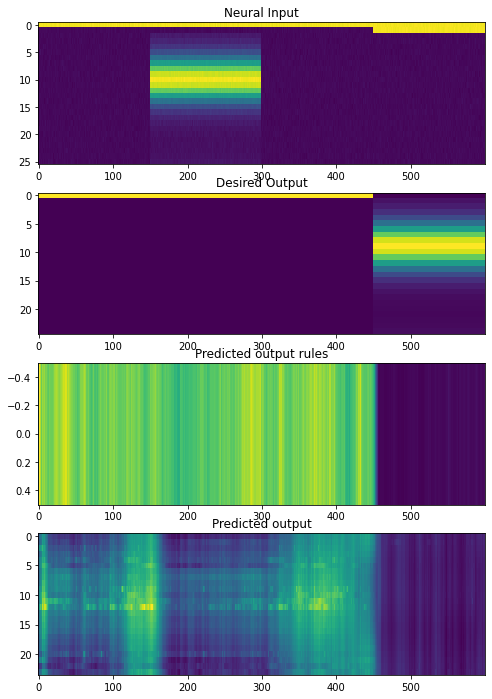

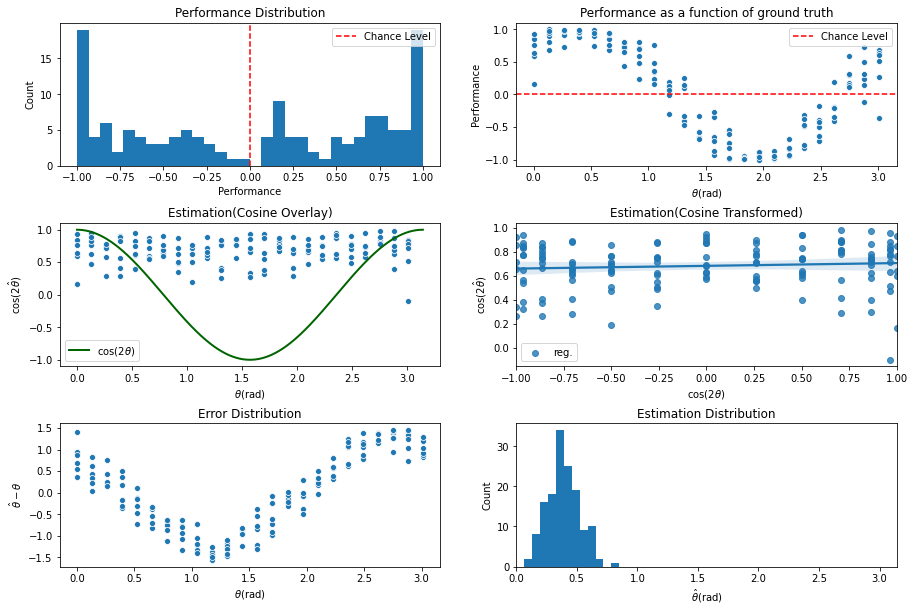

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter1600/assets

 Training performance: 
Iter. 1601 | Performance 0.1122 | Loss 0.3220 | Spike loss 2.1262
Testing performance: 
Iter. 1601 | Performance 0.0683 | Loss 0.3207 | Spike loss 2.1163

 Training performance: 
Iter. 1602 | Performance 0.1589 | Loss 0.3200 | Spike loss 2.1083
Testing performance: 
Iter. 1602 | Performance 0.0506 | Loss 0.3207 | Spike loss 2.1049

 Training performance: 
Iter. 1603 | Performance 0.0976 | Loss 0.3202 | Spike loss 2.1095
Testing performance: 
Iter. 1603 | Performance 0.0690 | Loss 0.3219 | Spike loss 2.1111

 Training performance: 
Iter. 1604 | Performance 0.0145 | Loss 0.3220 | Spike loss 2.1057
Testing performance: 
Iter. 1604 | Performance 0.0914 | Loss 0.3203 | Spike loss 2.1017

 Training performance: 
Iter. 1605 | Performance 0.1435 | Loss 0.3192 | Spike loss 2.1264
Testing performance: 
Iter. 1605 | Performance 0.1066 | Loss 0.3211 | Spike loss 2.1108

 Traini


 Training performance: 
Iter. 1647 | Performance 0.0332 | Loss 0.3207 | Spike loss 2.0971
Testing performance: 
Iter. 1647 | Performance 0.0882 | Loss 0.3206 | Spike loss 2.1229

 Training performance: 
Iter. 1648 | Performance 0.1816 | Loss 0.3196 | Spike loss 2.1182
Testing performance: 
Iter. 1648 | Performance 0.0941 | Loss 0.3212 | Spike loss 2.1114

 Training performance: 
Iter. 1649 | Performance 0.1246 | Loss 0.3211 | Spike loss 2.1250
Testing performance: 
Iter. 1649 | Performance 0.1004 | Loss 0.3197 | Spike loss 2.1076

 Training performance: 
Iter. 1650 | Performance 0.1887 | Loss 0.3194 | Spike loss 2.1166
Testing performance: 
Iter. 1650 | Performance 0.0960 | Loss 0.3206 | Spike loss 2.1156

 Training performance: 
Iter. 1651 | Performance 0.1052 | Loss 0.3206 | Spike loss 2.0983
Testing performance: 
Iter. 1651 | Performance 0.0901 | Loss 0.3216 | Spike loss 2.1096

 Training performance: 
Iter. 1652 | Performance 0.1638 | Loss 0.3214 | Spike loss 2.1077
Testing perfor


 Training performance: 
Iter. 1693 | Performance 0.2161 | Loss 0.3195 | Spike loss 2.1165
Testing performance: 
Iter. 1693 | Performance 0.0818 | Loss 0.3220 | Spike loss 2.1253

 Training performance: 
Iter. 1694 | Performance 0.1588 | Loss 0.3209 | Spike loss 2.1076
Testing performance: 
Iter. 1694 | Performance 0.0885 | Loss 0.3205 | Spike loss 2.1135

 Training performance: 
Iter. 1695 | Performance 0.0415 | Loss 0.3205 | Spike loss 2.1103
Testing performance: 
Iter. 1695 | Performance 0.0762 | Loss 0.3205 | Spike loss 2.0974

 Training performance: 
Iter. 1696 | Performance 0.0974 | Loss 0.3207 | Spike loss 2.1121
Testing performance: 
Iter. 1696 | Performance 0.0796 | Loss 0.3213 | Spike loss 2.1249

 Training performance: 
Iter. 1697 | Performance 0.1192 | Loss 0.3210 | Spike loss 2.1172
Testing performance: 
Iter. 1697 | Performance 0.0842 | Loss 0.3200 | Spike loss 2.1009

 Training performance: 
Iter. 1698 | Performance -0.1074 | Loss 0.3222 | Spike loss 2.1081
Testing perfo

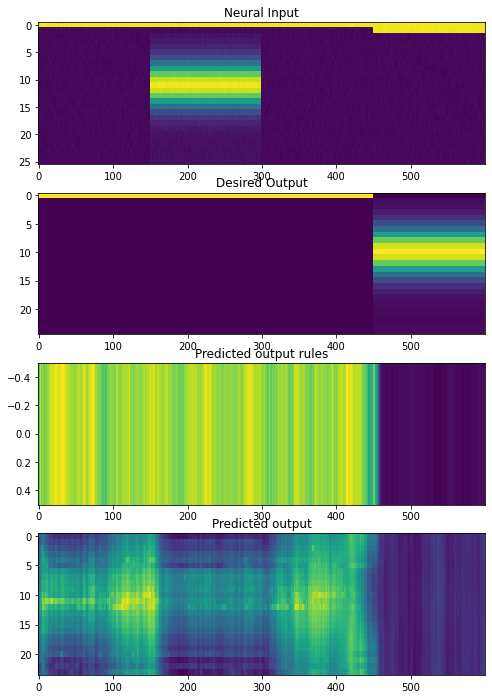

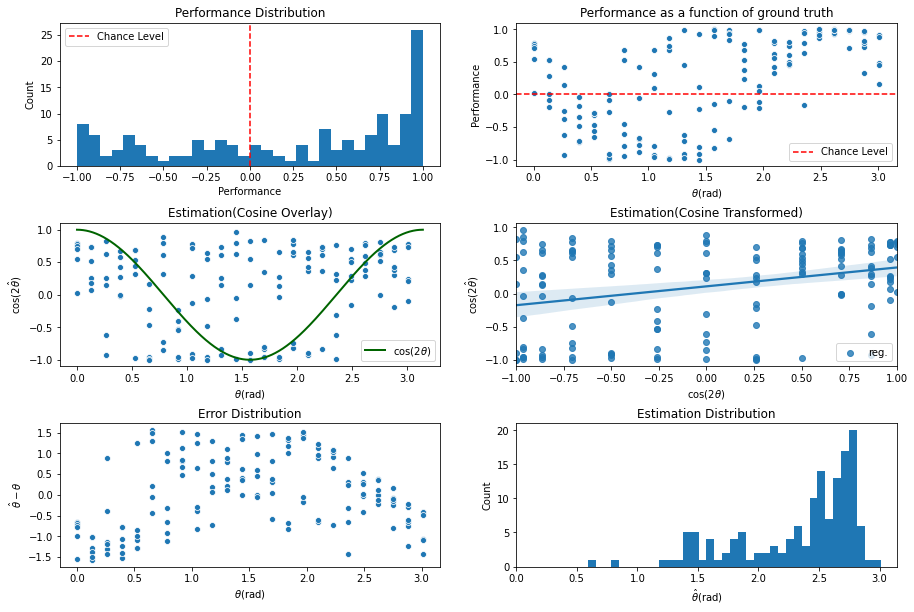

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter1700/assets

 Training performance: 
Iter. 1701 | Performance 0.0954 | Loss 0.3200 | Spike loss 2.0850
Testing performance: 
Iter. 1701 | Performance 0.1261 | Loss 0.3198 | Spike loss 2.0841

 Training performance: 
Iter. 1702 | Performance 0.2440 | Loss 0.3192 | Spike loss 2.0907
Testing performance: 
Iter. 1702 | Performance 0.1106 | Loss 0.3212 | Spike loss 2.0710

 Training performance: 
Iter. 1703 | Performance 0.1802 | Loss 0.3205 | Spike loss 2.0931
Testing performance: 
Iter. 1703 | Performance 0.0741 | Loss 0.3198 | Spike loss 2.0831

 Training performance: 
Iter. 1704 | Performance -0.0945 | Loss 0.3226 | Spike loss 2.0718
Testing performance: 
Iter. 1704 | Performance 0.0880 | Loss 0.3201 | Spike loss 2.0783

 Training performance: 
Iter. 1705 | Performance 0.1121 | Loss 0.3207 | Spike loss 2.0776
Testing performance: 
Iter. 1705 | Performance 0.1042 | Loss 0.3214 | Spike loss 2.0991

 Train


 Training performance: 
Iter. 1747 | Performance 0.0710 | Loss 0.3196 | Spike loss 2.1148
Testing performance: 
Iter. 1747 | Performance 0.1506 | Loss 0.3205 | Spike loss 2.1515

 Training performance: 
Iter. 1748 | Performance 0.2191 | Loss 0.3200 | Spike loss 2.1527
Testing performance: 
Iter. 1748 | Performance 0.1692 | Loss 0.3186 | Spike loss 2.1556

 Training performance: 
Iter. 1749 | Performance 0.1938 | Loss 0.3189 | Spike loss 2.1446
Testing performance: 
Iter. 1749 | Performance 0.2460 | Loss 0.3190 | Spike loss 2.1467

 Training performance: 
Iter. 1750 | Performance 0.1613 | Loss 0.3195 | Spike loss 2.1614
Testing performance: 
Iter. 1750 | Performance 0.2586 | Loss 0.3201 | Spike loss 2.1284

 Training performance: 
Iter. 1751 | Performance 0.2963 | Loss 0.3199 | Spike loss 2.1217
Testing performance: 
Iter. 1751 | Performance 0.3228 | Loss 0.3185 | Spike loss 2.1042

 Training performance: 
Iter. 1752 | Performance 0.2352 | Loss 0.3196 | Spike loss 2.0948
Testing perfor


 Training performance: 
Iter. 1793 | Performance 0.4692 | Loss 0.3168 | Spike loss 2.2074
Testing performance: 
Iter. 1793 | Performance 0.4713 | Loss 0.3144 | Spike loss 2.2219

 Training performance: 
Iter. 1794 | Performance 0.5590 | Loss 0.3131 | Spike loss 2.2370
Testing performance: 
Iter. 1794 | Performance 0.4059 | Loss 0.3155 | Spike loss 2.2545

 Training performance: 
Iter. 1795 | Performance 0.4123 | Loss 0.3153 | Spike loss 2.2328
Testing performance: 
Iter. 1795 | Performance 0.4769 | Loss 0.3146 | Spike loss 2.2443

 Training performance: 
Iter. 1796 | Performance 0.3818 | Loss 0.3158 | Spike loss 2.2732
Testing performance: 
Iter. 1796 | Performance 0.4124 | Loss 0.3134 | Spike loss 2.2908

 Training performance: 
Iter. 1797 | Performance 0.3998 | Loss 0.3136 | Spike loss 2.3371
Testing performance: 
Iter. 1797 | Performance 0.4091 | Loss 0.3149 | Spike loss 2.3224

 Training performance: 
Iter. 1798 | Performance 0.3480 | Loss 0.3134 | Spike loss 2.3459
Testing perfor

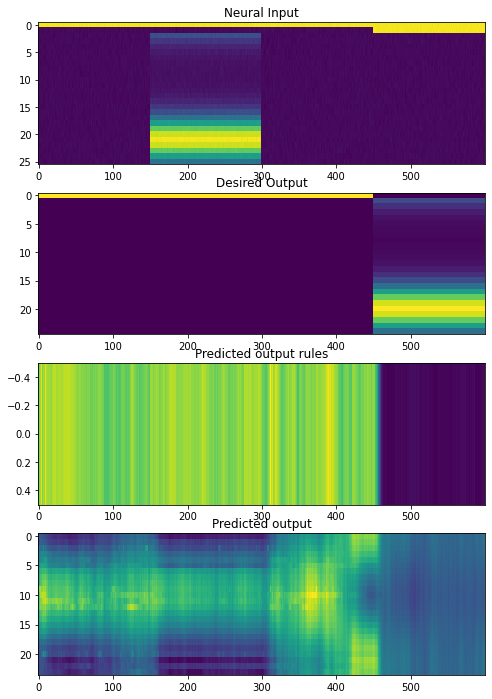

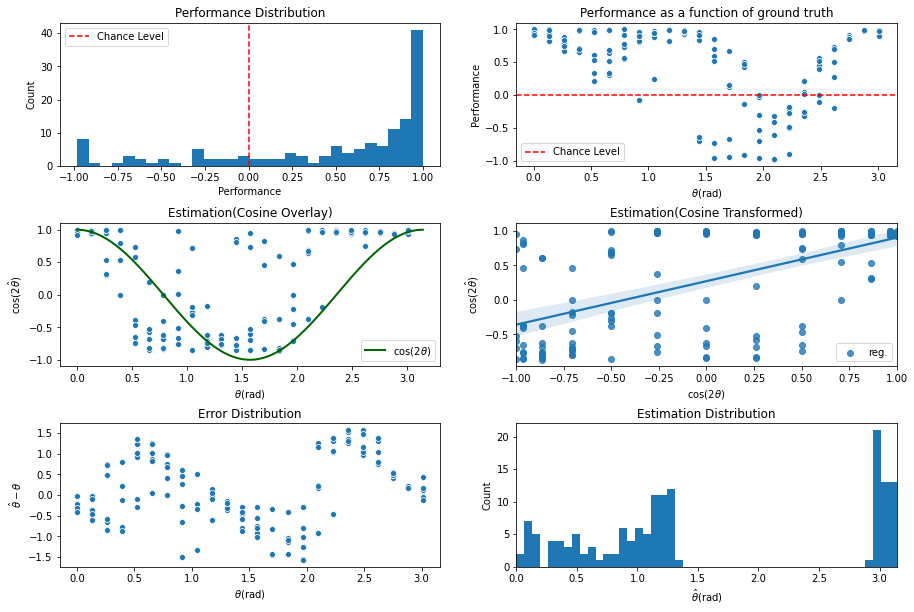

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter1800/assets

 Training performance: 
Iter. 1801 | Performance 0.4354 | Loss 0.3135 | Spike loss 2.2993
Testing performance: 
Iter. 1801 | Performance 0.4942 | Loss 0.3137 | Spike loss 2.2760

 Training performance: 
Iter. 1802 | Performance 0.5298 | Loss 0.3120 | Spike loss 2.2796
Testing performance: 
Iter. 1802 | Performance 0.5608 | Loss 0.3113 | Spike loss 2.2772

 Training performance: 
Iter. 1803 | Performance 0.5427 | Loss 0.3100 | Spike loss 2.2895
Testing performance: 
Iter. 1803 | Performance 0.5456 | Loss 0.3113 | Spike loss 2.3648

 Training performance: 
Iter. 1804 | Performance 0.4534 | Loss 0.3124 | Spike loss 2.3873
Testing performance: 
Iter. 1804 | Performance 0.5290 | Loss 0.3126 | Spike loss 2.3649

 Training performance: 
Iter. 1805 | Performance 0.6427 | Loss 0.3121 | Spike loss 2.3596
Testing performance: 
Iter. 1805 | Performance 0.5867 | Loss 0.3091 | Spike loss 2.3731

 Traini


 Training performance: 
Iter. 1847 | Performance 0.5819 | Loss 0.3058 | Spike loss 2.5697
Testing performance: 
Iter. 1847 | Performance 0.5959 | Loss 0.3023 | Spike loss 2.5561

 Training performance: 
Iter. 1848 | Performance 0.6329 | Loss 0.3021 | Spike loss 2.5740
Testing performance: 
Iter. 1848 | Performance 0.5923 | Loss 0.3038 | Spike loss 2.5639

 Training performance: 
Iter. 1849 | Performance 0.6252 | Loss 0.3037 | Spike loss 2.5383
Testing performance: 
Iter. 1849 | Performance 0.6008 | Loss 0.3049 | Spike loss 2.5822

 Training performance: 
Iter. 1850 | Performance 0.6821 | Loss 0.3010 | Spike loss 2.6189
Testing performance: 
Iter. 1850 | Performance 0.6417 | Loss 0.3024 | Spike loss 2.5989

 Training performance: 
Iter. 1851 | Performance 0.6158 | Loss 0.3029 | Spike loss 2.6677
Testing performance: 
Iter. 1851 | Performance 0.6021 | Loss 0.3029 | Spike loss 2.6629

 Training performance: 
Iter. 1852 | Performance 0.5762 | Loss 0.3041 | Spike loss 2.7148
Testing perfor


 Training performance: 
Iter. 1893 | Performance 0.6354 | Loss 0.3009 | Spike loss 2.7148
Testing performance: 
Iter. 1893 | Performance 0.6152 | Loss 0.3029 | Spike loss 2.7577

 Training performance: 
Iter. 1894 | Performance 0.5872 | Loss 0.3024 | Spike loss 2.8041
Testing performance: 
Iter. 1894 | Performance 0.6374 | Loss 0.3037 | Spike loss 2.6875

 Training performance: 
Iter. 1895 | Performance 0.5702 | Loss 0.3060 | Spike loss 2.7111
Testing performance: 
Iter. 1895 | Performance 0.6004 | Loss 0.3019 | Spike loss 2.6810

 Training performance: 
Iter. 1896 | Performance 0.5837 | Loss 0.3011 | Spike loss 2.5860
Testing performance: 
Iter. 1896 | Performance 0.5825 | Loss 0.3024 | Spike loss 2.6102

 Training performance: 
Iter. 1897 | Performance 0.5652 | Loss 0.3025 | Spike loss 2.6496
Testing performance: 
Iter. 1897 | Performance 0.6225 | Loss 0.3023 | Spike loss 2.6233

 Training performance: 
Iter. 1898 | Performance 0.6138 | Loss 0.3040 | Spike loss 2.6055
Testing perfor

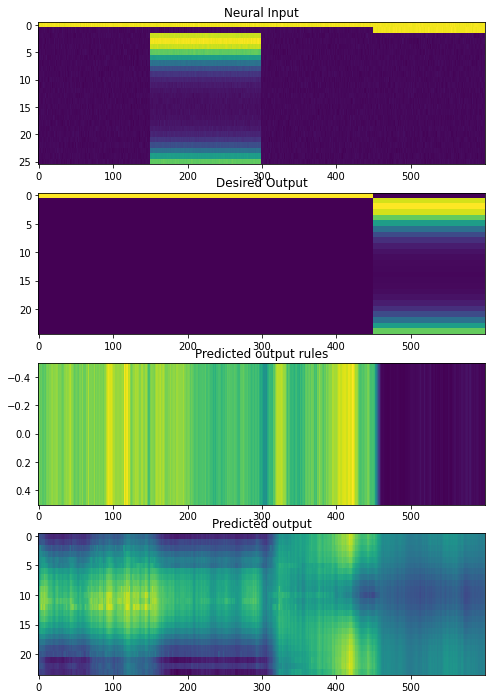

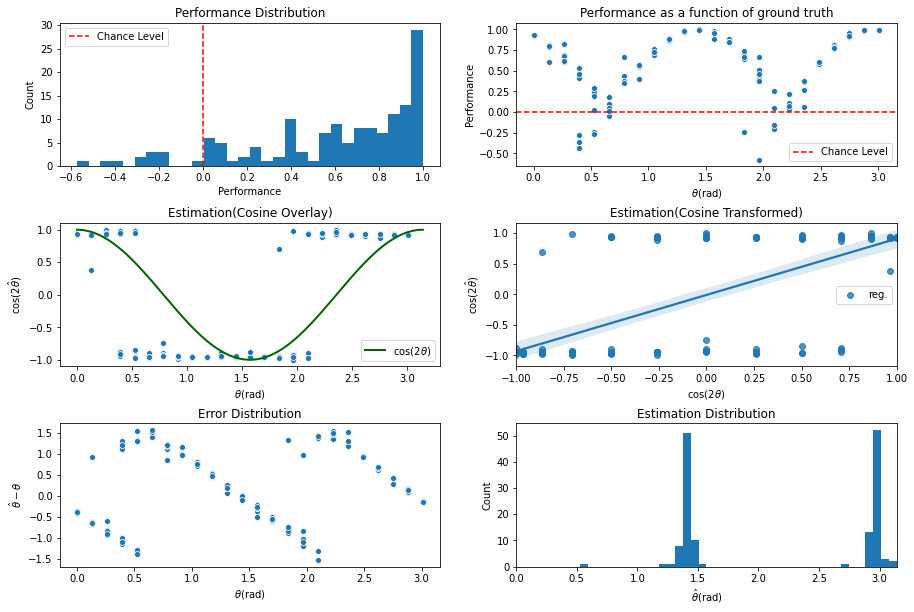

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter1900/assets

 Training performance: 
Iter. 1901 | Performance 0.6533 | Loss 0.3012 | Spike loss 2.8117
Testing performance: 
Iter. 1901 | Performance 0.6151 | Loss 0.3013 | Spike loss 2.7375

 Training performance: 
Iter. 1902 | Performance 0.6369 | Loss 0.3008 | Spike loss 2.7493
Testing performance: 
Iter. 1902 | Performance 0.5801 | Loss 0.3029 | Spike loss 2.7276

 Training performance: 
Iter. 1903 | Performance 0.6421 | Loss 0.2996 | Spike loss 2.7630
Testing performance: 
Iter. 1903 | Performance 0.6073 | Loss 0.3037 | Spike loss 2.6786

 Training performance: 
Iter. 1904 | Performance 0.5928 | Loss 0.3033 | Spike loss 2.7113
Testing performance: 
Iter. 1904 | Performance 0.6226 | Loss 0.3001 | Spike loss 2.6602

 Training performance: 
Iter. 1905 | Performance 0.6981 | Loss 0.2967 | Spike loss 2.7267
Testing performance: 
Iter. 1905 | Performance 0.6266 | Loss 0.3015 | Spike loss 2.6331

 Traini


 Training performance: 
Iter. 1947 | Performance 0.6354 | Loss 0.2997 | Spike loss 2.7353
Testing performance: 
Iter. 1947 | Performance 0.6397 | Loss 0.3009 | Spike loss 2.7296

 Training performance: 
Iter. 1948 | Performance 0.6623 | Loss 0.2978 | Spike loss 2.7646
Testing performance: 
Iter. 1948 | Performance 0.5758 | Loss 0.3032 | Spike loss 2.7889

 Training performance: 
Iter. 1949 | Performance 0.6150 | Loss 0.3025 | Spike loss 2.7110
Testing performance: 
Iter. 1949 | Performance 0.6095 | Loss 0.3009 | Spike loss 2.7578

 Training performance: 
Iter. 1950 | Performance 0.6768 | Loss 0.2972 | Spike loss 2.7267
Testing performance: 
Iter. 1950 | Performance 0.6111 | Loss 0.3005 | Spike loss 2.6679

 Training performance: 
Iter. 1951 | Performance 0.5724 | Loss 0.3013 | Spike loss 2.7182
Testing performance: 
Iter. 1951 | Performance 0.6034 | Loss 0.3023 | Spike loss 2.6476

 Training performance: 
Iter. 1952 | Performance 0.5886 | Loss 0.3040 | Spike loss 2.6588
Testing perfor


 Training performance: 
Iter. 1993 | Performance 0.6601 | Loss 0.2994 | Spike loss 2.8483
Testing performance: 
Iter. 1993 | Performance 0.6109 | Loss 0.3036 | Spike loss 2.7586

 Training performance: 
Iter. 1994 | Performance 0.6077 | Loss 0.3037 | Spike loss 2.7534
Testing performance: 
Iter. 1994 | Performance 0.5901 | Loss 0.2997 | Spike loss 2.7287

 Training performance: 
Iter. 1995 | Performance 0.5948 | Loss 0.3007 | Spike loss 2.7313
Testing performance: 
Iter. 1995 | Performance 0.6008 | Loss 0.3005 | Spike loss 2.6981

 Training performance: 
Iter. 1996 | Performance 0.6017 | Loss 0.3012 | Spike loss 2.6793
Testing performance: 
Iter. 1996 | Performance 0.5765 | Loss 0.3025 | Spike loss 2.6578

 Training performance: 
Iter. 1997 | Performance 0.7054 | Loss 0.2981 | Spike loss 2.7622
Testing performance: 
Iter. 1997 | Performance 0.6141 | Loss 0.3008 | Spike loss 2.6457

 Training performance: 
Iter. 1998 | Performance 0.6076 | Loss 0.3008 | Spike loss 2.6270
Testing perfor

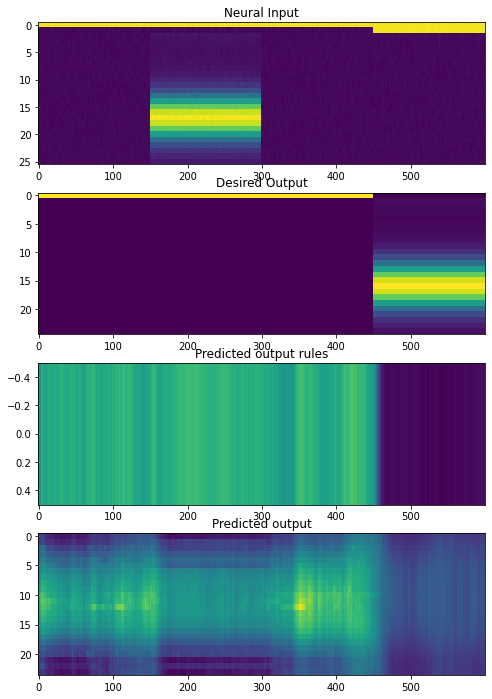

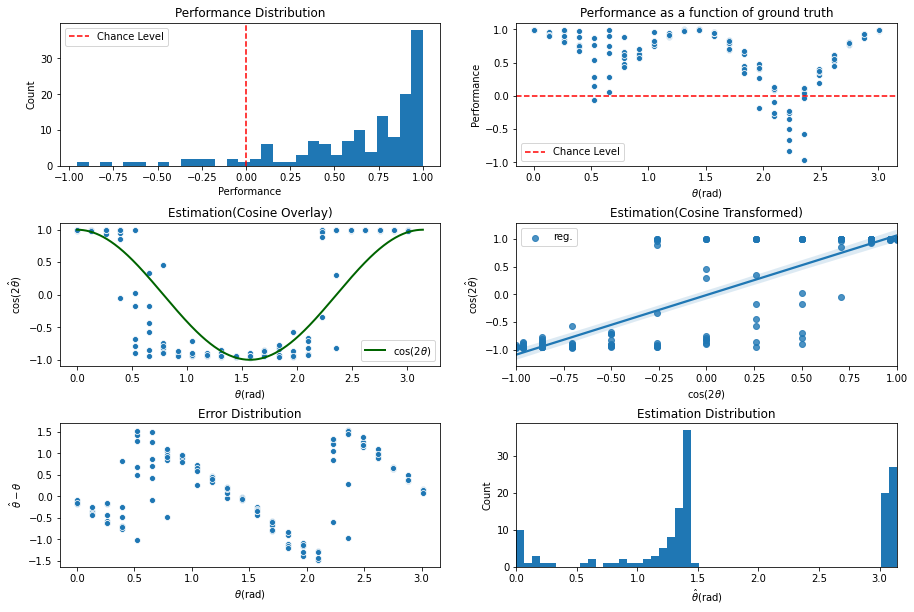

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter2000/assets

 Training performance: 
Iter. 2001 | Performance 0.6795 | Loss 0.2969 | Spike loss 2.6654
Testing performance: 
Iter. 2001 | Performance 0.6090 | Loss 0.3009 | Spike loss 2.7167

 Training performance: 
Iter. 2002 | Performance 0.5616 | Loss 0.3038 | Spike loss 2.6065
Testing performance: 
Iter. 2002 | Performance 0.6223 | Loss 0.3032 | Spike loss 2.7043

 Training performance: 
Iter. 2003 | Performance 0.5894 | Loss 0.3014 | Spike loss 2.7086
Testing performance: 
Iter. 2003 | Performance 0.6145 | Loss 0.3016 | Spike loss 2.7489

 Training performance: 
Iter. 2004 | Performance 0.5699 | Loss 0.3025 | Spike loss 2.7815
Testing performance: 
Iter. 2004 | Performance 0.5919 | Loss 0.3007 | Spike loss 2.6788

 Training performance: 
Iter. 2005 | Performance 0.6187 | Loss 0.3005 | Spike loss 2.7320
Testing performance: 
Iter. 2005 | Performance 0.6053 | Loss 0.3014 | Spike loss 2.6490

 Traini


 Training performance: 
Iter. 2047 | Performance 0.6318 | Loss 0.2985 | Spike loss 2.6162
Testing performance: 
Iter. 2047 | Performance 0.6318 | Loss 0.3020 | Spike loss 2.6154

 Training performance: 
Iter. 2048 | Performance 0.5640 | Loss 0.3048 | Spike loss 2.5182
Testing performance: 
Iter. 2048 | Performance 0.6032 | Loss 0.2996 | Spike loss 2.5941

 Training performance: 
Iter. 2049 | Performance 0.6722 | Loss 0.2974 | Spike loss 2.6539
Testing performance: 
Iter. 2049 | Performance 0.5880 | Loss 0.3016 | Spike loss 2.5923

 Training performance: 
Iter. 2050 | Performance 0.6425 | Loss 0.2999 | Spike loss 2.6295
Testing performance: 
Iter. 2050 | Performance 0.6143 | Loss 0.3019 | Spike loss 2.6579

 Training performance: 
Iter. 2051 | Performance 0.6675 | Loss 0.3003 | Spike loss 2.6367
Testing performance: 
Iter. 2051 | Performance 0.5867 | Loss 0.2996 | Spike loss 2.6966

 Training performance: 
Iter. 2052 | Performance 0.6720 | Loss 0.2980 | Spike loss 2.7197
Testing perfor


 Training performance: 
Iter. 2093 | Performance 0.6623 | Loss 0.3002 | Spike loss 2.7464
Testing performance: 
Iter. 2093 | Performance 0.6342 | Loss 0.2988 | Spike loss 2.6708

 Training performance: 
Iter. 2094 | Performance 0.6203 | Loss 0.2995 | Spike loss 2.7254
Testing performance: 
Iter. 2094 | Performance 0.6126 | Loss 0.2993 | Spike loss 2.6136

 Training performance: 
Iter. 2095 | Performance 0.6846 | Loss 0.2960 | Spike loss 2.6916
Testing performance: 
Iter. 2095 | Performance 0.6200 | Loss 0.3005 | Spike loss 2.6143

 Training performance: 
Iter. 2096 | Performance 0.6268 | Loss 0.3010 | Spike loss 2.6132
Testing performance: 
Iter. 2096 | Performance 0.6173 | Loss 0.2991 | Spike loss 2.6058

 Training performance: 
Iter. 2097 | Performance 0.6448 | Loss 0.2983 | Spike loss 2.5824
Testing performance: 
Iter. 2097 | Performance 0.6308 | Loss 0.2999 | Spike loss 2.6396

 Training performance: 
Iter. 2098 | Performance 0.6444 | Loss 0.2984 | Spike loss 2.7005
Testing perfor

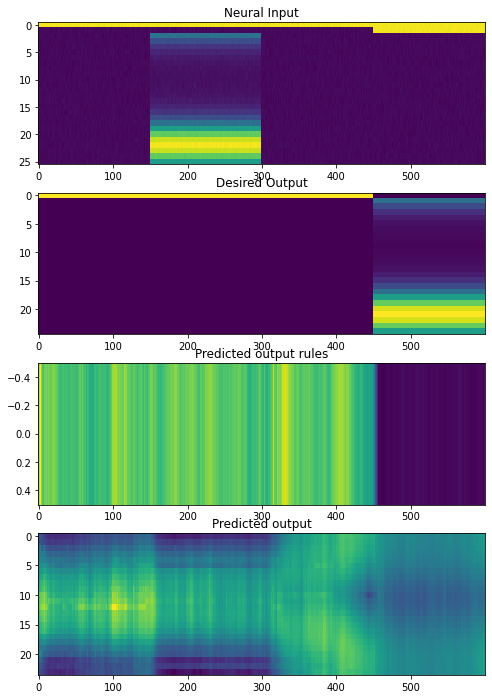

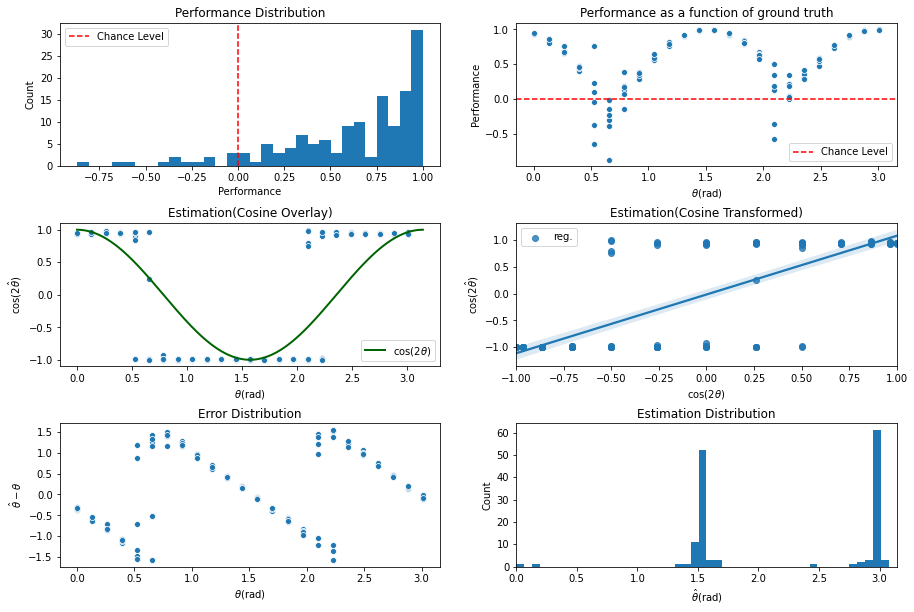

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter2100/assets

 Training performance: 
Iter. 2101 | Performance 0.6782 | Loss 0.2975 | Spike loss 2.6138
Testing performance: 
Iter. 2101 | Performance 0.6127 | Loss 0.3008 | Spike loss 2.6029

 Training performance: 
Iter. 2102 | Performance 0.5898 | Loss 0.3025 | Spike loss 2.5804
Testing performance: 
Iter. 2102 | Performance 0.6503 | Loss 0.2992 | Spike loss 2.6089

 Training performance: 
Iter. 2103 | Performance 0.6653 | Loss 0.2974 | Spike loss 2.5864
Testing performance: 
Iter. 2103 | Performance 0.6283 | Loss 0.2997 | Spike loss 2.5765

 Training performance: 
Iter. 2104 | Performance 0.6708 | Loss 0.2975 | Spike loss 2.5542
Testing performance: 
Iter. 2104 | Performance 0.6258 | Loss 0.2999 | Spike loss 2.6143

 Training performance: 
Iter. 2105 | Performance 0.7142 | Loss 0.2968 | Spike loss 2.6522
Testing performance: 
Iter. 2105 | Performance 0.6235 | Loss 0.2995 | Spike loss 2.6385

 Traini


 Training performance: 
Iter. 2147 | Performance 0.6434 | Loss 0.3006 | Spike loss 2.6394
Testing performance: 
Iter. 2147 | Performance 0.6136 | Loss 0.2989 | Spike loss 2.5670

 Training performance: 
Iter. 2148 | Performance 0.6221 | Loss 0.2976 | Spike loss 2.6699
Testing performance: 
Iter. 2148 | Performance 0.6216 | Loss 0.3001 | Spike loss 2.6206

 Training performance: 
Iter. 2149 | Performance 0.6740 | Loss 0.2973 | Spike loss 2.5741
Testing performance: 
Iter. 2149 | Performance 0.6081 | Loss 0.3004 | Spike loss 2.6388

 Training performance: 
Iter. 2150 | Performance 0.6694 | Loss 0.2998 | Spike loss 2.6812
Testing performance: 
Iter. 2150 | Performance 0.6024 | Loss 0.2988 | Spike loss 2.6497

 Training performance: 
Iter. 2151 | Performance 0.6463 | Loss 0.2975 | Spike loss 2.7174
Testing performance: 
Iter. 2151 | Performance 0.6351 | Loss 0.2982 | Spike loss 2.6680

 Training performance: 
Iter. 2152 | Performance 0.6837 | Loss 0.2968 | Spike loss 2.7686
Testing perfor


 Training performance: 
Iter. 2193 | Performance 0.6008 | Loss 0.2994 | Spike loss 2.6803
Testing performance: 
Iter. 2193 | Performance 0.6391 | Loss 0.2987 | Spike loss 2.6181

 Training performance: 
Iter. 2194 | Performance 0.6554 | Loss 0.2989 | Spike loss 2.6485
Testing performance: 
Iter. 2194 | Performance 0.6533 | Loss 0.2993 | Spike loss 2.6303

 Training performance: 
Iter. 2195 | Performance 0.6489 | Loss 0.2995 | Spike loss 2.6270
Testing performance: 
Iter. 2195 | Performance 0.6328 | Loss 0.2982 | Spike loss 2.6184

 Training performance: 
Iter. 2196 | Performance 0.6177 | Loss 0.2989 | Spike loss 2.6367
Testing performance: 
Iter. 2196 | Performance 0.6325 | Loss 0.2999 | Spike loss 2.6053

 Training performance: 
Iter. 2197 | Performance 0.6081 | Loss 0.3002 | Spike loss 2.6668
Testing performance: 
Iter. 2197 | Performance 0.6326 | Loss 0.2997 | Spike loss 2.6094

 Training performance: 
Iter. 2198 | Performance 0.6300 | Loss 0.2997 | Spike loss 2.5059
Testing perfor

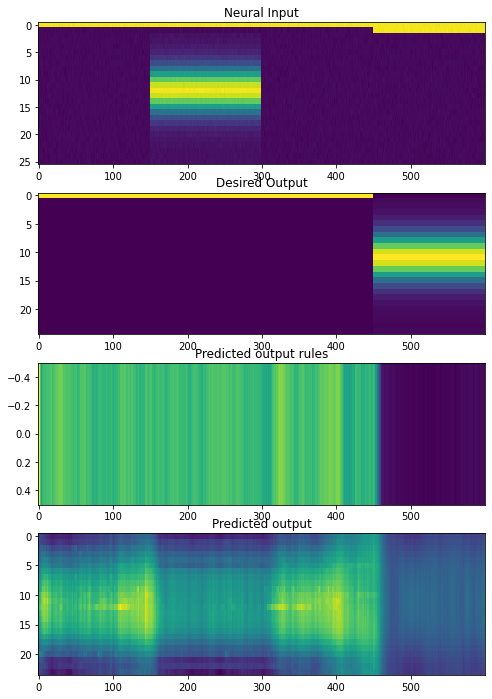

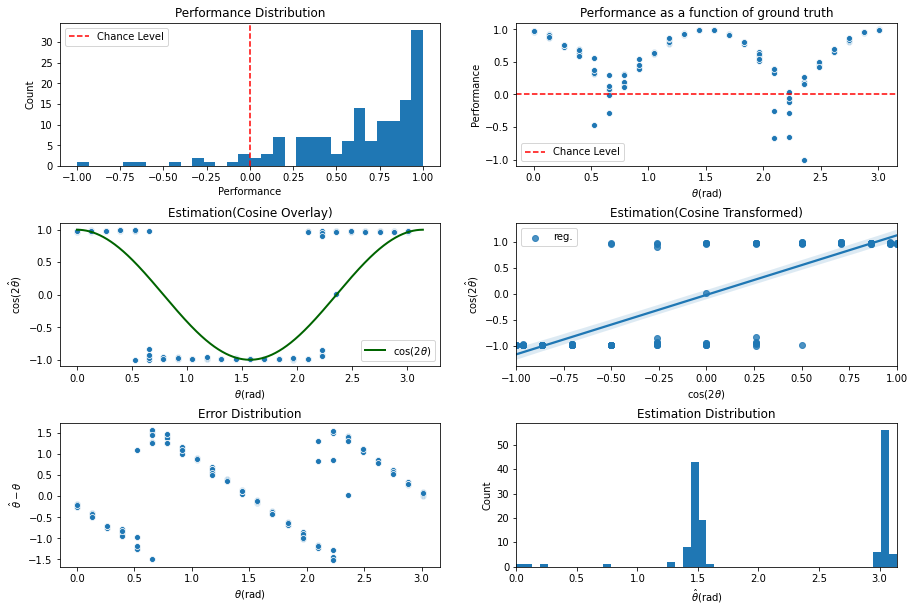

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter2200/assets

 Training performance: 
Iter. 2201 | Performance 0.6812 | Loss 0.2989 | Spike loss 2.6993
Testing performance: 
Iter. 2201 | Performance 0.6337 | Loss 0.2980 | Spike loss 2.6599

 Training performance: 
Iter. 2202 | Performance 0.5708 | Loss 0.3007 | Spike loss 2.6667
Testing performance: 
Iter. 2202 | Performance 0.6355 | Loss 0.2986 | Spike loss 2.6235

 Training performance: 
Iter. 2203 | Performance 0.6871 | Loss 0.2950 | Spike loss 2.6825
Testing performance: 
Iter. 2203 | Performance 0.6160 | Loss 0.3012 | Spike loss 2.5925

 Training performance: 
Iter. 2204 | Performance 0.6268 | Loss 0.3005 | Spike loss 2.5848
Testing performance: 
Iter. 2204 | Performance 0.6300 | Loss 0.2992 | Spike loss 2.5465

 Training performance: 
Iter. 2205 | Performance 0.6179 | Loss 0.2973 | Spike loss 2.6109
Testing performance: 
Iter. 2205 | Performance 0.6459 | Loss 0.2987 | Spike loss 2.5695

 Traini


 Training performance: 
Iter. 2247 | Performance 0.6026 | Loss 0.2992 | Spike loss 2.6165
Testing performance: 
Iter. 2247 | Performance 0.6477 | Loss 0.2972 | Spike loss 2.6629

 Training performance: 
Iter. 2248 | Performance 0.6531 | Loss 0.2984 | Spike loss 2.7771
Testing performance: 
Iter. 2248 | Performance 0.6060 | Loss 0.2993 | Spike loss 2.6708

 Training performance: 
Iter. 2249 | Performance 0.6542 | Loss 0.2974 | Spike loss 2.5983
Testing performance: 
Iter. 2249 | Performance 0.6425 | Loss 0.2984 | Spike loss 2.6306

 Training performance: 
Iter. 2250 | Performance 0.6599 | Loss 0.2963 | Spike loss 2.6847
Testing performance: 
Iter. 2250 | Performance 0.6191 | Loss 0.2990 | Spike loss 2.6239

 Training performance: 
Iter. 2251 | Performance 0.6274 | Loss 0.2966 | Spike loss 2.6803
Testing performance: 
Iter. 2251 | Performance 0.6350 | Loss 0.2994 | Spike loss 2.6021

 Training performance: 
Iter. 2252 | Performance 0.6883 | Loss 0.2966 | Spike loss 2.7245
Testing perfor


 Training performance: 
Iter. 2293 | Performance 0.6988 | Loss 0.2952 | Spike loss 2.6524
Testing performance: 
Iter. 2293 | Performance 0.6312 | Loss 0.2999 | Spike loss 2.5879

 Training performance: 
Iter. 2294 | Performance 0.6376 | Loss 0.3004 | Spike loss 2.5571
Testing performance: 
Iter. 2294 | Performance 0.6336 | Loss 0.2979 | Spike loss 2.6418

 Training performance: 
Iter. 2295 | Performance 0.6906 | Loss 0.2962 | Spike loss 2.6327
Testing performance: 
Iter. 2295 | Performance 0.6128 | Loss 0.2987 | Spike loss 2.6288

 Training performance: 
Iter. 2296 | Performance 0.6636 | Loss 0.2972 | Spike loss 2.6389
Testing performance: 
Iter. 2296 | Performance 0.6195 | Loss 0.2986 | Spike loss 2.5934

 Training performance: 
Iter. 2297 | Performance 0.6771 | Loss 0.2959 | Spike loss 2.6528
Testing performance: 
Iter. 2297 | Performance 0.6316 | Loss 0.2975 | Spike loss 2.5890

 Training performance: 
Iter. 2298 | Performance 0.7079 | Loss 0.2927 | Spike loss 2.5817
Testing perfor

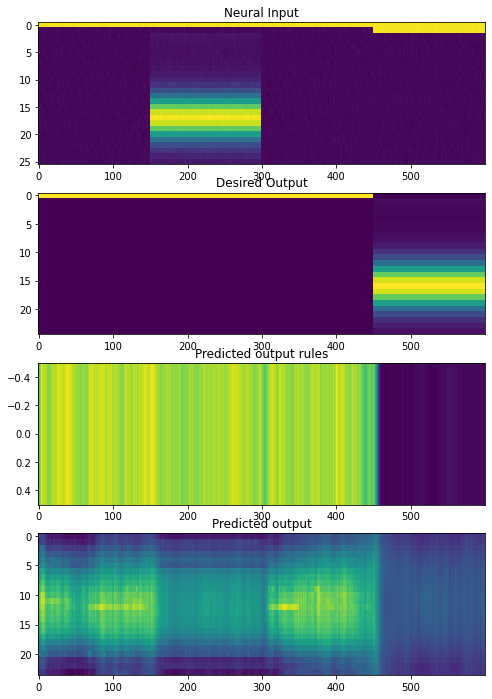

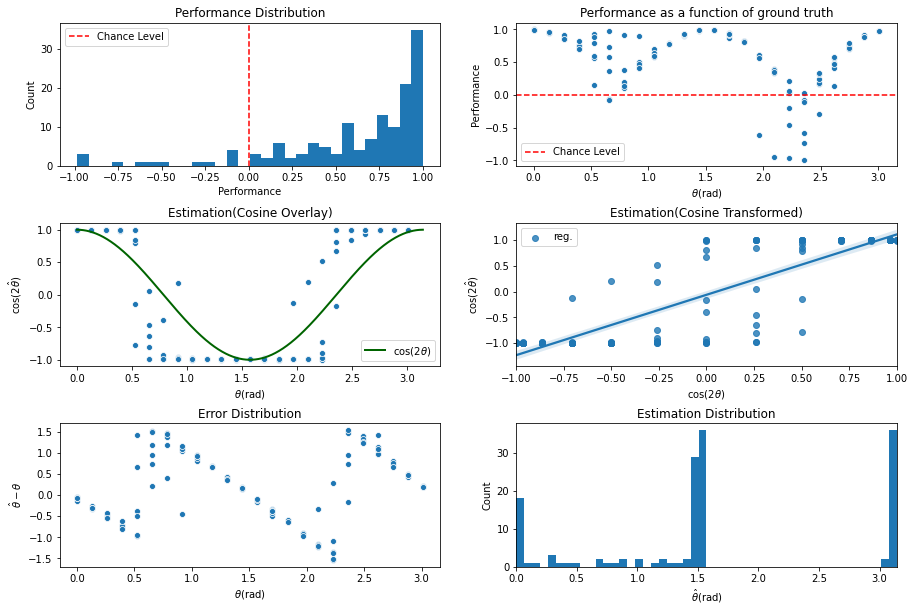

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter2300/assets

 Training performance: 
Iter. 2301 | Performance 0.6745 | Loss 0.2965 | Spike loss 2.5984
Testing performance: 
Iter. 2301 | Performance 0.6246 | Loss 0.2984 | Spike loss 2.5572

 Training performance: 
Iter. 2302 | Performance 0.7002 | Loss 0.2942 | Spike loss 2.6849
Testing performance: 
Iter. 2302 | Performance 0.6311 | Loss 0.2990 | Spike loss 2.5923

 Training performance: 
Iter. 2303 | Performance 0.6758 | Loss 0.2979 | Spike loss 2.6582
Testing performance: 
Iter. 2303 | Performance 0.6255 | Loss 0.2979 | Spike loss 2.5753

 Training performance: 
Iter. 2304 | Performance 0.6890 | Loss 0.2947 | Spike loss 2.6058
Testing performance: 
Iter. 2304 | Performance 0.6101 | Loss 0.2980 | Spike loss 2.5868

 Training performance: 
Iter. 2305 | Performance 0.6291 | Loss 0.2982 | Spike loss 2.6008
Testing performance: 
Iter. 2305 | Performance 0.6193 | Loss 0.3004 | Spike loss 2.6108

 Traini


 Training performance: 
Iter. 2347 | Performance 0.6899 | Loss 0.2956 | Spike loss 2.6186
Testing performance: 
Iter. 2347 | Performance 0.6125 | Loss 0.2995 | Spike loss 2.5620

 Training performance: 
Iter. 2348 | Performance 0.7206 | Loss 0.2950 | Spike loss 2.5764
Testing performance: 
Iter. 2348 | Performance 0.6265 | Loss 0.2976 | Spike loss 2.5320

 Training performance: 
Iter. 2349 | Performance 0.6991 | Loss 0.2943 | Spike loss 2.6005
Testing performance: 
Iter. 2349 | Performance 0.6093 | Loss 0.2990 | Spike loss 2.5031

 Training performance: 
Iter. 2350 | Performance 0.6277 | Loss 0.2985 | Spike loss 2.5781
Testing performance: 
Iter. 2350 | Performance 0.6132 | Loss 0.2990 | Spike loss 2.5728

 Training performance: 
Iter. 2351 | Performance 0.6522 | Loss 0.2996 | Spike loss 2.5851
Testing performance: 
Iter. 2351 | Performance 0.6320 | Loss 0.2977 | Spike loss 2.6115

 Training performance: 
Iter. 2352 | Performance 0.6464 | Loss 0.2954 | Spike loss 2.5064
Testing perfor


 Training performance: 
Iter. 2393 | Performance 0.6817 | Loss 0.2953 | Spike loss 2.5512
Testing performance: 
Iter. 2393 | Performance 0.6385 | Loss 0.2971 | Spike loss 2.5742

 Training performance: 
Iter. 2394 | Performance 0.6485 | Loss 0.2963 | Spike loss 2.5788
Testing performance: 
Iter. 2394 | Performance 0.6650 | Loss 0.2972 | Spike loss 2.5566

 Training performance: 
Iter. 2395 | Performance 0.7153 | Loss 0.2934 | Spike loss 2.6511
Testing performance: 
Iter. 2395 | Performance 0.6256 | Loss 0.2990 | Spike loss 2.5744

 Training performance: 
Iter. 2396 | Performance 0.6853 | Loss 0.2972 | Spike loss 2.6557
Testing performance: 
Iter. 2396 | Performance 0.6491 | Loss 0.2966 | Spike loss 2.5413

 Training performance: 
Iter. 2397 | Performance 0.7008 | Loss 0.2942 | Spike loss 2.6283
Testing performance: 
Iter. 2397 | Performance 0.6561 | Loss 0.2969 | Spike loss 2.5227

 Training performance: 
Iter. 2398 | Performance 0.6712 | Loss 0.2965 | Spike loss 2.5175
Testing perfor

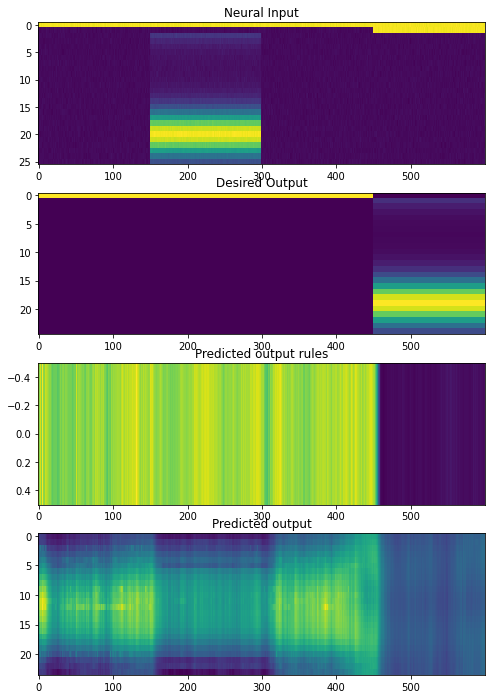

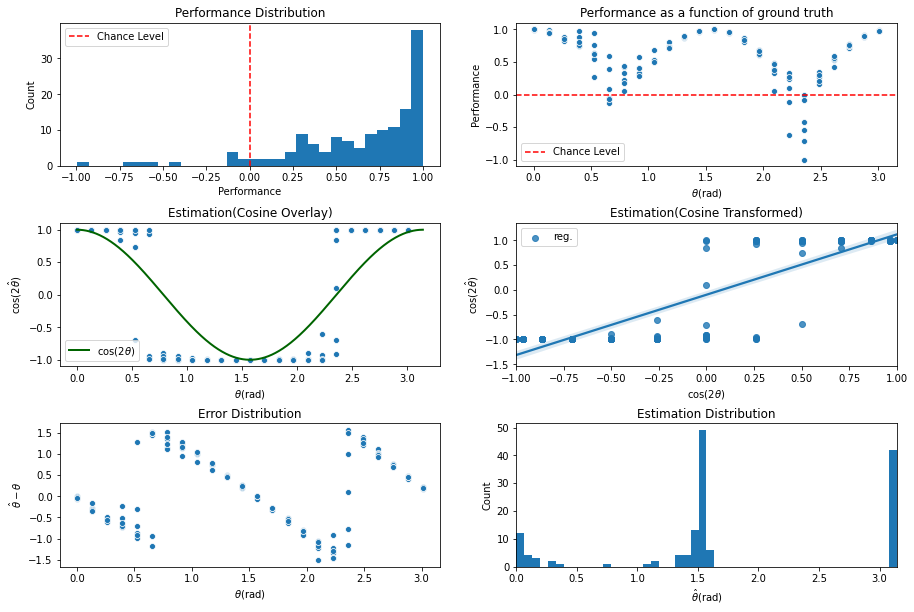

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter2400/assets

 Training performance: 
Iter. 2401 | Performance 0.6478 | Loss 0.2951 | Spike loss 2.5353
Testing performance: 
Iter. 2401 | Performance 0.6283 | Loss 0.2983 | Spike loss 2.5322

 Training performance: 
Iter. 2402 | Performance 0.6255 | Loss 0.2972 | Spike loss 2.5134
Testing performance: 
Iter. 2402 | Performance 0.6084 | Loss 0.2968 | Spike loss 2.5623

 Training performance: 
Iter. 2403 | Performance 0.6102 | Loss 0.2976 | Spike loss 2.5108
Testing performance: 
Iter. 2403 | Performance 0.6144 | Loss 0.2984 | Spike loss 2.5770

 Training performance: 
Iter. 2404 | Performance 0.6704 | Loss 0.2959 | Spike loss 2.6861
Testing performance: 
Iter. 2404 | Performance 0.5996 | Loss 0.2991 | Spike loss 2.5555

 Training performance: 
Iter. 2405 | Performance 0.6961 | Loss 0.2947 | Spike loss 2.6493
Testing performance: 
Iter. 2405 | Performance 0.6462 | Loss 0.2965 | Spike loss 2.5537

 Traini


 Training performance: 
Iter. 2447 | Performance 0.6810 | Loss 0.2950 | Spike loss 2.5963
Testing performance: 
Iter. 2447 | Performance 0.6265 | Loss 0.2966 | Spike loss 2.5745

 Training performance: 
Iter. 2448 | Performance 0.6798 | Loss 0.2942 | Spike loss 2.5862
Testing performance: 
Iter. 2448 | Performance 0.6415 | Loss 0.2968 | Spike loss 2.5511

 Training performance: 
Iter. 2449 | Performance 0.6643 | Loss 0.2952 | Spike loss 2.5204
Testing performance: 
Iter. 2449 | Performance 0.6325 | Loss 0.2981 | Spike loss 2.5633

 Training performance: 
Iter. 2450 | Performance 0.6234 | Loss 0.2960 | Spike loss 2.5527
Testing performance: 
Iter. 2450 | Performance 0.6382 | Loss 0.2960 | Spike loss 2.5355

 Training performance: 
Iter. 2451 | Performance 0.6566 | Loss 0.2965 | Spike loss 2.5777
Testing performance: 
Iter. 2451 | Performance 0.6165 | Loss 0.2966 | Spike loss 2.5424

 Training performance: 
Iter. 2452 | Performance 0.6849 | Loss 0.2954 | Spike loss 2.4382
Testing perfor


 Training performance: 
Iter. 2493 | Performance 0.6904 | Loss 0.2943 | Spike loss 2.6160
Testing performance: 
Iter. 2493 | Performance 0.6261 | Loss 0.2971 | Spike loss 2.5367

 Training performance: 
Iter. 2494 | Performance 0.6891 | Loss 0.2946 | Spike loss 2.6149
Testing performance: 
Iter. 2494 | Performance 0.6384 | Loss 0.2984 | Spike loss 2.5731

 Training performance: 
Iter. 2495 | Performance 0.6309 | Loss 0.2969 | Spike loss 2.6124
Testing performance: 
Iter. 2495 | Performance 0.6203 | Loss 0.2962 | Spike loss 2.5664

 Training performance: 
Iter. 2496 | Performance 0.6529 | Loss 0.2960 | Spike loss 2.5980
Testing performance: 
Iter. 2496 | Performance 0.6303 | Loss 0.2966 | Spike loss 2.5300

 Training performance: 
Iter. 2497 | Performance 0.7522 | Loss 0.2922 | Spike loss 2.5890
Testing performance: 
Iter. 2497 | Performance 0.6539 | Loss 0.2977 | Spike loss 2.5343

 Training performance: 
Iter. 2498 | Performance 0.6520 | Loss 0.2964 | Spike loss 2.5071
Testing perfor

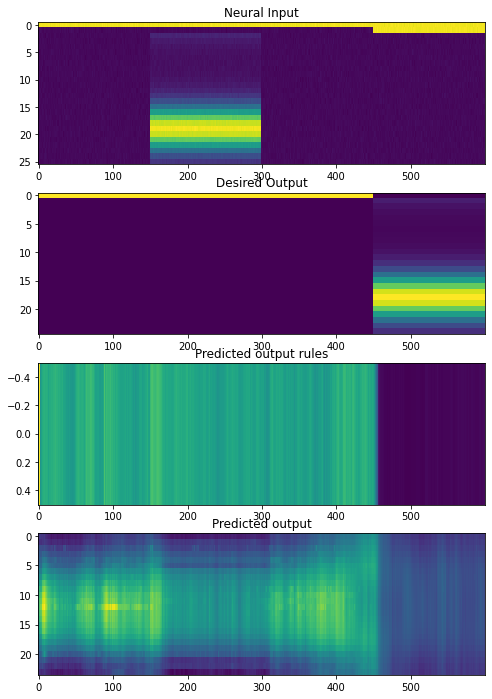

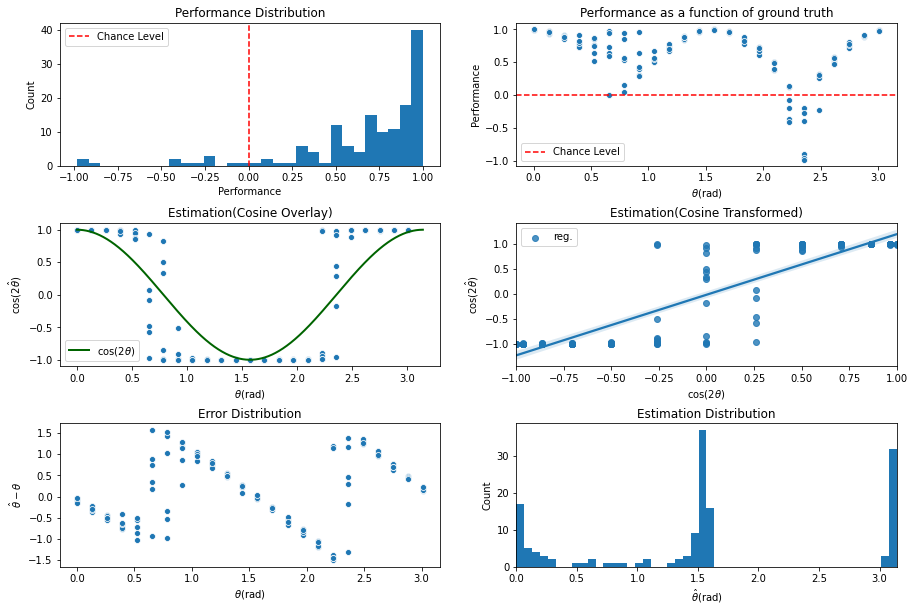

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter2500/assets

 Training performance: 
Iter. 2501 | Performance 0.6750 | Loss 0.2959 | Spike loss 2.4975
Testing performance: 
Iter. 2501 | Performance 0.6324 | Loss 0.2966 | Spike loss 2.5162

 Training performance: 
Iter. 2502 | Performance 0.6644 | Loss 0.2933 | Spike loss 2.5861
Testing performance: 
Iter. 2502 | Performance 0.6219 | Loss 0.2972 | Spike loss 2.5404

 Training performance: 
Iter. 2503 | Performance 0.6052 | Loss 0.2975 | Spike loss 2.4433
Testing performance: 
Iter. 2503 | Performance 0.6394 | Loss 0.2978 | Spike loss 2.5616

 Training performance: 
Iter. 2504 | Performance 0.6537 | Loss 0.2973 | Spike loss 2.5447
Testing performance: 
Iter. 2504 | Performance 0.6637 | Loss 0.2957 | Spike loss 2.5916

 Training performance: 
Iter. 2505 | Performance 0.6663 | Loss 0.2941 | Spike loss 2.5603
Testing performance: 
Iter. 2505 | Performance 0.6541 | Loss 0.2967 | Spike loss 2.6113

 Traini


 Training performance: 
Iter. 2547 | Performance 0.6825 | Loss 0.2951 | Spike loss 2.5680
Testing performance: 
Iter. 2547 | Performance 0.6515 | Loss 0.2970 | Spike loss 2.5302

 Training performance: 
Iter. 2548 | Performance 0.6716 | Loss 0.2960 | Spike loss 2.5069
Testing performance: 
Iter. 2548 | Performance 0.6407 | Loss 0.2974 | Spike loss 2.5440

 Training performance: 
Iter. 2549 | Performance 0.6805 | Loss 0.2973 | Spike loss 2.5144
Testing performance: 
Iter. 2549 | Performance 0.6528 | Loss 0.2960 | Spike loss 2.5572

 Training performance: 
Iter. 2550 | Performance 0.6786 | Loss 0.2954 | Spike loss 2.5522
Testing performance: 
Iter. 2550 | Performance 0.6456 | Loss 0.2978 | Spike loss 2.5667

 Training performance: 
Iter. 2551 | Performance 0.6929 | Loss 0.2937 | Spike loss 2.5420
Testing performance: 
Iter. 2551 | Performance 0.6763 | Loss 0.2983 | Spike loss 2.5459

 Training performance: 
Iter. 2552 | Performance 0.7235 | Loss 0.2935 | Spike loss 2.5166
Testing perfor


 Training performance: 
Iter. 2593 | Performance 0.6957 | Loss 0.2924 | Spike loss 2.6668
Testing performance: 
Iter. 2593 | Performance 0.6504 | Loss 0.2973 | Spike loss 2.5318

 Training performance: 
Iter. 2594 | Performance 0.6613 | Loss 0.2957 | Spike loss 2.5131
Testing performance: 
Iter. 2594 | Performance 0.6655 | Loss 0.2954 | Spike loss 2.5367

 Training performance: 
Iter. 2595 | Performance 0.6402 | Loss 0.2952 | Spike loss 2.5272
Testing performance: 
Iter. 2595 | Performance 0.6198 | Loss 0.2964 | Spike loss 2.5266

 Training performance: 
Iter. 2596 | Performance 0.6515 | Loss 0.2961 | Spike loss 2.6036
Testing performance: 
Iter. 2596 | Performance 0.6417 | Loss 0.2986 | Spike loss 2.5524

 Training performance: 
Iter. 2597 | Performance 0.6779 | Loss 0.2968 | Spike loss 2.6038
Testing performance: 
Iter. 2597 | Performance 0.6632 | Loss 0.2955 | Spike loss 2.5185

 Training performance: 
Iter. 2598 | Performance 0.6645 | Loss 0.2959 | Spike loss 2.5423
Testing perfor

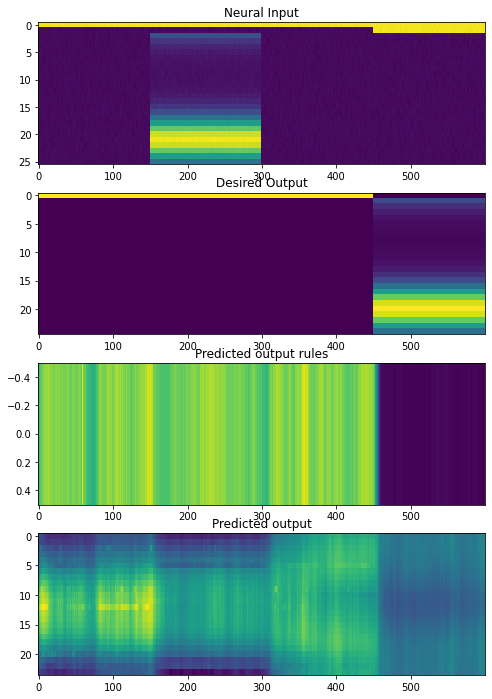

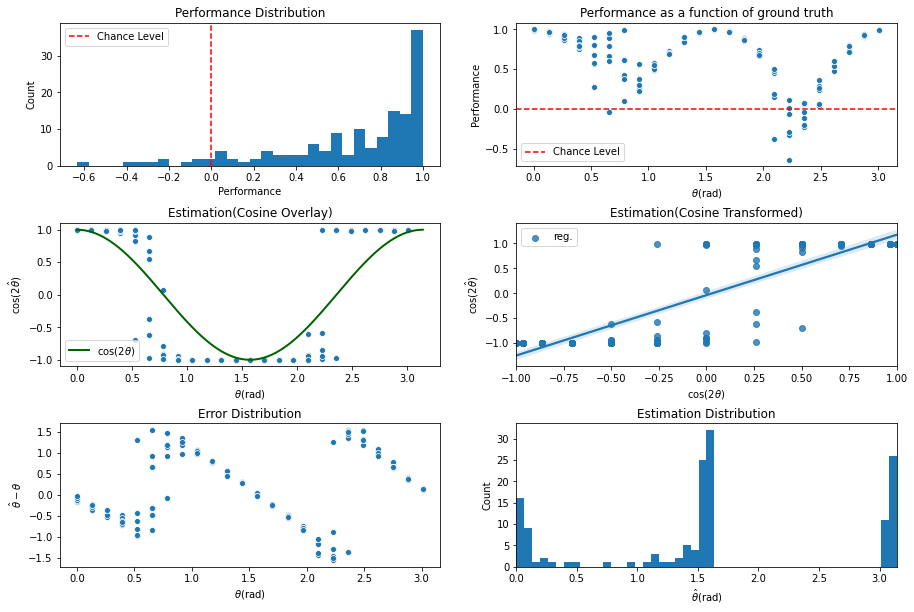

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter2600/assets

 Training performance: 
Iter. 2601 | Performance 0.6518 | Loss 0.2949 | Spike loss 2.5391
Testing performance: 
Iter. 2601 | Performance 0.6529 | Loss 0.2960 | Spike loss 2.5084

 Training performance: 
Iter. 2602 | Performance 0.7022 | Loss 0.2944 | Spike loss 2.5988
Testing performance: 
Iter. 2602 | Performance 0.6268 | Loss 0.2981 | Spike loss 2.5144

 Training performance: 
Iter. 2603 | Performance 0.6949 | Loss 0.2957 | Spike loss 2.5761
Testing performance: 
Iter. 2603 | Performance 0.6341 | Loss 0.2963 | Spike loss 2.5195

 Training performance: 
Iter. 2604 | Performance 0.7486 | Loss 0.2914 | Spike loss 2.4540
Testing performance: 
Iter. 2604 | Performance 0.6328 | Loss 0.2967 | Spike loss 2.5127

 Training performance: 
Iter. 2605 | Performance 0.6295 | Loss 0.2956 | Spike loss 2.5052
Testing performance: 
Iter. 2605 | Performance 0.6099 | Loss 0.2984 | Spike loss 2.5075

 Traini


 Training performance: 
Iter. 2647 | Performance 0.6673 | Loss 0.2950 | Spike loss 2.6063
Testing performance: 
Iter. 2647 | Performance 0.6399 | Loss 0.2984 | Spike loss 2.5355

 Training performance: 
Iter. 2648 | Performance 0.6368 | Loss 0.2987 | Spike loss 2.5488
Testing performance: 
Iter. 2648 | Performance 0.6612 | Loss 0.2954 | Spike loss 2.5257

 Training performance: 
Iter. 2649 | Performance 0.6333 | Loss 0.2965 | Spike loss 2.5143
Testing performance: 
Iter. 2649 | Performance 0.6317 | Loss 0.2958 | Spike loss 2.4758

 Training performance: 
Iter. 2650 | Performance 0.6800 | Loss 0.2944 | Spike loss 2.5524
Testing performance: 
Iter. 2650 | Performance 0.6646 | Loss 0.2967 | Spike loss 2.4742

 Training performance: 
Iter. 2651 | Performance 0.6986 | Loss 0.2946 | Spike loss 2.4755
Testing performance: 
Iter. 2651 | Performance 0.6482 | Loss 0.2955 | Spike loss 2.4610

 Training performance: 
Iter. 2652 | Performance 0.6715 | Loss 0.2946 | Spike loss 2.4671
Testing perfor


 Training performance: 
Iter. 2693 | Performance 0.6980 | Loss 0.2960 | Spike loss 2.5339
Testing performance: 
Iter. 2693 | Performance 0.6674 | Loss 0.2939 | Spike loss 2.5373

 Training performance: 
Iter. 2694 | Performance 0.6929 | Loss 0.2938 | Spike loss 2.4373
Testing performance: 
Iter. 2694 | Performance 0.6757 | Loss 0.2953 | Spike loss 2.5437

 Training performance: 
Iter. 2695 | Performance 0.7285 | Loss 0.2924 | Spike loss 2.6017
Testing performance: 
Iter. 2695 | Performance 0.6785 | Loss 0.2956 | Spike loss 2.5469

 Training performance: 
Iter. 2696 | Performance 0.7258 | Loss 0.2939 | Spike loss 2.6028
Testing performance: 
Iter. 2696 | Performance 0.6946 | Loss 0.2941 | Spike loss 2.5394

 Training performance: 
Iter. 2697 | Performance 0.7773 | Loss 0.2895 | Spike loss 2.6026
Testing performance: 
Iter. 2697 | Performance 0.6689 | Loss 0.2951 | Spike loss 2.5379

 Training performance: 
Iter. 2698 | Performance 0.6969 | Loss 0.2949 | Spike loss 2.5504
Testing perfor

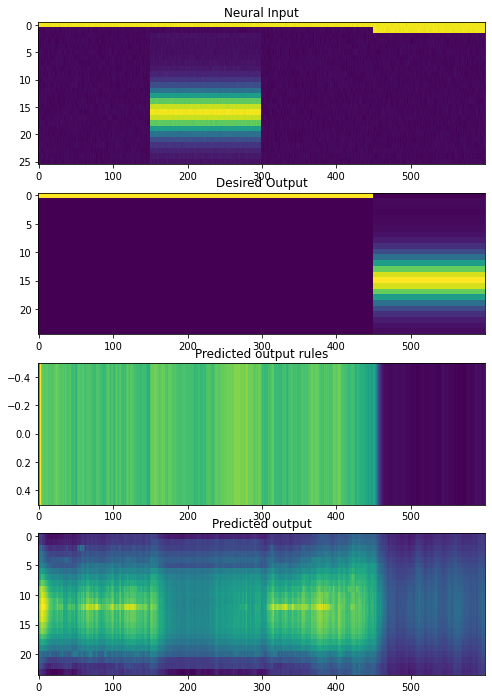

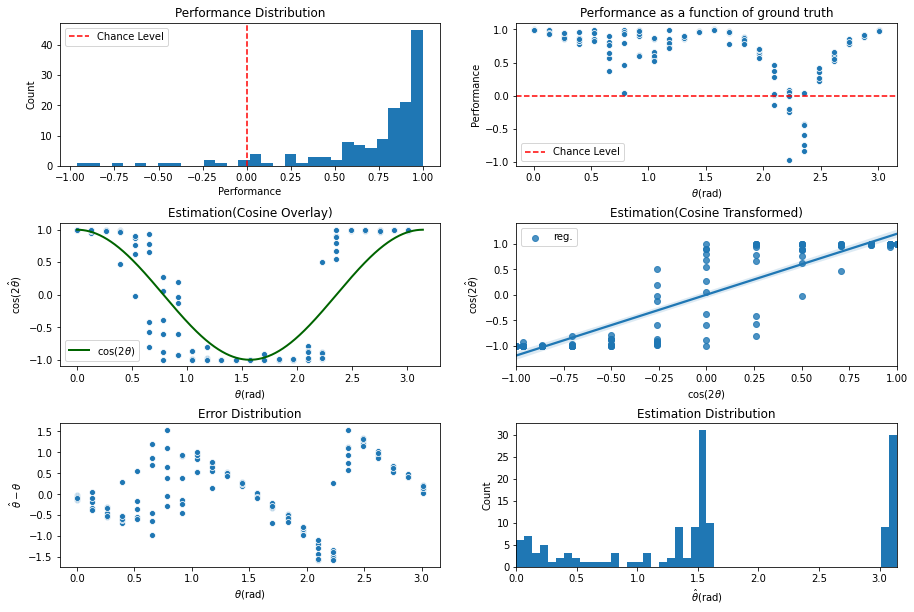

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter2700/assets

 Training performance: 
Iter. 2701 | Performance 0.7365 | Loss 0.2931 | Spike loss 2.5766
Testing performance: 
Iter. 2701 | Performance 0.6823 | Loss 0.2963 | Spike loss 2.5267

 Training performance: 
Iter. 2702 | Performance 0.7053 | Loss 0.2942 | Spike loss 2.5806
Testing performance: 
Iter. 2702 | Performance 0.6651 | Loss 0.2951 | Spike loss 2.5339

 Training performance: 
Iter. 2703 | Performance 0.6954 | Loss 0.2928 | Spike loss 2.6148
Testing performance: 
Iter. 2703 | Performance 0.6851 | Loss 0.2955 | Spike loss 2.5630

 Training performance: 
Iter. 2704 | Performance 0.7172 | Loss 0.2950 | Spike loss 2.6013
Testing performance: 
Iter. 2704 | Performance 0.6490 | Loss 0.2972 | Spike loss 2.5724

 Training performance: 
Iter. 2705 | Performance 0.7315 | Loss 0.2950 | Spike loss 2.7358
Testing performance: 
Iter. 2705 | Performance 0.6770 | Loss 0.2954 | Spike loss 2.5573

 Traini


 Training performance: 
Iter. 2747 | Performance 0.6526 | Loss 0.2996 | Spike loss 2.4795
Testing performance: 
Iter. 2747 | Performance 0.6680 | Loss 0.2987 | Spike loss 2.5289

 Training performance: 
Iter. 2748 | Performance 0.7294 | Loss 0.2973 | Spike loss 2.5806
Testing performance: 
Iter. 2748 | Performance 0.6536 | Loss 0.2960 | Spike loss 2.5129

 Training performance: 
Iter. 2749 | Performance 0.7096 | Loss 0.2923 | Spike loss 2.6355
Testing performance: 
Iter. 2749 | Performance 0.6665 | Loss 0.2972 | Spike loss 2.5057

 Training performance: 
Iter. 2750 | Performance 0.7508 | Loss 0.2922 | Spike loss 2.4556
Testing performance: 
Iter. 2750 | Performance 0.6748 | Loss 0.2989 | Spike loss 2.4870

 Training performance: 
Iter. 2751 | Performance 0.7870 | Loss 0.2938 | Spike loss 2.5593
Testing performance: 
Iter. 2751 | Performance 0.6616 | Loss 0.2977 | Spike loss 2.4835

 Training performance: 
Iter. 2752 | Performance 0.6319 | Loss 0.2996 | Spike loss 2.4265
Testing perfor


 Training performance: 
Iter. 2793 | Performance 0.7389 | Loss 0.2939 | Spike loss 2.6994
Testing performance: 
Iter. 2793 | Performance 0.7323 | Loss 0.2933 | Spike loss 2.5748

 Training performance: 
Iter. 2794 | Performance 0.7547 | Loss 0.2929 | Spike loss 2.6720
Testing performance: 
Iter. 2794 | Performance 0.7382 | Loss 0.2923 | Spike loss 2.5753

 Training performance: 
Iter. 2795 | Performance 0.6888 | Loss 0.2944 | Spike loss 2.6348
Testing performance: 
Iter. 2795 | Performance 0.7135 | Loss 0.2937 | Spike loss 2.5690

 Training performance: 
Iter. 2796 | Performance 0.7465 | Loss 0.2930 | Spike loss 2.5495
Testing performance: 
Iter. 2796 | Performance 0.7256 | Loss 0.2946 | Spike loss 2.5123

 Training performance: 
Iter. 2797 | Performance 0.6968 | Loss 0.2954 | Spike loss 2.5421
Testing performance: 
Iter. 2797 | Performance 0.7004 | Loss 0.2928 | Spike loss 2.5184

 Training performance: 
Iter. 2798 | Performance 0.7701 | Loss 0.2911 | Spike loss 2.4710
Testing perfor

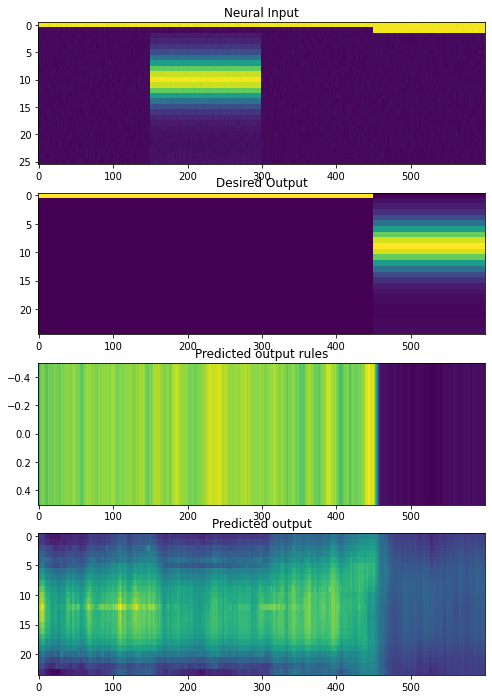

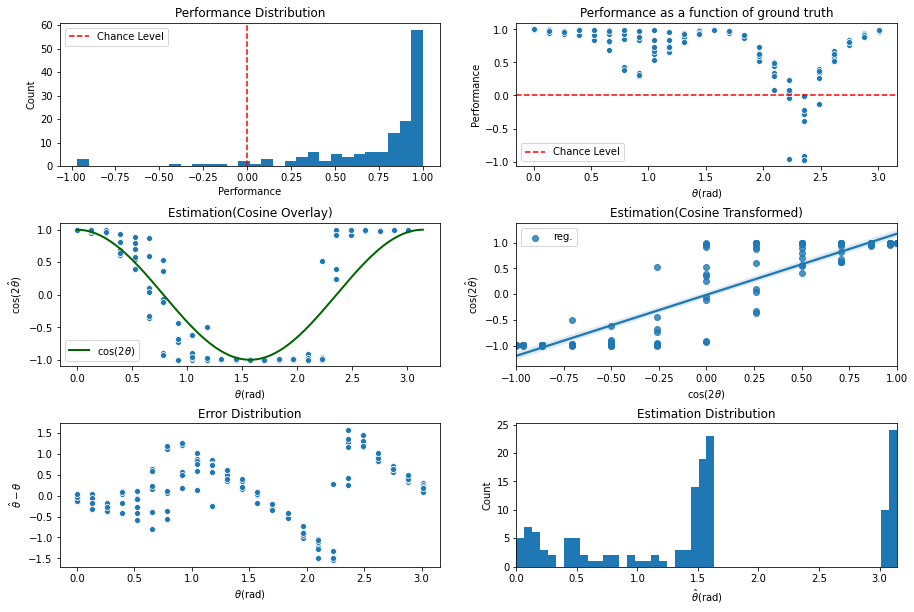

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter2800/assets

 Training performance: 
Iter. 2801 | Performance 0.7787 | Loss 0.2896 | Spike loss 2.6530
Testing performance: 
Iter. 2801 | Performance 0.6895 | Loss 0.2939 | Spike loss 2.5306

 Training performance: 
Iter. 2802 | Performance 0.7788 | Loss 0.2892 | Spike loss 2.5365
Testing performance: 
Iter. 2802 | Performance 0.7206 | Loss 0.2931 | Spike loss 2.5327

 Training performance: 
Iter. 2803 | Performance 0.7714 | Loss 0.2905 | Spike loss 2.6216
Testing performance: 
Iter. 2803 | Performance 0.7114 | Loss 0.2929 | Spike loss 2.5416

 Training performance: 
Iter. 2804 | Performance 0.6733 | Loss 0.2943 | Spike loss 2.4819
Testing performance: 
Iter. 2804 | Performance 0.7323 | Loss 0.2938 | Spike loss 2.5328

 Training performance: 
Iter. 2805 | Performance 0.7514 | Loss 0.2929 | Spike loss 2.6251
Testing performance: 
Iter. 2805 | Performance 0.7424 | Loss 0.2939 | Spike loss 2.5369

 Traini


 Training performance: 
Iter. 2847 | Performance 0.7369 | Loss 0.2913 | Spike loss 2.4880
Testing performance: 
Iter. 2847 | Performance 0.7570 | Loss 0.2923 | Spike loss 2.5257

 Training performance: 
Iter. 2848 | Performance 0.7864 | Loss 0.2898 | Spike loss 2.6077
Testing performance: 
Iter. 2848 | Performance 0.7549 | Loss 0.2917 | Spike loss 2.5142

 Training performance: 
Iter. 2849 | Performance 0.8385 | Loss 0.2867 | Spike loss 2.7323
Testing performance: 
Iter. 2849 | Performance 0.7509 | Loss 0.2931 | Spike loss 2.5385

 Training performance: 
Iter. 2850 | Performance 0.8098 | Loss 0.2894 | Spike loss 2.6284
Testing performance: 
Iter. 2850 | Performance 0.7297 | Loss 0.2942 | Spike loss 2.5242

 Training performance: 
Iter. 2851 | Performance 0.7951 | Loss 0.2902 | Spike loss 2.5179
Testing performance: 
Iter. 2851 | Performance 0.7551 | Loss 0.2913 | Spike loss 2.5399

 Training performance: 
Iter. 2852 | Performance 0.7107 | Loss 0.2941 | Spike loss 2.4826
Testing perfor


 Training performance: 
Iter. 2893 | Performance 0.7617 | Loss 0.2963 | Spike loss 2.6427
Testing performance: 
Iter. 2893 | Performance 0.8135 | Loss 0.2928 | Spike loss 2.6128

 Training performance: 
Iter. 2894 | Performance 0.8315 | Loss 0.2914 | Spike loss 2.5528
Testing performance: 
Iter. 2894 | Performance 0.8153 | Loss 0.2907 | Spike loss 2.5973

 Training performance: 
Iter. 2895 | Performance 0.8214 | Loss 0.2909 | Spike loss 2.6878
Testing performance: 
Iter. 2895 | Performance 0.7908 | Loss 0.2919 | Spike loss 2.5735

 Training performance: 
Iter. 2896 | Performance 0.8455 | Loss 0.2879 | Spike loss 2.5237
Testing performance: 
Iter. 2896 | Performance 0.7969 | Loss 0.2918 | Spike loss 2.5532

 Training performance: 
Iter. 2897 | Performance 0.8191 | Loss 0.2910 | Spike loss 2.6571
Testing performance: 
Iter. 2897 | Performance 0.8190 | Loss 0.2895 | Spike loss 2.5822

 Training performance: 
Iter. 2898 | Performance 0.7953 | Loss 0.2899 | Spike loss 2.4812
Testing perfor

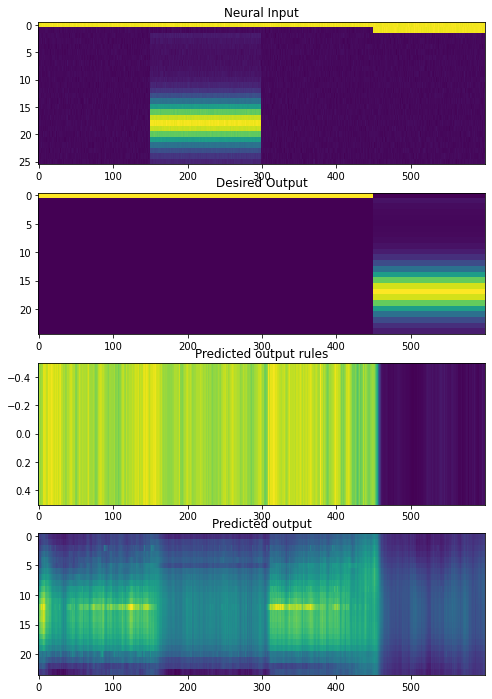

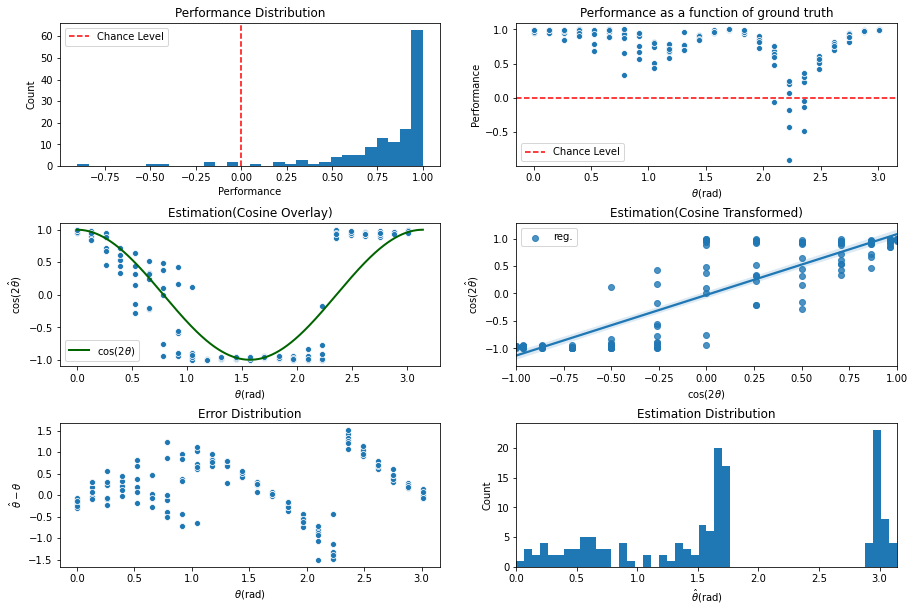

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter2900/assets

 Training performance: 
Iter. 2901 | Performance 0.8206 | Loss 0.2879 | Spike loss 2.6131
Testing performance: 
Iter. 2901 | Performance 0.7951 | Loss 0.2894 | Spike loss 2.5296

 Training performance: 
Iter. 2902 | Performance 0.7956 | Loss 0.2887 | Spike loss 2.5782
Testing performance: 
Iter. 2902 | Performance 0.7780 | Loss 0.2902 | Spike loss 2.5227

 Training performance: 
Iter. 2903 | Performance 0.7850 | Loss 0.2900 | Spike loss 2.4726
Testing performance: 
Iter. 2903 | Performance 0.7905 | Loss 0.2891 | Spike loss 2.5025

 Training performance: 
Iter. 2904 | Performance 0.7894 | Loss 0.2886 | Spike loss 2.5702
Testing performance: 
Iter. 2904 | Performance 0.7986 | Loss 0.2900 | Spike loss 2.5446

 Training performance: 
Iter. 2905 | Performance 0.8102 | Loss 0.2876 | Spike loss 2.5145
Testing performance: 
Iter. 2905 | Performance 0.8024 | Loss 0.2895 | Spike loss 2.5336

 Traini


 Training performance: 
Iter. 2947 | Performance 0.8420 | Loss 0.2901 | Spike loss 2.7436
Testing performance: 
Iter. 2947 | Performance 0.8473 | Loss 0.2899 | Spike loss 2.6554

 Training performance: 
Iter. 2948 | Performance 0.8655 | Loss 0.2889 | Spike loss 2.5989
Testing performance: 
Iter. 2948 | Performance 0.8104 | Loss 0.2937 | Spike loss 2.6226

 Training performance: 
Iter. 2949 | Performance 0.8206 | Loss 0.2921 | Spike loss 2.5586
Testing performance: 
Iter. 2949 | Performance 0.8173 | Loss 0.2909 | Spike loss 2.6347

 Training performance: 
Iter. 2950 | Performance 0.8389 | Loss 0.2887 | Spike loss 2.6094
Testing performance: 
Iter. 2950 | Performance 0.8325 | Loss 0.2869 | Spike loss 2.6387

 Training performance: 
Iter. 2951 | Performance 0.8191 | Loss 0.2867 | Spike loss 2.6918
Testing performance: 
Iter. 2951 | Performance 0.8382 | Loss 0.2873 | Spike loss 2.6389

 Training performance: 
Iter. 2952 | Performance 0.8650 | Loss 0.2859 | Spike loss 2.7046
Testing perfor


 Training performance: 
Iter. 2993 | Performance 0.8557 | Loss 0.2849 | Spike loss 2.6597
Testing performance: 
Iter. 2993 | Performance 0.8007 | Loss 0.2881 | Spike loss 2.6094

 Training performance: 
Iter. 2994 | Performance 0.7905 | Loss 0.2895 | Spike loss 2.4946
Testing performance: 
Iter. 2994 | Performance 0.8285 | Loss 0.2868 | Spike loss 2.6307

 Training performance: 
Iter. 2995 | Performance 0.8214 | Loss 0.2863 | Spike loss 2.6092
Testing performance: 
Iter. 2995 | Performance 0.8213 | Loss 0.2865 | Spike loss 2.6345

 Training performance: 
Iter. 2996 | Performance 0.8708 | Loss 0.2830 | Spike loss 2.5901
Testing performance: 
Iter. 2996 | Performance 0.8337 | Loss 0.2873 | Spike loss 2.6825

 Training performance: 
Iter. 2997 | Performance 0.8633 | Loss 0.2851 | Spike loss 2.7115
Testing performance: 
Iter. 2997 | Performance 0.8486 | Loss 0.2869 | Spike loss 2.7460

 Training performance: 
Iter. 2998 | Performance 0.8703 | Loss 0.2867 | Spike loss 2.8717
Testing perfor

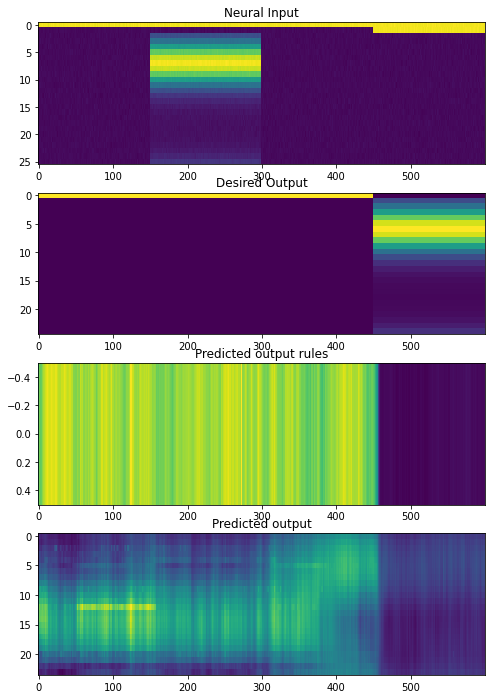

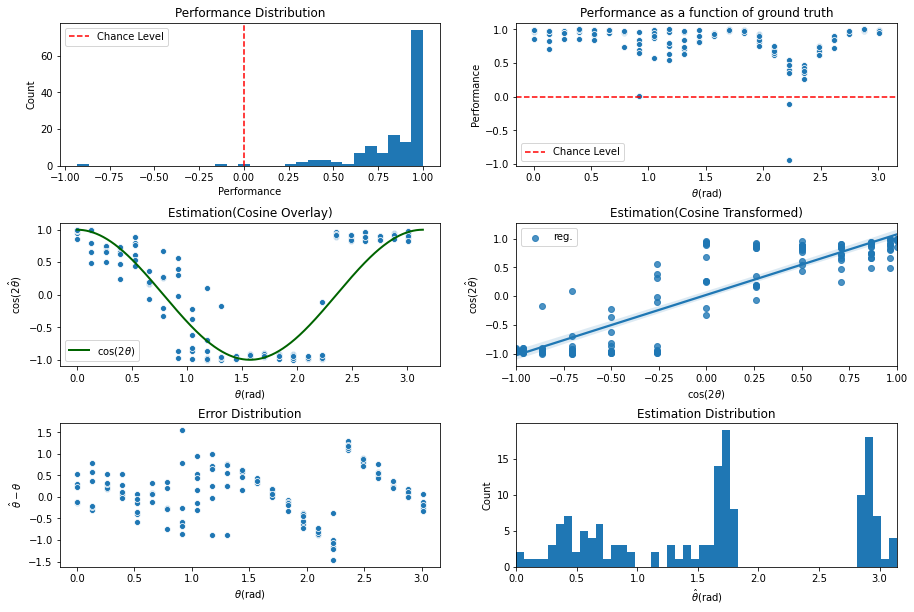

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter3000/assets

 Training performance: 
Iter. 3001 | Performance 0.8577 | Loss 0.2853 | Spike loss 2.6399
Testing performance: 
Iter. 3001 | Performance 0.8287 | Loss 0.2874 | Spike loss 2.7102

 Training performance: 
Iter. 3002 | Performance 0.8421 | Loss 0.2867 | Spike loss 2.6873
Testing performance: 
Iter. 3002 | Performance 0.8449 | Loss 0.2865 | Spike loss 2.6591

 Training performance: 
Iter. 3003 | Performance 0.8446 | Loss 0.2875 | Spike loss 2.6295
Testing performance: 
Iter. 3003 | Performance 0.8060 | Loss 0.2885 | Spike loss 2.6555

 Training performance: 
Iter. 3004 | Performance 0.8312 | Loss 0.2875 | Spike loss 2.6459
Testing performance: 
Iter. 3004 | Performance 0.8358 | Loss 0.2867 | Spike loss 2.6576

 Training performance: 
Iter. 3005 | Performance 0.7888 | Loss 0.2900 | Spike loss 2.6507
Testing performance: 
Iter. 3005 | Performance 0.8512 | Loss 0.2862 | Spike loss 2.7039

 Traini


 Training performance: 
Iter. 3047 | Performance 0.8473 | Loss 0.2845 | Spike loss 2.7503
Testing performance: 
Iter. 3047 | Performance 0.8623 | Loss 0.2853 | Spike loss 2.8706

 Training performance: 
Iter. 3048 | Performance 0.8491 | Loss 0.2870 | Spike loss 2.8080
Testing performance: 
Iter. 3048 | Performance 0.8545 | Loss 0.2853 | Spike loss 2.8328

 Training performance: 
Iter. 3049 | Performance 0.8411 | Loss 0.2859 | Spike loss 2.6855
Testing performance: 
Iter. 3049 | Performance 0.8656 | Loss 0.2842 | Spike loss 2.8012

 Training performance: 
Iter. 3050 | Performance 0.8867 | Loss 0.2823 | Spike loss 2.9733
Testing performance: 
Iter. 3050 | Performance 0.8472 | Loss 0.2859 | Spike loss 2.8084

 Training performance: 
Iter. 3051 | Performance 0.8766 | Loss 0.2835 | Spike loss 2.8877
Testing performance: 
Iter. 3051 | Performance 0.8529 | Loss 0.2853 | Spike loss 2.7867

 Training performance: 
Iter. 3052 | Performance 0.8552 | Loss 0.2844 | Spike loss 2.6462
Testing perfor


 Training performance: 
Iter. 3093 | Performance 0.9003 | Loss 0.2820 | Spike loss 2.9863
Testing performance: 
Iter. 3093 | Performance 0.8633 | Loss 0.2841 | Spike loss 2.8809

 Training performance: 
Iter. 3094 | Performance 0.8876 | Loss 0.2818 | Spike loss 2.8034
Testing performance: 
Iter. 3094 | Performance 0.8611 | Loss 0.2838 | Spike loss 2.8722

 Training performance: 
Iter. 3095 | Performance 0.8968 | Loss 0.2814 | Spike loss 2.9371
Testing performance: 
Iter. 3095 | Performance 0.8626 | Loss 0.2842 | Spike loss 2.8743

 Training performance: 
Iter. 3096 | Performance 0.8959 | Loss 0.2812 | Spike loss 2.8727
Testing performance: 
Iter. 3096 | Performance 0.8400 | Loss 0.2855 | Spike loss 2.8701

 Training performance: 
Iter. 3097 | Performance 0.8788 | Loss 0.2829 | Spike loss 2.9248
Testing performance: 
Iter. 3097 | Performance 0.8670 | Loss 0.2841 | Spike loss 2.8710

 Training performance: 
Iter. 3098 | Performance 0.8528 | Loss 0.2851 | Spike loss 2.8722
Testing perfor

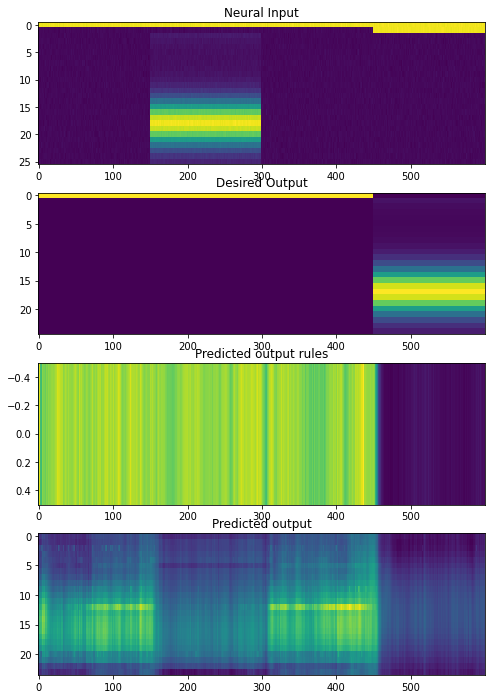

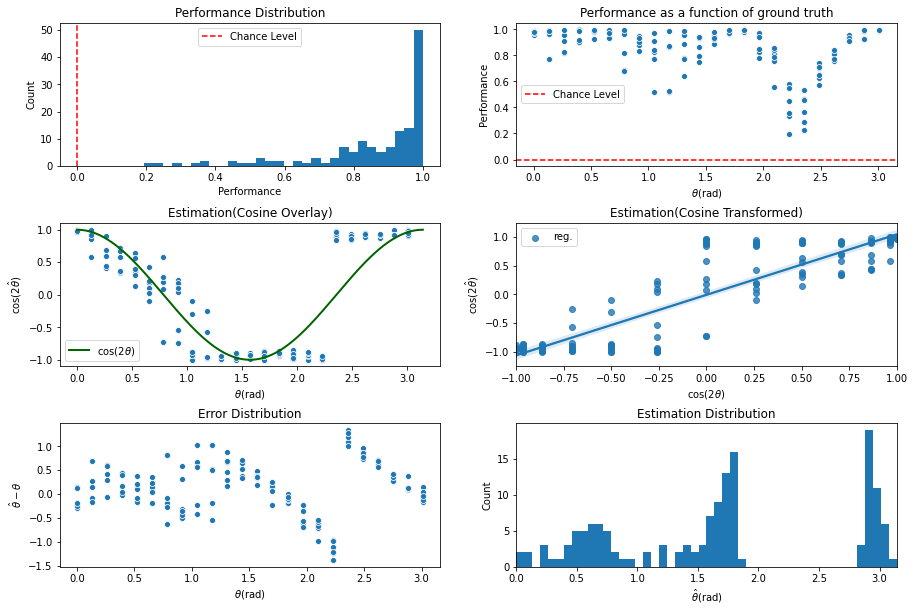

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter3100/assets

 Training performance: 
Iter. 3101 | Performance 0.8824 | Loss 0.2831 | Spike loss 2.8594
Testing performance: 
Iter. 3101 | Performance 0.8693 | Loss 0.2840 | Spike loss 2.9000

 Training performance: 
Iter. 3102 | Performance 0.8775 | Loss 0.2835 | Spike loss 2.8685
Testing performance: 
Iter. 3102 | Performance 0.8620 | Loss 0.2839 | Spike loss 2.8736

 Training performance: 
Iter. 3103 | Performance 0.8642 | Loss 0.2835 | Spike loss 2.8528
Testing performance: 
Iter. 3103 | Performance 0.8454 | Loss 0.2848 | Spike loss 2.8420

 Training performance: 
Iter. 3104 | Performance 0.8597 | Loss 0.2845 | Spike loss 2.8760
Testing performance: 
Iter. 3104 | Performance 0.8587 | Loss 0.2840 | Spike loss 2.8373

 Training performance: 
Iter. 3105 | Performance 0.8593 | Loss 0.2837 | Spike loss 2.8085
Testing performance: 
Iter. 3105 | Performance 0.8665 | Loss 0.2838 | Spike loss 2.8715

 Traini


 Training performance: 
Iter. 3147 | Performance 0.8947 | Loss 0.2816 | Spike loss 2.9639
Testing performance: 
Iter. 3147 | Performance 0.8859 | Loss 0.2828 | Spike loss 2.9109

 Training performance: 
Iter. 3148 | Performance 0.8969 | Loss 0.2812 | Spike loss 2.9950
Testing performance: 
Iter. 3148 | Performance 0.8845 | Loss 0.2821 | Spike loss 2.8913

 Training performance: 
Iter. 3149 | Performance 0.8885 | Loss 0.2828 | Spike loss 2.7961
Testing performance: 
Iter. 3149 | Performance 0.8769 | Loss 0.2838 | Spike loss 2.9080

 Training performance: 
Iter. 3150 | Performance 0.8709 | Loss 0.2834 | Spike loss 2.8307
Testing performance: 
Iter. 3150 | Performance 0.8558 | Loss 0.2840 | Spike loss 2.8615

 Training performance: 
Iter. 3151 | Performance 0.8836 | Loss 0.2822 | Spike loss 2.9415
Testing performance: 
Iter. 3151 | Performance 0.8831 | Loss 0.2828 | Spike loss 2.9085

 Training performance: 
Iter. 3152 | Performance 0.8792 | Loss 0.2833 | Spike loss 2.8864
Testing perfor


 Training performance: 
Iter. 3193 | Performance 0.8854 | Loss 0.2816 | Spike loss 2.9793
Testing performance: 
Iter. 3193 | Performance 0.8630 | Loss 0.2839 | Spike loss 2.8779

 Training performance: 
Iter. 3194 | Performance 0.8967 | Loss 0.2820 | Spike loss 2.7965
Testing performance: 
Iter. 3194 | Performance 0.8792 | Loss 0.2824 | Spike loss 2.8806

 Training performance: 
Iter. 3195 | Performance 0.8770 | Loss 0.2829 | Spike loss 2.8247
Testing performance: 
Iter. 3195 | Performance 0.8734 | Loss 0.2830 | Spike loss 2.8919

 Training performance: 
Iter. 3196 | Performance 0.8764 | Loss 0.2833 | Spike loss 2.9478
Testing performance: 
Iter. 3196 | Performance 0.8891 | Loss 0.2818 | Spike loss 2.8905

 Training performance: 
Iter. 3197 | Performance 0.8872 | Loss 0.2822 | Spike loss 2.8557
Testing performance: 
Iter. 3197 | Performance 0.8781 | Loss 0.2826 | Spike loss 2.9031

 Training performance: 
Iter. 3198 | Performance 0.8884 | Loss 0.2814 | Spike loss 3.0240
Testing perfor

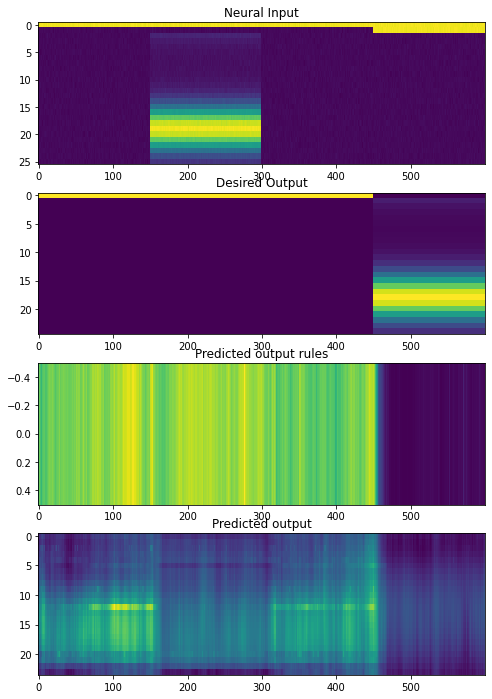

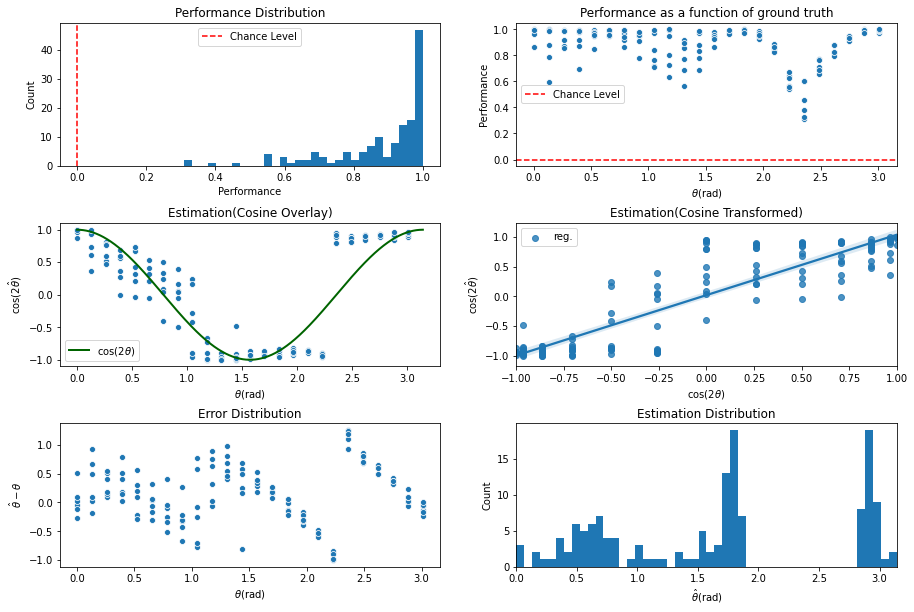

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter3200/assets

 Training performance: 
Iter. 3201 | Performance 0.8757 | Loss 0.2832 | Spike loss 2.9617
Testing performance: 
Iter. 3201 | Performance 0.8689 | Loss 0.2831 | Spike loss 2.8665

 Training performance: 
Iter. 3202 | Performance 0.8405 | Loss 0.2851 | Spike loss 2.9589
Testing performance: 
Iter. 3202 | Performance 0.8756 | Loss 0.2823 | Spike loss 2.8635

 Training performance: 
Iter. 3203 | Performance 0.8856 | Loss 0.2813 | Spike loss 2.9449
Testing performance: 
Iter. 3203 | Performance 0.8613 | Loss 0.2836 | Spike loss 2.8512

 Training performance: 
Iter. 3204 | Performance 0.8971 | Loss 0.2807 | Spike loss 2.8776
Testing performance: 
Iter. 3204 | Performance 0.8664 | Loss 0.2836 | Spike loss 2.8512

 Training performance: 
Iter. 3205 | Performance 0.8745 | Loss 0.2825 | Spike loss 2.8199
Testing performance: 
Iter. 3205 | Performance 0.8836 | Loss 0.2826 | Spike loss 2.8916

 Traini


 Training performance: 
Iter. 3247 | Performance 0.8770 | Loss 0.2816 | Spike loss 3.0413
Testing performance: 
Iter. 3247 | Performance 0.8757 | Loss 0.2834 | Spike loss 2.9369

 Training performance: 
Iter. 3248 | Performance 0.8926 | Loss 0.2824 | Spike loss 2.9273
Testing performance: 
Iter. 3248 | Performance 0.8927 | Loss 0.2822 | Spike loss 2.9380

 Training performance: 
Iter. 3249 | Performance 0.8937 | Loss 0.2825 | Spike loss 2.9303
Testing performance: 
Iter. 3249 | Performance 0.8944 | Loss 0.2824 | Spike loss 2.9792

 Training performance: 
Iter. 3250 | Performance 0.9046 | Loss 0.2811 | Spike loss 2.8798
Testing performance: 
Iter. 3250 | Performance 0.9058 | Loss 0.2818 | Spike loss 2.9721

 Training performance: 
Iter. 3251 | Performance 0.8981 | Loss 0.2830 | Spike loss 2.9588
Testing performance: 
Iter. 3251 | Performance 0.8990 | Loss 0.2825 | Spike loss 2.9987

 Training performance: 
Iter. 3252 | Performance 0.9068 | Loss 0.2828 | Spike loss 2.8785
Testing perfor


 Training performance: 
Iter. 3293 | Performance 0.8949 | Loss 0.2819 | Spike loss 2.9894
Testing performance: 
Iter. 3293 | Performance 0.8943 | Loss 0.2812 | Spike loss 2.9628

 Training performance: 
Iter. 3294 | Performance 0.9105 | Loss 0.2810 | Spike loss 2.9569
Testing performance: 
Iter. 3294 | Performance 0.8766 | Loss 0.2821 | Spike loss 2.9484

 Training performance: 
Iter. 3295 | Performance 0.9165 | Loss 0.2800 | Spike loss 2.8771
Testing performance: 
Iter. 3295 | Performance 0.8888 | Loss 0.2825 | Spike loss 2.9704

 Training performance: 
Iter. 3296 | Performance 0.8957 | Loss 0.2815 | Spike loss 2.9758
Testing performance: 
Iter. 3296 | Performance 0.8748 | Loss 0.2825 | Spike loss 2.9650

 Training performance: 
Iter. 3297 | Performance 0.8885 | Loss 0.2817 | Spike loss 3.0860
Testing performance: 
Iter. 3297 | Performance 0.8908 | Loss 0.2808 | Spike loss 2.9398

 Training performance: 
Iter. 3298 | Performance 0.8650 | Loss 0.2834 | Spike loss 3.0675
Testing perfor

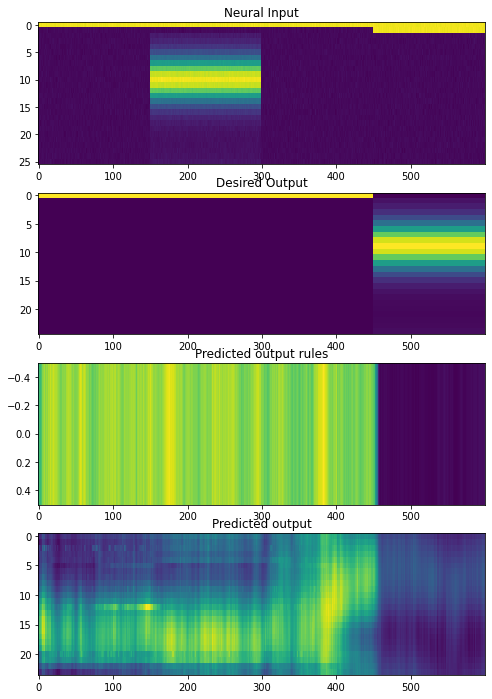

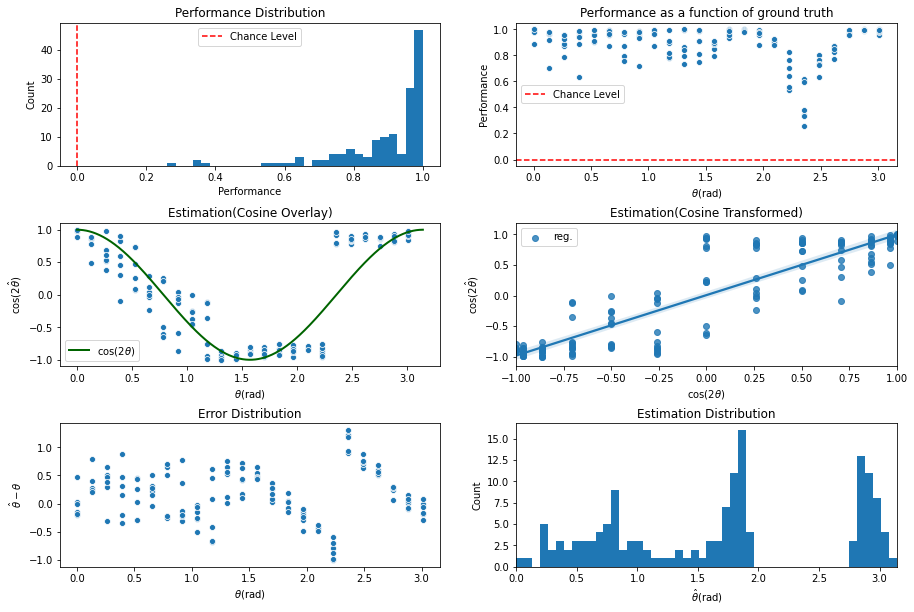

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter3300/assets

 Training performance: 
Iter. 3301 | Performance 0.8899 | Loss 0.2821 | Spike loss 2.8510
Testing performance: 
Iter. 3301 | Performance 0.9019 | Loss 0.2809 | Spike loss 2.9560

 Training performance: 
Iter. 3302 | Performance 0.8768 | Loss 0.2825 | Spike loss 3.0417
Testing performance: 
Iter. 3302 | Performance 0.9054 | Loss 0.2813 | Spike loss 2.9758

 Training performance: 
Iter. 3303 | Performance 0.9068 | Loss 0.2811 | Spike loss 2.9520
Testing performance: 
Iter. 3303 | Performance 0.8863 | Loss 0.2815 | Spike loss 2.9232

 Training performance: 
Iter. 3304 | Performance 0.9179 | Loss 0.2806 | Spike loss 2.8978
Testing performance: 
Iter. 3304 | Performance 0.9053 | Loss 0.2807 | Spike loss 2.9474

 Training performance: 
Iter. 3305 | Performance 0.9021 | Loss 0.2820 | Spike loss 3.0144
Testing performance: 
Iter. 3305 | Performance 0.8932 | Loss 0.2822 | Spike loss 2.9616

 Traini


 Training performance: 
Iter. 3347 | Performance 0.9184 | Loss 0.2787 | Spike loss 3.1427
Testing performance: 
Iter. 3347 | Performance 0.8967 | Loss 0.2811 | Spike loss 3.0117

 Training performance: 
Iter. 3348 | Performance 0.9271 | Loss 0.2783 | Spike loss 3.0337
Testing performance: 
Iter. 3348 | Performance 0.8963 | Loss 0.2811 | Spike loss 3.0105

 Training performance: 
Iter. 3349 | Performance 0.8899 | Loss 0.2820 | Spike loss 3.0297
Testing performance: 
Iter. 3349 | Performance 0.8887 | Loss 0.2813 | Spike loss 2.9678

 Training performance: 
Iter. 3350 | Performance 0.9036 | Loss 0.2801 | Spike loss 2.9858
Testing performance: 
Iter. 3350 | Performance 0.9009 | Loss 0.2807 | Spike loss 2.9779

 Training performance: 
Iter. 3351 | Performance 0.8994 | Loss 0.2815 | Spike loss 2.9405
Testing performance: 
Iter. 3351 | Performance 0.8898 | Loss 0.2818 | Spike loss 2.9664

 Training performance: 
Iter. 3352 | Performance 0.9034 | Loss 0.2803 | Spike loss 2.9733
Testing perfor


 Training performance: 
Iter. 3393 | Performance 0.9352 | Loss 0.2777 | Spike loss 2.8855
Testing performance: 
Iter. 3393 | Performance 0.9134 | Loss 0.2805 | Spike loss 2.9531

 Training performance: 
Iter. 3394 | Performance 0.9104 | Loss 0.2808 | Spike loss 2.9198
Testing performance: 
Iter. 3394 | Performance 0.8980 | Loss 0.2801 | Spike loss 2.8889

 Training performance: 
Iter. 3395 | Performance 0.8759 | Loss 0.2824 | Spike loss 2.9116
Testing performance: 
Iter. 3395 | Performance 0.8834 | Loss 0.2812 | Spike loss 2.9062

 Training performance: 
Iter. 3396 | Performance 0.9077 | Loss 0.2802 | Spike loss 2.8833
Testing performance: 
Iter. 3396 | Performance 0.8971 | Loss 0.2803 | Spike loss 2.9287

 Training performance: 
Iter. 3397 | Performance 0.8990 | Loss 0.2800 | Spike loss 2.9789
Testing performance: 
Iter. 3397 | Performance 0.8874 | Loss 0.2813 | Spike loss 2.9560

 Training performance: 
Iter. 3398 | Performance 0.9159 | Loss 0.2798 | Spike loss 2.9098
Testing perfor

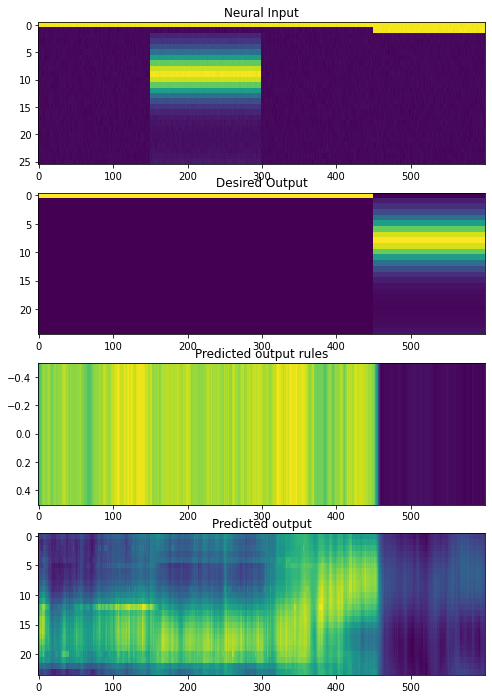

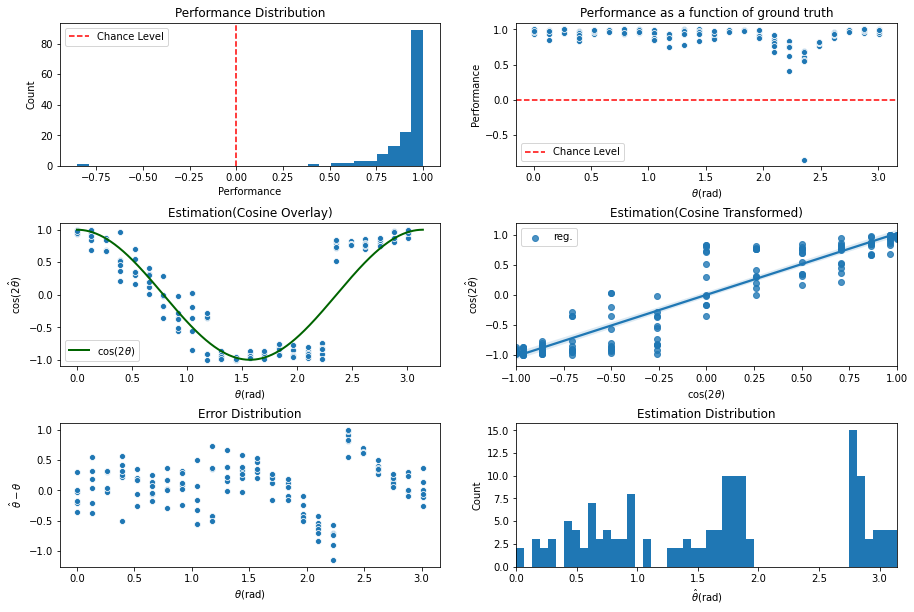

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter3400/assets

 Training performance: 
Iter. 3401 | Performance 0.9092 | Loss 0.2810 | Spike loss 2.9717
Testing performance: 
Iter. 3401 | Performance 0.9094 | Loss 0.2812 | Spike loss 3.0129

 Training performance: 
Iter. 3402 | Performance 0.9092 | Loss 0.2800 | Spike loss 3.0203
Testing performance: 
Iter. 3402 | Performance 0.9008 | Loss 0.2814 | Spike loss 3.0271

 Training performance: 
Iter. 3403 | Performance 0.9258 | Loss 0.2800 | Spike loss 3.0316
Testing performance: 
Iter. 3403 | Performance 0.9099 | Loss 0.2815 | Spike loss 3.0175

 Training performance: 
Iter. 3404 | Performance 0.9044 | Loss 0.2810 | Spike loss 3.0104
Testing performance: 
Iter. 3404 | Performance 0.9176 | Loss 0.2797 | Spike loss 2.9620

 Training performance: 
Iter. 3405 | Performance 0.9263 | Loss 0.2794 | Spike loss 2.9113
Testing performance: 
Iter. 3405 | Performance 0.8971 | Loss 0.2801 | Spike loss 2.9301

 Traini


 Training performance: 
Iter. 3447 | Performance 0.9145 | Loss 0.2797 | Spike loss 2.9816
Testing performance: 
Iter. 3447 | Performance 0.8938 | Loss 0.2809 | Spike loss 2.9562

 Training performance: 
Iter. 3448 | Performance 0.9086 | Loss 0.2811 | Spike loss 2.9952
Testing performance: 
Iter. 3448 | Performance 0.9110 | Loss 0.2800 | Spike loss 2.9890

 Training performance: 
Iter. 3449 | Performance 0.9228 | Loss 0.2791 | Spike loss 2.9499
Testing performance: 
Iter. 3449 | Performance 0.9182 | Loss 0.2798 | Spike loss 2.9817

 Training performance: 
Iter. 3450 | Performance 0.9018 | Loss 0.2801 | Spike loss 2.9550
Testing performance: 
Iter. 3450 | Performance 0.9056 | Loss 0.2805 | Spike loss 3.0056

 Training performance: 
Iter. 3451 | Performance 0.9201 | Loss 0.2798 | Spike loss 3.0244
Testing performance: 
Iter. 3451 | Performance 0.9117 | Loss 0.2797 | Spike loss 2.9941

 Training performance: 
Iter. 3452 | Performance 0.9292 | Loss 0.2784 | Spike loss 3.0271
Testing perfor


 Training performance: 
Iter. 3493 | Performance 0.9274 | Loss 0.2797 | Spike loss 2.9408
Testing performance: 
Iter. 3493 | Performance 0.9024 | Loss 0.2806 | Spike loss 3.0147

 Training performance: 
Iter. 3494 | Performance 0.8928 | Loss 0.2809 | Spike loss 3.0086
Testing performance: 
Iter. 3494 | Performance 0.9074 | Loss 0.2796 | Spike loss 3.0056

 Training performance: 
Iter. 3495 | Performance 0.9137 | Loss 0.2784 | Spike loss 3.0188
Testing performance: 
Iter. 3495 | Performance 0.9130 | Loss 0.2793 | Spike loss 3.0009

 Training performance: 
Iter. 3496 | Performance 0.9121 | Loss 0.2798 | Spike loss 2.9382
Testing performance: 
Iter. 3496 | Performance 0.9036 | Loss 0.2800 | Spike loss 2.9939

 Training performance: 
Iter. 3497 | Performance 0.8906 | Loss 0.2813 | Spike loss 2.9217
Testing performance: 
Iter. 3497 | Performance 0.9035 | Loss 0.2797 | Spike loss 2.9874

 Training performance: 
Iter. 3498 | Performance 0.9068 | Loss 0.2796 | Spike loss 2.9200
Testing perfor

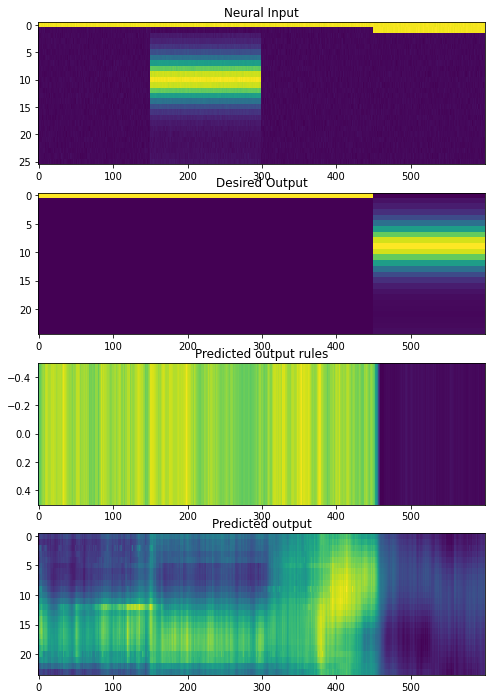

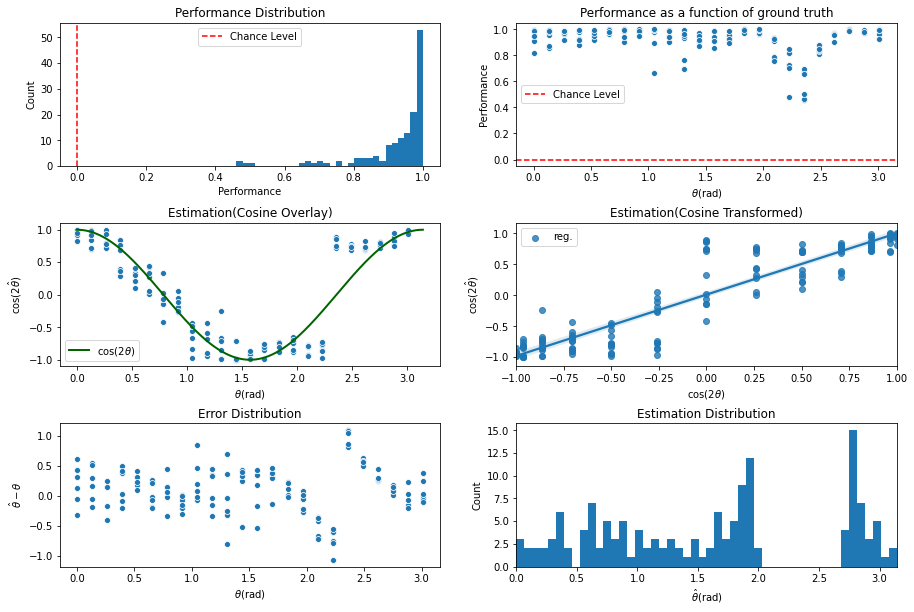

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter3500/assets

 Training performance: 
Iter. 3501 | Performance 0.9140 | Loss 0.2797 | Spike loss 2.9676
Testing performance: 
Iter. 3501 | Performance 0.9221 | Loss 0.2795 | Spike loss 3.0205

 Training performance: 
Iter. 3502 | Performance 0.9123 | Loss 0.2804 | Spike loss 2.9899
Testing performance: 
Iter. 3502 | Performance 0.9271 | Loss 0.2787 | Spike loss 3.0170

 Training performance: 
Iter. 3503 | Performance 0.9069 | Loss 0.2811 | Spike loss 3.0264
Testing performance: 
Iter. 3503 | Performance 0.9200 | Loss 0.2796 | Spike loss 3.0302

 Training performance: 
Iter. 3504 | Performance 0.9189 | Loss 0.2789 | Spike loss 3.0749
Testing performance: 
Iter. 3504 | Performance 0.9111 | Loss 0.2797 | Spike loss 3.0482

 Training performance: 
Iter. 3505 | Performance 0.9180 | Loss 0.2789 | Spike loss 3.1413
Testing performance: 
Iter. 3505 | Performance 0.9120 | Loss 0.2798 | Spike loss 3.0176

 Traini


 Training performance: 
Iter. 3547 | Performance 0.9226 | Loss 0.2791 | Spike loss 3.0146
Testing performance: 
Iter. 3547 | Performance 0.9290 | Loss 0.2792 | Spike loss 3.0505

 Training performance: 
Iter. 3548 | Performance 0.9092 | Loss 0.2800 | Spike loss 3.0953
Testing performance: 
Iter. 3548 | Performance 0.9163 | Loss 0.2798 | Spike loss 3.0426

 Training performance: 
Iter. 3549 | Performance 0.9211 | Loss 0.2796 | Spike loss 3.0256
Testing performance: 
Iter. 3549 | Performance 0.9195 | Loss 0.2796 | Spike loss 3.0393

 Training performance: 
Iter. 3550 | Performance 0.9228 | Loss 0.2795 | Spike loss 3.0032
Testing performance: 
Iter. 3550 | Performance 0.9097 | Loss 0.2795 | Spike loss 3.0275

 Training performance: 
Iter. 3551 | Performance 0.9025 | Loss 0.2807 | Spike loss 3.1137
Testing performance: 
Iter. 3551 | Performance 0.9140 | Loss 0.2790 | Spike loss 3.0104

 Training performance: 
Iter. 3552 | Performance 0.9144 | Loss 0.2793 | Spike loss 3.0276
Testing perfor


 Training performance: 
Iter. 3593 | Performance 0.9233 | Loss 0.2791 | Spike loss 3.0478
Testing performance: 
Iter. 3593 | Performance 0.9270 | Loss 0.2789 | Spike loss 3.0139

 Training performance: 
Iter. 3594 | Performance 0.9226 | Loss 0.2805 | Spike loss 2.9337
Testing performance: 
Iter. 3594 | Performance 0.9177 | Loss 0.2794 | Spike loss 3.0045

 Training performance: 
Iter. 3595 | Performance 0.9205 | Loss 0.2791 | Spike loss 2.9861
Testing performance: 
Iter. 3595 | Performance 0.9217 | Loss 0.2786 | Spike loss 3.0002

 Training performance: 
Iter. 3596 | Performance 0.9164 | Loss 0.2786 | Spike loss 3.0616
Testing performance: 
Iter. 3596 | Performance 0.9054 | Loss 0.2791 | Spike loss 2.9736

 Training performance: 
Iter. 3597 | Performance 0.9182 | Loss 0.2772 | Spike loss 2.9428
Testing performance: 
Iter. 3597 | Performance 0.9183 | Loss 0.2792 | Spike loss 2.9892

 Training performance: 
Iter. 3598 | Performance 0.9095 | Loss 0.2795 | Spike loss 3.0136
Testing perfor

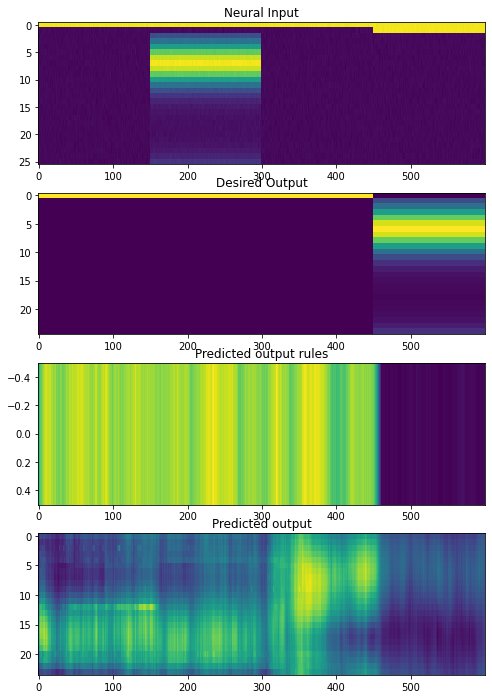

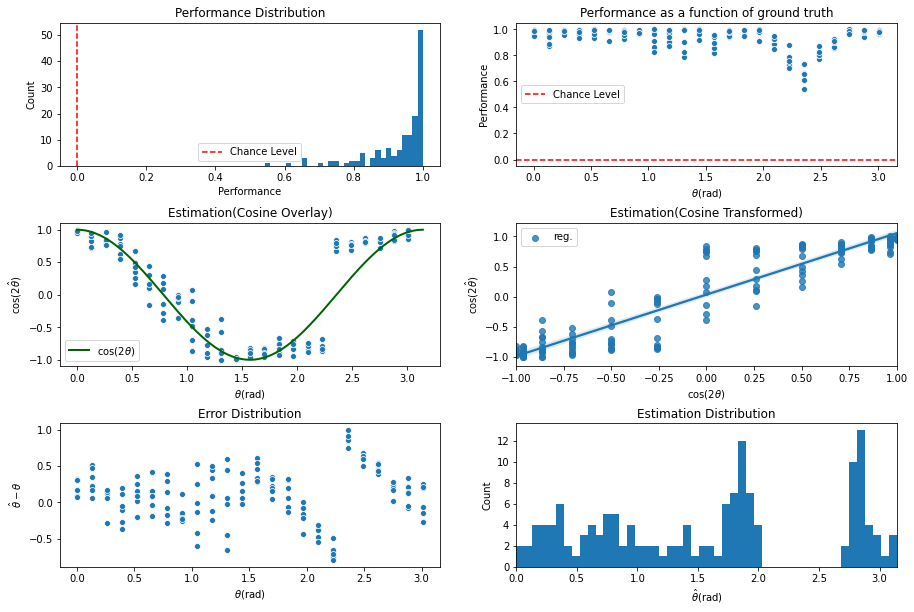

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter3600/assets

 Training performance: 
Iter. 3601 | Performance 0.9223 | Loss 0.2783 | Spike loss 2.9625
Testing performance: 
Iter. 3601 | Performance 0.9193 | Loss 0.2800 | Spike loss 3.0339

 Training performance: 
Iter. 3602 | Performance 0.9118 | Loss 0.2810 | Spike loss 3.0182
Testing performance: 
Iter. 3602 | Performance 0.9183 | Loss 0.2794 | Spike loss 3.0132

 Training performance: 
Iter. 3603 | Performance 0.9243 | Loss 0.2789 | Spike loss 2.9682
Testing performance: 
Iter. 3603 | Performance 0.9106 | Loss 0.2800 | Spike loss 3.0060

 Training performance: 
Iter. 3604 | Performance 0.9341 | Loss 0.2773 | Spike loss 2.9178
Testing performance: 
Iter. 3604 | Performance 0.9237 | Loss 0.2784 | Spike loss 2.9695

 Training performance: 
Iter. 3605 | Performance 0.9167 | Loss 0.2798 | Spike loss 2.8819
Testing performance: 
Iter. 3605 | Performance 0.9149 | Loss 0.2788 | Spike loss 2.9559

 Traini


 Training performance: 
Iter. 3647 | Performance 0.9325 | Loss 0.2778 | Spike loss 2.8987
Testing performance: 
Iter. 3647 | Performance 0.9160 | Loss 0.2787 | Spike loss 2.9987

 Training performance: 
Iter. 3648 | Performance 0.9111 | Loss 0.2790 | Spike loss 2.9826
Testing performance: 
Iter. 3648 | Performance 0.9210 | Loss 0.2783 | Spike loss 3.0115

 Training performance: 
Iter. 3649 | Performance 0.8941 | Loss 0.2806 | Spike loss 3.0723
Testing performance: 
Iter. 3649 | Performance 0.9175 | Loss 0.2785 | Spike loss 3.0001

 Training performance: 
Iter. 3650 | Performance 0.9138 | Loss 0.2780 | Spike loss 3.1038
Testing performance: 
Iter. 3650 | Performance 0.9203 | Loss 0.2782 | Spike loss 3.0101

 Training performance: 
Iter. 3651 | Performance 0.9317 | Loss 0.2768 | Spike loss 3.0176
Testing performance: 
Iter. 3651 | Performance 0.9285 | Loss 0.2776 | Spike loss 3.0021

 Training performance: 
Iter. 3652 | Performance 0.9372 | Loss 0.2777 | Spike loss 2.9929
Testing perfor


 Training performance: 
Iter. 3693 | Performance 0.9335 | Loss 0.2767 | Spike loss 2.8871
Testing performance: 
Iter. 3693 | Performance 0.9243 | Loss 0.2790 | Spike loss 3.0057

 Training performance: 
Iter. 3694 | Performance 0.9388 | Loss 0.2777 | Spike loss 2.9041
Testing performance: 
Iter. 3694 | Performance 0.9310 | Loss 0.2773 | Spike loss 2.9732

 Training performance: 
Iter. 3695 | Performance 0.9492 | Loss 0.2759 | Spike loss 3.0482
Testing performance: 
Iter. 3695 | Performance 0.9248 | Loss 0.2776 | Spike loss 2.9457

 Training performance: 
Iter. 3696 | Performance 0.9122 | Loss 0.2789 | Spike loss 3.0834
Testing performance: 
Iter. 3696 | Performance 0.9157 | Loss 0.2788 | Spike loss 2.9946

 Training performance: 
Iter. 3697 | Performance 0.9270 | Loss 0.2778 | Spike loss 3.0024
Testing performance: 
Iter. 3697 | Performance 0.9163 | Loss 0.2795 | Spike loss 2.9902

 Training performance: 
Iter. 3698 | Performance 0.9193 | Loss 0.2789 | Spike loss 3.0845
Testing perfor

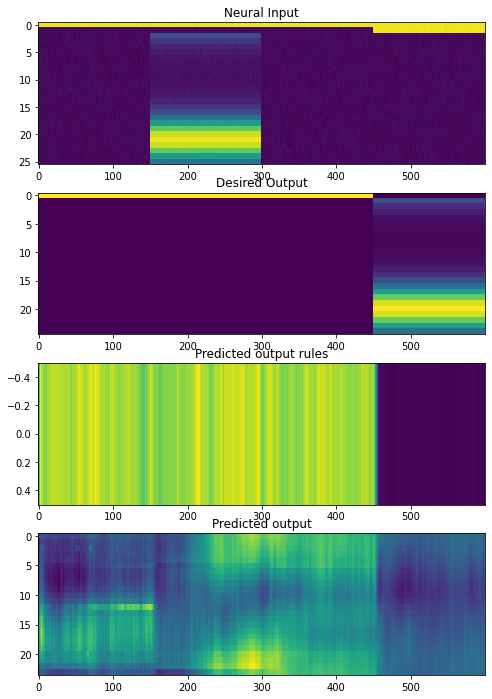

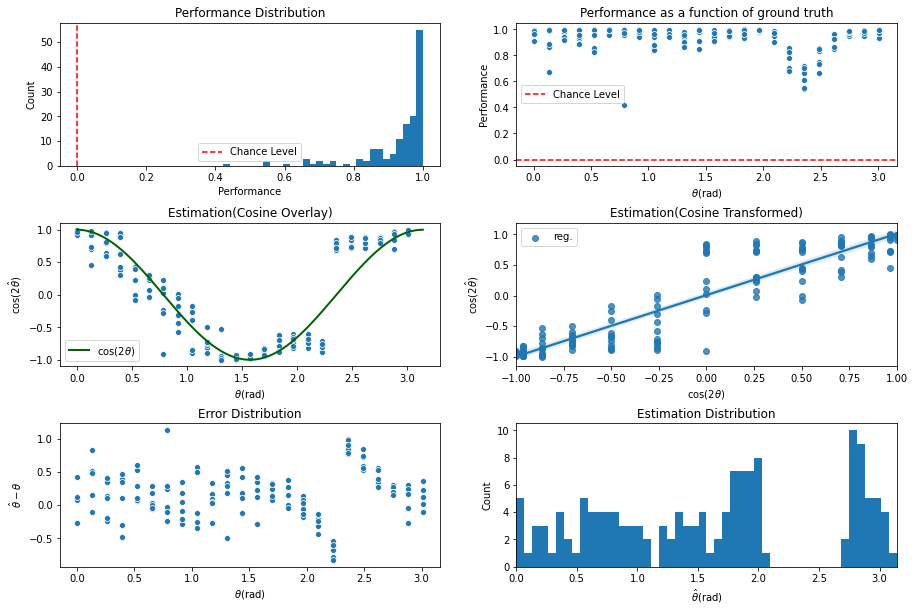

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter3700/assets

 Training performance: 
Iter. 3701 | Performance 0.9193 | Loss 0.2779 | Spike loss 3.0843
Testing performance: 
Iter. 3701 | Performance 0.9257 | Loss 0.2780 | Spike loss 2.9590

 Training performance: 
Iter. 3702 | Performance 0.9204 | Loss 0.2789 | Spike loss 2.9606
Testing performance: 
Iter. 3702 | Performance 0.9151 | Loss 0.2782 | Spike loss 2.9591

 Training performance: 
Iter. 3703 | Performance 0.9175 | Loss 0.2779 | Spike loss 3.0973
Testing performance: 
Iter. 3703 | Performance 0.9205 | Loss 0.2789 | Spike loss 2.9722

 Training performance: 
Iter. 3704 | Performance 0.9042 | Loss 0.2797 | Spike loss 3.0063
Testing performance: 
Iter. 3704 | Performance 0.9313 | Loss 0.2778 | Spike loss 2.9844

 Training performance: 
Iter. 3705 | Performance 0.9244 | Loss 0.2778 | Spike loss 3.0484
Testing performance: 
Iter. 3705 | Performance 0.9206 | Loss 0.2782 | Spike loss 2.9805

 Traini


 Training performance: 
Iter. 3747 | Performance 0.9294 | Loss 0.2777 | Spike loss 3.0346
Testing performance: 
Iter. 3747 | Performance 0.9348 | Loss 0.2769 | Spike loss 3.0267

 Training performance: 
Iter. 3748 | Performance 0.9310 | Loss 0.2781 | Spike loss 3.0609
Testing performance: 
Iter. 3748 | Performance 0.9374 | Loss 0.2771 | Spike loss 3.0269

 Training performance: 
Iter. 3749 | Performance 0.9423 | Loss 0.2763 | Spike loss 2.9987
Testing performance: 
Iter. 3749 | Performance 0.9340 | Loss 0.2771 | Spike loss 2.9968

 Training performance: 
Iter. 3750 | Performance 0.9436 | Loss 0.2766 | Spike loss 2.9904
Testing performance: 
Iter. 3750 | Performance 0.9169 | Loss 0.2778 | Spike loss 2.9958

 Training performance: 
Iter. 3751 | Performance 0.9042 | Loss 0.2791 | Spike loss 2.9376
Testing performance: 
Iter. 3751 | Performance 0.9160 | Loss 0.2784 | Spike loss 2.9756

 Training performance: 
Iter. 3752 | Performance 0.9173 | Loss 0.2777 | Spike loss 2.9919
Testing perfor


 Training performance: 
Iter. 3793 | Performance 0.9403 | Loss 0.2766 | Spike loss 3.0474
Testing performance: 
Iter. 3793 | Performance 0.9351 | Loss 0.2770 | Spike loss 3.0147

 Training performance: 
Iter. 3794 | Performance 0.9551 | Loss 0.2755 | Spike loss 3.0128
Testing performance: 
Iter. 3794 | Performance 0.9412 | Loss 0.2755 | Spike loss 2.9943

 Training performance: 
Iter. 3795 | Performance 0.9315 | Loss 0.2763 | Spike loss 3.0598
Testing performance: 
Iter. 3795 | Performance 0.9275 | Loss 0.2773 | Spike loss 2.9773

 Training performance: 
Iter. 3796 | Performance 0.9310 | Loss 0.2766 | Spike loss 2.9701
Testing performance: 
Iter. 3796 | Performance 0.9370 | Loss 0.2772 | Spike loss 3.0045

 Training performance: 
Iter. 3797 | Performance 0.9264 | Loss 0.2769 | Spike loss 2.9811
Testing performance: 
Iter. 3797 | Performance 0.9321 | Loss 0.2775 | Spike loss 2.9737

 Training performance: 
Iter. 3798 | Performance 0.9503 | Loss 0.2752 | Spike loss 2.9505
Testing perfor

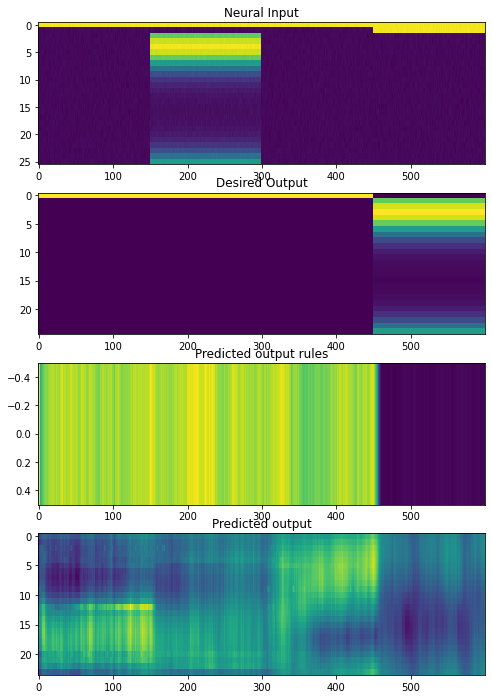

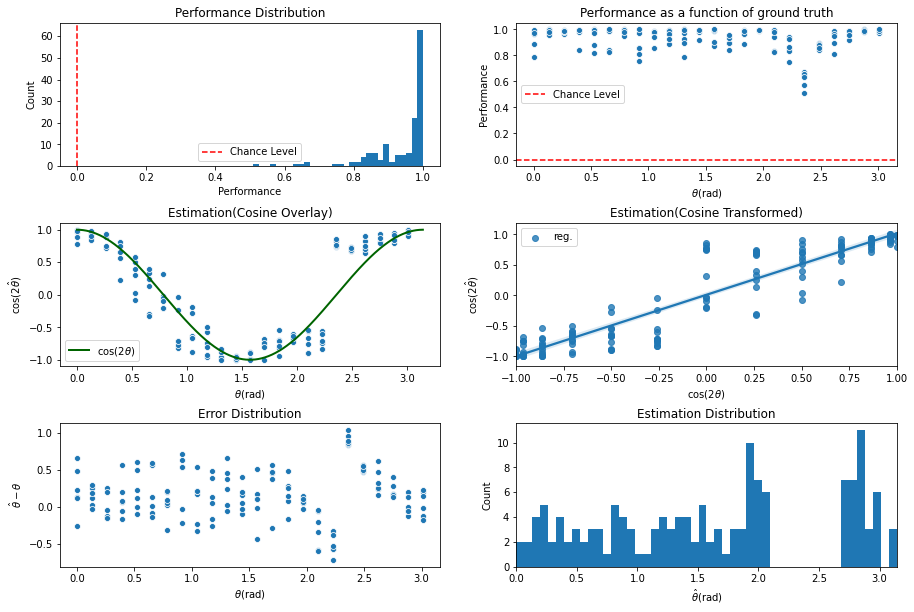

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter3800/assets

 Training performance: 
Iter. 3801 | Performance 0.9393 | Loss 0.2765 | Spike loss 3.0232
Testing performance: 
Iter. 3801 | Performance 0.9120 | Loss 0.2774 | Spike loss 2.9619

 Training performance: 
Iter. 3802 | Performance 0.9235 | Loss 0.2766 | Spike loss 3.0003
Testing performance: 
Iter. 3802 | Performance 0.9262 | Loss 0.2767 | Spike loss 2.9686

 Training performance: 
Iter. 3803 | Performance 0.9278 | Loss 0.2766 | Spike loss 3.1018
Testing performance: 
Iter. 3803 | Performance 0.9452 | Loss 0.2755 | Spike loss 2.9707

 Training performance: 
Iter. 3804 | Performance 0.9441 | Loss 0.2748 | Spike loss 2.9572
Testing performance: 
Iter. 3804 | Performance 0.9317 | Loss 0.2768 | Spike loss 2.9792

 Training performance: 
Iter. 3805 | Performance 0.9426 | Loss 0.2759 | Spike loss 2.8508
Testing performance: 
Iter. 3805 | Performance 0.9230 | Loss 0.2774 | Spike loss 2.9798

 Traini


 Training performance: 
Iter. 3847 | Performance 0.9422 | Loss 0.2758 | Spike loss 2.9655
Testing performance: 
Iter. 3847 | Performance 0.9351 | Loss 0.2756 | Spike loss 2.9012

 Training performance: 
Iter. 3848 | Performance 0.9297 | Loss 0.2758 | Spike loss 2.9288
Testing performance: 
Iter. 3848 | Performance 0.9244 | Loss 0.2757 | Spike loss 2.8989

 Training performance: 
Iter. 3849 | Performance 0.9151 | Loss 0.2774 | Spike loss 2.8497
Testing performance: 
Iter. 3849 | Performance 0.9233 | Loss 0.2762 | Spike loss 2.8942

 Training performance: 
Iter. 3850 | Performance 0.9317 | Loss 0.2746 | Spike loss 2.9201
Testing performance: 
Iter. 3850 | Performance 0.9275 | Loss 0.2757 | Spike loss 2.8915

 Training performance: 
Iter. 3851 | Performance 0.9257 | Loss 0.2750 | Spike loss 2.9499
Testing performance: 
Iter. 3851 | Performance 0.9202 | Loss 0.2766 | Spike loss 2.8840

 Training performance: 
Iter. 3852 | Performance 0.9461 | Loss 0.2741 | Spike loss 2.9371
Testing perfor


 Training performance: 
Iter. 3893 | Performance 0.9405 | Loss 0.2751 | Spike loss 2.9578
Testing performance: 
Iter. 3893 | Performance 0.9291 | Loss 0.2766 | Spike loss 2.8960

 Training performance: 
Iter. 3894 | Performance 0.9454 | Loss 0.2747 | Spike loss 2.7936
Testing performance: 
Iter. 3894 | Performance 0.9466 | Loss 0.2751 | Spike loss 2.9459

 Training performance: 
Iter. 3895 | Performance 0.9464 | Loss 0.2754 | Spike loss 2.8791
Testing performance: 
Iter. 3895 | Performance 0.9452 | Loss 0.2745 | Spike loss 2.8996

 Training performance: 
Iter. 3896 | Performance 0.9425 | Loss 0.2758 | Spike loss 2.9766
Testing performance: 
Iter. 3896 | Performance 0.9403 | Loss 0.2752 | Spike loss 2.9303

 Training performance: 
Iter. 3897 | Performance 0.9516 | Loss 0.2740 | Spike loss 2.9528
Testing performance: 
Iter. 3897 | Performance 0.9325 | Loss 0.2755 | Spike loss 2.8958

 Training performance: 
Iter. 3898 | Performance 0.9349 | Loss 0.2746 | Spike loss 2.8613
Testing perfor

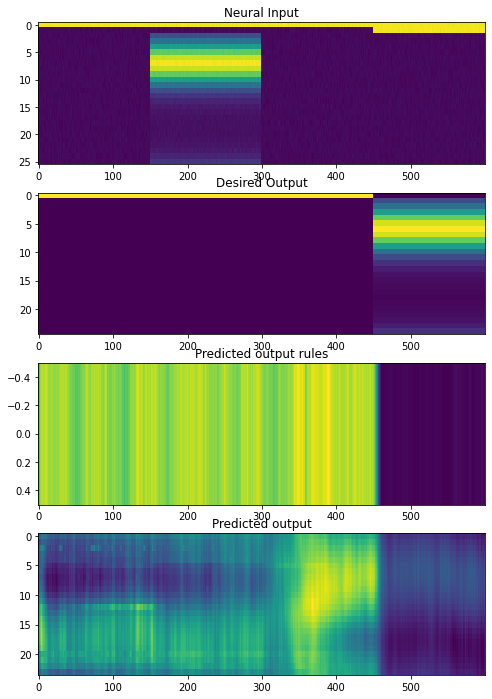

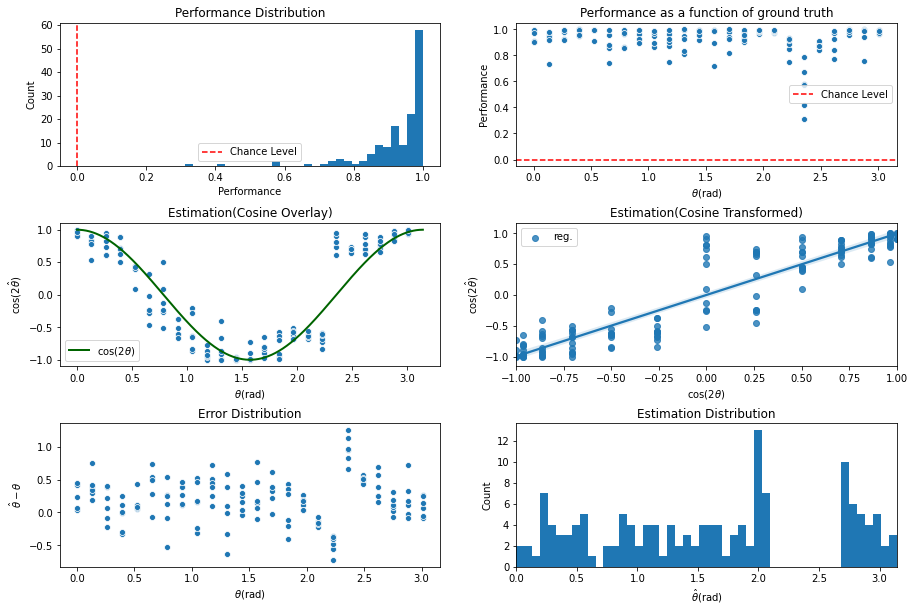

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter3900/assets

 Training performance: 
Iter. 3901 | Performance 0.9284 | Loss 0.2755 | Spike loss 2.9306
Testing performance: 
Iter. 3901 | Performance 0.9347 | Loss 0.2764 | Spike loss 2.9198

 Training performance: 
Iter. 3902 | Performance 0.9441 | Loss 0.2752 | Spike loss 2.8622
Testing performance: 
Iter. 3902 | Performance 0.9292 | Loss 0.2766 | Spike loss 2.9364

 Training performance: 
Iter. 3903 | Performance 0.9468 | Loss 0.2747 | Spike loss 2.8992
Testing performance: 
Iter. 3903 | Performance 0.9393 | Loss 0.2751 | Spike loss 2.9280

 Training performance: 
Iter. 3904 | Performance 0.9282 | Loss 0.2763 | Spike loss 2.9851
Testing performance: 
Iter. 3904 | Performance 0.9365 | Loss 0.2761 | Spike loss 2.9866

 Training performance: 
Iter. 3905 | Performance 0.9534 | Loss 0.2751 | Spike loss 3.1095
Testing performance: 
Iter. 3905 | Performance 0.9572 | Loss 0.2744 | Spike loss 2.9765

 Traini


 Training performance: 
Iter. 3947 | Performance 0.9198 | Loss 0.2769 | Spike loss 3.0226
Testing performance: 
Iter. 3947 | Performance 0.9216 | Loss 0.2771 | Spike loss 3.1267

 Training performance: 
Iter. 3948 | Performance 0.9262 | Loss 0.2765 | Spike loss 3.2274
Testing performance: 
Iter. 3948 | Performance 0.9315 | Loss 0.2768 | Spike loss 3.1483

 Training performance: 
Iter. 3949 | Performance 0.9503 | Loss 0.2759 | Spike loss 3.1641
Testing performance: 
Iter. 3949 | Performance 0.9347 | Loss 0.2762 | Spike loss 3.1577

 Training performance: 
Iter. 3950 | Performance 0.9419 | Loss 0.2760 | Spike loss 3.1189
Testing performance: 
Iter. 3950 | Performance 0.9343 | Loss 0.2773 | Spike loss 3.2182

 Training performance: 
Iter. 3951 | Performance 0.9374 | Loss 0.2770 | Spike loss 3.3659
Testing performance: 
Iter. 3951 | Performance 0.9313 | Loss 0.2768 | Spike loss 3.1517

 Training performance: 
Iter. 3952 | Performance 0.9453 | Loss 0.2750 | Spike loss 3.2309
Testing perfor


 Training performance: 
Iter. 3993 | Performance 0.9521 | Loss 0.2735 | Spike loss 3.0209
Testing performance: 
Iter. 3993 | Performance 0.9376 | Loss 0.2753 | Spike loss 3.0250

 Training performance: 
Iter. 3994 | Performance 0.9434 | Loss 0.2749 | Spike loss 2.9637
Testing performance: 
Iter. 3994 | Performance 0.9359 | Loss 0.2749 | Spike loss 3.0147

 Training performance: 
Iter. 3995 | Performance 0.9339 | Loss 0.2746 | Spike loss 3.0930
Testing performance: 
Iter. 3995 | Performance 0.9383 | Loss 0.2754 | Spike loss 3.0282

 Training performance: 
Iter. 3996 | Performance 0.9400 | Loss 0.2752 | Spike loss 3.0219
Testing performance: 
Iter. 3996 | Performance 0.9444 | Loss 0.2750 | Spike loss 3.0446

 Training performance: 
Iter. 3997 | Performance 0.9251 | Loss 0.2760 | Spike loss 3.1301
Testing performance: 
Iter. 3997 | Performance 0.9475 | Loss 0.2752 | Spike loss 3.0556

 Training performance: 
Iter. 3998 | Performance 0.9351 | Loss 0.2761 | Spike loss 3.0458
Testing perfor

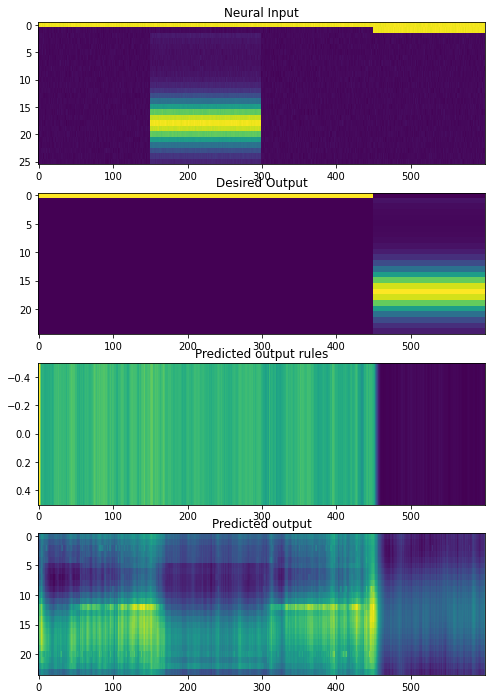

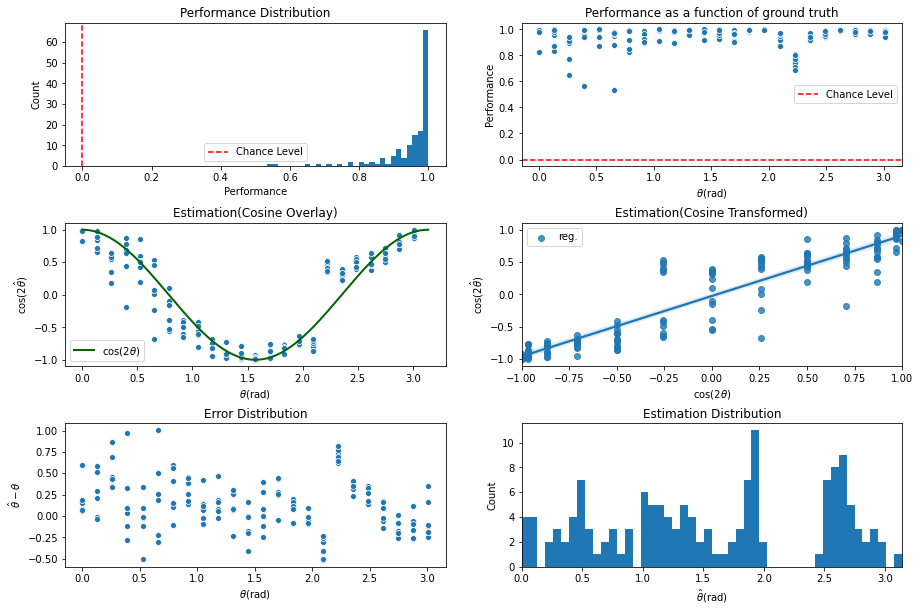

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter4000/assets

 Training performance: 
Iter. 4001 | Performance 0.9417 | Loss 0.2754 | Spike loss 2.9893
Testing performance: 
Iter. 4001 | Performance 0.9459 | Loss 0.2746 | Spike loss 3.0325

 Training performance: 
Iter. 4002 | Performance 0.9439 | Loss 0.2744 | Spike loss 2.9212
Testing performance: 
Iter. 4002 | Performance 0.9368 | Loss 0.2756 | Spike loss 3.0523

 Training performance: 
Iter. 4003 | Performance 0.9484 | Loss 0.2742 | Spike loss 3.0490
Testing performance: 
Iter. 4003 | Performance 0.9528 | Loss 0.2735 | Spike loss 3.0377

 Training performance: 
Iter. 4004 | Performance 0.9444 | Loss 0.2747 | Spike loss 2.9961
Testing performance: 
Iter. 4004 | Performance 0.9470 | Loss 0.2744 | Spike loss 3.0474

 Training performance: 
Iter. 4005 | Performance 0.9396 | Loss 0.2749 | Spike loss 2.9935
Testing performance: 
Iter. 4005 | Performance 0.9397 | Loss 0.2749 | Spike loss 3.0393

 Traini


 Training performance: 
Iter. 4047 | Performance 0.9457 | Loss 0.2739 | Spike loss 3.0380
Testing performance: 
Iter. 4047 | Performance 0.9490 | Loss 0.2745 | Spike loss 3.0544

 Training performance: 
Iter. 4048 | Performance 0.9467 | Loss 0.2745 | Spike loss 2.9780
Testing performance: 
Iter. 4048 | Performance 0.9481 | Loss 0.2737 | Spike loss 3.0680

 Training performance: 
Iter. 4049 | Performance 0.9465 | Loss 0.2746 | Spike loss 3.2501
Testing performance: 
Iter. 4049 | Performance 0.9522 | Loss 0.2743 | Spike loss 3.0751

 Training performance: 
Iter. 4050 | Performance 0.9560 | Loss 0.2742 | Spike loss 3.1814
Testing performance: 
Iter. 4050 | Performance 0.9613 | Loss 0.2739 | Spike loss 3.0697

 Training performance: 
Iter. 4051 | Performance 0.9549 | Loss 0.2742 | Spike loss 3.1492
Testing performance: 
Iter. 4051 | Performance 0.9556 | Loss 0.2740 | Spike loss 3.0673

 Training performance: 
Iter. 4052 | Performance 0.9474 | Loss 0.2751 | Spike loss 2.9928
Testing perfor


 Training performance: 
Iter. 4093 | Performance 0.9536 | Loss 0.2728 | Spike loss 2.8537
Testing performance: 
Iter. 4093 | Performance 0.9473 | Loss 0.2728 | Spike loss 2.9709

 Training performance: 
Iter. 4094 | Performance 0.9393 | Loss 0.2741 | Spike loss 3.0570
Testing performance: 
Iter. 4094 | Performance 0.9492 | Loss 0.2734 | Spike loss 2.9766

 Training performance: 
Iter. 4095 | Performance 0.9506 | Loss 0.2738 | Spike loss 2.9918
Testing performance: 
Iter. 4095 | Performance 0.9509 | Loss 0.2738 | Spike loss 2.9904

 Training performance: 
Iter. 4096 | Performance 0.9463 | Loss 0.2736 | Spike loss 2.9100
Testing performance: 
Iter. 4096 | Performance 0.9557 | Loss 0.2732 | Spike loss 2.9860

 Training performance: 
Iter. 4097 | Performance 0.9495 | Loss 0.2741 | Spike loss 3.0303
Testing performance: 
Iter. 4097 | Performance 0.9480 | Loss 0.2736 | Spike loss 2.9834

 Training performance: 
Iter. 4098 | Performance 0.9455 | Loss 0.2735 | Spike loss 3.0162
Testing perfor

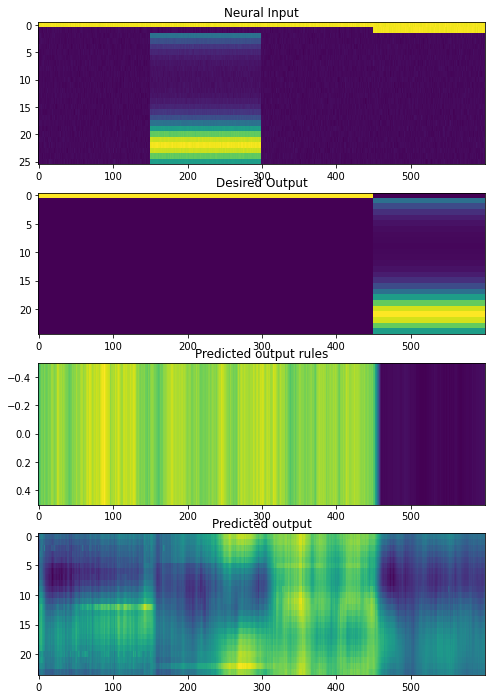

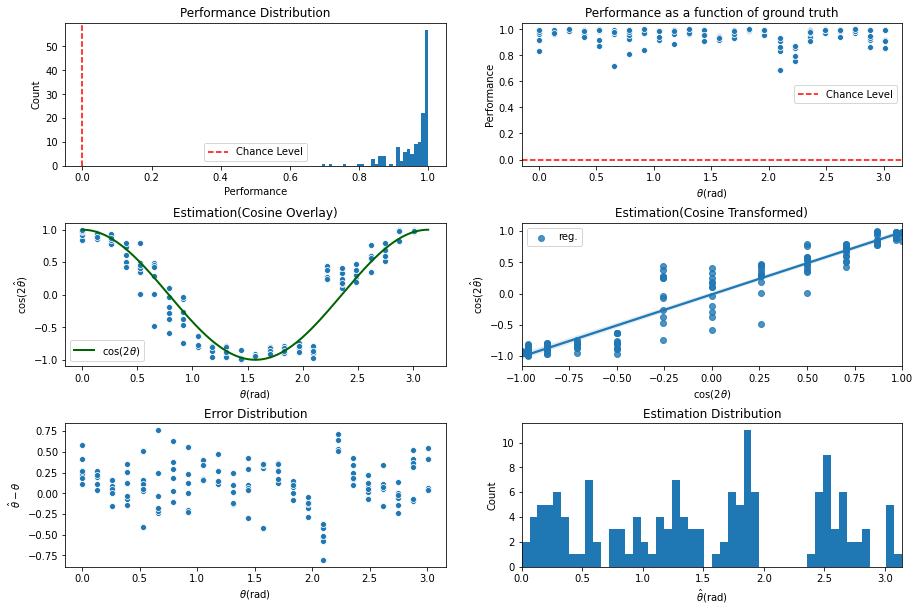

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter4100/assets

 Training performance: 
Iter. 4101 | Performance 0.9509 | Loss 0.2738 | Spike loss 2.8500
Testing performance: 
Iter. 4101 | Performance 0.9481 | Loss 0.2747 | Spike loss 3.0154

 Training performance: 
Iter. 4102 | Performance 0.9594 | Loss 0.2733 | Spike loss 3.0644
Testing performance: 
Iter. 4102 | Performance 0.9567 | Loss 0.2736 | Spike loss 2.9849

 Training performance: 
Iter. 4103 | Performance 0.9467 | Loss 0.2738 | Spike loss 3.0116
Testing performance: 
Iter. 4103 | Performance 0.9524 | Loss 0.2740 | Spike loss 3.0126

 Training performance: 
Iter. 4104 | Performance 0.9456 | Loss 0.2746 | Spike loss 3.0655
Testing performance: 
Iter. 4104 | Performance 0.9533 | Loss 0.2737 | Spike loss 3.0122

 Training performance: 
Iter. 4105 | Performance 0.9522 | Loss 0.2735 | Spike loss 3.1234
Testing performance: 
Iter. 4105 | Performance 0.9551 | Loss 0.2734 | Spike loss 3.0015

 Traini


 Training performance: 
Iter. 4147 | Performance 0.9474 | Loss 0.2728 | Spike loss 2.9858
Testing performance: 
Iter. 4147 | Performance 0.9601 | Loss 0.2730 | Spike loss 3.0130

 Training performance: 
Iter. 4148 | Performance 0.9640 | Loss 0.2716 | Spike loss 2.8100
Testing performance: 
Iter. 4148 | Performance 0.9543 | Loss 0.2738 | Spike loss 3.0035

 Training performance: 
Iter. 4149 | Performance 0.9658 | Loss 0.2722 | Spike loss 2.8337
Testing performance: 
Iter. 4149 | Performance 0.9568 | Loss 0.2740 | Spike loss 3.0510

 Training performance: 
Iter. 4150 | Performance 0.9530 | Loss 0.2741 | Spike loss 2.9072
Testing performance: 
Iter. 4150 | Performance 0.9549 | Loss 0.2733 | Spike loss 3.0033

 Training performance: 
Iter. 4151 | Performance 0.9517 | Loss 0.2740 | Spike loss 2.8687
Testing performance: 
Iter. 4151 | Performance 0.9580 | Loss 0.2734 | Spike loss 2.9702

 Training performance: 
Iter. 4152 | Performance 0.9633 | Loss 0.2728 | Spike loss 2.9922
Testing perfor


 Training performance: 
Iter. 4193 | Performance 0.9619 | Loss 0.2721 | Spike loss 2.9387
Testing performance: 
Iter. 4193 | Performance 0.9504 | Loss 0.2731 | Spike loss 2.9399

 Training performance: 
Iter. 4194 | Performance 0.9601 | Loss 0.2721 | Spike loss 2.9425
Testing performance: 
Iter. 4194 | Performance 0.9551 | Loss 0.2728 | Spike loss 2.9370

 Training performance: 
Iter. 4195 | Performance 0.9533 | Loss 0.2726 | Spike loss 2.8955
Testing performance: 
Iter. 4195 | Performance 0.9567 | Loss 0.2725 | Spike loss 2.9592

 Training performance: 
Iter. 4196 | Performance 0.9474 | Loss 0.2731 | Spike loss 2.8638
Testing performance: 
Iter. 4196 | Performance 0.9501 | Loss 0.2735 | Spike loss 2.9280

 Training performance: 
Iter. 4197 | Performance 0.9555 | Loss 0.2727 | Spike loss 2.9787
Testing performance: 
Iter. 4197 | Performance 0.9507 | Loss 0.2733 | Spike loss 2.9326

 Training performance: 
Iter. 4198 | Performance 0.9611 | Loss 0.2719 | Spike loss 2.8892
Testing perfor

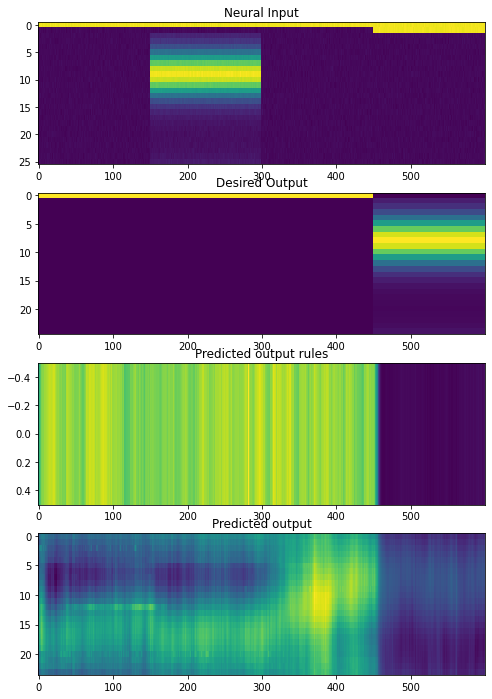

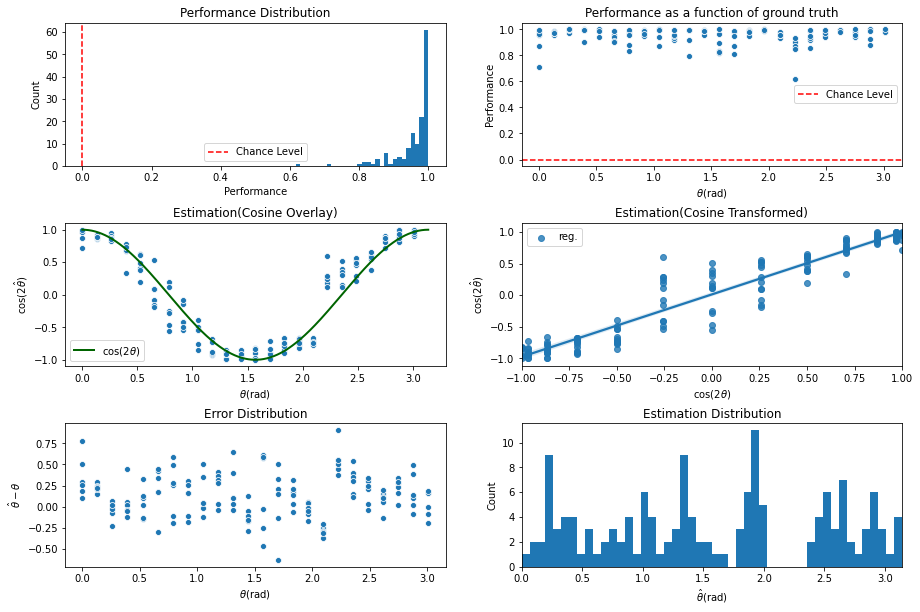

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter4200/assets

 Training performance: 
Iter. 4201 | Performance 0.9563 | Loss 0.2730 | Spike loss 2.9830
Testing performance: 
Iter. 4201 | Performance 0.9552 | Loss 0.2724 | Spike loss 2.9228

 Training performance: 
Iter. 4202 | Performance 0.9538 | Loss 0.2730 | Spike loss 2.8981
Testing performance: 
Iter. 4202 | Performance 0.9536 | Loss 0.2727 | Spike loss 2.9348

 Training performance: 
Iter. 4203 | Performance 0.9512 | Loss 0.2731 | Spike loss 2.8888
Testing performance: 
Iter. 4203 | Performance 0.9663 | Loss 0.2722 | Spike loss 2.9676

 Training performance: 
Iter. 4204 | Performance 0.9454 | Loss 0.2737 | Spike loss 2.9743
Testing performance: 
Iter. 4204 | Performance 0.9624 | Loss 0.2721 | Spike loss 2.9805

 Training performance: 
Iter. 4205 | Performance 0.9618 | Loss 0.2722 | Spike loss 2.9973
Testing performance: 
Iter. 4205 | Performance 0.9685 | Loss 0.2725 | Spike loss 3.0083

 Traini


 Training performance: 
Iter. 4247 | Performance 0.9629 | Loss 0.2716 | Spike loss 2.9278
Testing performance: 
Iter. 4247 | Performance 0.9562 | Loss 0.2722 | Spike loss 2.9842

 Training performance: 
Iter. 4248 | Performance 0.9602 | Loss 0.2713 | Spike loss 2.9335
Testing performance: 
Iter. 4248 | Performance 0.9550 | Loss 0.2722 | Spike loss 2.9853

 Training performance: 
Iter. 4249 | Performance 0.9606 | Loss 0.2721 | Spike loss 3.0918
Testing performance: 
Iter. 4249 | Performance 0.9626 | Loss 0.2729 | Spike loss 2.9969

 Training performance: 
Iter. 4250 | Performance 0.9658 | Loss 0.2729 | Spike loss 3.0194
Testing performance: 
Iter. 4250 | Performance 0.9649 | Loss 0.2729 | Spike loss 3.0126

 Training performance: 
Iter. 4251 | Performance 0.9571 | Loss 0.2728 | Spike loss 2.9293
Testing performance: 
Iter. 4251 | Performance 0.9537 | Loss 0.2719 | Spike loss 2.9768

 Training performance: 
Iter. 4252 | Performance 0.9596 | Loss 0.2717 | Spike loss 3.0516
Testing perfor


 Training performance: 
Iter. 4293 | Performance 0.9526 | Loss 0.2721 | Spike loss 2.9556
Testing performance: 
Iter. 4293 | Performance 0.9535 | Loss 0.2714 | Spike loss 2.9455

 Training performance: 
Iter. 4294 | Performance 0.9442 | Loss 0.2715 | Spike loss 2.9093
Testing performance: 
Iter. 4294 | Performance 0.9543 | Loss 0.2716 | Spike loss 2.9413

 Training performance: 
Iter. 4295 | Performance 0.9525 | Loss 0.2718 | Spike loss 2.9950
Testing performance: 
Iter. 4295 | Performance 0.9546 | Loss 0.2718 | Spike loss 2.9134

 Training performance: 
Iter. 4296 | Performance 0.9530 | Loss 0.2722 | Spike loss 2.8749
Testing performance: 
Iter. 4296 | Performance 0.9627 | Loss 0.2717 | Spike loss 2.9884

 Training performance: 
Iter. 4297 | Performance 0.9581 | Loss 0.2718 | Spike loss 2.9672
Testing performance: 
Iter. 4297 | Performance 0.9667 | Loss 0.2719 | Spike loss 2.9903

 Training performance: 
Iter. 4298 | Performance 0.9697 | Loss 0.2716 | Spike loss 2.9843
Testing perfor

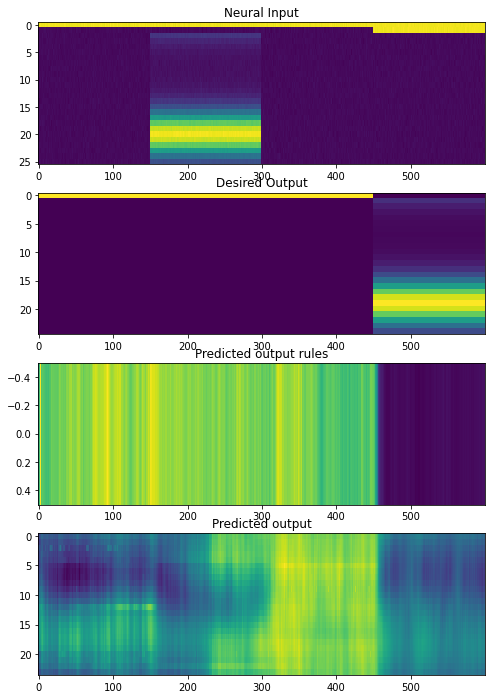

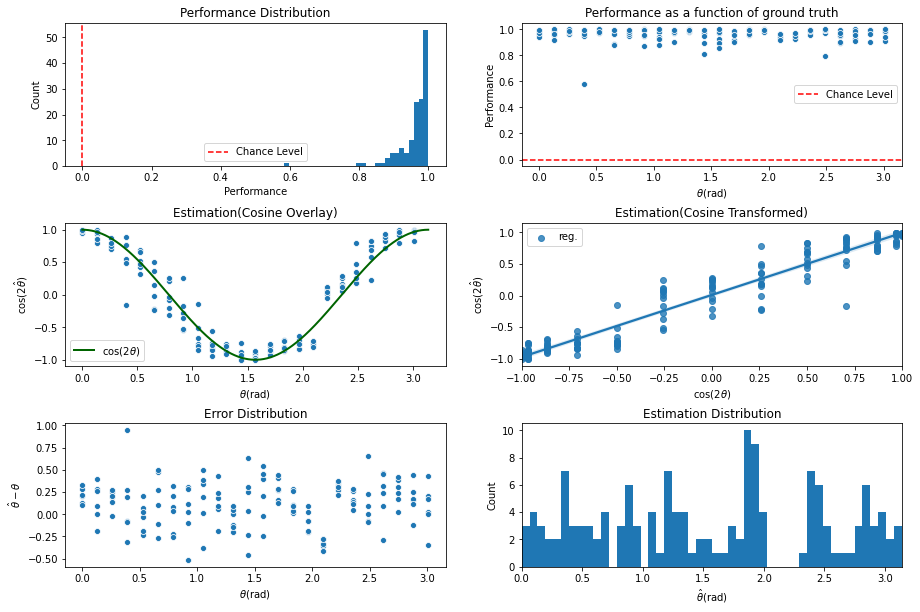

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter4300/assets

 Training performance: 
Iter. 4301 | Performance 0.9549 | Loss 0.2733 | Spike loss 2.8986
Testing performance: 
Iter. 4301 | Performance 0.9674 | Loss 0.2714 | Spike loss 2.9807

 Training performance: 
Iter. 4302 | Performance 0.9684 | Loss 0.2714 | Spike loss 3.0464
Testing performance: 
Iter. 4302 | Performance 0.9455 | Loss 0.2736 | Spike loss 2.9652

 Training performance: 
Iter. 4303 | Performance 0.9504 | Loss 0.2730 | Spike loss 2.7843
Testing performance: 
Iter. 4303 | Performance 0.9512 | Loss 0.2742 | Spike loss 2.9306

 Training performance: 
Iter. 4304 | Performance 0.9501 | Loss 0.2736 | Spike loss 2.9622
Testing performance: 
Iter. 4304 | Performance 0.9606 | Loss 0.2716 | Spike loss 2.9718

 Training performance: 
Iter. 4305 | Performance 0.9523 | Loss 0.2723 | Spike loss 2.9201
Testing performance: 
Iter. 4305 | Performance 0.9598 | Loss 0.2735 | Spike loss 2.9888

 Traini


 Training performance: 
Iter. 4347 | Performance 0.9669 | Loss 0.2737 | Spike loss 2.9513
Testing performance: 
Iter. 4347 | Performance 0.9681 | Loss 0.2747 | Spike loss 2.9753

 Training performance: 
Iter. 4348 | Performance 0.9626 | Loss 0.2744 | Spike loss 2.9842
Testing performance: 
Iter. 4348 | Performance 0.9662 | Loss 0.2721 | Spike loss 2.9854

 Training performance: 
Iter. 4349 | Performance 0.9654 | Loss 0.2716 | Spike loss 2.9813
Testing performance: 
Iter. 4349 | Performance 0.9693 | Loss 0.2724 | Spike loss 2.9483

 Training performance: 
Iter. 4350 | Performance 0.9716 | Loss 0.2717 | Spike loss 2.9037
Testing performance: 
Iter. 4350 | Performance 0.9639 | Loss 0.2733 | Spike loss 2.9632

 Training performance: 
Iter. 4351 | Performance 0.9580 | Loss 0.2735 | Spike loss 3.0145
Testing performance: 
Iter. 4351 | Performance 0.9564 | Loss 0.2722 | Spike loss 2.9565

 Training performance: 
Iter. 4352 | Performance 0.9553 | Loss 0.2724 | Spike loss 2.9208
Testing perfor


 Training performance: 
Iter. 4393 | Performance 0.9519 | Loss 0.2740 | Spike loss 2.8407
Testing performance: 
Iter. 4393 | Performance 0.9506 | Loss 0.2724 | Spike loss 2.8530

 Training performance: 
Iter. 4394 | Performance 0.9545 | Loss 0.2715 | Spike loss 2.7850
Testing performance: 
Iter. 4394 | Performance 0.9484 | Loss 0.2724 | Spike loss 2.8093

 Training performance: 
Iter. 4395 | Performance 0.9512 | Loss 0.2724 | Spike loss 2.9033
Testing performance: 
Iter. 4395 | Performance 0.9473 | Loss 0.2728 | Spike loss 2.8343

 Training performance: 
Iter. 4396 | Performance 0.9474 | Loss 0.2732 | Spike loss 2.7959
Testing performance: 
Iter. 4396 | Performance 0.9651 | Loss 0.2723 | Spike loss 2.8544

 Training performance: 
Iter. 4397 | Performance 0.9621 | Loss 0.2741 | Spike loss 2.9467
Testing performance: 
Iter. 4397 | Performance 0.9679 | Loss 0.2720 | Spike loss 2.8869

 Training performance: 
Iter. 4398 | Performance 0.9675 | Loss 0.2717 | Spike loss 2.8558
Testing perfor

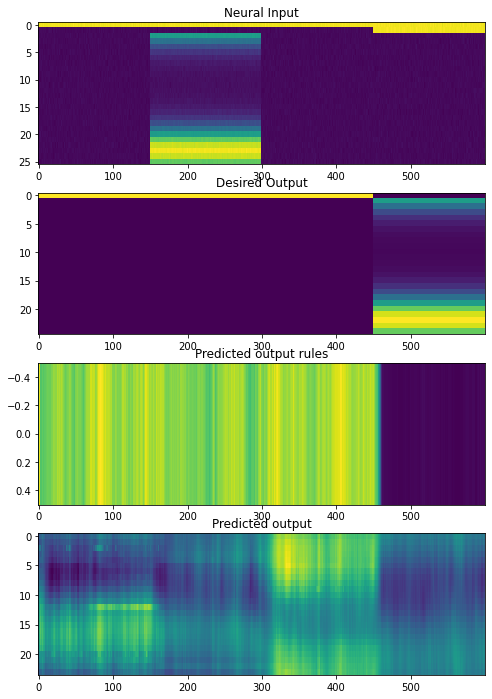

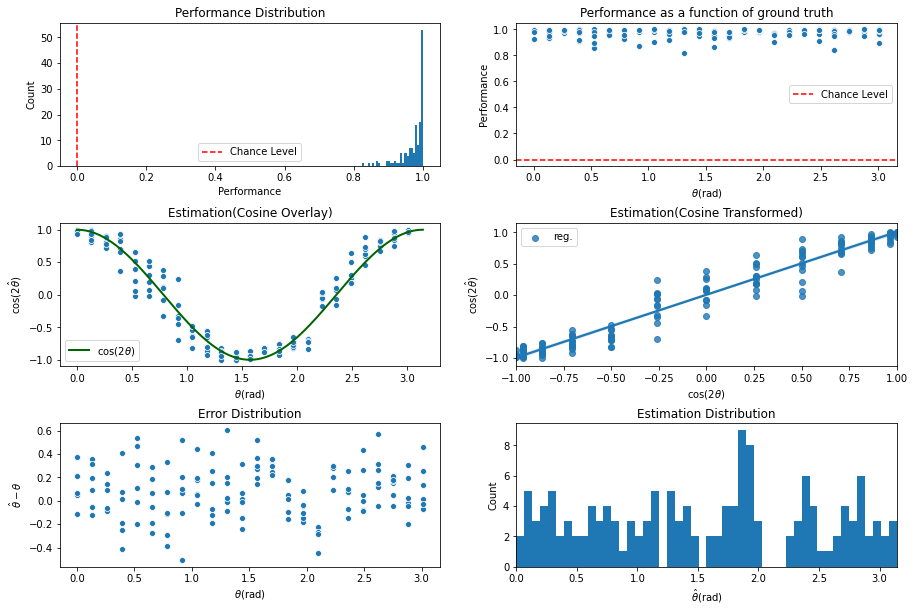

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter4400/assets

 Training performance: 
Iter. 4401 | Performance 0.9708 | Loss 0.2724 | Spike loss 2.7387
Testing performance: 
Iter. 4401 | Performance 0.9653 | Loss 0.2734 | Spike loss 2.8688

 Training performance: 
Iter. 4402 | Performance 0.9594 | Loss 0.2738 | Spike loss 2.9961
Testing performance: 
Iter. 4402 | Performance 0.9628 | Loss 0.2718 | Spike loss 2.9079

 Training performance: 
Iter. 4403 | Performance 0.9628 | Loss 0.2714 | Spike loss 2.9462
Testing performance: 
Iter. 4403 | Performance 0.9592 | Loss 0.2734 | Spike loss 2.9124

 Training performance: 
Iter. 4404 | Performance 0.9565 | Loss 0.2734 | Spike loss 2.8538
Testing performance: 
Iter. 4404 | Performance 0.9565 | Loss 0.2754 | Spike loss 2.9183

 Training performance: 
Iter. 4405 | Performance 0.9589 | Loss 0.2757 | Spike loss 2.9361
Testing performance: 
Iter. 4405 | Performance 0.9586 | Loss 0.2737 | Spike loss 2.8916

 Traini


 Training performance: 
Iter. 4447 | Performance 0.9445 | Loss 0.2748 | Spike loss 3.0616
Testing performance: 
Iter. 4447 | Performance 0.9399 | Loss 0.2755 | Spike loss 3.1015

 Training performance: 
Iter. 4448 | Performance 0.9552 | Loss 0.2742 | Spike loss 3.0187
Testing performance: 
Iter. 4448 | Performance 0.9453 | Loss 0.2735 | Spike loss 3.1120

 Training performance: 
Iter. 4449 | Performance 0.9488 | Loss 0.2732 | Spike loss 2.9830
Testing performance: 
Iter. 4449 | Performance 0.9511 | Loss 0.2733 | Spike loss 3.0950

 Training performance: 
Iter. 4450 | Performance 0.9509 | Loss 0.2732 | Spike loss 3.0400
Testing performance: 
Iter. 4450 | Performance 0.9515 | Loss 0.2740 | Spike loss 3.0360

 Training performance: 
Iter. 4451 | Performance 0.9658 | Loss 0.2731 | Spike loss 2.9477
Testing performance: 
Iter. 4451 | Performance 0.9483 | Loss 0.2724 | Spike loss 3.0431

 Training performance: 
Iter. 4452 | Performance 0.9646 | Loss 0.2718 | Spike loss 3.1869
Testing perfor


 Training performance: 
Iter. 4493 | Performance 0.9618 | Loss 0.2730 | Spike loss 2.9664
Testing performance: 
Iter. 4493 | Performance 0.9706 | Loss 0.2710 | Spike loss 2.9609

 Training performance: 
Iter. 4494 | Performance 0.9619 | Loss 0.2718 | Spike loss 2.8916
Testing performance: 
Iter. 4494 | Performance 0.9551 | Loss 0.2717 | Spike loss 2.9277

 Training performance: 
Iter. 4495 | Performance 0.9586 | Loss 0.2717 | Spike loss 2.9448
Testing performance: 
Iter. 4495 | Performance 0.9537 | Loss 0.2712 | Spike loss 2.9077

 Training performance: 
Iter. 4496 | Performance 0.9496 | Loss 0.2711 | Spike loss 2.8545
Testing performance: 
Iter. 4496 | Performance 0.9489 | Loss 0.2721 | Spike loss 2.8924

 Training performance: 
Iter. 4497 | Performance 0.9572 | Loss 0.2715 | Spike loss 2.8894
Testing performance: 
Iter. 4497 | Performance 0.9439 | Loss 0.2718 | Spike loss 2.8585

 Training performance: 
Iter. 4498 | Performance 0.9445 | Loss 0.2715 | Spike loss 2.9527
Testing perfor

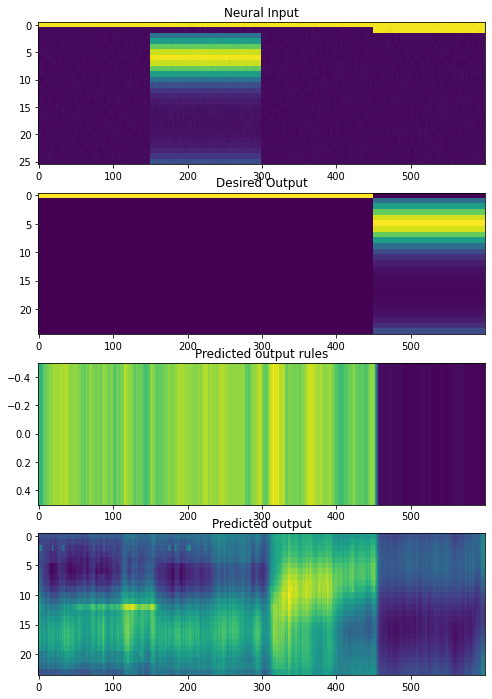

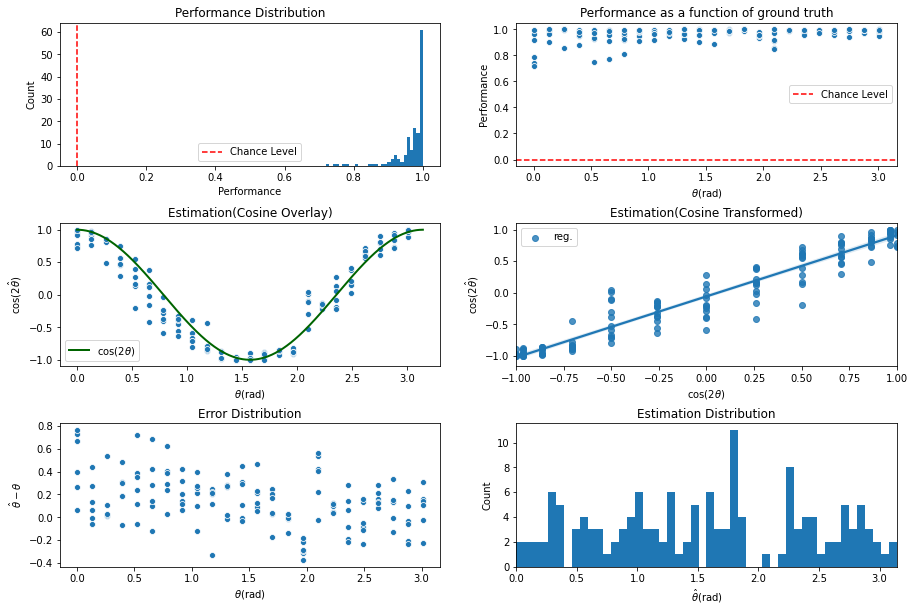

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter4500/assets

 Training performance: 
Iter. 4501 | Performance 0.9614 | Loss 0.2724 | Spike loss 2.8039
Testing performance: 
Iter. 4501 | Performance 0.9576 | Loss 0.2727 | Spike loss 2.8737

 Training performance: 
Iter. 4502 | Performance 0.9635 | Loss 0.2726 | Spike loss 2.8807
Testing performance: 
Iter. 4502 | Performance 0.9600 | Loss 0.2738 | Spike loss 2.8615

 Training performance: 
Iter. 4503 | Performance 0.9649 | Loss 0.2736 | Spike loss 2.8481
Testing performance: 
Iter. 4503 | Performance 0.9611 | Loss 0.2730 | Spike loss 2.8529

 Training performance: 
Iter. 4504 | Performance 0.9727 | Loss 0.2727 | Spike loss 2.9300
Testing performance: 
Iter. 4504 | Performance 0.9539 | Loss 0.2729 | Spike loss 2.8762

 Training performance: 
Iter. 4505 | Performance 0.9581 | Loss 0.2728 | Spike loss 2.9076
Testing performance: 
Iter. 4505 | Performance 0.9732 | Loss 0.2721 | Spike loss 2.9504

 Traini


 Training performance: 
Iter. 4547 | Performance 0.9684 | Loss 0.2721 | Spike loss 3.1851
Testing performance: 
Iter. 4547 | Performance 0.9678 | Loss 0.2739 | Spike loss 3.3974

 Training performance: 
Iter. 4548 | Performance 0.9662 | Loss 0.2733 | Spike loss 3.3359
Testing performance: 
Iter. 4548 | Performance 0.9747 | Loss 0.2735 | Spike loss 3.4714

 Training performance: 
Iter. 4549 | Performance 0.9637 | Loss 0.2750 | Spike loss 3.4123
Testing performance: 
Iter. 4549 | Performance 0.9466 | Loss 0.2765 | Spike loss 3.5713

 Training performance: 
Iter. 4550 | Performance 0.9292 | Loss 0.2781 | Spike loss 3.6462
Testing performance: 
Iter. 4550 | Performance 0.9628 | Loss 0.2753 | Spike loss 3.6818

 Training performance: 
Iter. 4551 | Performance 0.9558 | Loss 0.2755 | Spike loss 3.8593
Testing performance: 
Iter. 4551 | Performance 0.9545 | Loss 0.2771 | Spike loss 3.7386

 Training performance: 
Iter. 4552 | Performance 0.9577 | Loss 0.2762 | Spike loss 3.6713
Testing perfor


 Training performance: 
Iter. 4593 | Performance 0.9504 | Loss 0.2767 | Spike loss 3.7443
Testing performance: 
Iter. 4593 | Performance 0.9534 | Loss 0.2762 | Spike loss 3.5664

 Training performance: 
Iter. 4594 | Performance 0.9653 | Loss 0.2754 | Spike loss 3.6171
Testing performance: 
Iter. 4594 | Performance 0.9644 | Loss 0.2769 | Spike loss 3.6200

 Training performance: 
Iter. 4595 | Performance 0.9626 | Loss 0.2769 | Spike loss 3.5260
Testing performance: 
Iter. 4595 | Performance 0.9434 | Loss 0.2779 | Spike loss 3.6147

 Training performance: 
Iter. 4596 | Performance 0.9543 | Loss 0.2782 | Spike loss 3.5521
Testing performance: 
Iter. 4596 | Performance 0.9596 | Loss 0.2765 | Spike loss 3.6447

 Training performance: 
Iter. 4597 | Performance 0.9675 | Loss 0.2763 | Spike loss 3.8112
Testing performance: 
Iter. 4597 | Performance 0.9665 | Loss 0.2759 | Spike loss 3.6470

 Training performance: 
Iter. 4598 | Performance 0.9715 | Loss 0.2753 | Spike loss 3.5710
Testing perfor

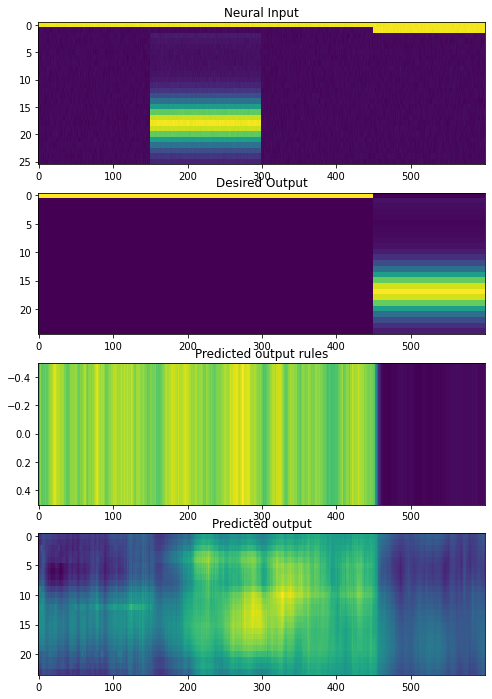

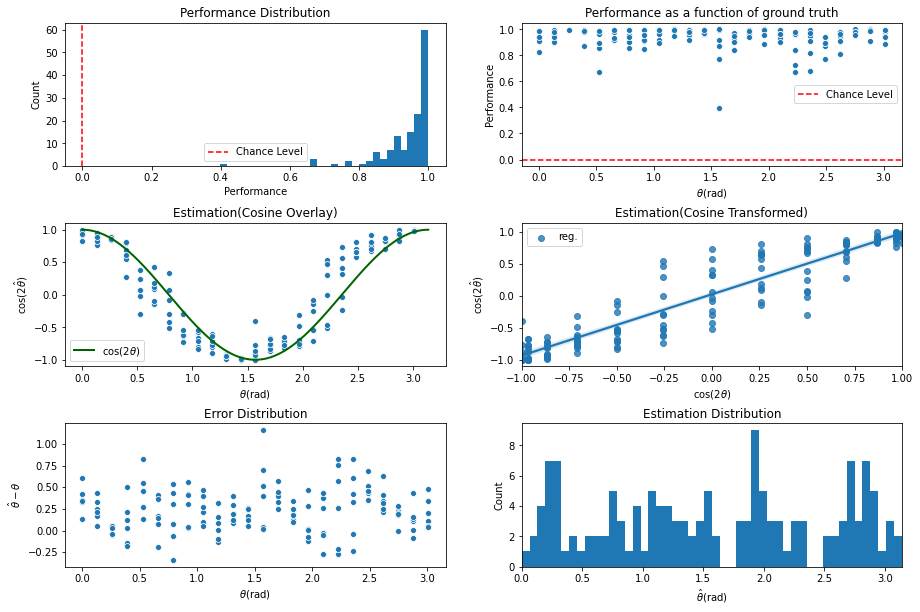

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter4600/assets

 Training performance: 
Iter. 4601 | Performance 0.9328 | Loss 0.2752 | Spike loss 3.4398
Testing performance: 
Iter. 4601 | Performance 0.9515 | Loss 0.2756 | Spike loss 3.5773

 Training performance: 
Iter. 4602 | Performance 0.9550 | Loss 0.2737 | Spike loss 3.2960
Testing performance: 
Iter. 4602 | Performance 0.9504 | Loss 0.2761 | Spike loss 3.6524

 Training performance: 
Iter. 4603 | Performance 0.9475 | Loss 0.2778 | Spike loss 3.7457
Testing performance: 
Iter. 4603 | Performance 0.9455 | Loss 0.2760 | Spike loss 3.6445

 Training performance: 
Iter. 4604 | Performance 0.9451 | Loss 0.2758 | Spike loss 3.5389
Testing performance: 
Iter. 4604 | Performance 0.9593 | Loss 0.2742 | Spike loss 3.6789

 Training performance: 
Iter. 4605 | Performance 0.9440 | Loss 0.2761 | Spike loss 3.5857
Testing performance: 
Iter. 4605 | Performance 0.9539 | Loss 0.2755 | Spike loss 3.6312

 Traini


 Training performance: 
Iter. 4647 | Performance 0.9229 | Loss 0.2826 | Spike loss 4.2809
Testing performance: 
Iter. 4647 | Performance 0.9457 | Loss 0.2798 | Spike loss 4.0780

 Training performance: 
Iter. 4648 | Performance 0.9433 | Loss 0.2789 | Spike loss 3.8572
Testing performance: 
Iter. 4648 | Performance 0.9266 | Loss 0.2810 | Spike loss 3.9961

 Training performance: 
Iter. 4649 | Performance 0.9515 | Loss 0.2784 | Spike loss 4.0022
Testing performance: 
Iter. 4649 | Performance 0.9415 | Loss 0.2781 | Spike loss 3.9764

 Training performance: 
Iter. 4650 | Performance 0.9426 | Loss 0.2771 | Spike loss 3.9412
Testing performance: 
Iter. 4650 | Performance 0.9413 | Loss 0.2778 | Spike loss 3.9024

 Training performance: 
Iter. 4651 | Performance 0.9371 | Loss 0.2771 | Spike loss 3.7755
Testing performance: 
Iter. 4651 | Performance 0.9298 | Loss 0.2788 | Spike loss 3.8164

 Training performance: 
Iter. 4652 | Performance 0.9144 | Loss 0.2815 | Spike loss 3.9061
Testing perfor


 Training performance: 
Iter. 4693 | Performance 0.9681 | Loss 0.2735 | Spike loss 3.1609
Testing performance: 
Iter. 4693 | Performance 0.9609 | Loss 0.2740 | Spike loss 3.0450

 Training performance: 
Iter. 4694 | Performance 0.9600 | Loss 0.2732 | Spike loss 2.9476
Testing performance: 
Iter. 4694 | Performance 0.9638 | Loss 0.2736 | Spike loss 3.0533

 Training performance: 
Iter. 4695 | Performance 0.9606 | Loss 0.2745 | Spike loss 2.9372
Testing performance: 
Iter. 4695 | Performance 0.9617 | Loss 0.2741 | Spike loss 3.0482

 Training performance: 
Iter. 4696 | Performance 0.9605 | Loss 0.2733 | Spike loss 2.9927
Testing performance: 
Iter. 4696 | Performance 0.9643 | Loss 0.2725 | Spike loss 3.0220

 Training performance: 
Iter. 4697 | Performance 0.9614 | Loss 0.2735 | Spike loss 3.1088
Testing performance: 
Iter. 4697 | Performance 0.9619 | Loss 0.2743 | Spike loss 3.0104

 Training performance: 
Iter. 4698 | Performance 0.9509 | Loss 0.2740 | Spike loss 2.9337
Testing perfor

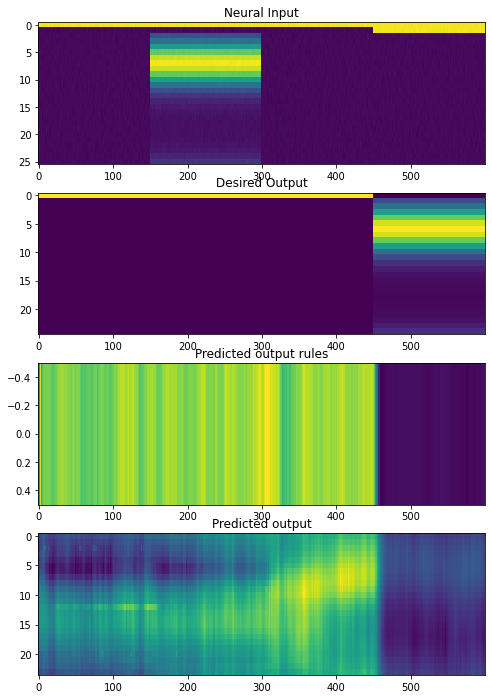

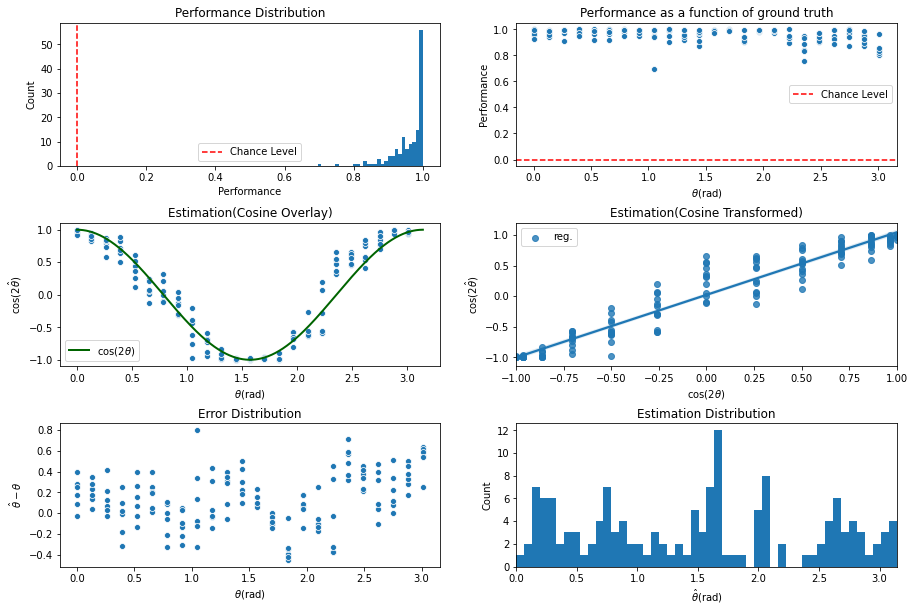

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter4700/assets

 Training performance: 
Iter. 4701 | Performance 0.9508 | Loss 0.2737 | Spike loss 2.9162
Testing performance: 
Iter. 4701 | Performance 0.9506 | Loss 0.2737 | Spike loss 2.9486

 Training performance: 
Iter. 4702 | Performance 0.9533 | Loss 0.2728 | Spike loss 2.9005
Testing performance: 
Iter. 4702 | Performance 0.9503 | Loss 0.2735 | Spike loss 2.9202

 Training performance: 
Iter. 4703 | Performance 0.9551 | Loss 0.2730 | Spike loss 2.8610
Testing performance: 
Iter. 4703 | Performance 0.9531 | Loss 0.2736 | Spike loss 2.9286

 Training performance: 
Iter. 4704 | Performance 0.9578 | Loss 0.2736 | Spike loss 2.8925
Testing performance: 
Iter. 4704 | Performance 0.9538 | Loss 0.2728 | Spike loss 2.9099

 Training performance: 
Iter. 4705 | Performance 0.9605 | Loss 0.2726 | Spike loss 2.9387
Testing performance: 
Iter. 4705 | Performance 0.9560 | Loss 0.2735 | Spike loss 2.9387

 Traini


 Training performance: 
Iter. 4747 | Performance 0.9564 | Loss 0.2776 | Spike loss 3.1185
Testing performance: 
Iter. 4747 | Performance 0.9560 | Loss 0.2742 | Spike loss 3.1147

 Training performance: 
Iter. 4748 | Performance 0.9463 | Loss 0.2747 | Spike loss 3.1121
Testing performance: 
Iter. 4748 | Performance 0.9484 | Loss 0.2735 | Spike loss 3.0621

 Training performance: 
Iter. 4749 | Performance 0.9613 | Loss 0.2730 | Spike loss 3.0178
Testing performance: 
Iter. 4749 | Performance 0.9363 | Loss 0.2765 | Spike loss 3.1057

 Training performance: 
Iter. 4750 | Performance 0.9535 | Loss 0.2752 | Spike loss 3.0997
Testing performance: 
Iter. 4750 | Performance 0.9639 | Loss 0.2724 | Spike loss 3.0906

 Training performance: 
Iter. 4751 | Performance 0.9687 | Loss 0.2722 | Spike loss 3.0997
Testing performance: 
Iter. 4751 | Performance 0.9574 | Loss 0.2717 | Spike loss 3.0712

 Training performance: 
Iter. 4752 | Performance 0.9593 | Loss 0.2714 | Spike loss 3.0680
Testing perfor


 Training performance: 
Iter. 4793 | Performance 0.9649 | Loss 0.2713 | Spike loss 2.9533
Testing performance: 
Iter. 4793 | Performance 0.9606 | Loss 0.2712 | Spike loss 2.9727

 Training performance: 
Iter. 4794 | Performance 0.9554 | Loss 0.2715 | Spike loss 2.8568
Testing performance: 
Iter. 4794 | Performance 0.9538 | Loss 0.2715 | Spike loss 2.9996

 Training performance: 
Iter. 4795 | Performance 0.9612 | Loss 0.2708 | Spike loss 2.9600
Testing performance: 
Iter. 4795 | Performance 0.9681 | Loss 0.2703 | Spike loss 2.9939

 Training performance: 
Iter. 4796 | Performance 0.9651 | Loss 0.2714 | Spike loss 3.1358
Testing performance: 
Iter. 4796 | Performance 0.9710 | Loss 0.2714 | Spike loss 2.9785

 Training performance: 
Iter. 4797 | Performance 0.9566 | Loss 0.2711 | Spike loss 2.8468
Testing performance: 
Iter. 4797 | Performance 0.9673 | Loss 0.2710 | Spike loss 3.0053

 Training performance: 
Iter. 4798 | Performance 0.9679 | Loss 0.2698 | Spike loss 2.8268
Testing perfor

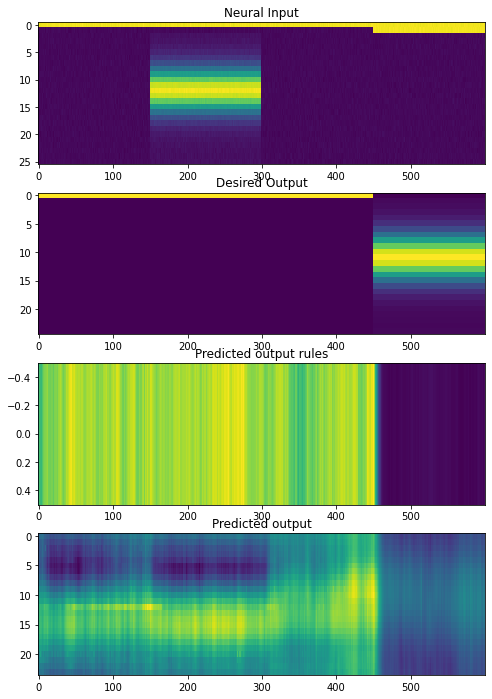

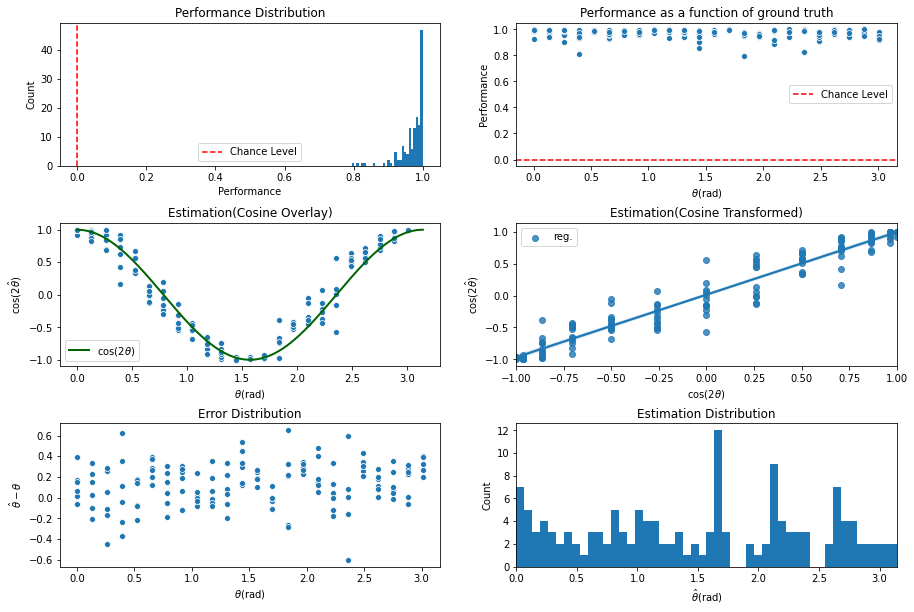

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter4800/assets

 Training performance: 
Iter. 4801 | Performance 0.9707 | Loss 0.2698 | Spike loss 2.8389
Testing performance: 
Iter. 4801 | Performance 0.9674 | Loss 0.2703 | Spike loss 3.0009

 Training performance: 
Iter. 4802 | Performance 0.9677 | Loss 0.2701 | Spike loss 2.8845
Testing performance: 
Iter. 4802 | Performance 0.9587 | Loss 0.2718 | Spike loss 3.0070

 Training performance: 
Iter. 4803 | Performance 0.9707 | Loss 0.2707 | Spike loss 2.9930
Testing performance: 
Iter. 4803 | Performance 0.9636 | Loss 0.2711 | Spike loss 3.0119

 Training performance: 
Iter. 4804 | Performance 0.9659 | Loss 0.2705 | Spike loss 3.0237
Testing performance: 
Iter. 4804 | Performance 0.9694 | Loss 0.2703 | Spike loss 3.0427

 Training performance: 
Iter. 4805 | Performance 0.9683 | Loss 0.2703 | Spike loss 2.9360
Testing performance: 
Iter. 4805 | Performance 0.9615 | Loss 0.2707 | Spike loss 3.0254

 Traini


 Training performance: 
Iter. 4847 | Performance 0.9343 | Loss 0.2751 | Spike loss 3.4866
Testing performance: 
Iter. 4847 | Performance 0.9148 | Loss 0.2759 | Spike loss 3.5144

 Training performance: 
Iter. 4848 | Performance 0.9442 | Loss 0.2736 | Spike loss 3.6501
Testing performance: 
Iter. 4848 | Performance 0.9402 | Loss 0.2738 | Spike loss 3.4634

 Training performance: 
Iter. 4849 | Performance 0.9366 | Loss 0.2746 | Spike loss 3.6607
Testing performance: 
Iter. 4849 | Performance 0.9473 | Loss 0.2730 | Spike loss 3.5154

 Training performance: 
Iter. 4850 | Performance 0.9317 | Loss 0.2737 | Spike loss 3.3357
Testing performance: 
Iter. 4850 | Performance 0.9540 | Loss 0.2720 | Spike loss 3.5150

 Training performance: 
Iter. 4851 | Performance 0.9473 | Loss 0.2730 | Spike loss 3.3716
Testing performance: 
Iter. 4851 | Performance 0.9578 | Loss 0.2728 | Spike loss 3.5012

 Training performance: 
Iter. 4852 | Performance 0.9502 | Loss 0.2731 | Spike loss 3.4815
Testing perfor


 Training performance: 
Iter. 4893 | Performance 0.9718 | Loss 0.2718 | Spike loss 3.4724
Testing performance: 
Iter. 4893 | Performance 0.9710 | Loss 0.2718 | Spike loss 3.4269

 Training performance: 
Iter. 4894 | Performance 0.9577 | Loss 0.2721 | Spike loss 3.2812
Testing performance: 
Iter. 4894 | Performance 0.9709 | Loss 0.2721 | Spike loss 3.4410

 Training performance: 
Iter. 4895 | Performance 0.9634 | Loss 0.2715 | Spike loss 3.2825
Testing performance: 
Iter. 4895 | Performance 0.9694 | Loss 0.2720 | Spike loss 3.4471

 Training performance: 
Iter. 4896 | Performance 0.9649 | Loss 0.2726 | Spike loss 3.5203
Testing performance: 
Iter. 4896 | Performance 0.9711 | Loss 0.2716 | Spike loss 3.4485

 Training performance: 
Iter. 4897 | Performance 0.9681 | Loss 0.2720 | Spike loss 3.3176
Testing performance: 
Iter. 4897 | Performance 0.9636 | Loss 0.2722 | Spike loss 3.4489

 Training performance: 
Iter. 4898 | Performance 0.9652 | Loss 0.2714 | Spike loss 3.3998
Testing perfor

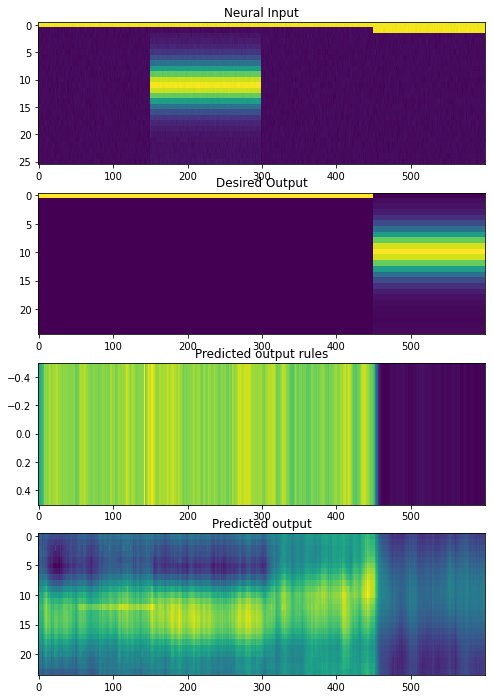

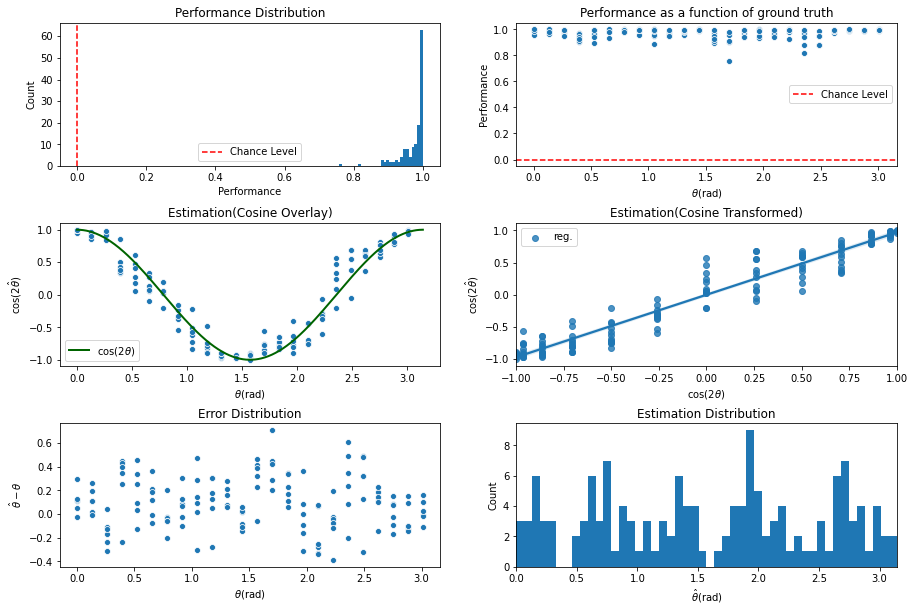

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter4900/assets

 Training performance: 
Iter. 4901 | Performance 0.9652 | Loss 0.2720 | Spike loss 3.3629
Testing performance: 
Iter. 4901 | Performance 0.9668 | Loss 0.2724 | Spike loss 3.4504

 Training performance: 
Iter. 4902 | Performance 0.9662 | Loss 0.2713 | Spike loss 3.4424
Testing performance: 
Iter. 4902 | Performance 0.9602 | Loss 0.2723 | Spike loss 3.4976

 Training performance: 
Iter. 4903 | Performance 0.9566 | Loss 0.2722 | Spike loss 3.2334
Testing performance: 
Iter. 4903 | Performance 0.9691 | Loss 0.2715 | Spike loss 3.4877

 Training performance: 
Iter. 4904 | Performance 0.9721 | Loss 0.2705 | Spike loss 3.3465
Testing performance: 
Iter. 4904 | Performance 0.9594 | Loss 0.2726 | Spike loss 3.4485

 Training performance: 
Iter. 4905 | Performance 0.9721 | Loss 0.2713 | Spike loss 3.4306
Testing performance: 
Iter. 4905 | Performance 0.9600 | Loss 0.2724 | Spike loss 3.4772

 Traini


 Training performance: 
Iter. 4947 | Performance 0.9627 | Loss 0.2702 | Spike loss 3.0511
Testing performance: 
Iter. 4947 | Performance 0.9528 | Loss 0.2711 | Spike loss 3.0527

 Training performance: 
Iter. 4948 | Performance 0.9633 | Loss 0.2702 | Spike loss 2.8780
Testing performance: 
Iter. 4948 | Performance 0.9588 | Loss 0.2709 | Spike loss 3.0235

 Training performance: 
Iter. 4949 | Performance 0.9531 | Loss 0.2715 | Spike loss 3.1358
Testing performance: 
Iter. 4949 | Performance 0.9583 | Loss 0.2704 | Spike loss 3.0241

 Training performance: 
Iter. 4950 | Performance 0.9579 | Loss 0.2702 | Spike loss 3.0369
Testing performance: 
Iter. 4950 | Performance 0.9440 | Loss 0.2724 | Spike loss 2.9823

 Training performance: 
Iter. 4951 | Performance 0.9593 | Loss 0.2703 | Spike loss 2.9890
Testing performance: 
Iter. 4951 | Performance 0.9637 | Loss 0.2709 | Spike loss 2.9864

 Training performance: 
Iter. 4952 | Performance 0.9533 | Loss 0.2711 | Spike loss 2.9358
Testing perfor


 Training performance: 
Iter. 4993 | Performance 0.9740 | Loss 0.2694 | Spike loss 2.9318
Testing performance: 
Iter. 4993 | Performance 0.9702 | Loss 0.2712 | Spike loss 2.9502

 Training performance: 
Iter. 4994 | Performance 0.9725 | Loss 0.2701 | Spike loss 2.8489
Testing performance: 
Iter. 4994 | Performance 0.9711 | Loss 0.2700 | Spike loss 2.9357

 Training performance: 
Iter. 4995 | Performance 0.9746 | Loss 0.2705 | Spike loss 2.8381
Testing performance: 
Iter. 4995 | Performance 0.9671 | Loss 0.2710 | Spike loss 2.9618

 Training performance: 
Iter. 4996 | Performance 0.9708 | Loss 0.2702 | Spike loss 3.0286
Testing performance: 
Iter. 4996 | Performance 0.9734 | Loss 0.2705 | Spike loss 2.9473

 Training performance: 
Iter. 4997 | Performance 0.9697 | Loss 0.2701 | Spike loss 2.8759
Testing performance: 
Iter. 4997 | Performance 0.9626 | Loss 0.2701 | Spike loss 2.9195

 Training performance: 
Iter. 4998 | Performance 0.9679 | Loss 0.2693 | Spike loss 2.9650
Testing perfor

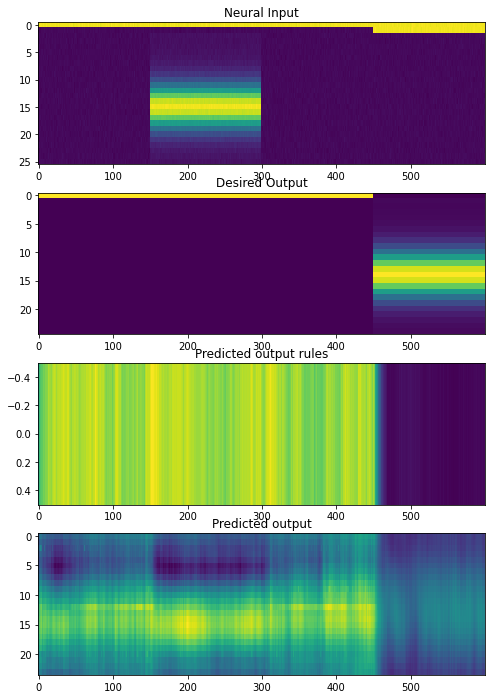

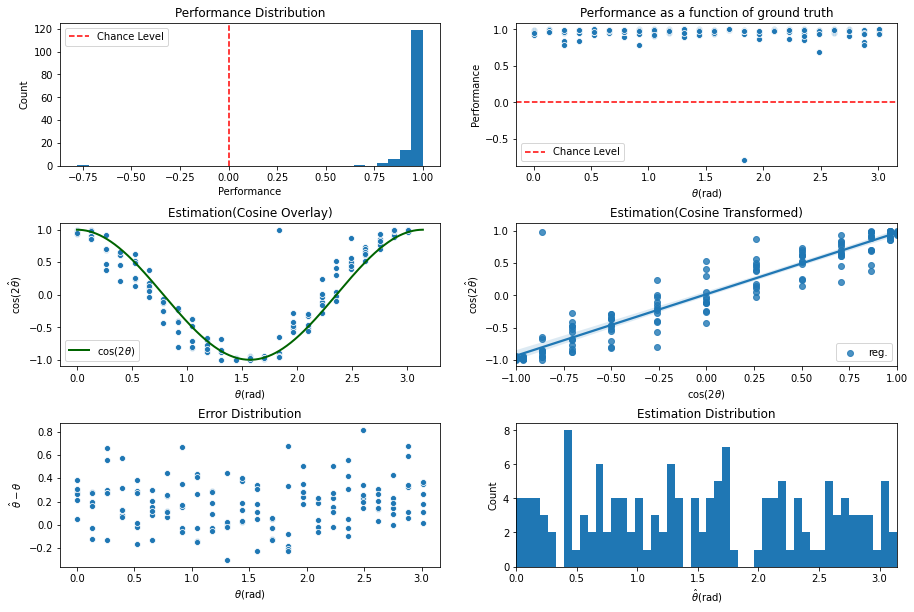

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622_24ori/cont_iter5000/assets

 Training performance: 
Iter. 5001 | Performance 0.9635 | Loss 0.2701 | Spike loss 2.8399
Testing performance: 
Iter. 5001 | Performance 0.9654 | Loss 0.2699 | Spike loss 2.9071

 Training performance: 
Iter. 5002 | Performance 0.9596 | Loss 0.2701 | Spike loss 2.9064
Testing performance: 
Iter. 5002 | Performance 0.9641 | Loss 0.2707 | Spike loss 2.9309

 Training performance: 
Iter. 5003 | Performance 0.9600 | Loss 0.2713 | Spike loss 2.9225
Testing performance: 
Iter. 5003 | Performance 0.9677 | Loss 0.2702 | Spike loss 2.9355

 Training performance: 
Iter. 5004 | Performance 0.9758 | Loss 0.2691 | Spike loss 2.9625
Testing performance: 
Iter. 5004 | Performance 0.9621 | Loss 0.2704 | Spike loss 2.9201

 Training performance: 
Iter. 5005 | Performance 0.9688 | Loss 0.2701 | Spike loss 2.9675
Testing performance: 
Iter. 5005 | Performance 0.9677 | Loss 0.2701 | Spike loss 2.9148

 Traini

KeyboardInterrupt: 

In [9]:
###### Train network ######
model_dir = "../experiments/naturalprior/200622_24ori/"
os.makedirs(model_dir, exist_ok=True)

N_iter = 10000
N_save = 100  # save model every N_save iterations

# define model
hp = utils_train.hp
hp['learning_rate'] = 5e-3
model = Model(hp=hp)

alllosses =[]
performance_train = {'perf': [], 'loss': [], 'perf_loss': [], 'spike_loss': []}
performance_test = {'perf': [], 'loss': [], 'perf_loss': [], 'spike_loss': []}

for iter_n in range(N_iter+1):
    ################ train on testing set ################
    train_data = utils_train.tensorize_trial(stim_test.generate_trial())
    Y, Loss = model(train_data, hp)

    performance_train = utils_train.append_model_performance(performance_train,
                                                             train_data, Y, Loss, par_test)
    # append performance on testing set
    test_data = utils_train.tensorize_trial(stim_test.generate_trial(balanced=True))
    test_Y, test_loss = model.return_losses(test_data['neural_input'], test_data['desired_output'],
                                            test_data['mask'], hp)
    performance_test = utils_train.append_model_performance(performance_test,
                                                            test_data, test_Y, test_loss, par_test)
    
    print('\n Training performance: ')
    utils_train.print_results(performance_train, iter_n)
    print('Testing performance: ')
    utils_train.print_results(performance_test, iter_n)
    if (iter_n % N_save) == 0:
        # predict from testing set
        plot_rnn_output(par_test, test_data, test_Y, stim_test, TEST_TRIAL=None)

        test_Y = utils_analysis.softmax_pred_output(test_Y) # change to softmax
        ground_truth, estim_mean, raw_error, beh_perf = utils_analysis.behavior_summary(test_data, test_Y, par=par_test)
        utils_analysis.behavior_figure(ground_truth, estim_mean, raw_error, beh_perf)

        tf.saved_model.save(model, os.path.join(model_dir, "cont_iter" + str(iter_n)))
        
    if iter_n > 20 and np.sum(performance_test['perf'][-20] > 0.95) > 18:
        print('Good performance achieved... saving final model')
        break

# save final model
tf.saved_model.save(model, os.path.join(model_dir, "cont_iter" + str(iter_n)))

In [ ]:
#performance_train = {'perf': [], 'loss': [], 'perf_loss': [], 'spike_loss': []}
#performance_test = {'perf': [], 'loss': [], 'perf_loss': [], 'spike_loss': []}
plt.figure()
plt.plot(np.arange(100,len(performance_train['perf'])), 
         performance_train['perf'][100:], label='Train')
plt.plot(np.arange(100,len(performance_test['perf'])), 
         performance_test['perf'][100:], label='Test (balanced)')
plt.ylabel('Performance')
plt.xlabel('Iterations')
plt.legend()
plt.show()

plt.figure()
plt.plot(np.arange(100,len(performance_train['perf'])),
         performance_train['loss'][100:], label='Train')
plt.plot(np.arange(100,len(performance_test['perf'])),
         performance_test['loss'][100:], label='Test (balanced)')
plt.ylabel('Loss')
plt.xlabel('Iterations')
plt.yscale('log')
plt.legend()
plt.show()

### Train on 1000 orientations


 Training performance: 
Iter.    0 | Performance -0.0453 | Loss 16113.8984 | Spike loss 97.7002
Testing performance: 
Iter.    0 | Performance -0.0000 | Loss 7523.4487 | Spike loss 67.0590


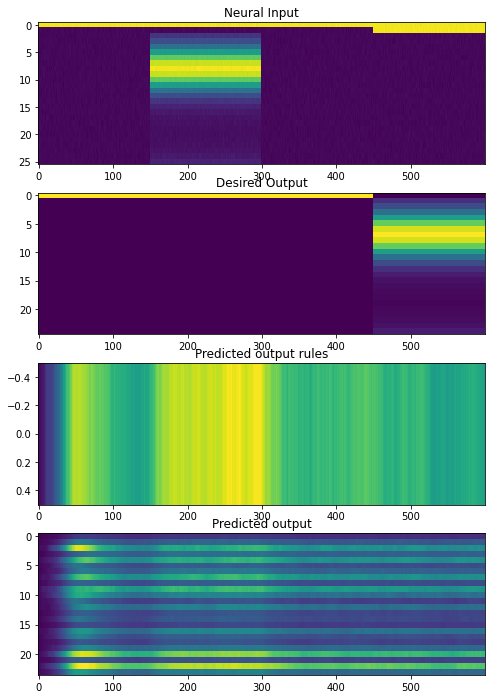

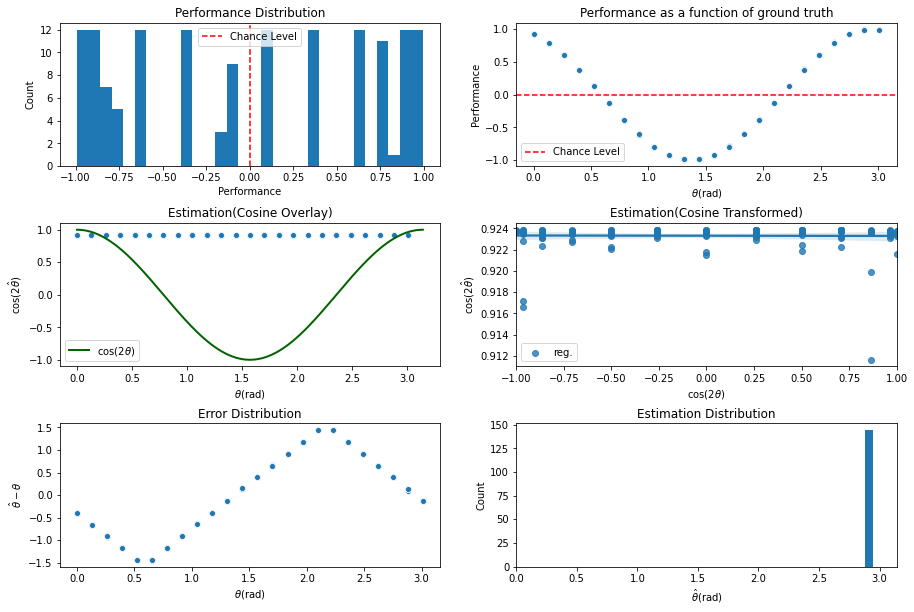

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter0/assets

 Training performance: 
Iter.    1 | Performance -0.1260 | Loss 7590.0400 | Spike loss 67.0113
Testing performance: 
Iter.    1 | Performance 0.0005 | Loss 3022.3286 | Spike loss 44.3294

 Training performance: 
Iter.    2 | Performance -0.0252 | Loss 3059.6035 | Spike loss 44.5764
Testing performance: 
Iter.    2 | Performance 0.0035 | Loss 1192.5198 | Spike loss 26.4673

 Training performance: 
Iter.    3 | Performance -0.0173 | Loss 1194.4647 | Spike loss 26.5318
Testing performance: 
Iter.    3 | Performance 0.0004 | Loss 456.2162 | Spike loss 14.5814

 Training performance: 
Iter.    4 | Performance 0.1295 | Loss 453.8580 | Spike loss 14.6092
Testing performance: 
Iter.    4 | Performance -0.0252 | Loss 110.5160 | Spike loss 6.3313

 Training performance: 
Iter.    5 | Performance 0.0244 | Loss 110.1191 | Spike loss 6.1729
Testing performance: 
Iter.    5 | Performance -0.0296 | Loss 28.4762 |


 Training performance: 
Iter.   46 | Performance 0.0657 | Loss 0.8442 | Spike loss 1.1373
Testing performance: 
Iter.   46 | Performance -0.0296 | Loss 0.8308 | Spike loss 1.1712

 Training performance: 
Iter.   47 | Performance -0.0219 | Loss 0.8268 | Spike loss 1.1664
Testing performance: 
Iter.   47 | Performance 0.0157 | Loss 0.8020 | Spike loss 1.2035

 Training performance: 
Iter.   48 | Performance 0.0358 | Loss 0.8066 | Spike loss 1.2116
Testing performance: 
Iter.   48 | Performance 0.0482 | Loss 0.7851 | Spike loss 1.2462

 Training performance: 
Iter.   49 | Performance 0.1241 | Loss 0.7892 | Spike loss 1.2364
Testing performance: 
Iter.   49 | Performance -0.0456 | Loss 0.7738 | Spike loss 1.2808

 Training performance: 
Iter.   50 | Performance 0.0069 | Loss 0.7643 | Spike loss 1.2843
Testing performance: 
Iter.   50 | Performance 0.0406 | Loss 0.7551 | Spike loss 1.3302

 Training performance: 
Iter.   51 | Performance 0.0933 | Loss 0.7632 | Spike loss 1.3194
Testing per


 Training performance: 
Iter.   92 | Performance 0.0371 | Loss 0.4839 | Spike loss 1.8524
Testing performance: 
Iter.   92 | Performance 0.0061 | Loss 0.4776 | Spike loss 1.8428

 Training performance: 
Iter.   93 | Performance 0.0656 | Loss 0.4818 | Spike loss 1.8345
Testing performance: 
Iter.   93 | Performance -0.0221 | Loss 0.4764 | Spike loss 1.8470

 Training performance: 
Iter.   94 | Performance -0.0360 | Loss 0.4694 | Spike loss 1.8501
Testing performance: 
Iter.   94 | Performance 0.0076 | Loss 0.4702 | Spike loss 1.8536

 Training performance: 
Iter.   95 | Performance -0.0779 | Loss 0.4703 | Spike loss 1.8529
Testing performance: 
Iter.   95 | Performance 0.0022 | Loss 0.4706 | Spike loss 1.8592

 Training performance: 
Iter.   96 | Performance -0.0026 | Loss 0.4653 | Spike loss 1.8464
Testing performance: 
Iter.   96 | Performance 0.0461 | Loss 0.4639 | Spike loss 1.8416

 Training performance: 
Iter.   97 | Performance 0.0774 | Loss 0.4679 | Spike loss 1.8344
Testing pe

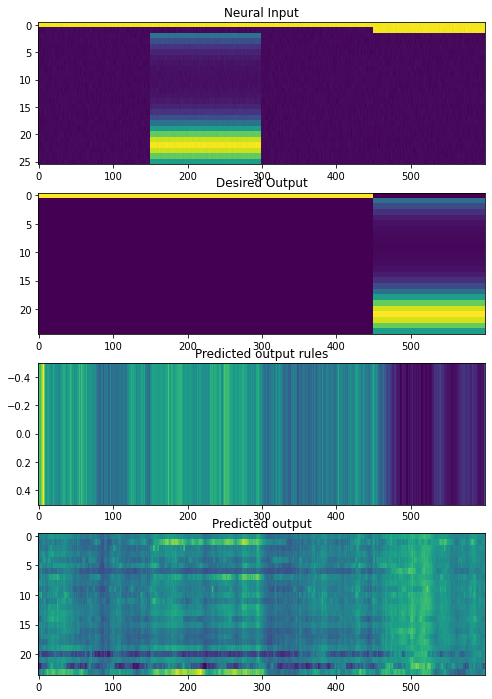

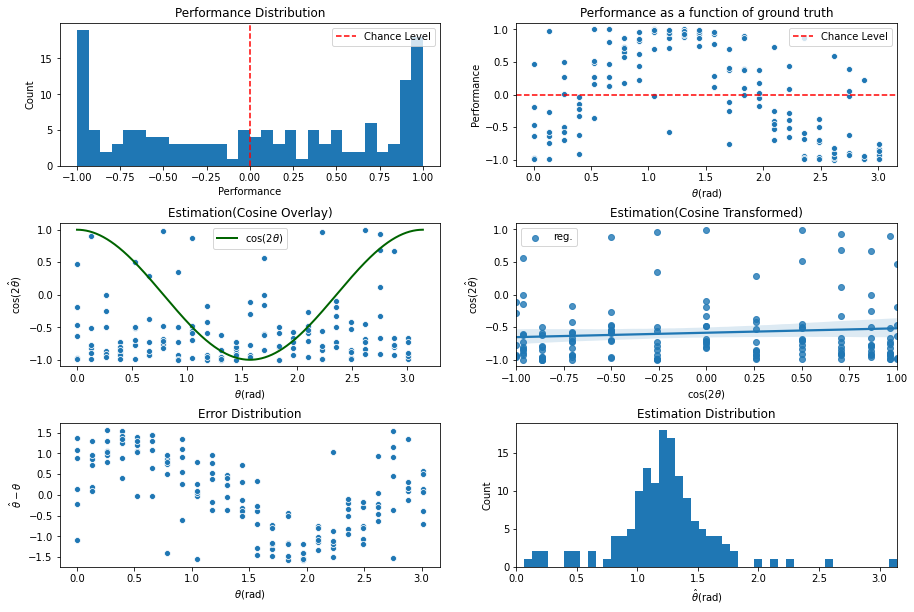

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter100/assets

 Training performance: 
Iter.  101 | Performance -0.0168 | Loss 0.4591 | Spike loss 1.8396
Testing performance: 
Iter.  101 | Performance 0.0705 | Loss 0.4597 | Spike loss 1.8501

 Training performance: 
Iter.  102 | Performance 0.1101 | Loss 0.4581 | Spike loss 1.8462
Testing performance: 
Iter.  102 | Performance 0.0142 | Loss 0.4536 | Spike loss 1.8364

 Training performance: 
Iter.  103 | Performance -0.0567 | Loss 0.4564 | Spike loss 1.8460
Testing performance: 
Iter.  103 | Performance 0.0723 | Loss 0.4495 | Spike loss 1.8397

 Training performance: 
Iter.  104 | Performance 0.0043 | Loss 0.4487 | Spike loss 1.8405
Testing performance: 
Iter.  104 | Performance 0.0547 | Loss 0.4484 | Spike loss 1.8398

 Training performance: 
Iter.  105 | Performance 0.0011 | Loss 0.4545 | Spike loss 1.8274
Testing performance: 
Iter.  105 | Performance 0.0338 | Loss 0.4430 | Spike loss 1.8422

 Training pe


 Training performance: 
Iter.  147 | Performance -0.1468 | Loss 0.4121 | Spike loss 2.0258
Testing performance: 
Iter.  147 | Performance 0.0659 | Loss 0.4087 | Spike loss 2.0383

 Training performance: 
Iter.  148 | Performance 0.0457 | Loss 0.4083 | Spike loss 2.0435
Testing performance: 
Iter.  148 | Performance 0.0082 | Loss 0.4083 | Spike loss 2.0673

 Training performance: 
Iter.  149 | Performance 0.0038 | Loss 0.4094 | Spike loss 2.0469
Testing performance: 
Iter.  149 | Performance 0.0395 | Loss 0.4117 | Spike loss 2.0606

 Training performance: 
Iter.  150 | Performance -0.0169 | Loss 0.4108 | Spike loss 2.0638
Testing performance: 
Iter.  150 | Performance 0.0832 | Loss 0.4041 | Spike loss 2.0736

 Training performance: 
Iter.  151 | Performance -0.0248 | Loss 0.4057 | Spike loss 2.0714
Testing performance: 
Iter.  151 | Performance 0.0755 | Loss 0.4031 | Spike loss 2.0692

 Training performance: 
Iter.  152 | Performance -0.0744 | Loss 0.4072 | Spike loss 2.0600
Testing pe


 Training performance: 
Iter.  193 | Performance -0.0149 | Loss 0.3798 | Spike loss 2.4086
Testing performance: 
Iter.  193 | Performance -0.0358 | Loss 0.3822 | Spike loss 2.4196

 Training performance: 
Iter.  194 | Performance -0.1040 | Loss 0.3797 | Spike loss 2.4204
Testing performance: 
Iter.  194 | Performance -0.0634 | Loss 0.3847 | Spike loss 2.4244

 Training performance: 
Iter.  195 | Performance 0.0022 | Loss 0.3841 | Spike loss 2.4332
Testing performance: 
Iter.  195 | Performance -0.0625 | Loss 0.3809 | Spike loss 2.4194

 Training performance: 
Iter.  196 | Performance 0.0387 | Loss 0.3808 | Spike loss 2.4188
Testing performance: 
Iter.  196 | Performance -0.0062 | Loss 0.3817 | Spike loss 2.4305

 Training performance: 
Iter.  197 | Performance 0.0697 | Loss 0.3814 | Spike loss 2.4445
Testing performance: 
Iter.  197 | Performance 0.0030 | Loss 0.3829 | Spike loss 2.4530

 Training performance: 
Iter.  198 | Performance -0.0247 | Loss 0.3840 | Spike loss 2.4274
Testing

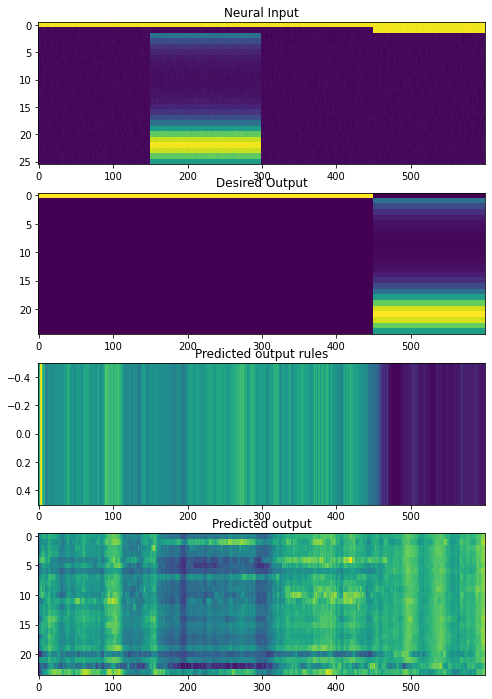

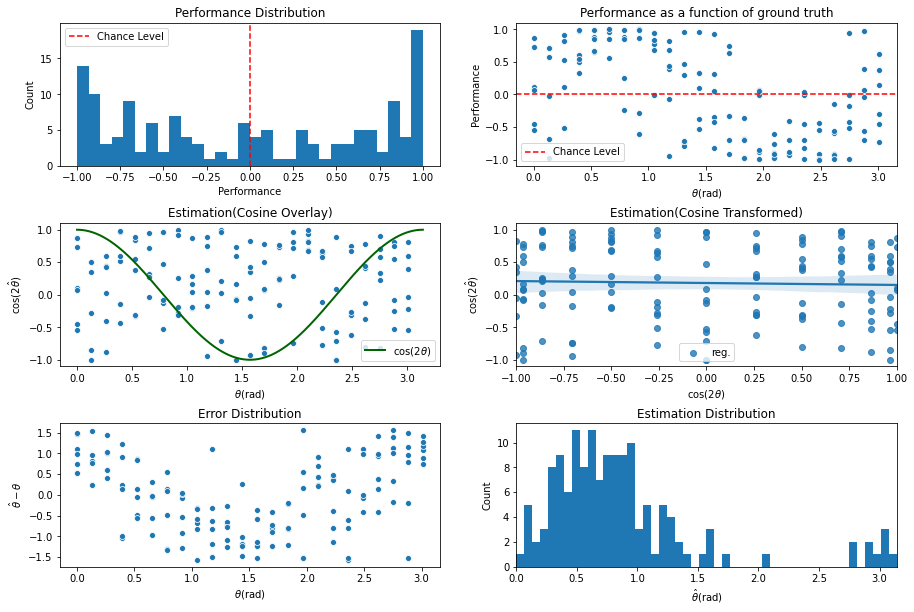

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter200/assets

 Training performance: 
Iter.  201 | Performance -0.0812 | Loss 0.3800 | Spike loss 2.4603
Testing performance: 
Iter.  201 | Performance 0.0438 | Loss 0.3784 | Spike loss 2.4574

 Training performance: 
Iter.  202 | Performance 0.0539 | Loss 0.3740 | Spike loss 2.4463
Testing performance: 
Iter.  202 | Performance 0.0617 | Loss 0.3759 | Spike loss 2.4689

 Training performance: 
Iter.  203 | Performance 0.0268 | Loss 0.3766 | Spike loss 2.4759
Testing performance: 
Iter.  203 | Performance -0.0189 | Loss 0.3820 | Spike loss 2.4709

 Training performance: 
Iter.  204 | Performance 0.0217 | Loss 0.3794 | Spike loss 2.4815
Testing performance: 
Iter.  204 | Performance -0.0238 | Loss 0.3761 | Spike loss 2.4832

 Training performance: 
Iter.  205 | Performance -0.0184 | Loss 0.3761 | Spike loss 2.4662
Testing performance: 
Iter.  205 | Performance -0.0043 | Loss 0.3751 | Spike loss 2.4735

 Training


 Training performance: 
Iter.  247 | Performance 0.0934 | Loss 0.3652 | Spike loss 2.5512
Testing performance: 
Iter.  247 | Performance -0.0205 | Loss 0.3651 | Spike loss 2.5497

 Training performance: 
Iter.  248 | Performance -0.0379 | Loss 0.3636 | Spike loss 2.5375
Testing performance: 
Iter.  248 | Performance -0.0094 | Loss 0.3670 | Spike loss 2.5518

 Training performance: 
Iter.  249 | Performance 0.0836 | Loss 0.3663 | Spike loss 2.5553
Testing performance: 
Iter.  249 | Performance 0.0019 | Loss 0.3644 | Spike loss 2.5397

 Training performance: 
Iter.  250 | Performance -0.0458 | Loss 0.3627 | Spike loss 2.5560
Testing performance: 
Iter.  250 | Performance -0.0909 | Loss 0.3633 | Spike loss 2.5540

 Training performance: 
Iter.  251 | Performance 0.0217 | Loss 0.3646 | Spike loss 2.5479
Testing performance: 
Iter.  251 | Performance -0.0242 | Loss 0.3655 | Spike loss 2.5527

 Training performance: 
Iter.  252 | Performance 0.0592 | Loss 0.3659 | Spike loss 2.5504
Testing 


 Training performance: 
Iter.  293 | Performance 0.0148 | Loss 0.3586 | Spike loss 2.5445
Testing performance: 
Iter.  293 | Performance 0.0079 | Loss 0.3581 | Spike loss 2.5656

 Training performance: 
Iter.  294 | Performance 0.0118 | Loss 0.3586 | Spike loss 2.5356
Testing performance: 
Iter.  294 | Performance 0.0009 | Loss 0.3560 | Spike loss 2.5513

 Training performance: 
Iter.  295 | Performance 0.0371 | Loss 0.3541 | Spike loss 2.5611
Testing performance: 
Iter.  295 | Performance 0.0120 | Loss 0.3566 | Spike loss 2.5380

 Training performance: 
Iter.  296 | Performance 0.0622 | Loss 0.3578 | Spike loss 2.5451
Testing performance: 
Iter.  296 | Performance -0.0032 | Loss 0.3590 | Spike loss 2.5373

 Training performance: 
Iter.  297 | Performance 0.0279 | Loss 0.3603 | Spike loss 2.5315
Testing performance: 
Iter.  297 | Performance 0.0133 | Loss 0.3551 | Spike loss 2.5455

 Training performance: 
Iter.  298 | Performance 0.0570 | Loss 0.3551 | Spike loss 2.5405
Testing perfo

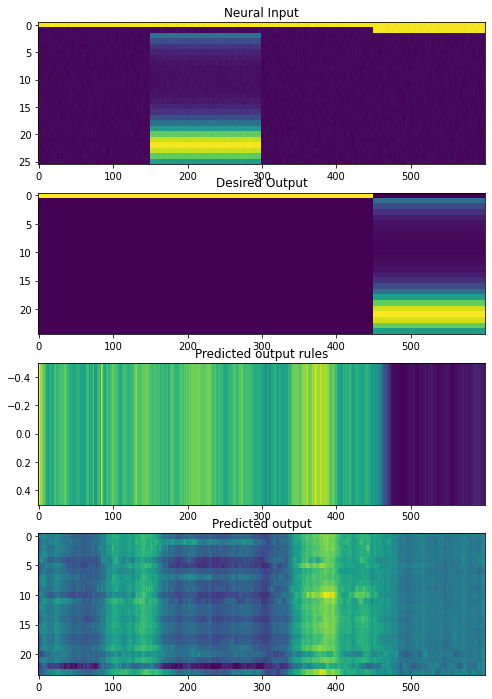

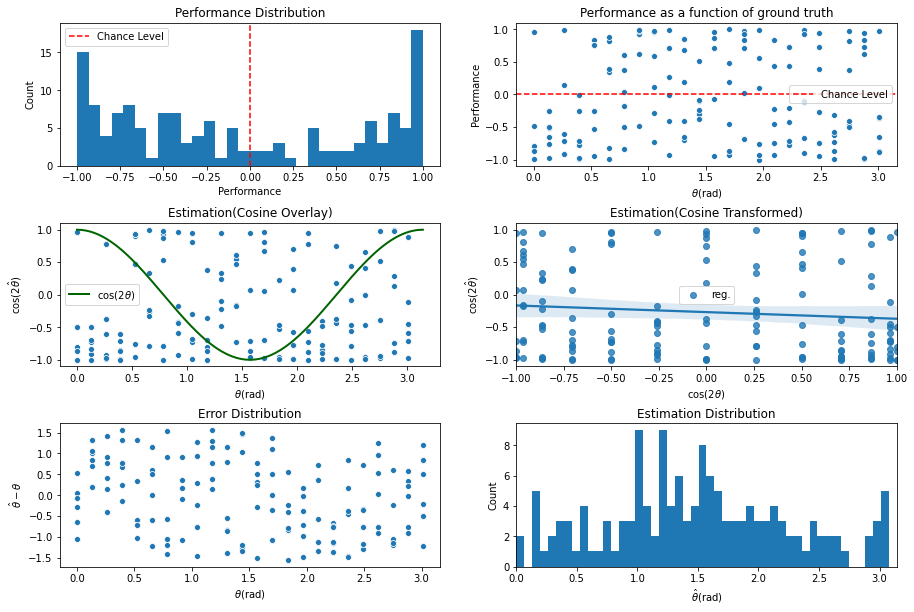

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter300/assets

 Training performance: 
Iter.  301 | Performance 0.0167 | Loss 0.3528 | Spike loss 2.5203
Testing performance: 
Iter.  301 | Performance 0.0281 | Loss 0.3558 | Spike loss 2.5243

 Training performance: 
Iter.  302 | Performance -0.0558 | Loss 0.3567 | Spike loss 2.5194
Testing performance: 
Iter.  302 | Performance -0.0137 | Loss 0.3581 | Spike loss 2.5362

 Training performance: 
Iter.  303 | Performance 0.0192 | Loss 0.3580 | Spike loss 2.5341
Testing performance: 
Iter.  303 | Performance 0.1204 | Loss 0.3538 | Spike loss 2.5446

 Training performance: 
Iter.  304 | Performance 0.0016 | Loss 0.3542 | Spike loss 2.5322
Testing performance: 
Iter.  304 | Performance -0.0850 | Loss 0.3556 | Spike loss 2.5364

 Training performance: 
Iter.  305 | Performance -0.0034 | Loss 0.3538 | Spike loss 2.5380
Testing performance: 
Iter.  305 | Performance -0.0818 | Loss 0.3559 | Spike loss 2.5579

 Training


 Training performance: 
Iter.  347 | Performance -0.0260 | Loss 0.3516 | Spike loss 2.5629
Testing performance: 
Iter.  347 | Performance -0.0083 | Loss 0.3517 | Spike loss 2.5620

 Training performance: 
Iter.  348 | Performance -0.0109 | Loss 0.3541 | Spike loss 2.5527
Testing performance: 
Iter.  348 | Performance -0.0046 | Loss 0.3494 | Spike loss 2.5518

 Training performance: 
Iter.  349 | Performance 0.0183 | Loss 0.3490 | Spike loss 2.5652
Testing performance: 
Iter.  349 | Performance -0.0323 | Loss 0.3513 | Spike loss 2.5498

 Training performance: 
Iter.  350 | Performance -0.0068 | Loss 0.3519 | Spike loss 2.5525
Testing performance: 
Iter.  350 | Performance 0.0184 | Loss 0.3537 | Spike loss 2.5523

 Training performance: 
Iter.  351 | Performance 0.0195 | Loss 0.3543 | Spike loss 2.5604
Testing performance: 
Iter.  351 | Performance -0.0049 | Loss 0.3510 | Spike loss 2.5636

 Training performance: 
Iter.  352 | Performance 0.0666 | Loss 0.3516 | Spike loss 2.5618
Testing


 Training performance: 
Iter.  393 | Performance -0.0356 | Loss 0.3494 | Spike loss 2.5532
Testing performance: 
Iter.  393 | Performance -0.0286 | Loss 0.3463 | Spike loss 2.5237

 Training performance: 
Iter.  394 | Performance 0.0215 | Loss 0.3479 | Spike loss 2.5416
Testing performance: 
Iter.  394 | Performance 0.0064 | Loss 0.3463 | Spike loss 2.5618

 Training performance: 
Iter.  395 | Performance 0.0128 | Loss 0.3461 | Spike loss 2.5502
Testing performance: 
Iter.  395 | Performance -0.0193 | Loss 0.3470 | Spike loss 2.5700

 Training performance: 
Iter.  396 | Performance -0.0299 | Loss 0.3484 | Spike loss 2.5575
Testing performance: 
Iter.  396 | Performance 0.0365 | Loss 0.3456 | Spike loss 2.5717

 Training performance: 
Iter.  397 | Performance -0.0564 | Loss 0.3460 | Spike loss 2.5810
Testing performance: 
Iter.  397 | Performance -0.0302 | Loss 0.3452 | Spike loss 2.5657

 Training performance: 
Iter.  398 | Performance 0.0689 | Loss 0.3465 | Spike loss 2.5618
Testing 

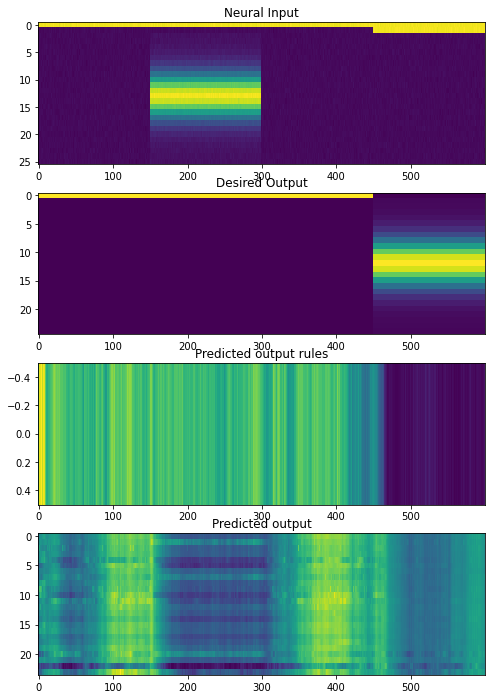

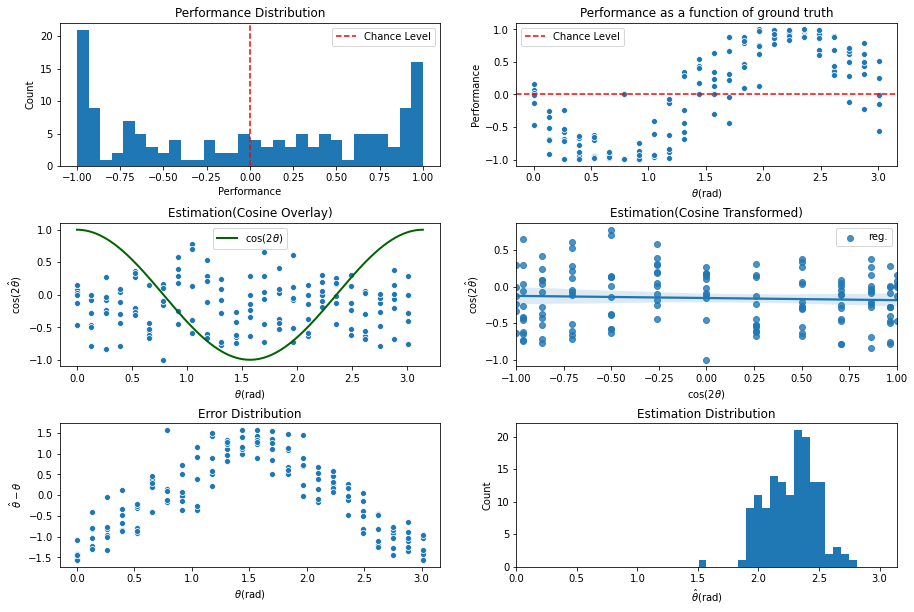

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter400/assets

 Training performance: 
Iter.  401 | Performance -0.0592 | Loss 0.3446 | Spike loss 2.5621
Testing performance: 
Iter.  401 | Performance 0.0238 | Loss 0.3482 | Spike loss 2.5837

 Training performance: 
Iter.  402 | Performance 0.1129 | Loss 0.3481 | Spike loss 2.5598
Testing performance: 
Iter.  402 | Performance 0.0100 | Loss 0.3461 | Spike loss 2.5672

 Training performance: 
Iter.  403 | Performance -0.0703 | Loss 0.3452 | Spike loss 2.5760
Testing performance: 
Iter.  403 | Performance 0.0197 | Loss 0.3473 | Spike loss 2.5682

 Training performance: 
Iter.  404 | Performance 0.0047 | Loss 0.3456 | Spike loss 2.5628
Testing performance: 
Iter.  404 | Performance -0.0131 | Loss 0.3478 | Spike loss 2.5659

 Training performance: 
Iter.  405 | Performance 0.0474 | Loss 0.3476 | Spike loss 2.5449
Testing performance: 
Iter.  405 | Performance 0.0157 | Loss 0.3455 | Spike loss 2.5715

 Training p


 Training performance: 
Iter.  447 | Performance -0.0452 | Loss 0.3452 | Spike loss 2.6316
Testing performance: 
Iter.  447 | Performance -0.0241 | Loss 0.3419 | Spike loss 2.6217

 Training performance: 
Iter.  448 | Performance -0.0228 | Loss 0.3407 | Spike loss 2.6116
Testing performance: 
Iter.  448 | Performance -0.0142 | Loss 0.3415 | Spike loss 2.6123

 Training performance: 
Iter.  449 | Performance 0.0289 | Loss 0.3422 | Spike loss 2.6184
Testing performance: 
Iter.  449 | Performance 0.0237 | Loss 0.3431 | Spike loss 2.6202

 Training performance: 
Iter.  450 | Performance 0.0343 | Loss 0.3428 | Spike loss 2.6123
Testing performance: 
Iter.  450 | Performance -0.0366 | Loss 0.3421 | Spike loss 2.6020

 Training performance: 
Iter.  451 | Performance -0.0470 | Loss 0.3411 | Spike loss 2.6023
Testing performance: 
Iter.  451 | Performance -0.0260 | Loss 0.3405 | Spike loss 2.6161

 Training performance: 
Iter.  452 | Performance -0.0546 | Loss 0.3409 | Spike loss 2.6050
Testin


 Training performance: 
Iter.  493 | Performance 0.0297 | Loss 0.3374 | Spike loss 2.6543
Testing performance: 
Iter.  493 | Performance -0.0120 | Loss 0.3385 | Spike loss 2.6472

 Training performance: 
Iter.  494 | Performance 0.0408 | Loss 0.3368 | Spike loss 2.6492
Testing performance: 
Iter.  494 | Performance 0.0081 | Loss 0.3400 | Spike loss 2.6389

 Training performance: 
Iter.  495 | Performance -0.0072 | Loss 0.3416 | Spike loss 2.6354
Testing performance: 
Iter.  495 | Performance -0.0152 | Loss 0.3378 | Spike loss 2.6390

 Training performance: 
Iter.  496 | Performance 0.0264 | Loss 0.3427 | Spike loss 2.6232
Testing performance: 
Iter.  496 | Performance 0.0108 | Loss 0.3379 | Spike loss 2.6419

 Training performance: 
Iter.  497 | Performance -0.0382 | Loss 0.3374 | Spike loss 2.6278
Testing performance: 
Iter.  497 | Performance -0.0056 | Loss 0.3392 | Spike loss 2.6383

 Training performance: 
Iter.  498 | Performance 0.0015 | Loss 0.3401 | Spike loss 2.6308
Testing p

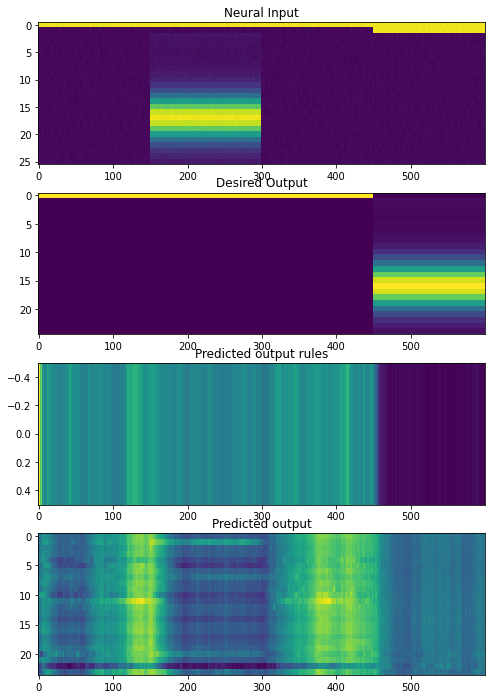

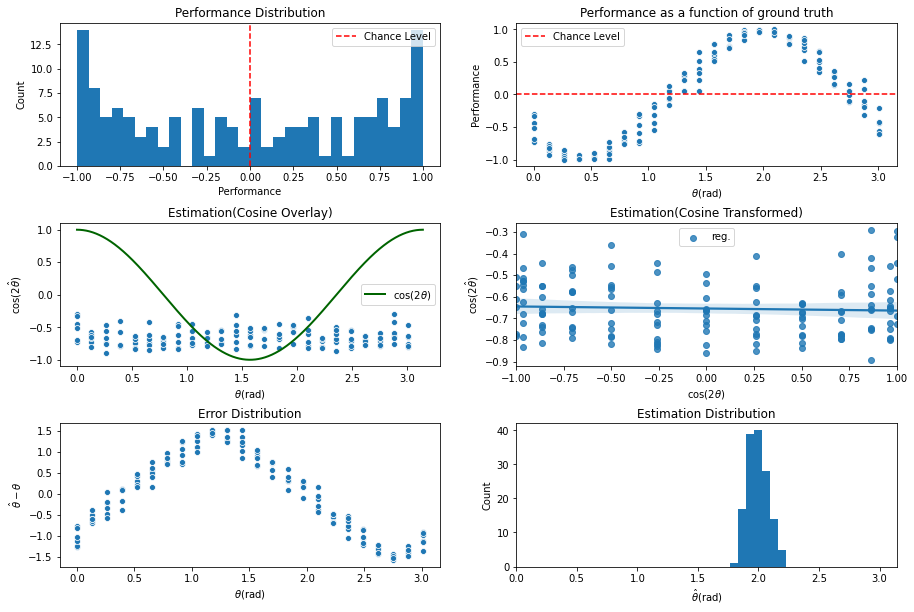

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter500/assets

 Training performance: 
Iter.  501 | Performance -0.0508 | Loss 0.3408 | Spike loss 2.6383
Testing performance: 
Iter.  501 | Performance -0.0117 | Loss 0.3386 | Spike loss 2.6343

 Training performance: 
Iter.  502 | Performance -0.0924 | Loss 0.3365 | Spike loss 2.6400
Testing performance: 
Iter.  502 | Performance -0.0057 | Loss 0.3392 | Spike loss 2.6322

 Training performance: 
Iter.  503 | Performance -0.0279 | Loss 0.3374 | Spike loss 2.6337
Testing performance: 
Iter.  503 | Performance -0.0040 | Loss 0.3405 | Spike loss 2.6462

 Training performance: 
Iter.  504 | Performance -0.0881 | Loss 0.3413 | Spike loss 2.6252
Testing performance: 
Iter.  504 | Performance 0.0038 | Loss 0.3369 | Spike loss 2.6364

 Training performance: 
Iter.  505 | Performance 0.0059 | Loss 0.3357 | Spike loss 2.6411
Testing performance: 
Iter.  505 | Performance -0.0010 | Loss 0.3388 | Spike loss 2.6404

 Train


 Training performance: 
Iter.  546 | Performance 0.0540 | Loss 0.3380 | Spike loss 2.6511
Testing performance: 
Iter.  546 | Performance 0.0020 | Loss 0.3348 | Spike loss 2.6569

 Training performance: 
Iter.  547 | Performance 0.0672 | Loss 0.3355 | Spike loss 2.6324
Testing performance: 
Iter.  547 | Performance -0.0087 | Loss 0.3339 | Spike loss 2.6654

 Training performance: 
Iter.  548 | Performance 0.0916 | Loss 0.3354 | Spike loss 2.6614
Testing performance: 
Iter.  548 | Performance -0.0114 | Loss 0.3364 | Spike loss 2.6708

 Training performance: 
Iter.  549 | Performance 0.0031 | Loss 0.3363 | Spike loss 2.6812
Testing performance: 
Iter.  549 | Performance -0.0226 | Loss 0.3351 | Spike loss 2.6678

 Training performance: 
Iter.  550 | Performance 0.1437 | Loss 0.3349 | Spike loss 2.6657
Testing performance: 
Iter.  550 | Performance 0.0184 | Loss 0.3345 | Spike loss 2.6545

 Training performance: 
Iter.  551 | Performance 0.1094 | Loss 0.3349 | Spike loss 2.6528
Testing per


 Training performance: 
Iter.  592 | Performance 0.1059 | Loss 0.3319 | Spike loss 2.6396
Testing performance: 
Iter.  592 | Performance 0.0278 | Loss 0.3330 | Spike loss 2.6350

 Training performance: 
Iter.  593 | Performance -0.1075 | Loss 0.3335 | Spike loss 2.6371
Testing performance: 
Iter.  593 | Performance 0.0417 | Loss 0.3343 | Spike loss 2.6350

 Training performance: 
Iter.  594 | Performance -0.0164 | Loss 0.3343 | Spike loss 2.6171
Testing performance: 
Iter.  594 | Performance 0.0408 | Loss 0.3323 | Spike loss 2.6128

 Training performance: 
Iter.  595 | Performance -0.0702 | Loss 0.3316 | Spike loss 2.6300
Testing performance: 
Iter.  595 | Performance -0.0066 | Loss 0.3329 | Spike loss 2.6287

 Training performance: 
Iter.  596 | Performance -0.0089 | Loss 0.3332 | Spike loss 2.6100
Testing performance: 
Iter.  596 | Performance 0.0019 | Loss 0.3350 | Spike loss 2.6337

 Training performance: 
Iter.  597 | Performance -0.0190 | Loss 0.3341 | Spike loss 2.6358
Testing 

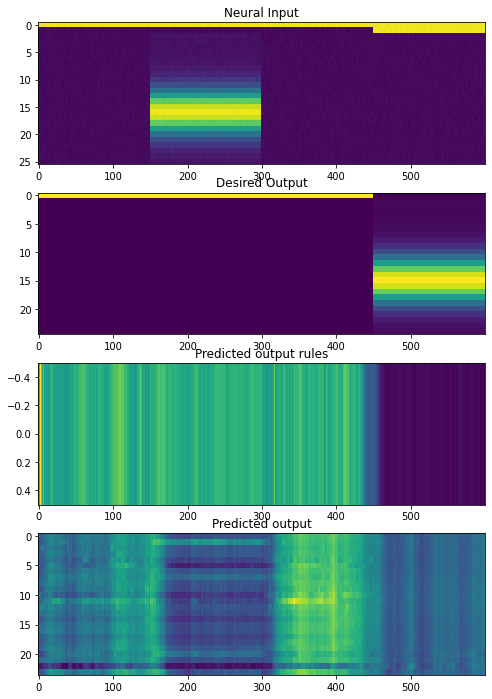

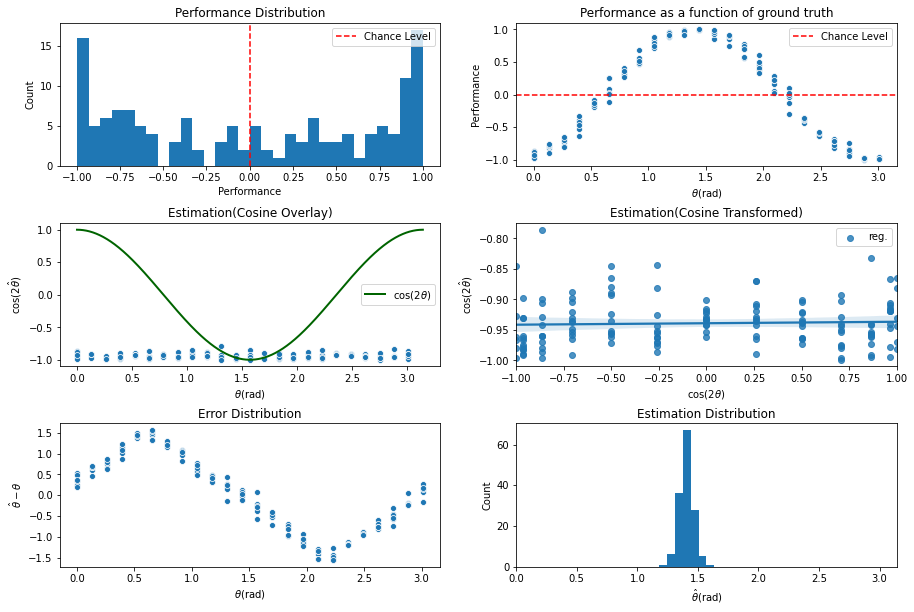

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter600/assets

 Training performance: 
Iter.  601 | Performance 0.0652 | Loss 0.3316 | Spike loss 2.6273
Testing performance: 
Iter.  601 | Performance 0.0029 | Loss 0.3337 | Spike loss 2.6402

 Training performance: 
Iter.  602 | Performance -0.0165 | Loss 0.3324 | Spike loss 2.6211
Testing performance: 
Iter.  602 | Performance -0.0016 | Loss 0.3343 | Spike loss 2.6295

 Training performance: 
Iter.  603 | Performance -0.0651 | Loss 0.3347 | Spike loss 2.6332
Testing performance: 
Iter.  603 | Performance 0.0202 | Loss 0.3310 | Spike loss 2.6169

 Training performance: 
Iter.  604 | Performance 0.1169 | Loss 0.3311 | Spike loss 2.6293
Testing performance: 
Iter.  604 | Performance 0.0085 | Loss 0.3329 | Spike loss 2.6071

 Training performance: 
Iter.  605 | Performance 0.0785 | Loss 0.3310 | Spike loss 2.6162
Testing performance: 
Iter.  605 | Performance 0.0174 | Loss 0.3346 | Spike loss 2.6049

 Training p


 Training performance: 
Iter.  647 | Performance -0.0731 | Loss 0.3331 | Spike loss 2.6030
Testing performance: 
Iter.  647 | Performance -0.0057 | Loss 0.3334 | Spike loss 2.6009

 Training performance: 
Iter.  648 | Performance 0.0127 | Loss 0.3344 | Spike loss 2.6102
Testing performance: 
Iter.  648 | Performance 0.0063 | Loss 0.3306 | Spike loss 2.5923

 Training performance: 
Iter.  649 | Performance 0.1088 | Loss 0.3313 | Spike loss 2.6142
Testing performance: 
Iter.  649 | Performance -0.0083 | Loss 0.3309 | Spike loss 2.6158

 Training performance: 
Iter.  650 | Performance -0.0133 | Loss 0.3316 | Spike loss 2.6195
Testing performance: 
Iter.  650 | Performance 0.0166 | Loss 0.3324 | Spike loss 2.6228

 Training performance: 
Iter.  651 | Performance -0.0058 | Loss 0.3322 | Spike loss 2.6165
Testing performance: 
Iter.  651 | Performance 0.0692 | Loss 0.3305 | Spike loss 2.6000

 Training performance: 
Iter.  652 | Performance 0.0043 | Loss 0.3307 | Spike loss 2.6093
Testing p


 Training performance: 
Iter.  693 | Performance 0.0073 | Loss 0.3321 | Spike loss 2.5380
Testing performance: 
Iter.  693 | Performance 0.0017 | Loss 0.3294 | Spike loss 2.5379

 Training performance: 
Iter.  694 | Performance 0.1376 | Loss 0.3299 | Spike loss 2.5343
Testing performance: 
Iter.  694 | Performance 0.0200 | Loss 0.3298 | Spike loss 2.5221

 Training performance: 
Iter.  695 | Performance -0.0051 | Loss 0.3295 | Spike loss 2.5192
Testing performance: 
Iter.  695 | Performance 0.0136 | Loss 0.3312 | Spike loss 2.5245

 Training performance: 
Iter.  696 | Performance -0.1078 | Loss 0.3303 | Spike loss 2.5345
Testing performance: 
Iter.  696 | Performance 0.0003 | Loss 0.3291 | Spike loss 2.5328

 Training performance: 
Iter.  697 | Performance 0.0123 | Loss 0.3293 | Spike loss 2.5275
Testing performance: 
Iter.  697 | Performance 0.0067 | Loss 0.3291 | Spike loss 2.5314

 Training performance: 
Iter.  698 | Performance -0.0360 | Loss 0.3297 | Spike loss 2.5254
Testing per

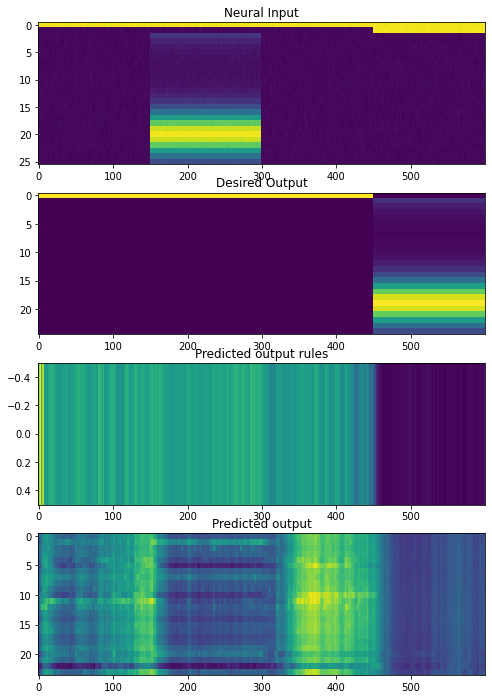

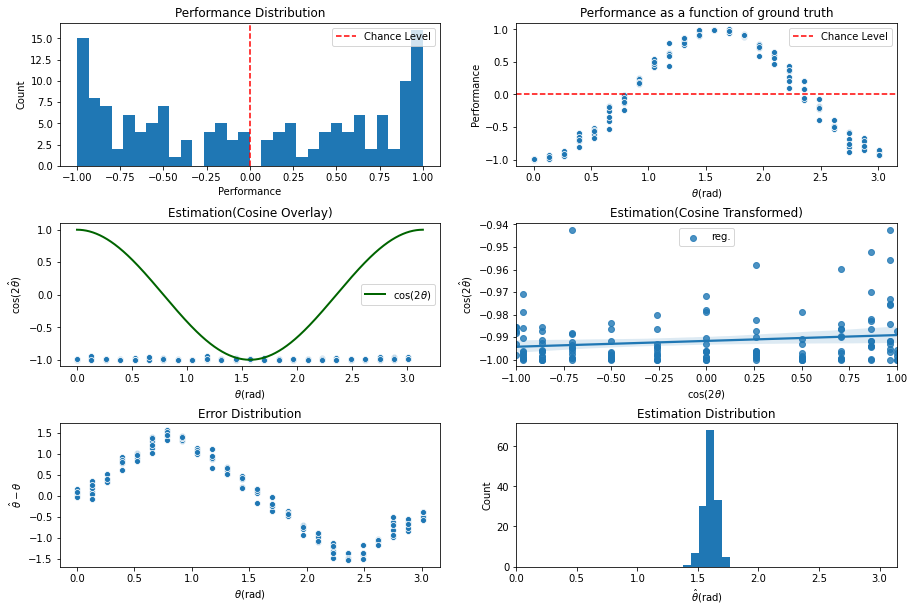

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter700/assets

 Training performance: 
Iter.  701 | Performance 0.0952 | Loss 0.3299 | Spike loss 2.5274
Testing performance: 
Iter.  701 | Performance 0.0027 | Loss 0.3311 | Spike loss 2.5225

 Training performance: 
Iter.  702 | Performance 0.0506 | Loss 0.3310 | Spike loss 2.5316
Testing performance: 
Iter.  702 | Performance 0.0127 | Loss 0.3294 | Spike loss 2.5148

 Training performance: 
Iter.  703 | Performance -0.1007 | Loss 0.3292 | Spike loss 2.5244
Testing performance: 
Iter.  703 | Performance 0.0188 | Loss 0.3300 | Spike loss 2.5192

 Training performance: 
Iter.  704 | Performance -0.0436 | Loss 0.3299 | Spike loss 2.5258
Testing performance: 
Iter.  704 | Performance 0.0137 | Loss 0.3311 | Spike loss 2.5268

 Training performance: 
Iter.  705 | Performance 0.0748 | Loss 0.3316 | Spike loss 2.5143
Testing performance: 
Iter.  705 | Performance 0.0310 | Loss 0.3290 | Spike loss 2.5156

 Training pe


 Training performance: 
Iter.  747 | Performance 0.0626 | Loss 0.3293 | Spike loss 2.4794
Testing performance: 
Iter.  747 | Performance 0.0035 | Loss 0.3271 | Spike loss 2.4796

 Training performance: 
Iter.  748 | Performance 0.1996 | Loss 0.3276 | Spike loss 2.4839
Testing performance: 
Iter.  748 | Performance 0.0098 | Loss 0.3280 | Spike loss 2.4655

 Training performance: 
Iter.  749 | Performance 0.0099 | Loss 0.3283 | Spike loss 2.4713
Testing performance: 
Iter.  749 | Performance 0.0073 | Loss 0.3301 | Spike loss 2.4762

 Training performance: 
Iter.  750 | Performance 0.0905 | Loss 0.3293 | Spike loss 2.4564
Testing performance: 
Iter.  750 | Performance 0.0053 | Loss 0.3281 | Spike loss 2.4796

 Training performance: 
Iter.  751 | Performance -0.0311 | Loss 0.3282 | Spike loss 2.4752
Testing performance: 
Iter.  751 | Performance -0.0020 | Loss 0.3289 | Spike loss 2.4851

 Training performance: 
Iter.  752 | Performance 0.0209 | Loss 0.3292 | Spike loss 2.4838
Testing perf


 Training performance: 
Iter.  793 | Performance -0.0357 | Loss 0.3263 | Spike loss 2.4420
Testing performance: 
Iter.  793 | Performance 0.0066 | Loss 0.3280 | Spike loss 2.4452

 Training performance: 
Iter.  794 | Performance -0.0157 | Loss 0.3273 | Spike loss 2.4428
Testing performance: 
Iter.  794 | Performance 0.0155 | Loss 0.3289 | Spike loss 2.4549

 Training performance: 
Iter.  795 | Performance 0.0110 | Loss 0.3295 | Spike loss 2.4549
Testing performance: 
Iter.  795 | Performance 0.0070 | Loss 0.3267 | Spike loss 2.4466

 Training performance: 
Iter.  796 | Performance 0.1017 | Loss 0.3257 | Spike loss 2.4356
Testing performance: 
Iter.  796 | Performance 0.0007 | Loss 0.3271 | Spike loss 2.4429

 Training performance: 
Iter.  797 | Performance 0.1231 | Loss 0.3277 | Spike loss 2.4396
Testing performance: 
Iter.  797 | Performance -0.0026 | Loss 0.3291 | Spike loss 2.4380

 Training performance: 
Iter.  798 | Performance 0.0001 | Loss 0.3295 | Spike loss 2.4418
Testing per

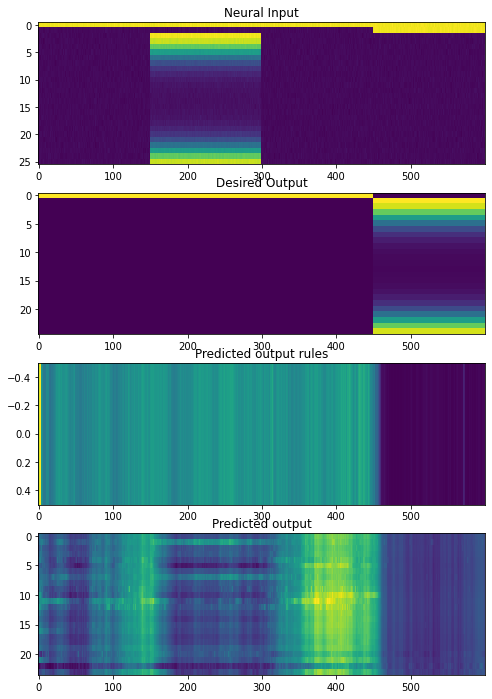

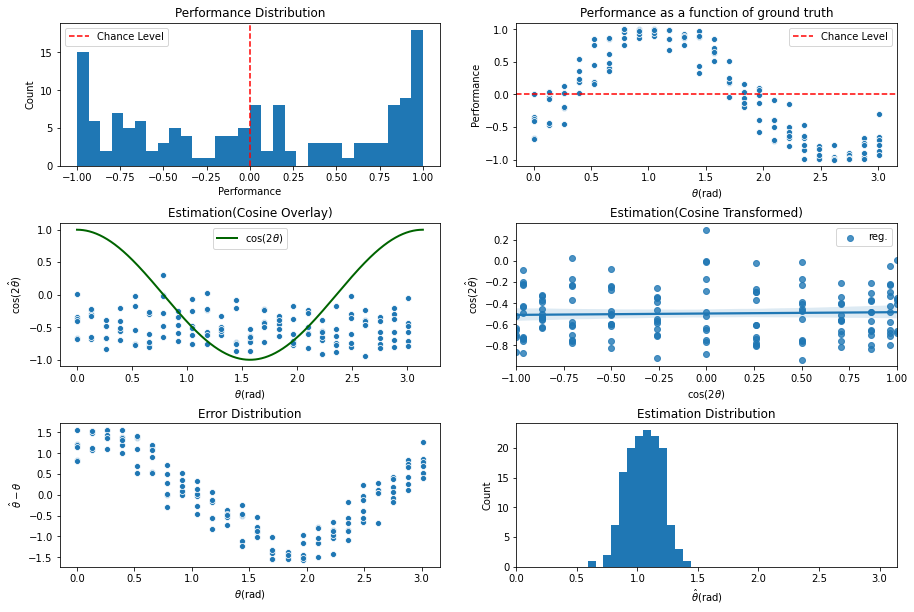

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter800/assets

 Training performance: 
Iter.  801 | Performance 0.1063 | Loss 0.3287 | Spike loss 2.4365
Testing performance: 
Iter.  801 | Performance 0.0130 | Loss 0.3268 | Spike loss 2.4269

 Training performance: 
Iter.  802 | Performance 0.0053 | Loss 0.3273 | Spike loss 2.4278
Testing performance: 
Iter.  802 | Performance 0.0155 | Loss 0.3268 | Spike loss 2.4348

 Training performance: 
Iter.  803 | Performance -0.0771 | Loss 0.3279 | Spike loss 2.4415
Testing performance: 
Iter.  803 | Performance 0.0094 | Loss 0.3284 | Spike loss 2.4496

 Training performance: 
Iter.  804 | Performance -0.0018 | Loss 0.3283 | Spike loss 2.4478
Testing performance: 
Iter.  804 | Performance 0.0029 | Loss 0.3270 | Spike loss 2.4398

 Training performance: 
Iter.  805 | Performance -0.1160 | Loss 0.3268 | Spike loss 2.4528
Testing performance: 
Iter.  805 | Performance 0.0024 | Loss 0.3269 | Spike loss 2.4564

 Training p


 Training performance: 
Iter.  847 | Performance -0.0387 | Loss 0.3253 | Spike loss 2.4392
Testing performance: 
Iter.  847 | Performance 0.0157 | Loss 0.3270 | Spike loss 2.4352

 Training performance: 
Iter.  848 | Performance 0.0035 | Loss 0.3265 | Spike loss 2.4508
Testing performance: 
Iter.  848 | Performance 0.0277 | Loss 0.3275 | Spike loss 2.4461

 Training performance: 
Iter.  849 | Performance -0.1181 | Loss 0.3278 | Spike loss 2.4384
Testing performance: 
Iter.  849 | Performance 0.0032 | Loss 0.3263 | Spike loss 2.4264

 Training performance: 
Iter.  850 | Performance 0.0476 | Loss 0.3254 | Spike loss 2.4115
Testing performance: 
Iter.  850 | Performance 0.0040 | Loss 0.3259 | Spike loss 2.4220

 Training performance: 
Iter.  851 | Performance 0.0105 | Loss 0.3259 | Spike loss 2.4274
Testing performance: 
Iter.  851 | Performance 0.0063 | Loss 0.3273 | Spike loss 2.4112

 Training performance: 
Iter.  852 | Performance -0.0223 | Loss 0.3262 | Spike loss 2.4423
Testing per


 Training performance: 
Iter.  893 | Performance -0.0675 | Loss 0.3264 | Spike loss 2.3902
Testing performance: 
Iter.  893 | Performance 0.0082 | Loss 0.3275 | Spike loss 2.3829

 Training performance: 
Iter.  894 | Performance -0.0017 | Loss 0.3259 | Spike loss 2.3803
Testing performance: 
Iter.  894 | Performance 0.0105 | Loss 0.3253 | Spike loss 2.3910

 Training performance: 
Iter.  895 | Performance 0.0154 | Loss 0.3264 | Spike loss 2.3995
Testing performance: 
Iter.  895 | Performance 0.0040 | Loss 0.3259 | Spike loss 2.3931

 Training performance: 
Iter.  896 | Performance 0.0137 | Loss 0.3268 | Spike loss 2.3980
Testing performance: 
Iter.  896 | Performance 0.0130 | Loss 0.3267 | Spike loss 2.3869

 Training performance: 
Iter.  897 | Performance 0.0588 | Loss 0.3267 | Spike loss 2.4027
Testing performance: 
Iter.  897 | Performance 0.0123 | Loss 0.3252 | Spike loss 2.3887

 Training performance: 
Iter.  898 | Performance -0.0020 | Loss 0.3247 | Spike loss 2.3703
Testing per

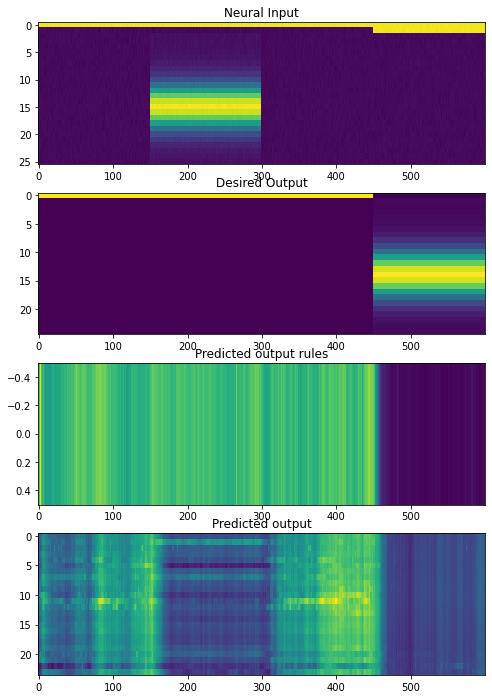

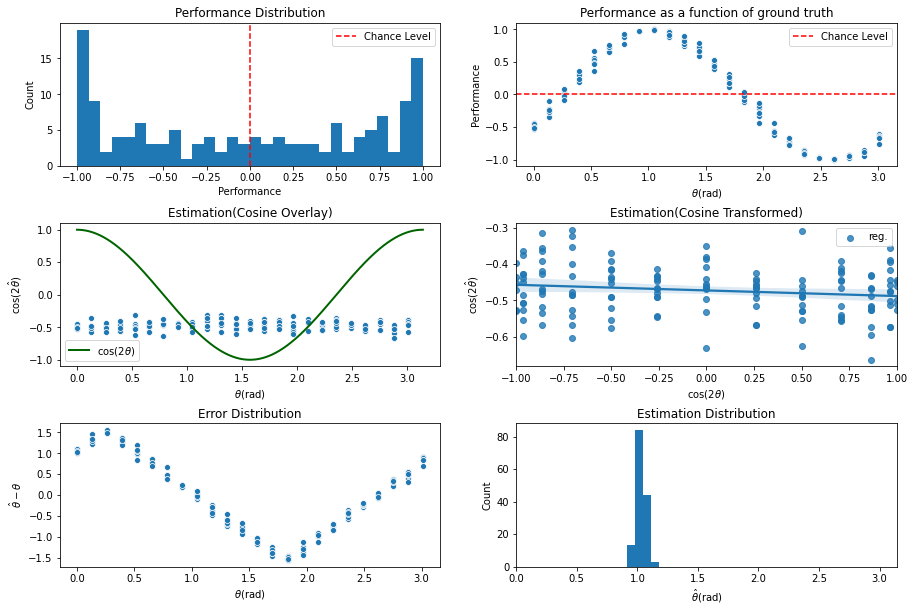

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter900/assets

 Training performance: 
Iter.  901 | Performance 0.0356 | Loss 0.3251 | Spike loss 2.3760
Testing performance: 
Iter.  901 | Performance 0.0104 | Loss 0.3253 | Spike loss 2.3823

 Training performance: 
Iter.  902 | Performance -0.0539 | Loss 0.3263 | Spike loss 2.3782
Testing performance: 
Iter.  902 | Performance -0.0027 | Loss 0.3267 | Spike loss 2.3767

 Training performance: 
Iter.  903 | Performance 0.0491 | Loss 0.3275 | Spike loss 2.3683
Testing performance: 
Iter.  903 | Performance -0.0022 | Loss 0.3258 | Spike loss 2.3725

 Training performance: 
Iter.  904 | Performance 0.1454 | Loss 0.3253 | Spike loss 2.3613
Testing performance: 
Iter.  904 | Performance 0.0088 | Loss 0.3261 | Spike loss 2.3761

 Training performance: 
Iter.  905 | Performance -0.0153 | Loss 0.3253 | Spike loss 2.3644
Testing performance: 
Iter.  905 | Performance -0.0028 | Loss 0.3275 | Spike loss 2.3649

 Training


 Training performance: 
Iter.  947 | Performance -0.0169 | Loss 0.3242 | Spike loss 2.3461
Testing performance: 
Iter.  947 | Performance 0.0045 | Loss 0.3259 | Spike loss 2.3451

 Training performance: 
Iter.  948 | Performance -0.0544 | Loss 0.3258 | Spike loss 2.3329
Testing performance: 
Iter.  948 | Performance 0.0028 | Loss 0.3252 | Spike loss 2.3555

 Training performance: 
Iter.  949 | Performance 0.0592 | Loss 0.3243 | Spike loss 2.3245
Testing performance: 
Iter.  949 | Performance 0.0008 | Loss 0.3255 | Spike loss 2.3394

 Training performance: 
Iter.  950 | Performance 0.0711 | Loss 0.3257 | Spike loss 2.3390
Testing performance: 
Iter.  950 | Performance -0.0038 | Loss 0.3272 | Spike loss 2.3475

 Training performance: 
Iter.  951 | Performance -0.0250 | Loss 0.3259 | Spike loss 2.3441
Testing performance: 
Iter.  951 | Performance 0.0167 | Loss 0.3252 | Spike loss 2.3526

 Training performance: 
Iter.  952 | Performance -0.0131 | Loss 0.3248 | Spike loss 2.3410
Testing p


 Training performance: 
Iter.  993 | Performance -0.0028 | Loss 0.3256 | Spike loss 2.3123
Testing performance: 
Iter.  993 | Performance -0.0046 | Loss 0.3245 | Spike loss 2.2963

 Training performance: 
Iter.  994 | Performance 0.0746 | Loss 0.3238 | Spike loss 2.2973
Testing performance: 
Iter.  994 | Performance 0.0111 | Loss 0.3248 | Spike loss 2.3083

 Training performance: 
Iter.  995 | Performance -0.1001 | Loss 0.3248 | Spike loss 2.3106
Testing performance: 
Iter.  995 | Performance 0.0036 | Loss 0.3250 | Spike loss 2.3172

 Training performance: 
Iter.  996 | Performance -0.0649 | Loss 0.3256 | Spike loss 2.3120
Testing performance: 
Iter.  996 | Performance 0.0009 | Loss 0.3247 | Spike loss 2.2996

 Training performance: 
Iter.  997 | Performance 0.0070 | Loss 0.3235 | Spike loss 2.3023
Testing performance: 
Iter.  997 | Performance 0.0126 | Loss 0.3246 | Spike loss 2.3095

 Training performance: 
Iter.  998 | Performance -0.0242 | Loss 0.3255 | Spike loss 2.3167
Testing p

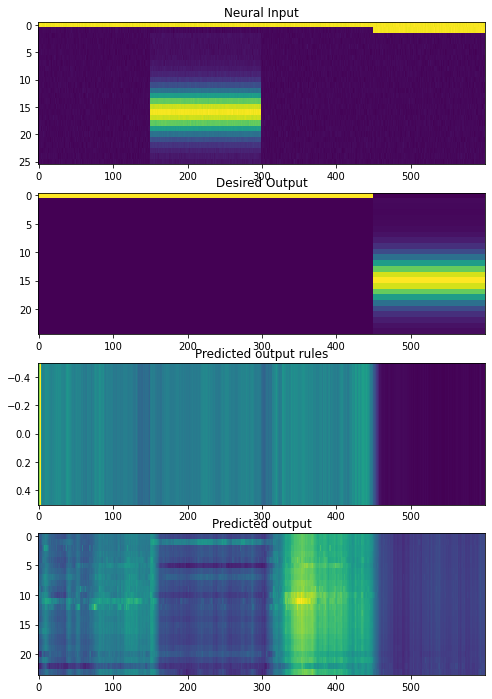

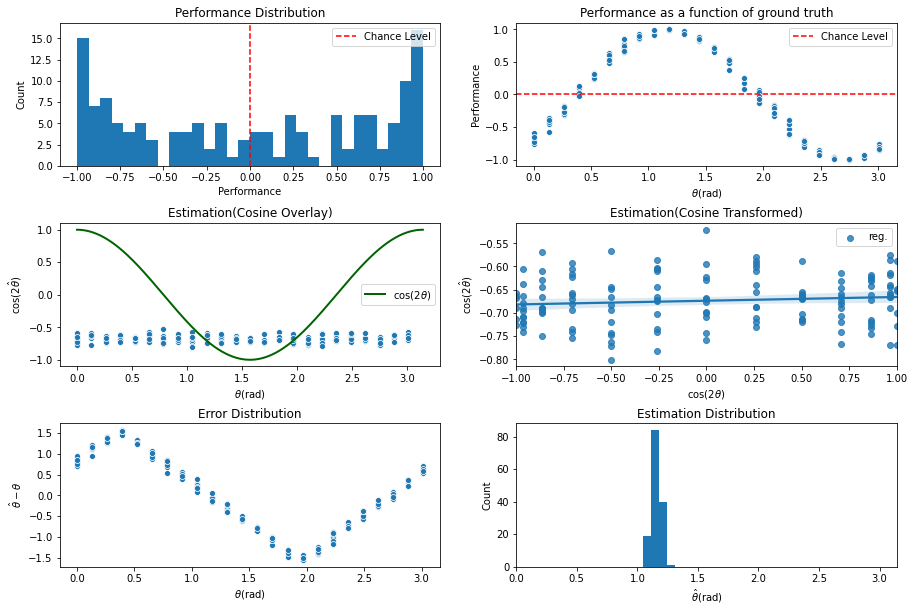

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter1000/assets

 Training performance: 
Iter. 1001 | Performance -0.0974 | Loss 0.3245 | Spike loss 2.3080
Testing performance: 
Iter. 1001 | Performance 0.0102 | Loss 0.3259 | Spike loss 2.3041

 Training performance: 
Iter. 1002 | Performance 0.0008 | Loss 0.3255 | Spike loss 2.2940
Testing performance: 
Iter. 1002 | Performance 0.0021 | Loss 0.3240 | Spike loss 2.2991

 Training performance: 
Iter. 1003 | Performance -0.0200 | Loss 0.3246 | Spike loss 2.3149
Testing performance: 
Iter. 1003 | Performance 0.0155 | Loss 0.3242 | Spike loss 2.3038

 Training performance: 
Iter. 1004 | Performance 0.1796 | Loss 0.3244 | Spike loss 2.3075
Testing performance: 
Iter. 1004 | Performance 0.0086 | Loss 0.3254 | Spike loss 2.3036

 Training performance: 
Iter. 1005 | Performance -0.0799 | Loss 0.3249 | Spike loss 2.3089
Testing performance: 
Iter. 1005 | Performance 0.0047 | Loss 0.3242 | Spike loss 2.3077

 Training 


 Training performance: 
Iter. 1047 | Performance 0.0511 | Loss 0.3251 | Spike loss 2.3088
Testing performance: 
Iter. 1047 | Performance -0.0102 | Loss 0.3238 | Spike loss 2.2951

 Training performance: 
Iter. 1048 | Performance -0.0599 | Loss 0.3236 | Spike loss 2.3031
Testing performance: 
Iter. 1048 | Performance -0.0039 | Loss 0.3243 | Spike loss 2.2802

 Training performance: 
Iter. 1049 | Performance 0.0033 | Loss 0.3241 | Spike loss 2.2850
Testing performance: 
Iter. 1049 | Performance 0.0050 | Loss 0.3249 | Spike loss 2.2836

 Training performance: 
Iter. 1050 | Performance 0.0318 | Loss 0.3247 | Spike loss 2.2859
Testing performance: 
Iter. 1050 | Performance -0.0060 | Loss 0.3236 | Spike loss 2.2863

 Training performance: 
Iter. 1051 | Performance 0.0107 | Loss 0.3235 | Spike loss 2.2782
Testing performance: 
Iter. 1051 | Performance 0.0044 | Loss 0.3244 | Spike loss 2.2781

 Training performance: 
Iter. 1052 | Performance -0.0100 | Loss 0.3244 | Spike loss 2.2784
Testing p


 Training performance: 
Iter. 1093 | Performance 0.0019 | Loss 0.3232 | Spike loss 2.2504
Testing performance: 
Iter. 1093 | Performance 0.0119 | Loss 0.3238 | Spike loss 2.2569

 Training performance: 
Iter. 1094 | Performance -0.0380 | Loss 0.3235 | Spike loss 2.2593
Testing performance: 
Iter. 1094 | Performance 0.0038 | Loss 0.3256 | Spike loss 2.2504

 Training performance: 
Iter. 1095 | Performance 0.0282 | Loss 0.3247 | Spike loss 2.2454
Testing performance: 
Iter. 1095 | Performance 0.0117 | Loss 0.3234 | Spike loss 2.2467

 Training performance: 
Iter. 1096 | Performance 0.0769 | Loss 0.3233 | Spike loss 2.2633
Testing performance: 
Iter. 1096 | Performance 0.0053 | Loss 0.3240 | Spike loss 2.2292

 Training performance: 
Iter. 1097 | Performance -0.0563 | Loss 0.3234 | Spike loss 2.2400
Testing performance: 
Iter. 1097 | Performance 0.0027 | Loss 0.3248 | Spike loss 2.2363

 Training performance: 
Iter. 1098 | Performance -0.0235 | Loss 0.3242 | Spike loss 2.2318
Testing per

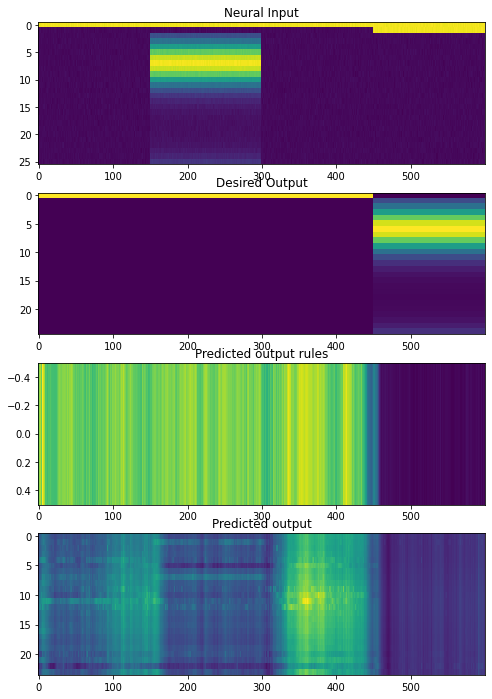

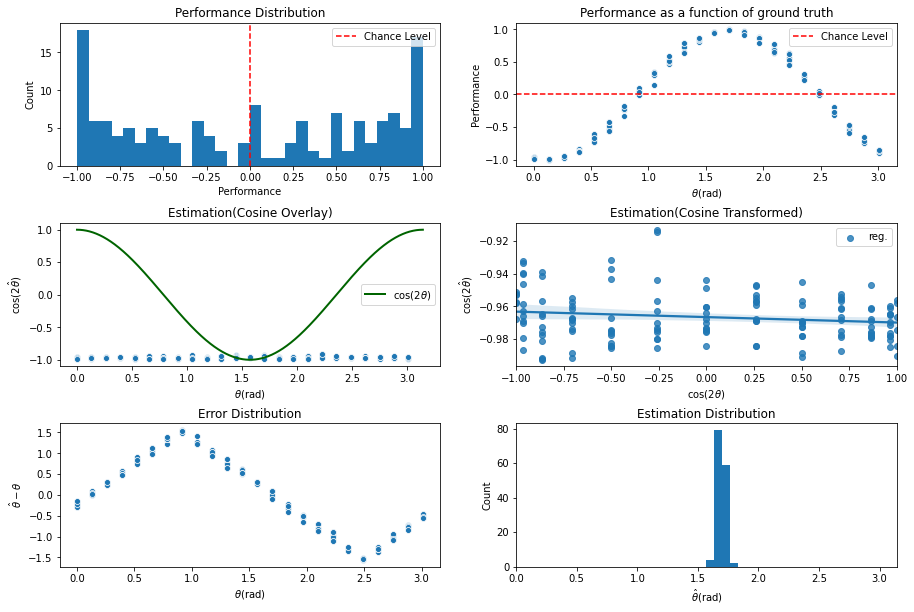

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter1100/assets

 Training performance: 
Iter. 1101 | Performance 0.0990 | Loss 0.3242 | Spike loss 2.2248
Testing performance: 
Iter. 1101 | Performance 0.0064 | Loss 0.3225 | Spike loss 2.2429

 Training performance: 
Iter. 1102 | Performance 0.0127 | Loss 0.3235 | Spike loss 2.2442
Testing performance: 
Iter. 1102 | Performance 0.0196 | Loss 0.3234 | Spike loss 2.2394

 Training performance: 
Iter. 1103 | Performance -0.0908 | Loss 0.3233 | Spike loss 2.2412
Testing performance: 
Iter. 1103 | Performance 0.0110 | Loss 0.3250 | Spike loss 2.2358

 Training performance: 
Iter. 1104 | Performance 0.0660 | Loss 0.3247 | Spike loss 2.2400
Testing performance: 
Iter. 1104 | Performance 0.0159 | Loss 0.3230 | Spike loss 2.2435

 Training performance: 
Iter. 1105 | Performance 0.0258 | Loss 0.3227 | Spike loss 2.2267
Testing performance: 
Iter. 1105 | Performance 0.0140 | Loss 0.3240 | Spike loss 2.2518

 Training pe


 Training performance: 
Iter. 1147 | Performance 0.0494 | Loss 0.3229 | Spike loss 2.2333
Testing performance: 
Iter. 1147 | Performance 0.0110 | Loss 0.3231 | Spike loss 2.2455

 Training performance: 
Iter. 1148 | Performance 0.0655 | Loss 0.3226 | Spike loss 2.2252
Testing performance: 
Iter. 1148 | Performance -0.0045 | Loss 0.3247 | Spike loss 2.2213

 Training performance: 
Iter. 1149 | Performance -0.0459 | Loss 0.3256 | Spike loss 2.2265
Testing performance: 
Iter. 1149 | Performance 0.0110 | Loss 0.3227 | Spike loss 2.2341

 Training performance: 
Iter. 1150 | Performance -0.0099 | Loss 0.3222 | Spike loss 2.2344
Testing performance: 
Iter. 1150 | Performance 0.0157 | Loss 0.3233 | Spike loss 2.2346

 Training performance: 
Iter. 1151 | Performance -0.0537 | Loss 0.3237 | Spike loss 2.2249
Testing performance: 
Iter. 1151 | Performance 0.0312 | Loss 0.3241 | Spike loss 2.2364

 Training performance: 
Iter. 1152 | Performance 0.0163 | Loss 0.3239 | Spike loss 2.2312
Testing pe


 Training performance: 
Iter. 1193 | Performance 0.0503 | Loss 0.3223 | Spike loss 2.2231
Testing performance: 
Iter. 1193 | Performance 0.0515 | Loss 0.3231 | Spike loss 2.2201

 Training performance: 
Iter. 1194 | Performance -0.1117 | Loss 0.3236 | Spike loss 2.2148
Testing performance: 
Iter. 1194 | Performance 0.0416 | Loss 0.3222 | Spike loss 2.2048

 Training performance: 
Iter. 1195 | Performance -0.0151 | Loss 0.3218 | Spike loss 2.2055
Testing performance: 
Iter. 1195 | Performance 0.0499 | Loss 0.3229 | Spike loss 2.2117

 Training performance: 
Iter. 1196 | Performance 0.0672 | Loss 0.3233 | Spike loss 2.2226
Testing performance: 
Iter. 1196 | Performance 0.0170 | Loss 0.3240 | Spike loss 2.2098

 Training performance: 
Iter. 1197 | Performance -0.0493 | Loss 0.3237 | Spike loss 2.2201
Testing performance: 
Iter. 1197 | Performance 0.0033 | Loss 0.3228 | Spike loss 2.2141

 Training performance: 
Iter. 1198 | Performance 0.0614 | Loss 0.3221 | Spike loss 2.2134
Testing per

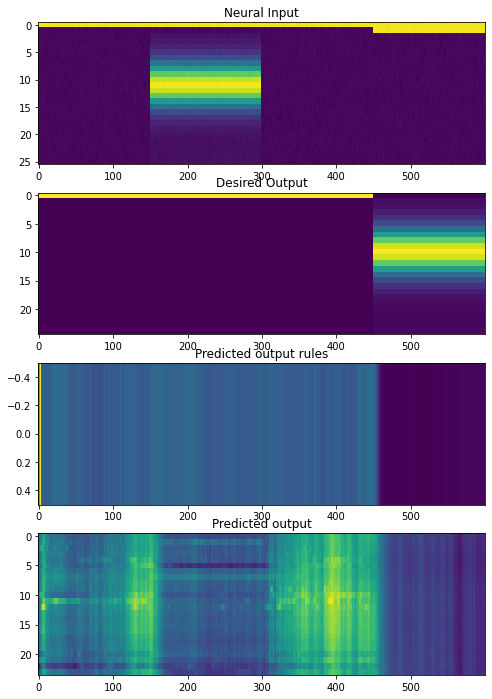

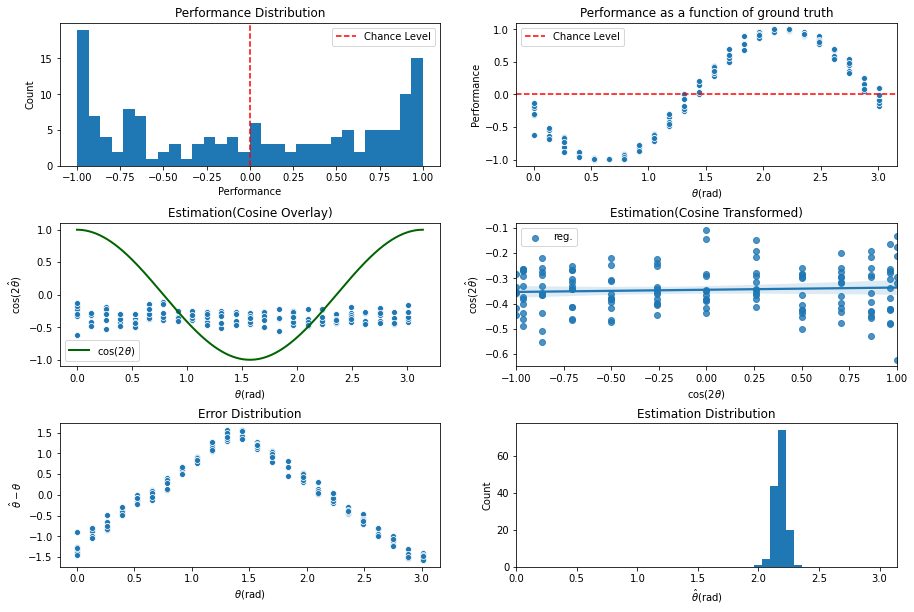

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter1200/assets

 Training performance: 
Iter. 1201 | Performance -0.0892 | Loss 0.3220 | Spike loss 2.2010
Testing performance: 
Iter. 1201 | Performance 0.0153 | Loss 0.3232 | Spike loss 2.2002

 Training performance: 
Iter. 1202 | Performance -0.0891 | Loss 0.3220 | Spike loss 2.2195
Testing performance: 
Iter. 1202 | Performance 0.0073 | Loss 0.3241 | Spike loss 2.2228

 Training performance: 
Iter. 1203 | Performance 0.0706 | Loss 0.3246 | Spike loss 2.2144
Testing performance: 
Iter. 1203 | Performance -0.0024 | Loss 0.3224 | Spike loss 2.1966

 Training performance: 
Iter. 1204 | Performance -0.0334 | Loss 0.3227 | Spike loss 2.1986
Testing performance: 
Iter. 1204 | Performance -0.0134 | Loss 0.3225 | Spike loss 2.2087

 Training performance: 
Iter. 1205 | Performance 0.0134 | Loss 0.3226 | Spike loss 2.2019
Testing performance: 
Iter. 1205 | Performance 0.0135 | Loss 0.3236 | Spike loss 2.1907

 Trainin


 Training performance: 
Iter. 1247 | Performance -0.0253 | Loss 0.3220 | Spike loss 2.1594
Testing performance: 
Iter. 1247 | Performance 0.1042 | Loss 0.3234 | Spike loss 2.1504

 Training performance: 
Iter. 1248 | Performance 0.0318 | Loss 0.3236 | Spike loss 2.1566
Testing performance: 
Iter. 1248 | Performance 0.0747 | Loss 0.3218 | Spike loss 2.1463

 Training performance: 
Iter. 1249 | Performance -0.0013 | Loss 0.3221 | Spike loss 2.1534
Testing performance: 
Iter. 1249 | Performance 0.0340 | Loss 0.3219 | Spike loss 2.1565

 Training performance: 
Iter. 1250 | Performance -0.1258 | Loss 0.3219 | Spike loss 2.1494
Testing performance: 
Iter. 1250 | Performance 0.0233 | Loss 0.3230 | Spike loss 2.1504

 Training performance: 
Iter. 1251 | Performance -0.0000 | Loss 0.3232 | Spike loss 2.1564
Testing performance: 
Iter. 1251 | Performance 0.0056 | Loss 0.3219 | Spike loss 2.1536

 Training performance: 
Iter. 1252 | Performance 0.1117 | Loss 0.3222 | Spike loss 2.1634
Testing pe


 Training performance: 
Iter. 1293 | Performance 0.1405 | Loss 0.3225 | Spike loss 2.1611
Testing performance: 
Iter. 1293 | Performance 0.0238 | Loss 0.3216 | Spike loss 2.1635

 Training performance: 
Iter. 1294 | Performance 0.0213 | Loss 0.3224 | Spike loss 2.1566
Testing performance: 
Iter. 1294 | Performance 0.0153 | Loss 0.3218 | Spike loss 2.1557

 Training performance: 
Iter. 1295 | Performance 0.1578 | Loss 0.3218 | Spike loss 2.1587
Testing performance: 
Iter. 1295 | Performance 0.0243 | Loss 0.3228 | Spike loss 2.1545

 Training performance: 
Iter. 1296 | Performance 0.0487 | Loss 0.3228 | Spike loss 2.1424
Testing performance: 
Iter. 1296 | Performance 0.0001 | Loss 0.3220 | Spike loss 2.1457

 Training performance: 
Iter. 1297 | Performance -0.0784 | Loss 0.3216 | Spike loss 2.1531
Testing performance: 
Iter. 1297 | Performance -0.0070 | Loss 0.3223 | Spike loss 2.1542

 Training performance: 
Iter. 1298 | Performance -0.0013 | Loss 0.3230 | Spike loss 2.1550
Testing per

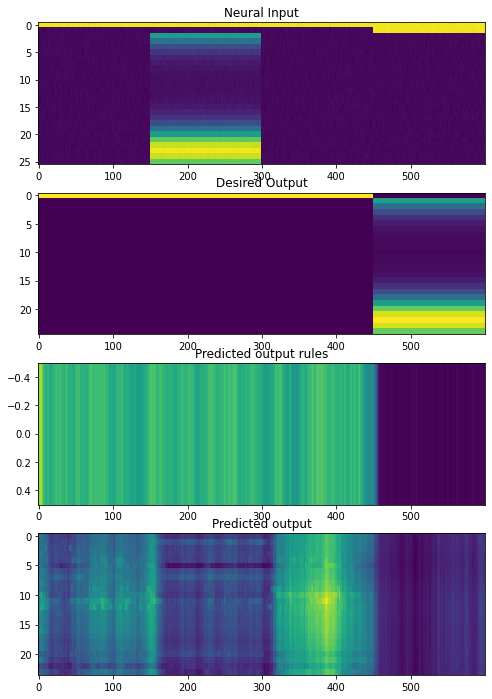

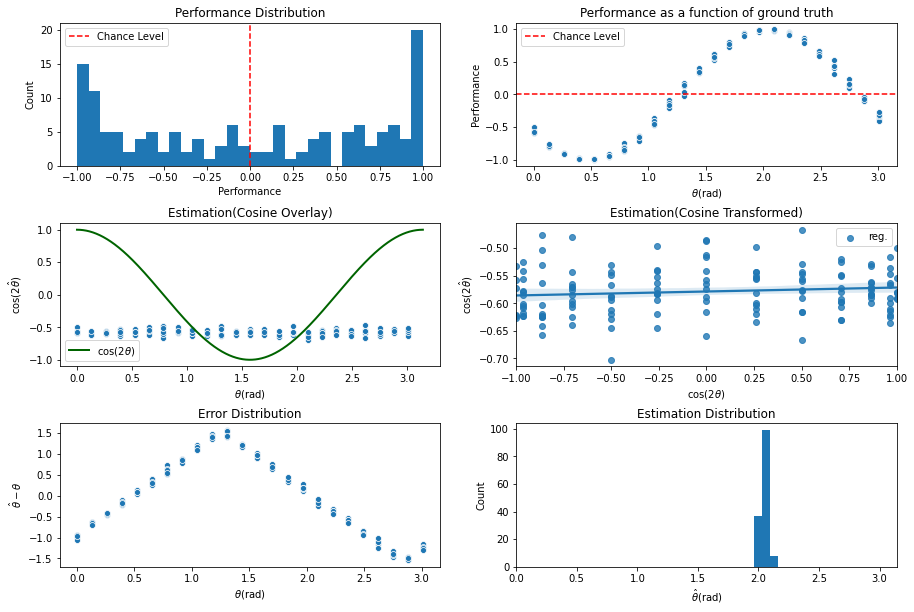

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter1300/assets

 Training performance: 
Iter. 1301 | Performance -0.0026 | Loss 0.3224 | Spike loss 2.1617
Testing performance: 
Iter. 1301 | Performance 0.0110 | Loss 0.3228 | Spike loss 2.1601

 Training performance: 
Iter. 1302 | Performance -0.0702 | Loss 0.3227 | Spike loss 2.1457
Testing performance: 
Iter. 1302 | Performance 0.0090 | Loss 0.3219 | Spike loss 2.1396

 Training performance: 
Iter. 1303 | Performance -0.0521 | Loss 0.3219 | Spike loss 2.1539
Testing performance: 
Iter. 1303 | Performance 0.0082 | Loss 0.3224 | Spike loss 2.1457

 Training performance: 
Iter. 1304 | Performance -0.1875 | Loss 0.3219 | Spike loss 2.1580
Testing performance: 
Iter. 1304 | Performance 0.0077 | Loss 0.3232 | Spike loss 2.1563

 Training performance: 
Iter. 1305 | Performance 0.0105 | Loss 0.3226 | Spike loss 2.1642
Testing performance: 
Iter. 1305 | Performance 0.0088 | Loss 0.3219 | Spike loss 2.1368

 Training


 Training performance: 
Iter. 1347 | Performance -0.0466 | Loss 0.3224 | Spike loss 2.1289
Testing performance: 
Iter. 1347 | Performance 0.0127 | Loss 0.3217 | Spike loss 2.1166

 Training performance: 
Iter. 1348 | Performance 0.0092 | Loss 0.3213 | Spike loss 2.1111
Testing performance: 
Iter. 1348 | Performance 0.0086 | Loss 0.3217 | Spike loss 2.1103

 Training performance: 
Iter. 1349 | Performance -0.0193 | Loss 0.3217 | Spike loss 2.1143
Testing performance: 
Iter. 1349 | Performance 0.0045 | Loss 0.3229 | Spike loss 2.1085

 Training performance: 
Iter. 1350 | Performance -0.0042 | Loss 0.3231 | Spike loss 2.1091
Testing performance: 
Iter. 1350 | Performance 0.0030 | Loss 0.3213 | Spike loss 2.1154

 Training performance: 
Iter. 1351 | Performance -0.0232 | Loss 0.3208 | Spike loss 2.1219
Testing performance: 
Iter. 1351 | Performance 0.0052 | Loss 0.3218 | Spike loss 2.1138

 Training performance: 
Iter. 1352 | Performance 0.0348 | Loss 0.3216 | Spike loss 2.1135
Testing pe


 Training performance: 
Iter. 1393 | Performance -0.0540 | Loss 0.3214 | Spike loss 2.0829
Testing performance: 
Iter. 1393 | Performance 0.1080 | Loss 0.3209 | Spike loss 2.0897

 Training performance: 
Iter. 1394 | Performance 0.0054 | Loss 0.3218 | Spike loss 2.0847
Testing performance: 
Iter. 1394 | Performance 0.0720 | Loss 0.3218 | Spike loss 2.0856

 Training performance: 
Iter. 1395 | Performance 0.0630 | Loss 0.3221 | Spike loss 2.0892
Testing performance: 
Iter. 1395 | Performance 0.0236 | Loss 0.3207 | Spike loss 2.0875

 Training performance: 
Iter. 1396 | Performance -0.1062 | Loss 0.3209 | Spike loss 2.0736
Testing performance: 
Iter. 1396 | Performance 0.0098 | Loss 0.3220 | Spike loss 2.0794

 Training performance: 
Iter. 1397 | Performance 0.0464 | Loss 0.3210 | Spike loss 2.0608
Testing performance: 
Iter. 1397 | Performance 0.0101 | Loss 0.3229 | Spike loss 2.0821

 Training performance: 
Iter. 1398 | Performance 0.0174 | Loss 0.3225 | Spike loss 2.0641
Testing perf

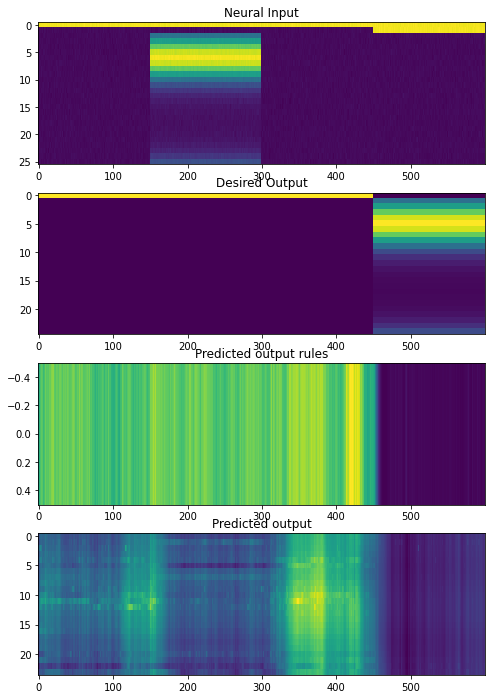

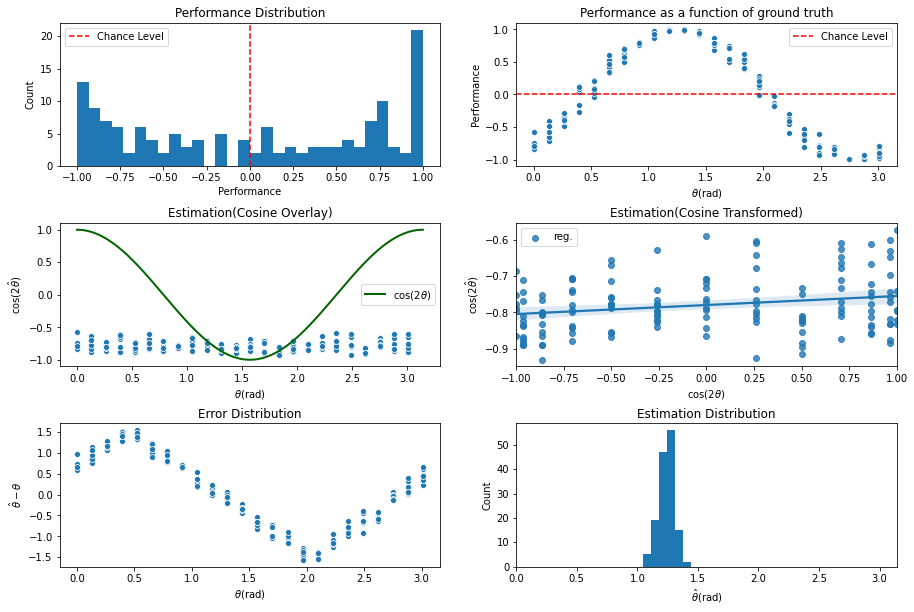

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter1400/assets

 Training performance: 
Iter. 1401 | Performance -0.0208 | Loss 0.3222 | Spike loss 2.0899
Testing performance: 
Iter. 1401 | Performance 0.0247 | Loss 0.3209 | Spike loss 2.0812

 Training performance: 
Iter. 1402 | Performance 0.0346 | Loss 0.3211 | Spike loss 2.0932
Testing performance: 
Iter. 1402 | Performance 0.0179 | Loss 0.3216 | Spike loss 2.0938

 Training performance: 
Iter. 1403 | Performance 0.0591 | Loss 0.3220 | Spike loss 2.0881
Testing performance: 
Iter. 1403 | Performance 0.0186 | Loss 0.3224 | Spike loss 2.0999

 Training performance: 
Iter. 1404 | Performance 0.0804 | Loss 0.3222 | Spike loss 2.0918
Testing performance: 
Iter. 1404 | Performance 0.0181 | Loss 0.3209 | Spike loss 2.1051

 Training performance: 
Iter. 1405 | Performance -0.0208 | Loss 0.3214 | Spike loss 2.0947
Testing performance: 
Iter. 1405 | Performance 0.0255 | Loss 0.3219 | Spike loss 2.1150

 Training p


 Training performance: 
Iter. 1447 | Performance -0.0019 | Loss 0.3209 | Spike loss 2.0687
Testing performance: 
Iter. 1447 | Performance 0.0329 | Loss 0.3214 | Spike loss 2.0862

 Training performance: 
Iter. 1448 | Performance 0.0005 | Loss 0.3211 | Spike loss 2.0715
Testing performance: 
Iter. 1448 | Performance 0.0186 | Loss 0.3223 | Spike loss 2.0880

 Training performance: 
Iter. 1449 | Performance -0.0035 | Loss 0.3219 | Spike loss 2.0764
Testing performance: 
Iter. 1449 | Performance 0.0349 | Loss 0.3211 | Spike loss 2.0799

 Training performance: 
Iter. 1450 | Performance -0.0247 | Loss 0.3203 | Spike loss 2.0794
Testing performance: 
Iter. 1450 | Performance 0.0268 | Loss 0.3211 | Spike loss 2.0802

 Training performance: 
Iter. 1451 | Performance 0.0400 | Loss 0.3211 | Spike loss 2.0729
Testing performance: 
Iter. 1451 | Performance 0.0196 | Loss 0.3223 | Spike loss 2.0690

 Training performance: 
Iter. 1452 | Performance 0.0142 | Loss 0.3220 | Spike loss 2.0756
Testing per


 Training performance: 
Iter. 1493 | Performance -0.1727 | Loss 0.3211 | Spike loss 2.0179
Testing performance: 
Iter. 1493 | Performance 0.0161 | Loss 0.3218 | Spike loss 2.0402

 Training performance: 
Iter. 1494 | Performance 0.0205 | Loss 0.3215 | Spike loss 2.0293
Testing performance: 
Iter. 1494 | Performance 0.0347 | Loss 0.3207 | Spike loss 2.0451

 Training performance: 
Iter. 1495 | Performance 0.0040 | Loss 0.3208 | Spike loss 2.0368
Testing performance: 
Iter. 1495 | Performance 0.0260 | Loss 0.3208 | Spike loss 2.0425

 Training performance: 
Iter. 1496 | Performance -0.0450 | Loss 0.3212 | Spike loss 2.0371
Testing performance: 
Iter. 1496 | Performance 0.0499 | Loss 0.3218 | Spike loss 2.0524

 Training performance: 
Iter. 1497 | Performance -0.0326 | Loss 0.3215 | Spike loss 2.0477
Testing performance: 
Iter. 1497 | Performance 0.0221 | Loss 0.3206 | Spike loss 2.0594

 Training performance: 
Iter. 1498 | Performance -0.0434 | Loss 0.3206 | Spike loss 2.0457
Testing pe

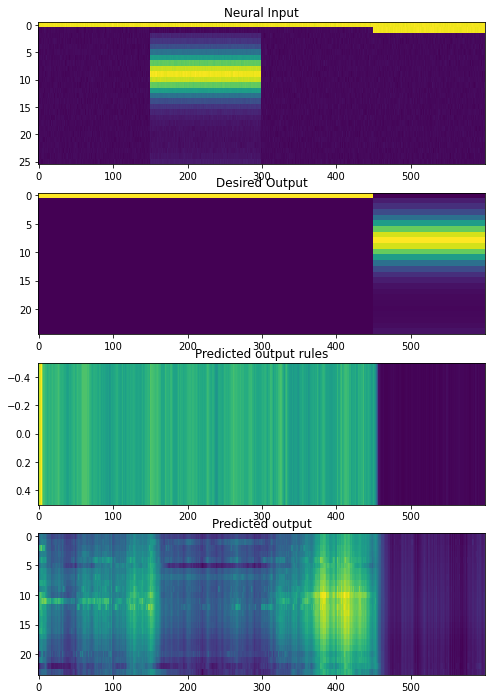

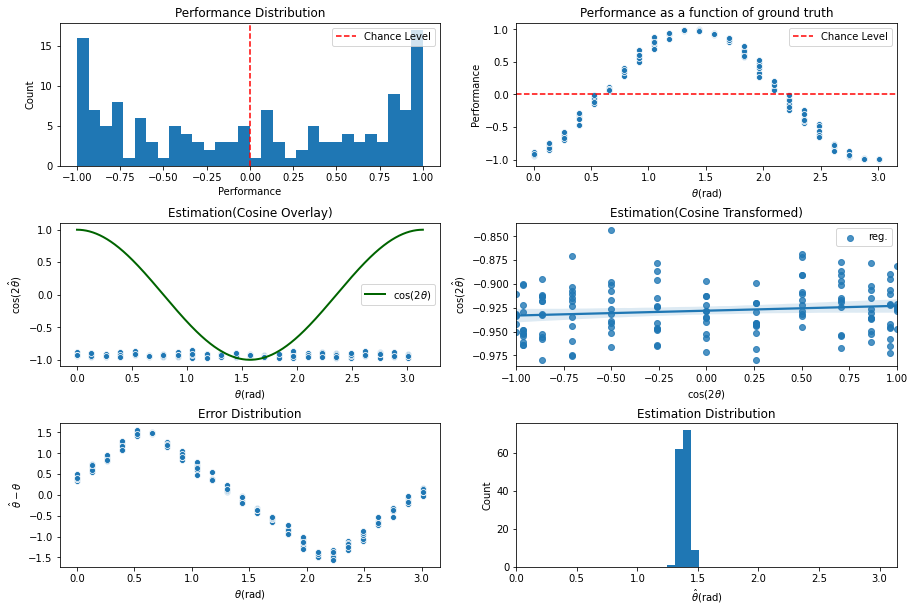

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter1500/assets

 Training performance: 
Iter. 1501 | Performance 0.1353 | Loss 0.3212 | Spike loss 2.0393
Testing performance: 
Iter. 1501 | Performance 0.0148 | Loss 0.3213 | Spike loss 2.0398

 Training performance: 
Iter. 1502 | Performance -0.0135 | Loss 0.3215 | Spike loss 2.0324
Testing performance: 
Iter. 1502 | Performance 0.0169 | Loss 0.3223 | Spike loss 2.0311

 Training performance: 
Iter. 1503 | Performance 0.0373 | Loss 0.3228 | Spike loss 2.0406
Testing performance: 
Iter. 1503 | Performance 0.0172 | Loss 0.3213 | Spike loss 2.0426

 Training performance: 
Iter. 1504 | Performance 0.0058 | Loss 0.3220 | Spike loss 2.0446
Testing performance: 
Iter. 1504 | Performance 0.0197 | Loss 0.3213 | Spike loss 2.0414

 Training performance: 
Iter. 1505 | Performance 0.0049 | Loss 0.3211 | Spike loss 2.0177
Testing performance: 
Iter. 1505 | Performance 0.0434 | Loss 0.3217 | Spike loss 2.0340

 Training pe


 Training performance: 
Iter. 1547 | Performance -0.0720 | Loss 0.3201 | Spike loss 2.0185
Testing performance: 
Iter. 1547 | Performance 0.0370 | Loss 0.3212 | Spike loss 2.0312

 Training performance: 
Iter. 1548 | Performance -0.1071 | Loss 0.3223 | Spike loss 2.0199
Testing performance: 
Iter. 1548 | Performance 0.0198 | Loss 0.3203 | Spike loss 2.0211

 Training performance: 
Iter. 1549 | Performance -0.0537 | Loss 0.3205 | Spike loss 2.0332
Testing performance: 
Iter. 1549 | Performance 0.0271 | Loss 0.3207 | Spike loss 2.0389

 Training performance: 
Iter. 1550 | Performance 0.1242 | Loss 0.3212 | Spike loss 2.0350
Testing performance: 
Iter. 1550 | Performance 0.0104 | Loss 0.3217 | Spike loss 2.0314

 Training performance: 
Iter. 1551 | Performance 0.0321 | Loss 0.3216 | Spike loss 2.0489
Testing performance: 
Iter. 1551 | Performance 0.0231 | Loss 0.3206 | Spike loss 2.0352

 Training performance: 
Iter. 1552 | Performance -0.0594 | Loss 0.3207 | Spike loss 2.0344
Testing pe


 Training performance: 
Iter. 1593 | Performance -0.0248 | Loss 0.3213 | Spike loss 2.0098
Testing performance: 
Iter. 1593 | Performance 0.0176 | Loss 0.3203 | Spike loss 2.0298

 Training performance: 
Iter. 1594 | Performance 0.0467 | Loss 0.3195 | Spike loss 2.0096
Testing performance: 
Iter. 1594 | Performance 0.0196 | Loss 0.3212 | Spike loss 2.0200

 Training performance: 
Iter. 1595 | Performance -0.0997 | Loss 0.3214 | Spike loss 2.0305
Testing performance: 
Iter. 1595 | Performance 0.0175 | Loss 0.3216 | Spike loss 2.0120

 Training performance: 
Iter. 1596 | Performance -0.0369 | Loss 0.3213 | Spike loss 2.0095
Testing performance: 
Iter. 1596 | Performance 0.0267 | Loss 0.3208 | Spike loss 2.0151

 Training performance: 
Iter. 1597 | Performance 0.0337 | Loss 0.3209 | Spike loss 2.0170
Testing performance: 
Iter. 1597 | Performance 0.0196 | Loss 0.3205 | Spike loss 2.0136

 Training performance: 
Iter. 1598 | Performance -0.0157 | Loss 0.3200 | Spike loss 2.0215
Testing pe

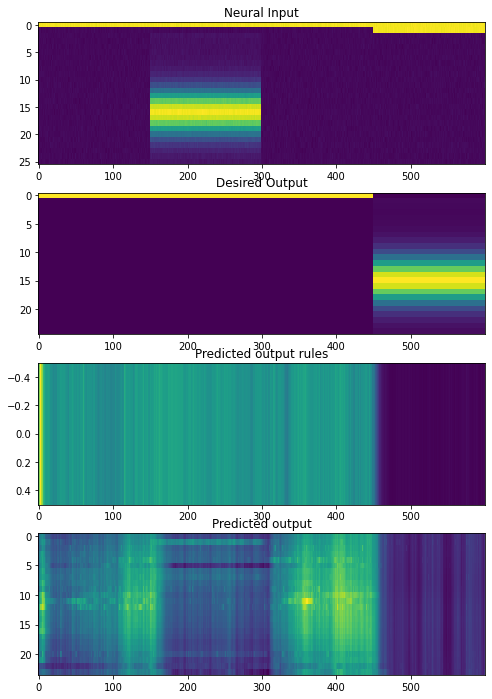

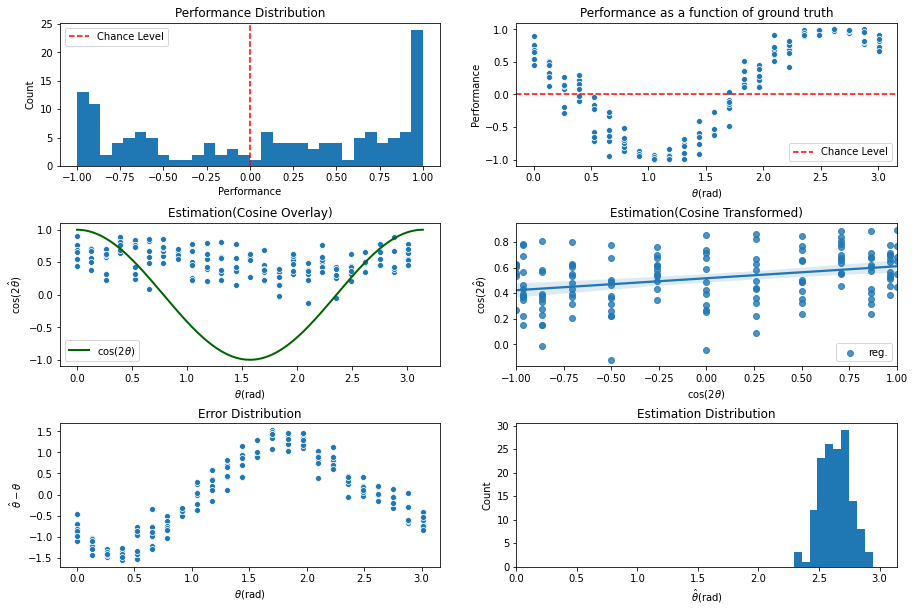

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter1600/assets

 Training performance: 
Iter. 1601 | Performance 0.0227 | Loss 0.3204 | Spike loss 2.0163
Testing performance: 
Iter. 1601 | Performance 0.0580 | Loss 0.3215 | Spike loss 2.0143

 Training performance: 
Iter. 1602 | Performance -0.0328 | Loss 0.3215 | Spike loss 2.0156
Testing performance: 
Iter. 1602 | Performance 0.0211 | Loss 0.3201 | Spike loss 2.0092

 Training performance: 
Iter. 1603 | Performance 0.0202 | Loss 0.3204 | Spike loss 2.0210
Testing performance: 
Iter. 1603 | Performance 0.0196 | Loss 0.3204 | Spike loss 2.0088

 Training performance: 
Iter. 1604 | Performance 0.0111 | Loss 0.3202 | Spike loss 1.9968
Testing performance: 
Iter. 1604 | Performance 0.0231 | Loss 0.3211 | Spike loss 2.0083

 Training performance: 
Iter. 1605 | Performance 0.0609 | Loss 0.3204 | Spike loss 2.0107
Testing performance: 
Iter. 1605 | Performance -0.0039 | Loss 0.3206 | Spike loss 2.0094

 Training p


 Training performance: 
Iter. 1647 | Performance 0.0460 | Loss 0.3217 | Spike loss 1.9924
Testing performance: 
Iter. 1647 | Performance 0.0355 | Loss 0.3199 | Spike loss 2.0005

 Training performance: 
Iter. 1648 | Performance -0.0467 | Loss 0.3193 | Spike loss 1.9992
Testing performance: 
Iter. 1648 | Performance 0.0373 | Loss 0.3204 | Spike loss 1.9864

 Training performance: 
Iter. 1649 | Performance 0.0168 | Loss 0.3207 | Spike loss 1.9989
Testing performance: 
Iter. 1649 | Performance 0.0535 | Loss 0.3215 | Spike loss 1.9902

 Training performance: 
Iter. 1650 | Performance 0.0415 | Loss 0.3221 | Spike loss 1.9796
Testing performance: 
Iter. 1650 | Performance 0.0434 | Loss 0.3199 | Spike loss 1.9997

 Training performance: 
Iter. 1651 | Performance 0.0200 | Loss 0.3208 | Spike loss 2.0030
Testing performance: 
Iter. 1651 | Performance 0.0465 | Loss 0.3202 | Spike loss 1.9922

 Training performance: 
Iter. 1652 | Performance 0.0407 | Loss 0.3208 | Spike loss 1.9866
Testing perfo


 Training performance: 
Iter. 1693 | Performance -0.0217 | Loss 0.3197 | Spike loss 1.9657
Testing performance: 
Iter. 1693 | Performance 0.0402 | Loss 0.3205 | Spike loss 1.9605

 Training performance: 
Iter. 1694 | Performance 0.0548 | Loss 0.3203 | Spike loss 1.9662
Testing performance: 
Iter. 1694 | Performance 0.0193 | Loss 0.3220 | Spike loss 1.9551

 Training performance: 
Iter. 1695 | Performance 0.0709 | Loss 0.3213 | Spike loss 1.9608
Testing performance: 
Iter. 1695 | Performance 0.0172 | Loss 0.3207 | Spike loss 1.9645

 Training performance: 
Iter. 1696 | Performance 0.0061 | Loss 0.3202 | Spike loss 1.9587
Testing performance: 
Iter. 1696 | Performance 0.0304 | Loss 0.3204 | Spike loss 1.9699

 Training performance: 
Iter. 1697 | Performance -0.0403 | Loss 0.3201 | Spike loss 1.9564
Testing performance: 
Iter. 1697 | Performance 0.0256 | Loss 0.3209 | Spike loss 1.9582

 Training performance: 
Iter. 1698 | Performance -0.0435 | Loss 0.3201 | Spike loss 1.9503
Testing per

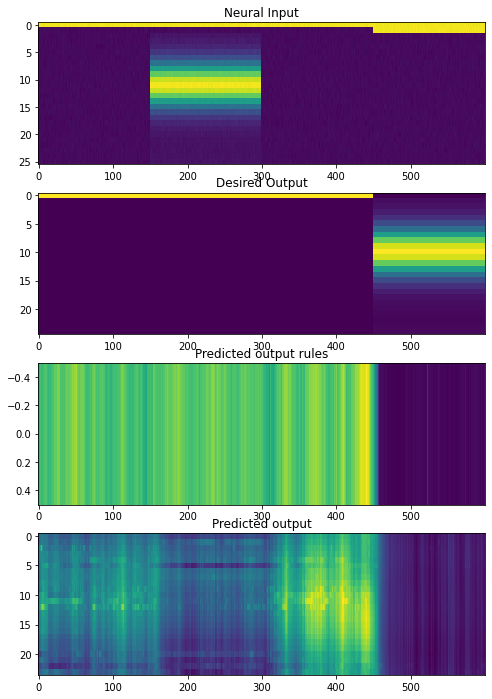

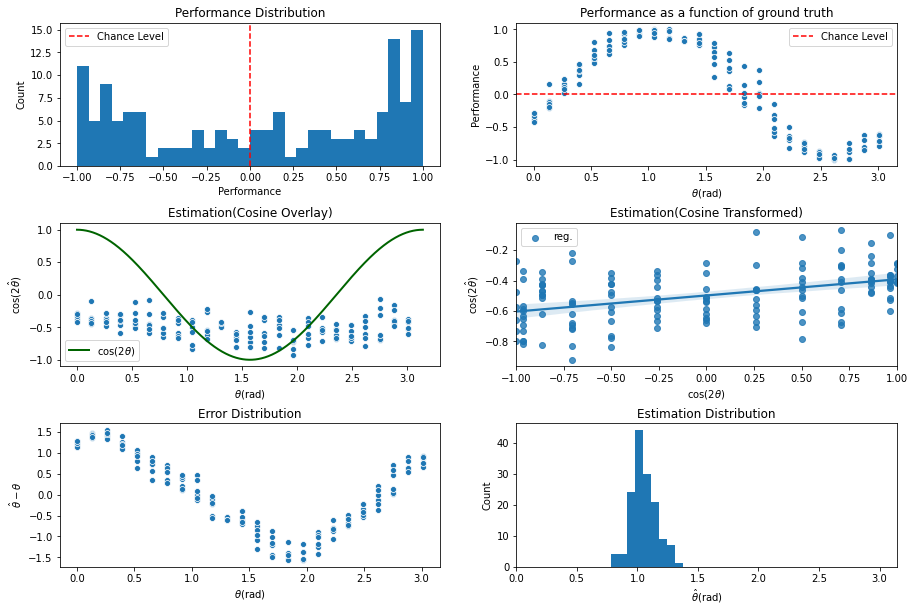

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter1700/assets

 Training performance: 
Iter. 1701 | Performance -0.1026 | Loss 0.3211 | Spike loss 1.9720
Testing performance: 
Iter. 1701 | Performance 0.0475 | Loss 0.3201 | Spike loss 1.9660

 Training performance: 
Iter. 1702 | Performance 0.0441 | Loss 0.3201 | Spike loss 1.9725
Testing performance: 
Iter. 1702 | Performance 0.0517 | Loss 0.3203 | Spike loss 1.9673

 Training performance: 
Iter. 1703 | Performance -0.0421 | Loss 0.3201 | Spike loss 1.9670
Testing performance: 
Iter. 1703 | Performance 0.0509 | Loss 0.3211 | Spike loss 1.9847

 Training performance: 
Iter. 1704 | Performance 0.0401 | Loss 0.3216 | Spike loss 1.9601
Testing performance: 
Iter. 1704 | Performance 0.0255 | Loss 0.3199 | Spike loss 1.9807

 Training performance: 
Iter. 1705 | Performance 0.0383 | Loss 0.3200 | Spike loss 1.9840
Testing performance: 
Iter. 1705 | Performance 0.0159 | Loss 0.3204 | Spike loss 1.9724

 Training p


 Training performance: 
Iter. 1747 | Performance -0.1056 | Loss 0.3193 | Spike loss 1.9466
Testing performance: 
Iter. 1747 | Performance 0.0655 | Loss 0.3198 | Spike loss 1.9637

 Training performance: 
Iter. 1748 | Performance -0.0462 | Loss 0.3199 | Spike loss 1.9598
Testing performance: 
Iter. 1748 | Performance 0.0359 | Loss 0.3212 | Spike loss 1.9691

 Training performance: 
Iter. 1749 | Performance -0.0094 | Loss 0.3206 | Spike loss 1.9714
Testing performance: 
Iter. 1749 | Performance 0.0313 | Loss 0.3196 | Spike loss 1.9477

 Training performance: 
Iter. 1750 | Performance -0.0112 | Loss 0.3207 | Spike loss 1.9635
Testing performance: 
Iter. 1750 | Performance 0.0414 | Loss 0.3199 | Spike loss 1.9530

 Training performance: 
Iter. 1751 | Performance -0.0333 | Loss 0.3207 | Spike loss 1.9375
Testing performance: 
Iter. 1751 | Performance 0.0203 | Loss 0.3211 | Spike loss 1.9612

 Training performance: 
Iter. 1752 | Performance 0.0358 | Loss 0.3213 | Spike loss 1.9483
Testing p


 Training performance: 
Iter. 1793 | Performance 0.0678 | Loss 0.3192 | Spike loss 1.9135
Testing performance: 
Iter. 1793 | Performance 0.1252 | Loss 0.3203 | Spike loss 1.9353

 Training performance: 
Iter. 1794 | Performance -0.0223 | Loss 0.3201 | Spike loss 1.9218
Testing performance: 
Iter. 1794 | Performance 0.1471 | Loss 0.3196 | Spike loss 1.9322

 Training performance: 
Iter. 1795 | Performance 0.0338 | Loss 0.3192 | Spike loss 1.9329
Testing performance: 
Iter. 1795 | Performance 0.1551 | Loss 0.3198 | Spike loss 1.9221

 Training performance: 
Iter. 1796 | Performance 0.0567 | Loss 0.3195 | Spike loss 1.9391
Testing performance: 
Iter. 1796 | Performance 0.0765 | Loss 0.3210 | Spike loss 1.9254

 Training performance: 
Iter. 1797 | Performance 0.0028 | Loss 0.3206 | Spike loss 1.9335
Testing performance: 
Iter. 1797 | Performance 0.1026 | Loss 0.3193 | Spike loss 1.9345

 Training performance: 
Iter. 1798 | Performance 0.0217 | Loss 0.3195 | Spike loss 1.9266
Testing perfo

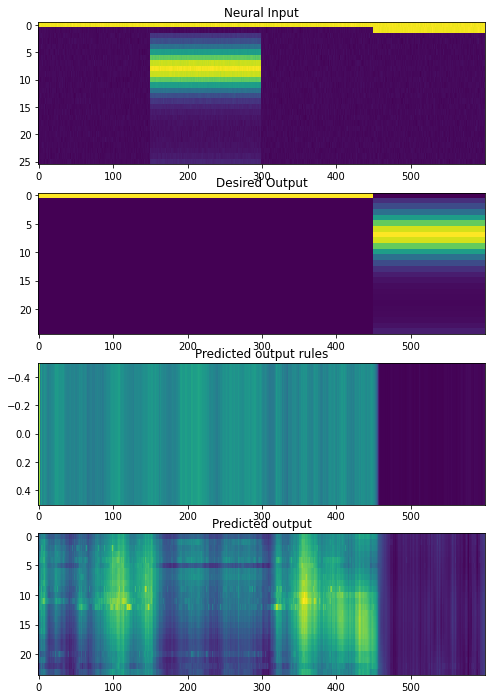

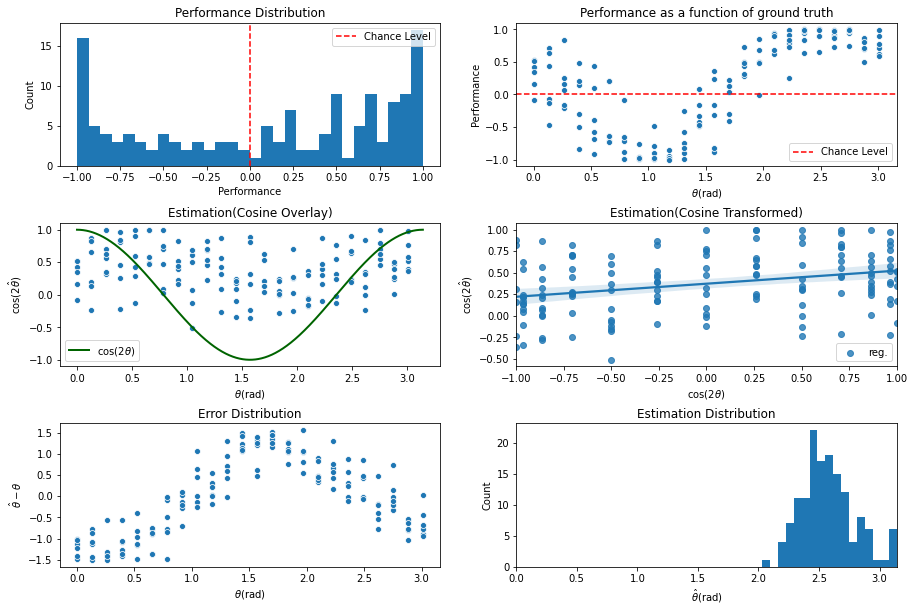

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter1800/assets

 Training performance: 
Iter. 1801 | Performance -0.0253 | Loss 0.3191 | Spike loss 1.9194
Testing performance: 
Iter. 1801 | Performance 0.1512 | Loss 0.3197 | Spike loss 1.9253

 Training performance: 
Iter. 1802 | Performance -0.1004 | Loss 0.3193 | Spike loss 1.9246
Testing performance: 
Iter. 1802 | Performance 0.1294 | Loss 0.3205 | Spike loss 1.9425

 Training performance: 
Iter. 1803 | Performance -0.0085 | Loss 0.3205 | Spike loss 1.9374
Testing performance: 
Iter. 1803 | Performance 0.0709 | Loss 0.3194 | Spike loss 1.9371

 Training performance: 
Iter. 1804 | Performance -0.1468 | Loss 0.3194 | Spike loss 1.9413
Testing performance: 
Iter. 1804 | Performance 0.1319 | Loss 0.3194 | Spike loss 1.9357

 Training performance: 
Iter. 1805 | Performance -0.1429 | Loss 0.3191 | Spike loss 1.9326
Testing performance: 
Iter. 1805 | Performance 0.0884 | Loss 0.3203 | Spike loss 1.9339

 Trainin


 Training performance: 
Iter. 1847 | Performance 0.0605 | Loss 0.3197 | Spike loss 1.9200
Testing performance: 
Iter. 1847 | Performance 0.2050 | Loss 0.3201 | Spike loss 1.9051

 Training performance: 
Iter. 1848 | Performance 0.0719 | Loss 0.3199 | Spike loss 1.9029
Testing performance: 
Iter. 1848 | Performance 0.2366 | Loss 0.3188 | Spike loss 1.9279

 Training performance: 
Iter. 1849 | Performance 0.0445 | Loss 0.3190 | Spike loss 1.9332
Testing performance: 
Iter. 1849 | Performance 0.2507 | Loss 0.3192 | Spike loss 1.9300

 Training performance: 
Iter. 1850 | Performance 0.0314 | Loss 0.3189 | Spike loss 1.9184
Testing performance: 
Iter. 1850 | Performance 0.0736 | Loss 0.3207 | Spike loss 1.9261

 Training performance: 
Iter. 1851 | Performance -0.0435 | Loss 0.3199 | Spike loss 1.9243
Testing performance: 
Iter. 1851 | Performance 0.1301 | Loss 0.3190 | Spike loss 1.9263

 Training performance: 
Iter. 1852 | Performance 0.0429 | Loss 0.3186 | Spike loss 1.9377
Testing perfo


 Training performance: 
Iter. 1893 | Performance 0.0338 | Loss 0.3207 | Spike loss 1.9074
Testing performance: 
Iter. 1893 | Performance 0.0878 | Loss 0.3189 | Spike loss 1.9036

 Training performance: 
Iter. 1894 | Performance -0.0689 | Loss 0.3189 | Spike loss 1.9199
Testing performance: 
Iter. 1894 | Performance 0.1041 | Loss 0.3191 | Spike loss 1.9180

 Training performance: 
Iter. 1895 | Performance 0.0059 | Loss 0.3188 | Spike loss 1.9176
Testing performance: 
Iter. 1895 | Performance 0.0849 | Loss 0.3198 | Spike loss 1.9155

 Training performance: 
Iter. 1896 | Performance 0.0053 | Loss 0.3208 | Spike loss 1.9110
Testing performance: 
Iter. 1896 | Performance 0.1169 | Loss 0.3187 | Spike loss 1.9098

 Training performance: 
Iter. 1897 | Performance 0.0418 | Loss 0.3192 | Spike loss 1.9235
Testing performance: 
Iter. 1897 | Performance 0.1097 | Loss 0.3195 | Spike loss 1.9124

 Training performance: 
Iter. 1898 | Performance 0.0622 | Loss 0.3189 | Spike loss 1.9177
Testing perfo

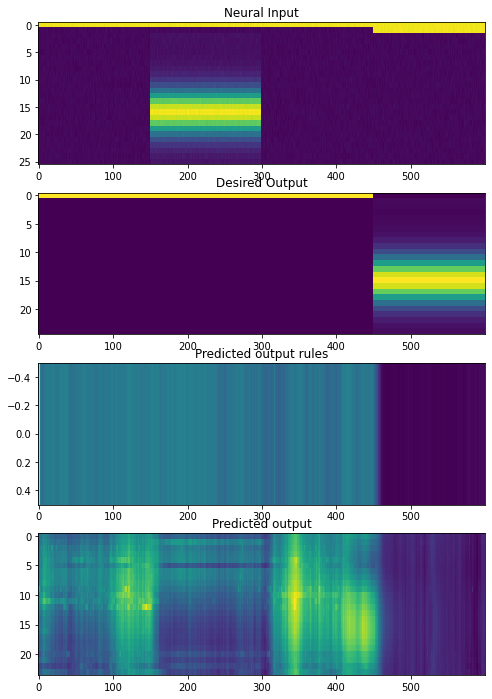

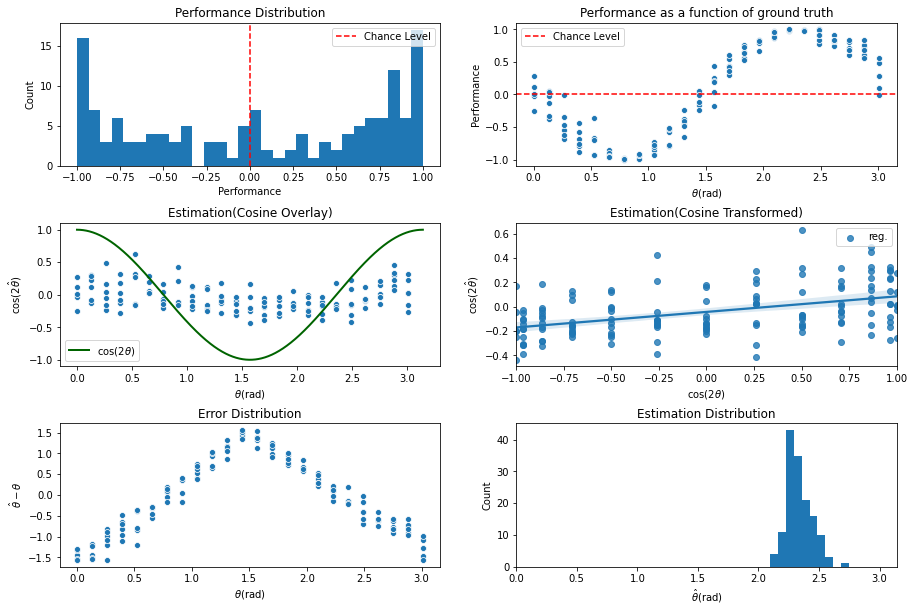

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter1900/assets

 Training performance: 
Iter. 1901 | Performance 0.0370 | Loss 0.3189 | Spike loss 1.9260
Testing performance: 
Iter. 1901 | Performance 0.0379 | Loss 0.3206 | Spike loss 1.9025

 Training performance: 
Iter. 1902 | Performance -0.0482 | Loss 0.3207 | Spike loss 1.9105
Testing performance: 
Iter. 1902 | Performance 0.0364 | Loss 0.3194 | Spike loss 1.9189

 Training performance: 
Iter. 1903 | Performance -0.0503 | Loss 0.3196 | Spike loss 1.9235
Testing performance: 
Iter. 1903 | Performance 0.0243 | Loss 0.3196 | Spike loss 1.9091

 Training performance: 
Iter. 1904 | Performance 0.0205 | Loss 0.3191 | Spike loss 1.9165
Testing performance: 
Iter. 1904 | Performance 0.0293 | Loss 0.3204 | Spike loss 1.9015

 Training performance: 
Iter. 1905 | Performance 0.0117 | Loss 0.3200 | Spike loss 1.9043
Testing performance: 
Iter. 1905 | Performance 0.0297 | Loss 0.3192 | Spike loss 1.9059

 Training p


 Training performance: 
Iter. 1947 | Performance -0.0546 | Loss 0.3198 | Spike loss 1.9293
Testing performance: 
Iter. 1947 | Performance 0.0813 | Loss 0.3188 | Spike loss 1.9291

 Training performance: 
Iter. 1948 | Performance -0.0756 | Loss 0.3181 | Spike loss 1.9108
Testing performance: 
Iter. 1948 | Performance 0.1202 | Loss 0.3189 | Spike loss 1.9101

 Training performance: 
Iter. 1949 | Performance 0.0629 | Loss 0.3187 | Spike loss 1.9292
Testing performance: 
Iter. 1949 | Performance 0.1687 | Loss 0.3196 | Spike loss 1.9121

 Training performance: 
Iter. 1950 | Performance -0.0151 | Loss 0.3193 | Spike loss 1.9291
Testing performance: 
Iter. 1950 | Performance 0.1036 | Loss 0.3189 | Spike loss 1.9153

 Training performance: 
Iter. 1951 | Performance -0.0194 | Loss 0.3189 | Spike loss 1.9128
Testing performance: 
Iter. 1951 | Performance 0.1939 | Loss 0.3188 | Spike loss 1.9170

 Training performance: 
Iter. 1952 | Performance -0.0512 | Loss 0.3189 | Spike loss 1.9263
Testing p


 Training performance: 
Iter. 1993 | Performance -0.0360 | Loss 0.3187 | Spike loss 1.9085
Testing performance: 
Iter. 1993 | Performance 0.3074 | Loss 0.3183 | Spike loss 1.9282

 Training performance: 
Iter. 1994 | Performance -0.0279 | Loss 0.3179 | Spike loss 1.9212
Testing performance: 
Iter. 1994 | Performance 0.3051 | Loss 0.3189 | Spike loss 1.9162

 Training performance: 
Iter. 1995 | Performance 0.0195 | Loss 0.3189 | Spike loss 1.9274
Testing performance: 
Iter. 1995 | Performance 0.2407 | Loss 0.3184 | Spike loss 1.9210

 Training performance: 
Iter. 1996 | Performance -0.0344 | Loss 0.3180 | Spike loss 1.9116
Testing performance: 
Iter. 1996 | Performance 0.2740 | Loss 0.3192 | Spike loss 1.9003

 Training performance: 
Iter. 1997 | Performance -0.0856 | Loss 0.3184 | Spike loss 1.9164
Testing performance: 
Iter. 1997 | Performance 0.2467 | Loss 0.3194 | Spike loss 1.9137

 Training performance: 
Iter. 1998 | Performance 0.0494 | Loss 0.3192 | Spike loss 1.9016
Testing pe

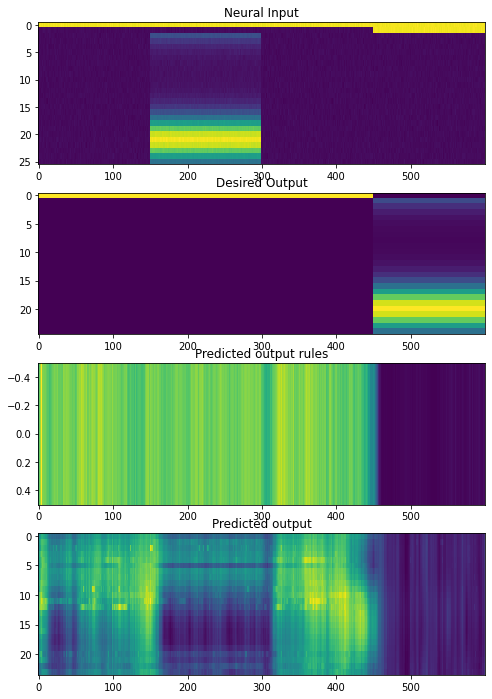

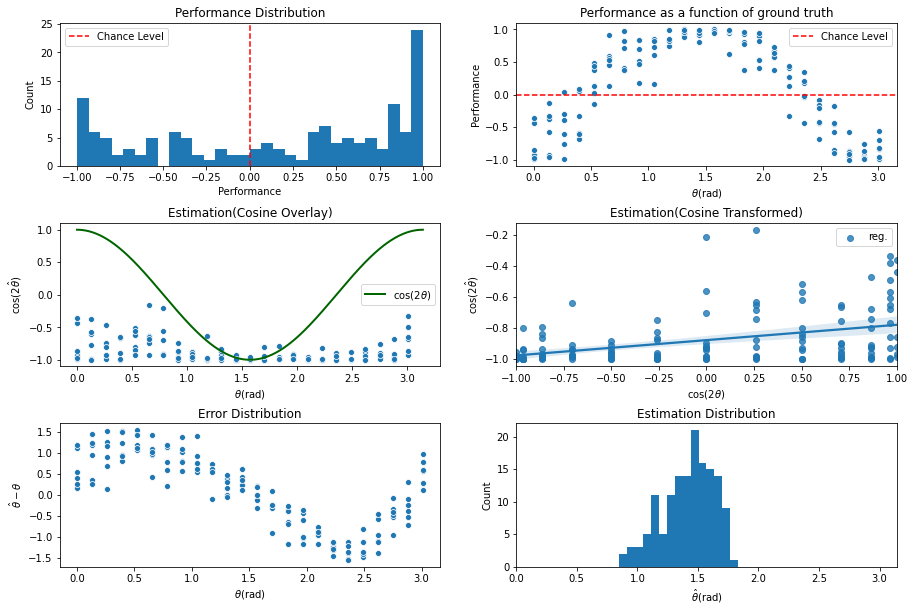

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter2000/assets

 Training performance: 
Iter. 2001 | Performance 0.0734 | Loss 0.3195 | Spike loss 1.9200
Testing performance: 
Iter. 2001 | Performance 0.1275 | Loss 0.3179 | Spike loss 1.9158

 Training performance: 
Iter. 2002 | Performance 0.0203 | Loss 0.3174 | Spike loss 1.9227
Testing performance: 
Iter. 2002 | Performance 0.1033 | Loss 0.3187 | Spike loss 1.9187

 Training performance: 
Iter. 2003 | Performance 0.0337 | Loss 0.3182 | Spike loss 1.9190
Testing performance: 
Iter. 2003 | Performance 0.0994 | Loss 0.3199 | Spike loss 1.9349

 Training performance: 
Iter. 2004 | Performance 0.0580 | Loss 0.3197 | Spike loss 1.9258
Testing performance: 
Iter. 2004 | Performance 0.1049 | Loss 0.3188 | Spike loss 1.9395

 Training performance: 
Iter. 2005 | Performance -0.0753 | Loss 0.3174 | Spike loss 1.9249
Testing performance: 
Iter. 2005 | Performance 0.1403 | Loss 0.3190 | Spike loss 1.9396

 Training pe


 Training performance: 
Iter. 2047 | Performance 0.0463 | Loss 0.3179 | Spike loss 1.9387
Testing performance: 
Iter. 2047 | Performance 0.2471 | Loss 0.3179 | Spike loss 1.9680

 Training performance: 
Iter. 2048 | Performance -0.0413 | Loss 0.3176 | Spike loss 1.9622
Testing performance: 
Iter. 2048 | Performance 0.1550 | Loss 0.3195 | Spike loss 1.9720

 Training performance: 
Iter. 2049 | Performance 0.0081 | Loss 0.3193 | Spike loss 1.9692
Testing performance: 
Iter. 2049 | Performance 0.1745 | Loss 0.3181 | Spike loss 1.9664

 Training performance: 
Iter. 2050 | Performance 0.0150 | Loss 0.3179 | Spike loss 1.9725
Testing performance: 
Iter. 2050 | Performance 0.2151 | Loss 0.3179 | Spike loss 1.9813

 Training performance: 
Iter. 2051 | Performance -0.0398 | Loss 0.3168 | Spike loss 1.9887
Testing performance: 
Iter. 2051 | Performance 0.1527 | Loss 0.3195 | Spike loss 1.9888

 Training performance: 
Iter. 2052 | Performance 0.0226 | Loss 0.3179 | Spike loss 1.9922
Testing perf


 Training performance: 
Iter. 2093 | Performance -0.1125 | Loss 0.3143 | Spike loss 2.1238
Testing performance: 
Iter. 2093 | Performance 0.3932 | Loss 0.3167 | Spike loss 2.1068

 Training performance: 
Iter. 2094 | Performance -0.0005 | Loss 0.3160 | Spike loss 2.1102
Testing performance: 
Iter. 2094 | Performance 0.4734 | Loss 0.3131 | Spike loss 2.0921

 Training performance: 
Iter. 2095 | Performance -0.0189 | Loss 0.3144 | Spike loss 2.0898
Testing performance: 
Iter. 2095 | Performance 0.4180 | Loss 0.3143 | Spike loss 2.0863

 Training performance: 
Iter. 2096 | Performance -0.0875 | Loss 0.3133 | Spike loss 2.1216
Testing performance: 
Iter. 2096 | Performance 0.4373 | Loss 0.3149 | Spike loss 2.0829

 Training performance: 
Iter. 2097 | Performance 0.0085 | Loss 0.3153 | Spike loss 2.0900
Testing performance: 
Iter. 2097 | Performance 0.4091 | Loss 0.3134 | Spike loss 2.0972

 Training performance: 
Iter. 2098 | Performance 0.1380 | Loss 0.3133 | Spike loss 2.0879
Testing pe

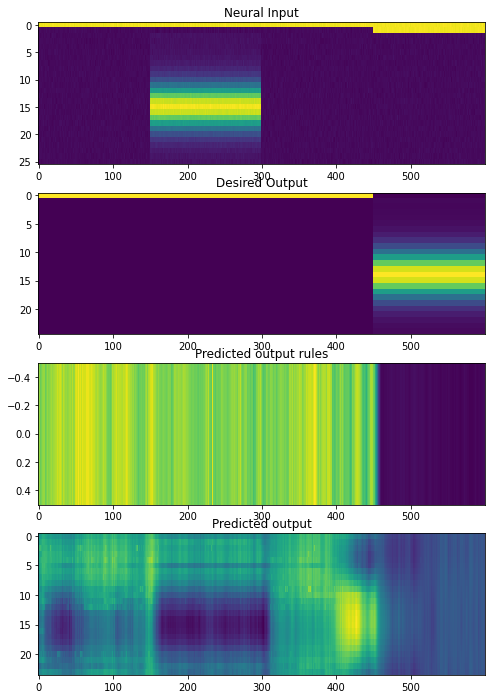

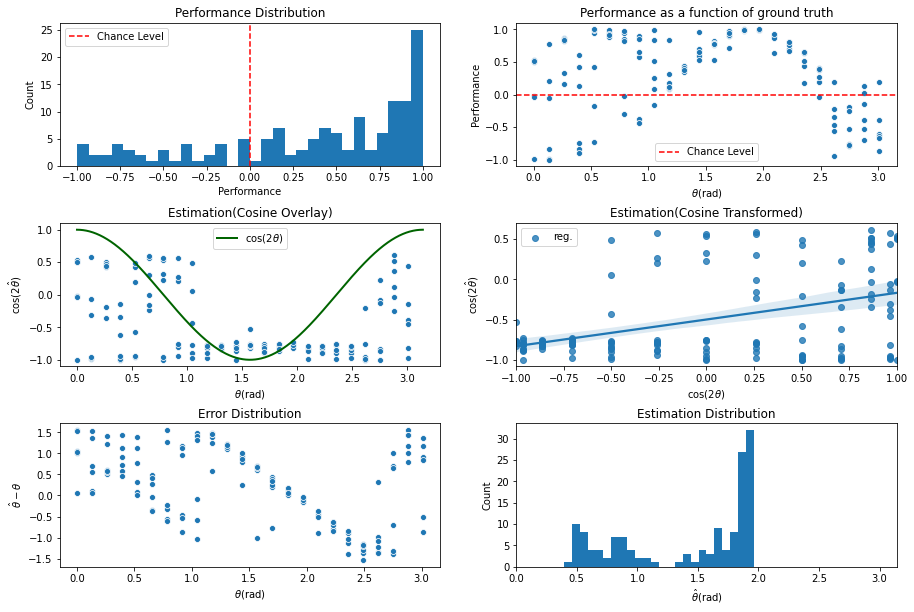

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter2100/assets

 Training performance: 
Iter. 2101 | Performance -0.0693 | Loss 0.3123 | Spike loss 2.1377
Testing performance: 
Iter. 2101 | Performance 0.5330 | Loss 0.3108 | Spike loss 2.1815

 Training performance: 
Iter. 2102 | Performance -0.0082 | Loss 0.3126 | Spike loss 2.1535
Testing performance: 
Iter. 2102 | Performance 0.4702 | Loss 0.3124 | Spike loss 2.1658

 Training performance: 
Iter. 2103 | Performance -0.0923 | Loss 0.3123 | Spike loss 2.2068
Testing performance: 
Iter. 2103 | Performance 0.5347 | Loss 0.3114 | Spike loss 2.1561

 Training performance: 
Iter. 2104 | Performance -0.1324 | Loss 0.3108 | Spike loss 2.2084
Testing performance: 
Iter. 2104 | Performance 0.5427 | Loss 0.3101 | Spike loss 2.1672

 Training performance: 
Iter. 2105 | Performance 0.0518 | Loss 0.3111 | Spike loss 2.1972
Testing performance: 
Iter. 2105 | Performance 0.5216 | Loss 0.3117 | Spike loss 2.2075

 Training


 Training performance: 
Iter. 2147 | Performance 0.0159 | Loss 0.2989 | Spike loss 2.5291
Testing performance: 
Iter. 2147 | Performance 0.5925 | Loss 0.3042 | Spike loss 2.5040

 Training performance: 
Iter. 2148 | Performance -0.0267 | Loss 0.3041 | Spike loss 2.5684
Testing performance: 
Iter. 2148 | Performance 0.5909 | Loss 0.3007 | Spike loss 2.5096

 Training performance: 
Iter. 2149 | Performance -0.0705 | Loss 0.3019 | Spike loss 2.5445
Testing performance: 
Iter. 2149 | Performance 0.6108 | Loss 0.3011 | Spike loss 2.5207

 Training performance: 
Iter. 2150 | Performance 0.0021 | Loss 0.3034 | Spike loss 2.5121
Testing performance: 
Iter. 2150 | Performance 0.5703 | Loss 0.3020 | Spike loss 2.5341

 Training performance: 
Iter. 2151 | Performance -0.0673 | Loss 0.3026 | Spike loss 2.5662
Testing performance: 
Iter. 2151 | Performance 0.6319 | Loss 0.3000 | Spike loss 2.5401

 Training performance: 
Iter. 2152 | Performance 0.0245 | Loss 0.2970 | Spike loss 2.5526
Testing per


 Training performance: 
Iter. 2193 | Performance 0.0480 | Loss 0.3013 | Spike loss 2.5994
Testing performance: 
Iter. 2193 | Performance 0.6128 | Loss 0.3001 | Spike loss 2.6380

 Training performance: 
Iter. 2194 | Performance -0.0343 | Loss 0.2954 | Spike loss 2.5542
Testing performance: 
Iter. 2194 | Performance 0.6213 | Loss 0.2992 | Spike loss 2.6324

 Training performance: 
Iter. 2195 | Performance 0.0273 | Loss 0.2994 | Spike loss 2.6504
Testing performance: 
Iter. 2195 | Performance 0.5901 | Loss 0.3017 | Spike loss 2.6307

 Training performance: 
Iter. 2196 | Performance 0.0757 | Loss 0.3011 | Spike loss 2.7514
Testing performance: 
Iter. 2196 | Performance 0.6370 | Loss 0.2988 | Spike loss 2.5779

 Training performance: 
Iter. 2197 | Performance -0.0035 | Loss 0.2963 | Spike loss 2.5120
Testing performance: 
Iter. 2197 | Performance 0.5872 | Loss 0.3000 | Spike loss 2.5747

 Training performance: 
Iter. 2198 | Performance 0.0682 | Loss 0.3004 | Spike loss 2.5975
Testing perf

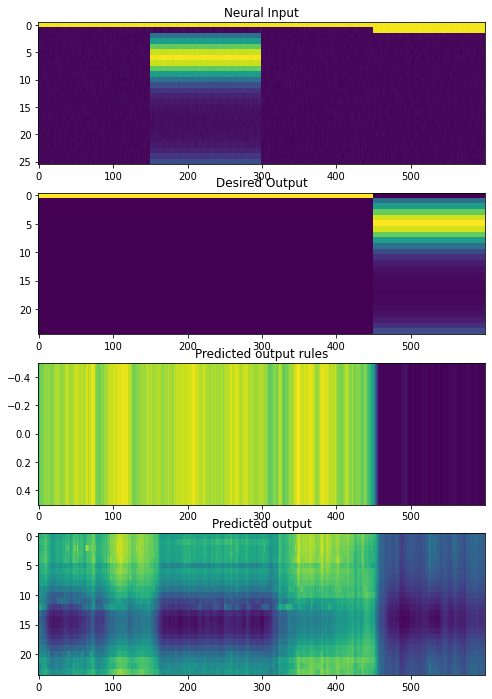

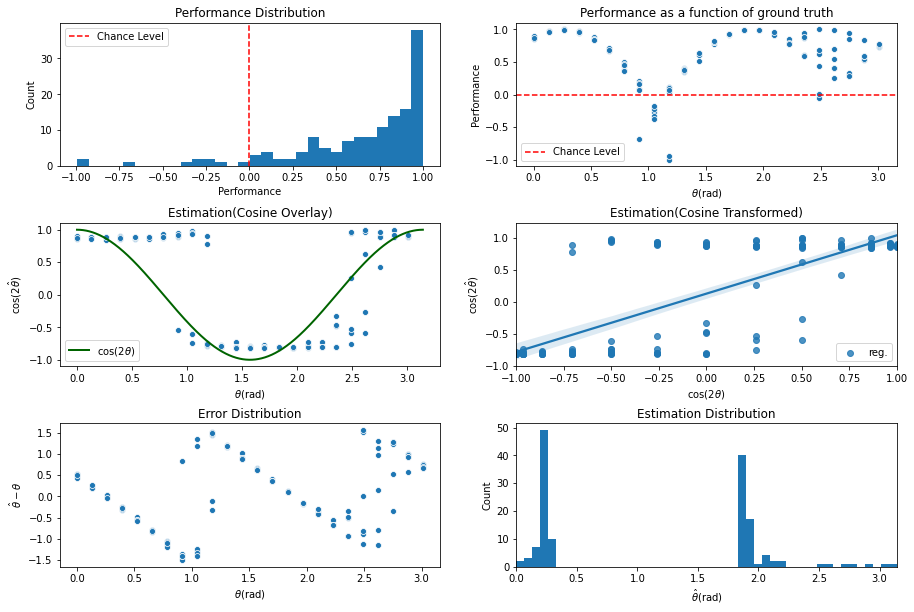

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter2200/assets

 Training performance: 
Iter. 2201 | Performance 0.0684 | Loss 0.2992 | Spike loss 2.6078
Testing performance: 
Iter. 2201 | Performance 0.5849 | Loss 0.3022 | Spike loss 2.6158

 Training performance: 
Iter. 2202 | Performance 0.0713 | Loss 0.3012 | Spike loss 2.5842
Testing performance: 
Iter. 2202 | Performance 0.6346 | Loss 0.3005 | Spike loss 2.6796

 Training performance: 
Iter. 2203 | Performance 0.0435 | Loss 0.2974 | Spike loss 2.7039
Testing performance: 
Iter. 2203 | Performance 0.6209 | Loss 0.3002 | Spike loss 2.6455

 Training performance: 
Iter. 2204 | Performance 0.0314 | Loss 0.2946 | Spike loss 2.6953
Testing performance: 
Iter. 2204 | Performance 0.6036 | Loss 0.3014 | Spike loss 2.5597

 Training performance: 
Iter. 2205 | Performance -0.0631 | Loss 0.3006 | Spike loss 2.6221
Testing performance: 
Iter. 2205 | Performance 0.6270 | Loss 0.3002 | Spike loss 2.5176

 Training pe


 Training performance: 
Iter. 2247 | Performance 0.0146 | Loss 0.2980 | Spike loss 2.7200
Testing performance: 
Iter. 2247 | Performance 0.6146 | Loss 0.2983 | Spike loss 2.5967

 Training performance: 
Iter. 2248 | Performance 0.0597 | Loss 0.2981 | Spike loss 2.4917
Testing performance: 
Iter. 2248 | Performance 0.6340 | Loss 0.2983 | Spike loss 2.5478

 Training performance: 
Iter. 2249 | Performance 0.0342 | Loss 0.2954 | Spike loss 2.6449
Testing performance: 
Iter. 2249 | Performance 0.6326 | Loss 0.3006 | Spike loss 2.5794

 Training performance: 
Iter. 2250 | Performance 0.0175 | Loss 0.3021 | Spike loss 2.5696
Testing performance: 
Iter. 2250 | Performance 0.6229 | Loss 0.2992 | Spike loss 2.5849

 Training performance: 
Iter. 2251 | Performance -0.0667 | Loss 0.2959 | Spike loss 2.6856
Testing performance: 
Iter. 2251 | Performance 0.6255 | Loss 0.2986 | Spike loss 2.6107

 Training performance: 
Iter. 2252 | Performance -0.1229 | Loss 0.2982 | Spike loss 2.5320
Testing perf


 Training performance: 
Iter. 2293 | Performance -0.0110 | Loss 0.2986 | Spike loss 2.6032
Testing performance: 
Iter. 2293 | Performance 0.6263 | Loss 0.2990 | Spike loss 2.5866

 Training performance: 
Iter. 2294 | Performance 0.0548 | Loss 0.3014 | Spike loss 2.5434
Testing performance: 
Iter. 2294 | Performance 0.6455 | Loss 0.3004 | Spike loss 2.6196

 Training performance: 
Iter. 2295 | Performance -0.0426 | Loss 0.2983 | Spike loss 2.7004
Testing performance: 
Iter. 2295 | Performance 0.6185 | Loss 0.2985 | Spike loss 2.6579

 Training performance: 
Iter. 2296 | Performance 0.1100 | Loss 0.2976 | Spike loss 2.6302
Testing performance: 
Iter. 2296 | Performance 0.6408 | Loss 0.2981 | Spike loss 2.6239

 Training performance: 
Iter. 2297 | Performance 0.0134 | Loss 0.3006 | Spike loss 2.6359
Testing performance: 
Iter. 2297 | Performance 0.6410 | Loss 0.3006 | Spike loss 2.5811

 Training performance: 
Iter. 2298 | Performance -0.1020 | Loss 0.3026 | Spike loss 2.6152
Testing per

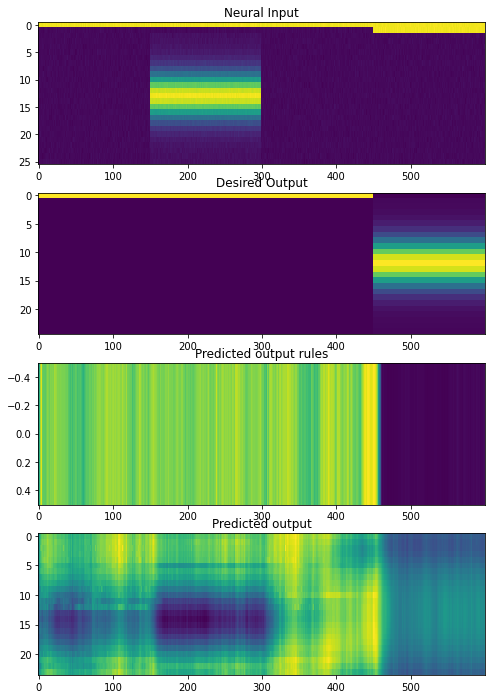

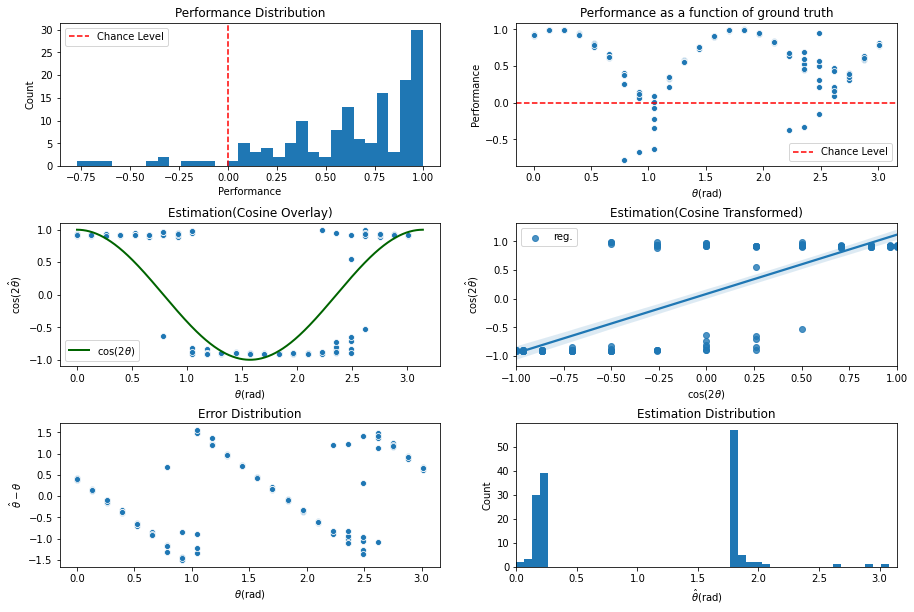

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter2300/assets

 Training performance: 
Iter. 2301 | Performance -0.0058 | Loss 0.2989 | Spike loss 2.6314
Testing performance: 
Iter. 2301 | Performance 0.6415 | Loss 0.2975 | Spike loss 2.5707

 Training performance: 
Iter. 2302 | Performance -0.0260 | Loss 0.2957 | Spike loss 2.6568
Testing performance: 
Iter. 2302 | Performance 0.6213 | Loss 0.2993 | Spike loss 2.6019

 Training performance: 
Iter. 2303 | Performance -0.0038 | Loss 0.2956 | Spike loss 2.6142
Testing performance: 
Iter. 2303 | Performance 0.6202 | Loss 0.2995 | Spike loss 2.6155

 Training performance: 
Iter. 2304 | Performance -0.0721 | Loss 0.2984 | Spike loss 2.6252
Testing performance: 
Iter. 2304 | Performance 0.6223 | Loss 0.2978 | Spike loss 2.5962

 Training performance: 
Iter. 2305 | Performance 0.0360 | Loss 0.2962 | Spike loss 2.6343
Testing performance: 
Iter. 2305 | Performance 0.6074 | Loss 0.2990 | Spike loss 2.5718

 Training


 Training performance: 
Iter. 2347 | Performance 0.1234 | Loss 0.2950 | Spike loss 2.5145
Testing performance: 
Iter. 2347 | Performance 0.6195 | Loss 0.2984 | Spike loss 2.5493

 Training performance: 
Iter. 2348 | Performance -0.1043 | Loss 0.2967 | Spike loss 2.5636
Testing performance: 
Iter. 2348 | Performance 0.6051 | Loss 0.2992 | Spike loss 2.5106

 Training performance: 
Iter. 2349 | Performance -0.1156 | Loss 0.2977 | Spike loss 2.5318
Testing performance: 
Iter. 2349 | Performance 0.6150 | Loss 0.2976 | Spike loss 2.5185

 Training performance: 
Iter. 2350 | Performance 0.0488 | Loss 0.2980 | Spike loss 2.5344
Testing performance: 
Iter. 2350 | Performance 0.6104 | Loss 0.2975 | Spike loss 2.5235

 Training performance: 
Iter. 2351 | Performance -0.0260 | Loss 0.2946 | Spike loss 2.5408
Testing performance: 
Iter. 2351 | Performance 0.6085 | Loss 0.3003 | Spike loss 2.5402

 Training performance: 
Iter. 2352 | Performance 0.0025 | Loss 0.3011 | Spike loss 2.4843
Testing per


 Training performance: 
Iter. 2393 | Performance 0.0383 | Loss 0.2937 | Spike loss 2.5923
Testing performance: 
Iter. 2393 | Performance 0.6464 | Loss 0.2992 | Spike loss 2.5603

 Training performance: 
Iter. 2394 | Performance 0.0964 | Loss 0.2971 | Spike loss 2.5464
Testing performance: 
Iter. 2394 | Performance 0.6144 | Loss 0.2974 | Spike loss 2.5391

 Training performance: 
Iter. 2395 | Performance 0.0342 | Loss 0.2953 | Spike loss 2.6590
Testing performance: 
Iter. 2395 | Performance 0.6134 | Loss 0.2974 | Spike loss 2.5511

 Training performance: 
Iter. 2396 | Performance -0.0733 | Loss 0.2939 | Spike loss 2.5603
Testing performance: 
Iter. 2396 | Performance 0.6189 | Loss 0.2984 | Spike loss 2.5379

 Training performance: 
Iter. 2397 | Performance 0.0569 | Loss 0.2983 | Spike loss 2.5776
Testing performance: 
Iter. 2397 | Performance 0.6315 | Loss 0.2969 | Spike loss 2.5139

 Training performance: 
Iter. 2398 | Performance -0.0070 | Loss 0.2969 | Spike loss 2.5599
Testing perf

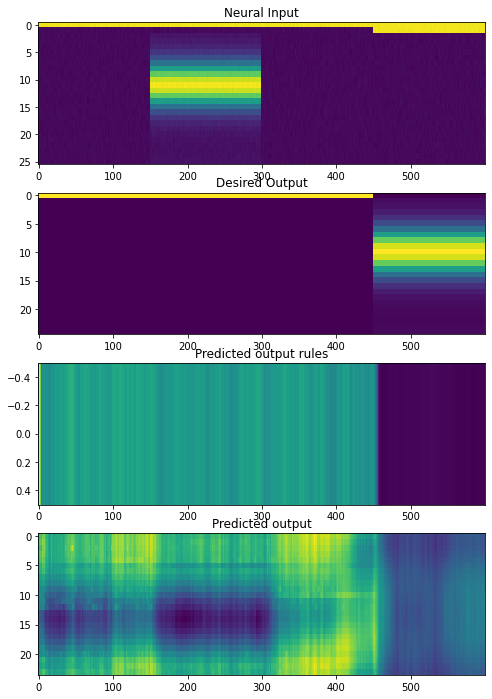

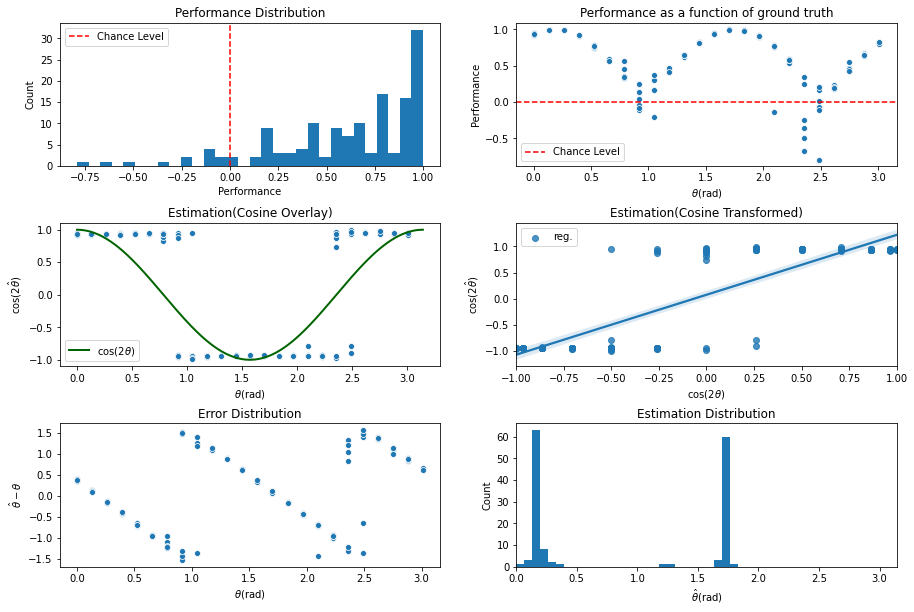

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter2400/assets

 Training performance: 
Iter. 2401 | Performance 0.0666 | Loss 0.2964 | Spike loss 2.5376
Testing performance: 
Iter. 2401 | Performance 0.6117 | Loss 0.2980 | Spike loss 2.5755

 Training performance: 
Iter. 2402 | Performance -0.0283 | Loss 0.2967 | Spike loss 2.6373
Testing performance: 
Iter. 2402 | Performance 0.6176 | Loss 0.3001 | Spike loss 2.6052

 Training performance: 
Iter. 2403 | Performance 0.0814 | Loss 0.2971 | Spike loss 2.5581
Testing performance: 
Iter. 2403 | Performance 0.6099 | Loss 0.2976 | Spike loss 2.5953

 Training performance: 
Iter. 2404 | Performance 0.0416 | Loss 0.2964 | Spike loss 2.6229
Testing performance: 
Iter. 2404 | Performance 0.5847 | Loss 0.2980 | Spike loss 2.5180

 Training performance: 
Iter. 2405 | Performance 0.0086 | Loss 0.2968 | Spike loss 2.5231
Testing performance: 
Iter. 2405 | Performance 0.6085 | Loss 0.2988 | Spike loss 2.5193

 Training pe


 Training performance: 
Iter. 2447 | Performance 0.0571 | Loss 0.2962 | Spike loss 2.5236
Testing performance: 
Iter. 2447 | Performance 0.6235 | Loss 0.2990 | Spike loss 2.5673

 Training performance: 
Iter. 2448 | Performance 0.1020 | Loss 0.2977 | Spike loss 2.6837
Testing performance: 
Iter. 2448 | Performance 0.5902 | Loss 0.2975 | Spike loss 2.5332

 Training performance: 
Iter. 2449 | Performance -0.0016 | Loss 0.2962 | Spike loss 2.5891
Testing performance: 
Iter. 2449 | Performance 0.6138 | Loss 0.2981 | Spike loss 2.5270

 Training performance: 
Iter. 2450 | Performance -0.0258 | Loss 0.2927 | Spike loss 2.5557
Testing performance: 
Iter. 2450 | Performance 0.6229 | Loss 0.2991 | Spike loss 2.5419

 Training performance: 
Iter. 2451 | Performance 0.0285 | Loss 0.2981 | Spike loss 2.5049
Testing performance: 
Iter. 2451 | Performance 0.6104 | Loss 0.2974 | Spike loss 2.5584

 Training performance: 
Iter. 2452 | Performance 0.0314 | Loss 0.2966 | Spike loss 2.5465
Testing perf


 Training performance: 
Iter. 2493 | Performance -0.0559 | Loss 0.2952 | Spike loss 2.5430
Testing performance: 
Iter. 2493 | Performance 0.6309 | Loss 0.2974 | Spike loss 2.6037

 Training performance: 
Iter. 2494 | Performance 0.0570 | Loss 0.2952 | Spike loss 2.5512
Testing performance: 
Iter. 2494 | Performance 0.6020 | Loss 0.2965 | Spike loss 2.5738

 Training performance: 
Iter. 2495 | Performance 0.0465 | Loss 0.2945 | Spike loss 2.5500
Testing performance: 
Iter. 2495 | Performance 0.6159 | Loss 0.2984 | Spike loss 2.5912

 Training performance: 
Iter. 2496 | Performance 0.0223 | Loss 0.2969 | Spike loss 2.6090
Testing performance: 
Iter. 2496 | Performance 0.6254 | Loss 0.2976 | Spike loss 2.5745

 Training performance: 
Iter. 2497 | Performance 0.0332 | Loss 0.2963 | Spike loss 2.5839
Testing performance: 
Iter. 2497 | Performance 0.6252 | Loss 0.2969 | Spike loss 2.5620

 Training performance: 
Iter. 2498 | Performance 0.0110 | Loss 0.2944 | Spike loss 2.5571
Testing perfo

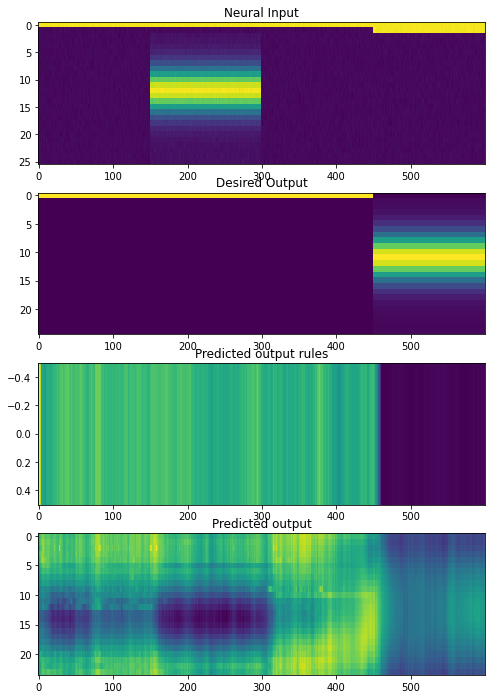

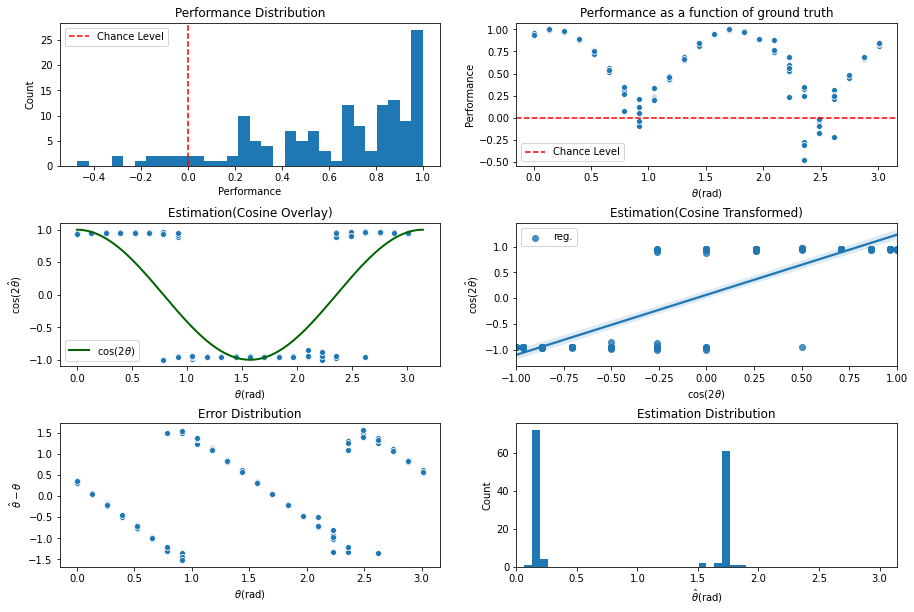

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter2500/assets

 Training performance: 
Iter. 2501 | Performance 0.1192 | Loss 0.2963 | Spike loss 2.5646
Testing performance: 
Iter. 2501 | Performance 0.6269 | Loss 0.2989 | Spike loss 2.5130

 Training performance: 
Iter. 2502 | Performance 0.0275 | Loss 0.2964 | Spike loss 2.5609
Testing performance: 
Iter. 2502 | Performance 0.6161 | Loss 0.2966 | Spike loss 2.5232

 Training performance: 
Iter. 2503 | Performance 0.0436 | Loss 0.2942 | Spike loss 2.6590
Testing performance: 
Iter. 2503 | Performance 0.6184 | Loss 0.2977 | Spike loss 2.5367

 Training performance: 
Iter. 2504 | Performance -0.0606 | Loss 0.2951 | Spike loss 2.5207
Testing performance: 
Iter. 2504 | Performance 0.6164 | Loss 0.2972 | Spike loss 2.5801

 Training performance: 
Iter. 2505 | Performance 0.0159 | Loss 0.2962 | Spike loss 2.6362
Testing performance: 
Iter. 2505 | Performance 0.6238 | Loss 0.2972 | Spike loss 2.6047

 Training pe


 Training performance: 
Iter. 2547 | Performance -0.0509 | Loss 0.2968 | Spike loss 2.5556
Testing performance: 
Iter. 2547 | Performance 0.6381 | Loss 0.2960 | Spike loss 2.5206

 Training performance: 
Iter. 2548 | Performance -0.0575 | Loss 0.2987 | Spike loss 2.4729
Testing performance: 
Iter. 2548 | Performance 0.6129 | Loss 0.2970 | Spike loss 2.5032

 Training performance: 
Iter. 2549 | Performance 0.0082 | Loss 0.2944 | Spike loss 2.5709
Testing performance: 
Iter. 2549 | Performance 0.6342 | Loss 0.2984 | Spike loss 2.5120

 Training performance: 
Iter. 2550 | Performance -0.0579 | Loss 0.2986 | Spike loss 2.5004
Testing performance: 
Iter. 2550 | Performance 0.6187 | Loss 0.2969 | Spike loss 2.4979

 Training performance: 
Iter. 2551 | Performance 0.0186 | Loss 0.2961 | Spike loss 2.5494
Testing performance: 
Iter. 2551 | Performance 0.6270 | Loss 0.2966 | Spike loss 2.5237

 Training performance: 
Iter. 2552 | Performance -0.0157 | Loss 0.2968 | Spike loss 2.4733
Testing pe


 Training performance: 
Iter. 2593 | Performance 0.0857 | Loss 0.2948 | Spike loss 2.6279
Testing performance: 
Iter. 2593 | Performance 0.6166 | Loss 0.2967 | Spike loss 2.5350

 Training performance: 
Iter. 2594 | Performance 0.0383 | Loss 0.2951 | Spike loss 2.5612
Testing performance: 
Iter. 2594 | Performance 0.6233 | Loss 0.2961 | Spike loss 2.5555

 Training performance: 
Iter. 2595 | Performance 0.0562 | Loss 0.2956 | Spike loss 2.5911
Testing performance: 
Iter. 2595 | Performance 0.6222 | Loss 0.2965 | Spike loss 2.5119

 Training performance: 
Iter. 2596 | Performance -0.0907 | Loss 0.2949 | Spike loss 2.5314
Testing performance: 
Iter. 2596 | Performance 0.6129 | Loss 0.2959 | Spike loss 2.5440

 Training performance: 
Iter. 2597 | Performance 0.1010 | Loss 0.2944 | Spike loss 2.6022
Testing performance: 
Iter. 2597 | Performance 0.6048 | Loss 0.2966 | Spike loss 2.5036

 Training performance: 
Iter. 2598 | Performance -0.0529 | Loss 0.2958 | Spike loss 2.5078
Testing perf

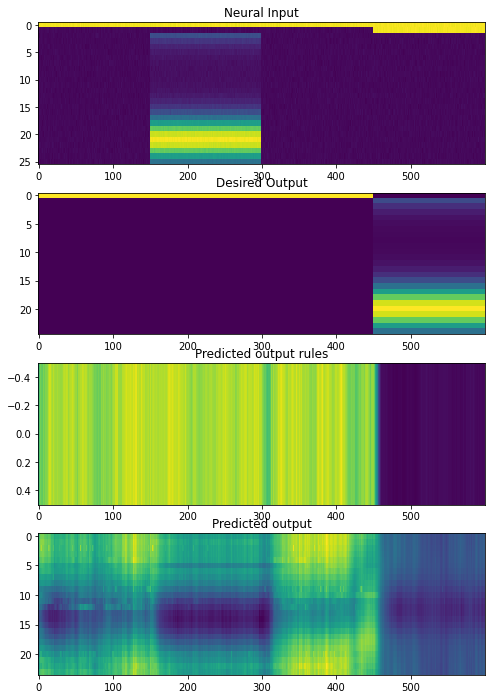

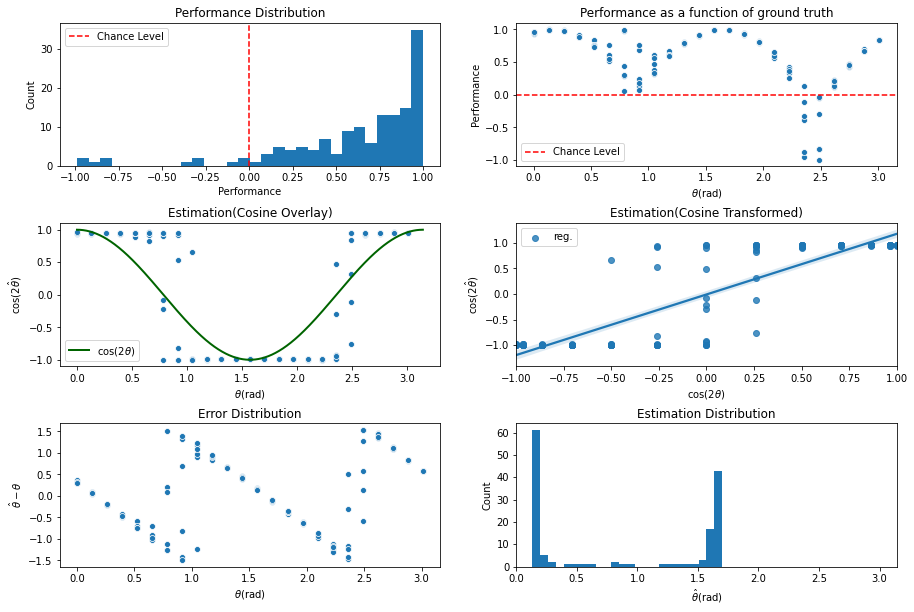

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter2600/assets

 Training performance: 
Iter. 2601 | Performance -0.1044 | Loss 0.2928 | Spike loss 2.6445
Testing performance: 
Iter. 2601 | Performance 0.6259 | Loss 0.2956 | Spike loss 2.5317

 Training performance: 
Iter. 2602 | Performance -0.0084 | Loss 0.2933 | Spike loss 2.4932
Testing performance: 
Iter. 2602 | Performance 0.6113 | Loss 0.2960 | Spike loss 2.5527

 Training performance: 
Iter. 2603 | Performance -0.1096 | Loss 0.2980 | Spike loss 2.5560
Testing performance: 
Iter. 2603 | Performance 0.6144 | Loss 0.2957 | Spike loss 2.5484

 Training performance: 
Iter. 2604 | Performance 0.0023 | Loss 0.2913 | Spike loss 2.5754
Testing performance: 
Iter. 2604 | Performance 0.6073 | Loss 0.2957 | Spike loss 2.5445

 Training performance: 
Iter. 2605 | Performance 0.0766 | Loss 0.2959 | Spike loss 2.5806
Testing performance: 
Iter. 2605 | Performance 0.6155 | Loss 0.2954 | Spike loss 2.5225

 Training 


 Training performance: 
Iter. 2647 | Performance 0.0569 | Loss 0.2937 | Spike loss 2.4599
Testing performance: 
Iter. 2647 | Performance 0.6400 | Loss 0.2959 | Spike loss 2.5226

 Training performance: 
Iter. 2648 | Performance -0.0553 | Loss 0.2957 | Spike loss 2.5013
Testing performance: 
Iter. 2648 | Performance 0.6392 | Loss 0.2957 | Spike loss 2.5107

 Training performance: 
Iter. 2649 | Performance -0.0417 | Loss 0.2964 | Spike loss 2.4818
Testing performance: 
Iter. 2649 | Performance 0.6177 | Loss 0.2952 | Spike loss 2.5134

 Training performance: 
Iter. 2650 | Performance -0.2137 | Loss 0.2948 | Spike loss 2.4260
Testing performance: 
Iter. 2650 | Performance 0.6308 | Loss 0.2953 | Spike loss 2.5360

 Training performance: 
Iter. 2651 | Performance 0.0237 | Loss 0.2902 | Spike loss 2.6975
Testing performance: 
Iter. 2651 | Performance 0.6339 | Loss 0.2953 | Spike loss 2.5536

 Training performance: 
Iter. 2652 | Performance 0.0512 | Loss 0.2967 | Spike loss 2.5834
Testing per


 Training performance: 
Iter. 2693 | Performance 0.0370 | Loss 0.2949 | Spike loss 2.6620
Testing performance: 
Iter. 2693 | Performance 0.5993 | Loss 0.2953 | Spike loss 2.5215

 Training performance: 
Iter. 2694 | Performance -0.0248 | Loss 0.2929 | Spike loss 2.5896
Testing performance: 
Iter. 2694 | Performance 0.6435 | Loss 0.2953 | Spike loss 2.5237

 Training performance: 
Iter. 2695 | Performance 0.0035 | Loss 0.2978 | Spike loss 2.5234
Testing performance: 
Iter. 2695 | Performance 0.5908 | Loss 0.2971 | Spike loss 2.4995

 Training performance: 
Iter. 2696 | Performance 0.0713 | Loss 0.2935 | Spike loss 2.5099
Testing performance: 
Iter. 2696 | Performance 0.6111 | Loss 0.2958 | Spike loss 2.4793

 Training performance: 
Iter. 2697 | Performance -0.0311 | Loss 0.2948 | Spike loss 2.5905
Testing performance: 
Iter. 2697 | Performance 0.6314 | Loss 0.2954 | Spike loss 2.5016

 Training performance: 
Iter. 2698 | Performance -0.0789 | Loss 0.2956 | Spike loss 2.4813
Testing per

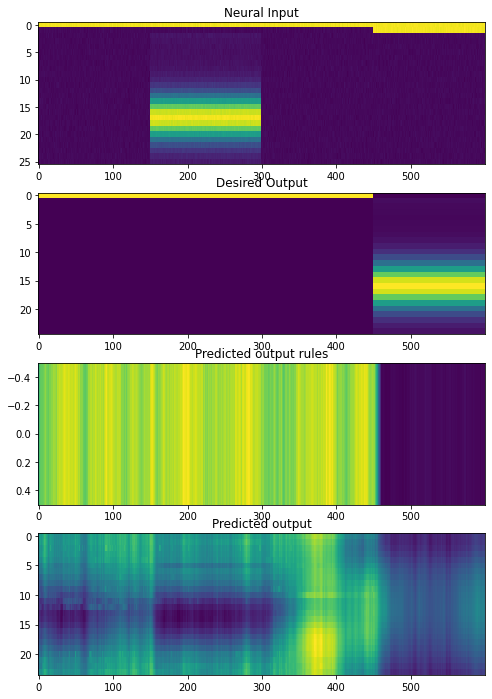

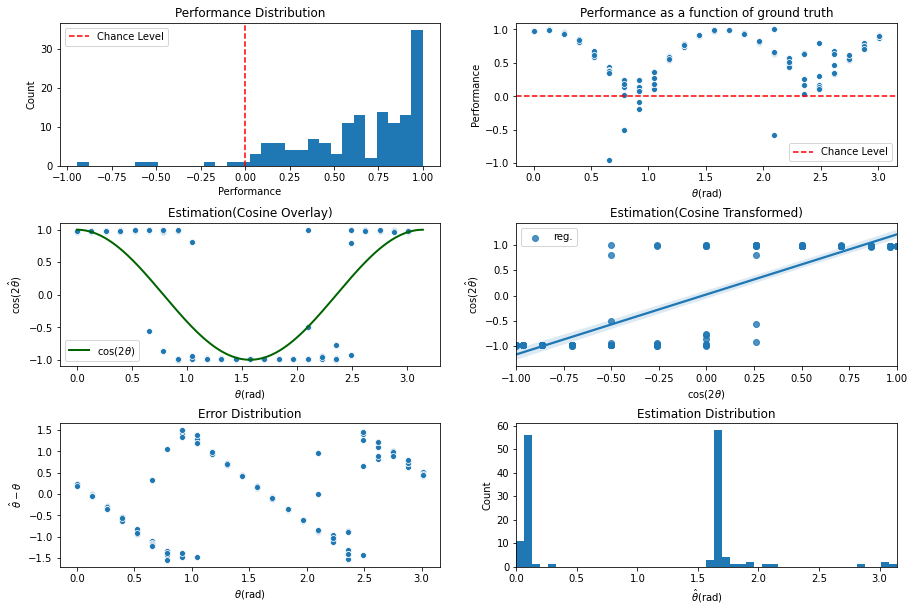

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter2700/assets

 Training performance: 
Iter. 2701 | Performance -0.0528 | Loss 0.2940 | Spike loss 2.4752
Testing performance: 
Iter. 2701 | Performance 0.6261 | Loss 0.2959 | Spike loss 2.5308

 Training performance: 
Iter. 2702 | Performance 0.0432 | Loss 0.2967 | Spike loss 2.6131
Testing performance: 
Iter. 2702 | Performance 0.6257 | Loss 0.2962 | Spike loss 2.5311

 Training performance: 
Iter. 2703 | Performance -0.0157 | Loss 0.2933 | Spike loss 2.4995
Testing performance: 
Iter. 2703 | Performance 0.6204 | Loss 0.2960 | Spike loss 2.5429

 Training performance: 
Iter. 2704 | Performance -0.0315 | Loss 0.2943 | Spike loss 2.5666
Testing performance: 
Iter. 2704 | Performance 0.5962 | Loss 0.2967 | Spike loss 2.5309

 Training performance: 
Iter. 2705 | Performance 0.0797 | Loss 0.2954 | Spike loss 2.5362
Testing performance: 
Iter. 2705 | Performance 0.6201 | Loss 0.2955 | Spike loss 2.5280

 Training 


 Training performance: 
Iter. 2747 | Performance 0.0367 | Loss 0.2910 | Spike loss 2.6213
Testing performance: 
Iter. 2747 | Performance 0.6264 | Loss 0.2950 | Spike loss 2.5731

 Training performance: 
Iter. 2748 | Performance -0.0449 | Loss 0.2944 | Spike loss 2.5564
Testing performance: 
Iter. 2748 | Performance 0.6188 | Loss 0.2952 | Spike loss 2.5943

 Training performance: 
Iter. 2749 | Performance -0.0391 | Loss 0.2910 | Spike loss 2.6923
Testing performance: 
Iter. 2749 | Performance 0.5993 | Loss 0.2951 | Spike loss 2.5823

 Training performance: 
Iter. 2750 | Performance -0.0094 | Loss 0.2965 | Spike loss 2.5799
Testing performance: 
Iter. 2750 | Performance 0.6262 | Loss 0.2957 | Spike loss 2.5653

 Training performance: 
Iter. 2751 | Performance 0.0202 | Loss 0.2934 | Spike loss 2.5794
Testing performance: 
Iter. 2751 | Performance 0.6036 | Loss 0.2956 | Spike loss 2.5085

 Training performance: 
Iter. 2752 | Performance 0.0062 | Loss 0.2926 | Spike loss 2.5255
Testing per


 Training performance: 
Iter. 2793 | Performance -0.0056 | Loss 0.2909 | Spike loss 2.5030
Testing performance: 
Iter. 2793 | Performance 0.6226 | Loss 0.2955 | Spike loss 2.5761

 Training performance: 
Iter. 2794 | Performance 0.0654 | Loss 0.2926 | Spike loss 2.5719
Testing performance: 
Iter. 2794 | Performance 0.6414 | Loss 0.2947 | Spike loss 2.5655

 Training performance: 
Iter. 2795 | Performance 0.0120 | Loss 0.2925 | Spike loss 2.5558
Testing performance: 
Iter. 2795 | Performance 0.6217 | Loss 0.2947 | Spike loss 2.5636

 Training performance: 
Iter. 2796 | Performance -0.0137 | Loss 0.2944 | Spike loss 2.6064
Testing performance: 
Iter. 2796 | Performance 0.6114 | Loss 0.2953 | Spike loss 2.5125

 Training performance: 
Iter. 2797 | Performance 0.0713 | Loss 0.2935 | Spike loss 2.3841
Testing performance: 
Iter. 2797 | Performance 0.6213 | Loss 0.2955 | Spike loss 2.4724

 Training performance: 
Iter. 2798 | Performance 0.0501 | Loss 0.2920 | Spike loss 2.5688
Testing perf

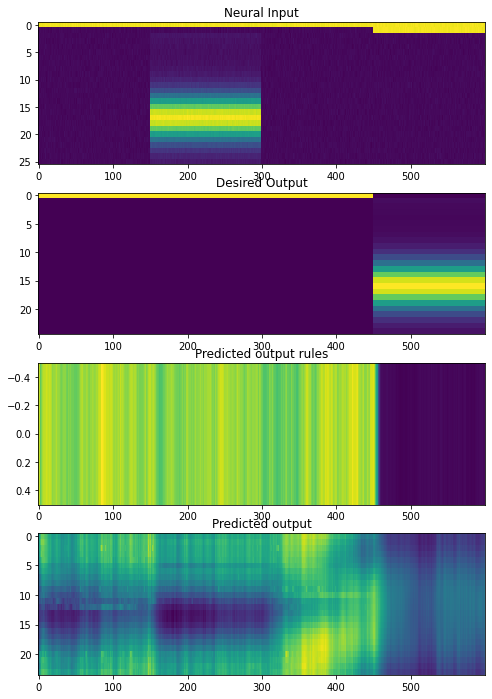

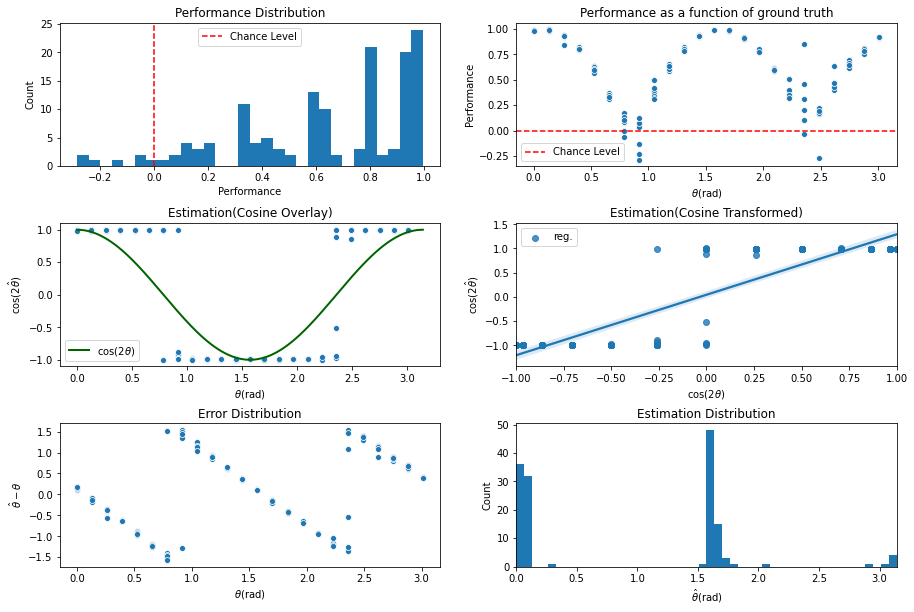

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter2800/assets

 Training performance: 
Iter. 2801 | Performance 0.1256 | Loss 0.2936 | Spike loss 2.5476
Testing performance: 
Iter. 2801 | Performance 0.6253 | Loss 0.2955 | Spike loss 2.5597

 Training performance: 
Iter. 2802 | Performance 0.0163 | Loss 0.2913 | Spike loss 2.5919
Testing performance: 
Iter. 2802 | Performance 0.6168 | Loss 0.2953 | Spike loss 2.5719

 Training performance: 
Iter. 2803 | Performance -0.1055 | Loss 0.2954 | Spike loss 2.5469
Testing performance: 
Iter. 2803 | Performance 0.6243 | Loss 0.2947 | Spike loss 2.6002

 Training performance: 
Iter. 2804 | Performance 0.0607 | Loss 0.2954 | Spike loss 2.5170
Testing performance: 
Iter. 2804 | Performance 0.6164 | Loss 0.2959 | Spike loss 2.5791

 Training performance: 
Iter. 2805 | Performance -0.1138 | Loss 0.2953 | Spike loss 2.5512
Testing performance: 
Iter. 2805 | Performance 0.6322 | Loss 0.2940 | Spike loss 2.5508

 Training p


 Training performance: 
Iter. 2847 | Performance 0.1027 | Loss 0.2965 | Spike loss 2.5188
Testing performance: 
Iter. 2847 | Performance 0.6154 | Loss 0.2945 | Spike loss 2.5363

 Training performance: 
Iter. 2848 | Performance 0.0393 | Loss 0.2929 | Spike loss 2.6394
Testing performance: 
Iter. 2848 | Performance 0.6376 | Loss 0.2951 | Spike loss 2.5434

 Training performance: 
Iter. 2849 | Performance -0.0626 | Loss 0.2947 | Spike loss 2.5748
Testing performance: 
Iter. 2849 | Performance 0.6191 | Loss 0.2942 | Spike loss 2.5434

 Training performance: 
Iter. 2850 | Performance 0.0459 | Loss 0.2942 | Spike loss 2.5178
Testing performance: 
Iter. 2850 | Performance 0.6397 | Loss 0.2944 | Spike loss 2.5393

 Training performance: 
Iter. 2851 | Performance 0.0211 | Loss 0.2959 | Spike loss 2.6170
Testing performance: 
Iter. 2851 | Performance 0.6517 | Loss 0.2946 | Spike loss 2.5511

 Training performance: 
Iter. 2852 | Performance -0.0720 | Loss 0.2948 | Spike loss 2.4717
Testing perf


 Training performance: 
Iter. 2893 | Performance 0.0101 | Loss 0.2935 | Spike loss 2.4871
Testing performance: 
Iter. 2893 | Performance 0.6318 | Loss 0.2940 | Spike loss 2.5285

 Training performance: 
Iter. 2894 | Performance -0.1110 | Loss 0.2924 | Spike loss 2.4813
Testing performance: 
Iter. 2894 | Performance 0.6289 | Loss 0.2950 | Spike loss 2.5240

 Training performance: 
Iter. 2895 | Performance 0.0034 | Loss 0.2962 | Spike loss 2.5262
Testing performance: 
Iter. 2895 | Performance 0.6204 | Loss 0.2941 | Spike loss 2.5360

 Training performance: 
Iter. 2896 | Performance 0.1009 | Loss 0.2928 | Spike loss 2.6599
Testing performance: 
Iter. 2896 | Performance 0.6151 | Loss 0.2942 | Spike loss 2.4952

 Training performance: 
Iter. 2897 | Performance -0.1238 | Loss 0.2922 | Spike loss 2.5843
Testing performance: 
Iter. 2897 | Performance 0.6278 | Loss 0.2951 | Spike loss 2.5322

 Training performance: 
Iter. 2898 | Performance 0.0085 | Loss 0.2936 | Spike loss 2.4921
Testing perf

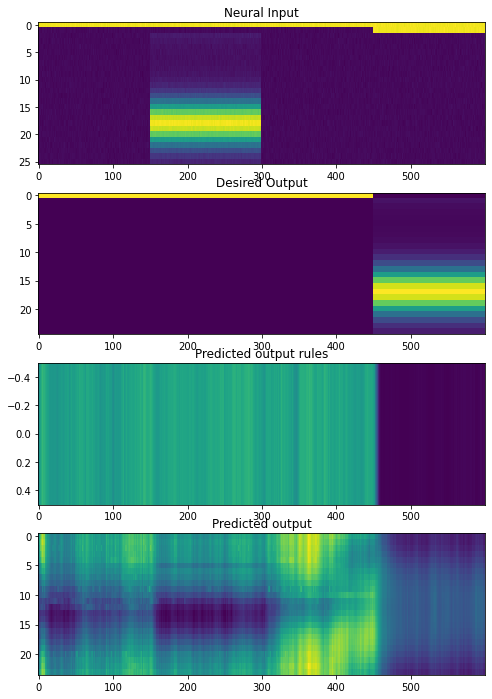

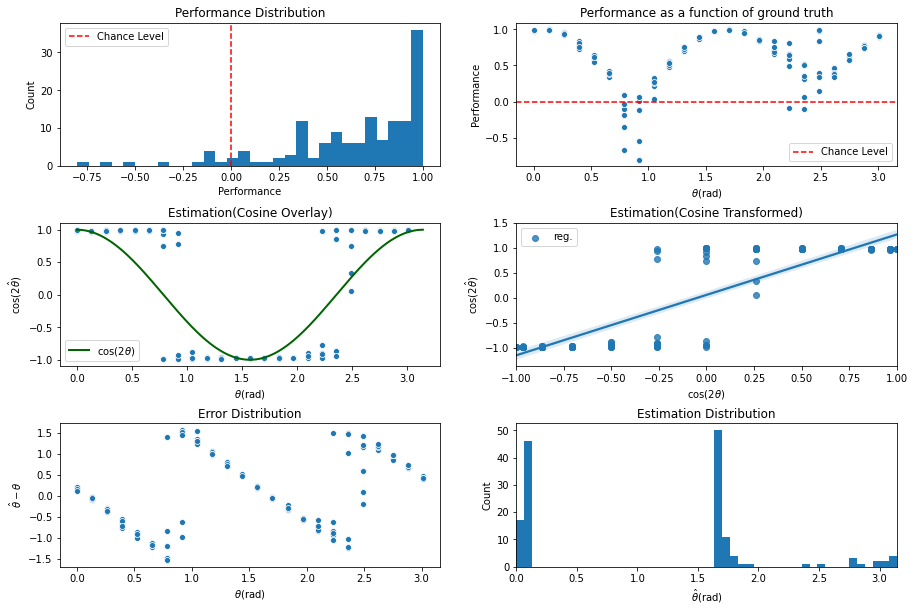

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter2900/assets

 Training performance: 
Iter. 2901 | Performance -0.0417 | Loss 0.2941 | Spike loss 2.4817
Testing performance: 
Iter. 2901 | Performance 0.6240 | Loss 0.2950 | Spike loss 2.4828

 Training performance: 
Iter. 2902 | Performance 0.0279 | Loss 0.2943 | Spike loss 2.5289
Testing performance: 
Iter. 2902 | Performance 0.6408 | Loss 0.2946 | Spike loss 2.4991

 Training performance: 
Iter. 2903 | Performance 0.0501 | Loss 0.2931 | Spike loss 2.4992
Testing performance: 
Iter. 2903 | Performance 0.6276 | Loss 0.2949 | Spike loss 2.4930

 Training performance: 
Iter. 2904 | Performance 0.0122 | Loss 0.2933 | Spike loss 2.5045
Testing performance: 
Iter. 2904 | Performance 0.6060 | Loss 0.2946 | Spike loss 2.5043

 Training performance: 
Iter. 2905 | Performance -0.0066 | Loss 0.2894 | Spike loss 2.5119
Testing performance: 
Iter. 2905 | Performance 0.6275 | Loss 0.2941 | Spike loss 2.4962

 Training p


 Training performance: 
Iter. 2947 | Performance 0.0067 | Loss 0.2946 | Spike loss 2.6443
Testing performance: 
Iter. 2947 | Performance 0.6369 | Loss 0.2950 | Spike loss 2.5311

 Training performance: 
Iter. 2948 | Performance 0.0997 | Loss 0.2907 | Spike loss 2.6594
Testing performance: 
Iter. 2948 | Performance 0.6402 | Loss 0.2940 | Spike loss 2.5590

 Training performance: 
Iter. 2949 | Performance 0.0318 | Loss 0.2929 | Spike loss 2.5770
Testing performance: 
Iter. 2949 | Performance 0.6697 | Loss 0.2937 | Spike loss 2.5398

 Training performance: 
Iter. 2950 | Performance -0.0515 | Loss 0.2929 | Spike loss 2.5342
Testing performance: 
Iter. 2950 | Performance 0.6443 | Loss 0.2938 | Spike loss 2.5502

 Training performance: 
Iter. 2951 | Performance -0.0243 | Loss 0.2940 | Spike loss 2.5829
Testing performance: 
Iter. 2951 | Performance 0.6226 | Loss 0.2943 | Spike loss 2.5706

 Training performance: 
Iter. 2952 | Performance 0.1093 | Loss 0.2894 | Spike loss 2.5589
Testing perf


 Training performance: 
Iter. 2993 | Performance -0.0052 | Loss 0.2941 | Spike loss 2.6182
Testing performance: 
Iter. 2993 | Performance 0.6379 | Loss 0.2940 | Spike loss 2.5734

 Training performance: 
Iter. 2994 | Performance -0.0238 | Loss 0.2928 | Spike loss 2.6034
Testing performance: 
Iter. 2994 | Performance 0.6060 | Loss 0.2948 | Spike loss 2.5250

 Training performance: 
Iter. 2995 | Performance -0.0067 | Loss 0.2911 | Spike loss 2.6045
Testing performance: 
Iter. 2995 | Performance 0.6270 | Loss 0.2939 | Spike loss 2.5814

 Training performance: 
Iter. 2996 | Performance 0.0448 | Loss 0.2945 | Spike loss 2.5488
Testing performance: 
Iter. 2996 | Performance 0.6454 | Loss 0.2940 | Spike loss 2.5759

 Training performance: 
Iter. 2997 | Performance -0.0446 | Loss 0.2931 | Spike loss 2.6330
Testing performance: 
Iter. 2997 | Performance 0.6309 | Loss 0.2935 | Spike loss 2.5751

 Training performance: 
Iter. 2998 | Performance -0.1142 | Loss 0.2926 | Spike loss 2.6290
Testing p

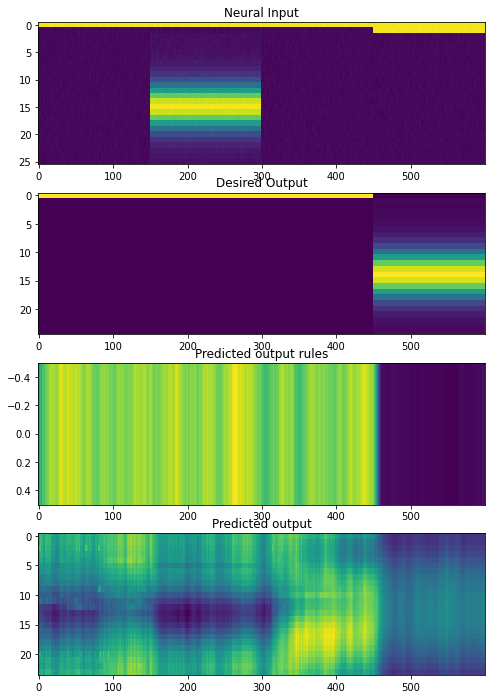

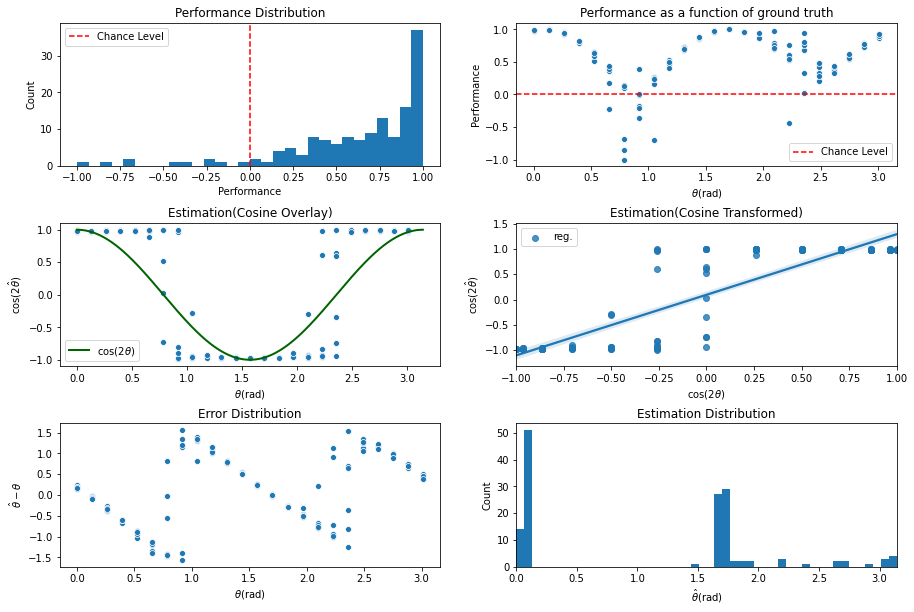

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter3000/assets

 Training performance: 
Iter. 3001 | Performance -0.0254 | Loss 0.2933 | Spike loss 2.5698
Testing performance: 
Iter. 3001 | Performance 0.6349 | Loss 0.2937 | Spike loss 2.5492

 Training performance: 
Iter. 3002 | Performance 0.0431 | Loss 0.2924 | Spike loss 2.5425
Testing performance: 
Iter. 3002 | Performance 0.6065 | Loss 0.2944 | Spike loss 2.5374

 Training performance: 
Iter. 3003 | Performance 0.0791 | Loss 0.2910 | Spike loss 2.6333
Testing performance: 
Iter. 3003 | Performance 0.6366 | Loss 0.2941 | Spike loss 2.5374

 Training performance: 
Iter. 3004 | Performance 0.0347 | Loss 0.2948 | Spike loss 2.4862
Testing performance: 
Iter. 3004 | Performance 0.6278 | Loss 0.2940 | Spike loss 2.5458

 Training performance: 
Iter. 3005 | Performance 0.1211 | Loss 0.2933 | Spike loss 2.5363
Testing performance: 
Iter. 3005 | Performance 0.6483 | Loss 0.2939 | Spike loss 2.5593

 Training pe


 Training performance: 
Iter. 3047 | Performance 0.0141 | Loss 0.2912 | Spike loss 2.5828
Testing performance: 
Iter. 3047 | Performance 0.6244 | Loss 0.2942 | Spike loss 2.5923

 Training performance: 
Iter. 3048 | Performance 0.0381 | Loss 0.2931 | Spike loss 2.5715
Testing performance: 
Iter. 3048 | Performance 0.6357 | Loss 0.2943 | Spike loss 2.5762

 Training performance: 
Iter. 3049 | Performance 0.0321 | Loss 0.2911 | Spike loss 2.5902
Testing performance: 
Iter. 3049 | Performance 0.6581 | Loss 0.2936 | Spike loss 2.5536

 Training performance: 
Iter. 3050 | Performance -0.0004 | Loss 0.2927 | Spike loss 2.6065
Testing performance: 
Iter. 3050 | Performance 0.6337 | Loss 0.2946 | Spike loss 2.6082

 Training performance: 
Iter. 3051 | Performance 0.1092 | Loss 0.2927 | Spike loss 2.5358
Testing performance: 
Iter. 3051 | Performance 0.6200 | Loss 0.2937 | Spike loss 2.5948

 Training performance: 
Iter. 3052 | Performance 0.0825 | Loss 0.2907 | Spike loss 2.6330
Testing perfo


 Training performance: 
Iter. 3093 | Performance 0.0401 | Loss 0.2916 | Spike loss 2.6613
Testing performance: 
Iter. 3093 | Performance 0.6413 | Loss 0.2940 | Spike loss 2.5407

 Training performance: 
Iter. 3094 | Performance 0.0844 | Loss 0.2948 | Spike loss 2.5657
Testing performance: 
Iter. 3094 | Performance 0.6209 | Loss 0.2941 | Spike loss 2.5437

 Training performance: 
Iter. 3095 | Performance 0.0422 | Loss 0.2915 | Spike loss 2.6877
Testing performance: 
Iter. 3095 | Performance 0.6298 | Loss 0.2934 | Spike loss 2.5661

 Training performance: 
Iter. 3096 | Performance -0.0289 | Loss 0.2951 | Spike loss 2.6763
Testing performance: 
Iter. 3096 | Performance 0.6366 | Loss 0.2935 | Spike loss 2.5706

 Training performance: 
Iter. 3097 | Performance 0.0113 | Loss 0.2914 | Spike loss 2.5485
Testing performance: 
Iter. 3097 | Performance 0.6403 | Loss 0.2935 | Spike loss 2.5634

 Training performance: 
Iter. 3098 | Performance 0.0336 | Loss 0.2917 | Spike loss 2.5540
Testing perfo

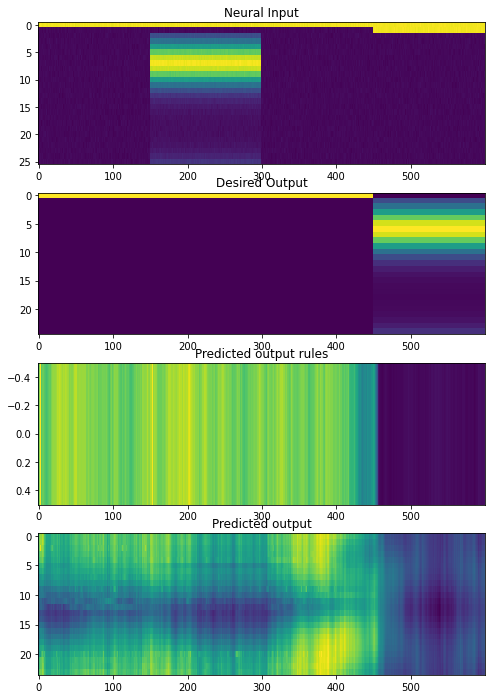

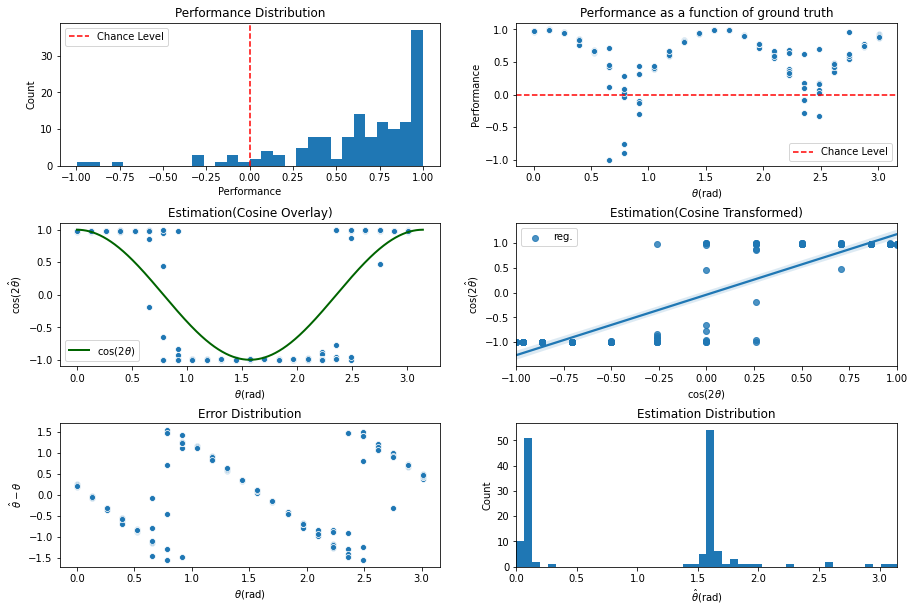

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter3100/assets

 Training performance: 
Iter. 3101 | Performance 0.0755 | Loss 0.2907 | Spike loss 2.6435
Testing performance: 
Iter. 3101 | Performance 0.6101 | Loss 0.2936 | Spike loss 2.5554

 Training performance: 
Iter. 3102 | Performance 0.0639 | Loss 0.2937 | Spike loss 2.5446
Testing performance: 
Iter. 3102 | Performance 0.6470 | Loss 0.2940 | Spike loss 2.5255

 Training performance: 
Iter. 3103 | Performance 0.1393 | Loss 0.2943 | Spike loss 2.5123
Testing performance: 
Iter. 3103 | Performance 0.6323 | Loss 0.2934 | Spike loss 2.5457

 Training performance: 
Iter. 3104 | Performance -0.0414 | Loss 0.2898 | Spike loss 2.5454
Testing performance: 
Iter. 3104 | Performance 0.6331 | Loss 0.2938 | Spike loss 2.5497

 Training performance: 
Iter. 3105 | Performance -0.0055 | Loss 0.2908 | Spike loss 2.6078
Testing performance: 
Iter. 3105 | Performance 0.6304 | Loss 0.2934 | Spike loss 2.5342

 Training p


 Training performance: 
Iter. 3147 | Performance 0.0154 | Loss 0.2915 | Spike loss 2.5331
Testing performance: 
Iter. 3147 | Performance 0.6447 | Loss 0.2934 | Spike loss 2.5710

 Training performance: 
Iter. 3148 | Performance 0.0757 | Loss 0.2933 | Spike loss 2.5642
Testing performance: 
Iter. 3148 | Performance 0.6171 | Loss 0.2952 | Spike loss 2.5436

 Training performance: 
Iter. 3149 | Performance -0.0248 | Loss 0.2948 | Spike loss 2.5529
Testing performance: 
Iter. 3149 | Performance 0.6199 | Loss 0.2942 | Spike loss 2.5411

 Training performance: 
Iter. 3150 | Performance 0.0512 | Loss 0.2914 | Spike loss 2.5975
Testing performance: 
Iter. 3150 | Performance 0.6312 | Loss 0.2934 | Spike loss 2.5273

 Training performance: 
Iter. 3151 | Performance -0.0516 | Loss 0.2904 | Spike loss 2.6482
Testing performance: 
Iter. 3151 | Performance 0.6430 | Loss 0.2930 | Spike loss 2.5670

 Training performance: 
Iter. 3152 | Performance 0.0292 | Loss 0.2932 | Spike loss 2.5305
Testing perf


 Training performance: 
Iter. 3193 | Performance -0.1003 | Loss 0.2924 | Spike loss 2.5262
Testing performance: 
Iter. 3193 | Performance 0.6421 | Loss 0.2931 | Spike loss 2.5650

 Training performance: 
Iter. 3194 | Performance 0.0061 | Loss 0.2934 | Spike loss 2.5870
Testing performance: 
Iter. 3194 | Performance 0.6272 | Loss 0.2928 | Spike loss 2.5591

 Training performance: 
Iter. 3195 | Performance -0.0466 | Loss 0.2931 | Spike loss 2.5336
Testing performance: 
Iter. 3195 | Performance 0.6641 | Loss 0.2926 | Spike loss 2.5756

 Training performance: 
Iter. 3196 | Performance -0.0331 | Loss 0.2911 | Spike loss 2.5578
Testing performance: 
Iter. 3196 | Performance 0.6257 | Loss 0.2935 | Spike loss 2.5294

 Training performance: 
Iter. 3197 | Performance 0.0391 | Loss 0.2917 | Spike loss 2.5854
Testing performance: 
Iter. 3197 | Performance 0.6421 | Loss 0.2932 | Spike loss 2.5298

 Training performance: 
Iter. 3198 | Performance 0.0096 | Loss 0.2936 | Spike loss 2.5364
Testing per

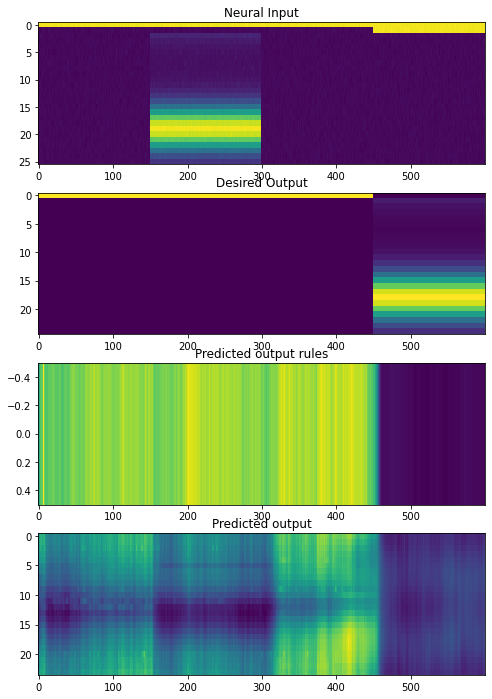

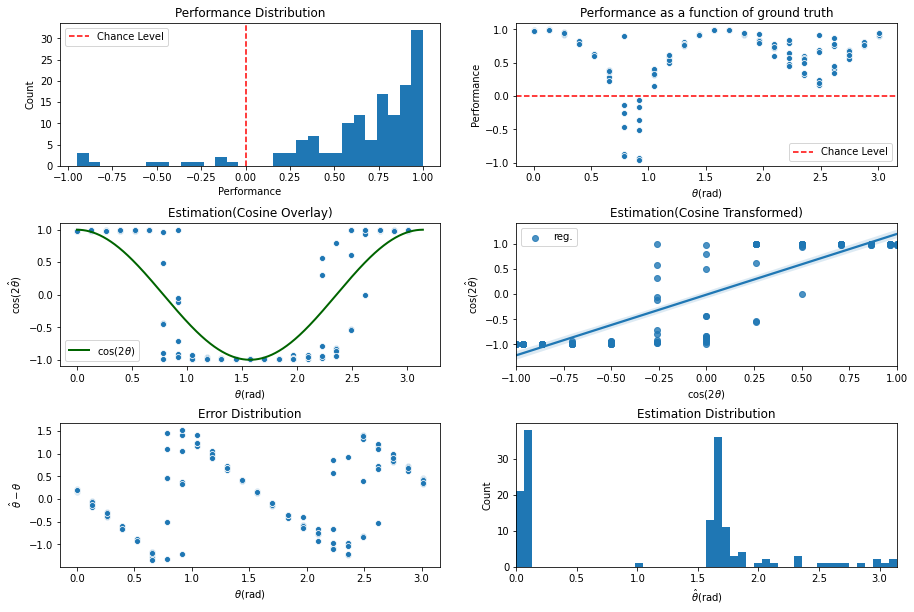

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter3200/assets

 Training performance: 
Iter. 3201 | Performance 0.0469 | Loss 0.2909 | Spike loss 2.5170
Testing performance: 
Iter. 3201 | Performance 0.6713 | Loss 0.2925 | Spike loss 2.5678

 Training performance: 
Iter. 3202 | Performance -0.0934 | Loss 0.2888 | Spike loss 2.5959
Testing performance: 
Iter. 3202 | Performance 0.6461 | Loss 0.2935 | Spike loss 2.5780

 Training performance: 
Iter. 3203 | Performance 0.0882 | Loss 0.2916 | Spike loss 2.5403
Testing performance: 
Iter. 3203 | Performance 0.6469 | Loss 0.2936 | Spike loss 2.6040

 Training performance: 
Iter. 3204 | Performance 0.0282 | Loss 0.2890 | Spike loss 2.5744
Testing performance: 
Iter. 3204 | Performance 0.6570 | Loss 0.2931 | Spike loss 2.6046

 Training performance: 
Iter. 3205 | Performance -0.0402 | Loss 0.2924 | Spike loss 2.5245
Testing performance: 
Iter. 3205 | Performance 0.6618 | Loss 0.2927 | Spike loss 2.5717

 Training p


 Training performance: 
Iter. 3247 | Performance -0.0263 | Loss 0.2922 | Spike loss 2.5664
Testing performance: 
Iter. 3247 | Performance 0.6281 | Loss 0.2933 | Spike loss 2.5486

 Training performance: 
Iter. 3248 | Performance 0.0114 | Loss 0.2942 | Spike loss 2.4977
Testing performance: 
Iter. 3248 | Performance 0.6419 | Loss 0.2929 | Spike loss 2.5336

 Training performance: 
Iter. 3249 | Performance -0.1913 | Loss 0.2923 | Spike loss 2.5252
Testing performance: 
Iter. 3249 | Performance 0.6407 | Loss 0.2925 | Spike loss 2.5473

 Training performance: 
Iter. 3250 | Performance -0.1514 | Loss 0.2903 | Spike loss 2.6309
Testing performance: 
Iter. 3250 | Performance 0.6504 | Loss 0.2929 | Spike loss 2.5829

 Training performance: 
Iter. 3251 | Performance 0.0142 | Loss 0.2919 | Spike loss 2.6945
Testing performance: 
Iter. 3251 | Performance 0.6448 | Loss 0.2927 | Spike loss 2.6012

 Training performance: 
Iter. 3252 | Performance -0.0360 | Loss 0.2928 | Spike loss 2.5777
Testing pe


 Training performance: 
Iter. 3293 | Performance -0.0174 | Loss 0.2913 | Spike loss 2.5998
Testing performance: 
Iter. 3293 | Performance 0.6794 | Loss 0.2922 | Spike loss 2.5676

 Training performance: 
Iter. 3294 | Performance 0.0369 | Loss 0.2910 | Spike loss 2.6330
Testing performance: 
Iter. 3294 | Performance 0.6581 | Loss 0.2930 | Spike loss 2.5788

 Training performance: 
Iter. 3295 | Performance 0.0040 | Loss 0.2908 | Spike loss 2.6221
Testing performance: 
Iter. 3295 | Performance 0.6536 | Loss 0.2929 | Spike loss 2.5538

 Training performance: 
Iter. 3296 | Performance 0.0304 | Loss 0.2927 | Spike loss 2.5674
Testing performance: 
Iter. 3296 | Performance 0.6712 | Loss 0.2932 | Spike loss 2.5427

 Training performance: 
Iter. 3297 | Performance 0.0907 | Loss 0.2942 | Spike loss 2.5592
Testing performance: 
Iter. 3297 | Performance 0.6730 | Loss 0.2923 | Spike loss 2.5465

 Training performance: 
Iter. 3298 | Performance -0.0312 | Loss 0.2911 | Spike loss 2.5457
Testing perf

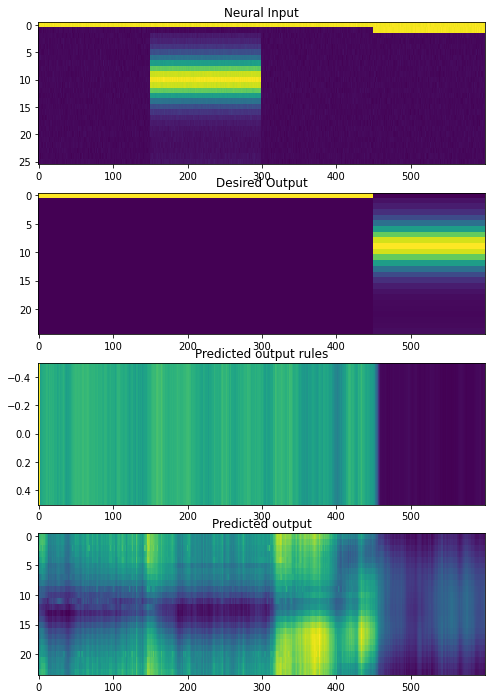

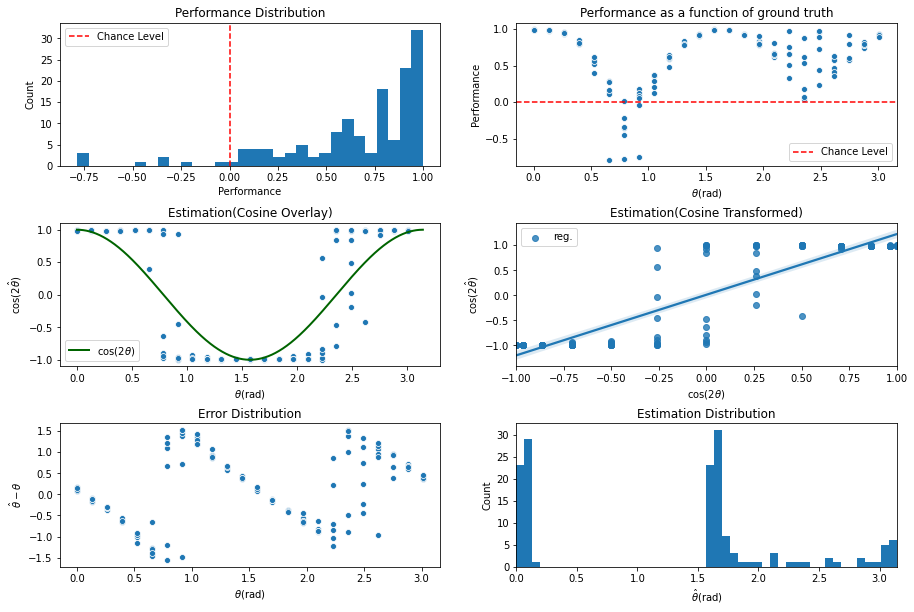

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter3300/assets

 Training performance: 
Iter. 3301 | Performance 0.0285 | Loss 0.2906 | Spike loss 2.5707
Testing performance: 
Iter. 3301 | Performance 0.6515 | Loss 0.2933 | Spike loss 2.5173

 Training performance: 
Iter. 3302 | Performance -0.0839 | Loss 0.2908 | Spike loss 2.5832
Testing performance: 
Iter. 3302 | Performance 0.6313 | Loss 0.2935 | Spike loss 2.5578

 Training performance: 
Iter. 3303 | Performance -0.0122 | Loss 0.2940 | Spike loss 2.5320
Testing performance: 
Iter. 3303 | Performance 0.6522 | Loss 0.2931 | Spike loss 2.5595

 Training performance: 
Iter. 3304 | Performance 0.0791 | Loss 0.2930 | Spike loss 2.5744
Testing performance: 
Iter. 3304 | Performance 0.6570 | Loss 0.2931 | Spike loss 2.5783

 Training performance: 
Iter. 3305 | Performance 0.0127 | Loss 0.2907 | Spike loss 2.6071
Testing performance: 
Iter. 3305 | Performance 0.6381 | Loss 0.2927 | Spike loss 2.5895

 Training p


 Training performance: 
Iter. 3347 | Performance -0.0307 | Loss 0.2917 | Spike loss 2.5523
Testing performance: 
Iter. 3347 | Performance 0.6585 | Loss 0.2923 | Spike loss 2.5390

 Training performance: 
Iter. 3348 | Performance 0.0054 | Loss 0.2881 | Spike loss 2.6172
Testing performance: 
Iter. 3348 | Performance 0.6465 | Loss 0.2926 | Spike loss 2.5310

 Training performance: 
Iter. 3349 | Performance 0.0183 | Loss 0.2900 | Spike loss 2.5327
Testing performance: 
Iter. 3349 | Performance 0.6753 | Loss 0.2917 | Spike loss 2.5347

 Training performance: 
Iter. 3350 | Performance 0.0555 | Loss 0.2928 | Spike loss 2.6380
Testing performance: 
Iter. 3350 | Performance 0.6605 | Loss 0.2923 | Spike loss 2.5407

 Training performance: 
Iter. 3351 | Performance 0.1632 | Loss 0.2917 | Spike loss 2.5181
Testing performance: 
Iter. 3351 | Performance 0.6574 | Loss 0.2922 | Spike loss 2.5698

 Training performance: 
Iter. 3352 | Performance 0.0081 | Loss 0.2901 | Spike loss 2.6215
Testing perfo


 Training performance: 
Iter. 3393 | Performance 0.1207 | Loss 0.2887 | Spike loss 2.6122
Testing performance: 
Iter. 3393 | Performance 0.6338 | Loss 0.2923 | Spike loss 2.5546

 Training performance: 
Iter. 3394 | Performance -0.0400 | Loss 0.2949 | Spike loss 2.6105
Testing performance: 
Iter. 3394 | Performance 0.6354 | Loss 0.2926 | Spike loss 2.5606

 Training performance: 
Iter. 3395 | Performance 0.0906 | Loss 0.2914 | Spike loss 2.6130
Testing performance: 
Iter. 3395 | Performance 0.6443 | Loss 0.2926 | Spike loss 2.5493

 Training performance: 
Iter. 3396 | Performance 0.1014 | Loss 0.2889 | Spike loss 2.5873
Testing performance: 
Iter. 3396 | Performance 0.6663 | Loss 0.2919 | Spike loss 2.5389

 Training performance: 
Iter. 3397 | Performance 0.0613 | Loss 0.2931 | Spike loss 2.5289
Testing performance: 
Iter. 3397 | Performance 0.6678 | Loss 0.2922 | Spike loss 2.5559

 Training performance: 
Iter. 3398 | Performance -0.0954 | Loss 0.2917 | Spike loss 2.4937
Testing perf

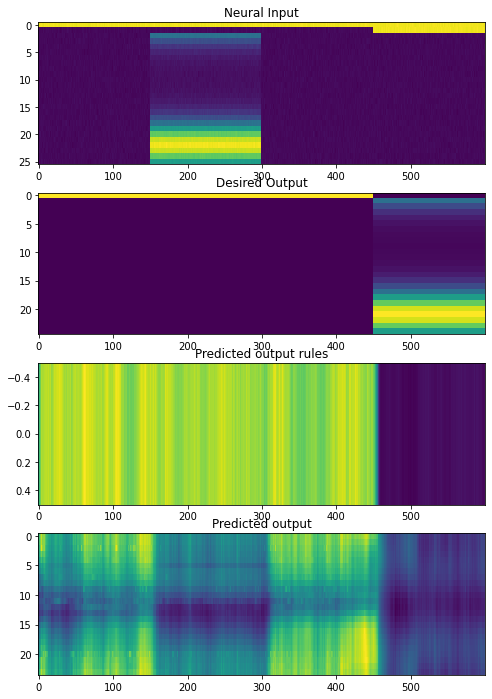

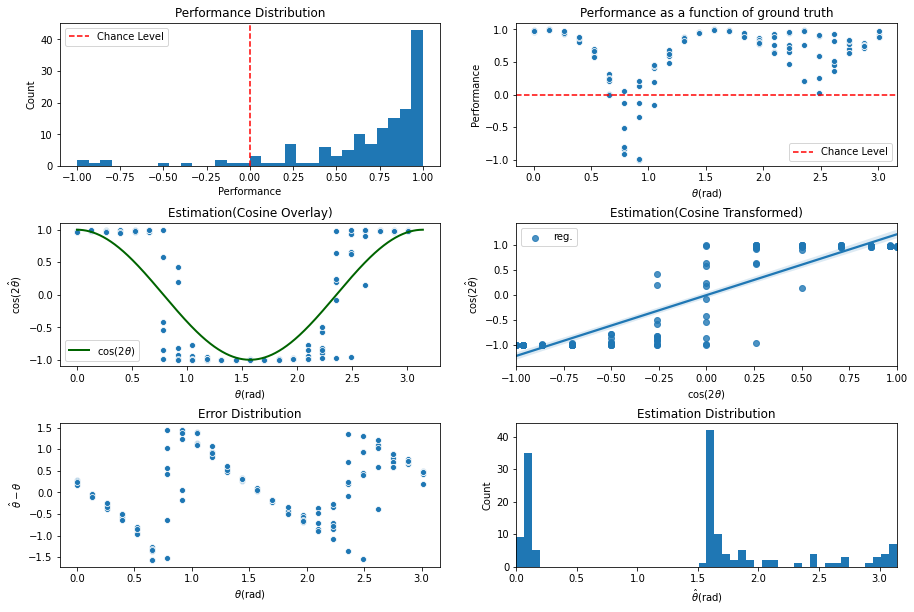

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter3400/assets

 Training performance: 
Iter. 3401 | Performance -0.0372 | Loss 0.2909 | Spike loss 2.5312
Testing performance: 
Iter. 3401 | Performance 0.6717 | Loss 0.2924 | Spike loss 2.5833

 Training performance: 
Iter. 3402 | Performance 0.0698 | Loss 0.2922 | Spike loss 2.6194
Testing performance: 
Iter. 3402 | Performance 0.6816 | Loss 0.2926 | Spike loss 2.5672

 Training performance: 
Iter. 3403 | Performance -0.0661 | Loss 0.2913 | Spike loss 2.5897
Testing performance: 
Iter. 3403 | Performance 0.6929 | Loss 0.2920 | Spike loss 2.5748

 Training performance: 
Iter. 3404 | Performance -0.0671 | Loss 0.2908 | Spike loss 2.5383
Testing performance: 
Iter. 3404 | Performance 0.6606 | Loss 0.2928 | Spike loss 2.5708

 Training performance: 
Iter. 3405 | Performance 0.0106 | Loss 0.2902 | Spike loss 2.6750
Testing performance: 
Iter. 3405 | Performance 0.6646 | Loss 0.2924 | Spike loss 2.5652

 Training 


 Training performance: 
Iter. 3447 | Performance 0.0532 | Loss 0.2865 | Spike loss 2.5388
Testing performance: 
Iter. 3447 | Performance 0.6778 | Loss 0.2916 | Spike loss 2.5825

 Training performance: 
Iter. 3448 | Performance -0.0885 | Loss 0.2906 | Spike loss 2.5328
Testing performance: 
Iter. 3448 | Performance 0.6678 | Loss 0.2926 | Spike loss 2.5574

 Training performance: 
Iter. 3449 | Performance 0.0541 | Loss 0.2901 | Spike loss 2.7231
Testing performance: 
Iter. 3449 | Performance 0.6779 | Loss 0.2923 | Spike loss 2.6002

 Training performance: 
Iter. 3450 | Performance 0.0228 | Loss 0.2904 | Spike loss 2.5546
Testing performance: 
Iter. 3450 | Performance 0.6981 | Loss 0.2916 | Spike loss 2.5913

 Training performance: 
Iter. 3451 | Performance -0.0760 | Loss 0.2885 | Spike loss 2.5714
Testing performance: 
Iter. 3451 | Performance 0.6810 | Loss 0.2915 | Spike loss 2.6120

 Training performance: 
Iter. 3452 | Performance 0.0510 | Loss 0.2918 | Spike loss 2.6529
Testing perf


 Training performance: 
Iter. 3493 | Performance 0.0030 | Loss 0.2898 | Spike loss 2.7761
Testing performance: 
Iter. 3493 | Performance 0.7291 | Loss 0.2909 | Spike loss 2.6837

 Training performance: 
Iter. 3494 | Performance -0.1927 | Loss 0.2900 | Spike loss 2.6709
Testing performance: 
Iter. 3494 | Performance 0.7317 | Loss 0.2906 | Spike loss 2.6545

 Training performance: 
Iter. 3495 | Performance 0.0614 | Loss 0.2905 | Spike loss 2.7209
Testing performance: 
Iter. 3495 | Performance 0.7349 | Loss 0.2903 | Spike loss 2.6435

 Training performance: 
Iter. 3496 | Performance 0.0246 | Loss 0.2920 | Spike loss 2.6068
Testing performance: 
Iter. 3496 | Performance 0.7139 | Loss 0.2908 | Spike loss 2.6310

 Training performance: 
Iter. 3497 | Performance 0.0130 | Loss 0.2871 | Spike loss 2.5442
Testing performance: 
Iter. 3497 | Performance 0.7078 | Loss 0.2911 | Spike loss 2.5941

 Training performance: 
Iter. 3498 | Performance 0.0469 | Loss 0.2898 | Spike loss 2.6203
Testing perfo

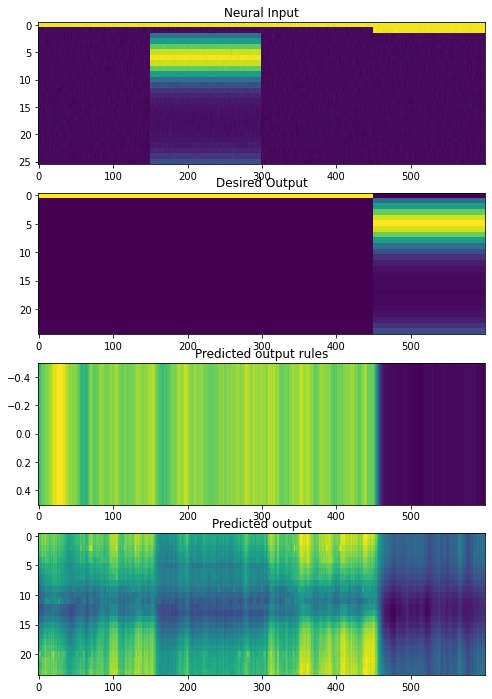

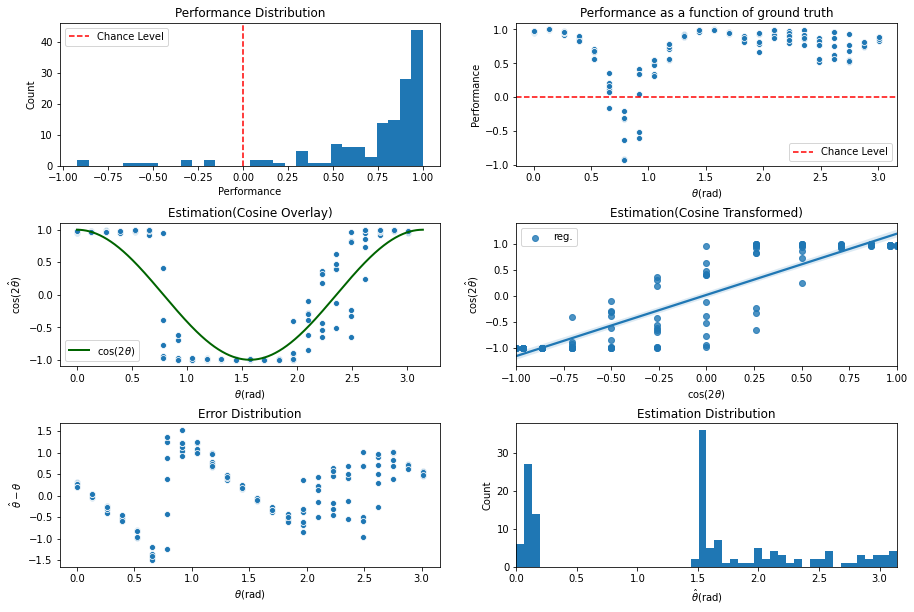

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter3500/assets

 Training performance: 
Iter. 3501 | Performance 0.0540 | Loss 0.2866 | Spike loss 2.6238
Testing performance: 
Iter. 3501 | Performance 0.7399 | Loss 0.2905 | Spike loss 2.6402

 Training performance: 
Iter. 3502 | Performance -0.0900 | Loss 0.2905 | Spike loss 2.6135
Testing performance: 
Iter. 3502 | Performance 0.7417 | Loss 0.2902 | Spike loss 2.6315

 Training performance: 
Iter. 3503 | Performance 0.0058 | Loss 0.2923 | Spike loss 2.7207
Testing performance: 
Iter. 3503 | Performance 0.7377 | Loss 0.2902 | Spike loss 2.6215

 Training performance: 
Iter. 3504 | Performance -0.0852 | Loss 0.2874 | Spike loss 2.7166
Testing performance: 
Iter. 3504 | Performance 0.7194 | Loss 0.2906 | Spike loss 2.6509

 Training performance: 
Iter. 3505 | Performance 0.0978 | Loss 0.2907 | Spike loss 2.6433
Testing performance: 
Iter. 3505 | Performance 0.7253 | Loss 0.2902 | Spike loss 2.6184

 Training p


 Training performance: 
Iter. 3547 | Performance -0.0625 | Loss 0.2898 | Spike loss 2.7820
Testing performance: 
Iter. 3547 | Performance 0.7359 | Loss 0.2896 | Spike loss 2.6864

 Training performance: 
Iter. 3548 | Performance 0.0540 | Loss 0.2872 | Spike loss 2.7198
Testing performance: 
Iter. 3548 | Performance 0.7589 | Loss 0.2899 | Spike loss 2.7080

 Training performance: 
Iter. 3549 | Performance -0.0619 | Loss 0.2884 | Spike loss 2.7233
Testing performance: 
Iter. 3549 | Performance 0.7505 | Loss 0.2892 | Spike loss 2.6803

 Training performance: 
Iter. 3550 | Performance 0.1301 | Loss 0.2902 | Spike loss 2.5545
Testing performance: 
Iter. 3550 | Performance 0.7632 | Loss 0.2891 | Spike loss 2.7429

 Training performance: 
Iter. 3551 | Performance -0.0248 | Loss 0.2902 | Spike loss 2.7633
Testing performance: 
Iter. 3551 | Performance 0.7584 | Loss 0.2892 | Spike loss 2.7288

 Training performance: 
Iter. 3552 | Performance 0.0327 | Loss 0.2839 | Spike loss 2.6607
Testing per


 Training performance: 
Iter. 3593 | Performance 0.0309 | Loss 0.2875 | Spike loss 2.8014
Testing performance: 
Iter. 3593 | Performance 0.7831 | Loss 0.2883 | Spike loss 2.7914

 Training performance: 
Iter. 3594 | Performance 0.0429 | Loss 0.2865 | Spike loss 2.8146
Testing performance: 
Iter. 3594 | Performance 0.8011 | Loss 0.2875 | Spike loss 2.7902

 Training performance: 
Iter. 3595 | Performance -0.0440 | Loss 0.2880 | Spike loss 2.7373
Testing performance: 
Iter. 3595 | Performance 0.7694 | Loss 0.2880 | Spike loss 2.7217

 Training performance: 
Iter. 3596 | Performance -0.0052 | Loss 0.2866 | Spike loss 2.6168
Testing performance: 
Iter. 3596 | Performance 0.7892 | Loss 0.2873 | Spike loss 2.7308

 Training performance: 
Iter. 3597 | Performance 0.0241 | Loss 0.2849 | Spike loss 2.6678
Testing performance: 
Iter. 3597 | Performance 0.7599 | Loss 0.2891 | Spike loss 2.7267

 Training performance: 
Iter. 3598 | Performance -0.0291 | Loss 0.2855 | Spike loss 2.7315
Testing per

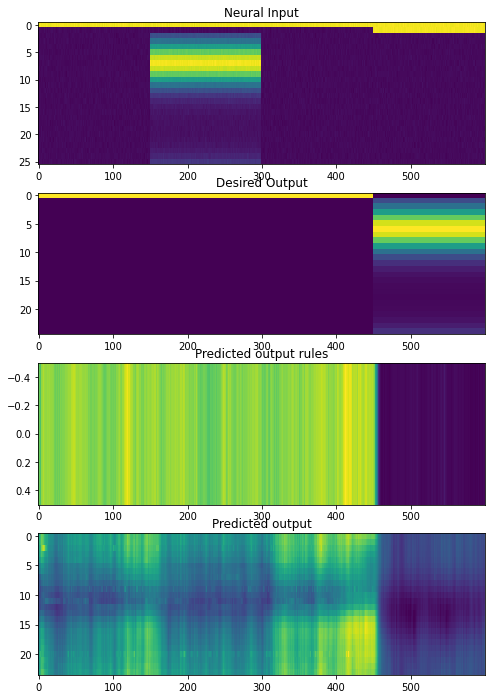

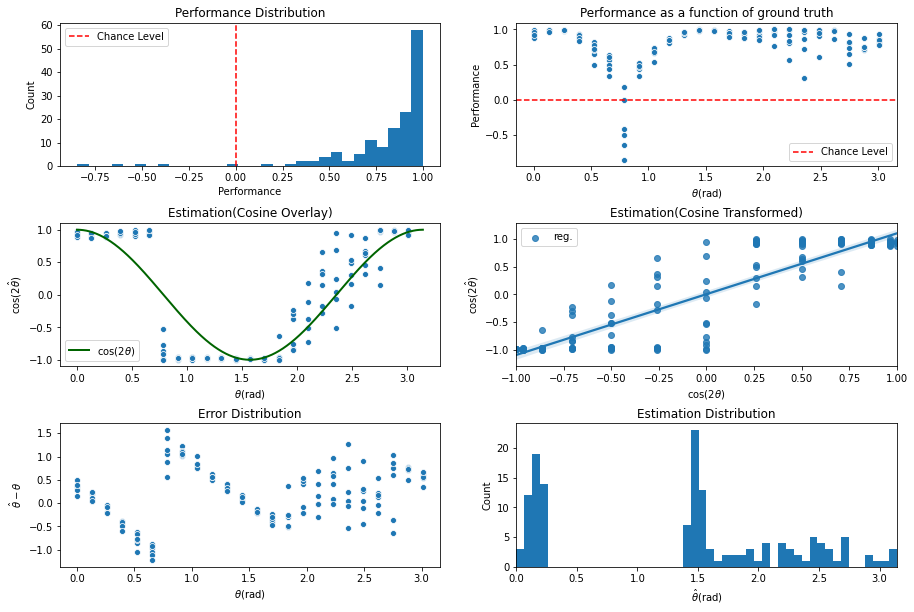

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter3600/assets

 Training performance: 
Iter. 3601 | Performance -0.0418 | Loss 0.2892 | Spike loss 2.7617
Testing performance: 
Iter. 3601 | Performance 0.7941 | Loss 0.2884 | Spike loss 2.8218

 Training performance: 
Iter. 3602 | Performance -0.0409 | Loss 0.2893 | Spike loss 2.9219
Testing performance: 
Iter. 3602 | Performance 0.8241 | Loss 0.2876 | Spike loss 2.8588

 Training performance: 
Iter. 3603 | Performance -0.0839 | Loss 0.2863 | Spike loss 2.8639
Testing performance: 
Iter. 3603 | Performance 0.8189 | Loss 0.2879 | Spike loss 2.8589

 Training performance: 
Iter. 3604 | Performance 0.0093 | Loss 0.2861 | Spike loss 2.8812
Testing performance: 
Iter. 3604 | Performance 0.8035 | Loss 0.2882 | Spike loss 2.8018

 Training performance: 
Iter. 3605 | Performance -0.0136 | Loss 0.2893 | Spike loss 2.8090
Testing performance: 
Iter. 3605 | Performance 0.8161 | Loss 0.2873 | Spike loss 2.8119

 Training


 Training performance: 
Iter. 3647 | Performance -0.0009 | Loss 0.2861 | Spike loss 2.8879
Testing performance: 
Iter. 3647 | Performance 0.8040 | Loss 0.2876 | Spike loss 2.7879

 Training performance: 
Iter. 3648 | Performance -0.0458 | Loss 0.2836 | Spike loss 2.7876
Testing performance: 
Iter. 3648 | Performance 0.8062 | Loss 0.2861 | Spike loss 2.7717

 Training performance: 
Iter. 3649 | Performance -0.0518 | Loss 0.2833 | Spike loss 2.7973
Testing performance: 
Iter. 3649 | Performance 0.8061 | Loss 0.2874 | Spike loss 2.8033

 Training performance: 
Iter. 3650 | Performance 0.0071 | Loss 0.2866 | Spike loss 2.7155
Testing performance: 
Iter. 3650 | Performance 0.8335 | Loss 0.2843 | Spike loss 2.8013

 Training performance: 
Iter. 3651 | Performance -0.0710 | Loss 0.2849 | Spike loss 2.7130
Testing performance: 
Iter. 3651 | Performance 0.8077 | Loss 0.2865 | Spike loss 2.7942

 Training performance: 
Iter. 3652 | Performance -0.0195 | Loss 0.2842 | Spike loss 2.7676
Testing p


 Training performance: 
Iter. 3693 | Performance 0.0248 | Loss 0.2816 | Spike loss 2.8433
Testing performance: 
Iter. 3693 | Performance 0.8595 | Loss 0.2840 | Spike loss 2.9242

 Training performance: 
Iter. 3694 | Performance 0.0165 | Loss 0.2817 | Spike loss 2.9069
Testing performance: 
Iter. 3694 | Performance 0.8476 | Loss 0.2841 | Spike loss 2.9102

 Training performance: 
Iter. 3695 | Performance 0.0210 | Loss 0.2861 | Spike loss 2.9329
Testing performance: 
Iter. 3695 | Performance 0.8652 | Loss 0.2831 | Spike loss 2.9092

 Training performance: 
Iter. 3696 | Performance -0.0340 | Loss 0.2848 | Spike loss 2.8683
Testing performance: 
Iter. 3696 | Performance 0.8485 | Loss 0.2842 | Spike loss 2.8567

 Training performance: 
Iter. 3697 | Performance 0.0382 | Loss 0.2863 | Spike loss 2.8605
Testing performance: 
Iter. 3697 | Performance 0.8576 | Loss 0.2834 | Spike loss 2.8670

 Training performance: 
Iter. 3698 | Performance 0.0253 | Loss 0.2843 | Spike loss 2.8842
Testing perfo

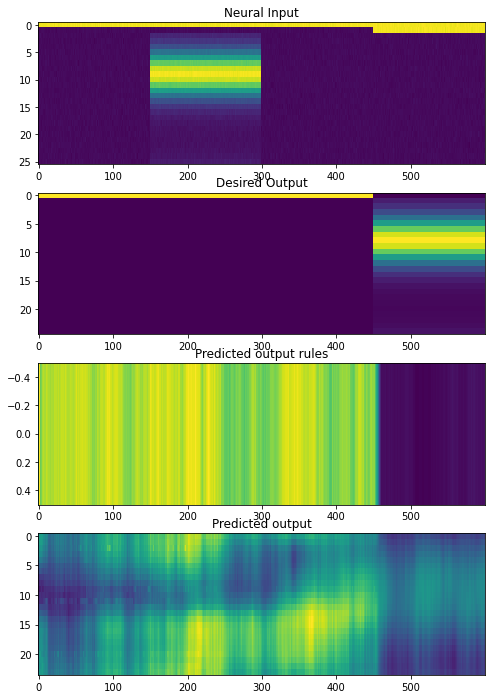

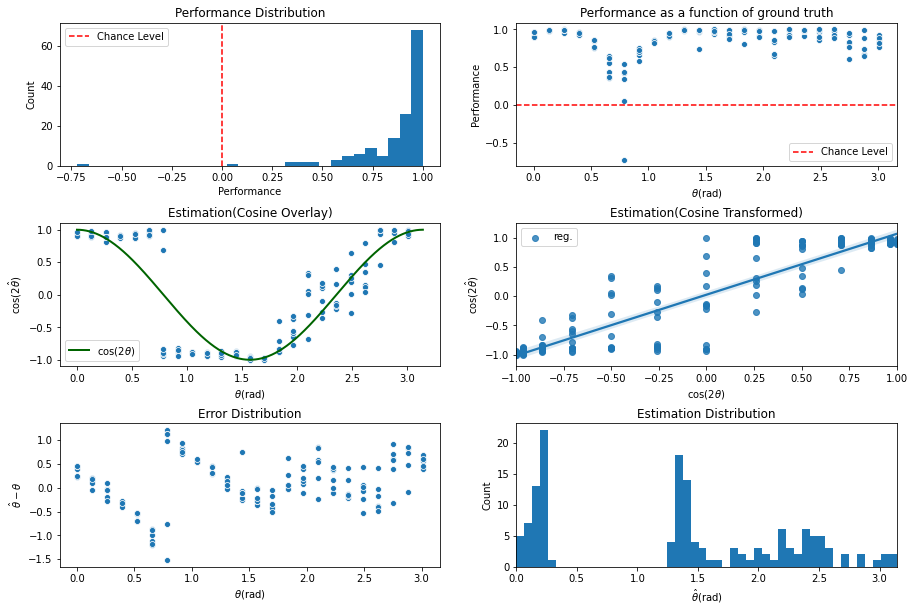

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter3700/assets

 Training performance: 
Iter. 3701 | Performance -0.0050 | Loss 0.2835 | Spike loss 2.8508
Testing performance: 
Iter. 3701 | Performance 0.8686 | Loss 0.2834 | Spike loss 2.8779

 Training performance: 
Iter. 3702 | Performance 0.0066 | Loss 0.2834 | Spike loss 2.7783
Testing performance: 
Iter. 3702 | Performance 0.8193 | Loss 0.2861 | Spike loss 2.8367

 Training performance: 
Iter. 3703 | Performance -0.0733 | Loss 0.2842 | Spike loss 2.8944
Testing performance: 
Iter. 3703 | Performance 0.8566 | Loss 0.2830 | Spike loss 2.8680

 Training performance: 
Iter. 3704 | Performance -0.0127 | Loss 0.2834 | Spike loss 2.9539
Testing performance: 
Iter. 3704 | Performance 0.8682 | Loss 0.2834 | Spike loss 2.9049

 Training performance: 
Iter. 3705 | Performance -0.1024 | Loss 0.2823 | Spike loss 2.9010
Testing performance: 
Iter. 3705 | Performance 0.8545 | Loss 0.2835 | Spike loss 2.8889

 Training


 Training performance: 
Iter. 3747 | Performance -0.0176 | Loss 0.2813 | Spike loss 2.8725
Testing performance: 
Iter. 3747 | Performance 0.8496 | Loss 0.2831 | Spike loss 2.8344

 Training performance: 
Iter. 3748 | Performance 0.0654 | Loss 0.2832 | Spike loss 2.8321
Testing performance: 
Iter. 3748 | Performance 0.8459 | Loss 0.2835 | Spike loss 2.8108

 Training performance: 
Iter. 3749 | Performance 0.0104 | Loss 0.2847 | Spike loss 2.7087
Testing performance: 
Iter. 3749 | Performance 0.8450 | Loss 0.2834 | Spike loss 2.8398

 Training performance: 
Iter. 3750 | Performance 0.1202 | Loss 0.2837 | Spike loss 2.7769
Testing performance: 
Iter. 3750 | Performance 0.8523 | Loss 0.2837 | Spike loss 2.8690

 Training performance: 
Iter. 3751 | Performance -0.0147 | Loss 0.2810 | Spike loss 2.8925
Testing performance: 
Iter. 3751 | Performance 0.8584 | Loss 0.2834 | Spike loss 2.9072

 Training performance: 
Iter. 3752 | Performance -0.0227 | Loss 0.2833 | Spike loss 2.8622
Testing per


 Training performance: 
Iter. 3793 | Performance 0.0740 | Loss 0.2807 | Spike loss 3.0017
Testing performance: 
Iter. 3793 | Performance 0.8588 | Loss 0.2834 | Spike loss 3.0306

 Training performance: 
Iter. 3794 | Performance -0.0032 | Loss 0.2826 | Spike loss 2.8868
Testing performance: 
Iter. 3794 | Performance 0.8747 | Loss 0.2832 | Spike loss 3.0087

 Training performance: 
Iter. 3795 | Performance -0.0857 | Loss 0.2815 | Spike loss 3.0479
Testing performance: 
Iter. 3795 | Performance 0.8862 | Loss 0.2828 | Spike loss 2.9770

 Training performance: 
Iter. 3796 | Performance -0.0419 | Loss 0.2819 | Spike loss 2.9634
Testing performance: 
Iter. 3796 | Performance 0.8739 | Loss 0.2826 | Spike loss 2.9579

 Training performance: 
Iter. 3797 | Performance 0.0295 | Loss 0.2810 | Spike loss 2.9713
Testing performance: 
Iter. 3797 | Performance 0.8814 | Loss 0.2813 | Spike loss 2.9450

 Training performance: 
Iter. 3798 | Performance 0.0020 | Loss 0.2814 | Spike loss 2.9700
Testing per

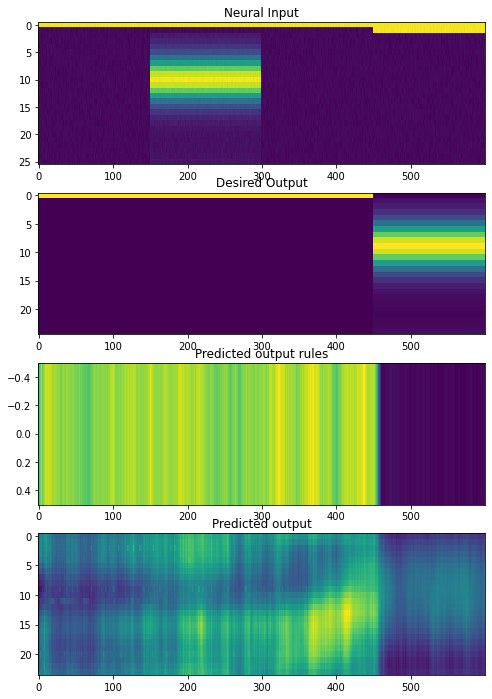

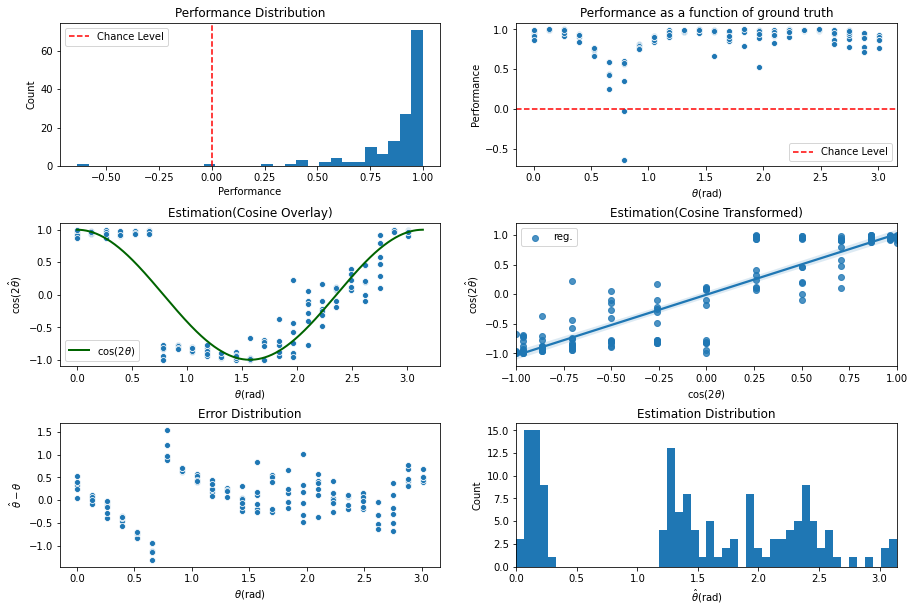

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter3800/assets

 Training performance: 
Iter. 3801 | Performance -0.0727 | Loss 0.2819 | Spike loss 2.8605
Testing performance: 
Iter. 3801 | Performance 0.8738 | Loss 0.2834 | Spike loss 2.9310

 Training performance: 
Iter. 3802 | Performance -0.0294 | Loss 0.2809 | Spike loss 2.8705
Testing performance: 
Iter. 3802 | Performance 0.8851 | Loss 0.2836 | Spike loss 2.9565

 Training performance: 
Iter. 3803 | Performance 0.0014 | Loss 0.2844 | Spike loss 2.8932
Testing performance: 
Iter. 3803 | Performance 0.8874 | Loss 0.2820 | Spike loss 2.9058

 Training performance: 
Iter. 3804 | Performance -0.0429 | Loss 0.2801 | Spike loss 3.0036
Testing performance: 
Iter. 3804 | Performance 0.8765 | Loss 0.2829 | Spike loss 2.8684

 Training performance: 
Iter. 3805 | Performance 0.0049 | Loss 0.2833 | Spike loss 2.8274
Testing performance: 
Iter. 3805 | Performance 0.8687 | Loss 0.2840 | Spike loss 2.8683

 Training 


 Training performance: 
Iter. 3847 | Performance 0.0567 | Loss 0.2834 | Spike loss 2.8492
Testing performance: 
Iter. 3847 | Performance 0.8499 | Loss 0.2836 | Spike loss 2.8196

 Training performance: 
Iter. 3848 | Performance 0.1037 | Loss 0.2839 | Spike loss 2.7468
Testing performance: 
Iter. 3848 | Performance 0.8506 | Loss 0.2839 | Spike loss 2.8062

 Training performance: 
Iter. 3849 | Performance 0.0007 | Loss 0.2821 | Spike loss 2.7966
Testing performance: 
Iter. 3849 | Performance 0.8378 | Loss 0.2843 | Spike loss 2.7696

 Training performance: 
Iter. 3850 | Performance -0.0520 | Loss 0.2819 | Spike loss 2.8569
Testing performance: 
Iter. 3850 | Performance 0.8376 | Loss 0.2848 | Spike loss 2.8056

 Training performance: 
Iter. 3851 | Performance -0.0563 | Loss 0.2804 | Spike loss 2.8431
Testing performance: 
Iter. 3851 | Performance 0.8669 | Loss 0.2827 | Spike loss 2.8618

 Training performance: 
Iter. 3852 | Performance -0.0389 | Loss 0.2822 | Spike loss 2.8736
Testing per


 Training performance: 
Iter. 3893 | Performance 0.0843 | Loss 0.2808 | Spike loss 3.0442
Testing performance: 
Iter. 3893 | Performance 0.8694 | Loss 0.2833 | Spike loss 3.0919

 Training performance: 
Iter. 3894 | Performance 0.0004 | Loss 0.2808 | Spike loss 3.1215
Testing performance: 
Iter. 3894 | Performance 0.8726 | Loss 0.2827 | Spike loss 3.1172

 Training performance: 
Iter. 3895 | Performance -0.1373 | Loss 0.2821 | Spike loss 3.0894
Testing performance: 
Iter. 3895 | Performance 0.8753 | Loss 0.2819 | Spike loss 3.0948

 Training performance: 
Iter. 3896 | Performance 0.0215 | Loss 0.2823 | Spike loss 3.0423
Testing performance: 
Iter. 3896 | Performance 0.8674 | Loss 0.2824 | Spike loss 3.0876

 Training performance: 
Iter. 3897 | Performance 0.0378 | Loss 0.2814 | Spike loss 2.9534
Testing performance: 
Iter. 3897 | Performance 0.8679 | Loss 0.2823 | Spike loss 3.0781

 Training performance: 
Iter. 3898 | Performance 0.0299 | Loss 0.2816 | Spike loss 3.0682
Testing perfo

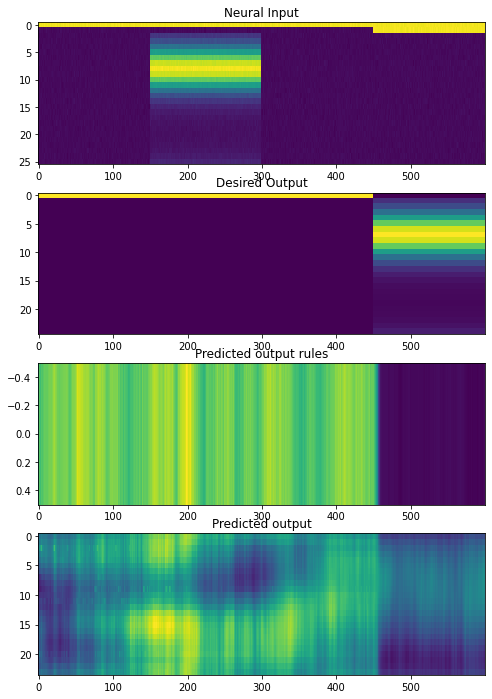

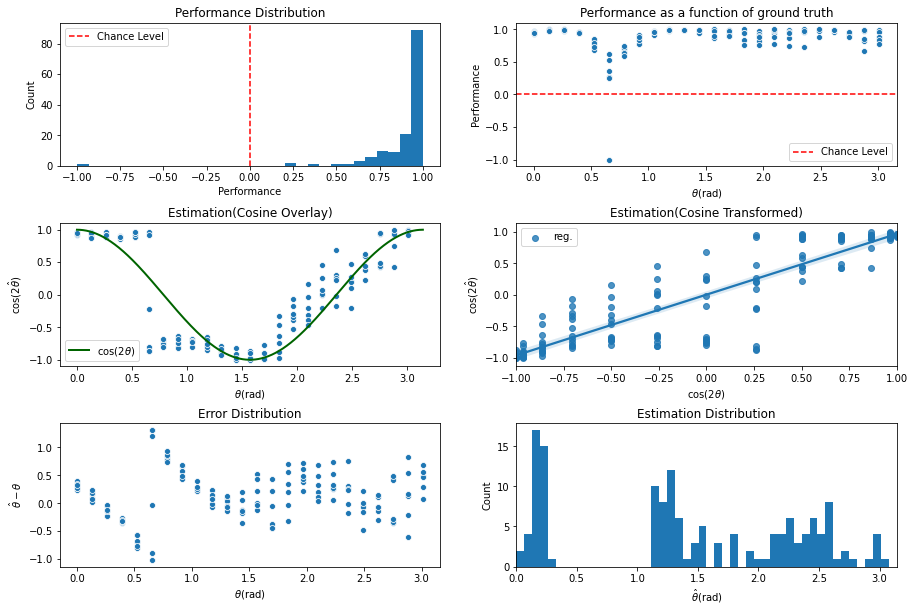

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter3900/assets

 Training performance: 
Iter. 3901 | Performance -0.0141 | Loss 0.2848 | Spike loss 3.0591
Testing performance: 
Iter. 3901 | Performance 0.9087 | Loss 0.2818 | Spike loss 3.2223

 Training performance: 
Iter. 3902 | Performance 0.0303 | Loss 0.2800 | Spike loss 3.2327
Testing performance: 
Iter. 3902 | Performance 0.8797 | Loss 0.2840 | Spike loss 3.2481

 Training performance: 
Iter. 3903 | Performance 0.0505 | Loss 0.2836 | Spike loss 3.3106
Testing performance: 
Iter. 3903 | Performance 0.8999 | Loss 0.2829 | Spike loss 3.3268

 Training performance: 
Iter. 3904 | Performance -0.0066 | Loss 0.2834 | Spike loss 3.1285
Testing performance: 
Iter. 3904 | Performance 0.8883 | Loss 0.2856 | Spike loss 3.3590

 Training performance: 
Iter. 3905 | Performance 0.0669 | Loss 0.2856 | Spike loss 3.2282
Testing performance: 
Iter. 3905 | Performance 0.8918 | Loss 0.2832 | Spike loss 3.2678

 Training p


 Training performance: 
Iter. 3947 | Performance 0.0010 | Loss 0.2829 | Spike loss 2.7460
Testing performance: 
Iter. 3947 | Performance 0.8705 | Loss 0.2828 | Spike loss 2.7533

 Training performance: 
Iter. 3948 | Performance -0.0460 | Loss 0.2822 | Spike loss 2.7143
Testing performance: 
Iter. 3948 | Performance 0.8930 | Loss 0.2826 | Spike loss 2.7787

 Training performance: 
Iter. 3949 | Performance 0.0745 | Loss 0.2831 | Spike loss 2.8729
Testing performance: 
Iter. 3949 | Performance 0.8587 | Loss 0.2857 | Spike loss 2.7999

 Training performance: 
Iter. 3950 | Performance 0.0745 | Loss 0.2831 | Spike loss 2.7143
Testing performance: 
Iter. 3950 | Performance 0.8796 | Loss 0.2855 | Spike loss 2.8063

 Training performance: 
Iter. 3951 | Performance 0.0977 | Loss 0.2839 | Spike loss 2.9280
Testing performance: 
Iter. 3951 | Performance 0.8758 | Loss 0.2841 | Spike loss 2.7689

 Training performance: 
Iter. 3952 | Performance 0.0696 | Loss 0.2811 | Spike loss 2.8060
Testing perfo


 Training performance: 
Iter. 3993 | Performance 0.0366 | Loss 0.2831 | Spike loss 2.9756
Testing performance: 
Iter. 3993 | Performance 0.8879 | Loss 0.2823 | Spike loss 2.8842

 Training performance: 
Iter. 3994 | Performance -0.0611 | Loss 0.2835 | Spike loss 2.9257
Testing performance: 
Iter. 3994 | Performance 0.8841 | Loss 0.2805 | Spike loss 2.8438

 Training performance: 
Iter. 3995 | Performance 0.0177 | Loss 0.2804 | Spike loss 2.8273
Testing performance: 
Iter. 3995 | Performance 0.8626 | Loss 0.2823 | Spike loss 2.8162

 Training performance: 
Iter. 3996 | Performance 0.0822 | Loss 0.2821 | Spike loss 2.8058
Testing performance: 
Iter. 3996 | Performance 0.8703 | Loss 0.2809 | Spike loss 2.8332

 Training performance: 
Iter. 3997 | Performance -0.0049 | Loss 0.2833 | Spike loss 2.8082
Testing performance: 
Iter. 3997 | Performance 0.8780 | Loss 0.2805 | Spike loss 2.8429

 Training performance: 
Iter. 3998 | Performance -0.0509 | Loss 0.2798 | Spike loss 2.8853
Testing per

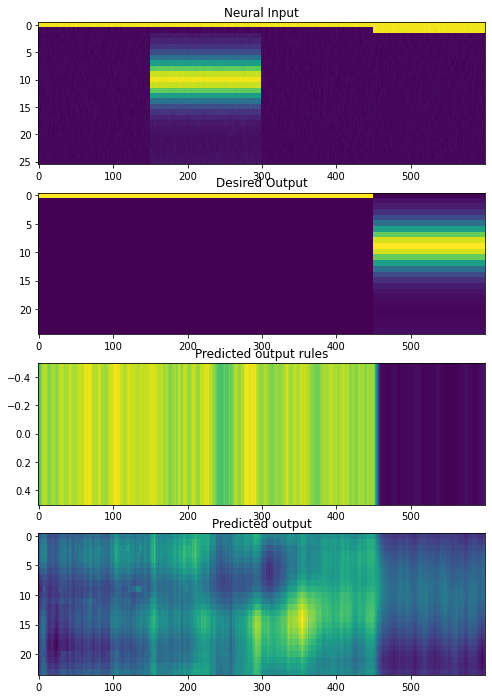

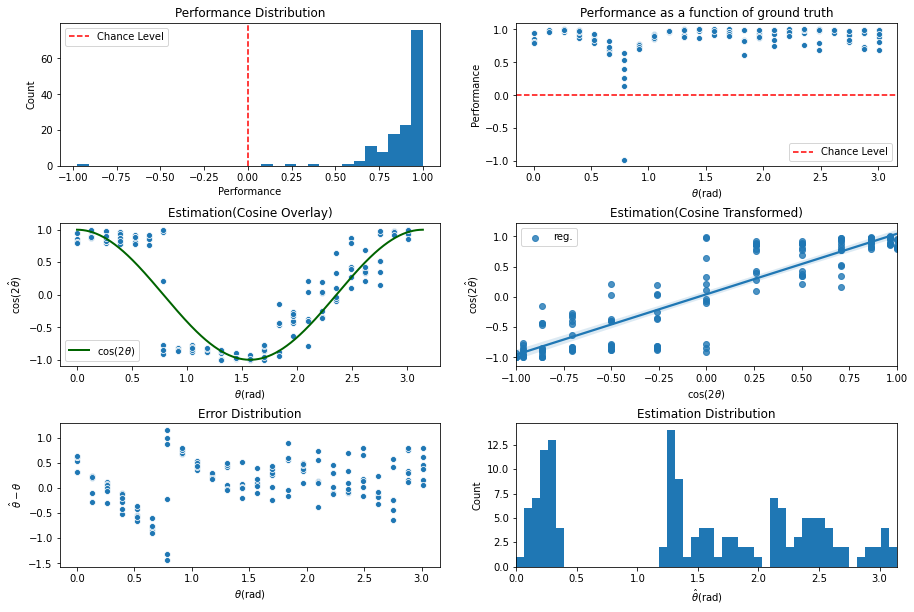

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter4000/assets

 Training performance: 
Iter. 4001 | Performance 0.0507 | Loss 0.2818 | Spike loss 2.8447
Testing performance: 
Iter. 4001 | Performance 0.8913 | Loss 0.2803 | Spike loss 2.9150

 Training performance: 
Iter. 4002 | Performance 0.0110 | Loss 0.2801 | Spike loss 2.9560
Testing performance: 
Iter. 4002 | Performance 0.8906 | Loss 0.2813 | Spike loss 2.9566

 Training performance: 
Iter. 4003 | Performance -0.0614 | Loss 0.2807 | Spike loss 3.0553
Testing performance: 
Iter. 4003 | Performance 0.8994 | Loss 0.2805 | Spike loss 2.9594

 Training performance: 
Iter. 4004 | Performance 0.0046 | Loss 0.2790 | Spike loss 2.9221
Testing performance: 
Iter. 4004 | Performance 0.8878 | Loss 0.2813 | Spike loss 2.9601

 Training performance: 
Iter. 4005 | Performance -0.1059 | Loss 0.2814 | Spike loss 2.8035
Testing performance: 
Iter. 4005 | Performance 0.8966 | Loss 0.2805 | Spike loss 2.9401

 Training p


 Training performance: 
Iter. 4047 | Performance 0.0275 | Loss 0.2809 | Spike loss 2.9834
Testing performance: 
Iter. 4047 | Performance 0.9162 | Loss 0.2814 | Spike loss 3.1322

 Training performance: 
Iter. 4048 | Performance -0.0963 | Loss 0.2824 | Spike loss 3.1004
Testing performance: 
Iter. 4048 | Performance 0.9118 | Loss 0.2812 | Spike loss 3.1886

 Training performance: 
Iter. 4049 | Performance -0.0283 | Loss 0.2808 | Spike loss 3.2376
Testing performance: 
Iter. 4049 | Performance 0.9178 | Loss 0.2805 | Spike loss 3.1831

 Training performance: 
Iter. 4050 | Performance -0.1012 | Loss 0.2819 | Spike loss 3.1577
Testing performance: 
Iter. 4050 | Performance 0.9080 | Loss 0.2810 | Spike loss 3.1091

 Training performance: 
Iter. 4051 | Performance -0.0011 | Loss 0.2805 | Spike loss 3.1738
Testing performance: 
Iter. 4051 | Performance 0.9015 | Loss 0.2809 | Spike loss 3.1391

 Training performance: 
Iter. 4052 | Performance 0.0474 | Loss 0.2808 | Spike loss 2.9917
Testing pe


 Training performance: 
Iter. 4093 | Performance -0.0074 | Loss 0.2831 | Spike loss 2.8730
Testing performance: 
Iter. 4093 | Performance 0.8944 | Loss 0.2808 | Spike loss 2.9674

 Training performance: 
Iter. 4094 | Performance -0.0295 | Loss 0.2817 | Spike loss 2.9574
Testing performance: 
Iter. 4094 | Performance 0.9142 | Loss 0.2824 | Spike loss 2.9959

 Training performance: 
Iter. 4095 | Performance -0.0409 | Loss 0.2812 | Spike loss 2.8816
Testing performance: 
Iter. 4095 | Performance 0.9236 | Loss 0.2823 | Spike loss 3.0173

 Training performance: 
Iter. 4096 | Performance -0.0468 | Loss 0.2826 | Spike loss 2.9842
Testing performance: 
Iter. 4096 | Performance 0.9205 | Loss 0.2805 | Spike loss 3.0152

 Training performance: 
Iter. 4097 | Performance -0.0334 | Loss 0.2815 | Spike loss 3.0486
Testing performance: 
Iter. 4097 | Performance 0.9116 | Loss 0.2827 | Spike loss 3.0419

 Training performance: 
Iter. 4098 | Performance 0.0699 | Loss 0.2798 | Spike loss 2.8517
Testing p

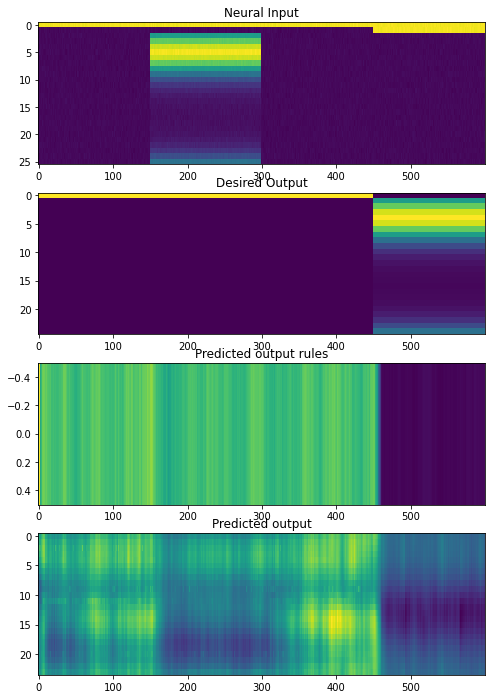

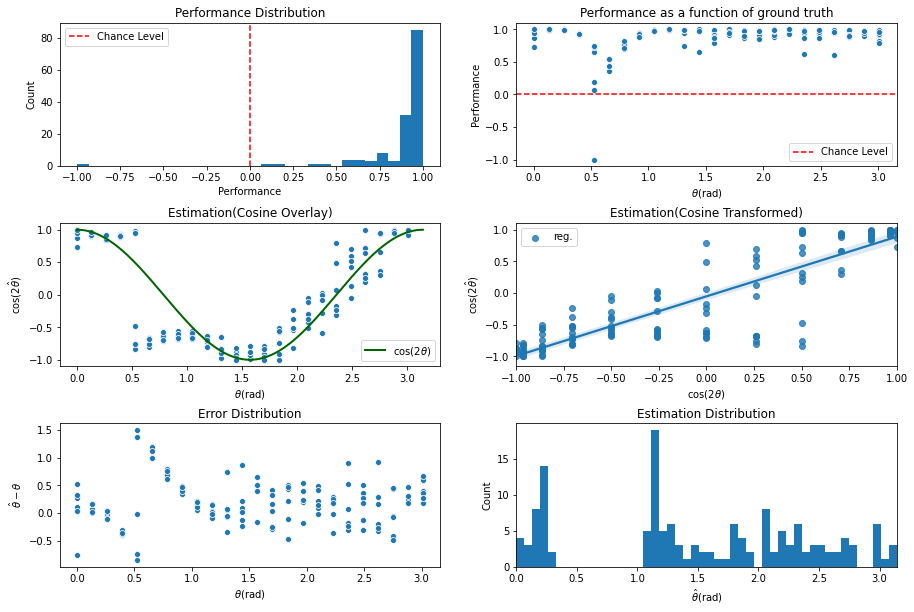

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter4100/assets

 Training performance: 
Iter. 4101 | Performance 0.0079 | Loss 0.2793 | Spike loss 3.0521
Testing performance: 
Iter. 4101 | Performance 0.8883 | Loss 0.2819 | Spike loss 2.9752

 Training performance: 
Iter. 4102 | Performance -0.0555 | Loss 0.2803 | Spike loss 3.0199
Testing performance: 
Iter. 4102 | Performance 0.9182 | Loss 0.2794 | Spike loss 2.9788

 Training performance: 
Iter. 4103 | Performance 0.0151 | Loss 0.2809 | Spike loss 2.8280
Testing performance: 
Iter. 4103 | Performance 0.8994 | Loss 0.2793 | Spike loss 2.9773

 Training performance: 
Iter. 4104 | Performance -0.0351 | Loss 0.2822 | Spike loss 2.9795
Testing performance: 
Iter. 4104 | Performance 0.8908 | Loss 0.2812 | Spike loss 2.9568

 Training performance: 
Iter. 4105 | Performance -0.0350 | Loss 0.2831 | Spike loss 2.9965
Testing performance: 
Iter. 4105 | Performance 0.9023 | Loss 0.2795 | Spike loss 2.9689

 Training 


 Training performance: 
Iter. 4147 | Performance -0.0431 | Loss 0.2774 | Spike loss 2.9575
Testing performance: 
Iter. 4147 | Performance 0.9012 | Loss 0.2797 | Spike loss 3.0418

 Training performance: 
Iter. 4148 | Performance 0.0142 | Loss 0.2795 | Spike loss 2.9463
Testing performance: 
Iter. 4148 | Performance 0.9135 | Loss 0.2792 | Spike loss 3.0236

 Training performance: 
Iter. 4149 | Performance -0.0257 | Loss 0.2813 | Spike loss 3.0400
Testing performance: 
Iter. 4149 | Performance 0.9053 | Loss 0.2801 | Spike loss 3.0837

 Training performance: 
Iter. 4150 | Performance -0.1482 | Loss 0.2772 | Spike loss 3.0727
Testing performance: 
Iter. 4150 | Performance 0.9048 | Loss 0.2794 | Spike loss 3.1544

 Training performance: 
Iter. 4151 | Performance 0.0107 | Loss 0.2792 | Spike loss 3.0386
Testing performance: 
Iter. 4151 | Performance 0.9054 | Loss 0.2808 | Spike loss 3.1657

 Training performance: 
Iter. 4152 | Performance -0.0754 | Loss 0.2790 | Spike loss 3.1062
Testing pe


 Training performance: 
Iter. 4193 | Performance -0.0791 | Loss 0.2806 | Spike loss 3.0031
Testing performance: 
Iter. 4193 | Performance 0.9012 | Loss 0.2800 | Spike loss 3.0027

 Training performance: 
Iter. 4194 | Performance -0.0223 | Loss 0.2794 | Spike loss 3.1027
Testing performance: 
Iter. 4194 | Performance 0.8914 | Loss 0.2806 | Spike loss 3.0359

 Training performance: 
Iter. 4195 | Performance 0.0547 | Loss 0.2784 | Spike loss 2.9167
Testing performance: 
Iter. 4195 | Performance 0.9139 | Loss 0.2799 | Spike loss 3.0559

 Training performance: 
Iter. 4196 | Performance 0.0208 | Loss 0.2787 | Spike loss 3.0160
Testing performance: 
Iter. 4196 | Performance 0.9291 | Loss 0.2787 | Spike loss 3.0466

 Training performance: 
Iter. 4197 | Performance -0.0247 | Loss 0.2791 | Spike loss 3.1019
Testing performance: 
Iter. 4197 | Performance 0.9208 | Loss 0.2791 | Spike loss 3.0707

 Training performance: 
Iter. 4198 | Performance 0.1424 | Loss 0.2794 | Spike loss 3.0351
Testing per

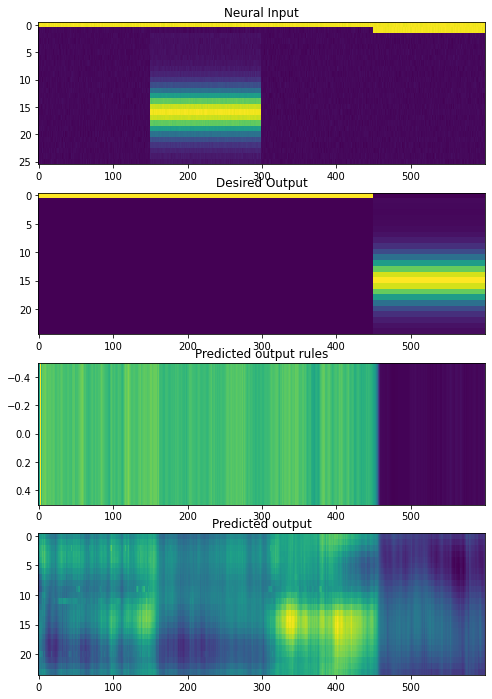

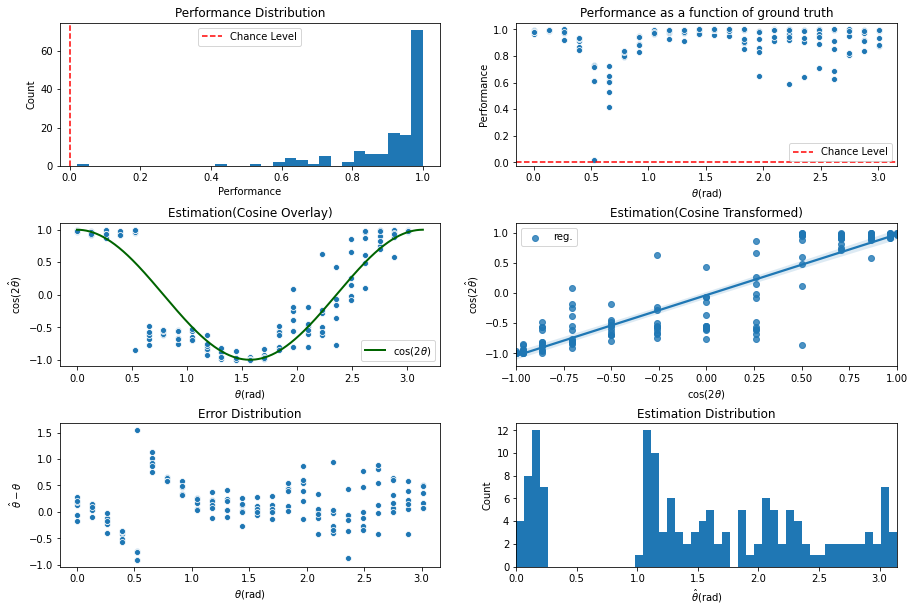

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter4200/assets

 Training performance: 
Iter. 4201 | Performance -0.0582 | Loss 0.2794 | Spike loss 2.9278
Testing performance: 
Iter. 4201 | Performance 0.9212 | Loss 0.2788 | Spike loss 2.9344

 Training performance: 
Iter. 4202 | Performance -0.1025 | Loss 0.2784 | Spike loss 2.9401
Testing performance: 
Iter. 4202 | Performance 0.9167 | Loss 0.2792 | Spike loss 2.9493

 Training performance: 
Iter. 4203 | Performance -0.0940 | Loss 0.2785 | Spike loss 2.7789
Testing performance: 
Iter. 4203 | Performance 0.9242 | Loss 0.2781 | Spike loss 2.9417

 Training performance: 
Iter. 4204 | Performance 0.0463 | Loss 0.2772 | Spike loss 2.9162
Testing performance: 
Iter. 4204 | Performance 0.9143 | Loss 0.2792 | Spike loss 2.9414

 Training performance: 
Iter. 4205 | Performance -0.0850 | Loss 0.2784 | Spike loss 2.9191
Testing performance: 
Iter. 4205 | Performance 0.9177 | Loss 0.2788 | Spike loss 2.9413

 Training


 Training performance: 
Iter. 4247 | Performance -0.0222 | Loss 0.2784 | Spike loss 2.9153
Testing performance: 
Iter. 4247 | Performance 0.9165 | Loss 0.2789 | Spike loss 2.9271

 Training performance: 
Iter. 4248 | Performance -0.0730 | Loss 0.2795 | Spike loss 2.8725
Testing performance: 
Iter. 4248 | Performance 0.9159 | Loss 0.2789 | Spike loss 2.9267

 Training performance: 
Iter. 4249 | Performance 0.0179 | Loss 0.2804 | Spike loss 2.8089
Testing performance: 
Iter. 4249 | Performance 0.9096 | Loss 0.2800 | Spike loss 2.8983

 Training performance: 
Iter. 4250 | Performance -0.0343 | Loss 0.2782 | Spike loss 2.8884
Testing performance: 
Iter. 4250 | Performance 0.9314 | Loss 0.2778 | Spike loss 2.8692

 Training performance: 
Iter. 4251 | Performance -0.0238 | Loss 0.2780 | Spike loss 2.7603
Testing performance: 
Iter. 4251 | Performance 0.9256 | Loss 0.2789 | Spike loss 2.9093

 Training performance: 
Iter. 4252 | Performance -0.0195 | Loss 0.2788 | Spike loss 2.7429
Testing p


 Training performance: 
Iter. 4293 | Performance -0.0196 | Loss 0.2801 | Spike loss 3.0251
Testing performance: 
Iter. 4293 | Performance 0.9034 | Loss 0.2793 | Spike loss 3.1197

 Training performance: 
Iter. 4294 | Performance -0.0383 | Loss 0.2780 | Spike loss 2.9688
Testing performance: 
Iter. 4294 | Performance 0.9071 | Loss 0.2800 | Spike loss 3.1371

 Training performance: 
Iter. 4295 | Performance -0.1021 | Loss 0.2787 | Spike loss 3.0350
Testing performance: 
Iter. 4295 | Performance 0.9223 | Loss 0.2795 | Spike loss 3.1638

 Training performance: 
Iter. 4296 | Performance -0.0283 | Loss 0.2785 | Spike loss 3.0058
Testing performance: 
Iter. 4296 | Performance 0.9266 | Loss 0.2787 | Spike loss 3.1594

 Training performance: 
Iter. 4297 | Performance -0.0558 | Loss 0.2786 | Spike loss 3.0584
Testing performance: 
Iter. 4297 | Performance 0.9196 | Loss 0.2792 | Spike loss 3.1742

 Training performance: 
Iter. 4298 | Performance 0.0626 | Loss 0.2799 | Spike loss 3.0917
Testing p

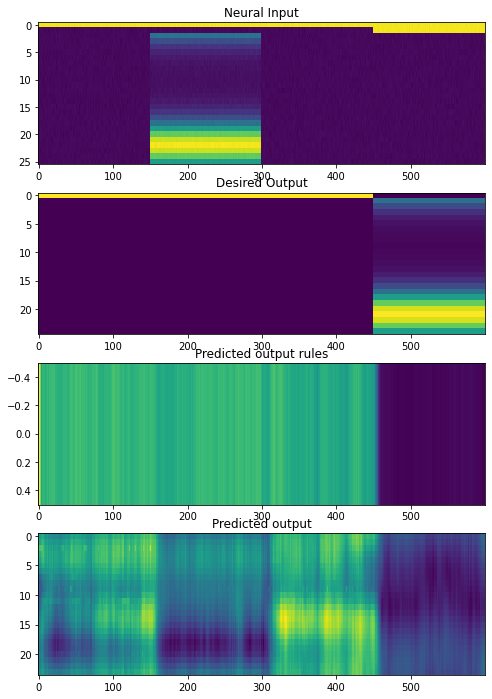

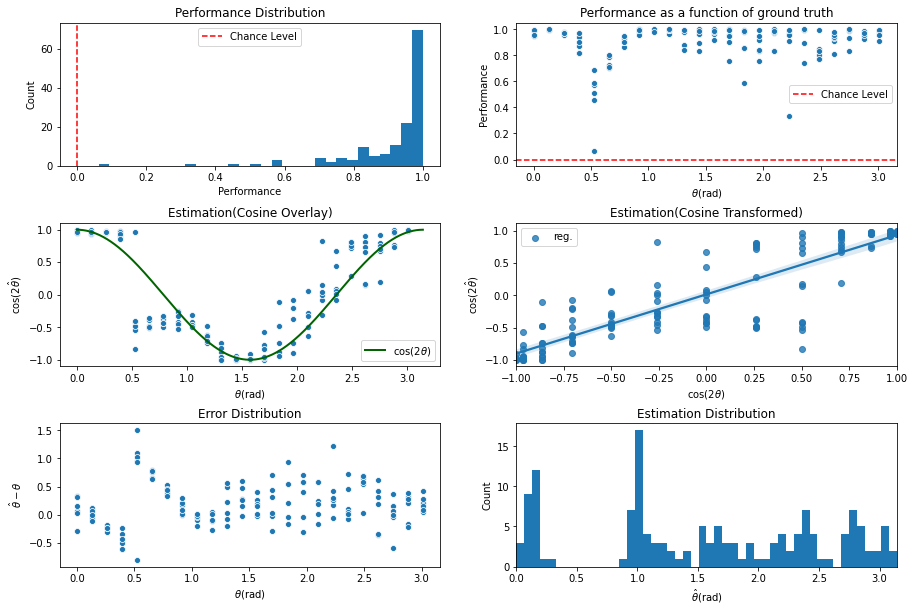

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter4300/assets

 Training performance: 
Iter. 4301 | Performance 0.0096 | Loss 0.2785 | Spike loss 3.0183
Testing performance: 
Iter. 4301 | Performance 0.9056 | Loss 0.2791 | Spike loss 3.0949

 Training performance: 
Iter. 4302 | Performance -0.0190 | Loss 0.2798 | Spike loss 3.0537
Testing performance: 
Iter. 4302 | Performance 0.9147 | Loss 0.2783 | Spike loss 3.0438

 Training performance: 
Iter. 4303 | Performance -0.0619 | Loss 0.2775 | Spike loss 2.9522
Testing performance: 
Iter. 4303 | Performance 0.9059 | Loss 0.2790 | Spike loss 3.0188

 Training performance: 
Iter. 4304 | Performance 0.0046 | Loss 0.2782 | Spike loss 2.8718
Testing performance: 
Iter. 4304 | Performance 0.8987 | Loss 0.2793 | Spike loss 3.0323

 Training performance: 
Iter. 4305 | Performance 0.0838 | Loss 0.2769 | Spike loss 2.9078
Testing performance: 
Iter. 4305 | Performance 0.9159 | Loss 0.2782 | Spike loss 2.9886

 Training p


 Training performance: 
Iter. 4347 | Performance 0.0220 | Loss 0.2805 | Spike loss 2.7986
Testing performance: 
Iter. 4347 | Performance 0.9221 | Loss 0.2796 | Spike loss 2.8057

 Training performance: 
Iter. 4348 | Performance -0.0440 | Loss 0.2786 | Spike loss 2.8486
Testing performance: 
Iter. 4348 | Performance 0.9180 | Loss 0.2800 | Spike loss 2.7985

 Training performance: 
Iter. 4349 | Performance -0.0801 | Loss 0.2786 | Spike loss 2.8021
Testing performance: 
Iter. 4349 | Performance 0.9079 | Loss 0.2802 | Spike loss 2.8044

 Training performance: 
Iter. 4350 | Performance -0.0049 | Loss 0.2781 | Spike loss 2.7912
Testing performance: 
Iter. 4350 | Performance 0.9128 | Loss 0.2799 | Spike loss 2.7871

 Training performance: 
Iter. 4351 | Performance 0.0495 | Loss 0.2777 | Spike loss 2.7881
Testing performance: 
Iter. 4351 | Performance 0.9227 | Loss 0.2785 | Spike loss 2.7991

 Training performance: 
Iter. 4352 | Performance -0.0802 | Loss 0.2813 | Spike loss 2.6941
Testing pe


 Training performance: 
Iter. 4393 | Performance 0.0104 | Loss 0.2787 | Spike loss 2.6616
Testing performance: 
Iter. 4393 | Performance 0.9053 | Loss 0.2787 | Spike loss 2.7339

 Training performance: 
Iter. 4394 | Performance -0.0548 | Loss 0.2791 | Spike loss 2.6967
Testing performance: 
Iter. 4394 | Performance 0.9031 | Loss 0.2791 | Spike loss 2.7270

 Training performance: 
Iter. 4395 | Performance 0.0184 | Loss 0.2784 | Spike loss 2.7644
Testing performance: 
Iter. 4395 | Performance 0.9124 | Loss 0.2787 | Spike loss 2.7215

 Training performance: 
Iter. 4396 | Performance 0.0758 | Loss 0.2777 | Spike loss 2.8285
Testing performance: 
Iter. 4396 | Performance 0.9078 | Loss 0.2792 | Spike loss 2.7463

 Training performance: 
Iter. 4397 | Performance 0.0382 | Loss 0.2804 | Spike loss 2.7100
Testing performance: 
Iter. 4397 | Performance 0.9088 | Loss 0.2791 | Spike loss 2.7623

 Training performance: 
Iter. 4398 | Performance -0.0677 | Loss 0.2779 | Spike loss 2.7558
Testing perf

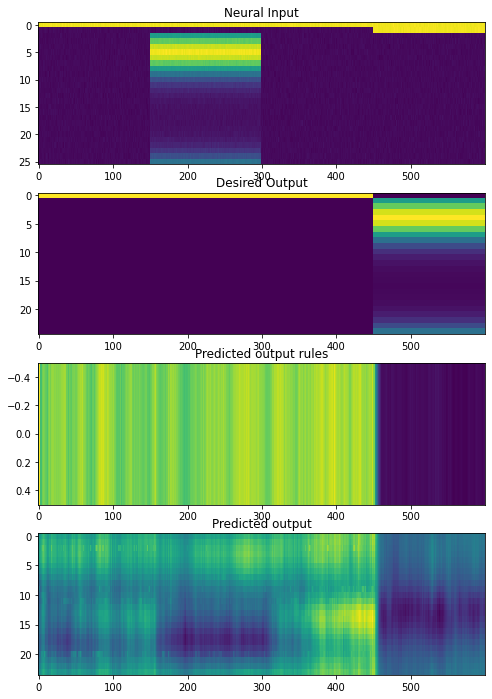

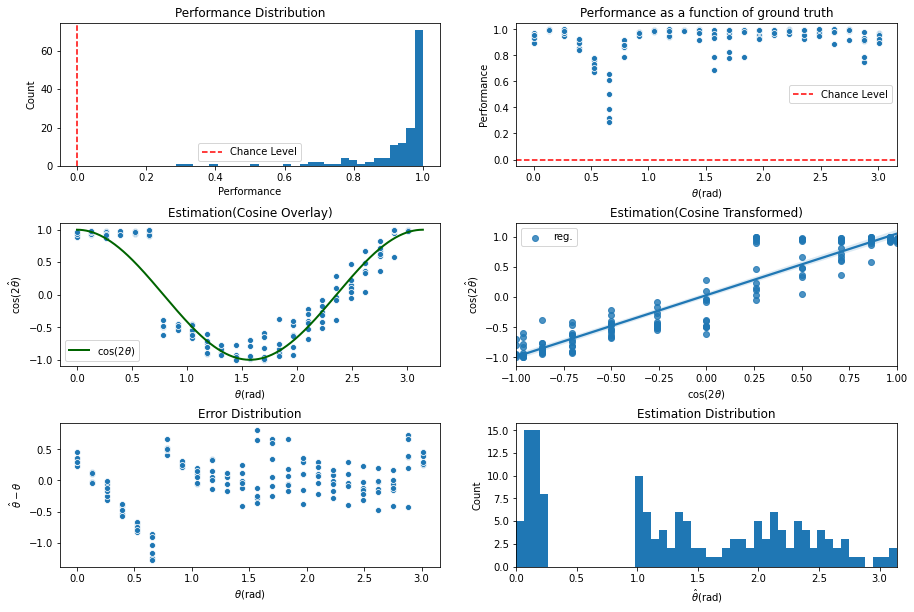

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter4400/assets

 Training performance: 
Iter. 4401 | Performance -0.0196 | Loss 0.2796 | Spike loss 2.7347
Testing performance: 
Iter. 4401 | Performance 0.9232 | Loss 0.2787 | Spike loss 2.8416

 Training performance: 
Iter. 4402 | Performance -0.0038 | Loss 0.2769 | Spike loss 2.8796
Testing performance: 
Iter. 4402 | Performance 0.9214 | Loss 0.2782 | Spike loss 2.8462

 Training performance: 
Iter. 4403 | Performance 0.0085 | Loss 0.2799 | Spike loss 2.8402
Testing performance: 
Iter. 4403 | Performance 0.9252 | Loss 0.2778 | Spike loss 2.8106

 Training performance: 
Iter. 4404 | Performance 0.0886 | Loss 0.2772 | Spike loss 2.9194
Testing performance: 
Iter. 4404 | Performance 0.9224 | Loss 0.2779 | Spike loss 2.8226

 Training performance: 
Iter. 4405 | Performance -0.0138 | Loss 0.2776 | Spike loss 2.8170
Testing performance: 
Iter. 4405 | Performance 0.9095 | Loss 0.2782 | Spike loss 2.8328

 Training 


 Training performance: 
Iter. 4447 | Performance -0.1246 | Loss 0.2771 | Spike loss 2.9717
Testing performance: 
Iter. 4447 | Performance 0.9063 | Loss 0.2786 | Spike loss 2.8041

 Training performance: 
Iter. 4448 | Performance -0.1186 | Loss 0.2771 | Spike loss 2.7505
Testing performance: 
Iter. 4448 | Performance 0.9136 | Loss 0.2789 | Spike loss 2.8165

 Training performance: 
Iter. 4449 | Performance 0.0595 | Loss 0.2787 | Spike loss 2.8335
Testing performance: 
Iter. 4449 | Performance 0.9022 | Loss 0.2784 | Spike loss 2.8086

 Training performance: 
Iter. 4450 | Performance -0.0270 | Loss 0.2770 | Spike loss 2.7880
Testing performance: 
Iter. 4450 | Performance 0.9153 | Loss 0.2802 | Spike loss 2.8637

 Training performance: 
Iter. 4451 | Performance 0.0971 | Loss 0.2777 | Spike loss 2.8718
Testing performance: 
Iter. 4451 | Performance 0.9261 | Loss 0.2796 | Spike loss 2.8704

 Training performance: 
Iter. 4452 | Performance -0.1124 | Loss 0.2800 | Spike loss 2.9285
Testing pe


 Training performance: 
Iter. 4493 | Performance 0.0029 | Loss 0.2834 | Spike loss 3.3978
Testing performance: 
Iter. 4493 | Performance 0.9059 | Loss 0.2822 | Spike loss 3.4885

 Training performance: 
Iter. 4494 | Performance 0.0301 | Loss 0.2831 | Spike loss 3.6013
Testing performance: 
Iter. 4494 | Performance 0.9147 | Loss 0.2823 | Spike loss 3.4814

 Training performance: 
Iter. 4495 | Performance 0.0735 | Loss 0.2837 | Spike loss 3.5027
Testing performance: 
Iter. 4495 | Performance 0.8910 | Loss 0.2853 | Spike loss 3.4920

 Training performance: 
Iter. 4496 | Performance -0.0320 | Loss 0.2821 | Spike loss 3.3613
Testing performance: 
Iter. 4496 | Performance 0.9109 | Loss 0.2811 | Spike loss 3.4887

 Training performance: 
Iter. 4497 | Performance -0.0774 | Loss 0.2811 | Spike loss 3.3071
Testing performance: 
Iter. 4497 | Performance 0.9198 | Loss 0.2824 | Spike loss 3.4227

 Training performance: 
Iter. 4498 | Performance 0.0657 | Loss 0.2854 | Spike loss 3.6533
Testing perf

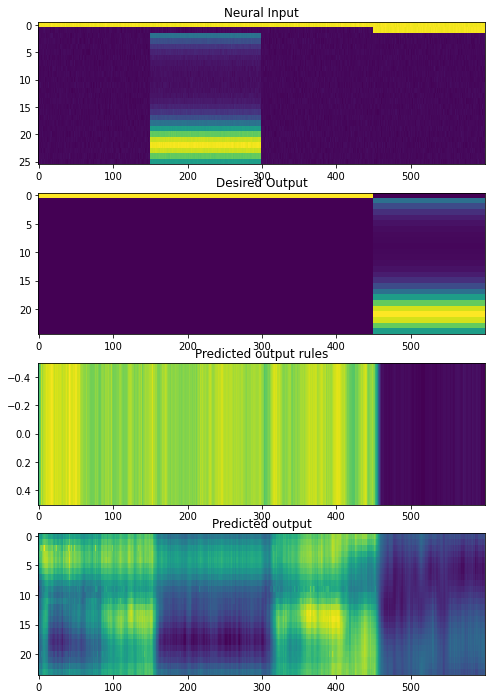

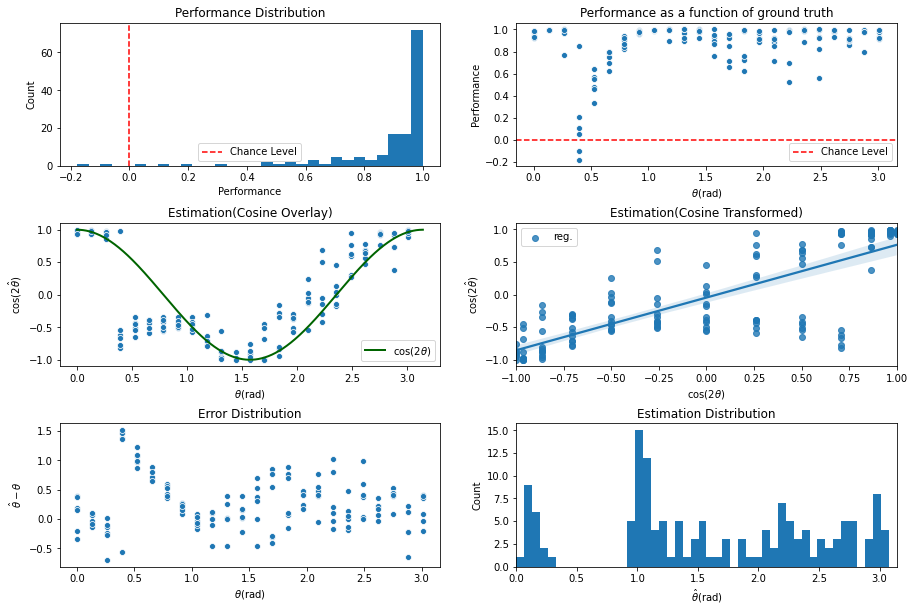

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter4500/assets

 Training performance: 
Iter. 4501 | Performance -0.0083 | Loss 0.2826 | Spike loss 3.3868
Testing performance: 
Iter. 4501 | Performance 0.8854 | Loss 0.2831 | Spike loss 3.4033

 Training performance: 
Iter. 4502 | Performance 0.0122 | Loss 0.2809 | Spike loss 3.4656
Testing performance: 
Iter. 4502 | Performance 0.8857 | Loss 0.2812 | Spike loss 3.4033

 Training performance: 
Iter. 4503 | Performance 0.0766 | Loss 0.2810 | Spike loss 3.3423
Testing performance: 
Iter. 4503 | Performance 0.9101 | Loss 0.2823 | Spike loss 3.3641

 Training performance: 
Iter. 4504 | Performance -0.0092 | Loss 0.2816 | Spike loss 3.3056
Testing performance: 
Iter. 4504 | Performance 0.9017 | Loss 0.2852 | Spike loss 3.3917

 Training performance: 
Iter. 4505 | Performance -0.1207 | Loss 0.2858 | Spike loss 3.3681
Testing performance: 
Iter. 4505 | Performance 0.9008 | Loss 0.2811 | Spike loss 3.3199

 Training 


 Training performance: 
Iter. 4547 | Performance 0.0740 | Loss 0.2811 | Spike loss 3.0865
Testing performance: 
Iter. 4547 | Performance 0.9072 | Loss 0.2788 | Spike loss 3.1276

 Training performance: 
Iter. 4548 | Performance 0.0302 | Loss 0.2777 | Spike loss 2.9931
Testing performance: 
Iter. 4548 | Performance 0.8943 | Loss 0.2804 | Spike loss 3.0548

 Training performance: 
Iter. 4549 | Performance 0.0942 | Loss 0.2804 | Spike loss 3.0800
Testing performance: 
Iter. 4549 | Performance 0.9188 | Loss 0.2806 | Spike loss 3.0733

 Training performance: 
Iter. 4550 | Performance 0.0143 | Loss 0.2790 | Spike loss 3.0075
Testing performance: 
Iter. 4550 | Performance 0.9114 | Loss 0.2781 | Spike loss 3.0810

 Training performance: 
Iter. 4551 | Performance -0.0968 | Loss 0.2789 | Spike loss 3.0634
Testing performance: 
Iter. 4551 | Performance 0.9261 | Loss 0.2792 | Spike loss 3.0952

 Training performance: 
Iter. 4552 | Performance -0.0077 | Loss 0.2793 | Spike loss 3.1641
Testing perf


 Training performance: 
Iter. 4593 | Performance -0.0395 | Loss 0.2819 | Spike loss 3.2632
Testing performance: 
Iter. 4593 | Performance 0.9065 | Loss 0.2818 | Spike loss 3.3797

 Training performance: 
Iter. 4594 | Performance 0.0578 | Loss 0.2825 | Spike loss 3.1100
Testing performance: 
Iter. 4594 | Performance 0.8989 | Loss 0.2842 | Spike loss 3.3836

 Training performance: 
Iter. 4595 | Performance 0.0062 | Loss 0.2846 | Spike loss 3.3138
Testing performance: 
Iter. 4595 | Performance 0.9031 | Loss 0.2812 | Spike loss 3.4163

 Training performance: 
Iter. 4596 | Performance 0.0535 | Loss 0.2823 | Spike loss 3.3529
Testing performance: 
Iter. 4596 | Performance 0.8885 | Loss 0.2850 | Spike loss 3.4728

 Training performance: 
Iter. 4597 | Performance 0.0316 | Loss 0.2898 | Spike loss 3.6584
Testing performance: 
Iter. 4597 | Performance 0.8722 | Loss 0.2891 | Spike loss 3.5448

 Training performance: 
Iter. 4598 | Performance -0.0748 | Loss 0.2882 | Spike loss 3.4806
Testing perf

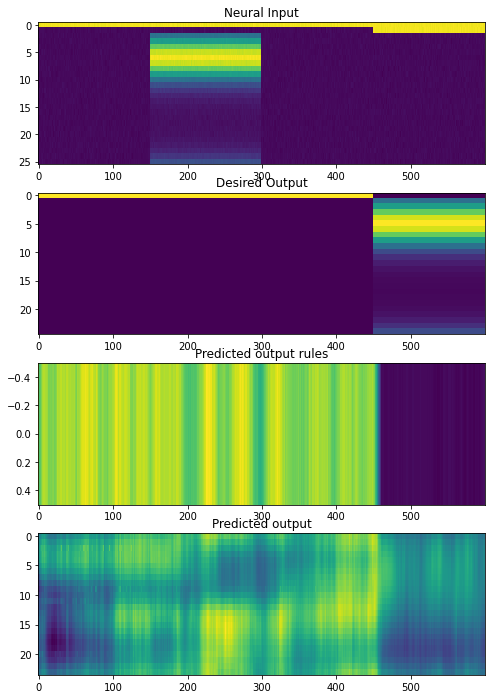

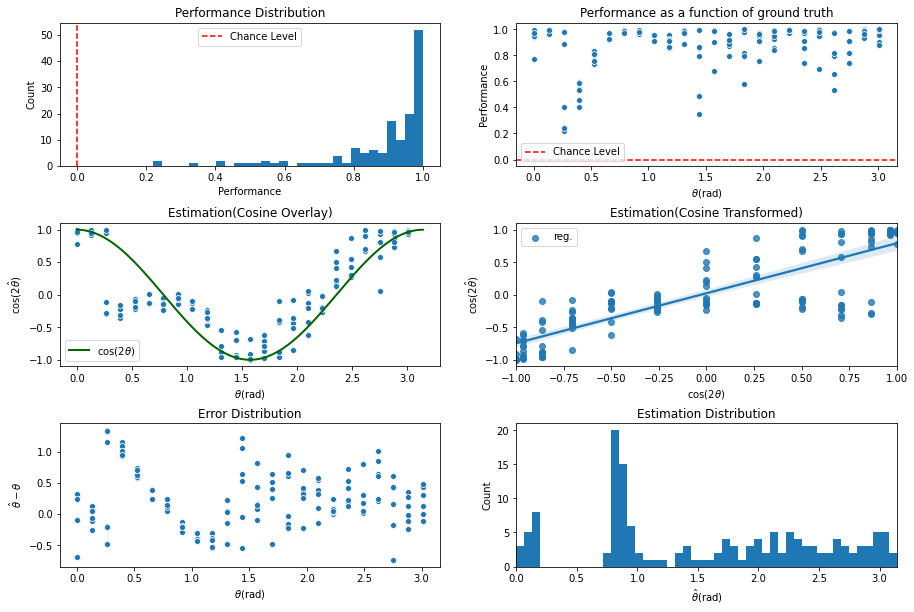

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter4600/assets

 Training performance: 
Iter. 4601 | Performance -0.1360 | Loss 0.2864 | Spike loss 3.5089
Testing performance: 
Iter. 4601 | Performance 0.8842 | Loss 0.2820 | Spike loss 3.3606

 Training performance: 
Iter. 4602 | Performance -0.0063 | Loss 0.2829 | Spike loss 3.2591
Testing performance: 
Iter. 4602 | Performance 0.8643 | Loss 0.2861 | Spike loss 3.4032

 Training performance: 
Iter. 4603 | Performance -0.0056 | Loss 0.2847 | Spike loss 3.3760
Testing performance: 
Iter. 4603 | Performance 0.8990 | Loss 0.2865 | Spike loss 3.4177

 Training performance: 
Iter. 4604 | Performance 0.0453 | Loss 0.2852 | Spike loss 3.3859
Testing performance: 
Iter. 4604 | Performance 0.8681 | Loss 0.2838 | Spike loss 3.4051

 Training performance: 
Iter. 4605 | Performance -0.0645 | Loss 0.2838 | Spike loss 3.3476
Testing performance: 
Iter. 4605 | Performance 0.8561 | Loss 0.2860 | Spike loss 3.4605

 Training


 Training performance: 
Iter. 4647 | Performance 0.0179 | Loss 0.2784 | Spike loss 3.0700
Testing performance: 
Iter. 4647 | Performance 0.9185 | Loss 0.2788 | Spike loss 2.9504

 Training performance: 
Iter. 4648 | Performance 0.0040 | Loss 0.2792 | Spike loss 2.8411
Testing performance: 
Iter. 4648 | Performance 0.9266 | Loss 0.2799 | Spike loss 2.9752

 Training performance: 
Iter. 4649 | Performance -0.0565 | Loss 0.2806 | Spike loss 2.9911
Testing performance: 
Iter. 4649 | Performance 0.9098 | Loss 0.2796 | Spike loss 3.0163

 Training performance: 
Iter. 4650 | Performance -0.0782 | Loss 0.2794 | Spike loss 3.0817
Testing performance: 
Iter. 4650 | Performance 0.9201 | Loss 0.2794 | Spike loss 3.0168

 Training performance: 
Iter. 4651 | Performance 0.0142 | Loss 0.2784 | Spike loss 2.9074
Testing performance: 
Iter. 4651 | Performance 0.9410 | Loss 0.2807 | Spike loss 3.0667

 Training performance: 
Iter. 4652 | Performance 0.0301 | Loss 0.2801 | Spike loss 3.0523
Testing perf


 Training performance: 
Iter. 4693 | Performance -0.0609 | Loss 0.2859 | Spike loss 3.2950
Testing performance: 
Iter. 4693 | Performance 0.8841 | Loss 0.2848 | Spike loss 3.3113

 Training performance: 
Iter. 4694 | Performance -0.0425 | Loss 0.2842 | Spike loss 3.3197
Testing performance: 
Iter. 4694 | Performance 0.9006 | Loss 0.2812 | Spike loss 3.3526

 Training performance: 
Iter. 4695 | Performance -0.0776 | Loss 0.2838 | Spike loss 3.4068
Testing performance: 
Iter. 4695 | Performance 0.8766 | Loss 0.2843 | Spike loss 3.4560

 Training performance: 
Iter. 4696 | Performance 0.0140 | Loss 0.2807 | Spike loss 3.1095
Testing performance: 
Iter. 4696 | Performance 0.8577 | Loss 0.2887 | Spike loss 3.5318

 Training performance: 
Iter. 4697 | Performance -0.0234 | Loss 0.2884 | Spike loss 3.4410
Testing performance: 
Iter. 4697 | Performance 0.8667 | Loss 0.2859 | Spike loss 3.5678

 Training performance: 
Iter. 4698 | Performance 0.0147 | Loss 0.2847 | Spike loss 3.4560
Testing pe

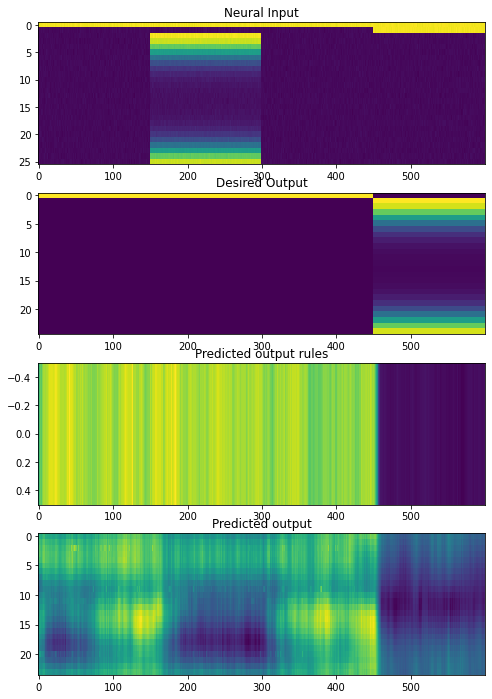

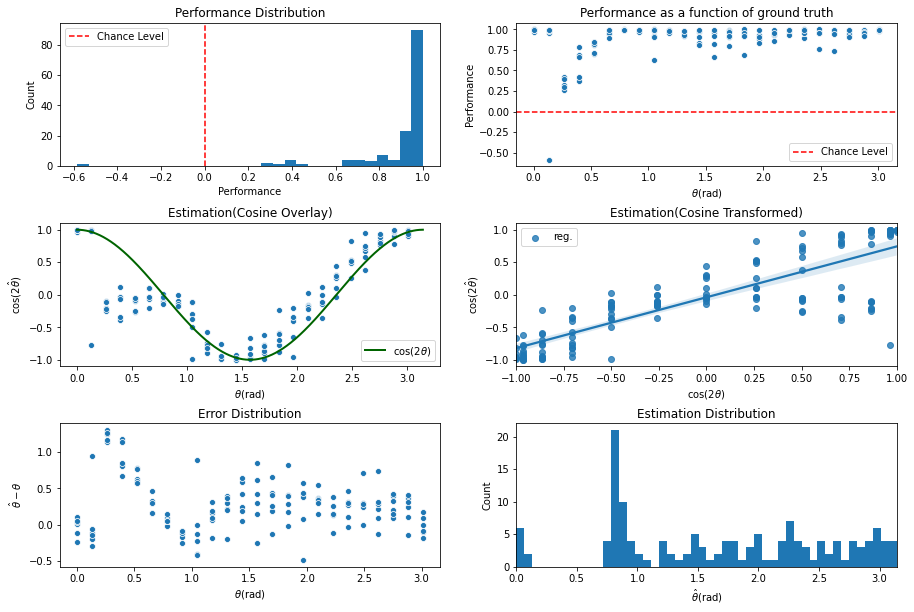

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter4700/assets

 Training performance: 
Iter. 4701 | Performance -0.0322 | Loss 0.2852 | Spike loss 3.3005
Testing performance: 
Iter. 4701 | Performance 0.8443 | Loss 0.2856 | Spike loss 3.3569

 Training performance: 
Iter. 4702 | Performance 0.0180 | Loss 0.2859 | Spike loss 3.3019
Testing performance: 
Iter. 4702 | Performance 0.8553 | Loss 0.2868 | Spike loss 3.3280

 Training performance: 
Iter. 4703 | Performance -0.0794 | Loss 0.2850 | Spike loss 3.4171
Testing performance: 
Iter. 4703 | Performance 0.8621 | Loss 0.2839 | Spike loss 3.3499

 Training performance: 
Iter. 4704 | Performance -0.0051 | Loss 0.2850 | Spike loss 3.4042
Testing performance: 
Iter. 4704 | Performance 0.8459 | Loss 0.2856 | Spike loss 3.3845

 Training performance: 
Iter. 4705 | Performance -0.0165 | Loss 0.2831 | Spike loss 3.2554
Testing performance: 
Iter. 4705 | Performance 0.8918 | Loss 0.2845 | Spike loss 3.3543

 Training


 Training performance: 
Iter. 4747 | Performance -0.0107 | Loss 0.2877 | Spike loss 3.5905
Testing performance: 
Iter. 4747 | Performance 0.8431 | Loss 0.2901 | Spike loss 3.6055

 Training performance: 
Iter. 4748 | Performance 0.0329 | Loss 0.2892 | Spike loss 3.6110
Testing performance: 
Iter. 4748 | Performance 0.8587 | Loss 0.2852 | Spike loss 3.6237

 Training performance: 
Iter. 4749 | Performance -0.0924 | Loss 0.2849 | Spike loss 3.6465
Testing performance: 
Iter. 4749 | Performance 0.8439 | Loss 0.2871 | Spike loss 3.6011

 Training performance: 
Iter. 4750 | Performance -0.0250 | Loss 0.2868 | Spike loss 3.5173
Testing performance: 
Iter. 4750 | Performance 0.8309 | Loss 0.2899 | Spike loss 3.6740

 Training performance: 
Iter. 4751 | Performance -0.0200 | Loss 0.2905 | Spike loss 3.6869
Testing performance: 
Iter. 4751 | Performance 0.8357 | Loss 0.2869 | Spike loss 3.7252

 Training performance: 
Iter. 4752 | Performance 0.0498 | Loss 0.2863 | Spike loss 3.7984
Testing pe


 Training performance: 
Iter. 4793 | Performance -0.0326 | Loss 0.2813 | Spike loss 3.0214
Testing performance: 
Iter. 4793 | Performance 0.9276 | Loss 0.2783 | Spike loss 3.1296

 Training performance: 
Iter. 4794 | Performance 0.0588 | Loss 0.2788 | Spike loss 3.0357
Testing performance: 
Iter. 4794 | Performance 0.9237 | Loss 0.2795 | Spike loss 3.1195

 Training performance: 
Iter. 4795 | Performance 0.0798 | Loss 0.2791 | Spike loss 3.0765
Testing performance: 
Iter. 4795 | Performance 0.9279 | Loss 0.2815 | Spike loss 3.1377

 Training performance: 
Iter. 4796 | Performance 0.0118 | Loss 0.2811 | Spike loss 3.2330
Testing performance: 
Iter. 4796 | Performance 0.9194 | Loss 0.2791 | Spike loss 3.1482

 Training performance: 
Iter. 4797 | Performance -0.0918 | Loss 0.2787 | Spike loss 3.1649
Testing performance: 
Iter. 4797 | Performance 0.9403 | Loss 0.2792 | Spike loss 3.1115

 Training performance: 
Iter. 4798 | Performance -0.0633 | Loss 0.2786 | Spike loss 3.1666
Testing per

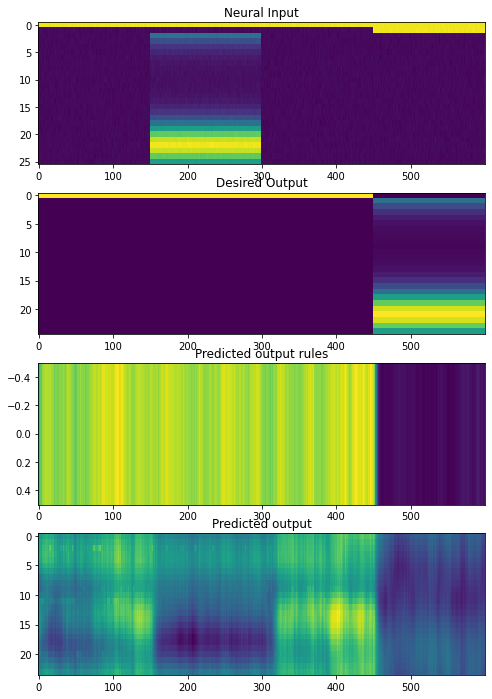

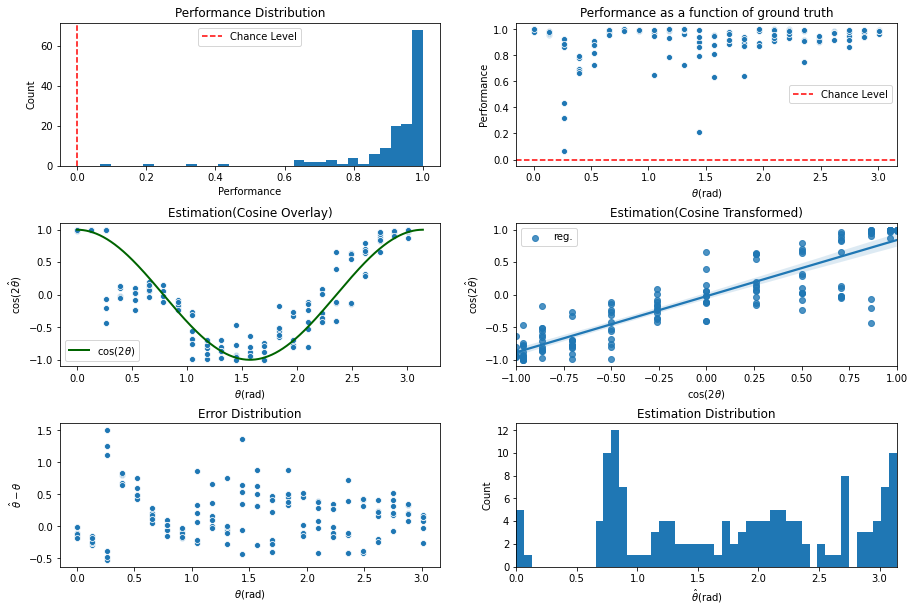

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter4800/assets

 Training performance: 
Iter. 4801 | Performance 0.0810 | Loss 0.2794 | Spike loss 3.0564
Testing performance: 
Iter. 4801 | Performance 0.9228 | Loss 0.2803 | Spike loss 3.0925

 Training performance: 
Iter. 4802 | Performance -0.0970 | Loss 0.2806 | Spike loss 3.0883
Testing performance: 
Iter. 4802 | Performance 0.9269 | Loss 0.2783 | Spike loss 3.0987

 Training performance: 
Iter. 4803 | Performance 0.0594 | Loss 0.2786 | Spike loss 3.0040
Testing performance: 
Iter. 4803 | Performance 0.9023 | Loss 0.2809 | Spike loss 3.1248

 Training performance: 
Iter. 4804 | Performance -0.0341 | Loss 0.2782 | Spike loss 3.0708
Testing performance: 
Iter. 4804 | Performance 0.8981 | Loss 0.2829 | Spike loss 3.1425

 Training performance: 
Iter. 4805 | Performance 0.0491 | Loss 0.2814 | Spike loss 3.1244
Testing performance: 
Iter. 4805 | Performance 0.9218 | Loss 0.2787 | Spike loss 3.1700

 Training p


 Training performance: 
Iter. 4847 | Performance 0.0015 | Loss 0.2812 | Spike loss 2.9291
Testing performance: 
Iter. 4847 | Performance 0.9276 | Loss 0.2792 | Spike loss 3.0465

 Training performance: 
Iter. 4848 | Performance 0.1414 | Loss 0.2780 | Spike loss 3.0937
Testing performance: 
Iter. 4848 | Performance 0.9255 | Loss 0.2800 | Spike loss 3.0888

 Training performance: 
Iter. 4849 | Performance -0.0842 | Loss 0.2796 | Spike loss 2.8945
Testing performance: 
Iter. 4849 | Performance 0.9182 | Loss 0.2828 | Spike loss 3.0666

 Training performance: 
Iter. 4850 | Performance -0.0679 | Loss 0.2805 | Spike loss 3.0559
Testing performance: 
Iter. 4850 | Performance 0.9303 | Loss 0.2778 | Spike loss 3.0519

 Training performance: 
Iter. 4851 | Performance 0.0517 | Loss 0.2787 | Spike loss 2.9745
Testing performance: 
Iter. 4851 | Performance 0.9156 | Loss 0.2788 | Spike loss 3.0249

 Training performance: 
Iter. 4852 | Performance -0.0672 | Loss 0.2789 | Spike loss 2.9936
Testing per


 Training performance: 
Iter. 4893 | Performance -0.0412 | Loss 0.2845 | Spike loss 3.3712
Testing performance: 
Iter. 4893 | Performance 0.8836 | Loss 0.2847 | Spike loss 3.5238

 Training performance: 
Iter. 4894 | Performance -0.0046 | Loss 0.2838 | Spike loss 3.4016
Testing performance: 
Iter. 4894 | Performance 0.9157 | Loss 0.2835 | Spike loss 3.5255

 Training performance: 
Iter. 4895 | Performance -0.0270 | Loss 0.2882 | Spike loss 3.5498
Testing performance: 
Iter. 4895 | Performance 0.8938 | Loss 0.2845 | Spike loss 3.5234

 Training performance: 
Iter. 4896 | Performance 0.0116 | Loss 0.2855 | Spike loss 3.5401
Testing performance: 
Iter. 4896 | Performance 0.8919 | Loss 0.2858 | Spike loss 3.5639

 Training performance: 
Iter. 4897 | Performance -0.0416 | Loss 0.2840 | Spike loss 3.4885
Testing performance: 
Iter. 4897 | Performance 0.8947 | Loss 0.2855 | Spike loss 3.5641

 Training performance: 
Iter. 4898 | Performance 0.0055 | Loss 0.2844 | Spike loss 3.5556
Testing pe

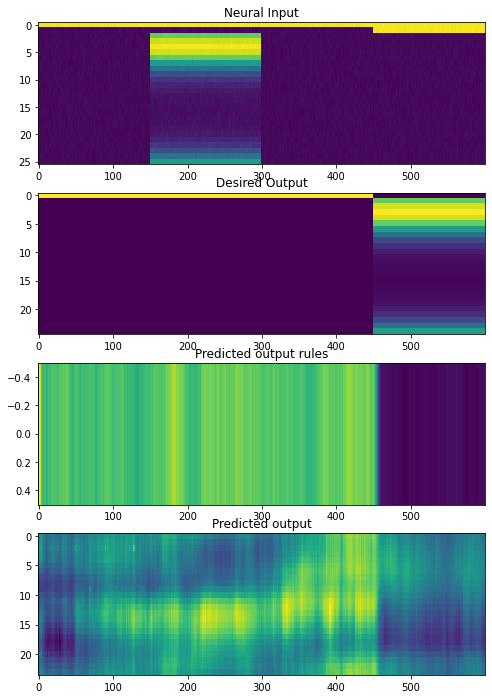

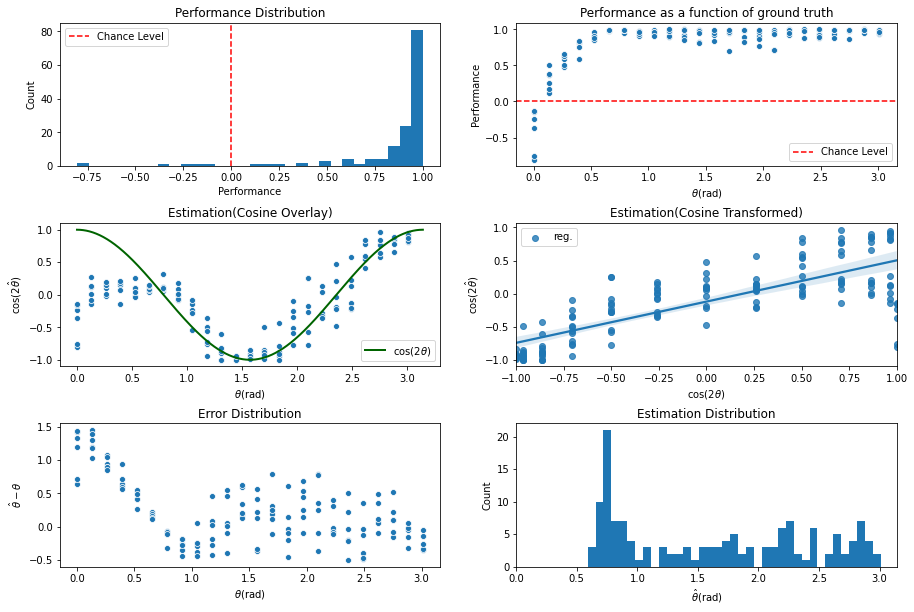

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter4900/assets

 Training performance: 
Iter. 4901 | Performance 0.0545 | Loss 0.2872 | Spike loss 3.7768
Testing performance: 
Iter. 4901 | Performance 0.8275 | Loss 0.2865 | Spike loss 3.6557

 Training performance: 
Iter. 4902 | Performance 0.0622 | Loss 0.2900 | Spike loss 3.5621
Testing performance: 
Iter. 4902 | Performance 0.8079 | Loss 0.2863 | Spike loss 3.6101

 Training performance: 
Iter. 4903 | Performance -0.0373 | Loss 0.2858 | Spike loss 3.5094
Testing performance: 
Iter. 4903 | Performance 0.8448 | Loss 0.2864 | Spike loss 3.5720

 Training performance: 
Iter. 4904 | Performance 0.0515 | Loss 0.2888 | Spike loss 3.7677
Testing performance: 
Iter. 4904 | Performance 0.8627 | Loss 0.2849 | Spike loss 3.5696

 Training performance: 
Iter. 4905 | Performance -0.0019 | Loss 0.2833 | Spike loss 3.4427
Testing performance: 
Iter. 4905 | Performance 0.8753 | Loss 0.2853 | Spike loss 3.6226

 Training p


 Training performance: 
Iter. 4947 | Performance -0.0415 | Loss 0.2797 | Spike loss 3.1272
Testing performance: 
Iter. 4947 | Performance 0.9189 | Loss 0.2788 | Spike loss 3.1831

 Training performance: 
Iter. 4948 | Performance -0.0219 | Loss 0.2830 | Spike loss 3.3744
Testing performance: 
Iter. 4948 | Performance 0.9174 | Loss 0.2793 | Spike loss 3.1877

 Training performance: 
Iter. 4949 | Performance -0.0845 | Loss 0.2785 | Spike loss 3.2156
Testing performance: 
Iter. 4949 | Performance 0.9234 | Loss 0.2783 | Spike loss 3.2019

 Training performance: 
Iter. 4950 | Performance 0.0419 | Loss 0.2783 | Spike loss 3.1697
Testing performance: 
Iter. 4950 | Performance 0.9102 | Loss 0.2797 | Spike loss 3.1970

 Training performance: 
Iter. 4951 | Performance 0.0051 | Loss 0.2782 | Spike loss 3.0841
Testing performance: 
Iter. 4951 | Performance 0.9126 | Loss 0.2795 | Spike loss 3.1907

 Training performance: 
Iter. 4952 | Performance 0.0566 | Loss 0.2790 | Spike loss 3.2103
Testing per


 Training performance: 
Iter. 4993 | Performance 0.0303 | Loss 0.2822 | Spike loss 3.4125
Testing performance: 
Iter. 4993 | Performance 0.8771 | Loss 0.2820 | Spike loss 3.4431

 Training performance: 
Iter. 4994 | Performance 0.0788 | Loss 0.2819 | Spike loss 3.3800
Testing performance: 
Iter. 4994 | Performance 0.8740 | Loss 0.2826 | Spike loss 3.4099

 Training performance: 
Iter. 4995 | Performance 0.0413 | Loss 0.2855 | Spike loss 3.4105
Testing performance: 
Iter. 4995 | Performance 0.8957 | Loss 0.2815 | Spike loss 3.4437

 Training performance: 
Iter. 4996 | Performance -0.0214 | Loss 0.2836 | Spike loss 3.4894
Testing performance: 
Iter. 4996 | Performance 0.8912 | Loss 0.2819 | Spike loss 3.4669

 Training performance: 
Iter. 4997 | Performance 0.0987 | Loss 0.2841 | Spike loss 3.5528
Testing performance: 
Iter. 4997 | Performance 0.9068 | Loss 0.2817 | Spike loss 3.4343

 Training performance: 
Iter. 4998 | Performance -0.1065 | Loss 0.2808 | Spike loss 3.5287
Testing perf

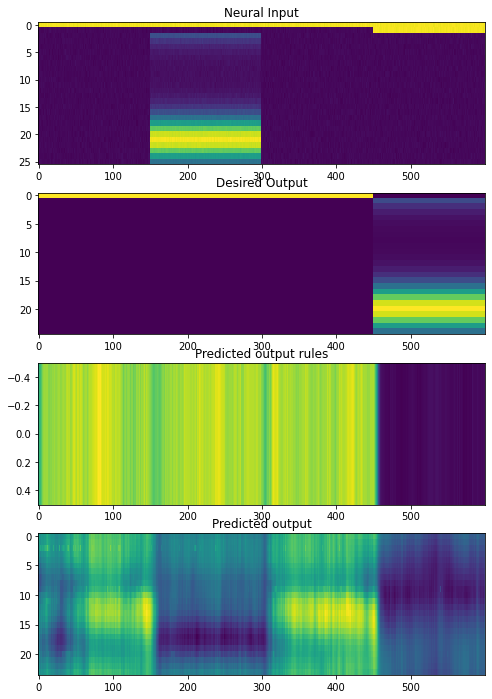

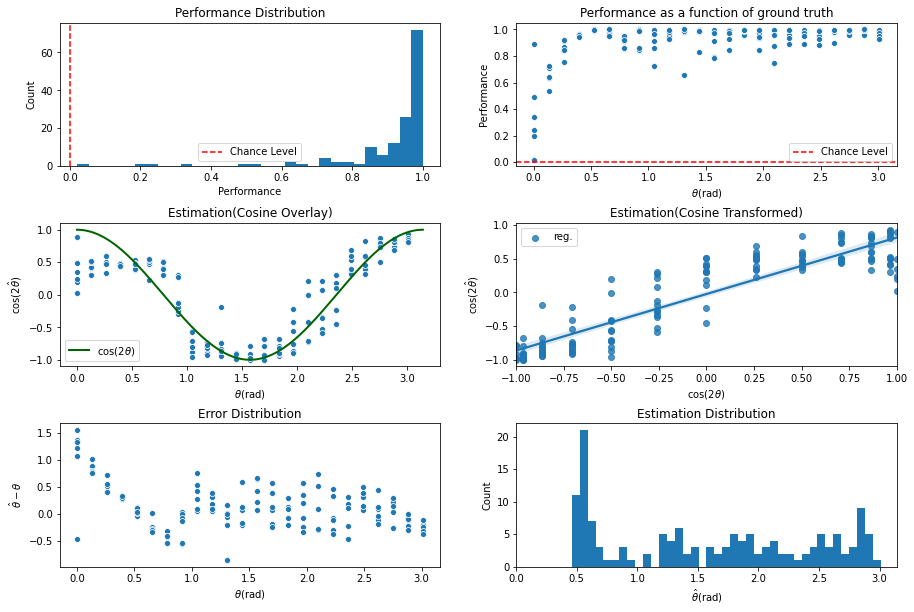

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter5000/assets

 Training performance: 
Iter. 5001 | Performance -0.1628 | Loss 0.2830 | Spike loss 3.4397
Testing performance: 
Iter. 5001 | Performance 0.8972 | Loss 0.2818 | Spike loss 3.4071

 Training performance: 
Iter. 5002 | Performance -0.0371 | Loss 0.2831 | Spike loss 3.3987
Testing performance: 
Iter. 5002 | Performance 0.8976 | Loss 0.2805 | Spike loss 3.4179

 Training performance: 
Iter. 5003 | Performance 0.0545 | Loss 0.2816 | Spike loss 3.3370
Testing performance: 
Iter. 5003 | Performance 0.8985 | Loss 0.2805 | Spike loss 3.4443

 Training performance: 
Iter. 5004 | Performance 0.0267 | Loss 0.2835 | Spike loss 3.3967
Testing performance: 
Iter. 5004 | Performance 0.8861 | Loss 0.2812 | Spike loss 3.4307

 Training performance: 
Iter. 5005 | Performance -0.0502 | Loss 0.2828 | Spike loss 3.3543
Testing performance: 
Iter. 5005 | Performance 0.8652 | Loss 0.2833 | Spike loss 3.3736

 Training 


 Training performance: 
Iter. 5047 | Performance 0.0754 | Loss 0.2794 | Spike loss 3.3906
Testing performance: 
Iter. 5047 | Performance 0.9089 | Loss 0.2804 | Spike loss 3.5221

 Training performance: 
Iter. 5048 | Performance -0.0912 | Loss 0.2814 | Spike loss 3.5456
Testing performance: 
Iter. 5048 | Performance 0.9095 | Loss 0.2801 | Spike loss 3.5839

 Training performance: 
Iter. 5049 | Performance -0.0331 | Loss 0.2810 | Spike loss 3.5642
Testing performance: 
Iter. 5049 | Performance 0.8983 | Loss 0.2828 | Spike loss 3.6257

 Training performance: 
Iter. 5050 | Performance -0.0107 | Loss 0.2831 | Spike loss 3.5834
Testing performance: 
Iter. 5050 | Performance 0.8965 | Loss 0.2829 | Spike loss 3.6835

 Training performance: 
Iter. 5051 | Performance 0.0225 | Loss 0.2848 | Spike loss 3.5752
Testing performance: 
Iter. 5051 | Performance 0.9196 | Loss 0.2805 | Spike loss 3.7177

 Training performance: 
Iter. 5052 | Performance -0.0789 | Loss 0.2832 | Spike loss 3.7621
Testing pe


 Training performance: 
Iter. 5093 | Performance 0.0523 | Loss 0.2839 | Spike loss 3.7417
Testing performance: 
Iter. 5093 | Performance 0.8612 | Loss 0.2834 | Spike loss 3.6045

 Training performance: 
Iter. 5094 | Performance -0.0411 | Loss 0.2820 | Spike loss 3.5964
Testing performance: 
Iter. 5094 | Performance 0.8562 | Loss 0.2840 | Spike loss 3.5850

 Training performance: 
Iter. 5095 | Performance -0.0075 | Loss 0.2836 | Spike loss 3.5688
Testing performance: 
Iter. 5095 | Performance 0.8619 | Loss 0.2829 | Spike loss 3.5697

 Training performance: 
Iter. 5096 | Performance 0.0811 | Loss 0.2813 | Spike loss 3.5319
Testing performance: 
Iter. 5096 | Performance 0.8717 | Loss 0.2812 | Spike loss 3.5694

 Training performance: 
Iter. 5097 | Performance -0.1166 | Loss 0.2834 | Spike loss 3.6000
Testing performance: 
Iter. 5097 | Performance 0.8794 | Loss 0.2825 | Spike loss 3.5526

 Training performance: 
Iter. 5098 | Performance 0.0559 | Loss 0.2815 | Spike loss 3.4576
Testing per

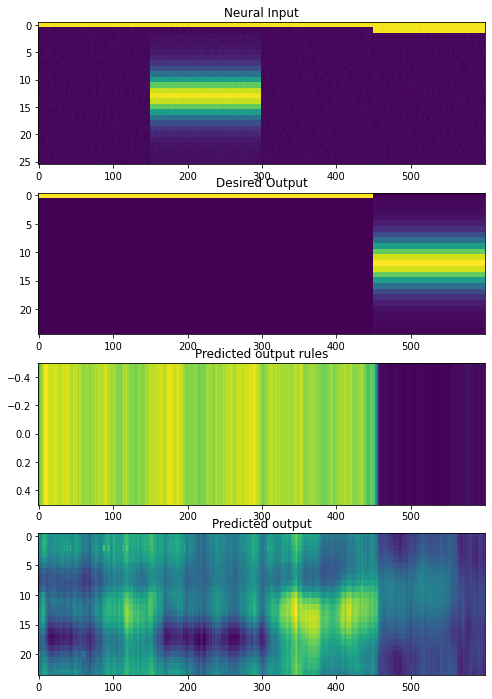

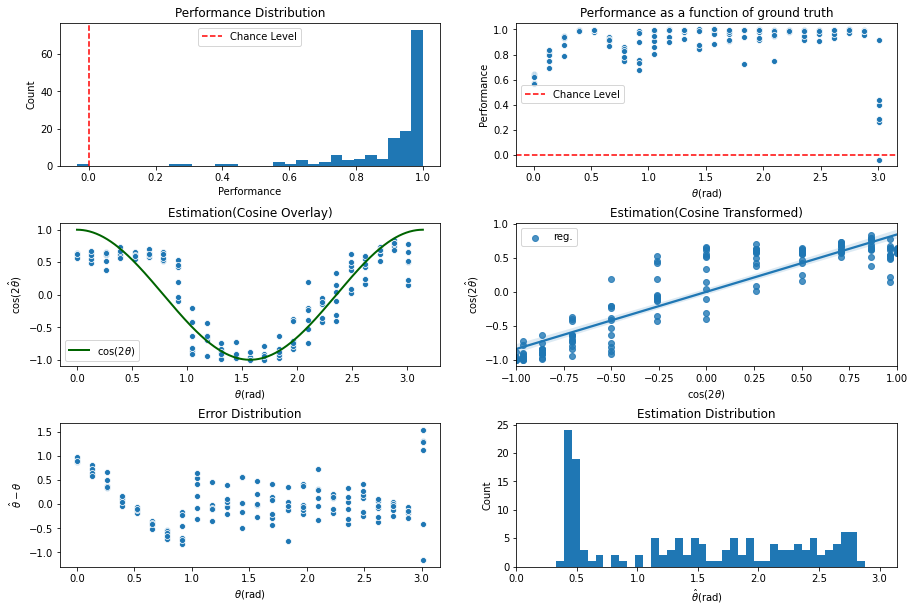

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter5100/assets

 Training performance: 
Iter. 5101 | Performance 0.0824 | Loss 0.2835 | Spike loss 3.6612
Testing performance: 
Iter. 5101 | Performance 0.9031 | Loss 0.2827 | Spike loss 3.6470

 Training performance: 
Iter. 5102 | Performance -0.0163 | Loss 0.2846 | Spike loss 3.5518
Testing performance: 
Iter. 5102 | Performance 0.9073 | Loss 0.2830 | Spike loss 3.6794

 Training performance: 
Iter. 5103 | Performance -0.0920 | Loss 0.2811 | Spike loss 3.7318
Testing performance: 
Iter. 5103 | Performance 0.9011 | Loss 0.2823 | Spike loss 3.6415

 Training performance: 
Iter. 5104 | Performance -0.0217 | Loss 0.2803 | Spike loss 3.6640
Testing performance: 
Iter. 5104 | Performance 0.9044 | Loss 0.2808 | Spike loss 3.6037

 Training performance: 
Iter. 5105 | Performance 0.0682 | Loss 0.2821 | Spike loss 3.4989
Testing performance: 
Iter. 5105 | Performance 0.9028 | Loss 0.2814 | Spike loss 3.5928

 Training 


 Training performance: 
Iter. 5147 | Performance -0.0031 | Loss 0.2808 | Spike loss 3.4953
Testing performance: 
Iter. 5147 | Performance 0.9089 | Loss 0.2789 | Spike loss 3.3585

 Training performance: 
Iter. 5148 | Performance 0.0358 | Loss 0.2812 | Spike loss 3.4384
Testing performance: 
Iter. 5148 | Performance 0.9062 | Loss 0.2791 | Spike loss 3.3902

 Training performance: 
Iter. 5149 | Performance -0.0240 | Loss 0.2781 | Spike loss 3.4041
Testing performance: 
Iter. 5149 | Performance 0.8908 | Loss 0.2803 | Spike loss 3.3233

 Training performance: 
Iter. 5150 | Performance 0.0025 | Loss 0.2800 | Spike loss 3.3328
Testing performance: 
Iter. 5150 | Performance 0.9080 | Loss 0.2789 | Spike loss 3.3043

 Training performance: 
Iter. 5151 | Performance -0.0744 | Loss 0.2799 | Spike loss 3.3055
Testing performance: 
Iter. 5151 | Performance 0.9111 | Loss 0.2788 | Spike loss 3.3152

 Training performance: 
Iter. 5152 | Performance 0.0687 | Loss 0.2780 | Spike loss 3.3242
Testing per


 Training performance: 
Iter. 5193 | Performance 0.0454 | Loss 0.2791 | Spike loss 3.4081
Testing performance: 
Iter. 5193 | Performance 0.9352 | Loss 0.2783 | Spike loss 3.3487

 Training performance: 
Iter. 5194 | Performance -0.1291 | Loss 0.2806 | Spike loss 3.4421
Testing performance: 
Iter. 5194 | Performance 0.9169 | Loss 0.2800 | Spike loss 3.4079

 Training performance: 
Iter. 5195 | Performance 0.1193 | Loss 0.2798 | Spike loss 3.5361
Testing performance: 
Iter. 5195 | Performance 0.9149 | Loss 0.2794 | Spike loss 3.4504

 Training performance: 
Iter. 5196 | Performance -0.0047 | Loss 0.2801 | Spike loss 3.5674
Testing performance: 
Iter. 5196 | Performance 0.9209 | Loss 0.2801 | Spike loss 3.4760

 Training performance: 
Iter. 5197 | Performance -0.0086 | Loss 0.2808 | Spike loss 3.4664
Testing performance: 
Iter. 5197 | Performance 0.9105 | Loss 0.2813 | Spike loss 3.5055

 Training performance: 
Iter. 5198 | Performance -0.1051 | Loss 0.2809 | Spike loss 3.5203
Testing pe

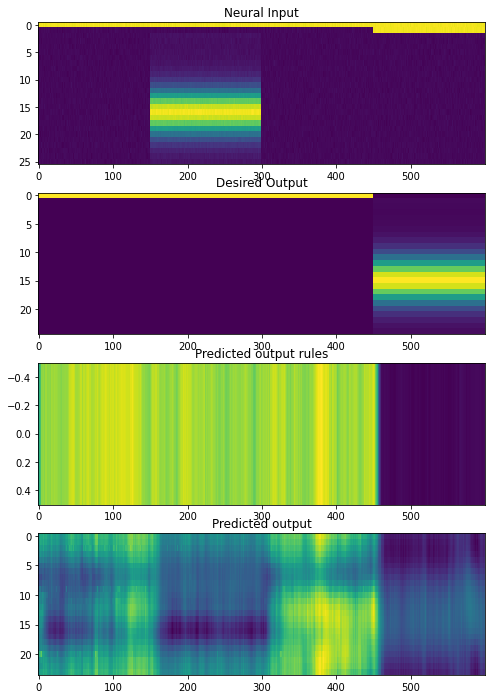

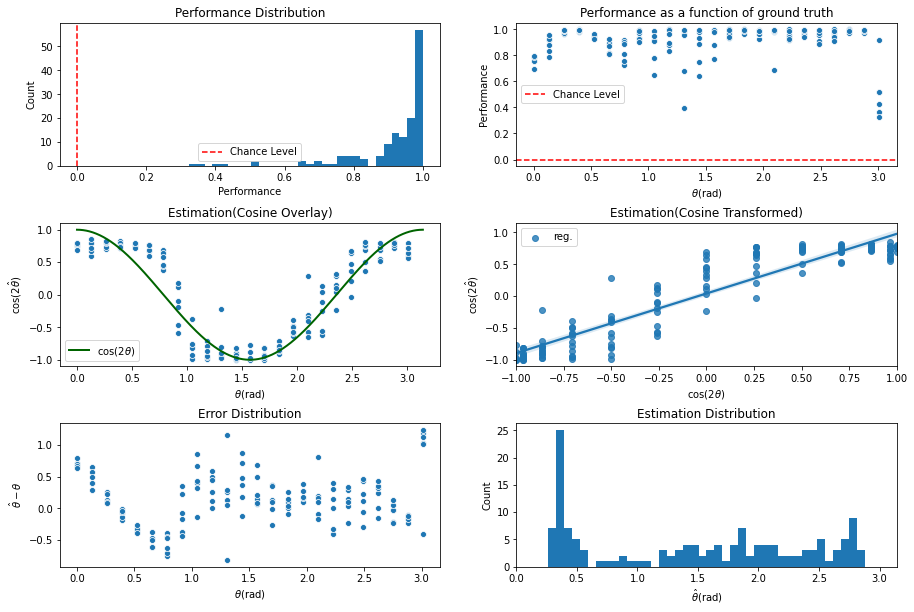

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter5200/assets

 Training performance: 
Iter. 5201 | Performance -0.0287 | Loss 0.2789 | Spike loss 3.4251
Testing performance: 
Iter. 5201 | Performance 0.8839 | Loss 0.2815 | Spike loss 3.4401

 Training performance: 
Iter. 5202 | Performance 0.0105 | Loss 0.2799 | Spike loss 3.4838
Testing performance: 
Iter. 5202 | Performance 0.8841 | Loss 0.2804 | Spike loss 3.4532

 Training performance: 
Iter. 5203 | Performance 0.0190 | Loss 0.2804 | Spike loss 3.4694
Testing performance: 
Iter. 5203 | Performance 0.8902 | Loss 0.2804 | Spike loss 3.4526

 Training performance: 
Iter. 5204 | Performance -0.0907 | Loss 0.2828 | Spike loss 3.4368
Testing performance: 
Iter. 5204 | Performance 0.9019 | Loss 0.2790 | Spike loss 3.4819

 Training performance: 
Iter. 5205 | Performance -0.0387 | Loss 0.2803 | Spike loss 3.5486
Testing performance: 
Iter. 5205 | Performance 0.8966 | Loss 0.2806 | Spike loss 3.4937

 Training 


 Training performance: 
Iter. 5247 | Performance 0.0764 | Loss 0.2784 | Spike loss 3.0584
Testing performance: 
Iter. 5247 | Performance 0.9340 | Loss 0.2772 | Spike loss 3.0110

 Training performance: 
Iter. 5248 | Performance 0.0235 | Loss 0.2769 | Spike loss 3.0507
Testing performance: 
Iter. 5248 | Performance 0.9217 | Loss 0.2782 | Spike loss 3.0309

 Training performance: 
Iter. 5249 | Performance 0.0200 | Loss 0.2762 | Spike loss 2.9515
Testing performance: 
Iter. 5249 | Performance 0.9217 | Loss 0.2772 | Spike loss 3.0092

 Training performance: 
Iter. 5250 | Performance -0.1160 | Loss 0.2760 | Spike loss 2.9192
Testing performance: 
Iter. 5250 | Performance 0.9204 | Loss 0.2770 | Spike loss 3.0455

 Training performance: 
Iter. 5251 | Performance 0.0665 | Loss 0.2787 | Spike loss 3.0333
Testing performance: 
Iter. 5251 | Performance 0.9246 | Loss 0.2773 | Spike loss 3.0263

 Training performance: 
Iter. 5252 | Performance 0.0129 | Loss 0.2769 | Spike loss 3.1026
Testing perfo


 Training performance: 
Iter. 5293 | Performance -0.0655 | Loss 0.2778 | Spike loss 2.9169
Testing performance: 
Iter. 5293 | Performance 0.9376 | Loss 0.2770 | Spike loss 2.9441

 Training performance: 
Iter. 5294 | Performance -0.0476 | Loss 0.2779 | Spike loss 2.9377
Testing performance: 
Iter. 5294 | Performance 0.9352 | Loss 0.2770 | Spike loss 2.9160

 Training performance: 
Iter. 5295 | Performance -0.0499 | Loss 0.2770 | Spike loss 2.8989
Testing performance: 
Iter. 5295 | Performance 0.9280 | Loss 0.2784 | Spike loss 2.9066

 Training performance: 
Iter. 5296 | Performance 0.0158 | Loss 0.2795 | Spike loss 2.8669
Testing performance: 
Iter. 5296 | Performance 0.9284 | Loss 0.2775 | Spike loss 2.9057

 Training performance: 
Iter. 5297 | Performance -0.0012 | Loss 0.2765 | Spike loss 2.9354
Testing performance: 
Iter. 5297 | Performance 0.9400 | Loss 0.2773 | Spike loss 2.9478

 Training performance: 
Iter. 5298 | Performance 0.0858 | Loss 0.2781 | Spike loss 2.9413
Testing pe

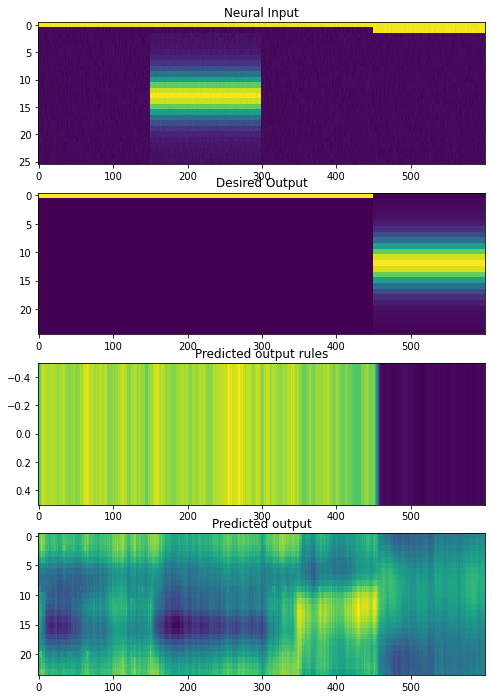

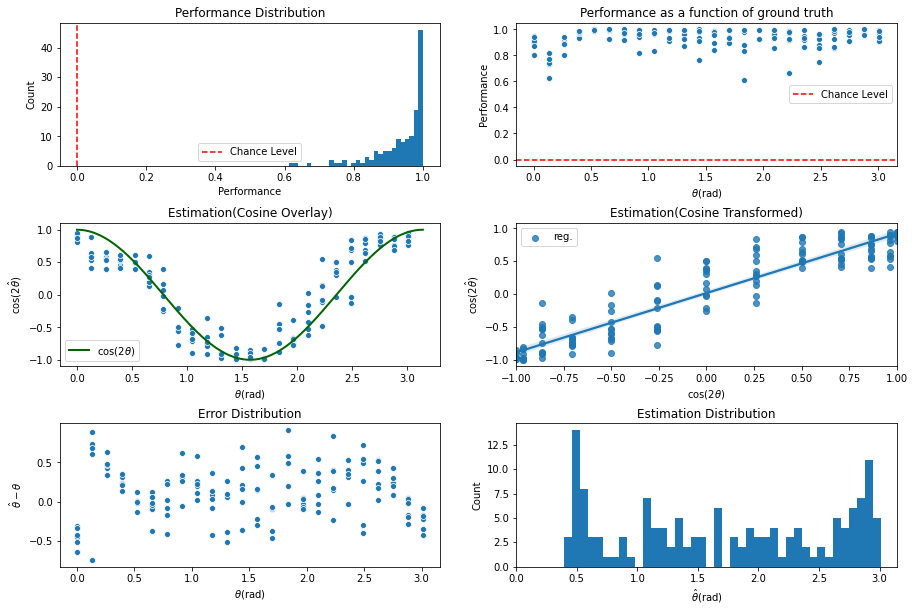

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter5300/assets

 Training performance: 
Iter. 5301 | Performance 0.0343 | Loss 0.2786 | Spike loss 2.9595
Testing performance: 
Iter. 5301 | Performance 0.9216 | Loss 0.2776 | Spike loss 2.9616

 Training performance: 
Iter. 5302 | Performance 0.0209 | Loss 0.2778 | Spike loss 2.8705
Testing performance: 
Iter. 5302 | Performance 0.9347 | Loss 0.2771 | Spike loss 2.9252

 Training performance: 
Iter. 5303 | Performance 0.0041 | Loss 0.2776 | Spike loss 2.9340
Testing performance: 
Iter. 5303 | Performance 0.9218 | Loss 0.2781 | Spike loss 2.9011

 Training performance: 
Iter. 5304 | Performance -0.0501 | Loss 0.2774 | Spike loss 2.8258
Testing performance: 
Iter. 5304 | Performance 0.9290 | Loss 0.2767 | Spike loss 2.9234

 Training performance: 
Iter. 5305 | Performance 0.0140 | Loss 0.2780 | Spike loss 3.0052
Testing performance: 
Iter. 5305 | Performance 0.9296 | Loss 0.2766 | Spike loss 2.9474

 Training pe


 Training performance: 
Iter. 5347 | Performance -0.0338 | Loss 0.2775 | Spike loss 3.3099
Testing performance: 
Iter. 5347 | Performance 0.9319 | Loss 0.2775 | Spike loss 3.2698

 Training performance: 
Iter. 5348 | Performance 0.0603 | Loss 0.2806 | Spike loss 3.3503
Testing performance: 
Iter. 5348 | Performance 0.9263 | Loss 0.2776 | Spike loss 3.2768

 Training performance: 
Iter. 5349 | Performance 0.0709 | Loss 0.2776 | Spike loss 3.1995
Testing performance: 
Iter. 5349 | Performance 0.9195 | Loss 0.2778 | Spike loss 3.3010

 Training performance: 
Iter. 5350 | Performance 0.0255 | Loss 0.2771 | Spike loss 3.3569
Testing performance: 
Iter. 5350 | Performance 0.9338 | Loss 0.2771 | Spike loss 3.2662

 Training performance: 
Iter. 5351 | Performance -0.1005 | Loss 0.2786 | Spike loss 3.5032
Testing performance: 
Iter. 5351 | Performance 0.9402 | Loss 0.2764 | Spike loss 3.2668

 Training performance: 
Iter. 5352 | Performance -0.0424 | Loss 0.2784 | Spike loss 3.3743
Testing per


 Training performance: 
Iter. 5393 | Performance 0.0259 | Loss 0.2782 | Spike loss 3.2855
Testing performance: 
Iter. 5393 | Performance 0.8979 | Loss 0.2807 | Spike loss 3.2658

 Training performance: 
Iter. 5394 | Performance -0.1120 | Loss 0.2817 | Spike loss 3.3702
Testing performance: 
Iter. 5394 | Performance 0.9378 | Loss 0.2769 | Spike loss 3.2414

 Training performance: 
Iter. 5395 | Performance -0.0591 | Loss 0.2786 | Spike loss 3.3016
Testing performance: 
Iter. 5395 | Performance 0.9083 | Loss 0.2783 | Spike loss 3.2565

 Training performance: 
Iter. 5396 | Performance -0.0039 | Loss 0.2777 | Spike loss 3.3585
Testing performance: 
Iter. 5396 | Performance 0.9235 | Loss 0.2779 | Spike loss 3.2488

 Training performance: 
Iter. 5397 | Performance 0.0244 | Loss 0.2762 | Spike loss 3.2921
Testing performance: 
Iter. 5397 | Performance 0.9258 | Loss 0.2779 | Spike loss 3.2419

 Training performance: 
Iter. 5398 | Performance 0.0568 | Loss 0.2776 | Spike loss 3.2638
Testing per

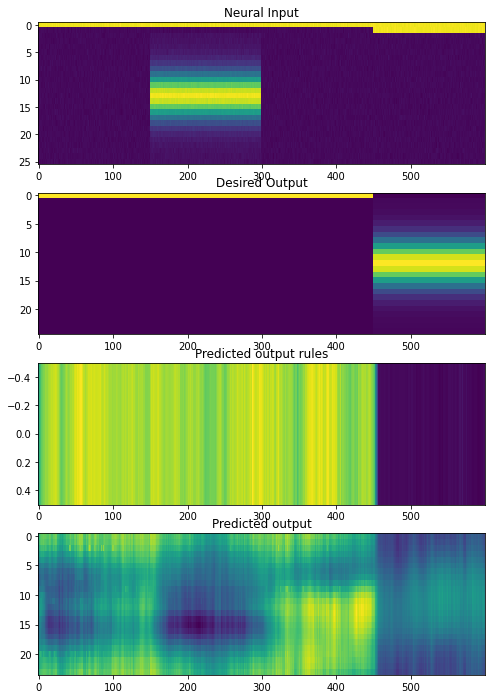

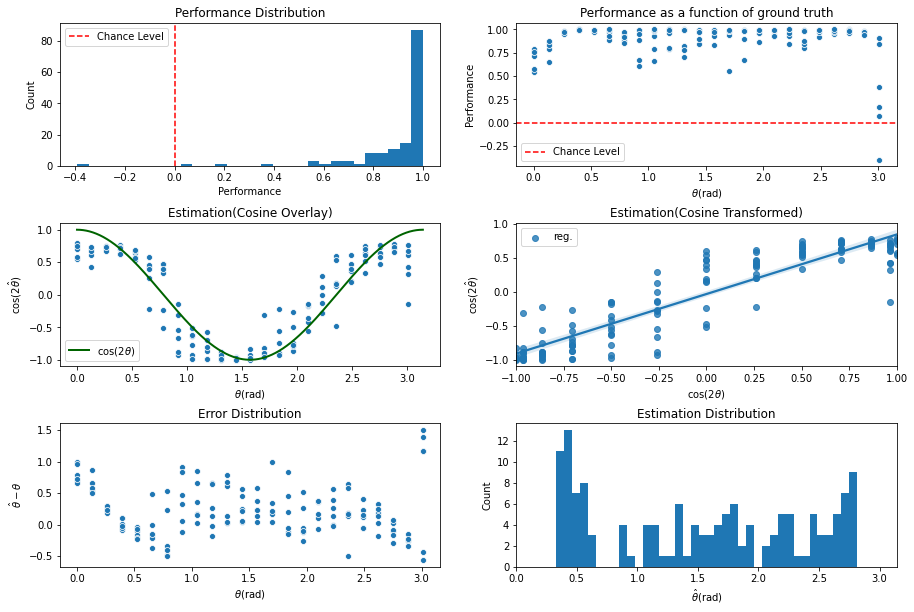

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter5400/assets

 Training performance: 
Iter. 5401 | Performance -0.0241 | Loss 0.2774 | Spike loss 3.3357
Testing performance: 
Iter. 5401 | Performance 0.9269 | Loss 0.2766 | Spike loss 3.2676

 Training performance: 
Iter. 5402 | Performance 0.0715 | Loss 0.2763 | Spike loss 3.2758
Testing performance: 
Iter. 5402 | Performance 0.9092 | Loss 0.2782 | Spike loss 3.2513

 Training performance: 
Iter. 5403 | Performance 0.0353 | Loss 0.2754 | Spike loss 3.2309
Testing performance: 
Iter. 5403 | Performance 0.9187 | Loss 0.2778 | Spike loss 3.2732

 Training performance: 
Iter. 5404 | Performance 0.0541 | Loss 0.2794 | Spike loss 3.2787
Testing performance: 
Iter. 5404 | Performance 0.9010 | Loss 0.2794 | Spike loss 3.2910

 Training performance: 
Iter. 5405 | Performance -0.1948 | Loss 0.2786 | Spike loss 3.2615
Testing performance: 
Iter. 5405 | Performance 0.9260 | Loss 0.2781 | Spike loss 3.3373

 Training p


 Training performance: 
Iter. 5447 | Performance -0.0481 | Loss 0.2808 | Spike loss 3.5739
Testing performance: 
Iter. 5447 | Performance 0.9284 | Loss 0.2786 | Spike loss 3.4896

 Training performance: 
Iter. 5448 | Performance -0.0931 | Loss 0.2799 | Spike loss 3.5432
Testing performance: 
Iter. 5448 | Performance 0.9127 | Loss 0.2796 | Spike loss 3.4900

 Training performance: 
Iter. 5449 | Performance -0.0286 | Loss 0.2801 | Spike loss 3.3934
Testing performance: 
Iter. 5449 | Performance 0.9116 | Loss 0.2794 | Spike loss 3.4858

 Training performance: 
Iter. 5450 | Performance 0.0887 | Loss 0.2814 | Spike loss 3.5517
Testing performance: 
Iter. 5450 | Performance 0.8956 | Loss 0.2805 | Spike loss 3.4714

 Training performance: 
Iter. 5451 | Performance 0.0652 | Loss 0.2832 | Spike loss 3.5531
Testing performance: 
Iter. 5451 | Performance 0.9070 | Loss 0.2792 | Spike loss 3.5120

 Training performance: 
Iter. 5452 | Performance 0.0486 | Loss 0.2797 | Spike loss 3.5470
Testing per


 Training performance: 
Iter. 5493 | Performance -0.0569 | Loss 0.2807 | Spike loss 3.6280
Testing performance: 
Iter. 5493 | Performance 0.9066 | Loss 0.2802 | Spike loss 3.6646

 Training performance: 
Iter. 5494 | Performance 0.0310 | Loss 0.2820 | Spike loss 3.7969
Testing performance: 
Iter. 5494 | Performance 0.9161 | Loss 0.2795 | Spike loss 3.7010

 Training performance: 
Iter. 5495 | Performance 0.0310 | Loss 0.2802 | Spike loss 3.7505
Testing performance: 
Iter. 5495 | Performance 0.9073 | Loss 0.2797 | Spike loss 3.7168

 Training performance: 
Iter. 5496 | Performance 0.0650 | Loss 0.2818 | Spike loss 3.8669
Testing performance: 
Iter. 5496 | Performance 0.9042 | Loss 0.2807 | Spike loss 3.7658

 Training performance: 
Iter. 5497 | Performance 0.0022 | Loss 0.2803 | Spike loss 3.8721
Testing performance: 
Iter. 5497 | Performance 0.9085 | Loss 0.2810 | Spike loss 3.7744

 Training performance: 
Iter. 5498 | Performance 0.0592 | Loss 0.2805 | Spike loss 3.8712
Testing perfo

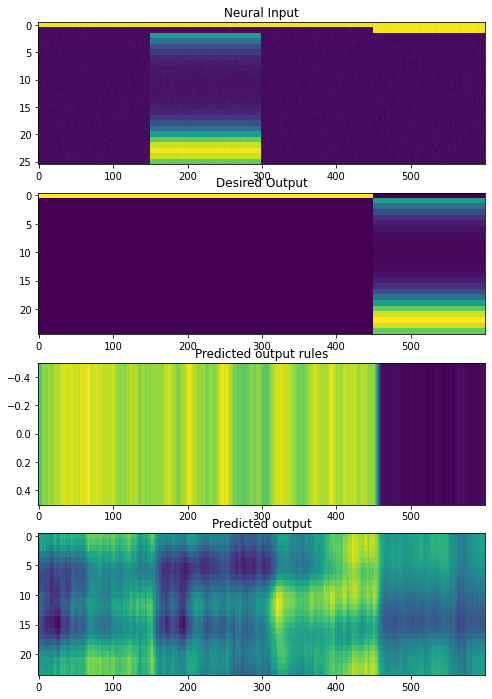

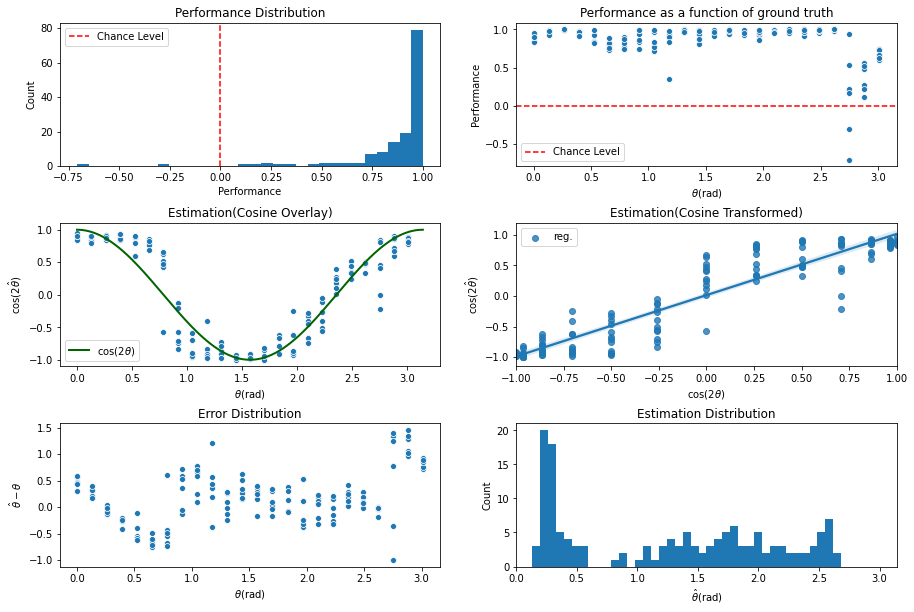

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter5500/assets

 Training performance: 
Iter. 5501 | Performance -0.0077 | Loss 0.2813 | Spike loss 3.8551
Testing performance: 
Iter. 5501 | Performance 0.8570 | Loss 0.2844 | Spike loss 3.8139

 Training performance: 
Iter. 5502 | Performance -0.0343 | Loss 0.2814 | Spike loss 3.9752
Testing performance: 
Iter. 5502 | Performance 0.8697 | Loss 0.2818 | Spike loss 3.8157

 Training performance: 
Iter. 5503 | Performance 0.0029 | Loss 0.2826 | Spike loss 3.8765
Testing performance: 
Iter. 5503 | Performance 0.8549 | Loss 0.2838 | Spike loss 3.8502

 Training performance: 
Iter. 5504 | Performance 0.0935 | Loss 0.2823 | Spike loss 3.9234
Testing performance: 
Iter. 5504 | Performance 0.8689 | Loss 0.2831 | Spike loss 3.8401

 Training performance: 
Iter. 5505 | Performance 0.0823 | Loss 0.2851 | Spike loss 3.8514
Testing performance: 
Iter. 5505 | Performance 0.8708 | Loss 0.2830 | Spike loss 3.8586

 Training p


 Training performance: 
Iter. 5547 | Performance 0.1755 | Loss 0.2779 | Spike loss 3.6201
Testing performance: 
Iter. 5547 | Performance 0.8934 | Loss 0.2809 | Spike loss 3.6363

 Training performance: 
Iter. 5548 | Performance 0.0320 | Loss 0.2802 | Spike loss 3.6775
Testing performance: 
Iter. 5548 | Performance 0.8729 | Loss 0.2836 | Spike loss 3.6366

 Training performance: 
Iter. 5549 | Performance -0.0715 | Loss 0.2786 | Spike loss 3.7174
Testing performance: 
Iter. 5549 | Performance 0.9157 | Loss 0.2787 | Spike loss 3.6279

 Training performance: 
Iter. 5550 | Performance 0.0567 | Loss 0.2798 | Spike loss 3.5746
Testing performance: 
Iter. 5550 | Performance 0.9090 | Loss 0.2795 | Spike loss 3.5997

 Training performance: 
Iter. 5551 | Performance -0.1295 | Loss 0.2796 | Spike loss 3.6215
Testing performance: 
Iter. 5551 | Performance 0.9189 | Loss 0.2788 | Spike loss 3.6162

 Training performance: 
Iter. 5552 | Performance 0.0406 | Loss 0.2819 | Spike loss 3.6628
Testing perf


 Training performance: 
Iter. 5593 | Performance 0.0451 | Loss 0.2774 | Spike loss 2.9708
Testing performance: 
Iter. 5593 | Performance 0.9209 | Loss 0.2778 | Spike loss 2.9450

 Training performance: 
Iter. 5594 | Performance -0.0249 | Loss 0.2778 | Spike loss 2.9742
Testing performance: 
Iter. 5594 | Performance 0.9128 | Loss 0.2785 | Spike loss 3.0085

 Training performance: 
Iter. 5595 | Performance -0.0133 | Loss 0.2784 | Spike loss 3.0152
Testing performance: 
Iter. 5595 | Performance 0.9163 | Loss 0.2778 | Spike loss 2.9421

 Training performance: 
Iter. 5596 | Performance -0.1008 | Loss 0.2788 | Spike loss 2.9902
Testing performance: 
Iter. 5596 | Performance 0.8908 | Loss 0.2781 | Spike loss 2.9215

 Training performance: 
Iter. 5597 | Performance -0.0725 | Loss 0.2786 | Spike loss 2.8588
Testing performance: 
Iter. 5597 | Performance 0.9031 | Loss 0.2798 | Spike loss 2.8962

 Training performance: 
Iter. 5598 | Performance 0.0024 | Loss 0.2806 | Spike loss 2.8759
Testing pe

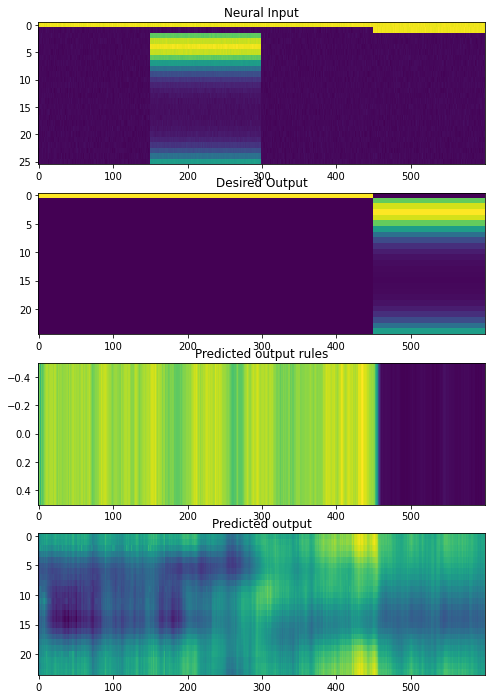

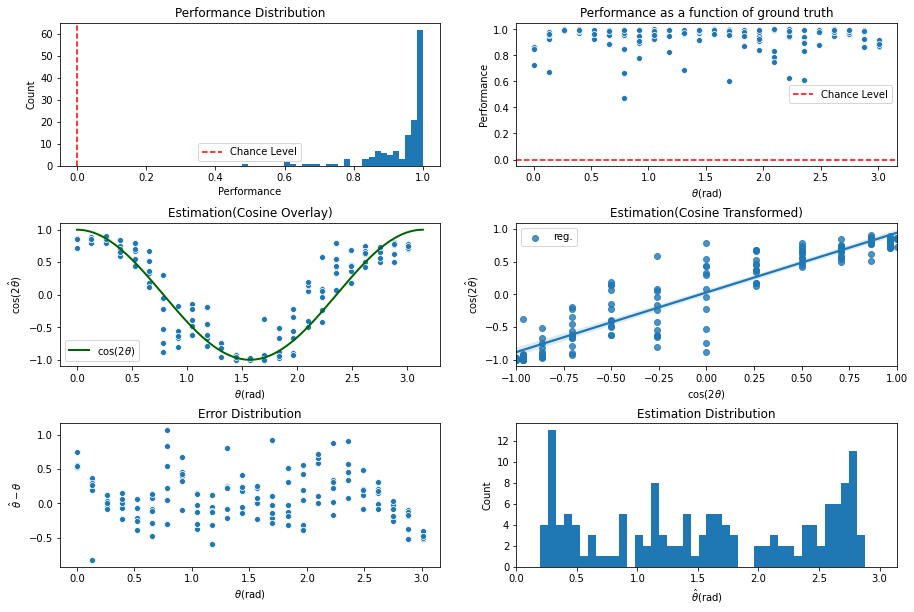

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter5600/assets

 Training performance: 
Iter. 5601 | Performance 0.0032 | Loss 0.2790 | Spike loss 2.9603
Testing performance: 
Iter. 5601 | Performance 0.9137 | Loss 0.2811 | Spike loss 2.9215

 Training performance: 
Iter. 5602 | Performance 0.1929 | Loss 0.2808 | Spike loss 2.8879
Testing performance: 
Iter. 5602 | Performance 0.9279 | Loss 0.2798 | Spike loss 2.9416

 Training performance: 
Iter. 5603 | Performance 0.0244 | Loss 0.2810 | Spike loss 2.8839
Testing performance: 
Iter. 5603 | Performance 0.9292 | Loss 0.2786 | Spike loss 2.9104

 Training performance: 
Iter. 5604 | Performance -0.0999 | Loss 0.2819 | Spike loss 2.9160
Testing performance: 
Iter. 5604 | Performance 0.9281 | Loss 0.2797 | Spike loss 2.8816

 Training performance: 
Iter. 5605 | Performance 0.0315 | Loss 0.2792 | Spike loss 2.8955
Testing performance: 
Iter. 5605 | Performance 0.9262 | Loss 0.2785 | Spike loss 2.8675

 Training pe


 Training performance: 
Iter. 5647 | Performance 0.0264 | Loss 0.2797 | Spike loss 3.2324
Testing performance: 
Iter. 5647 | Performance 0.9280 | Loss 0.2766 | Spike loss 3.2129

 Training performance: 
Iter. 5648 | Performance -0.0028 | Loss 0.2781 | Spike loss 3.2761
Testing performance: 
Iter. 5648 | Performance 0.9408 | Loss 0.2759 | Spike loss 3.2248

 Training performance: 
Iter. 5649 | Performance -0.0062 | Loss 0.2785 | Spike loss 3.3743
Testing performance: 
Iter. 5649 | Performance 0.9393 | Loss 0.2760 | Spike loss 3.1920

 Training performance: 
Iter. 5650 | Performance 0.0725 | Loss 0.2777 | Spike loss 3.2544
Testing performance: 
Iter. 5650 | Performance 0.9071 | Loss 0.2787 | Spike loss 3.2088

 Training performance: 
Iter. 5651 | Performance -0.0920 | Loss 0.2759 | Spike loss 3.0945
Testing performance: 
Iter. 5651 | Performance 0.9252 | Loss 0.2771 | Spike loss 3.2023

 Training performance: 
Iter. 5652 | Performance 0.0839 | Loss 0.2778 | Spike loss 3.1892
Testing per


 Training performance: 
Iter. 5693 | Performance 0.0902 | Loss 0.2777 | Spike loss 3.4124
Testing performance: 
Iter. 5693 | Performance 0.9114 | Loss 0.2782 | Spike loss 3.4143

 Training performance: 
Iter. 5694 | Performance -0.0826 | Loss 0.2780 | Spike loss 3.4894
Testing performance: 
Iter. 5694 | Performance 0.9225 | Loss 0.2780 | Spike loss 3.4534

 Training performance: 
Iter. 5695 | Performance 0.1406 | Loss 0.2781 | Spike loss 3.4790
Testing performance: 
Iter. 5695 | Performance 0.9280 | Loss 0.2771 | Spike loss 3.4630

 Training performance: 
Iter. 5696 | Performance 0.1020 | Loss 0.2787 | Spike loss 3.5529
Testing performance: 
Iter. 5696 | Performance 0.9108 | Loss 0.2796 | Spike loss 3.4952

 Training performance: 
Iter. 5697 | Performance 0.0496 | Loss 0.2778 | Spike loss 3.6218
Testing performance: 
Iter. 5697 | Performance 0.9125 | Loss 0.2785 | Spike loss 3.5026

 Training performance: 
Iter. 5698 | Performance 0.0625 | Loss 0.2780 | Spike loss 3.4066
Testing perfo

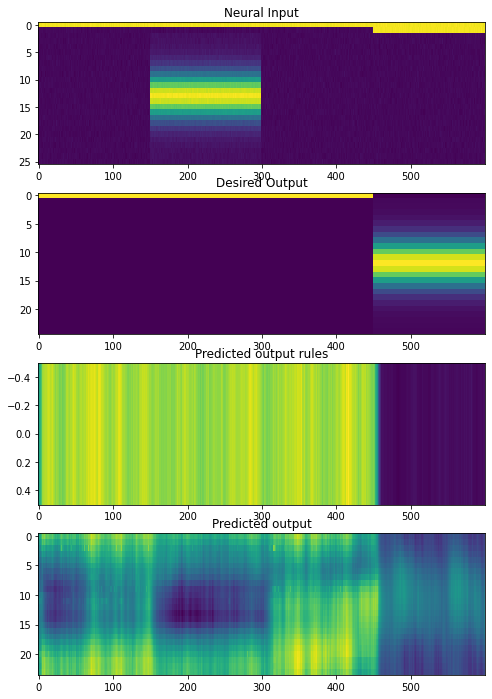

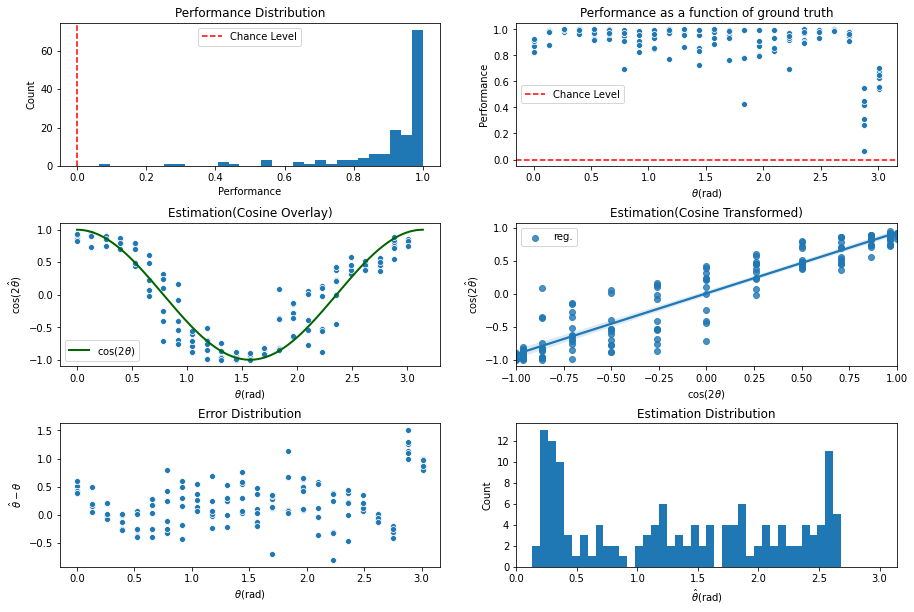

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter5700/assets

 Training performance: 
Iter. 5701 | Performance -0.0683 | Loss 0.2772 | Spike loss 3.3969
Testing performance: 
Iter. 5701 | Performance 0.9108 | Loss 0.2779 | Spike loss 3.4444

 Training performance: 
Iter. 5702 | Performance -0.0800 | Loss 0.2774 | Spike loss 3.4184
Testing performance: 
Iter. 5702 | Performance 0.8960 | Loss 0.2785 | Spike loss 3.4329

 Training performance: 
Iter. 5703 | Performance -0.0522 | Loss 0.2775 | Spike loss 3.3356
Testing performance: 
Iter. 5703 | Performance 0.9068 | Loss 0.2778 | Spike loss 3.4113

 Training performance: 
Iter. 5704 | Performance 0.0212 | Loss 0.2786 | Spike loss 3.3886
Testing performance: 
Iter. 5704 | Performance 0.8965 | Loss 0.2786 | Spike loss 3.4469

 Training performance: 
Iter. 5705 | Performance -0.0331 | Loss 0.2764 | Spike loss 3.4214
Testing performance: 
Iter. 5705 | Performance 0.9046 | Loss 0.2789 | Spike loss 3.4522

 Training


 Training performance: 
Iter. 5747 | Performance -0.0163 | Loss 0.2785 | Spike loss 3.6812
Testing performance: 
Iter. 5747 | Performance 0.9218 | Loss 0.2794 | Spike loss 3.6738

 Training performance: 
Iter. 5748 | Performance -0.0198 | Loss 0.2785 | Spike loss 3.5707
Testing performance: 
Iter. 5748 | Performance 0.9007 | Loss 0.2807 | Spike loss 3.6697

 Training performance: 
Iter. 5749 | Performance -0.0368 | Loss 0.2795 | Spike loss 3.7566
Testing performance: 
Iter. 5749 | Performance 0.9076 | Loss 0.2791 | Spike loss 3.6657

 Training performance: 
Iter. 5750 | Performance -0.0405 | Loss 0.2783 | Spike loss 3.5998
Testing performance: 
Iter. 5750 | Performance 0.9002 | Loss 0.2795 | Spike loss 3.7126

 Training performance: 
Iter. 5751 | Performance -0.1079 | Loss 0.2785 | Spike loss 3.6542
Testing performance: 
Iter. 5751 | Performance 0.9126 | Loss 0.2792 | Spike loss 3.6883

 Training performance: 
Iter. 5752 | Performance -0.1317 | Loss 0.2791 | Spike loss 3.6752
Testing 


 Training performance: 
Iter. 5793 | Performance 0.0829 | Loss 0.2792 | Spike loss 3.8144
Testing performance: 
Iter. 5793 | Performance 0.9107 | Loss 0.2794 | Spike loss 3.6992

 Training performance: 
Iter. 5794 | Performance 0.0708 | Loss 0.2809 | Spike loss 3.7892
Testing performance: 
Iter. 5794 | Performance 0.8941 | Loss 0.2816 | Spike loss 3.6914

 Training performance: 
Iter. 5795 | Performance -0.0030 | Loss 0.2795 | Spike loss 3.6681
Testing performance: 
Iter. 5795 | Performance 0.9009 | Loss 0.2793 | Spike loss 3.6624

 Training performance: 
Iter. 5796 | Performance -0.0412 | Loss 0.2812 | Spike loss 3.6706
Testing performance: 
Iter. 5796 | Performance 0.9115 | Loss 0.2793 | Spike loss 3.6802

 Training performance: 
Iter. 5797 | Performance -0.0366 | Loss 0.2795 | Spike loss 3.7214
Testing performance: 
Iter. 5797 | Performance 0.9168 | Loss 0.2789 | Spike loss 3.6857

 Training performance: 
Iter. 5798 | Performance -0.0566 | Loss 0.2793 | Spike loss 3.7753
Testing pe

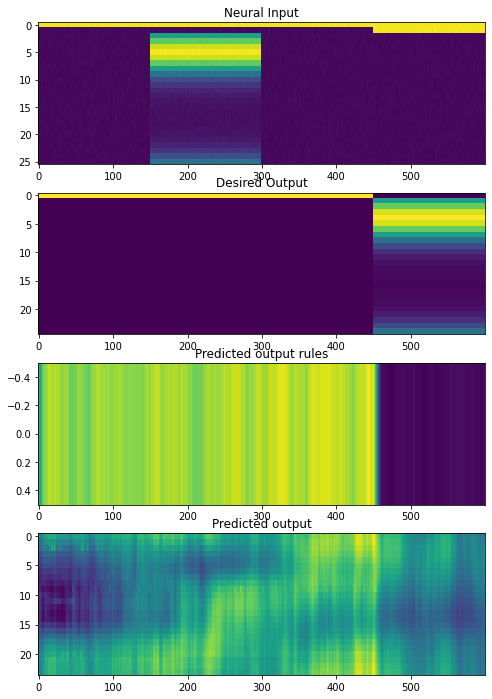

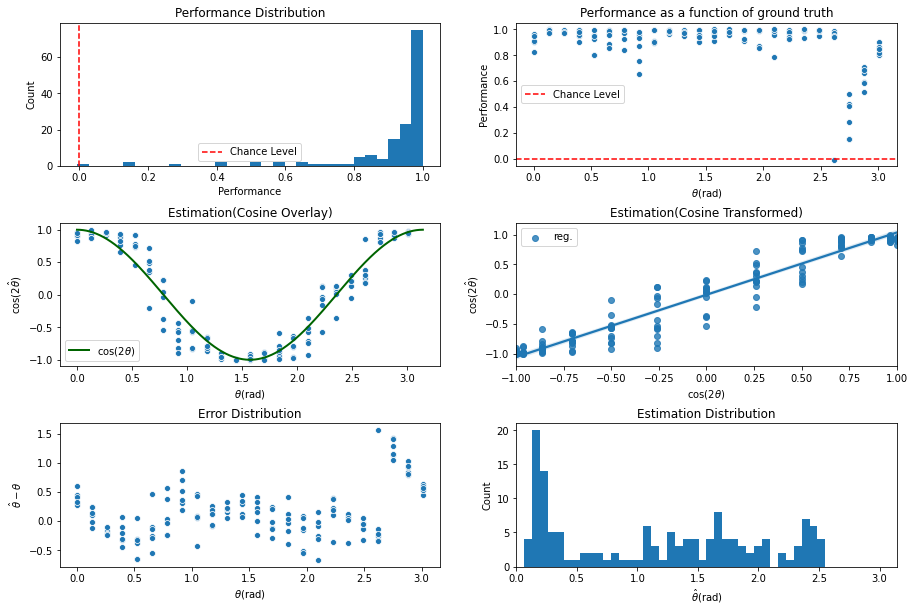

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter5800/assets

 Training performance: 
Iter. 5801 | Performance -0.0049 | Loss 0.2801 | Spike loss 3.7640
Testing performance: 
Iter. 5801 | Performance 0.9164 | Loss 0.2787 | Spike loss 3.7415

 Training performance: 
Iter. 5802 | Performance -0.0115 | Loss 0.2789 | Spike loss 3.7347
Testing performance: 
Iter. 5802 | Performance 0.9052 | Loss 0.2793 | Spike loss 3.7419

 Training performance: 
Iter. 5803 | Performance 0.0243 | Loss 0.2814 | Spike loss 3.8245
Testing performance: 
Iter. 5803 | Performance 0.9074 | Loss 0.2789 | Spike loss 3.7354

 Training performance: 
Iter. 5804 | Performance 0.0222 | Loss 0.2788 | Spike loss 3.8315
Testing performance: 
Iter. 5804 | Performance 0.9097 | Loss 0.2788 | Spike loss 3.7209

 Training performance: 
Iter. 5805 | Performance -0.0304 | Loss 0.2786 | Spike loss 3.5873
Testing performance: 
Iter. 5805 | Performance 0.8965 | Loss 0.2794 | Spike loss 3.6974

 Training 


 Training performance: 
Iter. 5847 | Performance -0.0077 | Loss 0.2752 | Spike loss 3.2225
Testing performance: 
Iter. 5847 | Performance 0.9223 | Loss 0.2771 | Spike loss 3.2306

 Training performance: 
Iter. 5848 | Performance 0.0434 | Loss 0.2775 | Spike loss 3.2637
Testing performance: 
Iter. 5848 | Performance 0.9184 | Loss 0.2770 | Spike loss 3.2145

 Training performance: 
Iter. 5849 | Performance 0.0424 | Loss 0.2761 | Spike loss 3.2749
Testing performance: 
Iter. 5849 | Performance 0.9181 | Loss 0.2767 | Spike loss 3.1847

 Training performance: 
Iter. 5850 | Performance -0.0584 | Loss 0.2769 | Spike loss 3.2663
Testing performance: 
Iter. 5850 | Performance 0.9221 | Loss 0.2757 | Spike loss 3.1844

 Training performance: 
Iter. 5851 | Performance 0.1215 | Loss 0.2762 | Spike loss 3.2318
Testing performance: 
Iter. 5851 | Performance 0.9207 | Loss 0.2772 | Spike loss 3.2161

 Training performance: 
Iter. 5852 | Performance 0.0184 | Loss 0.2772 | Spike loss 3.2117
Testing perf


 Training performance: 
Iter. 5893 | Performance -0.0132 | Loss 0.2797 | Spike loss 3.5412
Testing performance: 
Iter. 5893 | Performance 0.9141 | Loss 0.2779 | Spike loss 3.5242

 Training performance: 
Iter. 5894 | Performance -0.0486 | Loss 0.2779 | Spike loss 3.3530
Testing performance: 
Iter. 5894 | Performance 0.9270 | Loss 0.2773 | Spike loss 3.5017

 Training performance: 
Iter. 5895 | Performance -0.0175 | Loss 0.2793 | Spike loss 3.3708
Testing performance: 
Iter. 5895 | Performance 0.9134 | Loss 0.2785 | Spike loss 3.5094

 Training performance: 
Iter. 5896 | Performance -0.1484 | Loss 0.2779 | Spike loss 3.6684
Testing performance: 
Iter. 5896 | Performance 0.9299 | Loss 0.2776 | Spike loss 3.5627

 Training performance: 
Iter. 5897 | Performance 0.0078 | Loss 0.2788 | Spike loss 3.7224
Testing performance: 
Iter. 5897 | Performance 0.9066 | Loss 0.2795 | Spike loss 3.5492

 Training performance: 
Iter. 5898 | Performance 0.0353 | Loss 0.2786 | Spike loss 3.4179
Testing pe

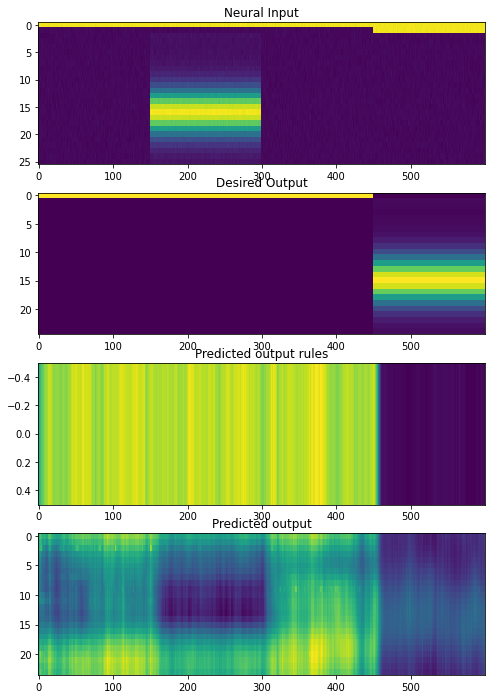

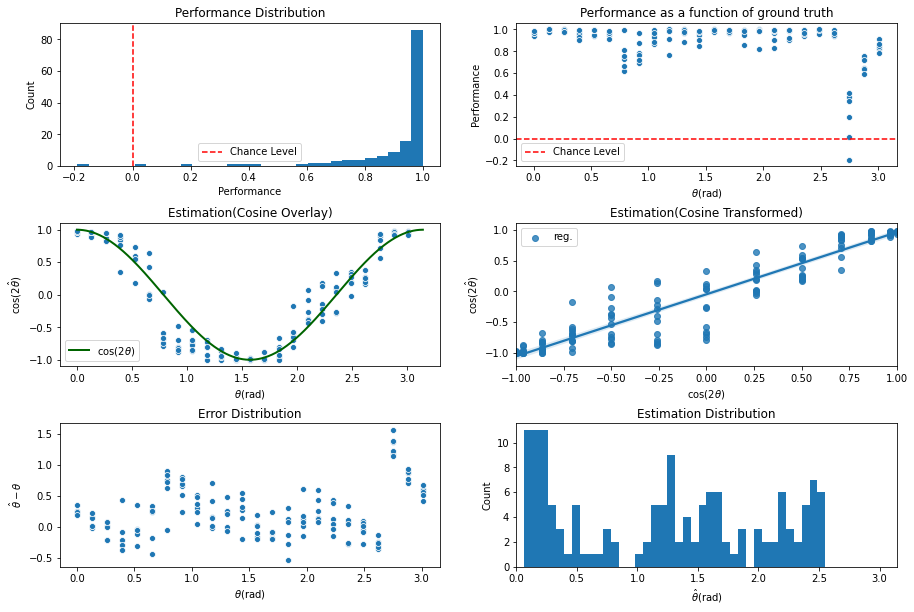

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter5900/assets

 Training performance: 
Iter. 5901 | Performance 0.0679 | Loss 0.2786 | Spike loss 3.4257
Testing performance: 
Iter. 5901 | Performance 0.9028 | Loss 0.2791 | Spike loss 3.4397

 Training performance: 
Iter. 5902 | Performance 0.0216 | Loss 0.2786 | Spike loss 3.4400
Testing performance: 
Iter. 5902 | Performance 0.8983 | Loss 0.2794 | Spike loss 3.4340

 Training performance: 
Iter. 5903 | Performance -0.0614 | Loss 0.2759 | Spike loss 3.4006
Testing performance: 
Iter. 5903 | Performance 0.9141 | Loss 0.2782 | Spike loss 3.4499

 Training performance: 
Iter. 5904 | Performance 0.0092 | Loss 0.2774 | Spike loss 3.3782
Testing performance: 
Iter. 5904 | Performance 0.9068 | Loss 0.2780 | Spike loss 3.4080

 Training performance: 
Iter. 5905 | Performance -0.0443 | Loss 0.2770 | Spike loss 3.4069
Testing performance: 
Iter. 5905 | Performance 0.8980 | Loss 0.2792 | Spike loss 3.4374

 Training p


 Training performance: 
Iter. 5947 | Performance 0.0438 | Loss 0.2773 | Spike loss 3.2951
Testing performance: 
Iter. 5947 | Performance 0.9007 | Loss 0.2788 | Spike loss 3.2040

 Training performance: 
Iter. 5948 | Performance 0.0747 | Loss 0.2763 | Spike loss 3.2406
Testing performance: 
Iter. 5948 | Performance 0.9238 | Loss 0.2767 | Spike loss 3.2188

 Training performance: 
Iter. 5949 | Performance 0.0405 | Loss 0.2763 | Spike loss 3.2539
Testing performance: 
Iter. 5949 | Performance 0.9350 | Loss 0.2769 | Spike loss 3.2092

 Training performance: 
Iter. 5950 | Performance 0.0228 | Loss 0.2759 | Spike loss 3.2281
Testing performance: 
Iter. 5950 | Performance 0.9397 | Loss 0.2761 | Spike loss 3.2092

 Training performance: 
Iter. 5951 | Performance 0.0279 | Loss 0.2751 | Spike loss 3.1043
Testing performance: 
Iter. 5951 | Performance 0.9424 | Loss 0.2763 | Spike loss 3.2161

 Training performance: 
Iter. 5952 | Performance 0.0571 | Loss 0.2759 | Spike loss 3.1017
Testing perfor


 Training performance: 
Iter. 5993 | Performance 0.0050 | Loss 0.2742 | Spike loss 3.2072
Testing performance: 
Iter. 5993 | Performance 0.9420 | Loss 0.2758 | Spike loss 3.2368

 Training performance: 
Iter. 5994 | Performance -0.0346 | Loss 0.2777 | Spike loss 3.2419
Testing performance: 
Iter. 5994 | Performance 0.9322 | Loss 0.2767 | Spike loss 3.2696

 Training performance: 
Iter. 5995 | Performance 0.0851 | Loss 0.2770 | Spike loss 3.2899
Testing performance: 
Iter. 5995 | Performance 0.9379 | Loss 0.2765 | Spike loss 3.3110

 Training performance: 
Iter. 5996 | Performance 0.0101 | Loss 0.2777 | Spike loss 3.4673
Testing performance: 
Iter. 5996 | Performance 0.9302 | Loss 0.2774 | Spike loss 3.3264

 Training performance: 
Iter. 5997 | Performance 0.0101 | Loss 0.2778 | Spike loss 3.3231
Testing performance: 
Iter. 5997 | Performance 0.9253 | Loss 0.2774 | Spike loss 3.3018

 Training performance: 
Iter. 5998 | Performance -0.0795 | Loss 0.2757 | Spike loss 3.3316
Testing perf

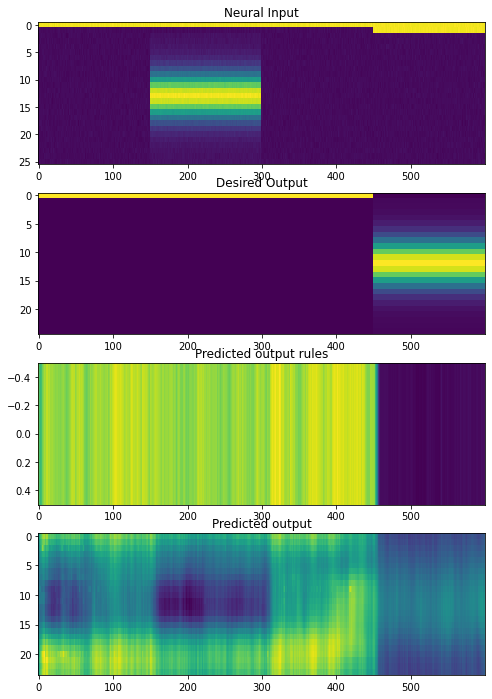

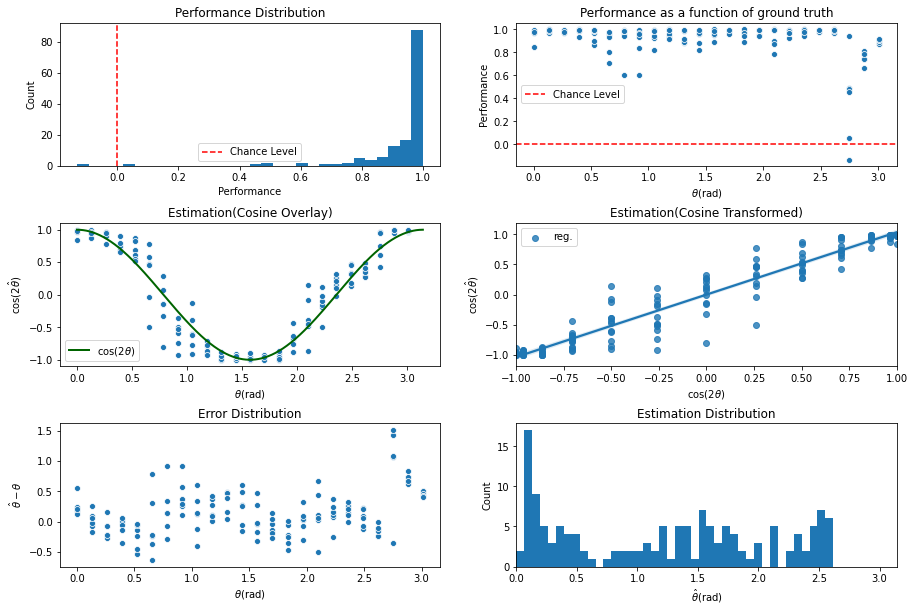

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter6000/assets

 Training performance: 
Iter. 6001 | Performance 0.1925 | Loss 0.2771 | Spike loss 3.4883
Testing performance: 
Iter. 6001 | Performance 0.9300 | Loss 0.2775 | Spike loss 3.4427

 Training performance: 
Iter. 6002 | Performance 0.0010 | Loss 0.2781 | Spike loss 3.3942
Testing performance: 
Iter. 6002 | Performance 0.9217 | Loss 0.2781 | Spike loss 3.4716

 Training performance: 
Iter. 6003 | Performance -0.0262 | Loss 0.2784 | Spike loss 3.5654
Testing performance: 
Iter. 6003 | Performance 0.9173 | Loss 0.2782 | Spike loss 3.5209

 Training performance: 
Iter. 6004 | Performance -0.0264 | Loss 0.2787 | Spike loss 3.4720
Testing performance: 
Iter. 6004 | Performance 0.9085 | Loss 0.2778 | Spike loss 3.5081

 Training performance: 
Iter. 6005 | Performance -0.0647 | Loss 0.2779 | Spike loss 3.5228
Testing performance: 
Iter. 6005 | Performance 0.9123 | Loss 0.2785 | Spike loss 3.5550

 Training 


 Training performance: 
Iter. 6047 | Performance -0.0892 | Loss 0.2779 | Spike loss 3.5184
Testing performance: 
Iter. 6047 | Performance 0.9264 | Loss 0.2763 | Spike loss 3.3209

 Training performance: 
Iter. 6048 | Performance -0.0040 | Loss 0.2768 | Spike loss 3.3280
Testing performance: 
Iter. 6048 | Performance 0.9225 | Loss 0.2759 | Spike loss 3.3104

 Training performance: 
Iter. 6049 | Performance 0.0825 | Loss 0.2775 | Spike loss 3.4264
Testing performance: 
Iter. 6049 | Performance 0.9190 | Loss 0.2775 | Spike loss 3.2943

 Training performance: 
Iter. 6050 | Performance -0.0466 | Loss 0.2773 | Spike loss 3.2461
Testing performance: 
Iter. 6050 | Performance 0.9228 | Loss 0.2766 | Spike loss 3.3283

 Training performance: 
Iter. 6051 | Performance 0.0484 | Loss 0.2770 | Spike loss 3.3323
Testing performance: 
Iter. 6051 | Performance 0.9416 | Loss 0.2756 | Spike loss 3.3006

 Training performance: 
Iter. 6052 | Performance 0.0260 | Loss 0.2755 | Spike loss 3.3376
Testing per


 Training performance: 
Iter. 6093 | Performance 0.0396 | Loss 0.2752 | Spike loss 3.3069
Testing performance: 
Iter. 6093 | Performance 0.9291 | Loss 0.2771 | Spike loss 3.3319

 Training performance: 
Iter. 6094 | Performance -0.0554 | Loss 0.2768 | Spike loss 3.4563
Testing performance: 
Iter. 6094 | Performance 0.9279 | Loss 0.2762 | Spike loss 3.3146

 Training performance: 
Iter. 6095 | Performance 0.0442 | Loss 0.2764 | Spike loss 3.3352
Testing performance: 
Iter. 6095 | Performance 0.9212 | Loss 0.2762 | Spike loss 3.3116

 Training performance: 
Iter. 6096 | Performance -0.0193 | Loss 0.2764 | Spike loss 3.3046
Testing performance: 
Iter. 6096 | Performance 0.9000 | Loss 0.2784 | Spike loss 3.2724

 Training performance: 
Iter. 6097 | Performance 0.0713 | Loss 0.2754 | Spike loss 3.3478
Testing performance: 
Iter. 6097 | Performance 0.9034 | Loss 0.2772 | Spike loss 3.2579

 Training performance: 
Iter. 6098 | Performance -0.0024 | Loss 0.2776 | Spike loss 3.2511
Testing per

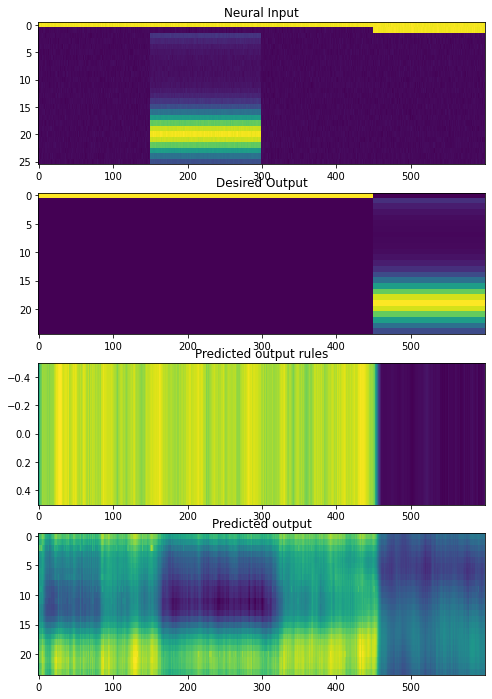

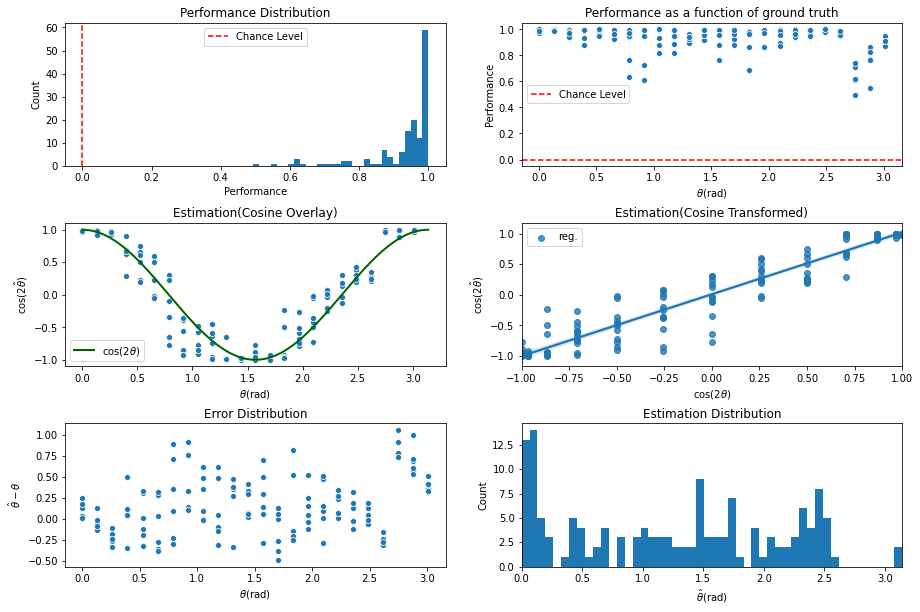

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter6100/assets

 Training performance: 
Iter. 6101 | Performance 0.0363 | Loss 0.2760 | Spike loss 3.3551
Testing performance: 
Iter. 6101 | Performance 0.9400 | Loss 0.2772 | Spike loss 3.3106

 Training performance: 
Iter. 6102 | Performance -0.0405 | Loss 0.2780 | Spike loss 3.3663
Testing performance: 
Iter. 6102 | Performance 0.9369 | Loss 0.2769 | Spike loss 3.3264

 Training performance: 
Iter. 6103 | Performance 0.0511 | Loss 0.2779 | Spike loss 3.3063
Testing performance: 
Iter. 6103 | Performance 0.9386 | Loss 0.2768 | Spike loss 3.3454

 Training performance: 
Iter. 6104 | Performance 0.0784 | Loss 0.2754 | Spike loss 3.2654
Testing performance: 
Iter. 6104 | Performance 0.9379 | Loss 0.2754 | Spike loss 3.2989

 Training performance: 
Iter. 6105 | Performance 0.0799 | Loss 0.2775 | Spike loss 3.3476
Testing performance: 
Iter. 6105 | Performance 0.9153 | Loss 0.2768 | Spike loss 3.2756

 Training pe


 Training performance: 
Iter. 6147 | Performance -0.0423 | Loss 0.2763 | Spike loss 3.2967
Testing performance: 
Iter. 6147 | Performance 0.9421 | Loss 0.2762 | Spike loss 3.2543

 Training performance: 
Iter. 6148 | Performance -0.0182 | Loss 0.2756 | Spike loss 3.2673
Testing performance: 
Iter. 6148 | Performance 0.9183 | Loss 0.2778 | Spike loss 3.2411

 Training performance: 
Iter. 6149 | Performance 0.0096 | Loss 0.2755 | Spike loss 3.2624
Testing performance: 
Iter. 6149 | Performance 0.9270 | Loss 0.2769 | Spike loss 3.2586

 Training performance: 
Iter. 6150 | Performance 0.0846 | Loss 0.2766 | Spike loss 3.3216
Testing performance: 
Iter. 6150 | Performance 0.9413 | Loss 0.2750 | Spike loss 3.2482

 Training performance: 
Iter. 6151 | Performance 0.1075 | Loss 0.2775 | Spike loss 3.2505
Testing performance: 
Iter. 6151 | Performance 0.9236 | Loss 0.2765 | Spike loss 3.2227

 Training performance: 
Iter. 6152 | Performance 0.0434 | Loss 0.2771 | Spike loss 3.2134
Testing perf


 Training performance: 
Iter. 6193 | Performance 0.0330 | Loss 0.2759 | Spike loss 3.2869
Testing performance: 
Iter. 6193 | Performance 0.9356 | Loss 0.2759 | Spike loss 3.3025

 Training performance: 
Iter. 6194 | Performance -0.0463 | Loss 0.2753 | Spike loss 3.2876
Testing performance: 
Iter. 6194 | Performance 0.9331 | Loss 0.2760 | Spike loss 3.2901

 Training performance: 
Iter. 6195 | Performance 0.0831 | Loss 0.2765 | Spike loss 3.3964
Testing performance: 
Iter. 6195 | Performance 0.9311 | Loss 0.2771 | Spike loss 3.3341

 Training performance: 
Iter. 6196 | Performance -0.0464 | Loss 0.2778 | Spike loss 3.3969
Testing performance: 
Iter. 6196 | Performance 0.9319 | Loss 0.2760 | Spike loss 3.3527

 Training performance: 
Iter. 6197 | Performance -0.1429 | Loss 0.2757 | Spike loss 3.3825
Testing performance: 
Iter. 6197 | Performance 0.9355 | Loss 0.2765 | Spike loss 3.3129

 Training performance: 
Iter. 6198 | Performance -0.0118 | Loss 0.2763 | Spike loss 3.3664
Testing pe

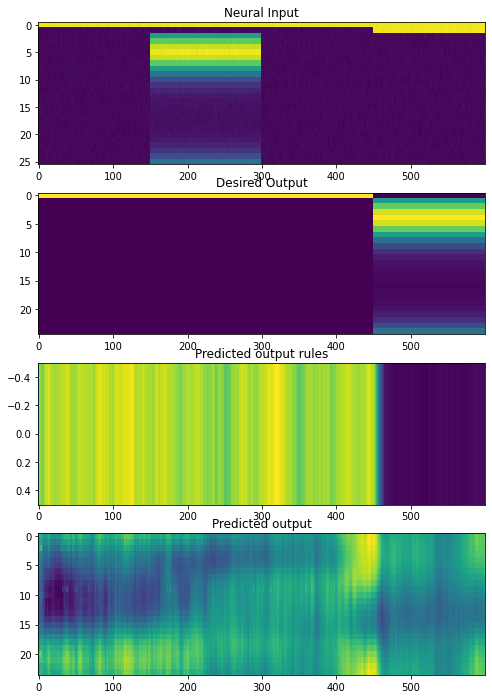

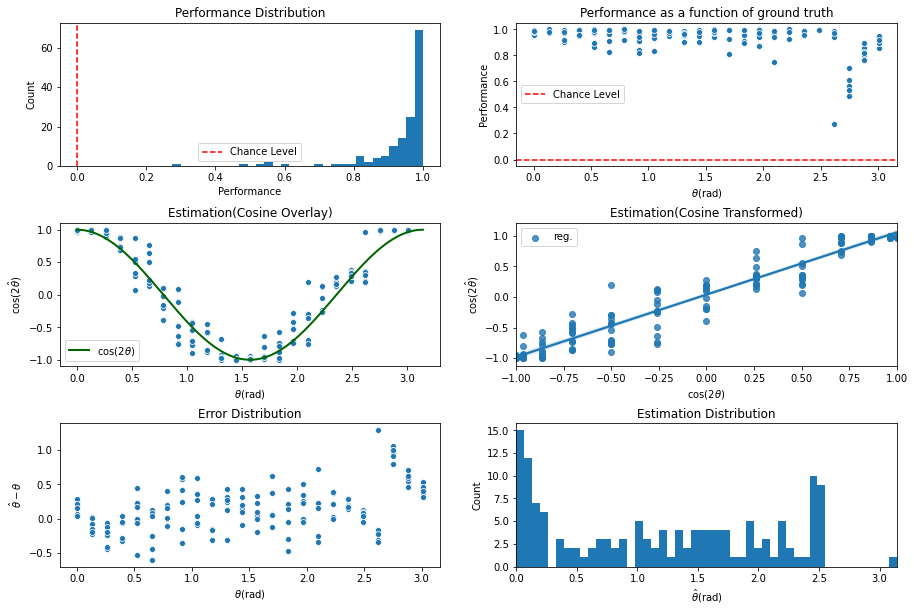

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter6200/assets

 Training performance: 
Iter. 6201 | Performance -0.0542 | Loss 0.2753 | Spike loss 3.4193
Testing performance: 
Iter. 6201 | Performance 0.9342 | Loss 0.2757 | Spike loss 3.3158

 Training performance: 
Iter. 6202 | Performance -0.0153 | Loss 0.2771 | Spike loss 3.4797
Testing performance: 
Iter. 6202 | Performance 0.9231 | Loss 0.2767 | Spike loss 3.3300

 Training performance: 
Iter. 6203 | Performance -0.0074 | Loss 0.2764 | Spike loss 3.4568
Testing performance: 
Iter. 6203 | Performance 0.9295 | Loss 0.2764 | Spike loss 3.3679

 Training performance: 
Iter. 6204 | Performance -0.0117 | Loss 0.2775 | Spike loss 3.5230
Testing performance: 
Iter. 6204 | Performance 0.9304 | Loss 0.2765 | Spike loss 3.3529

 Training performance: 
Iter. 6205 | Performance 0.0679 | Loss 0.2774 | Spike loss 3.4303
Testing performance: 
Iter. 6205 | Performance 0.9196 | Loss 0.2775 | Spike loss 3.3824

 Training


 Training performance: 
Iter. 6247 | Performance 0.0310 | Loss 0.2749 | Spike loss 3.1727
Testing performance: 
Iter. 6247 | Performance 0.9410 | Loss 0.2750 | Spike loss 3.1873

 Training performance: 
Iter. 6248 | Performance -0.0635 | Loss 0.2741 | Spike loss 3.2726
Testing performance: 
Iter. 6248 | Performance 0.9325 | Loss 0.2748 | Spike loss 3.1692

 Training performance: 
Iter. 6249 | Performance 0.0360 | Loss 0.2749 | Spike loss 3.1261
Testing performance: 
Iter. 6249 | Performance 0.9349 | Loss 0.2754 | Spike loss 3.2089

 Training performance: 
Iter. 6250 | Performance -0.0402 | Loss 0.2749 | Spike loss 3.2246
Testing performance: 
Iter. 6250 | Performance 0.9238 | Loss 0.2760 | Spike loss 3.2023

 Training performance: 
Iter. 6251 | Performance 0.1469 | Loss 0.2737 | Spike loss 3.2141
Testing performance: 
Iter. 6251 | Performance 0.9331 | Loss 0.2753 | Spike loss 3.1768

 Training performance: 
Iter. 6252 | Performance 0.0897 | Loss 0.2747 | Spike loss 3.1523
Testing perf


 Training performance: 
Iter. 6293 | Performance -0.0082 | Loss 0.2750 | Spike loss 3.2011
Testing performance: 
Iter. 6293 | Performance 0.9480 | Loss 0.2746 | Spike loss 3.2088

 Training performance: 
Iter. 6294 | Performance -0.0003 | Loss 0.2754 | Spike loss 3.3436
Testing performance: 
Iter. 6294 | Performance 0.9418 | Loss 0.2750 | Spike loss 3.2032

 Training performance: 
Iter. 6295 | Performance -0.0668 | Loss 0.2760 | Spike loss 3.2529
Testing performance: 
Iter. 6295 | Performance 0.9432 | Loss 0.2750 | Spike loss 3.2259

 Training performance: 
Iter. 6296 | Performance -0.0224 | Loss 0.2746 | Spike loss 3.2340
Testing performance: 
Iter. 6296 | Performance 0.9444 | Loss 0.2754 | Spike loss 3.2429

 Training performance: 
Iter. 6297 | Performance -0.0195 | Loss 0.2742 | Spike loss 3.3170
Testing performance: 
Iter. 6297 | Performance 0.9444 | Loss 0.2749 | Spike loss 3.2221

 Training performance: 
Iter. 6298 | Performance 0.1004 | Loss 0.2739 | Spike loss 3.1936
Testing p

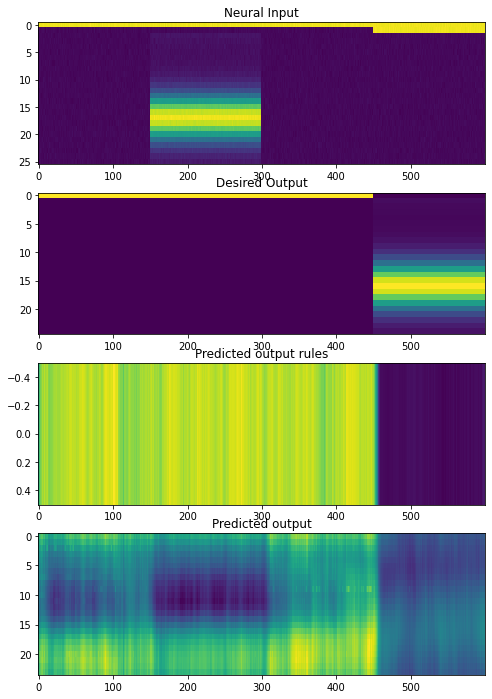

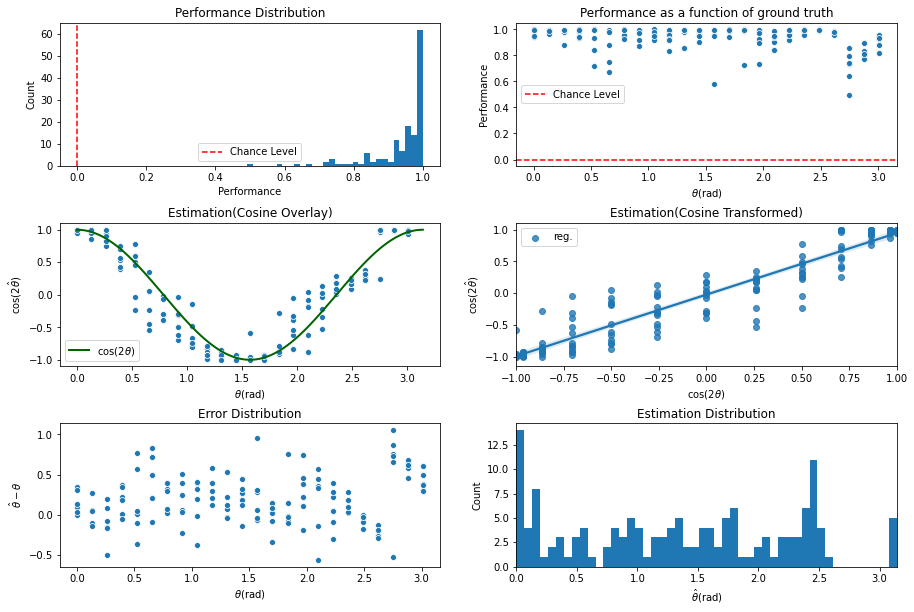

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter6300/assets

 Training performance: 
Iter. 6301 | Performance 0.0651 | Loss 0.2746 | Spike loss 3.2411
Testing performance: 
Iter. 6301 | Performance 0.9411 | Loss 0.2747 | Spike loss 3.2402

 Training performance: 
Iter. 6302 | Performance 0.0725 | Loss 0.2738 | Spike loss 3.1583
Testing performance: 
Iter. 6302 | Performance 0.9417 | Loss 0.2746 | Spike loss 3.2372

 Training performance: 
Iter. 6303 | Performance 0.0942 | Loss 0.2745 | Spike loss 3.1787
Testing performance: 
Iter. 6303 | Performance 0.9336 | Loss 0.2760 | Spike loss 3.2287

 Training performance: 
Iter. 6304 | Performance -0.0206 | Loss 0.2756 | Spike loss 3.3994
Testing performance: 
Iter. 6304 | Performance 0.9326 | Loss 0.2762 | Spike loss 3.2568

 Training performance: 
Iter. 6305 | Performance -0.0435 | Loss 0.2756 | Spike loss 3.2462
Testing performance: 
Iter. 6305 | Performance 0.9247 | Loss 0.2765 | Spike loss 3.2511

 Training p


 Training performance: 
Iter. 6347 | Performance 0.0378 | Loss 0.2744 | Spike loss 3.1328
Testing performance: 
Iter. 6347 | Performance 0.9194 | Loss 0.2761 | Spike loss 3.2044

 Training performance: 
Iter. 6348 | Performance 0.0431 | Loss 0.2766 | Spike loss 3.1142
Testing performance: 
Iter. 6348 | Performance 0.9318 | Loss 0.2751 | Spike loss 3.2032

 Training performance: 
Iter. 6349 | Performance 0.0008 | Loss 0.2756 | Spike loss 3.1780
Testing performance: 
Iter. 6349 | Performance 0.9198 | Loss 0.2767 | Spike loss 3.1792

 Training performance: 
Iter. 6350 | Performance -0.0744 | Loss 0.2752 | Spike loss 3.3557
Testing performance: 
Iter. 6350 | Performance 0.9310 | Loss 0.2748 | Spike loss 3.2084

 Training performance: 
Iter. 6351 | Performance 0.1427 | Loss 0.2758 | Spike loss 3.3687
Testing performance: 
Iter. 6351 | Performance 0.9351 | Loss 0.2745 | Spike loss 3.1950

 Training performance: 
Iter. 6352 | Performance 0.0413 | Loss 0.2755 | Spike loss 3.2896
Testing perfo


 Training performance: 
Iter. 6393 | Performance 0.0271 | Loss 0.2731 | Spike loss 2.9685
Testing performance: 
Iter. 6393 | Performance 0.9474 | Loss 0.2748 | Spike loss 2.9592

 Training performance: 
Iter. 6394 | Performance -0.0490 | Loss 0.2744 | Spike loss 2.8440
Testing performance: 
Iter. 6394 | Performance 0.9472 | Loss 0.2746 | Spike loss 2.9594

 Training performance: 
Iter. 6395 | Performance -0.0894 | Loss 0.2741 | Spike loss 2.9180
Testing performance: 
Iter. 6395 | Performance 0.9330 | Loss 0.2745 | Spike loss 2.9062

 Training performance: 
Iter. 6396 | Performance 0.0020 | Loss 0.2737 | Spike loss 2.8842
Testing performance: 
Iter. 6396 | Performance 0.9412 | Loss 0.2739 | Spike loss 2.9159

 Training performance: 
Iter. 6397 | Performance 0.0028 | Loss 0.2724 | Spike loss 2.9507
Testing performance: 
Iter. 6397 | Performance 0.9389 | Loss 0.2743 | Spike loss 2.9192

 Training performance: 
Iter. 6398 | Performance 0.0577 | Loss 0.2736 | Spike loss 2.8758
Testing perf

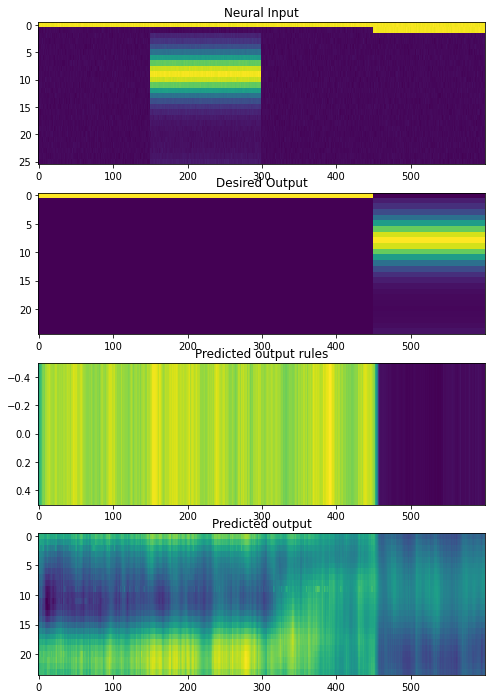

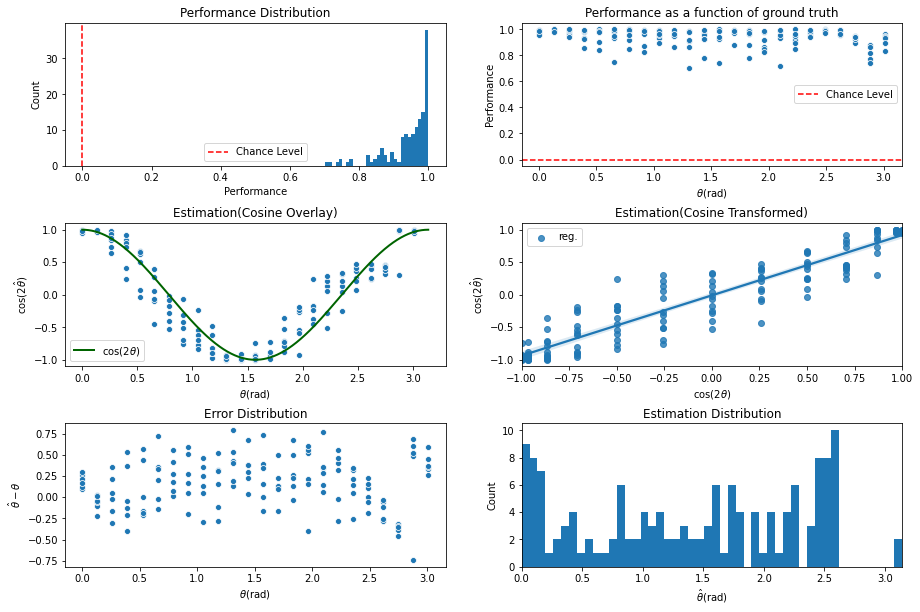

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter6400/assets

 Training performance: 
Iter. 6401 | Performance -0.0269 | Loss 0.2743 | Spike loss 2.7473
Testing performance: 
Iter. 6401 | Performance 0.9311 | Loss 0.2745 | Spike loss 2.8697

 Training performance: 
Iter. 6402 | Performance -0.0043 | Loss 0.2751 | Spike loss 2.9492
Testing performance: 
Iter. 6402 | Performance 0.9283 | Loss 0.2741 | Spike loss 2.8703

 Training performance: 
Iter. 6403 | Performance 0.0640 | Loss 0.2747 | Spike loss 2.8865
Testing performance: 
Iter. 6403 | Performance 0.9237 | Loss 0.2758 | Spike loss 2.8155

 Training performance: 
Iter. 6404 | Performance 0.0027 | Loss 0.2749 | Spike loss 2.9391
Testing performance: 
Iter. 6404 | Performance 0.9451 | Loss 0.2741 | Spike loss 2.8335

 Training performance: 
Iter. 6405 | Performance 0.0248 | Loss 0.2740 | Spike loss 2.8805
Testing performance: 
Iter. 6405 | Performance 0.9363 | Loss 0.2741 | Spike loss 2.8091

 Training p


 Training performance: 
Iter. 6447 | Performance -0.0142 | Loss 0.2738 | Spike loss 3.0882
Testing performance: 
Iter. 6447 | Performance 0.9424 | Loss 0.2746 | Spike loss 3.0253

 Training performance: 
Iter. 6448 | Performance -0.1037 | Loss 0.2741 | Spike loss 3.0552
Testing performance: 
Iter. 6448 | Performance 0.9412 | Loss 0.2743 | Spike loss 3.0484

 Training performance: 
Iter. 6449 | Performance 0.0225 | Loss 0.2737 | Spike loss 3.0702
Testing performance: 
Iter. 6449 | Performance 0.9435 | Loss 0.2744 | Spike loss 3.0204

 Training performance: 
Iter. 6450 | Performance 0.0905 | Loss 0.2741 | Spike loss 2.8384
Testing performance: 
Iter. 6450 | Performance 0.9373 | Loss 0.2743 | Spike loss 3.0186

 Training performance: 
Iter. 6451 | Performance 0.0429 | Loss 0.2742 | Spike loss 3.1193
Testing performance: 
Iter. 6451 | Performance 0.9481 | Loss 0.2736 | Spike loss 3.0173

 Training performance: 
Iter. 6452 | Performance -0.0333 | Loss 0.2739 | Spike loss 3.2077
Testing per


 Training performance: 
Iter. 6493 | Performance 0.0436 | Loss 0.2737 | Spike loss 3.1548
Testing performance: 
Iter. 6493 | Performance 0.9401 | Loss 0.2745 | Spike loss 3.0781

 Training performance: 
Iter. 6494 | Performance -0.0288 | Loss 0.2747 | Spike loss 3.0564
Testing performance: 
Iter. 6494 | Performance 0.9498 | Loss 0.2734 | Spike loss 3.0655

 Training performance: 
Iter. 6495 | Performance -0.0067 | Loss 0.2746 | Spike loss 3.1094
Testing performance: 
Iter. 6495 | Performance 0.9389 | Loss 0.2738 | Spike loss 3.0630

 Training performance: 
Iter. 6496 | Performance 0.0786 | Loss 0.2743 | Spike loss 3.0378
Testing performance: 
Iter. 6496 | Performance 0.9273 | Loss 0.2746 | Spike loss 3.0507

 Training performance: 
Iter. 6497 | Performance 0.0098 | Loss 0.2743 | Spike loss 3.0280
Testing performance: 
Iter. 6497 | Performance 0.9286 | Loss 0.2746 | Spike loss 3.0606

 Training performance: 
Iter. 6498 | Performance 0.0976 | Loss 0.2737 | Spike loss 3.1024
Testing perf

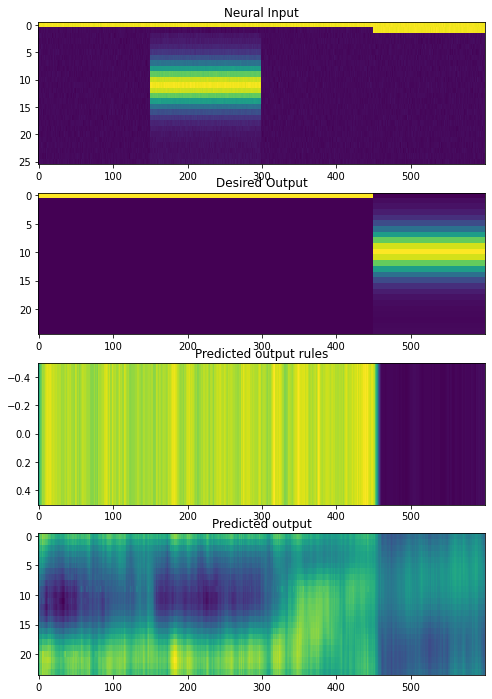

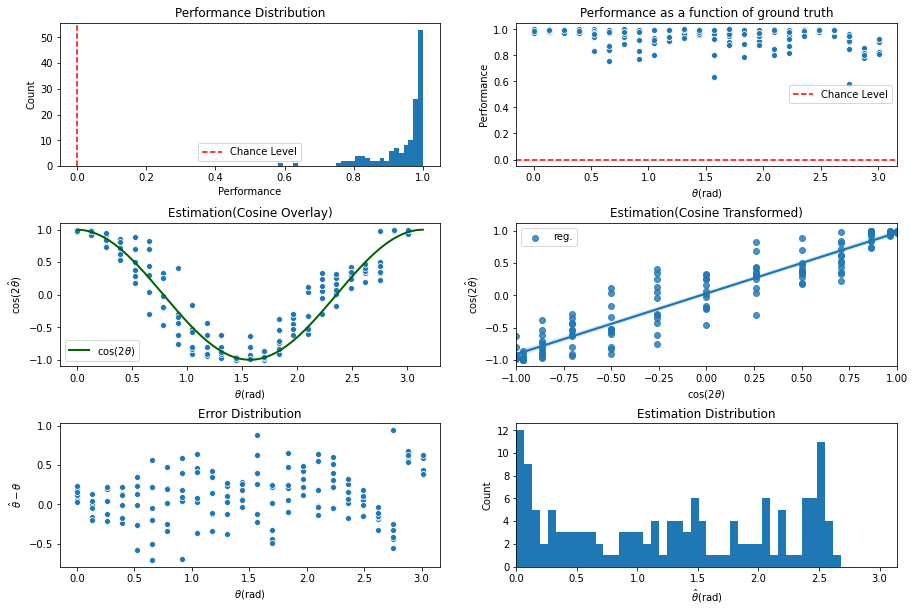

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter6500/assets

 Training performance: 
Iter. 6501 | Performance 0.0257 | Loss 0.2752 | Spike loss 3.0593
Testing performance: 
Iter. 6501 | Performance 0.9527 | Loss 0.2732 | Spike loss 3.0811

 Training performance: 
Iter. 6502 | Performance 0.0042 | Loss 0.2742 | Spike loss 3.1006
Testing performance: 
Iter. 6502 | Performance 0.9570 | Loss 0.2734 | Spike loss 3.0898

 Training performance: 
Iter. 6503 | Performance 0.1228 | Loss 0.2734 | Spike loss 3.0660
Testing performance: 
Iter. 6503 | Performance 0.9535 | Loss 0.2738 | Spike loss 3.0449

 Training performance: 
Iter. 6504 | Performance 0.0456 | Loss 0.2757 | Spike loss 3.0966
Testing performance: 
Iter. 6504 | Performance 0.9499 | Loss 0.2744 | Spike loss 3.0616

 Training performance: 
Iter. 6505 | Performance 0.1024 | Loss 0.2750 | Spike loss 3.2371
Testing performance: 
Iter. 6505 | Performance 0.9489 | Loss 0.2742 | Spike loss 3.0477

 Training per


 Training performance: 
Iter. 6547 | Performance -0.0208 | Loss 0.2743 | Spike loss 3.3085
Testing performance: 
Iter. 6547 | Performance 0.9408 | Loss 0.2748 | Spike loss 3.2306

 Training performance: 
Iter. 6548 | Performance -0.0478 | Loss 0.2745 | Spike loss 3.1334
Testing performance: 
Iter. 6548 | Performance 0.9481 | Loss 0.2748 | Spike loss 3.2619

 Training performance: 
Iter. 6549 | Performance -0.0819 | Loss 0.2742 | Spike loss 3.3559
Testing performance: 
Iter. 6549 | Performance 0.9393 | Loss 0.2753 | Spike loss 3.2688

 Training performance: 
Iter. 6550 | Performance 0.0577 | Loss 0.2732 | Spike loss 3.0121
Testing performance: 
Iter. 6550 | Performance 0.9400 | Loss 0.2750 | Spike loss 3.2671

 Training performance: 
Iter. 6551 | Performance 0.0302 | Loss 0.2746 | Spike loss 3.2264
Testing performance: 
Iter. 6551 | Performance 0.9342 | Loss 0.2749 | Spike loss 3.2335

 Training performance: 
Iter. 6552 | Performance 0.0313 | Loss 0.2762 | Spike loss 3.2905
Testing per


 Training performance: 
Iter. 6593 | Performance 0.0820 | Loss 0.2739 | Spike loss 3.1135
Testing performance: 
Iter. 6593 | Performance 0.9356 | Loss 0.2743 | Spike loss 3.1297

 Training performance: 
Iter. 6594 | Performance 0.0792 | Loss 0.2741 | Spike loss 3.1466
Testing performance: 
Iter. 6594 | Performance 0.9315 | Loss 0.2748 | Spike loss 3.1015

 Training performance: 
Iter. 6595 | Performance -0.0895 | Loss 0.2738 | Spike loss 3.1333
Testing performance: 
Iter. 6595 | Performance 0.9281 | Loss 0.2752 | Spike loss 3.1023

 Training performance: 
Iter. 6596 | Performance 0.0066 | Loss 0.2749 | Spike loss 3.1011
Testing performance: 
Iter. 6596 | Performance 0.9389 | Loss 0.2741 | Spike loss 3.0911

 Training performance: 
Iter. 6597 | Performance 0.0414 | Loss 0.2750 | Spike loss 3.1459
Testing performance: 
Iter. 6597 | Performance 0.9354 | Loss 0.2744 | Spike loss 3.1260

 Training performance: 
Iter. 6598 | Performance 0.0416 | Loss 0.2740 | Spike loss 3.0523
Testing perfo

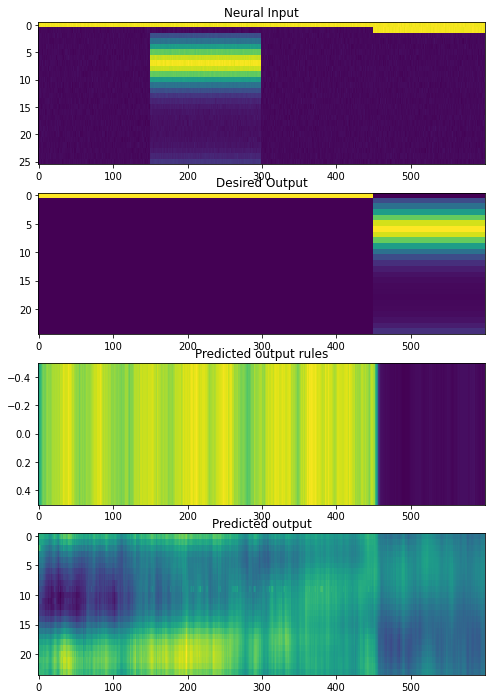

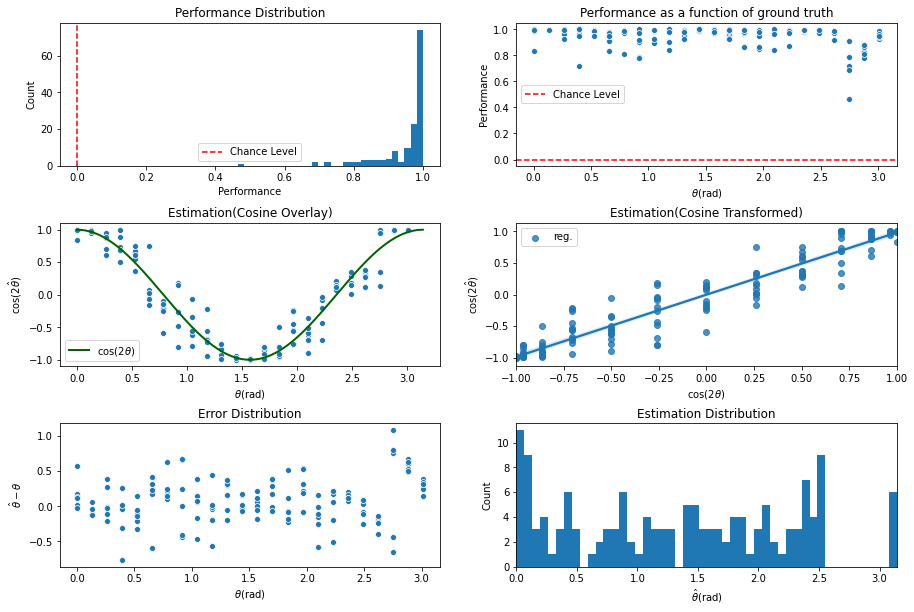

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter6600/assets

 Training performance: 
Iter. 6601 | Performance -0.0342 | Loss 0.2740 | Spike loss 3.0462
Testing performance: 
Iter. 6601 | Performance 0.9391 | Loss 0.2744 | Spike loss 3.1254

 Training performance: 
Iter. 6602 | Performance 0.0148 | Loss 0.2735 | Spike loss 3.1470
Testing performance: 
Iter. 6602 | Performance 0.9411 | Loss 0.2742 | Spike loss 3.1206

 Training performance: 
Iter. 6603 | Performance -0.0006 | Loss 0.2743 | Spike loss 3.1602
Testing performance: 
Iter. 6603 | Performance 0.9442 | Loss 0.2742 | Spike loss 3.1353

 Training performance: 
Iter. 6604 | Performance -0.0336 | Loss 0.2741 | Spike loss 3.1302
Testing performance: 
Iter. 6604 | Performance 0.9390 | Loss 0.2746 | Spike loss 3.1135

 Training performance: 
Iter. 6605 | Performance 0.0806 | Loss 0.2741 | Spike loss 3.1943
Testing performance: 
Iter. 6605 | Performance 0.9314 | Loss 0.2751 | Spike loss 3.1410

 Training 


 Training performance: 
Iter. 6647 | Performance -0.1407 | Loss 0.2719 | Spike loss 2.8791
Testing performance: 
Iter. 6647 | Performance 0.9425 | Loss 0.2741 | Spike loss 2.9862

 Training performance: 
Iter. 6648 | Performance -0.0599 | Loss 0.2743 | Spike loss 2.8823
Testing performance: 
Iter. 6648 | Performance 0.9503 | Loss 0.2736 | Spike loss 2.9877

 Training performance: 
Iter. 6649 | Performance -0.0368 | Loss 0.2731 | Spike loss 2.9921
Testing performance: 
Iter. 6649 | Performance 0.9414 | Loss 0.2743 | Spike loss 2.9716

 Training performance: 
Iter. 6650 | Performance -0.0265 | Loss 0.2741 | Spike loss 3.0923
Testing performance: 
Iter. 6650 | Performance 0.9494 | Loss 0.2734 | Spike loss 3.0564

 Training performance: 
Iter. 6651 | Performance -0.0955 | Loss 0.2748 | Spike loss 3.0760
Testing performance: 
Iter. 6651 | Performance 0.9435 | Loss 0.2734 | Spike loss 2.9577

 Training performance: 
Iter. 6652 | Performance 0.1189 | Loss 0.2739 | Spike loss 2.9875
Testing p


 Training performance: 
Iter. 6693 | Performance -0.0463 | Loss 0.2734 | Spike loss 2.9982
Testing performance: 
Iter. 6693 | Performance 0.9419 | Loss 0.2744 | Spike loss 2.9825

 Training performance: 
Iter. 6694 | Performance 0.1059 | Loss 0.2746 | Spike loss 2.9589
Testing performance: 
Iter. 6694 | Performance 0.9404 | Loss 0.2737 | Spike loss 2.9796

 Training performance: 
Iter. 6695 | Performance -0.0421 | Loss 0.2726 | Spike loss 2.9560
Testing performance: 
Iter. 6695 | Performance 0.9477 | Loss 0.2731 | Spike loss 2.9566

 Training performance: 
Iter. 6696 | Performance 0.0497 | Loss 0.2733 | Spike loss 2.9503
Testing performance: 
Iter. 6696 | Performance 0.9463 | Loss 0.2729 | Spike loss 2.9776

 Training performance: 
Iter. 6697 | Performance -0.0087 | Loss 0.2730 | Spike loss 2.9724
Testing performance: 
Iter. 6697 | Performance 0.9429 | Loss 0.2733 | Spike loss 2.9580

 Training performance: 
Iter. 6698 | Performance -0.0333 | Loss 0.2736 | Spike loss 2.9640
Testing pe

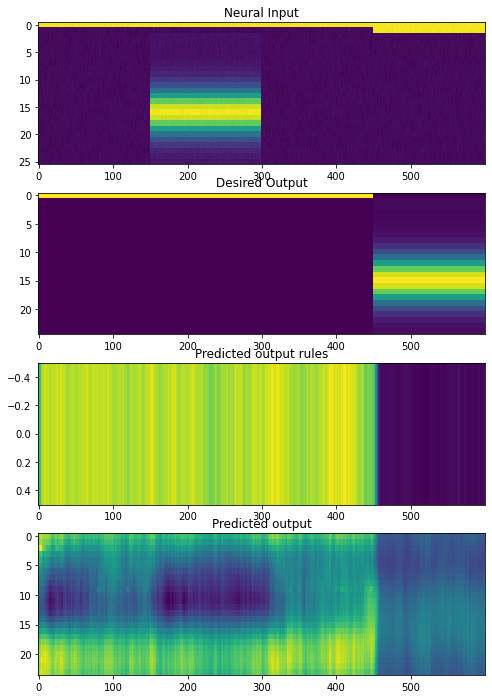

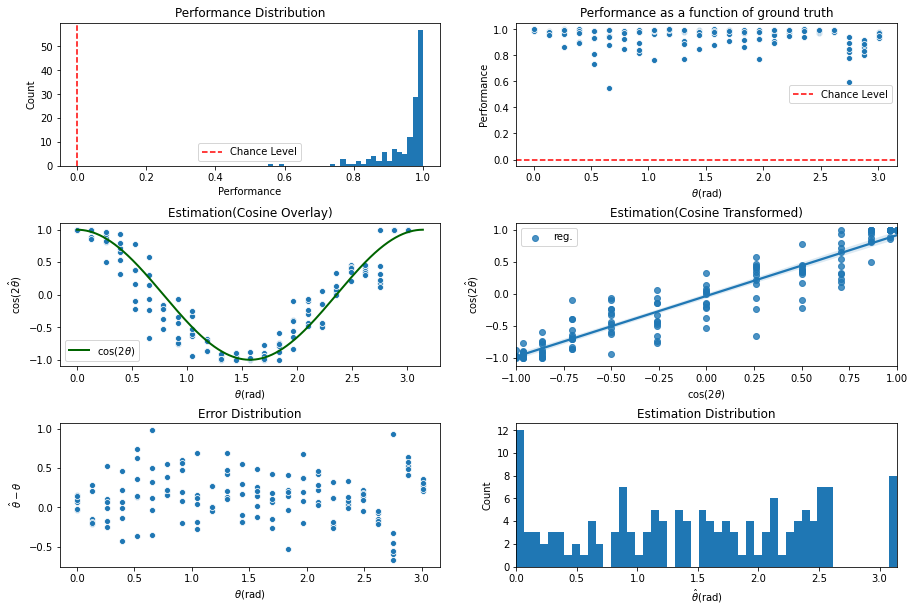

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter6700/assets

 Training performance: 
Iter. 6701 | Performance 0.0414 | Loss 0.2728 | Spike loss 3.0475
Testing performance: 
Iter. 6701 | Performance 0.9485 | Loss 0.2735 | Spike loss 3.0049

 Training performance: 
Iter. 6702 | Performance 0.0029 | Loss 0.2745 | Spike loss 3.0132
Testing performance: 
Iter. 6702 | Performance 0.9451 | Loss 0.2736 | Spike loss 2.9805

 Training performance: 
Iter. 6703 | Performance -0.0031 | Loss 0.2736 | Spike loss 3.0969
Testing performance: 
Iter. 6703 | Performance 0.9527 | Loss 0.2730 | Spike loss 3.0075

 Training performance: 
Iter. 6704 | Performance -0.0627 | Loss 0.2725 | Spike loss 3.0080
Testing performance: 
Iter. 6704 | Performance 0.9388 | Loss 0.2737 | Spike loss 2.9850

 Training performance: 
Iter. 6705 | Performance -0.1348 | Loss 0.2739 | Spike loss 3.0502
Testing performance: 
Iter. 6705 | Performance 0.9526 | Loss 0.2737 | Spike loss 2.9878

 Training 


 Training performance: 
Iter. 6747 | Performance 0.0201 | Loss 0.2750 | Spike loss 3.0949
Testing performance: 
Iter. 6747 | Performance 0.9462 | Loss 0.2742 | Spike loss 3.0293

 Training performance: 
Iter. 6748 | Performance 0.0351 | Loss 0.2740 | Spike loss 3.1679
Testing performance: 
Iter. 6748 | Performance 0.9484 | Loss 0.2733 | Spike loss 3.0301

 Training performance: 
Iter. 6749 | Performance -0.0397 | Loss 0.2739 | Spike loss 3.1183
Testing performance: 
Iter. 6749 | Performance 0.9475 | Loss 0.2738 | Spike loss 3.0212

 Training performance: 
Iter. 6750 | Performance 0.0275 | Loss 0.2733 | Spike loss 2.9803
Testing performance: 
Iter. 6750 | Performance 0.9439 | Loss 0.2737 | Spike loss 3.0012

 Training performance: 
Iter. 6751 | Performance 0.0775 | Loss 0.2732 | Spike loss 2.9268
Testing performance: 
Iter. 6751 | Performance 0.9320 | Loss 0.2743 | Spike loss 2.9701

 Training performance: 
Iter. 6752 | Performance -0.0438 | Loss 0.2729 | Spike loss 3.0226
Testing perf


 Training performance: 
Iter. 6793 | Performance 0.0682 | Loss 0.2736 | Spike loss 3.1681
Testing performance: 
Iter. 6793 | Performance 0.9436 | Loss 0.2748 | Spike loss 3.2180

 Training performance: 
Iter. 6794 | Performance -0.0099 | Loss 0.2752 | Spike loss 3.2001
Testing performance: 
Iter. 6794 | Performance 0.9455 | Loss 0.2738 | Spike loss 3.1832

 Training performance: 
Iter. 6795 | Performance -0.0168 | Loss 0.2738 | Spike loss 3.1641
Testing performance: 
Iter. 6795 | Performance 0.9468 | Loss 0.2739 | Spike loss 3.1773

 Training performance: 
Iter. 6796 | Performance -0.0438 | Loss 0.2733 | Spike loss 3.2857
Testing performance: 
Iter. 6796 | Performance 0.9429 | Loss 0.2739 | Spike loss 3.1584

 Training performance: 
Iter. 6797 | Performance 0.0424 | Loss 0.2754 | Spike loss 3.2366
Testing performance: 
Iter. 6797 | Performance 0.9460 | Loss 0.2729 | Spike loss 3.1535

 Training performance: 
Iter. 6798 | Performance -0.0458 | Loss 0.2739 | Spike loss 3.3328
Testing pe

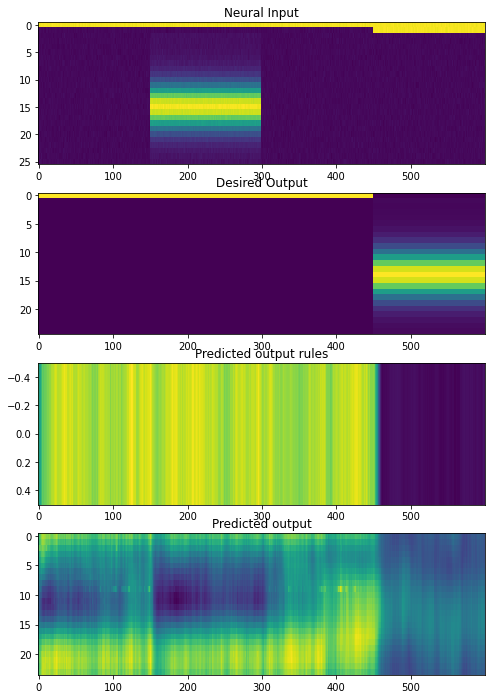

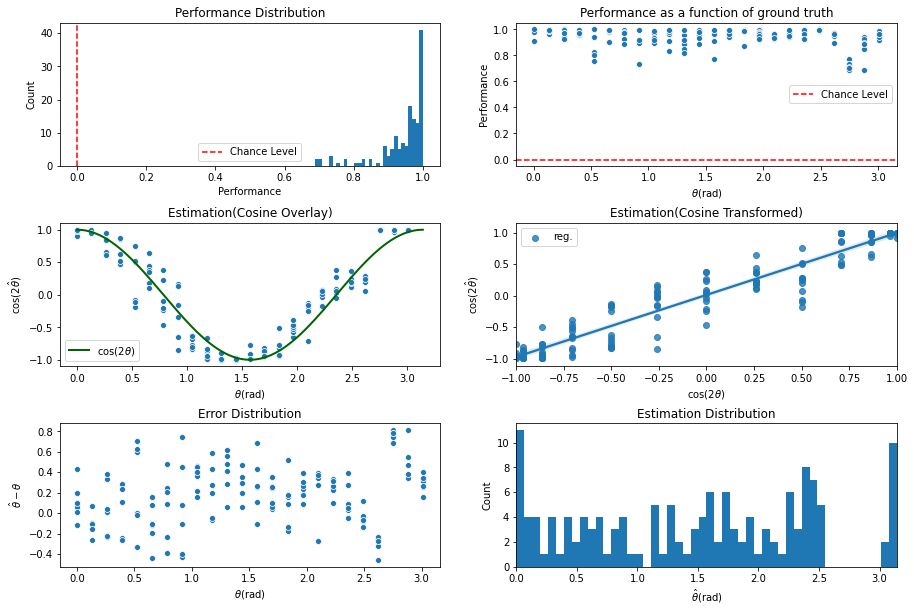

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter6800/assets

 Training performance: 
Iter. 6801 | Performance 0.1112 | Loss 0.2750 | Spike loss 3.1708
Testing performance: 
Iter. 6801 | Performance 0.9436 | Loss 0.2737 | Spike loss 3.1333

 Training performance: 
Iter. 6802 | Performance 0.0046 | Loss 0.2725 | Spike loss 3.2562
Testing performance: 
Iter. 6802 | Performance 0.9468 | Loss 0.2733 | Spike loss 3.1151

 Training performance: 
Iter. 6803 | Performance -0.1126 | Loss 0.2735 | Spike loss 3.0937
Testing performance: 
Iter. 6803 | Performance 0.9398 | Loss 0.2741 | Spike loss 3.1029

 Training performance: 
Iter. 6804 | Performance -0.1116 | Loss 0.2730 | Spike loss 3.0669
Testing performance: 
Iter. 6804 | Performance 0.9384 | Loss 0.2740 | Spike loss 3.1015

 Training performance: 
Iter. 6805 | Performance -0.0474 | Loss 0.2736 | Spike loss 3.1307
Testing performance: 
Iter. 6805 | Performance 0.9511 | Loss 0.2733 | Spike loss 3.1452

 Training 


 Training performance: 
Iter. 6847 | Performance 0.0185 | Loss 0.2730 | Spike loss 3.1382
Testing performance: 
Iter. 6847 | Performance 0.9449 | Loss 0.2732 | Spike loss 3.0997

 Training performance: 
Iter. 6848 | Performance -0.0614 | Loss 0.2731 | Spike loss 3.0493
Testing performance: 
Iter. 6848 | Performance 0.9474 | Loss 0.2729 | Spike loss 3.0545

 Training performance: 
Iter. 6849 | Performance 0.2581 | Loss 0.2738 | Spike loss 3.0860
Testing performance: 
Iter. 6849 | Performance 0.9450 | Loss 0.2736 | Spike loss 3.1048

 Training performance: 
Iter. 6850 | Performance 0.0920 | Loss 0.2734 | Spike loss 3.1314
Testing performance: 
Iter. 6850 | Performance 0.9450 | Loss 0.2745 | Spike loss 3.0681

 Training performance: 
Iter. 6851 | Performance -0.0421 | Loss 0.2732 | Spike loss 3.0278
Testing performance: 
Iter. 6851 | Performance 0.9534 | Loss 0.2727 | Spike loss 3.0764

 Training performance: 
Iter. 6852 | Performance -0.1271 | Loss 0.2733 | Spike loss 3.1025
Testing per


 Training performance: 
Iter. 6893 | Performance 0.0237 | Loss 0.2735 | Spike loss 3.3376
Testing performance: 
Iter. 6893 | Performance 0.9465 | Loss 0.2743 | Spike loss 3.2546

 Training performance: 
Iter. 6894 | Performance -0.0632 | Loss 0.2739 | Spike loss 3.1530
Testing performance: 
Iter. 6894 | Performance 0.9392 | Loss 0.2740 | Spike loss 3.3088

 Training performance: 
Iter. 6895 | Performance -0.0441 | Loss 0.2754 | Spike loss 3.2988
Testing performance: 
Iter. 6895 | Performance 0.9435 | Loss 0.2743 | Spike loss 3.3354

 Training performance: 
Iter. 6896 | Performance -0.0663 | Loss 0.2740 | Spike loss 3.3600
Testing performance: 
Iter. 6896 | Performance 0.9375 | Loss 0.2749 | Spike loss 3.3354

 Training performance: 
Iter. 6897 | Performance 0.0128 | Loss 0.2745 | Spike loss 3.5088
Testing performance: 
Iter. 6897 | Performance 0.9307 | Loss 0.2752 | Spike loss 3.3934

 Training performance: 
Iter. 6898 | Performance -0.0321 | Loss 0.2745 | Spike loss 3.4123
Testing pe

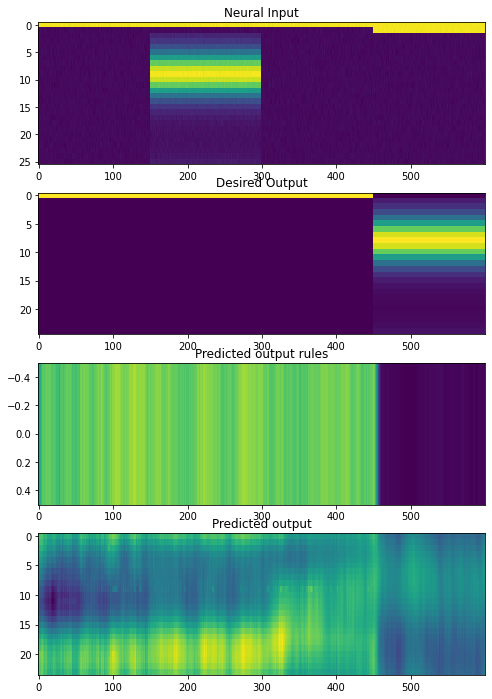

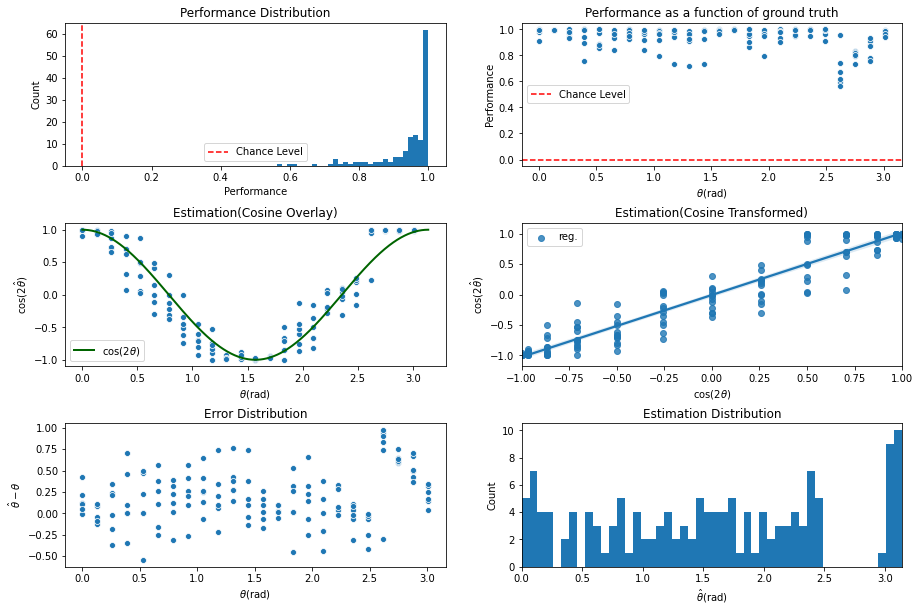

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter6900/assets

 Training performance: 
Iter. 6901 | Performance 0.0018 | Loss 0.2750 | Spike loss 3.4918
Testing performance: 
Iter. 6901 | Performance 0.9365 | Loss 0.2751 | Spike loss 3.4585

 Training performance: 
Iter. 6902 | Performance 0.0485 | Loss 0.2768 | Spike loss 3.6174
Testing performance: 
Iter. 6902 | Performance 0.9433 | Loss 0.2750 | Spike loss 3.4432

 Training performance: 
Iter. 6903 | Performance 0.0538 | Loss 0.2762 | Spike loss 3.5635
Testing performance: 
Iter. 6903 | Performance 0.9372 | Loss 0.2754 | Spike loss 3.4645

 Training performance: 
Iter. 6904 | Performance 0.1237 | Loss 0.2769 | Spike loss 3.5808
Testing performance: 
Iter. 6904 | Performance 0.9379 | Loss 0.2754 | Spike loss 3.4668

 Training performance: 
Iter. 6905 | Performance 0.0023 | Loss 0.2739 | Spike loss 3.5312
Testing performance: 
Iter. 6905 | Performance 0.9358 | Loss 0.2745 | Spike loss 3.4802

 Training per


 Training performance: 
Iter. 6947 | Performance 0.0397 | Loss 0.2739 | Spike loss 3.4081
Testing performance: 
Iter. 6947 | Performance 0.9304 | Loss 0.2742 | Spike loss 3.2732

 Training performance: 
Iter. 6948 | Performance -0.0456 | Loss 0.2742 | Spike loss 3.2415
Testing performance: 
Iter. 6948 | Performance 0.9432 | Loss 0.2734 | Spike loss 3.2281

 Training performance: 
Iter. 6949 | Performance 0.0348 | Loss 0.2732 | Spike loss 3.2794
Testing performance: 
Iter. 6949 | Performance 0.9349 | Loss 0.2739 | Spike loss 3.2519

 Training performance: 
Iter. 6950 | Performance 0.0699 | Loss 0.2751 | Spike loss 3.3966
Testing performance: 
Iter. 6950 | Performance 0.9389 | Loss 0.2749 | Spike loss 3.3006

 Training performance: 
Iter. 6951 | Performance -0.0286 | Loss 0.2751 | Spike loss 3.2634
Testing performance: 
Iter. 6951 | Performance 0.9524 | Loss 0.2734 | Spike loss 3.2777

 Training performance: 
Iter. 6952 | Performance -0.0946 | Loss 0.2734 | Spike loss 3.3228
Testing per


 Training performance: 
Iter. 6993 | Performance -0.0722 | Loss 0.2745 | Spike loss 3.2960
Testing performance: 
Iter. 6993 | Performance 0.9517 | Loss 0.2744 | Spike loss 3.2734

 Training performance: 
Iter. 6994 | Performance 0.0197 | Loss 0.2722 | Spike loss 3.1922
Testing performance: 
Iter. 6994 | Performance 0.9494 | Loss 0.2744 | Spike loss 3.2765

 Training performance: 
Iter. 6995 | Performance 0.0495 | Loss 0.2753 | Spike loss 3.4218
Testing performance: 
Iter. 6995 | Performance 0.9536 | Loss 0.2735 | Spike loss 3.2743

 Training performance: 
Iter. 6996 | Performance 0.0207 | Loss 0.2738 | Spike loss 3.3129
Testing performance: 
Iter. 6996 | Performance 0.9435 | Loss 0.2737 | Spike loss 3.2710

 Training performance: 
Iter. 6997 | Performance 0.0772 | Loss 0.2758 | Spike loss 3.3594
Testing performance: 
Iter. 6997 | Performance 0.9327 | Loss 0.2740 | Spike loss 3.3144

 Training performance: 
Iter. 6998 | Performance 0.1071 | Loss 0.2737 | Spike loss 3.2785
Testing perfo

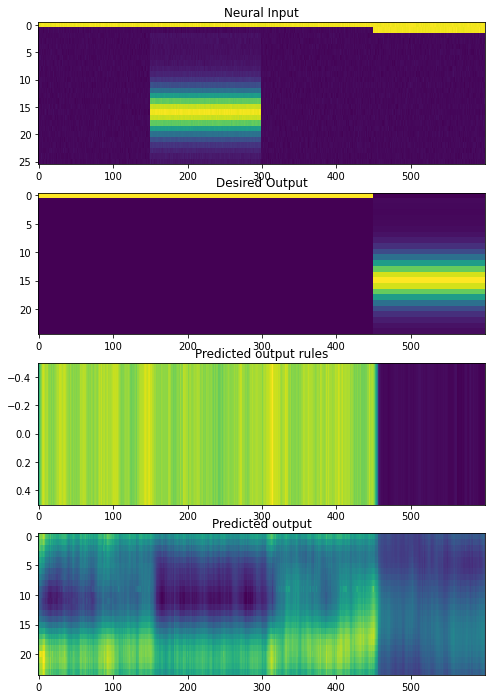

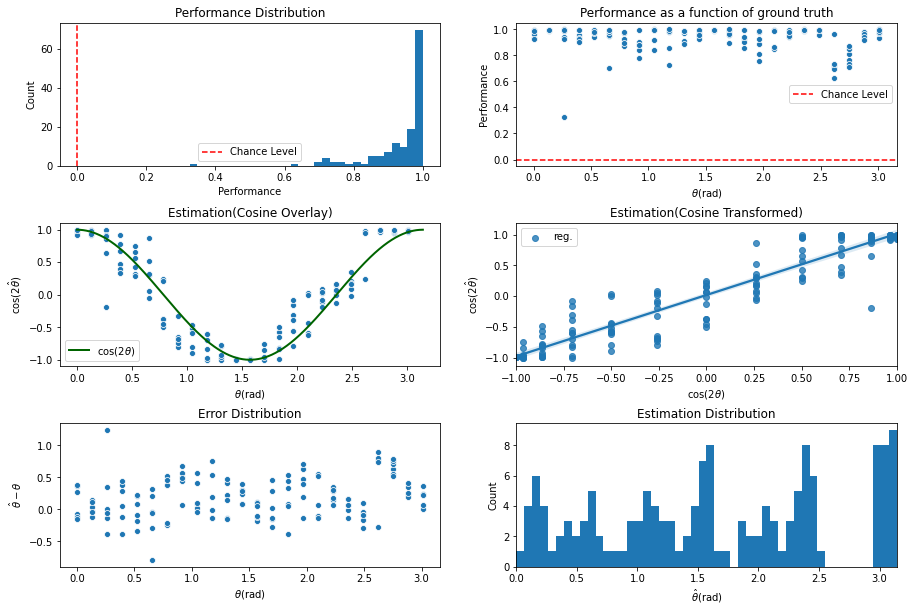

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter7000/assets

 Training performance: 
Iter. 7001 | Performance 0.0152 | Loss 0.2749 | Spike loss 3.3046
Testing performance: 
Iter. 7001 | Performance 0.9370 | Loss 0.2747 | Spike loss 3.3676

 Training performance: 
Iter. 7002 | Performance -0.0853 | Loss 0.2721 | Spike loss 3.1554
Testing performance: 
Iter. 7002 | Performance 0.9431 | Loss 0.2733 | Spike loss 3.3763

 Training performance: 
Iter. 7003 | Performance -0.0274 | Loss 0.2753 | Spike loss 3.3386
Testing performance: 
Iter. 7003 | Performance 0.9333 | Loss 0.2756 | Spike loss 3.4074

 Training performance: 
Iter. 7004 | Performance 0.0791 | Loss 0.2735 | Spike loss 3.2319
Testing performance: 
Iter. 7004 | Performance 0.9388 | Loss 0.2749 | Spike loss 3.4266

 Training performance: 
Iter. 7005 | Performance -0.0358 | Loss 0.2751 | Spike loss 3.4274
Testing performance: 
Iter. 7005 | Performance 0.9541 | Loss 0.2744 | Spike loss 3.3932

 Training 


 Training performance: 
Iter. 7047 | Performance -0.0063 | Loss 0.2720 | Spike loss 3.1849
Testing performance: 
Iter. 7047 | Performance 0.9431 | Loss 0.2737 | Spike loss 3.2474

 Training performance: 
Iter. 7048 | Performance 0.0277 | Loss 0.2739 | Spike loss 3.3078
Testing performance: 
Iter. 7048 | Performance 0.9501 | Loss 0.2730 | Spike loss 3.2302

 Training performance: 
Iter. 7049 | Performance -0.0178 | Loss 0.2724 | Spike loss 3.1948
Testing performance: 
Iter. 7049 | Performance 0.9503 | Loss 0.2734 | Spike loss 3.2805

 Training performance: 
Iter. 7050 | Performance 0.0407 | Loss 0.2730 | Spike loss 3.2425
Testing performance: 
Iter. 7050 | Performance 0.9459 | Loss 0.2732 | Spike loss 3.2640

 Training performance: 
Iter. 7051 | Performance -0.0222 | Loss 0.2738 | Spike loss 3.4097
Testing performance: 
Iter. 7051 | Performance 0.9502 | Loss 0.2735 | Spike loss 3.2686

 Training performance: 
Iter. 7052 | Performance -0.0039 | Loss 0.2739 | Spike loss 3.2957
Testing pe


 Training performance: 
Iter. 7093 | Performance -0.0727 | Loss 0.2728 | Spike loss 3.2208
Testing performance: 
Iter. 7093 | Performance 0.9256 | Loss 0.2747 | Spike loss 3.2064

 Training performance: 
Iter. 7094 | Performance 0.0068 | Loss 0.2729 | Spike loss 3.2358
Testing performance: 
Iter. 7094 | Performance 0.9295 | Loss 0.2744 | Spike loss 3.2291

 Training performance: 
Iter. 7095 | Performance 0.0278 | Loss 0.2730 | Spike loss 3.1894
Testing performance: 
Iter. 7095 | Performance 0.9418 | Loss 0.2732 | Spike loss 3.2452

 Training performance: 
Iter. 7096 | Performance -0.0400 | Loss 0.2727 | Spike loss 3.1314
Testing performance: 
Iter. 7096 | Performance 0.9492 | Loss 0.2727 | Spike loss 3.2062

 Training performance: 
Iter. 7097 | Performance 0.0088 | Loss 0.2726 | Spike loss 3.3035
Testing performance: 
Iter. 7097 | Performance 0.9463 | Loss 0.2732 | Spike loss 3.2069

 Training performance: 
Iter. 7098 | Performance -0.0356 | Loss 0.2733 | Spike loss 3.1771
Testing per

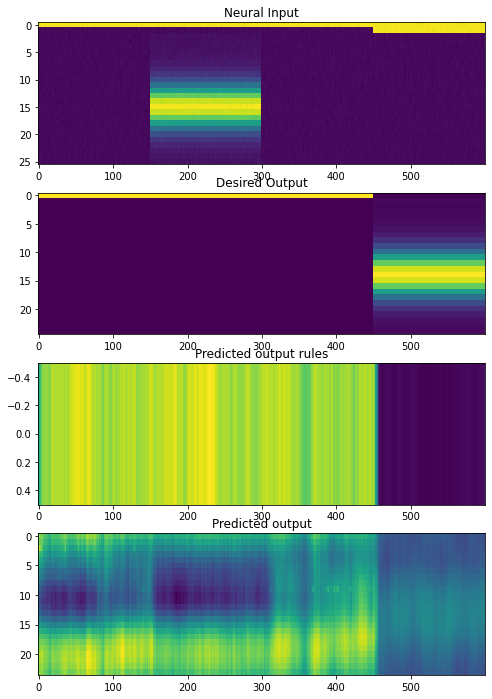

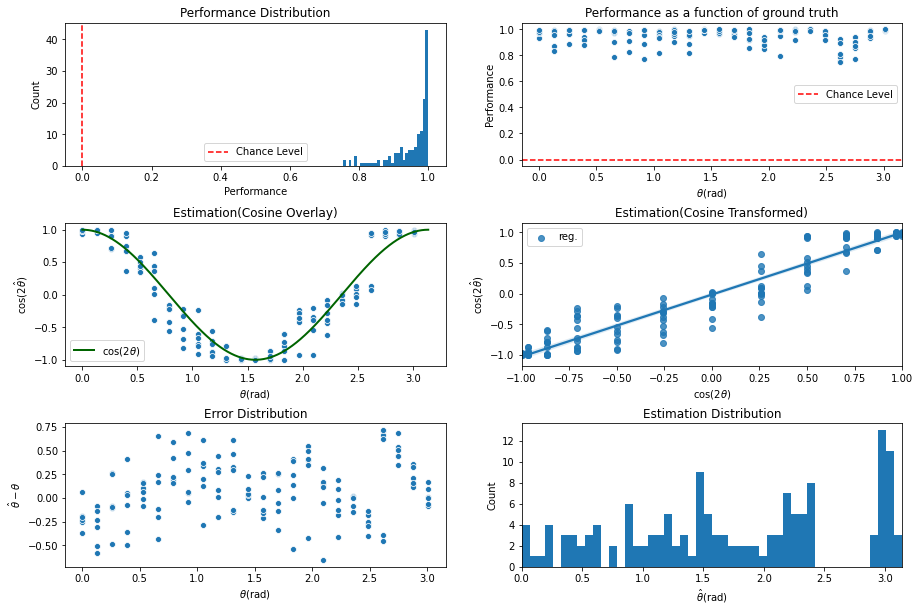

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter7100/assets

 Training performance: 
Iter. 7101 | Performance 0.0483 | Loss 0.2733 | Spike loss 3.2286
Testing performance: 
Iter. 7101 | Performance 0.9590 | Loss 0.2732 | Spike loss 3.2426

 Training performance: 
Iter. 7102 | Performance 0.0303 | Loss 0.2732 | Spike loss 3.2285
Testing performance: 
Iter. 7102 | Performance 0.9527 | Loss 0.2734 | Spike loss 3.2195

 Training performance: 
Iter. 7103 | Performance -0.0027 | Loss 0.2727 | Spike loss 3.2660
Testing performance: 
Iter. 7103 | Performance 0.9530 | Loss 0.2737 | Spike loss 3.2958

 Training performance: 
Iter. 7104 | Performance 0.0520 | Loss 0.2749 | Spike loss 3.3472
Testing performance: 
Iter. 7104 | Performance 0.9410 | Loss 0.2753 | Spike loss 3.2949

 Training performance: 
Iter. 7105 | Performance 0.0383 | Loss 0.2733 | Spike loss 3.2723
Testing performance: 
Iter. 7105 | Performance 0.9577 | Loss 0.2725 | Spike loss 3.3023

 Training pe


 Training performance: 
Iter. 7147 | Performance -0.0303 | Loss 0.2734 | Spike loss 3.0906
Testing performance: 
Iter. 7147 | Performance 0.9530 | Loss 0.2727 | Spike loss 3.0961

 Training performance: 
Iter. 7148 | Performance -0.0143 | Loss 0.2741 | Spike loss 3.0988
Testing performance: 
Iter. 7148 | Performance 0.9525 | Loss 0.2732 | Spike loss 3.0988

 Training performance: 
Iter. 7149 | Performance 0.0383 | Loss 0.2735 | Spike loss 3.2231
Testing performance: 
Iter. 7149 | Performance 0.9494 | Loss 0.2740 | Spike loss 3.0609

 Training performance: 
Iter. 7150 | Performance -0.0635 | Loss 0.2754 | Spike loss 3.0425
Testing performance: 
Iter. 7150 | Performance 0.9479 | Loss 0.2731 | Spike loss 3.0606

 Training performance: 
Iter. 7151 | Performance -0.0202 | Loss 0.2748 | Spike loss 3.1002
Testing performance: 
Iter. 7151 | Performance 0.9390 | Loss 0.2724 | Spike loss 3.0486

 Training performance: 
Iter. 7152 | Performance 0.0696 | Loss 0.2718 | Spike loss 3.0356
Testing pe


 Training performance: 
Iter. 7193 | Performance 0.1149 | Loss 0.2850 | Spike loss 2.6487
Testing performance: 
Iter. 7193 | Performance 0.8772 | Loss 0.2836 | Spike loss 2.7195

 Training performance: 
Iter. 7194 | Performance -0.0194 | Loss 0.2827 | Spike loss 2.6449
Testing performance: 
Iter. 7194 | Performance 0.8815 | Loss 0.2831 | Spike loss 2.6455

 Training performance: 
Iter. 7195 | Performance -0.0824 | Loss 0.2791 | Spike loss 2.7538
Testing performance: 
Iter. 7195 | Performance 0.9343 | Loss 0.2782 | Spike loss 2.8393

 Training performance: 
Iter. 7196 | Performance -0.0390 | Loss 0.2806 | Spike loss 2.8532
Testing performance: 
Iter. 7196 | Performance 0.9442 | Loss 0.2767 | Spike loss 2.9152

 Training performance: 
Iter. 7197 | Performance 0.0583 | Loss 0.2785 | Spike loss 2.9499
Testing performance: 
Iter. 7197 | Performance 0.9600 | Loss 0.2744 | Spike loss 2.9596

 Training performance: 
Iter. 7198 | Performance -0.0040 | Loss 0.2752 | Spike loss 2.9160
Testing pe

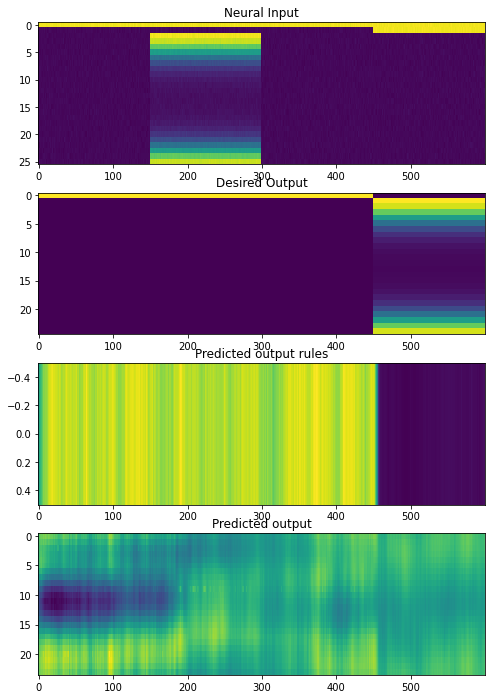

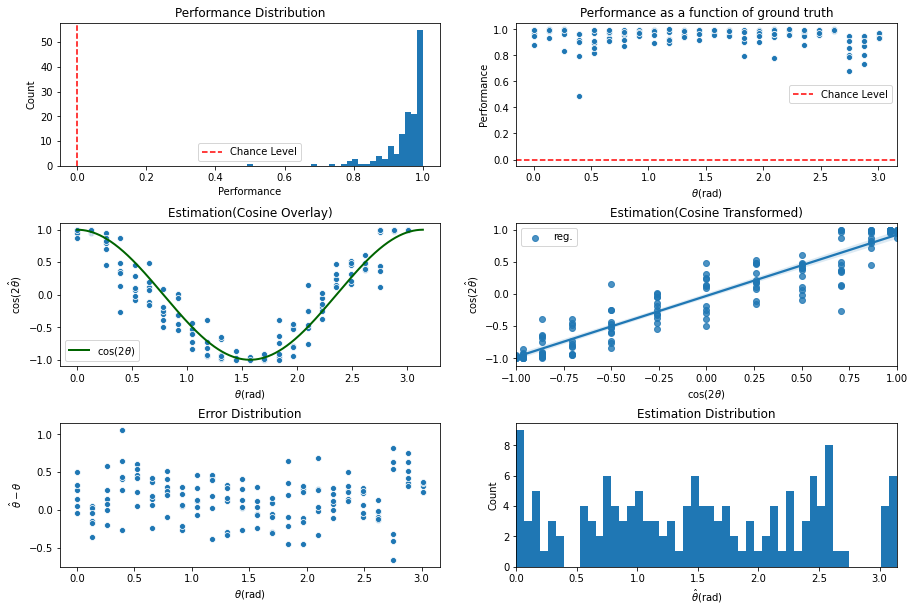

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter7200/assets

 Training performance: 
Iter. 7201 | Performance 0.0134 | Loss 0.2758 | Spike loss 2.9776
Testing performance: 
Iter. 7201 | Performance 0.9456 | Loss 0.2739 | Spike loss 2.9923

 Training performance: 
Iter. 7202 | Performance 0.0489 | Loss 0.2733 | Spike loss 3.1032
Testing performance: 
Iter. 7202 | Performance 0.9537 | Loss 0.2734 | Spike loss 3.0527

 Training performance: 
Iter. 7203 | Performance 0.0421 | Loss 0.2731 | Spike loss 3.0235
Testing performance: 
Iter. 7203 | Performance 0.9441 | Loss 0.2736 | Spike loss 3.0714

 Training performance: 
Iter. 7204 | Performance 0.0157 | Loss 0.2736 | Spike loss 3.0801
Testing performance: 
Iter. 7204 | Performance 0.9323 | Loss 0.2747 | Spike loss 3.0210

 Training performance: 
Iter. 7205 | Performance -0.0146 | Loss 0.2763 | Spike loss 3.1490
Testing performance: 
Iter. 7205 | Performance 0.9405 | Loss 0.2744 | Spike loss 3.0824

 Training pe


 Training performance: 
Iter. 7247 | Performance 0.0260 | Loss 0.2737 | Spike loss 3.1430
Testing performance: 
Iter. 7247 | Performance 0.9538 | Loss 0.2723 | Spike loss 3.1175

 Training performance: 
Iter. 7248 | Performance -0.0828 | Loss 0.2737 | Spike loss 3.3051
Testing performance: 
Iter. 7248 | Performance 0.9583 | Loss 0.2726 | Spike loss 3.1000

 Training performance: 
Iter. 7249 | Performance -0.0667 | Loss 0.2730 | Spike loss 3.1965
Testing performance: 
Iter. 7249 | Performance 0.9499 | Loss 0.2733 | Spike loss 3.1092

 Training performance: 
Iter. 7250 | Performance -0.0122 | Loss 0.2733 | Spike loss 3.1602
Testing performance: 
Iter. 7250 | Performance 0.9516 | Loss 0.2730 | Spike loss 3.1069

 Training performance: 
Iter. 7251 | Performance 0.0956 | Loss 0.2732 | Spike loss 3.3161
Testing performance: 
Iter. 7251 | Performance 0.9533 | Loss 0.2731 | Spike loss 3.1411

 Training performance: 
Iter. 7252 | Performance -0.0440 | Loss 0.2727 | Spike loss 3.0337
Testing pe


 Training performance: 
Iter. 7293 | Performance -0.0199 | Loss 0.2734 | Spike loss 3.0795
Testing performance: 
Iter. 7293 | Performance 0.9427 | Loss 0.2726 | Spike loss 3.0167

 Training performance: 
Iter. 7294 | Performance -0.0413 | Loss 0.2724 | Spike loss 3.0364
Testing performance: 
Iter. 7294 | Performance 0.9472 | Loss 0.2721 | Spike loss 2.9848

 Training performance: 
Iter. 7295 | Performance -0.1369 | Loss 0.2728 | Spike loss 3.0134
Testing performance: 
Iter. 7295 | Performance 0.9488 | Loss 0.2724 | Spike loss 3.0281

 Training performance: 
Iter. 7296 | Performance -0.0117 | Loss 0.2720 | Spike loss 2.9503
Testing performance: 
Iter. 7296 | Performance 0.9356 | Loss 0.2738 | Spike loss 2.9962

 Training performance: 
Iter. 7297 | Performance -0.0234 | Loss 0.2713 | Spike loss 2.9559
Testing performance: 
Iter. 7297 | Performance 0.9548 | Loss 0.2721 | Spike loss 3.0279

 Training performance: 
Iter. 7298 | Performance -0.0564 | Loss 0.2723 | Spike loss 3.0006
Testing 

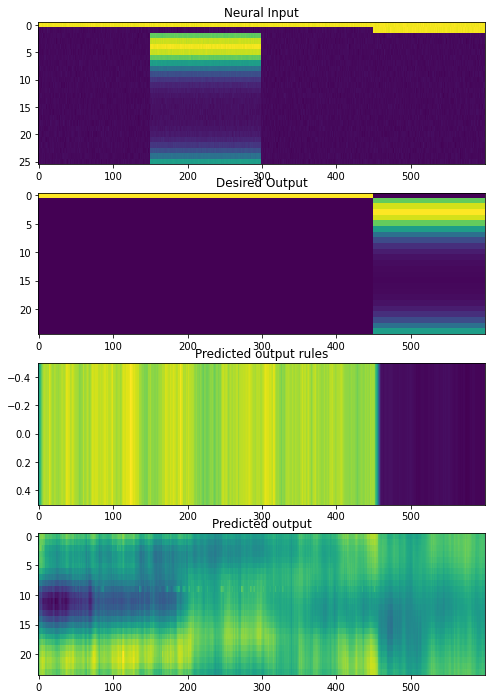

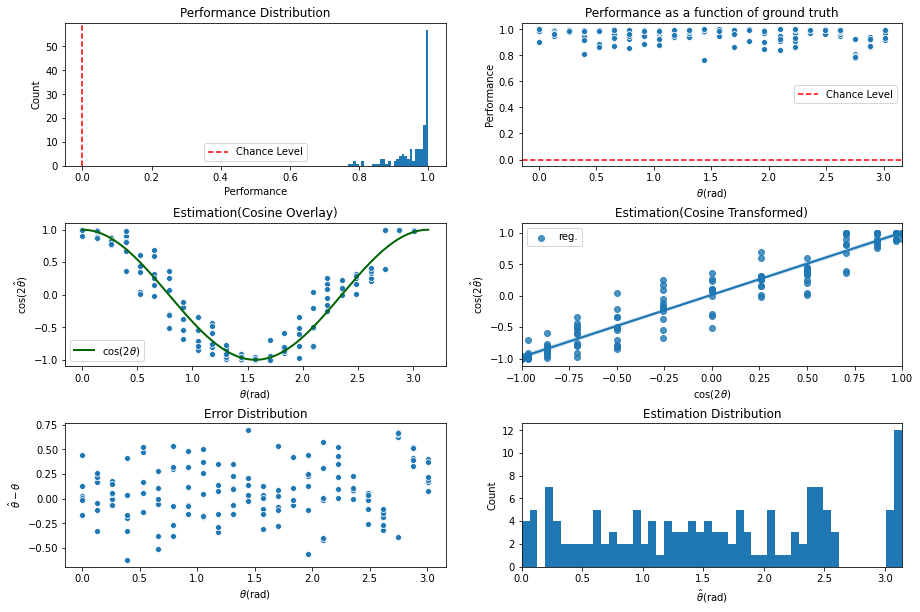

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter7300/assets

 Training performance: 
Iter. 7301 | Performance 0.0227 | Loss 0.2733 | Spike loss 2.9690
Testing performance: 
Iter. 7301 | Performance 0.9579 | Loss 0.2732 | Spike loss 3.1019

 Training performance: 
Iter. 7302 | Performance 0.0021 | Loss 0.2731 | Spike loss 3.2612
Testing performance: 
Iter. 7302 | Performance 0.9587 | Loss 0.2727 | Spike loss 3.0802

 Training performance: 
Iter. 7303 | Performance -0.0186 | Loss 0.2730 | Spike loss 3.1580
Testing performance: 
Iter. 7303 | Performance 0.9556 | Loss 0.2730 | Spike loss 3.1361

 Training performance: 
Iter. 7304 | Performance 0.0631 | Loss 0.2732 | Spike loss 3.1398
Testing performance: 
Iter. 7304 | Performance 0.9537 | Loss 0.2724 | Spike loss 3.1053

 Training performance: 
Iter. 7305 | Performance 0.2071 | Loss 0.2730 | Spike loss 3.1205
Testing performance: 
Iter. 7305 | Performance 0.9529 | Loss 0.2726 | Spike loss 3.1160

 Training pe


 Training performance: 
Iter. 7347 | Performance 0.0655 | Loss 0.2747 | Spike loss 3.3784
Testing performance: 
Iter. 7347 | Performance 0.9154 | Loss 0.2749 | Spike loss 3.3747

 Training performance: 
Iter. 7348 | Performance 0.0381 | Loss 0.2733 | Spike loss 3.2859
Testing performance: 
Iter. 7348 | Performance 0.9237 | Loss 0.2751 | Spike loss 3.4163

 Training performance: 
Iter. 7349 | Performance 0.0128 | Loss 0.2736 | Spike loss 3.4857
Testing performance: 
Iter. 7349 | Performance 0.9324 | Loss 0.2740 | Spike loss 3.3951

 Training performance: 
Iter. 7350 | Performance 0.1227 | Loss 0.2735 | Spike loss 3.4209
Testing performance: 
Iter. 7350 | Performance 0.9383 | Loss 0.2739 | Spike loss 3.4184

 Training performance: 
Iter. 7351 | Performance 0.1086 | Loss 0.2725 | Spike loss 3.3636
Testing performance: 
Iter. 7351 | Performance 0.9481 | Loss 0.2742 | Spike loss 3.3829

 Training performance: 
Iter. 7352 | Performance 0.0249 | Loss 0.2740 | Spike loss 3.3160
Testing perfor


 Training performance: 
Iter. 7393 | Performance -0.0100 | Loss 0.2731 | Spike loss 3.1183
Testing performance: 
Iter. 7393 | Performance 0.9458 | Loss 0.2727 | Spike loss 3.1146

 Training performance: 
Iter. 7394 | Performance -0.0477 | Loss 0.2729 | Spike loss 3.1684
Testing performance: 
Iter. 7394 | Performance 0.9421 | Loss 0.2727 | Spike loss 3.0967

 Training performance: 
Iter. 7395 | Performance -0.0496 | Loss 0.2711 | Spike loss 3.0182
Testing performance: 
Iter. 7395 | Performance 0.9541 | Loss 0.2719 | Spike loss 3.0814

 Training performance: 
Iter. 7396 | Performance -0.0022 | Loss 0.2725 | Spike loss 3.1565
Testing performance: 
Iter. 7396 | Performance 0.9550 | Loss 0.2722 | Spike loss 3.1550

 Training performance: 
Iter. 7397 | Performance -0.1257 | Loss 0.2717 | Spike loss 3.1737
Testing performance: 
Iter. 7397 | Performance 0.9514 | Loss 0.2724 | Spike loss 3.1332

 Training performance: 
Iter. 7398 | Performance 0.0683 | Loss 0.2728 | Spike loss 3.0770
Testing p

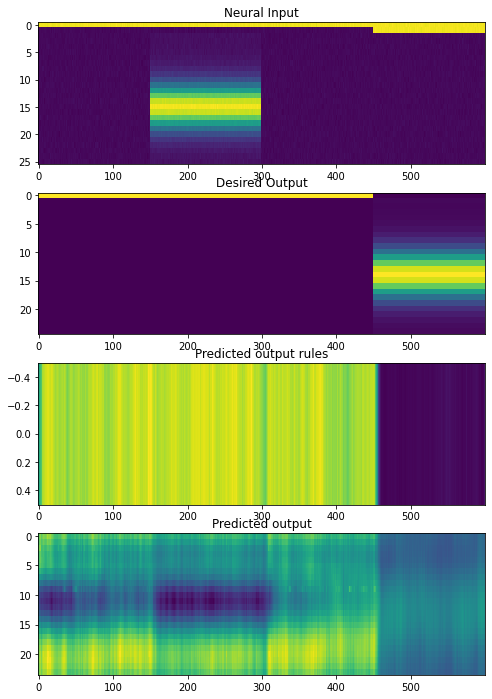

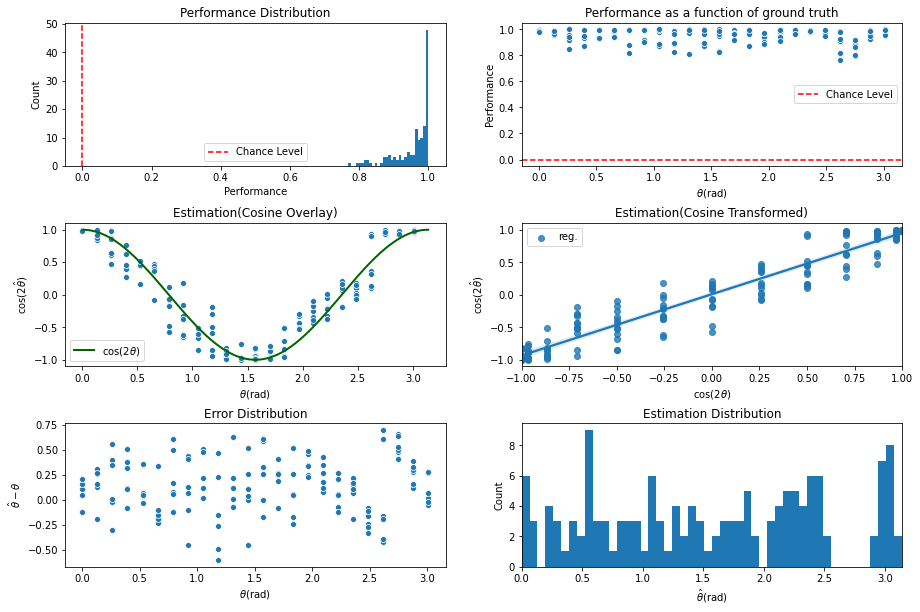

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter7400/assets

 Training performance: 
Iter. 7401 | Performance 0.0511 | Loss 0.2729 | Spike loss 3.2219
Testing performance: 
Iter. 7401 | Performance 0.9547 | Loss 0.2728 | Spike loss 3.1188

 Training performance: 
Iter. 7402 | Performance -0.0062 | Loss 0.2729 | Spike loss 3.0801
Testing performance: 
Iter. 7402 | Performance 0.9535 | Loss 0.2729 | Spike loss 3.1480

 Training performance: 
Iter. 7403 | Performance 0.0433 | Loss 0.2728 | Spike loss 3.2802
Testing performance: 
Iter. 7403 | Performance 0.9453 | Loss 0.2727 | Spike loss 3.1515

 Training performance: 
Iter. 7404 | Performance -0.1110 | Loss 0.2717 | Spike loss 3.0307
Testing performance: 
Iter. 7404 | Performance 0.9400 | Loss 0.2732 | Spike loss 3.1085

 Training performance: 
Iter. 7405 | Performance -0.0566 | Loss 0.2735 | Spike loss 3.2563
Testing performance: 
Iter. 7405 | Performance 0.9469 | Loss 0.2729 | Spike loss 3.1133

 Training 


 Training performance: 
Iter. 7447 | Performance 0.0435 | Loss 0.2722 | Spike loss 3.1080
Testing performance: 
Iter. 7447 | Performance 0.9573 | Loss 0.2724 | Spike loss 3.0573

 Training performance: 
Iter. 7448 | Performance 0.0403 | Loss 0.2719 | Spike loss 3.0467
Testing performance: 
Iter. 7448 | Performance 0.9544 | Loss 0.2721 | Spike loss 3.0765

 Training performance: 
Iter. 7449 | Performance 0.0649 | Loss 0.2725 | Spike loss 3.1003
Testing performance: 
Iter. 7449 | Performance 0.9505 | Loss 0.2716 | Spike loss 3.0582

 Training performance: 
Iter. 7450 | Performance -0.0232 | Loss 0.2711 | Spike loss 2.9211
Testing performance: 
Iter. 7450 | Performance 0.9566 | Loss 0.2710 | Spike loss 3.0323

 Training performance: 
Iter. 7451 | Performance -0.0247 | Loss 0.2717 | Spike loss 3.1352
Testing performance: 
Iter. 7451 | Performance 0.9511 | Loss 0.2721 | Spike loss 3.0301

 Training performance: 
Iter. 7452 | Performance 0.0103 | Loss 0.2723 | Spike loss 3.0318
Testing perf


 Training performance: 
Iter. 7493 | Performance 0.0462 | Loss 0.2722 | Spike loss 3.0339
Testing performance: 
Iter. 7493 | Performance 0.9460 | Loss 0.2723 | Spike loss 2.9761

 Training performance: 
Iter. 7494 | Performance 0.0084 | Loss 0.2721 | Spike loss 3.1121
Testing performance: 
Iter. 7494 | Performance 0.9452 | Loss 0.2721 | Spike loss 3.0029

 Training performance: 
Iter. 7495 | Performance -0.0297 | Loss 0.2717 | Spike loss 3.0290
Testing performance: 
Iter. 7495 | Performance 0.9470 | Loss 0.2717 | Spike loss 3.0148

 Training performance: 
Iter. 7496 | Performance 0.0496 | Loss 0.2716 | Spike loss 2.9340
Testing performance: 
Iter. 7496 | Performance 0.9538 | Loss 0.2715 | Spike loss 3.0072

 Training performance: 
Iter. 7497 | Performance 0.0148 | Loss 0.2722 | Spike loss 3.1047
Testing performance: 
Iter. 7497 | Performance 0.9625 | Loss 0.2720 | Spike loss 3.0458

 Training performance: 
Iter. 7498 | Performance 0.0605 | Loss 0.2714 | Spike loss 3.0059
Testing perfo

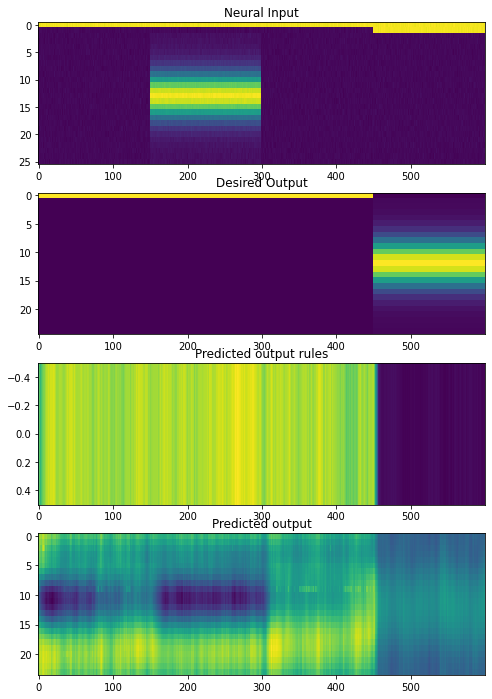

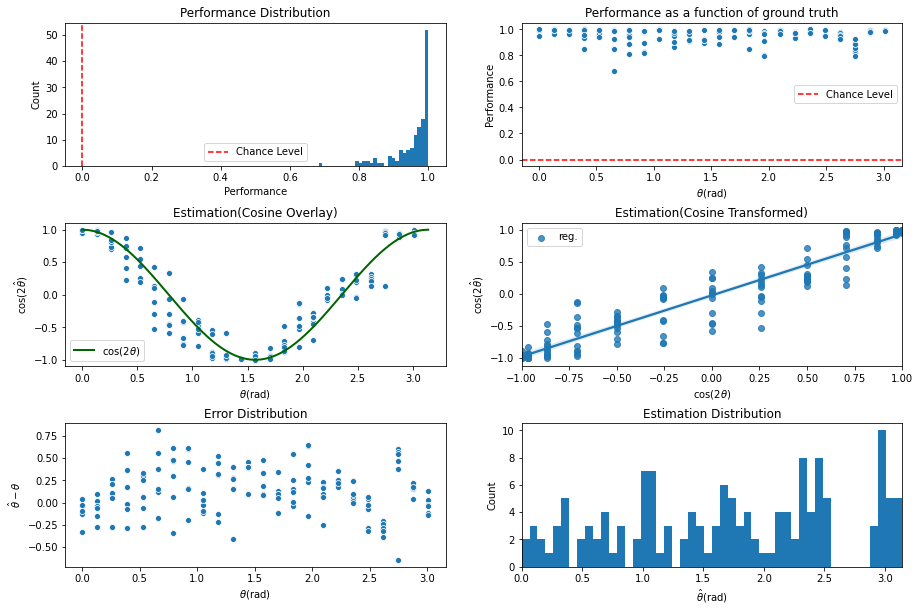

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter7500/assets

 Training performance: 
Iter. 7501 | Performance 0.0007 | Loss 0.2717 | Spike loss 3.0925
Testing performance: 
Iter. 7501 | Performance 0.9517 | Loss 0.2717 | Spike loss 2.9581

 Training performance: 
Iter. 7502 | Performance -0.0163 | Loss 0.2717 | Spike loss 3.1227
Testing performance: 
Iter. 7502 | Performance 0.9433 | Loss 0.2719 | Spike loss 2.9512

 Training performance: 
Iter. 7503 | Performance -0.0367 | Loss 0.2726 | Spike loss 3.0175
Testing performance: 
Iter. 7503 | Performance 0.9393 | Loss 0.2723 | Spike loss 2.9521

 Training performance: 
Iter. 7504 | Performance -0.1025 | Loss 0.2730 | Spike loss 2.9556
Testing performance: 
Iter. 7504 | Performance 0.9421 | Loss 0.2720 | Spike loss 2.9041

 Training performance: 
Iter. 7505 | Performance 0.0134 | Loss 0.2718 | Spike loss 2.9350
Testing performance: 
Iter. 7505 | Performance 0.9296 | Loss 0.2735 | Spike loss 2.9158

 Training 


 Training performance: 
Iter. 7547 | Performance 0.0334 | Loss 0.2719 | Spike loss 2.9951
Testing performance: 
Iter. 7547 | Performance 0.9543 | Loss 0.2717 | Spike loss 2.8929

 Training performance: 
Iter. 7548 | Performance 0.0183 | Loss 0.2715 | Spike loss 3.0097
Testing performance: 
Iter. 7548 | Performance 0.9589 | Loss 0.2716 | Spike loss 2.9144

 Training performance: 
Iter. 7549 | Performance 0.0564 | Loss 0.2715 | Spike loss 2.8144
Testing performance: 
Iter. 7549 | Performance 0.9621 | Loss 0.2725 | Spike loss 2.9552

 Training performance: 
Iter. 7550 | Performance 0.0441 | Loss 0.2722 | Spike loss 2.9311
Testing performance: 
Iter. 7550 | Performance 0.9626 | Loss 0.2725 | Spike loss 2.9642

 Training performance: 
Iter. 7551 | Performance 0.0347 | Loss 0.2711 | Spike loss 2.8199
Testing performance: 
Iter. 7551 | Performance 0.9658 | Loss 0.2713 | Spike loss 2.9660

 Training performance: 
Iter. 7552 | Performance -0.0445 | Loss 0.2720 | Spike loss 2.9012
Testing perfo


 Training performance: 
Iter. 7593 | Performance 0.0442 | Loss 0.2709 | Spike loss 2.8116
Testing performance: 
Iter. 7593 | Performance 0.9565 | Loss 0.2713 | Spike loss 2.8717

 Training performance: 
Iter. 7594 | Performance -0.1879 | Loss 0.2707 | Spike loss 2.8983
Testing performance: 
Iter. 7594 | Performance 0.9554 | Loss 0.2711 | Spike loss 2.9138

 Training performance: 
Iter. 7595 | Performance 0.0103 | Loss 0.2715 | Spike loss 2.9524
Testing performance: 
Iter. 7595 | Performance 0.9528 | Loss 0.2724 | Spike loss 2.9469

 Training performance: 
Iter. 7596 | Performance 0.0313 | Loss 0.2723 | Spike loss 2.9953
Testing performance: 
Iter. 7596 | Performance 0.9469 | Loss 0.2722 | Spike loss 2.9332

 Training performance: 
Iter. 7597 | Performance 0.0592 | Loss 0.2713 | Spike loss 2.8913
Testing performance: 
Iter. 7597 | Performance 0.9521 | Loss 0.2717 | Spike loss 2.9208

 Training performance: 
Iter. 7598 | Performance 0.0174 | Loss 0.2710 | Spike loss 2.9646
Testing perfo

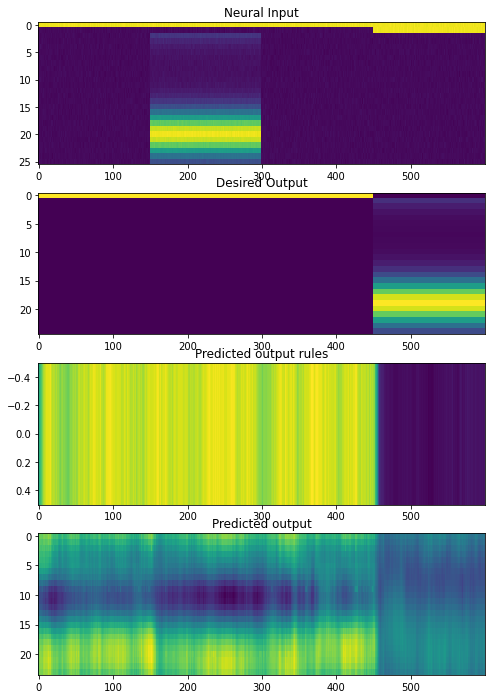

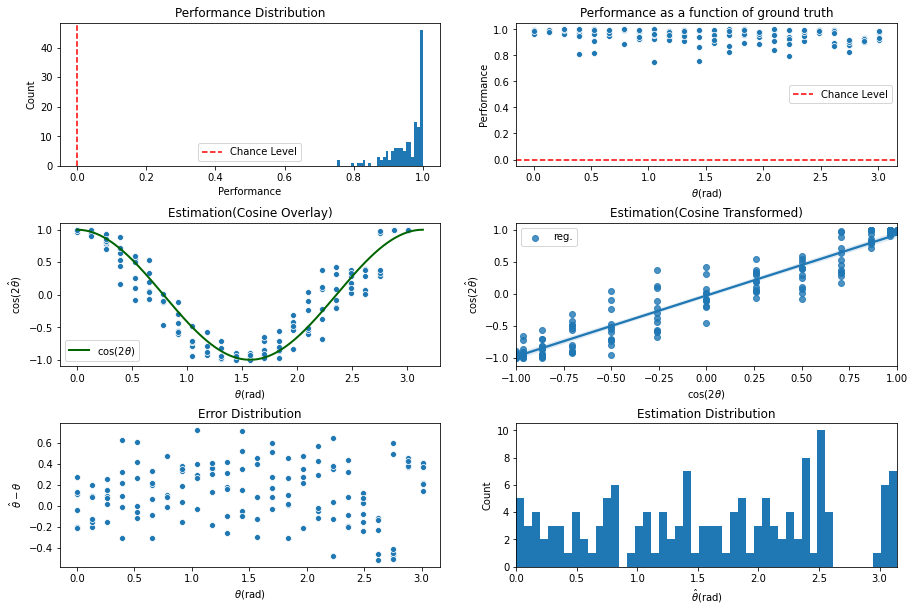

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter7600/assets

 Training performance: 
Iter. 7601 | Performance 0.0518 | Loss 0.2721 | Spike loss 3.0620
Testing performance: 
Iter. 7601 | Performance 0.9483 | Loss 0.2721 | Spike loss 2.9136

 Training performance: 
Iter. 7602 | Performance -0.0141 | Loss 0.2716 | Spike loss 2.9121
Testing performance: 
Iter. 7602 | Performance 0.9571 | Loss 0.2720 | Spike loss 2.9517

 Training performance: 
Iter. 7603 | Performance 0.0266 | Loss 0.2708 | Spike loss 2.8726
Testing performance: 
Iter. 7603 | Performance 0.9572 | Loss 0.2718 | Spike loss 2.9309

 Training performance: 
Iter. 7604 | Performance -0.1226 | Loss 0.2722 | Spike loss 3.0810
Testing performance: 
Iter. 7604 | Performance 0.9477 | Loss 0.2727 | Spike loss 2.8966

 Training performance: 
Iter. 7605 | Performance 0.0037 | Loss 0.2717 | Spike loss 2.9758
Testing performance: 
Iter. 7605 | Performance 0.9470 | Loss 0.2713 | Spike loss 2.9315

 Training p


 Training performance: 
Iter. 7647 | Performance -0.0466 | Loss 0.2717 | Spike loss 2.9706
Testing performance: 
Iter. 7647 | Performance 0.9507 | Loss 0.2711 | Spike loss 2.9174

 Training performance: 
Iter. 7648 | Performance 0.0473 | Loss 0.2707 | Spike loss 2.8838
Testing performance: 
Iter. 7648 | Performance 0.9460 | Loss 0.2709 | Spike loss 2.8957

 Training performance: 
Iter. 7649 | Performance -0.0596 | Loss 0.2708 | Spike loss 2.8310
Testing performance: 
Iter. 7649 | Performance 0.9522 | Loss 0.2724 | Spike loss 2.8990

 Training performance: 
Iter. 7650 | Performance 0.0410 | Loss 0.2714 | Spike loss 3.0219
Testing performance: 
Iter. 7650 | Performance 0.9415 | Loss 0.2729 | Spike loss 2.9076

 Training performance: 
Iter. 7651 | Performance 0.0119 | Loss 0.2721 | Spike loss 3.0149
Testing performance: 
Iter. 7651 | Performance 0.9408 | Loss 0.2718 | Spike loss 2.9282

 Training performance: 
Iter. 7652 | Performance -0.0678 | Loss 0.2717 | Spike loss 2.9546
Testing per


 Training performance: 
Iter. 7693 | Performance -0.0113 | Loss 0.2725 | Spike loss 3.0662
Testing performance: 
Iter. 7693 | Performance 0.9576 | Loss 0.2715 | Spike loss 2.9859

 Training performance: 
Iter. 7694 | Performance -0.0579 | Loss 0.2719 | Spike loss 3.0084
Testing performance: 
Iter. 7694 | Performance 0.9558 | Loss 0.2710 | Spike loss 2.9839

 Training performance: 
Iter. 7695 | Performance -0.0803 | Loss 0.2709 | Spike loss 2.9716
Testing performance: 
Iter. 7695 | Performance 0.9632 | Loss 0.2712 | Spike loss 2.9822

 Training performance: 
Iter. 7696 | Performance -0.0805 | Loss 0.2715 | Spike loss 3.0286
Testing performance: 
Iter. 7696 | Performance 0.9436 | Loss 0.2720 | Spike loss 2.9454

 Training performance: 
Iter. 7697 | Performance 0.0353 | Loss 0.2719 | Spike loss 3.0127
Testing performance: 
Iter. 7697 | Performance 0.9305 | Loss 0.2722 | Spike loss 2.9176

 Training performance: 
Iter. 7698 | Performance -0.1067 | Loss 0.2714 | Spike loss 3.0707
Testing p

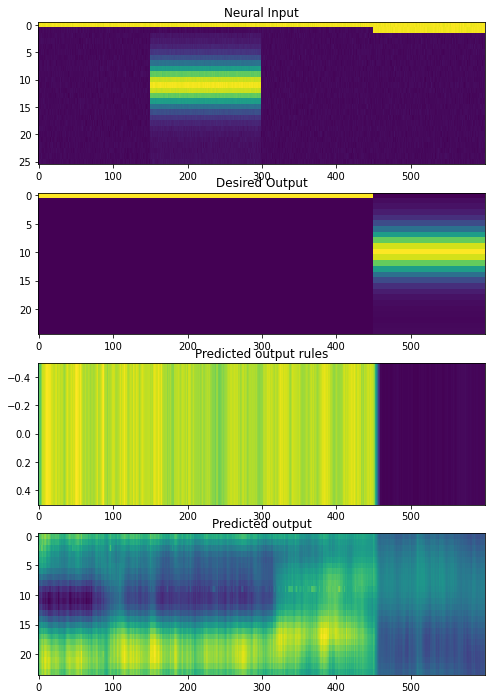

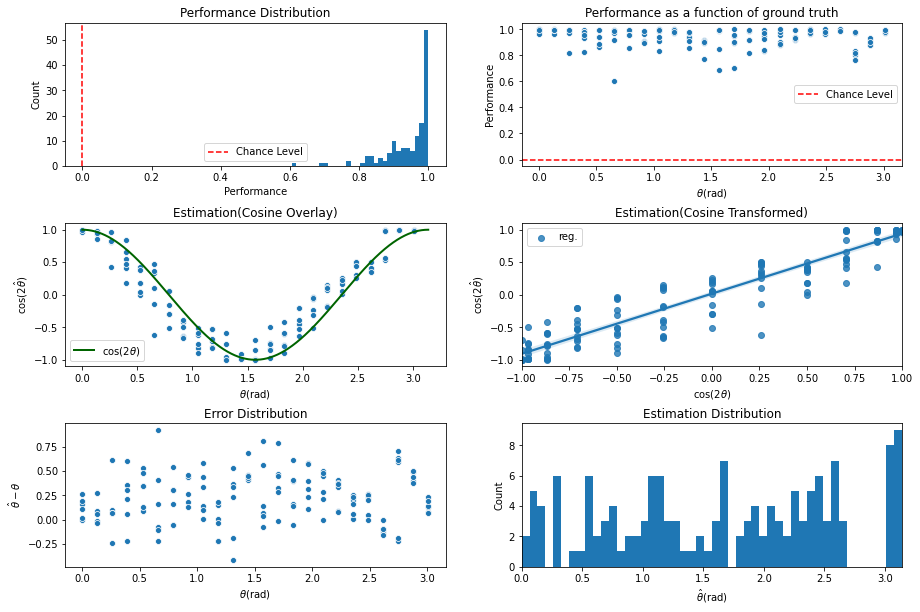

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter7700/assets

 Training performance: 
Iter. 7701 | Performance -0.0947 | Loss 0.2718 | Spike loss 2.9730
Testing performance: 
Iter. 7701 | Performance 0.9419 | Loss 0.2721 | Spike loss 2.9242

 Training performance: 
Iter. 7702 | Performance 0.0354 | Loss 0.2721 | Spike loss 3.0194
Testing performance: 
Iter. 7702 | Performance 0.9329 | Loss 0.2727 | Spike loss 2.8863

 Training performance: 
Iter. 7703 | Performance -0.0541 | Loss 0.2721 | Spike loss 3.0251
Testing performance: 
Iter. 7703 | Performance 0.9511 | Loss 0.2712 | Spike loss 2.9213

 Training performance: 
Iter. 7704 | Performance 0.0139 | Loss 0.2712 | Spike loss 3.0403
Testing performance: 
Iter. 7704 | Performance 0.9485 | Loss 0.2713 | Spike loss 2.9034

 Training performance: 
Iter. 7705 | Performance 0.0398 | Loss 0.2713 | Spike loss 2.9676
Testing performance: 
Iter. 7705 | Performance 0.9654 | Loss 0.2713 | Spike loss 2.9195

 Training p


 Training performance: 
Iter. 7747 | Performance 0.0654 | Loss 0.2714 | Spike loss 2.8937
Testing performance: 
Iter. 7747 | Performance 0.9551 | Loss 0.2704 | Spike loss 2.7956

 Training performance: 
Iter. 7748 | Performance -0.1154 | Loss 0.2699 | Spike loss 2.7564
Testing performance: 
Iter. 7748 | Performance 0.9547 | Loss 0.2703 | Spike loss 2.8151

 Training performance: 
Iter. 7749 | Performance 0.0343 | Loss 0.2712 | Spike loss 2.9875
Testing performance: 
Iter. 7749 | Performance 0.9594 | Loss 0.2705 | Spike loss 2.8388

 Training performance: 
Iter. 7750 | Performance -0.0389 | Loss 0.2707 | Spike loss 2.9137
Testing performance: 
Iter. 7750 | Performance 0.9494 | Loss 0.2709 | Spike loss 2.7704

 Training performance: 
Iter. 7751 | Performance -0.0289 | Loss 0.2709 | Spike loss 2.7819
Testing performance: 
Iter. 7751 | Performance 0.9535 | Loss 0.2709 | Spike loss 2.8005

 Training performance: 
Iter. 7752 | Performance 0.0791 | Loss 0.2701 | Spike loss 2.8039
Testing per


 Training performance: 
Iter. 7793 | Performance -0.0012 | Loss 0.2705 | Spike loss 2.8562
Testing performance: 
Iter. 7793 | Performance 0.9498 | Loss 0.2711 | Spike loss 2.8242

 Training performance: 
Iter. 7794 | Performance 0.0289 | Loss 0.2708 | Spike loss 2.8317
Testing performance: 
Iter. 7794 | Performance 0.9541 | Loss 0.2706 | Spike loss 2.8548

 Training performance: 
Iter. 7795 | Performance 0.0027 | Loss 0.2708 | Spike loss 3.0407
Testing performance: 
Iter. 7795 | Performance 0.9555 | Loss 0.2706 | Spike loss 2.7997

 Training performance: 
Iter. 7796 | Performance 0.0533 | Loss 0.2698 | Spike loss 2.7938
Testing performance: 
Iter. 7796 | Performance 0.9655 | Loss 0.2698 | Spike loss 2.8302

 Training performance: 
Iter. 7797 | Performance -0.0212 | Loss 0.2712 | Spike loss 2.9225
Testing performance: 
Iter. 7797 | Performance 0.9565 | Loss 0.2713 | Spike loss 2.8219

 Training performance: 
Iter. 7798 | Performance 0.0214 | Loss 0.2703 | Spike loss 2.7895
Testing perf

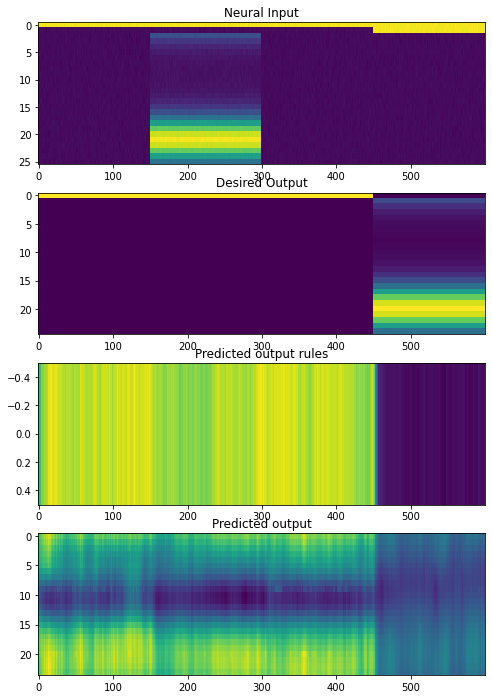

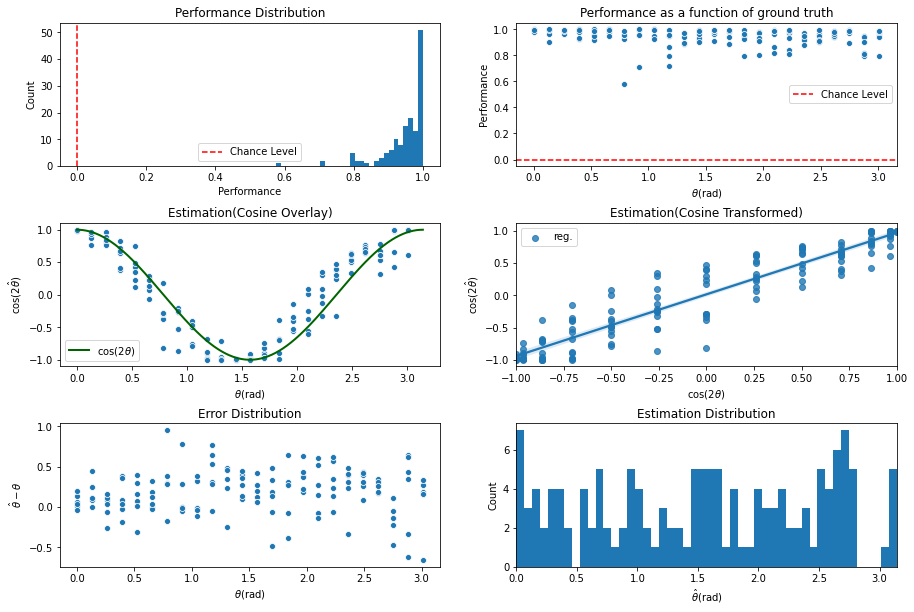

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter7800/assets

 Training performance: 
Iter. 7801 | Performance -0.0507 | Loss 0.2709 | Spike loss 2.8081
Testing performance: 
Iter. 7801 | Performance 0.9507 | Loss 0.2711 | Spike loss 2.7914

 Training performance: 
Iter. 7802 | Performance -0.0100 | Loss 0.2727 | Spike loss 2.7371
Testing performance: 
Iter. 7802 | Performance 0.9383 | Loss 0.2713 | Spike loss 2.7564

 Training performance: 
Iter. 7803 | Performance -0.0815 | Loss 0.2705 | Spike loss 2.7897
Testing performance: 
Iter. 7803 | Performance 0.9425 | Loss 0.2719 | Spike loss 2.7421

 Training performance: 
Iter. 7804 | Performance -0.0022 | Loss 0.2716 | Spike loss 2.7064
Testing performance: 
Iter. 7804 | Performance 0.9332 | Loss 0.2736 | Spike loss 2.7526

 Training performance: 
Iter. 7805 | Performance 0.0476 | Loss 0.2746 | Spike loss 2.8810
Testing performance: 
Iter. 7805 | Performance 0.9461 | Loss 0.2719 | Spike loss 2.7517

 Training


 Training performance: 
Iter. 7847 | Performance -0.0536 | Loss 0.2747 | Spike loss 2.5015
Testing performance: 
Iter. 7847 | Performance 0.9411 | Loss 0.2773 | Spike loss 2.6247

 Training performance: 
Iter. 7848 | Performance -0.0055 | Loss 0.2798 | Spike loss 2.5701
Testing performance: 
Iter. 7848 | Performance 0.9238 | Loss 0.2775 | Spike loss 2.6632

 Training performance: 
Iter. 7849 | Performance 0.0234 | Loss 0.2792 | Spike loss 2.5919
Testing performance: 
Iter. 7849 | Performance 0.9329 | Loss 0.2742 | Spike loss 2.5998

 Training performance: 
Iter. 7850 | Performance 0.0075 | Loss 0.2752 | Spike loss 2.6281
Testing performance: 
Iter. 7850 | Performance 0.9377 | Loss 0.2759 | Spike loss 2.6103

 Training performance: 
Iter. 7851 | Performance -0.2066 | Loss 0.2753 | Spike loss 2.6491
Testing performance: 
Iter. 7851 | Performance 0.9403 | Loss 0.2746 | Spike loss 2.6242

 Training performance: 
Iter. 7852 | Performance -0.0109 | Loss 0.2735 | Spike loss 2.5860
Testing pe


 Training performance: 
Iter. 7893 | Performance -0.0160 | Loss 0.2701 | Spike loss 2.7754
Testing performance: 
Iter. 7893 | Performance 0.9651 | Loss 0.2690 | Spike loss 2.7392

 Training performance: 
Iter. 7894 | Performance 0.0548 | Loss 0.2691 | Spike loss 2.6415
Testing performance: 
Iter. 7894 | Performance 0.9590 | Loss 0.2710 | Spike loss 2.6920

 Training performance: 
Iter. 7895 | Performance -0.0160 | Loss 0.2718 | Spike loss 2.7624
Testing performance: 
Iter. 7895 | Performance 0.9614 | Loss 0.2698 | Spike loss 2.7077

 Training performance: 
Iter. 7896 | Performance 0.0828 | Loss 0.2708 | Spike loss 2.6646
Testing performance: 
Iter. 7896 | Performance 0.9566 | Loss 0.2703 | Spike loss 2.6877

 Training performance: 
Iter. 7897 | Performance -0.0089 | Loss 0.2699 | Spike loss 2.6486
Testing performance: 
Iter. 7897 | Performance 0.9553 | Loss 0.2709 | Spike loss 2.7104

 Training performance: 
Iter. 7898 | Performance -0.0539 | Loss 0.2710 | Spike loss 2.6586
Testing pe

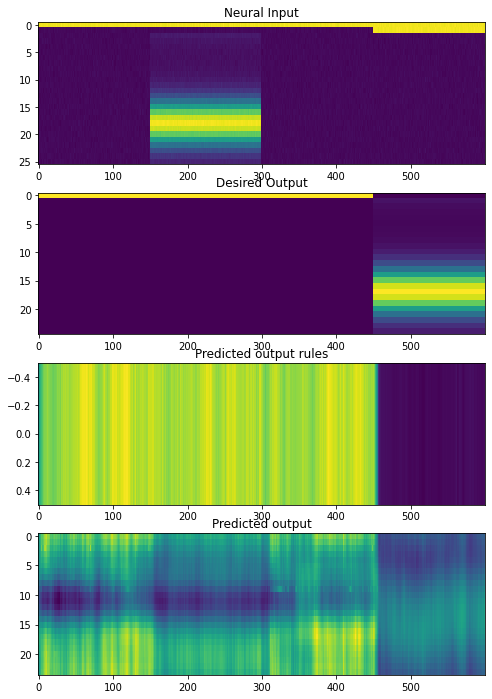

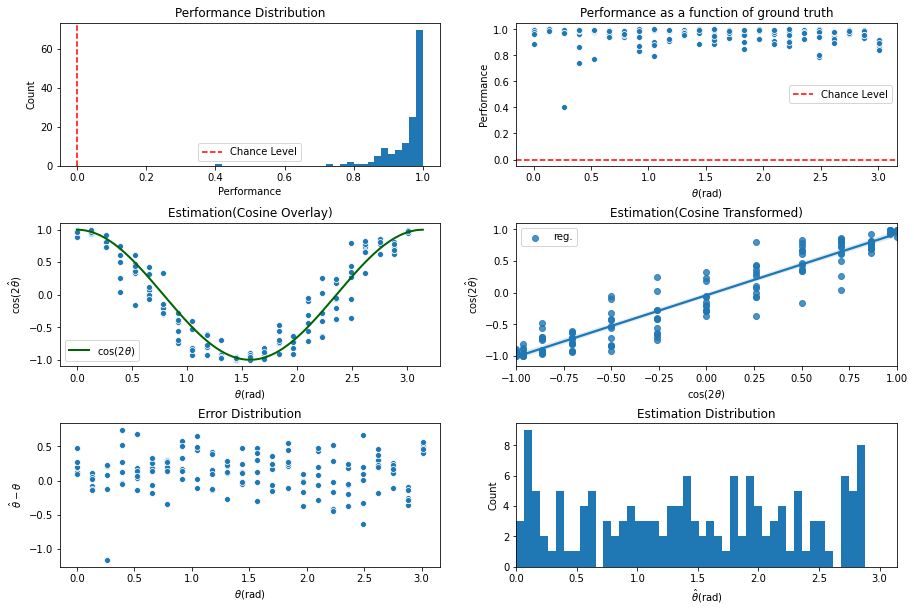

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter7900/assets

 Training performance: 
Iter. 7901 | Performance 0.0047 | Loss 0.2696 | Spike loss 2.7712
Testing performance: 
Iter. 7901 | Performance 0.9495 | Loss 0.2705 | Spike loss 2.7048

 Training performance: 
Iter. 7902 | Performance -0.0162 | Loss 0.2692 | Spike loss 2.7111
Testing performance: 
Iter. 7902 | Performance 0.9609 | Loss 0.2697 | Spike loss 2.6887

 Training performance: 
Iter. 7903 | Performance -0.0334 | Loss 0.2695 | Spike loss 2.6356
Testing performance: 
Iter. 7903 | Performance 0.9601 | Loss 0.2696 | Spike loss 2.7001

 Training performance: 
Iter. 7904 | Performance -0.0464 | Loss 0.2706 | Spike loss 2.7071
Testing performance: 
Iter. 7904 | Performance 0.9637 | Loss 0.2693 | Spike loss 2.6928

 Training performance: 
Iter. 7905 | Performance -0.0392 | Loss 0.2696 | Spike loss 2.8405
Testing performance: 
Iter. 7905 | Performance 0.9612 | Loss 0.2692 | Spike loss 2.6748

 Training


 Training performance: 
Iter. 7947 | Performance 0.0943 | Loss 0.2758 | Spike loss 2.5741
Testing performance: 
Iter. 7947 | Performance 0.9132 | Loss 0.2746 | Spike loss 2.5583

 Training performance: 
Iter. 7948 | Performance -0.1169 | Loss 0.2747 | Spike loss 2.5531
Testing performance: 
Iter. 7948 | Performance 0.9283 | Loss 0.2744 | Spike loss 2.5460

 Training performance: 
Iter. 7949 | Performance 0.0615 | Loss 0.2731 | Spike loss 2.5662
Testing performance: 
Iter. 7949 | Performance 0.9197 | Loss 0.2747 | Spike loss 2.5766

 Training performance: 
Iter. 7950 | Performance 0.1249 | Loss 0.2735 | Spike loss 2.5486
Testing performance: 
Iter. 7950 | Performance 0.9483 | Loss 0.2736 | Spike loss 2.5707

 Training performance: 
Iter. 7951 | Performance -0.0165 | Loss 0.2740 | Spike loss 2.5272
Testing performance: 
Iter. 7951 | Performance 0.9416 | Loss 0.2741 | Spike loss 2.5945

 Training performance: 
Iter. 7952 | Performance -0.0111 | Loss 0.2752 | Spike loss 2.6027
Testing per


 Training performance: 
Iter. 7993 | Performance -0.0089 | Loss 0.2717 | Spike loss 2.8423
Testing performance: 
Iter. 7993 | Performance 0.9493 | Loss 0.2708 | Spike loss 2.7905

 Training performance: 
Iter. 7994 | Performance 0.1142 | Loss 0.2716 | Spike loss 2.8318
Testing performance: 
Iter. 7994 | Performance 0.9587 | Loss 0.2705 | Spike loss 2.8404

 Training performance: 
Iter. 7995 | Performance 0.0388 | Loss 0.2706 | Spike loss 2.7020
Testing performance: 
Iter. 7995 | Performance 0.9576 | Loss 0.2703 | Spike loss 2.7952

 Training performance: 
Iter. 7996 | Performance -0.0826 | Loss 0.2695 | Spike loss 2.8625
Testing performance: 
Iter. 7996 | Performance 0.9618 | Loss 0.2705 | Spike loss 2.8244

 Training performance: 
Iter. 7997 | Performance -0.0770 | Loss 0.2717 | Spike loss 2.8972
Testing performance: 
Iter. 7997 | Performance 0.9536 | Loss 0.2713 | Spike loss 2.8565

 Training performance: 
Iter. 7998 | Performance -0.0701 | Loss 0.2705 | Spike loss 2.9400
Testing pe

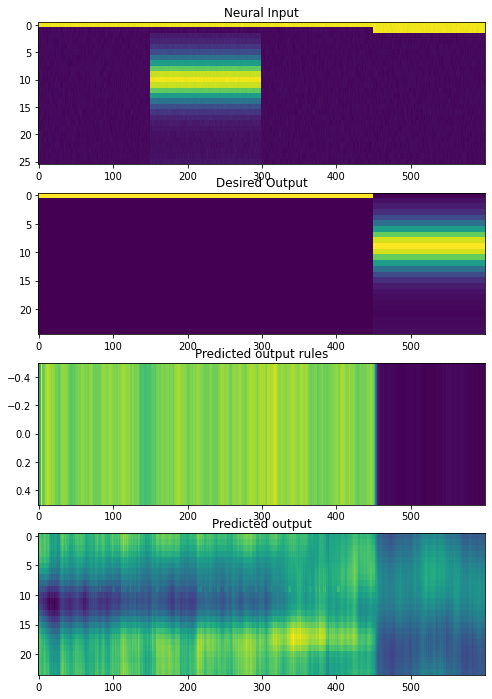

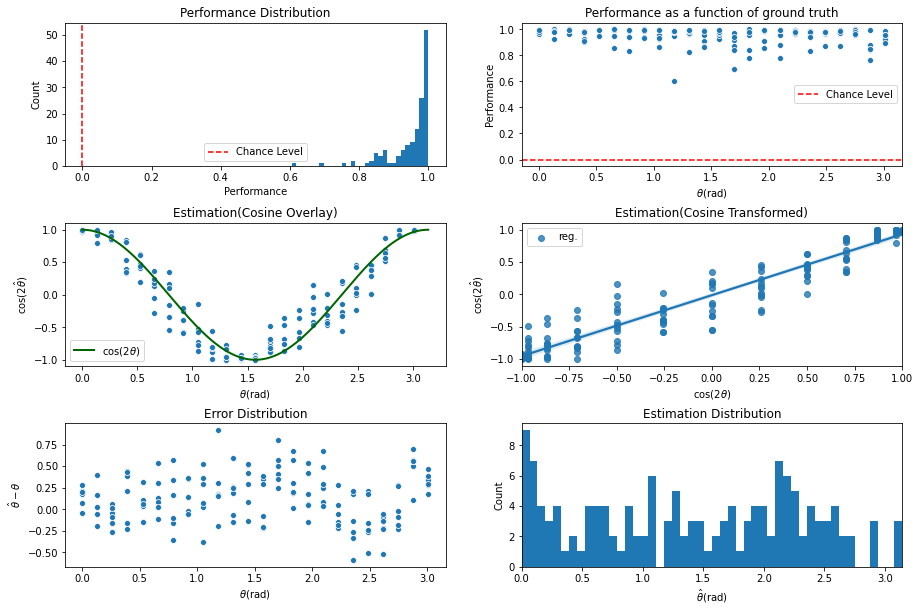

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter8000/assets

 Training performance: 
Iter. 8001 | Performance 0.0639 | Loss 0.2705 | Spike loss 2.7653
Testing performance: 
Iter. 8001 | Performance 0.9581 | Loss 0.2701 | Spike loss 2.8040

 Training performance: 
Iter. 8002 | Performance -0.0066 | Loss 0.2706 | Spike loss 3.0057
Testing performance: 
Iter. 8002 | Performance 0.9519 | Loss 0.2709 | Spike loss 2.8521

 Training performance: 
Iter. 8003 | Performance -0.0897 | Loss 0.2703 | Spike loss 2.8159
Testing performance: 
Iter. 8003 | Performance 0.9564 | Loss 0.2705 | Spike loss 2.8233

 Training performance: 
Iter. 8004 | Performance 0.0912 | Loss 0.2697 | Spike loss 2.8562
Testing performance: 
Iter. 8004 | Performance 0.9531 | Loss 0.2703 | Spike loss 2.8775

 Training performance: 
Iter. 8005 | Performance -0.0871 | Loss 0.2710 | Spike loss 2.9458
Testing performance: 
Iter. 8005 | Performance 0.9583 | Loss 0.2702 | Spike loss 2.8649

 Training 


 Training performance: 
Iter. 8047 | Performance 0.0224 | Loss 0.2693 | Spike loss 2.7853
Testing performance: 
Iter. 8047 | Performance 0.9531 | Loss 0.2702 | Spike loss 2.8382

 Training performance: 
Iter. 8048 | Performance 0.0054 | Loss 0.2696 | Spike loss 2.9272
Testing performance: 
Iter. 8048 | Performance 0.9501 | Loss 0.2709 | Spike loss 2.8268

 Training performance: 
Iter. 8049 | Performance -0.0050 | Loss 0.2701 | Spike loss 2.8977
Testing performance: 
Iter. 8049 | Performance 0.9573 | Loss 0.2695 | Spike loss 2.8480

 Training performance: 
Iter. 8050 | Performance -0.0067 | Loss 0.2696 | Spike loss 2.9107
Testing performance: 
Iter. 8050 | Performance 0.9541 | Loss 0.2703 | Spike loss 2.8652

 Training performance: 
Iter. 8051 | Performance 0.0375 | Loss 0.2702 | Spike loss 2.8415
Testing performance: 
Iter. 8051 | Performance 0.9650 | Loss 0.2691 | Spike loss 2.8416

 Training performance: 
Iter. 8052 | Performance 0.0644 | Loss 0.2700 | Spike loss 2.9832
Testing perf


 Training performance: 
Iter. 8093 | Performance -0.0158 | Loss 0.2693 | Spike loss 2.8860
Testing performance: 
Iter. 8093 | Performance 0.9634 | Loss 0.2697 | Spike loss 2.8583

 Training performance: 
Iter. 8094 | Performance 0.0610 | Loss 0.2707 | Spike loss 3.0879
Testing performance: 
Iter. 8094 | Performance 0.9644 | Loss 0.2698 | Spike loss 2.8854

 Training performance: 
Iter. 8095 | Performance -0.0910 | Loss 0.2695 | Spike loss 2.9714
Testing performance: 
Iter. 8095 | Performance 0.9627 | Loss 0.2702 | Spike loss 2.8673

 Training performance: 
Iter. 8096 | Performance -0.0107 | Loss 0.2696 | Spike loss 3.0097
Testing performance: 
Iter. 8096 | Performance 0.9596 | Loss 0.2701 | Spike loss 2.8744

 Training performance: 
Iter. 8097 | Performance 0.0549 | Loss 0.2701 | Spike loss 2.9045
Testing performance: 
Iter. 8097 | Performance 0.9641 | Loss 0.2694 | Spike loss 2.8947

 Training performance: 
Iter. 8098 | Performance -0.0314 | Loss 0.2688 | Spike loss 2.8213
Testing pe

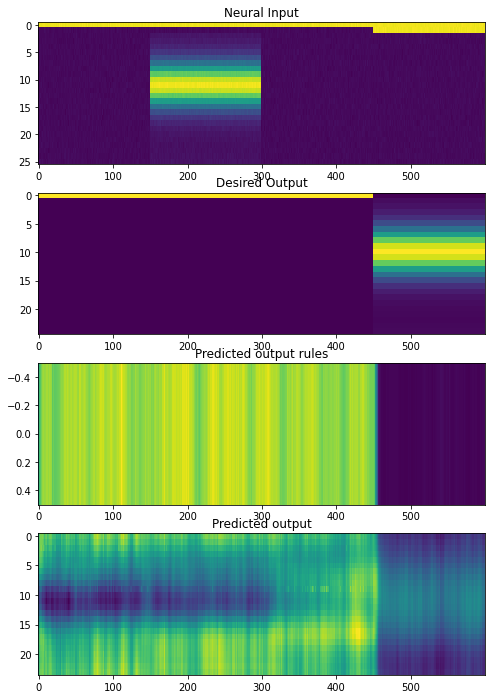

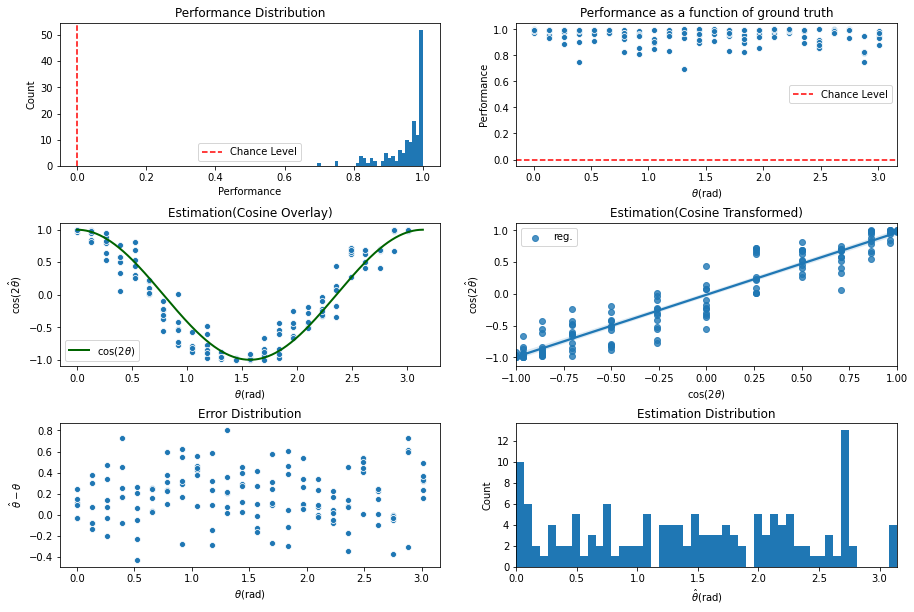

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter8100/assets

 Training performance: 
Iter. 8101 | Performance -0.0223 | Loss 0.2698 | Spike loss 2.7644
Testing performance: 
Iter. 8101 | Performance 0.9565 | Loss 0.2694 | Spike loss 2.8588

 Training performance: 
Iter. 8102 | Performance 0.0078 | Loss 0.2705 | Spike loss 3.0723
Testing performance: 
Iter. 8102 | Performance 0.9520 | Loss 0.2698 | Spike loss 2.8403

 Training performance: 
Iter. 8103 | Performance 0.1490 | Loss 0.2693 | Spike loss 2.8297
Testing performance: 
Iter. 8103 | Performance 0.9562 | Loss 0.2698 | Spike loss 2.8406

 Training performance: 
Iter. 8104 | Performance 0.0499 | Loss 0.2700 | Spike loss 2.8590
Testing performance: 
Iter. 8104 | Performance 0.9604 | Loss 0.2693 | Spike loss 2.8310

 Training performance: 
Iter. 8105 | Performance -0.0275 | Loss 0.2703 | Spike loss 2.6784
Testing performance: 
Iter. 8105 | Performance 0.9588 | Loss 0.2693 | Spike loss 2.8359

 Training p


 Training performance: 
Iter. 8147 | Performance 0.0456 | Loss 0.2693 | Spike loss 2.8123
Testing performance: 
Iter. 8147 | Performance 0.9574 | Loss 0.2690 | Spike loss 2.7105

 Training performance: 
Iter. 8148 | Performance -0.0698 | Loss 0.2686 | Spike loss 2.6992
Testing performance: 
Iter. 8148 | Performance 0.9569 | Loss 0.2697 | Spike loss 2.7546

 Training performance: 
Iter. 8149 | Performance 0.0330 | Loss 0.2689 | Spike loss 2.7596
Testing performance: 
Iter. 8149 | Performance 0.9588 | Loss 0.2696 | Spike loss 2.7503

 Training performance: 
Iter. 8150 | Performance 0.0127 | Loss 0.2696 | Spike loss 2.7357
Testing performance: 
Iter. 8150 | Performance 0.9601 | Loss 0.2693 | Spike loss 2.7572

 Training performance: 
Iter. 8151 | Performance 0.0848 | Loss 0.2692 | Spike loss 2.7484
Testing performance: 
Iter. 8151 | Performance 0.9617 | Loss 0.2691 | Spike loss 2.7610

 Training performance: 
Iter. 8152 | Performance -0.0814 | Loss 0.2690 | Spike loss 2.5937
Testing perf


 Training performance: 
Iter. 8193 | Performance 0.0005 | Loss 0.2692 | Spike loss 2.8954
Testing performance: 
Iter. 8193 | Performance 0.9569 | Loss 0.2691 | Spike loss 2.8364

 Training performance: 
Iter. 8194 | Performance 0.0227 | Loss 0.2682 | Spike loss 2.7237
Testing performance: 
Iter. 8194 | Performance 0.9623 | Loss 0.2694 | Spike loss 2.8195

 Training performance: 
Iter. 8195 | Performance -0.0742 | Loss 0.2703 | Spike loss 2.8366
Testing performance: 
Iter. 8195 | Performance 0.9633 | Loss 0.2694 | Spike loss 2.8554

 Training performance: 
Iter. 8196 | Performance 0.0185 | Loss 0.2698 | Spike loss 2.9166
Testing performance: 
Iter. 8196 | Performance 0.9620 | Loss 0.2693 | Spike loss 2.8375

 Training performance: 
Iter. 8197 | Performance 0.0367 | Loss 0.2691 | Spike loss 2.8395
Testing performance: 
Iter. 8197 | Performance 0.9676 | Loss 0.2692 | Spike loss 2.8472

 Training performance: 
Iter. 8198 | Performance -0.0262 | Loss 0.2686 | Spike loss 2.7159
Testing perf

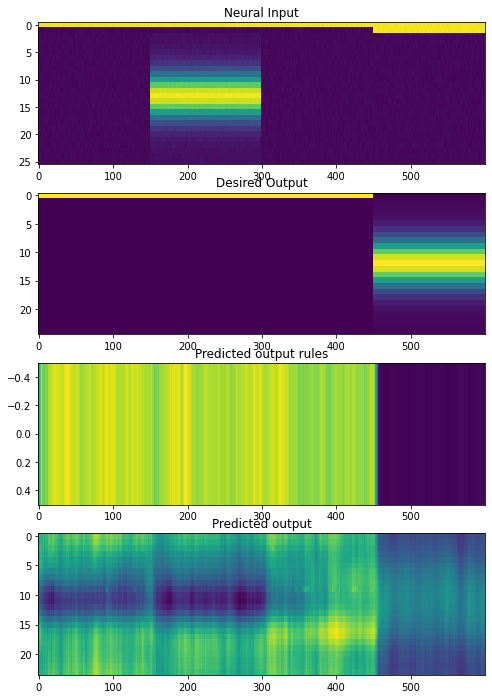

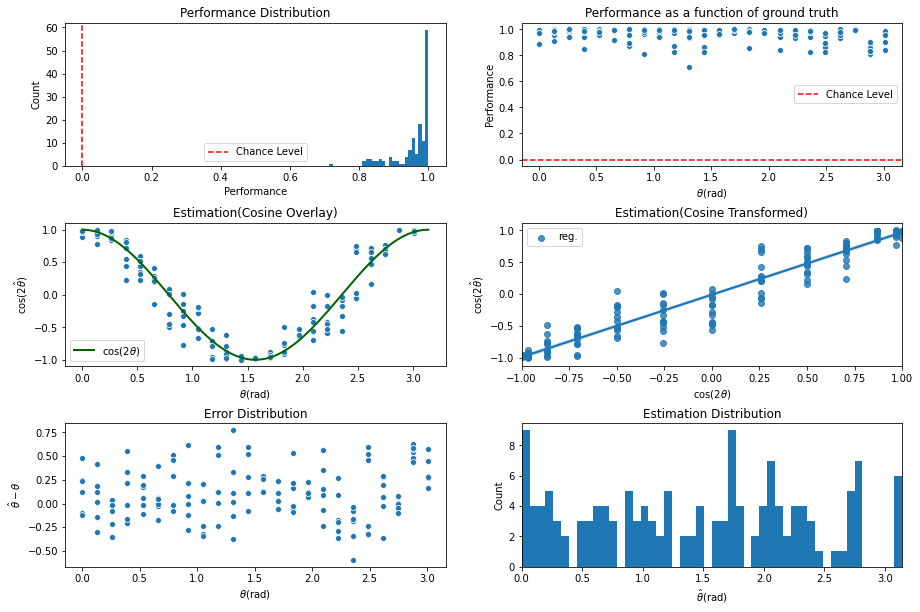

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter8200/assets

 Training performance: 
Iter. 8201 | Performance 0.0376 | Loss 0.2692 | Spike loss 2.8960
Testing performance: 
Iter. 8201 | Performance 0.9653 | Loss 0.2695 | Spike loss 2.8372

 Training performance: 
Iter. 8202 | Performance -0.0432 | Loss 0.2699 | Spike loss 2.8122
Testing performance: 
Iter. 8202 | Performance 0.9562 | Loss 0.2693 | Spike loss 2.8430

 Training performance: 
Iter. 8203 | Performance 0.0453 | Loss 0.2696 | Spike loss 2.8586
Testing performance: 
Iter. 8203 | Performance 0.9615 | Loss 0.2690 | Spike loss 2.8436

 Training performance: 
Iter. 8204 | Performance 0.0765 | Loss 0.2695 | Spike loss 2.9046
Testing performance: 
Iter. 8204 | Performance 0.9556 | Loss 0.2701 | Spike loss 2.8221

 Training performance: 
Iter. 8205 | Performance -0.0500 | Loss 0.2696 | Spike loss 2.9222
Testing performance: 
Iter. 8205 | Performance 0.9616 | Loss 0.2694 | Spike loss 2.8543

 Training p


 Training performance: 
Iter. 8247 | Performance 0.0379 | Loss 0.2694 | Spike loss 2.8255
Testing performance: 
Iter. 8247 | Performance 0.9637 | Loss 0.2683 | Spike loss 2.8089

 Training performance: 
Iter. 8248 | Performance 0.0703 | Loss 0.2703 | Spike loss 2.9477
Testing performance: 
Iter. 8248 | Performance 0.9580 | Loss 0.2696 | Spike loss 2.8251

 Training performance: 
Iter. 8249 | Performance 0.0872 | Loss 0.2697 | Spike loss 2.8134
Testing performance: 
Iter. 8249 | Performance 0.9560 | Loss 0.2699 | Spike loss 2.8422

 Training performance: 
Iter. 8250 | Performance 0.1075 | Loss 0.2688 | Spike loss 2.8138
Testing performance: 
Iter. 8250 | Performance 0.9605 | Loss 0.2687 | Spike loss 2.8229

 Training performance: 
Iter. 8251 | Performance -0.0515 | Loss 0.2692 | Spike loss 2.7762
Testing performance: 
Iter. 8251 | Performance 0.9541 | Loss 0.2697 | Spike loss 2.8280

 Training performance: 
Iter. 8252 | Performance 0.0090 | Loss 0.2688 | Spike loss 2.9239
Testing perfo


 Training performance: 
Iter. 8293 | Performance 0.0966 | Loss 0.2695 | Spike loss 2.8396
Testing performance: 
Iter. 8293 | Performance 0.9619 | Loss 0.2688 | Spike loss 2.7843

 Training performance: 
Iter. 8294 | Performance 0.0441 | Loss 0.2699 | Spike loss 2.8623
Testing performance: 
Iter. 8294 | Performance 0.9589 | Loss 0.2690 | Spike loss 2.7954

 Training performance: 
Iter. 8295 | Performance 0.0894 | Loss 0.2690 | Spike loss 2.8062
Testing performance: 
Iter. 8295 | Performance 0.9495 | Loss 0.2696 | Spike loss 2.7868

 Training performance: 
Iter. 8296 | Performance 0.1620 | Loss 0.2683 | Spike loss 2.7368
Testing performance: 
Iter. 8296 | Performance 0.9583 | Loss 0.2696 | Spike loss 2.7568

 Training performance: 
Iter. 8297 | Performance -0.0738 | Loss 0.2694 | Spike loss 2.7861
Testing performance: 
Iter. 8297 | Performance 0.9578 | Loss 0.2697 | Spike loss 2.7864

 Training performance: 
Iter. 8298 | Performance -0.0666 | Loss 0.2696 | Spike loss 2.7940
Testing perf

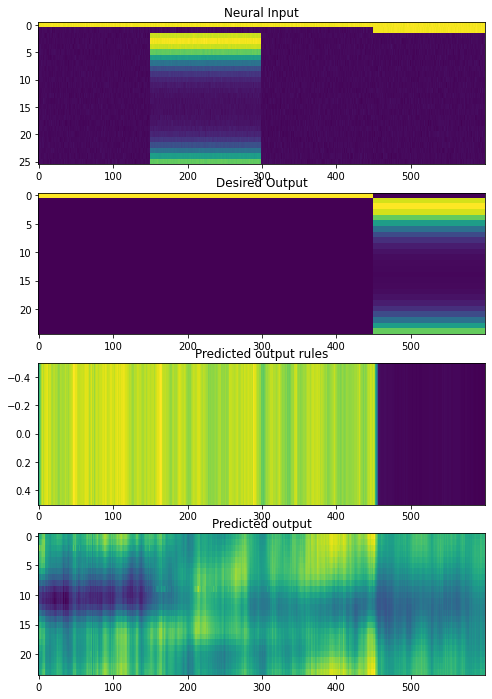

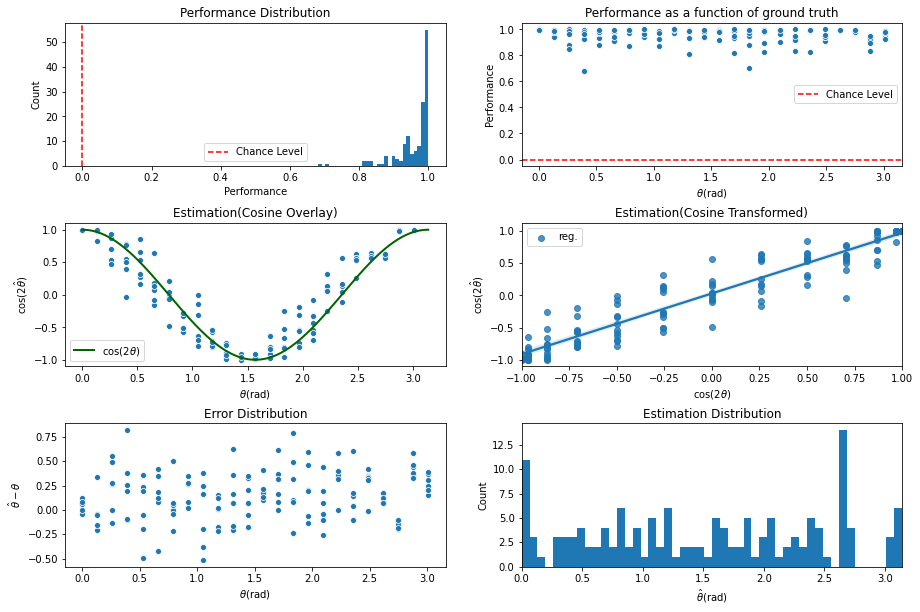

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter8300/assets

 Training performance: 
Iter. 8301 | Performance -0.0146 | Loss 0.2686 | Spike loss 2.7946
Testing performance: 
Iter. 8301 | Performance 0.9593 | Loss 0.2696 | Spike loss 2.7728

 Training performance: 
Iter. 8302 | Performance 0.0334 | Loss 0.2692 | Spike loss 2.8697
Testing performance: 
Iter. 8302 | Performance 0.9626 | Loss 0.2694 | Spike loss 2.7493

 Training performance: 
Iter. 8303 | Performance 0.0073 | Loss 0.2698 | Spike loss 2.9090
Testing performance: 
Iter. 8303 | Performance 0.9621 | Loss 0.2691 | Spike loss 2.7591

 Training performance: 
Iter. 8304 | Performance 0.0117 | Loss 0.2691 | Spike loss 2.7625
Testing performance: 
Iter. 8304 | Performance 0.9582 | Loss 0.2694 | Spike loss 2.7683

 Training performance: 
Iter. 8305 | Performance 0.0400 | Loss 0.2694 | Spike loss 2.8226
Testing performance: 
Iter. 8305 | Performance 0.9592 | Loss 0.2693 | Spike loss 2.7387

 Training pe


 Training performance: 
Iter. 8347 | Performance -0.0887 | Loss 0.2736 | Spike loss 2.8277
Testing performance: 
Iter. 8347 | Performance 0.9624 | Loss 0.2725 | Spike loss 2.8098

 Training performance: 
Iter. 8348 | Performance 0.0665 | Loss 0.2734 | Spike loss 2.8288
Testing performance: 
Iter. 8348 | Performance 0.9654 | Loss 0.2719 | Spike loss 2.7992

 Training performance: 
Iter. 8349 | Performance -0.0244 | Loss 0.2712 | Spike loss 2.7992
Testing performance: 
Iter. 8349 | Performance 0.9658 | Loss 0.2700 | Spike loss 2.8083

 Training performance: 
Iter. 8350 | Performance 0.0529 | Loss 0.2703 | Spike loss 2.8342
Testing performance: 
Iter. 8350 | Performance 0.9636 | Loss 0.2695 | Spike loss 2.8082

 Training performance: 
Iter. 8351 | Performance -0.0183 | Loss 0.2693 | Spike loss 2.7422
Testing performance: 
Iter. 8351 | Performance 0.9640 | Loss 0.2712 | Spike loss 2.7956

 Training performance: 
Iter. 8352 | Performance -0.0907 | Loss 0.2713 | Spike loss 2.8186
Testing pe


 Training performance: 
Iter. 8393 | Performance 0.0858 | Loss 0.2694 | Spike loss 2.7313
Testing performance: 
Iter. 8393 | Performance 0.9543 | Loss 0.2696 | Spike loss 2.7734

 Training performance: 
Iter. 8394 | Performance -0.1318 | Loss 0.2690 | Spike loss 2.6768
Testing performance: 
Iter. 8394 | Performance 0.9511 | Loss 0.2706 | Spike loss 2.7904

 Training performance: 
Iter. 8395 | Performance -0.0928 | Loss 0.2714 | Spike loss 2.9625
Testing performance: 
Iter. 8395 | Performance 0.9516 | Loss 0.2706 | Spike loss 2.8328

 Training performance: 
Iter. 8396 | Performance 0.0096 | Loss 0.2709 | Spike loss 2.8183
Testing performance: 
Iter. 8396 | Performance 0.9592 | Loss 0.2700 | Spike loss 2.8190

 Training performance: 
Iter. 8397 | Performance -0.0290 | Loss 0.2709 | Spike loss 2.7906
Testing performance: 
Iter. 8397 | Performance 0.9603 | Loss 0.2703 | Spike loss 2.8141

 Training performance: 
Iter. 8398 | Performance 0.0053 | Loss 0.2711 | Spike loss 2.9000
Testing per

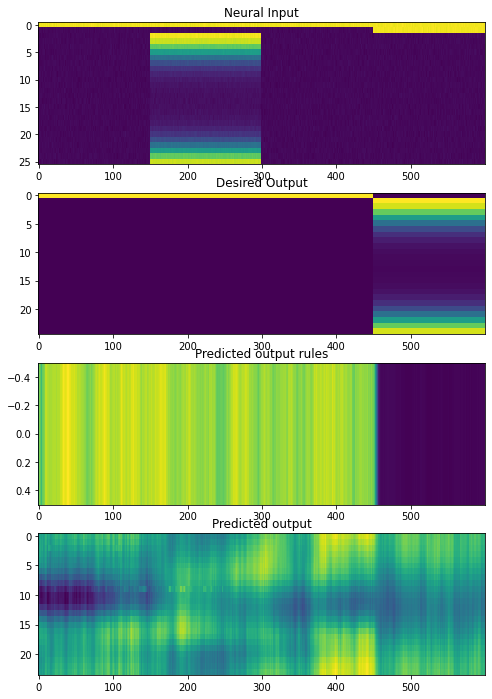

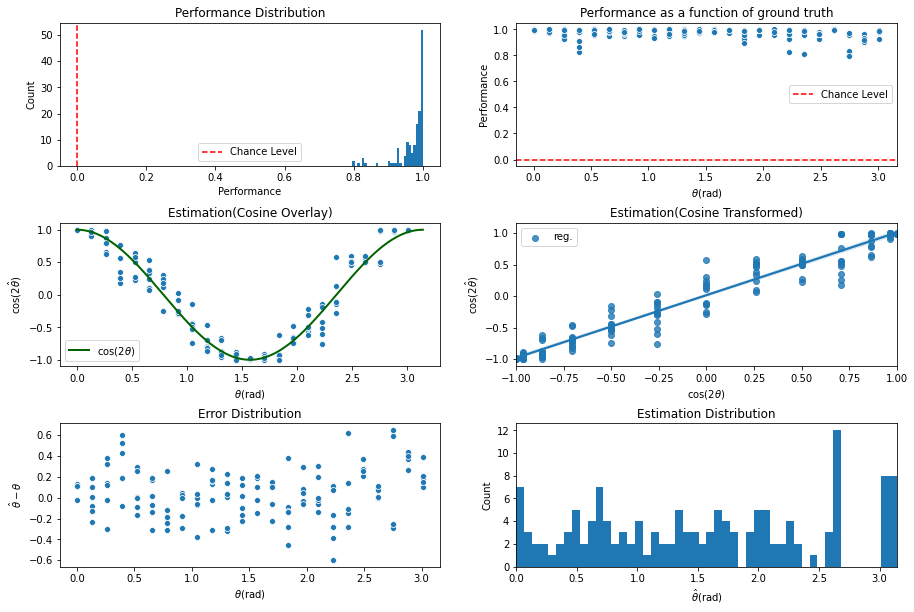

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter8400/assets

 Training performance: 
Iter. 8401 | Performance 0.0050 | Loss 0.2704 | Spike loss 2.9971
Testing performance: 
Iter. 8401 | Performance 0.9674 | Loss 0.2701 | Spike loss 2.9065

 Training performance: 
Iter. 8402 | Performance 0.0133 | Loss 0.2709 | Spike loss 2.9438
Testing performance: 
Iter. 8402 | Performance 0.9597 | Loss 0.2714 | Spike loss 2.9463

 Training performance: 
Iter. 8403 | Performance 0.0088 | Loss 0.2700 | Spike loss 2.8697
Testing performance: 
Iter. 8403 | Performance 0.9621 | Loss 0.2709 | Spike loss 2.9629

 Training performance: 
Iter. 8404 | Performance 0.0796 | Loss 0.2710 | Spike loss 2.9636
Testing performance: 
Iter. 8404 | Performance 0.9619 | Loss 0.2720 | Spike loss 2.9220

 Training performance: 
Iter. 8405 | Performance 0.0101 | Loss 0.2706 | Spike loss 2.7768
Testing performance: 
Iter. 8405 | Performance 0.9584 | Loss 0.2706 | Spike loss 2.9582

 Training per


 Training performance: 
Iter. 8447 | Performance 0.0407 | Loss 0.2702 | Spike loss 2.8959
Testing performance: 
Iter. 8447 | Performance 0.9405 | Loss 0.2712 | Spike loss 2.8615

 Training performance: 
Iter. 8448 | Performance 0.0299 | Loss 0.2693 | Spike loss 2.8468
Testing performance: 
Iter. 8448 | Performance 0.9617 | Loss 0.2694 | Spike loss 2.8698

 Training performance: 
Iter. 8449 | Performance 0.0662 | Loss 0.2692 | Spike loss 2.9048
Testing performance: 
Iter. 8449 | Performance 0.9688 | Loss 0.2699 | Spike loss 2.8687

 Training performance: 
Iter. 8450 | Performance 0.0145 | Loss 0.2691 | Spike loss 2.8080
Testing performance: 
Iter. 8450 | Performance 0.9628 | Loss 0.2696 | Spike loss 2.8693

 Training performance: 
Iter. 8451 | Performance -0.0413 | Loss 0.2701 | Spike loss 2.9224
Testing performance: 
Iter. 8451 | Performance 0.9634 | Loss 0.2698 | Spike loss 2.8248

 Training performance: 
Iter. 8452 | Performance -0.0370 | Loss 0.2710 | Spike loss 2.9203
Testing perf


 Training performance: 
Iter. 8493 | Performance -0.0281 | Loss 0.2693 | Spike loss 3.0403
Testing performance: 
Iter. 8493 | Performance 0.9652 | Loss 0.2696 | Spike loss 2.9329

 Training performance: 
Iter. 8494 | Performance -0.0591 | Loss 0.2690 | Spike loss 2.9252
Testing performance: 
Iter. 8494 | Performance 0.9593 | Loss 0.2696 | Spike loss 2.9306

 Training performance: 
Iter. 8495 | Performance 0.1716 | Loss 0.2693 | Spike loss 2.9871
Testing performance: 
Iter. 8495 | Performance 0.9612 | Loss 0.2685 | Spike loss 2.9313

 Training performance: 
Iter. 8496 | Performance -0.0032 | Loss 0.2695 | Spike loss 2.9063
Testing performance: 
Iter. 8496 | Performance 0.9590 | Loss 0.2696 | Spike loss 2.9183

 Training performance: 
Iter. 8497 | Performance 0.0133 | Loss 0.2709 | Spike loss 2.9026
Testing performance: 
Iter. 8497 | Performance 0.9609 | Loss 0.2697 | Spike loss 2.9039

 Training performance: 
Iter. 8498 | Performance -0.0139 | Loss 0.2697 | Spike loss 2.8361
Testing pe

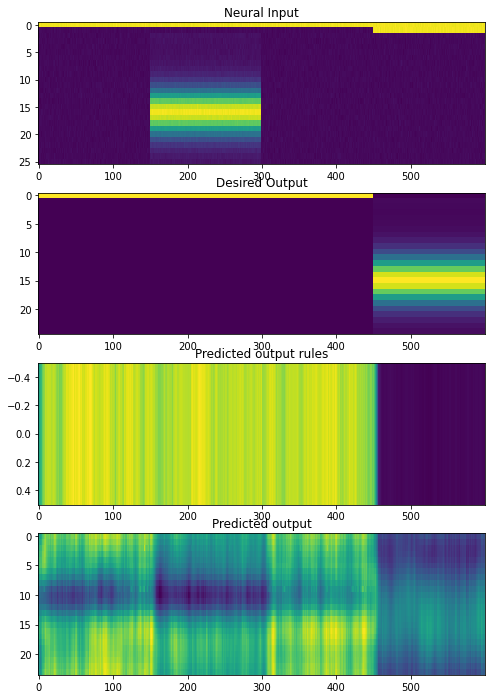

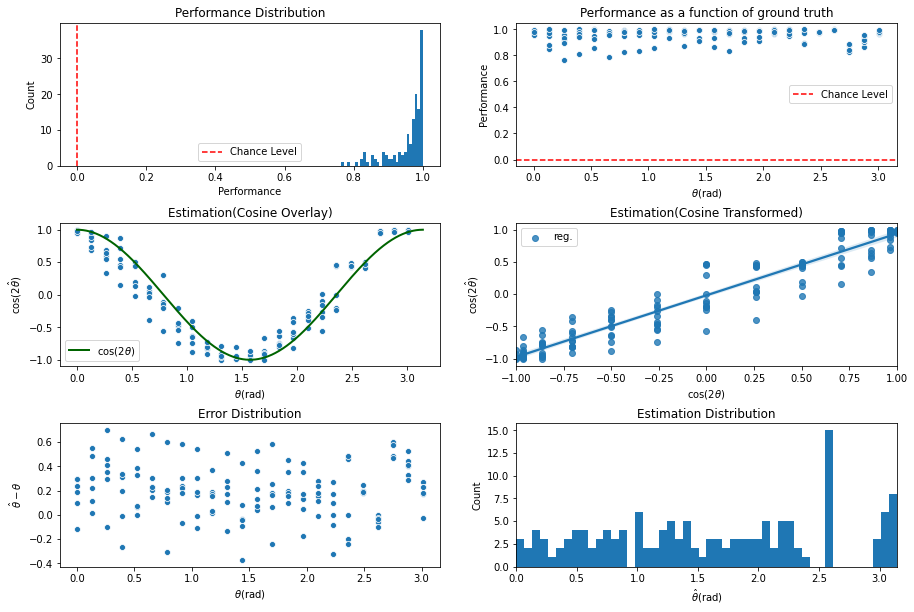

INFO:tensorflow:Assets written to: ../experiments/naturalprior/200622/cont_iter8500/assets

 Training performance: 
Iter. 8501 | Performance -0.0013 | Loss 0.2692 | Spike loss 3.0132
Testing performance: 
Iter. 8501 | Performance 0.9549 | Loss 0.2695 | Spike loss 2.8915

 Training performance: 
Iter. 8502 | Performance -0.0551 | Loss 0.2692 | Spike loss 2.8834
Testing performance: 
Iter. 8502 | Performance 0.9562 | Loss 0.2696 | Spike loss 2.9076

 Training performance: 
Iter. 8503 | Performance 0.0687 | Loss 0.2688 | Spike loss 2.9149
Testing performance: 
Iter. 8503 | Performance 0.9708 | Loss 0.2691 | Spike loss 2.9011

 Training performance: 
Iter. 8504 | Performance -0.0023 | Loss 0.2703 | Spike loss 3.0264
Testing performance: 
Iter. 8504 | Performance 0.9666 | Loss 0.2692 | Spike loss 2.8830

 Training performance: 
Iter. 8505 | Performance -0.0073 | Loss 0.2699 | Spike loss 2.9177
Testing performance: 
Iter. 8505 | Performance 0.9719 | Loss 0.2685 | Spike loss 2.8879

 Training

KeyboardInterrupt: 

In [11]:
###### Train network ######
model_dir = "../experiments/naturalprior/200622/"
os.makedirs(model_dir, exist_ok=True)

N_iter = 100000
N_save = 100  # save model every N_save iterations

# define model
hp = utils_train.hp
hp['learning_rate'] = 5e-3
model = Model(hp=hp)

alllosses =[]
performance_train = {'perf': [], 'loss': [], 'perf_loss': [], 'spike_loss': []}
performance_test = {'perf': [], 'loss': [], 'perf_loss': [], 'spike_loss': []}

for iter_n in range(N_iter+1):
    # train on testing set
    train_data = utils_train.tensorize_trial(stim_train.generate_trial())
    Y, Loss = model(train_data, hp)

    performance_train = utils_train.append_model_performance(performance_train,
                                                             train_data, Y, Loss, par_train)
    # append performance on testing set
    test_data = utils_train.tensorize_trial(stim_test.generate_trial(balanced=True))
    test_Y, test_loss = model.return_losses(test_data['neural_input'], test_data['desired_output'],
                                            test_data['mask'], hp)
    performance_test = utils_train.append_model_performance(performance_test,
                                                            test_data, test_Y, test_loss, par_test)

    print('\n Training performance: ')
    utils_train.print_results(performance_train, iter_n)
    print('Testing performance: ')
    utils_train.print_results(performance_test, iter_n)

    if (iter_n % N_save) == 0:
        # predict from testing set
        plot_rnn_output(par_test, test_data, test_Y, stim_test, TEST_TRIAL=None)
        test_Y = utils_analysis.softmax_pred_output(test_Y) # change to softmax
        ground_truth, estim_mean, raw_error, beh_perf = utils_analysis.behavior_summary(test_data, test_Y, par=par_test)
        utils_analysis.behavior_figure(ground_truth, estim_mean, raw_error, beh_perf)

        tf.saved_model.save(model, os.path.join(model_dir, "cont_iter" + str(iter_n)))

    if iter_n > 20 and np.sum(performance_test['perf'][-20] > 0.95) > 18:
        print('Good performance achieved... saving final model')
        break

# save final model
tf.saved_model.save(model, os.path.join(model_dir, "cont_iter" + str(iter_n)))

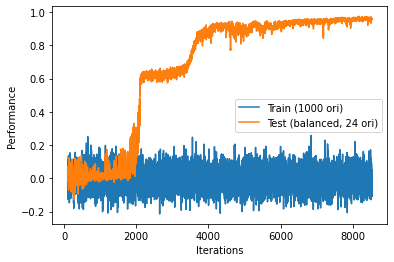

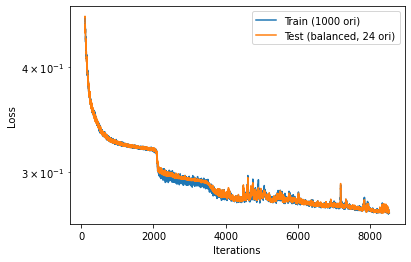

In [13]:
#performance_train = {'perf': [], 'loss': [], 'perf_loss': [], 'spike_loss': []}
#performance_test = {'perf': [], 'loss': [], 'perf_loss': [], 'spike_loss': []}
plt.figure()
plt.plot(np.arange(100,len(performance_train['perf'])), 
         performance_train['perf'][100:], label='Train (1000 ori)')
plt.plot(np.arange(100,len(performance_test['perf'])), 
         performance_test['perf'][100:], label='Test (balanced, 24 ori)')
plt.ylabel('Performance')
plt.xlabel('Iterations')
plt.legend()
plt.show()

plt.figure()
plt.plot(np.arange(100,len(performance_train['perf'])),
         performance_train['loss'][100:], label='Train (1000 ori)')
plt.plot(np.arange(100,len(performance_test['perf'])),
         performance_test['loss'][100:], label='Test (balanced, 24 ori)')
plt.ylabel('Loss')
plt.xlabel('Iterations')
plt.yscale('log')
plt.legend()
plt.show()